In [8]:
import torch
print("PyTorch Version:", torch.__version__)
print("CUDA Available:", torch.cuda.is_available())
print("CUDA Version:", torch.version.cuda)
print("GPU Device Name:", torch.cuda.get_device_name(0) if torch.cuda.is_available() else "None")

PyTorch Version: 2.5.1+cu118
CUDA Available: True
CUDA Version: 11.8
GPU Device Name: NVIDIA GeForce RTX 4090


In [8]:
import os
import shutil
import cv2
import random
from torchvision import transforms
from PIL import Image
from tqdm import tqdm
import torch

# Set device to GPU if available
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# Paths to the datasets
real_videos_path = r'D:\Reema\Celeb DF (v2)\Celeb-real'  # Replace with your path
fake_videos_path = r'D:\Reema\Celeb DF (v2)\Celeb-synthesis'  # Replace with your path

# Output paths
output_path = "/content/"
real_output_path = os.path.join(output_path, "real3")
fake_output_path = os.path.join(output_path, "fake3")
os.makedirs(real_output_path, exist_ok=True)
os.makedirs(fake_output_path, exist_ok=True)

# Clear output folders by removing and recreating them
if os.path.exists(real_output_path):
    shutil.rmtree(real_output_path)
os.makedirs(real_output_path, exist_ok=True)

if os.path.exists(fake_output_path):
    shutil.rmtree(fake_output_path)
os.makedirs(fake_output_path, exist_ok=True)

# Parameters
frame_size = (112, 112)
max_frames = 150
min_copies = 8  # Minimum number of augmented copies
max_copies = 12  # Maximum number of augmented copies

# Data Augmentation Transforms for Real videos
augmentation_transforms = transforms.Compose([
    transforms.ToPILImage(),                                         # Convert to PIL image
    transforms.Resize((112, 112)),                                   # Resize to uniform size
    transforms.RandomHorizontalFlip(p=0.5),                          # Horizontal flip with 50% probability
    transforms.RandomRotation(degrees=10),                           # Random rotation within ±10 degrees
    transforms.ColorJitter(brightness=0.3, contrast=0.3, saturation=0.3, hue=0.2),  # Enhanced color jitter
    transforms.RandomAffine(degrees=10, translate=(0.1, 0.1), scale=(0.9, 1.1)),    # More flexible affine transformation
    transforms.GaussianBlur(kernel_size=(5, 5)),                      # Apply Gaussian blur
    transforms.ToTensor(),                                           # Convert to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize
])

# Temporal Augmentation
def temporal_augmentation(frames, drop_prob=0.2):
    """ Randomly drops frames to create temporal variation """
    augmented_frames = [frame for frame in frames if random.random() > drop_prob]
    return augmented_frames

# Spatial Augmentation
def apply_spatial_augmentation(frames):
    augmented_frames = []
    for frame in frames:
        frame_tensor = transforms.ToTensor()(frame).unsqueeze(0).to(device)  # Move frame to GPU
        augmented_frame = augmentation_transforms(frame_tensor.cpu().squeeze(0))  # Move back to CPU before applying transformations
        augmented_frames.append(augmented_frame.permute(1, 2, 0).numpy())
    return augmented_frames

# Frame Interpolation
def interpolate_frames(frames, factor=2):
    """ Generate new frames by interpolating between existing frames """
    interpolated_frames = []
    for i in range(len(frames) - 1):
        interpolated_frames.append(frames[i])
        for j in range(1, factor):
            alpha = j / factor
            interpolated_frame = cv2.addWeighted(frames[i], 1 - alpha, frames[i + 1], alpha, 0)
            interpolated_frames.append(interpolated_frame)
    interpolated_frames.append(frames[-1])
    return interpolated_frames

# Function to apply augmentation and save augmented videos
def augment_and_save_video(frames, video_name, output_path, min_copies=5, max_copies=8):
    num_copies = random.randint(min_copies, max_copies)  # Random number of copies
    for i in range(num_copies):
        # Apply temporal augmentation
        temp_aug_frames = temporal_augmentation(frames)
        
        # Apply spatial augmentation
        spatial_aug_frames = apply_spatial_augmentation(temp_aug_frames)
        
        # Apply interpolation
        final_aug_frames = interpolate_frames(spatial_aug_frames)
        
        # Save the augmented video
        output_video_path = os.path.join(output_path, f"aug_{i}_{video_name}")
        out = cv2.VideoWriter(output_video_path, cv2.VideoWriter_fourcc(*'mp4v'), 30, frame_size)
        for frame in final_aug_frames:
            out.write((frame * 255).astype('uint8'))  # Convert back to uint8
        out.release()

# Function to check frame count
def has_sufficient_frames(video_path, min_frames=150):
    cap = cv2.VideoCapture(video_path)
    frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
    cap.release()
    return frame_count > min_frames

# Function to extract frames from a video
def extract_frames(video_path, max_frames=150):
    cap = cv2.VideoCapture(video_path)
    frames = []
    while len(frames) < max_frames:
        ret, frame = cap.read()
        if not ret:
            break
        frames.append(frame)
    cap.release()
    return frames

# Process Real Videos with Augmentation
real_videos = os.listdir(real_videos_path)
selected_real_videos = [video for video in real_videos if has_sufficient_frames(os.path.join(real_videos_path, video))]

print(f"Number of real videos: {len(selected_real_videos)}")
for video_name in tqdm(selected_real_videos, desc="Processing Real Videos"):
    video_path = os.path.join(real_videos_path, video_name)
    frames = extract_frames(video_path, max_frames=max_frames)
    augment_and_save_video(frames, video_name, real_output_path, min_copies=min_copies, max_copies=max_copies)

# Copy Fake Videos without Augmentation
fake_videos = os.listdir(fake_videos_path)
selected_fake_videos = [video for video in fake_videos if has_sufficient_frames(os.path.join(fake_videos_path, video))]

for video in tqdm(selected_fake_videos, desc="Copying Fake Videos"):
    shutil.copy(os.path.join(fake_videos_path, video), os.path.join(fake_output_path, video))

# Final check: Count videos in output folders
real_video_count = len(os.listdir(real_output_path))
fake_video_count = len(os.listdir(fake_output_path))

# Print summary
print("Dataset created successfully with augmentation!")
print(f"Number of real videos after augmentation: {real_video_count}")
print(f"Number of fake videos selected: {fake_video_count}")


Number of real videos: 588


Copying Fake Videos: 100%|██████████| 5635/5635 [01:50<00:00, 51.09it/s] 


Dataset created successfully with augmentation!
Number of real videos after augmentation: 5926
Number of fake videos selected: 5635


In [10]:
#To get the average frame count
import json
import glob
import numpy as np
import cv2
import copy
#change the path accordingly
video_files =  glob.glob('/content/real3/*.mp4')
frame_count = []
for video_file in video_files:
  cap = cv2.VideoCapture(video_file)
  if(int(cap.get(cv2.CAP_PROP_FRAME_COUNT))<150):
    video_files.remove(video_file)
    continue
  frame_count.append(int(cap.get(cv2.CAP_PROP_FRAME_COUNT)))
print("frames" , frame_count)
print("Total number of videos: " , len(frame_count))
print('Average frame per video:',np.mean(frame_count))

frames [243, 231, 249, 243, 249, 249, 229, 245, 255, 243, 243, 233, 249, 253, 219, 249, 217, 237, 245, 243, 237, 247, 223, 253, 241, 233, 223, 245, 239, 247, 235, 239, 253, 231, 243, 249, 225, 235, 235, 251, 245, 233, 217, 231, 259, 249, 233, 235, 217, 227, 233, 255, 239, 239, 241, 239, 207, 235, 251, 227, 251, 237, 235, 223, 243, 235, 251, 227, 249, 223, 223, 237, 229, 253, 229, 233, 235, 253, 241, 235, 239, 241, 229, 239, 241, 229, 231, 249, 239, 247, 253, 229, 239, 241, 247, 255, 241, 241, 211, 237, 237, 245, 237, 229, 243, 223, 241, 253, 249, 237, 235, 245, 245, 221, 243, 235, 233, 235, 241, 231, 241, 239, 245, 233, 227, 229, 247, 245, 223, 241, 225, 255, 247, 239, 235, 241, 253, 241, 227, 241, 245, 237, 243, 245, 223, 249, 235, 253, 239, 223, 227, 235, 237, 247, 253, 245, 249, 231, 247, 253, 243, 237, 235, 259, 247, 253, 231, 219, 245, 239, 253, 245, 245, 223, 245, 237, 245, 243, 235, 241, 229, 233, 261, 231, 231, 223, 249, 233, 241, 235, 259, 239, 233, 231, 237, 231, 239, 235, 24

In [11]:
#To get the average frame count
import json
import glob
import numpy as np
import cv2
import copy
#change the path accordingly
video_files =  glob.glob('/content/fake3/*.mp4')

frame_count = []
for video_file in video_files:
  cap = cv2.VideoCapture(video_file)
  if(int(cap.get(cv2.CAP_PROP_FRAME_COUNT))<150):
    video_files.remove(video_file)
    continue
  frame_count.append(int(cap.get(cv2.CAP_PROP_FRAME_COUNT)))
print("frames" , frame_count)
print("Total number of videos: " , len(frame_count))
print('Average frame per video:',np.mean(frame_count))

frames [469, 303, 350, 529, 326, 459, 534, 479, 464, 520, 469, 303, 350, 529, 459, 534, 479, 520, 469, 303, 350, 529, 459, 534, 479, 520, 469, 303, 350, 529, 326, 459, 534, 479, 520, 469, 303, 350, 529, 326, 459, 534, 479, 520, 469, 303, 350, 326, 459, 479, 520, 469, 303, 350, 529, 326, 459, 534, 479, 464, 520, 469, 303, 350, 529, 326, 459, 534, 479, 464, 520, 469, 303, 350, 529, 326, 459, 534, 479, 464, 520, 469, 303, 350, 529, 326, 459, 534, 479, 464, 520, 469, 303, 350, 529, 326, 459, 534, 520, 469, 303, 350, 534, 479, 520, 469, 303, 350, 529, 459, 534, 479, 464, 520, 322, 343, 517, 318, 161, 496, 380, 322, 343, 517, 318, 161, 496, 380, 322, 343, 517, 318, 161, 496, 380, 322, 343, 517, 318, 161, 496, 380, 535, 349, 441, 357, 313, 337, 327, 316, 320, 371, 397, 330, 398, 364, 339, 314, 308, 376, 398, 364, 339, 314, 308, 327, 349, 340, 352, 309, 452, 459, 466, 510, 390, 489, 327, 349, 400, 340, 352, 309, 452, 459, 435, 466, 510, 489, 317, 316, 363, 303, 410, 345, 224, 284, 315, 325, 27

In [12]:
import os
import cv2
import torch
from tqdm import tqdm
from facenet_pytorch import MTCNN

# Define the output directory
output_dir = '/content/FAKE_Face_only_data_3/'
os.makedirs(output_dir, exist_ok=True)

# List of video paths
video_folder = "/content/fake3/"  # Replace with your path
path_list = [os.path.join(video_folder, filename) for filename in os.listdir(video_folder) if filename.endswith('.mp4')]

# Maximum number of frames to process per video
MAX_FRAMES = 150
FRAMES_PER_BATCH = 4
FRAME_SIZE = (112, 112)

# Initialize MTCNN model
device = torch.device("cuda:0")  # Use GPU 0
mtcnn = MTCNN(keep_all=False, device=device)

print(f"MTCNN model is running on {device}")

# Function to extract frames from a video
def frame_extract(path):
    """
    A generator function to extract frames from a video file.
    """
    vidObj = cv2.VideoCapture(path)
    success = True
    while success:
        success, image = vidObj.read()
        if success:
            yield image
    vidObj.release()

# Function to process videos
def create_face_videos(path_list, out_dir):
    for path in tqdm(path_list, desc="Processing Videos"):
        out_path = os.path.join(out_dir, os.path.basename(path))
        if os.path.exists(out_path):
            print(f"File already exists: {out_path}. Skipping...")
            continue

        # Initialize video writer
        out = cv2.VideoWriter(out_path, cv2.VideoWriter_fourcc(*'mp4v'), 30, FRAME_SIZE)

        frames = []
        face_count = 0
        frame_count = 0
        last_valid_face = None  # Store the last detected face

        for idx, frame in enumerate(frame_extract(path)):
            if frame_count >= MAX_FRAMES:
                break

            frames.append(frame)
            if len(frames) == FRAMES_PER_BATCH:
                rgb_frames = [cv2.cvtColor(f, cv2.COLOR_BGR2RGB) for f in frames]
                boxes, _ = mtcnn.detect(rgb_frames)

                for i, box in enumerate(boxes):
                    if box is not None and len(box) > 0:  # If a face is detected
                        x1, y1, x2, y2 = map(int, box[0])  # Take the first detected face
                        try:
                            face_img = frames[i][y1:y2, x1:x2]
                            if face_img is not None and face_img.size > 0:  # Check if face is valid
                                face_img_resized = cv2.resize(face_img, FRAME_SIZE)
                                out.write(face_img_resized)
                                last_valid_face = face_img_resized  # Update last valid face
                                face_count += 1
                                frame_count += 1
                        except Exception as e:
                            print(f"Error processing face in frame {idx * FRAMES_PER_BATCH + i}: {e}")
                    else:
                        # Use the last valid face if no face is detected
                        if last_valid_face is not None:
                            out.write(last_valid_face)
                            frame_count += 1
                        else:
                            # If no last valid face, skip this frame
                            print(f"No valid face found for frame {idx * FRAMES_PER_BATCH + i}, skipping.")

                frames = []

        # Fill remaining frames to ensure uniform frame count
        while frame_count < MAX_FRAMES - (MAX_FRAMES % FRAMES_PER_BATCH):
            if last_valid_face is not None:
                out.write(last_valid_face)
            else:
                print(f"No valid face found, skipping remaining frames.")
                break
            frame_count += 1

        out.release()
        print(f"Processed video saved to {out_path} with {frame_count} frames.")


# Call the function
create_face_videos(path_list, output_dir)


C:\Users\PCD\anaconda3\envs\F9_\Lib\site-packages\tqdm\auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm
C:\Users\PCD\anaconda3\envs\F9_\Lib\site-packages\facenet_pytorch\models\mtcnn.py:34: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_glob

MTCNN model is running on cuda:0


Processing Videos:   0%|          | 1/5635 [01:01<96:54:17, 61.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id16_0000.mp4 with 152 frames.


Processing Videos:   0%|          | 2/5635 [01:48<82:51:20, 52.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id16_0001.mp4 with 152 frames.


Processing Videos:   0%|          | 3/5635 [03:23<113:08:37, 72.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id16_0002.mp4 with 152 frames.


Processing Videos:   0%|          | 4/5635 [04:09<96:37:40, 61.78s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id16_0003.mp4 with 152 frames.


Processing Videos:   0%|          | 5/5635 [05:28<106:21:28, 68.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id16_0004.mp4 with 152 frames.


Processing Videos:   0%|          | 6/5635 [07:41<141:04:23, 90.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id16_0005.mp4 with 152 frames.


Processing Videos:   0%|          | 7/5635 [10:22<177:05:19, 113.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id16_0006.mp4 with 152 frames.


Processing Videos:   0%|          | 8/5635 [11:42<160:10:49, 102.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id16_0007.mp4 with 152 frames.


Processing Videos:   0%|          | 9/5635 [11:47<112:44:55, 72.15s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id16_0008.mp4 with 152 frames.


Processing Videos:   0%|          | 10/5635 [11:52<80:22:25, 51.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id16_0009.mp4 with 152 frames.


Processing Videos:   0%|          | 11/5635 [11:56<57:43:24, 36.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id17_0000.mp4 with 152 frames.


Processing Videos:   0%|          | 12/5635 [11:59<41:30:55, 26.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id17_0001.mp4 with 152 frames.


Processing Videos:   0%|          | 13/5635 [12:05<31:47:21, 20.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id17_0002.mp4 with 152 frames.


Processing Videos:   0%|          | 14/5635 [12:08<23:38:34, 15.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id17_0003.mp4 with 152 frames.


Processing Videos:   0%|          | 15/5635 [12:17<20:34:15, 13.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id17_0005.mp4 with 152 frames.


Processing Videos:   0%|          | 16/5635 [12:27<19:05:20, 12.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id17_0006.mp4 with 152 frames.


Processing Videos:   0%|          | 17/5635 [12:33<16:14:50, 10.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id17_0007.mp4 with 152 frames.


Processing Videos:   0%|          | 18/5635 [12:38<13:44:58,  8.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id17_0009.mp4 with 152 frames.


Processing Videos:   0%|          | 19/5635 [12:42<11:34:18,  7.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id1_0000.mp4 with 152 frames.


Processing Videos:   0%|          | 20/5635 [12:45<9:30:43,  6.10s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id1_0001.mp4 with 152 frames.


Processing Videos:   0%|          | 21/5635 [12:52<9:33:33,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id1_0002.mp4 with 152 frames.


Processing Videos:   0%|          | 22/5635 [12:55<8:06:59,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id1_0003.mp4 with 152 frames.


Processing Videos:   0%|          | 23/5635 [13:03<9:49:12,  6.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id1_0005.mp4 with 152 frames.


Processing Videos:   0%|          | 24/5635 [13:13<11:30:37,  7.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id1_0006.mp4 with 152 frames.


Processing Videos:   0%|          | 25/5635 [13:20<10:57:34,  7.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id1_0007.mp4 with 152 frames.


Processing Videos:   0%|          | 26/5635 [13:25<10:01:51,  6.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id1_0009.mp4 with 152 frames.


Processing Videos:   0%|          | 27/5635 [13:29<8:51:08,  5.68s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id20_0000.mp4 with 152 frames.


Processing Videos:   0%|          | 28/5635 [13:31<7:32:18,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id20_0001.mp4 with 152 frames.


Processing Videos:   1%|          | 29/5635 [13:37<8:02:11,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id20_0002.mp4 with 152 frames.


Processing Videos:   1%|          | 30/5635 [13:40<7:01:32,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id20_0003.mp4 with 152 frames.


Processing Videos:   1%|          | 31/5635 [13:45<7:08:12,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id20_0004.mp4 with 152 frames.


Processing Videos:   1%|          | 32/5635 [13:54<9:00:10,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id20_0005.mp4 with 152 frames.


Processing Videos:   1%|          | 33/5635 [14:03<10:32:06,  6.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id20_0006.mp4 with 152 frames.


Processing Videos:   1%|          | 34/5635 [14:09<10:23:57,  6.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id20_0007.mp4 with 152 frames.


Processing Videos:   1%|          | 35/5635 [14:14<9:31:19,  6.12s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id20_0009.mp4 with 152 frames.


Processing Videos:   1%|          | 36/5635 [14:18<8:32:50,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id21_0000.mp4 with 152 frames.


Processing Videos:   1%|          | 37/5635 [14:21<7:17:56,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id21_0001.mp4 with 152 frames.


Processing Videos:   1%|          | 38/5635 [14:27<7:59:05,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id21_0002.mp4 with 152 frames.


Processing Videos:   1%|          | 39/5635 [14:30<6:55:41,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id21_0003.mp4 with 152 frames.


Processing Videos:   1%|          | 40/5635 [14:34<6:47:16,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id21_0004.mp4 with 152 frames.


Processing Videos:   1%|          | 41/5635 [14:43<8:44:17,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id21_0005.mp4 with 152 frames.


Processing Videos:   1%|          | 42/5635 [14:52<10:27:21,  6.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id21_0006.mp4 with 152 frames.


Processing Videos:   1%|          | 43/5635 [14:58<10:18:34,  6.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id21_0007.mp4 with 152 frames.


Processing Videos:   1%|          | 44/5635 [15:03<9:23:14,  6.04s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id21_0009.mp4 with 152 frames.


Processing Videos:   1%|          | 45/5635 [15:07<8:24:22,  5.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id23_0000.mp4 with 152 frames.


Processing Videos:   1%|          | 46/5635 [15:10<7:16:53,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id23_0001.mp4 with 152 frames.


Processing Videos:   1%|          | 47/5635 [15:16<7:53:01,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id23_0002.mp4 with 152 frames.


Processing Videos:   1%|          | 48/5635 [15:20<7:35:12,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id23_0004.mp4 with 152 frames.


Processing Videos:   1%|          | 49/5635 [15:29<9:17:19,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id23_0005.mp4 with 152 frames.


Processing Videos:   1%|          | 50/5635 [15:35<9:23:00,  6.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id23_0007.mp4 with 152 frames.


Processing Videos:   1%|          | 51/5635 [15:40<8:44:45,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id23_0009.mp4 with 152 frames.


Processing Videos:   1%|          | 52/5635 [15:44<8:00:32,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id26_0000.mp4 with 152 frames.


Processing Videos:   1%|          | 53/5635 [15:47<6:57:12,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id26_0001.mp4 with 152 frames.


Processing Videos:   1%|          | 54/5635 [15:53<7:42:16,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id26_0002.mp4 with 152 frames.


Processing Videos:   1%|          | 55/5635 [15:56<6:47:41,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id26_0003.mp4 with 152 frames.


Processing Videos:   1%|          | 56/5635 [16:00<6:50:41,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id26_0004.mp4 with 152 frames.


Processing Videos:   1%|          | 57/5635 [16:09<8:44:53,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id26_0005.mp4 with 152 frames.


Processing Videos:   1%|          | 58/5635 [16:18<10:26:05,  6.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id26_0006.mp4 with 152 frames.


Processing Videos:   1%|          | 59/5635 [16:24<10:10:04,  6.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id26_0007.mp4 with 152 frames.


Processing Videos:   1%|          | 60/5635 [16:27<8:20:17,  5.38s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id26_0008.mp4 with 152 frames.


Processing Videos:   1%|          | 61/5635 [16:32<7:56:55,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id26_0009.mp4 with 152 frames.


Processing Videos:   1%|          | 62/5635 [16:35<7:23:44,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id28_0000.mp4 with 152 frames.


Processing Videos:   1%|          | 63/5635 [16:38<6:30:22,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id28_0001.mp4 with 152 frames.


Processing Videos:   1%|          | 64/5635 [16:45<7:26:33,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id28_0002.mp4 with 152 frames.


Processing Videos:   1%|          | 65/5635 [16:48<6:36:50,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id28_0003.mp4 with 152 frames.


Processing Videos:   1%|          | 66/5635 [16:52<6:43:03,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id28_0004.mp4 with 152 frames.


Processing Videos:   1%|          | 67/5635 [17:01<8:41:37,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id28_0005.mp4 with 152 frames.


Processing Videos:   1%|          | 68/5635 [17:10<10:17:58,  6.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id28_0006.mp4 with 152 frames.


Processing Videos:   1%|          | 69/5635 [17:16<10:05:38,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id28_0007.mp4 with 152 frames.


Processing Videos:   1%|          | 70/5635 [17:19<8:18:08,  5.37s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id28_0008.mp4 with 152 frames.


Processing Videos:   1%|▏         | 71/5635 [17:24<8:04:30,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id28_0009.mp4 with 152 frames.


Processing Videos:   1%|▏         | 72/5635 [17:28<7:31:41,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id2_0000.mp4 with 152 frames.


Processing Videos:   1%|▏         | 73/5635 [17:30<6:32:56,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id2_0001.mp4 with 152 frames.


Processing Videos:   1%|▏         | 74/5635 [17:37<7:29:27,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id2_0002.mp4 with 152 frames.


Processing Videos:   1%|▏         | 75/5635 [17:40<6:36:02,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id2_0003.mp4 with 152 frames.


Processing Videos:   1%|▏         | 76/5635 [17:44<6:44:03,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id2_0004.mp4 with 152 frames.


Processing Videos:   1%|▏         | 77/5635 [17:53<8:41:00,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id2_0005.mp4 with 152 frames.


Processing Videos:   1%|▏         | 78/5635 [18:02<10:24:32,  6.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id2_0006.mp4 with 152 frames.


Processing Videos:   1%|▏         | 79/5635 [18:08<10:00:40,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id2_0007.mp4 with 152 frames.


Processing Videos:   1%|▏         | 80/5635 [18:11<8:17:09,  5.37s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id2_0008.mp4 with 152 frames.


Processing Videos:   1%|▏         | 81/5635 [18:16<8:05:24,  5.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id2_0009.mp4 with 152 frames.


Processing Videos:   1%|▏         | 82/5635 [18:20<7:32:40,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id3_0000.mp4 with 152 frames.


Processing Videos:   1%|▏         | 83/5635 [18:23<6:35:30,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id3_0001.mp4 with 152 frames.


Processing Videos:   1%|▏         | 84/5635 [18:29<7:28:45,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id3_0002.mp4 with 152 frames.


Processing Videos:   2%|▏         | 85/5635 [18:32<6:37:07,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id3_0003.mp4 with 152 frames.


Processing Videos:   2%|▏         | 86/5635 [18:36<6:39:17,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id3_0004.mp4 with 152 frames.


Processing Videos:   2%|▏         | 87/5635 [18:44<8:31:33,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id3_0005.mp4 with 152 frames.


Processing Videos:   2%|▏         | 88/5635 [18:54<10:22:08,  6.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id3_0006.mp4 with 152 frames.


Processing Videos:   2%|▏         | 89/5635 [19:00<10:07:01,  6.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id3_0007.mp4 with 152 frames.


Processing Videos:   2%|▏         | 90/5635 [19:03<8:19:06,  5.40s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id3_0008.mp4 with 152 frames.


Processing Videos:   2%|▏         | 91/5635 [19:08<8:05:10,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id3_0009.mp4 with 152 frames.


Processing Videos:   2%|▏         | 92/5635 [19:12<7:30:21,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id4_0000.mp4 with 152 frames.


Processing Videos:   2%|▏         | 93/5635 [19:15<6:33:48,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id4_0001.mp4 with 152 frames.


Processing Videos:   2%|▏         | 94/5635 [19:21<7:27:36,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id4_0002.mp4 with 152 frames.


Processing Videos:   2%|▏         | 95/5635 [19:24<6:37:50,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id4_0003.mp4 with 152 frames.


Processing Videos:   2%|▏         | 96/5635 [19:28<6:40:09,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id4_0004.mp4 with 152 frames.


Processing Videos:   2%|▏         | 97/5635 [19:37<8:31:57,  5.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id4_0005.mp4 with 152 frames.


Processing Videos:   2%|▏         | 98/5635 [19:46<10:12:57,  6.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id4_0006.mp4 with 152 frames.


Processing Videos:   2%|▏         | 99/5635 [19:51<9:23:49,  6.11s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id4_0009.mp4 with 152 frames.


Processing Videos:   2%|▏         | 100/5635 [19:55<8:31:03,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id6_0000.mp4 with 152 frames.


Processing Videos:   2%|▏         | 101/5635 [19:58<7:17:03,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id6_0001.mp4 with 152 frames.


Processing Videos:   2%|▏         | 102/5635 [20:04<7:50:51,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id6_0002.mp4 with 152 frames.


Processing Videos:   2%|▏         | 103/5635 [20:13<9:56:45,  6.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id6_0006.mp4 with 152 frames.


Processing Videos:   2%|▏         | 104/5635 [20:20<9:50:03,  6.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id6_0007.mp4 with 152 frames.


Processing Videos:   2%|▏         | 105/5635 [20:25<9:08:40,  5.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id6_0009.mp4 with 152 frames.


Processing Videos:   2%|▏         | 106/5635 [20:29<8:15:51,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id9_0000.mp4 with 152 frames.


Processing Videos:   2%|▏         | 107/5635 [20:31<7:05:09,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id9_0001.mp4 with 152 frames.


Processing Videos:   2%|▏         | 108/5635 [20:37<7:42:43,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id9_0002.mp4 with 152 frames.


Processing Videos:   2%|▏         | 109/5635 [20:40<6:44:16,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id9_0003.mp4 with 152 frames.


Processing Videos:   2%|▏         | 110/5635 [20:49<8:39:56,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id9_0005.mp4 with 152 frames.


Processing Videos:   2%|▏         | 111/5635 [20:58<10:18:47,  6.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id9_0006.mp4 with 152 frames.


Processing Videos:   2%|▏         | 112/5635 [21:05<10:11:13,  6.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id9_0007.mp4 with 152 frames.


Processing Videos:   2%|▏         | 113/5635 [21:07<8:20:38,  5.44s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id0_id9_0008.mp4 with 152 frames.


Processing Videos:   2%|▏         | 114/5635 [21:12<8:07:16,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id0_id9_0009.mp4 with 152 frames.


Processing Videos:   2%|▏         | 115/5635 [21:16<7:31:26,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id11_0002.mp4 with 152 frames.


Processing Videos:   2%|▏         | 116/5635 [21:20<7:07:04,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id11_0003.mp4 with 152 frames.


Processing Videos:   2%|▏         | 117/5635 [21:24<6:51:50,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id11_0004.mp4 with 152 frames.


Processing Videos:   2%|▏         | 118/5635 [21:30<7:12:32,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id11_0005.mp4 with 152 frames.


Processing Videos:   2%|▏         | 119/5635 [21:37<8:22:27,  5.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id11_0006.mp4 with 148 frames.


Processing Videos:   2%|▏         | 120/5635 [21:39<7:01:51,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id11_0007.mp4 with 152 frames.


Processing Videos:   2%|▏         | 121/5635 [21:41<5:47:37,  3.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id11_0008.mp4 with 152 frames.


Processing Videos:   2%|▏         | 122/5635 [21:45<5:50:46,  3.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id12_0002.mp4 with 152 frames.


Processing Videos:   2%|▏         | 123/5635 [21:49<5:58:24,  3.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id12_0003.mp4 with 152 frames.


Processing Videos:   2%|▏         | 124/5635 [21:53<6:03:52,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id12_0004.mp4 with 152 frames.


Processing Videos:   2%|▏         | 125/5635 [21:59<6:43:37,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id12_0005.mp4 with 152 frames.


Processing Videos:   2%|▏         | 126/5635 [22:06<8:00:16,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id12_0006.mp4 with 148 frames.


Processing Videos:   2%|▏         | 127/5635 [22:08<6:41:25,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id12_0007.mp4 with 152 frames.


Processing Videos:   2%|▏         | 128/5635 [22:10<5:32:46,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id12_0008.mp4 with 152 frames.


Processing Videos:   2%|▏         | 129/5635 [22:14<5:44:15,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id13_0002.mp4 with 152 frames.


Processing Videos:   2%|▏         | 130/5635 [22:18<5:50:28,  3.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id13_0003.mp4 with 152 frames.


Processing Videos:   2%|▏         | 131/5635 [22:22<5:57:34,  3.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id13_0004.mp4 with 152 frames.


Processing Videos:   2%|▏         | 132/5635 [22:28<6:39:38,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id13_0005.mp4 with 152 frames.


Processing Videos:   2%|▏         | 133/5635 [22:35<7:56:17,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id13_0006.mp4 with 148 frames.


Processing Videos:   2%|▏         | 134/5635 [22:37<6:44:00,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id13_0007.mp4 with 152 frames.


Processing Videos:   2%|▏         | 135/5635 [22:39<5:37:43,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id13_0008.mp4 with 152 frames.


Processing Videos:   2%|▏         | 136/5635 [22:43<5:41:53,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id7_0002.mp4 with 152 frames.


Processing Videos:   2%|▏         | 137/5635 [22:47<5:56:39,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id7_0003.mp4 with 152 frames.


Processing Videos:   2%|▏         | 138/5635 [22:51<5:58:49,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id7_0004.mp4 with 152 frames.


Processing Videos:   2%|▏         | 139/5635 [22:57<6:38:11,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id7_0005.mp4 with 152 frames.


Processing Videos:   2%|▏         | 140/5635 [23:04<7:55:59,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id7_0006.mp4 with 148 frames.


Processing Videos:   3%|▎         | 141/5635 [23:07<6:43:15,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id7_0007.mp4 with 152 frames.


Processing Videos:   3%|▎         | 142/5635 [23:09<5:37:42,  3.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id7_0008.mp4 with 152 frames.


Processing Videos:   3%|▎         | 143/5635 [23:12<5:33:30,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id10_id7_0009.mp4 with 152 frames.


Processing Videos:   3%|▎         | 144/5635 [23:15<5:11:57,  3.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0000.mp4 with 152 frames.


Processing Videos:   3%|▎         | 145/5635 [23:17<4:44:49,  3.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0001.mp4 with 152 frames.


Processing Videos:   3%|▎         | 146/5635 [23:23<5:52:28,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0002.mp4 with 152 frames.


Processing Videos:   3%|▎         | 147/5635 [23:31<7:38:59,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:   3%|▎         | 148/5635 [23:33<6:23:42,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0004.mp4 with 151 frames.


Processing Videos:   3%|▎         | 149/5635 [23:38<6:51:53,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0005.mp4 with 152 frames.


Processing Videos:   3%|▎         | 150/5635 [23:42<6:43:52,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0006.mp4 with 152 frames.


Processing Videos:   3%|▎         | 151/5635 [23:46<6:27:32,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0007.mp4 with 152 frames.


Processing Videos:   3%|▎         | 152/5635 [23:57<9:14:17,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0008.mp4 with 152 frames.


Processing Videos:   3%|▎         | 153/5635 [24:05<10:12:21,  6.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0009.mp4 with 152 frames.


Processing Videos:   3%|▎         | 154/5635 [24:08<8:29:46,  5.58s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id11_id7_0010.mp4 with 152 frames.


Processing Videos:   3%|▎         | 155/5635 [24:12<7:46:30,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id12_id10_0001.mp4 with 152 frames.


Processing Videos:   3%|▎         | 156/5635 [24:14<6:29:55,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id12_id10_0002.mp4 with 152 frames.


Processing Videos:   3%|▎         | 157/5635 [24:19<6:43:39,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id12_id10_0004.mp4 with 152 frames.


Processing Videos:   3%|▎         | 158/5635 [24:23<6:47:24,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id12_id10_0005.mp4 with 152 frames.


Processing Videos:   3%|▎         | 159/5635 [24:43<13:30:24,  8.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id12_id10_0006.mp4 with 152 frames.


Processing Videos:   3%|▎         | 160/5635 [24:46<10:50:27,  7.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id12_id7_0000.mp4 with 152 frames.


Processing Videos:   3%|▎         | 161/5635 [24:50<9:23:17,  6.17s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id12_id7_0001.mp4 with 152 frames.


Processing Videos:   3%|▎         | 162/5635 [24:52<7:37:10,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id12_id7_0002.mp4 with 152 frames.


Processing Videos:   3%|▎         | 163/5635 [24:57<7:36:58,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id12_id7_0004.mp4 with 152 frames.


Processing Videos:   3%|▎         | 164/5635 [25:02<7:26:44,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id12_id7_0005.mp4 with 152 frames.


Processing Videos:   3%|▎         | 165/5635 [25:21<13:54:25,  9.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id12_id7_0006.mp4 with 152 frames.


Processing Videos:   3%|▎         | 166/5635 [25:24<11:15:47,  7.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0000.mp4 with 152 frames.


Processing Videos:   3%|▎         | 167/5635 [25:26<8:58:11,  5.91s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0001.mp4 with 152 frames.


Processing Videos:   3%|▎         | 168/5635 [25:29<7:24:06,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0003.mp4 with 152 frames.


Processing Videos:   3%|▎         | 169/5635 [25:32<6:34:33,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0004.mp4 with 152 frames.


Processing Videos:   3%|▎         | 170/5635 [25:35<5:48:42,  3.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0005.mp4 with 152 frames.


Processing Videos:   3%|▎         | 171/5635 [25:40<6:32:33,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0007.mp4 with 152 frames.


Processing Videos:   3%|▎         | 172/5635 [25:45<7:02:24,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0008.mp4 with 152 frames.


Processing Videos:   3%|▎         | 173/5635 [25:53<8:36:47,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0011.mp4 with 152 frames.


Processing Videos:   3%|▎         | 174/5635 [25:58<8:06:21,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0012.mp4 with 152 frames.


Processing Videos:   3%|▎         | 175/5635 [26:05<9:04:18,  5.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0014.mp4 with 152 frames.


Processing Videos:   3%|▎         | 176/5635 [26:12<9:32:13,  6.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id10_0015.mp4 with 152 frames.


Processing Videos:   3%|▎         | 177/5635 [26:16<8:09:18,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0000.mp4 with 152 frames.


Processing Videos:   3%|▎         | 178/5635 [26:18<6:44:25,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0001.mp4 with 152 frames.


Processing Videos:   3%|▎         | 179/5635 [26:20<5:39:56,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0002.mp4 with 152 frames.


Processing Videos:   3%|▎         | 180/5635 [26:23<5:07:08,  3.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0003.mp4 with 152 frames.


Processing Videos:   3%|▎         | 181/5635 [26:25<4:52:06,  3.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0004.mp4 with 152 frames.


Processing Videos:   3%|▎         | 182/5635 [26:28<4:34:37,  3.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0005.mp4 with 152 frames.


Processing Videos:   3%|▎         | 183/5635 [26:33<5:40:16,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0007.mp4 with 152 frames.


Processing Videos:   3%|▎         | 184/5635 [26:39<6:28:58,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0008.mp4 with 152 frames.


Processing Videos:   3%|▎         | 185/5635 [26:42<5:49:16,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0009.mp4 with 152 frames.


Processing Videos:   3%|▎         | 186/5635 [26:50<7:49:26,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0011.mp4 with 152 frames.


Processing Videos:   3%|▎         | 187/5635 [26:54<7:27:52,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0012.mp4 with 152 frames.


Processing Videos:   3%|▎         | 188/5635 [27:01<8:21:17,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id13_id7_0015.mp4 with 152 frames.


Processing Videos:   3%|▎         | 189/5635 [27:04<7:14:55,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0000.mp4 with 152 frames.


Processing Videos:   3%|▎         | 190/5635 [27:09<7:15:19,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0001.mp4 with 152 frames.


Processing Videos:   3%|▎         | 191/5635 [27:13<6:55:32,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0002.mp4 with 152 frames.


Processing Videos:   3%|▎         | 192/5635 [27:19<7:26:13,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0003.mp4 with 152 frames.


Processing Videos:   3%|▎         | 193/5635 [27:22<6:37:06,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0004.mp4 with 152 frames.


Processing Videos:   3%|▎         | 194/5635 [27:26<6:25:45,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0005.mp4 with 152 frames.


Processing Videos:   3%|▎         | 195/5635 [27:32<7:19:48,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0006.mp4 with 152 frames.


Processing Videos:   3%|▎         | 196/5635 [27:40<8:33:06,  5.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0007.mp4 with 152 frames.


Processing Videos:   3%|▎         | 197/5635 [27:48<9:30:35,  6.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0009.mp4 with 152 frames.


Processing Videos:   4%|▎         | 198/5635 [27:51<7:56:40,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0010.mp4 with 152 frames.


Processing Videos:   4%|▎         | 199/5635 [27:54<7:13:43,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0011.mp4 with 152 frames.


Processing Videos:   4%|▎         | 200/5635 [28:01<7:58:02,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0012.mp4 with 152 frames.


Processing Videos:   4%|▎         | 201/5635 [28:03<6:28:02,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id0_0013.mp4 with 152 frames.


Processing Videos:   4%|▎         | 202/5635 [28:06<5:55:01,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0000.mp4 with 152 frames.


Processing Videos:   4%|▎         | 203/5635 [28:11<6:20:28,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0001.mp4 with 152 frames.


Processing Videos:   4%|▎         | 204/5635 [28:15<6:15:57,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0002.mp4 with 152 frames.


Processing Videos:   4%|▎         | 205/5635 [28:20<6:58:49,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0003.mp4 with 152 frames.


Processing Videos:   4%|▎         | 206/5635 [28:24<6:21:38,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0004.mp4 with 152 frames.


Processing Videos:   4%|▎         | 207/5635 [28:27<6:09:30,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0005.mp4 with 152 frames.


Processing Videos:   4%|▎         | 208/5635 [28:33<7:02:17,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0006.mp4 with 152 frames.


Processing Videos:   4%|▎         | 209/5635 [28:41<8:29:34,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0007.mp4 with 152 frames.


Processing Videos:   4%|▎         | 210/5635 [28:49<9:33:12,  6.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0009.mp4 with 152 frames.


Processing Videos:   4%|▎         | 211/5635 [28:52<8:00:57,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0010.mp4 with 152 frames.


Processing Videos:   4%|▍         | 212/5635 [28:56<7:14:55,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0011.mp4 with 152 frames.


Processing Videos:   4%|▍         | 213/5635 [29:02<7:51:06,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0012.mp4 with 152 frames.


Processing Videos:   4%|▍         | 214/5635 [29:04<6:25:11,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id17_0013.mp4 with 152 frames.


Processing Videos:   4%|▍         | 215/5635 [29:07<5:53:53,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0000.mp4 with 152 frames.


Processing Videos:   4%|▍         | 216/5635 [29:12<6:18:03,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0001.mp4 with 152 frames.


Processing Videos:   4%|▍         | 217/5635 [29:16<6:10:39,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0002.mp4 with 152 frames.


Processing Videos:   4%|▍         | 218/5635 [29:22<6:55:57,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0003.mp4 with 152 frames.


Processing Videos:   4%|▍         | 219/5635 [29:25<6:17:36,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0004.mp4 with 152 frames.


Processing Videos:   4%|▍         | 220/5635 [29:29<6:12:05,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0005.mp4 with 152 frames.


Processing Videos:   4%|▍         | 221/5635 [29:35<7:05:22,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0006.mp4 with 152 frames.


Processing Videos:   4%|▍         | 222/5635 [29:43<8:30:47,  5.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0007.mp4 with 152 frames.


Processing Videos:   4%|▍         | 223/5635 [29:51<9:30:20,  6.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0009.mp4 with 152 frames.


Processing Videos:   4%|▍         | 224/5635 [29:54<8:02:55,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0010.mp4 with 152 frames.


Processing Videos:   4%|▍         | 225/5635 [29:58<7:19:38,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0011.mp4 with 152 frames.


Processing Videos:   4%|▍         | 226/5635 [30:04<7:59:48,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0012.mp4 with 152 frames.


Processing Videos:   4%|▍         | 227/5635 [30:06<6:31:50,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id1_0013.mp4 with 152 frames.


Processing Videos:   4%|▍         | 228/5635 [30:09<5:53:26,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0000.mp4 with 152 frames.


Processing Videos:   4%|▍         | 229/5635 [30:14<6:14:55,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0001.mp4 with 152 frames.


Processing Videos:   4%|▍         | 230/5635 [30:17<6:04:44,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0002.mp4 with 152 frames.


Processing Videos:   4%|▍         | 231/5635 [30:23<6:51:41,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0003.mp4 with 152 frames.


Processing Videos:   4%|▍         | 232/5635 [30:26<6:12:57,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0004.mp4 with 152 frames.


Processing Videos:   4%|▍         | 233/5635 [30:30<6:05:44,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0005.mp4 with 152 frames.


Processing Videos:   4%|▍         | 234/5635 [30:36<7:04:58,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0006.mp4 with 152 frames.


Processing Videos:   4%|▍         | 235/5635 [30:44<8:23:37,  5.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0007.mp4 with 152 frames.


Processing Videos:   4%|▍         | 236/5635 [30:52<9:20:52,  6.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0009.mp4 with 152 frames.


Processing Videos:   4%|▍         | 237/5635 [30:55<7:53:07,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0010.mp4 with 152 frames.


Processing Videos:   4%|▍         | 238/5635 [30:58<7:11:04,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0011.mp4 with 152 frames.


Processing Videos:   4%|▍         | 239/5635 [31:05<7:43:49,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0012.mp4 with 152 frames.


Processing Videos:   4%|▍         | 240/5635 [31:07<6:22:17,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id20_0013.mp4 with 152 frames.


Processing Videos:   4%|▍         | 241/5635 [31:10<5:45:15,  3.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0000.mp4 with 152 frames.


Processing Videos:   4%|▍         | 242/5635 [31:14<6:07:59,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0001.mp4 with 152 frames.


Processing Videos:   4%|▍         | 243/5635 [31:18<6:00:52,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0002.mp4 with 152 frames.


Processing Videos:   4%|▍         | 244/5635 [31:24<6:49:51,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0003.mp4 with 152 frames.


Processing Videos:   4%|▍         | 245/5635 [31:27<6:16:28,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0004.mp4 with 152 frames.


Processing Videos:   4%|▍         | 246/5635 [31:31<6:07:16,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0005.mp4 with 152 frames.


Processing Videos:   4%|▍         | 247/5635 [31:37<6:57:43,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0006.mp4 with 152 frames.


Processing Videos:   4%|▍         | 248/5635 [31:45<8:28:36,  5.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0007.mp4 with 152 frames.


Processing Videos:   4%|▍         | 249/5635 [31:52<9:13:21,  6.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0009.mp4 with 152 frames.


Processing Videos:   4%|▍         | 250/5635 [31:55<7:44:02,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0010.mp4 with 152 frames.


Processing Videos:   4%|▍         | 251/5635 [31:59<7:05:36,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0011.mp4 with 152 frames.


Processing Videos:   4%|▍         | 252/5635 [32:05<7:35:14,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0012.mp4 with 152 frames.


Processing Videos:   4%|▍         | 253/5635 [32:07<6:16:15,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id21_0013.mp4 with 152 frames.


Processing Videos:   5%|▍         | 254/5635 [32:10<5:44:09,  3.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0000.mp4 with 152 frames.


Processing Videos:   5%|▍         | 255/5635 [32:15<6:07:41,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0001.mp4 with 152 frames.


Processing Videos:   5%|▍         | 256/5635 [32:19<6:04:59,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0002.mp4 with 152 frames.


Processing Videos:   5%|▍         | 257/5635 [32:25<6:58:09,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0003.mp4 with 152 frames.


Processing Videos:   5%|▍         | 258/5635 [32:28<6:18:26,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0004.mp4 with 152 frames.


Processing Videos:   5%|▍         | 259/5635 [32:32<6:10:06,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0005.mp4 with 152 frames.


Processing Videos:   5%|▍         | 260/5635 [32:38<6:59:36,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0006.mp4 with 152 frames.


Processing Videos:   5%|▍         | 261/5635 [32:45<8:17:31,  5.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0009.mp4 with 152 frames.


Processing Videos:   5%|▍         | 262/5635 [32:49<7:11:30,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0010.mp4 with 152 frames.


Processing Videos:   5%|▍         | 263/5635 [32:52<6:37:39,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0011.mp4 with 152 frames.


Processing Videos:   5%|▍         | 264/5635 [32:58<7:23:27,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0012.mp4 with 152 frames.


Processing Videos:   5%|▍         | 265/5635 [33:00<6:04:02,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id23_0013.mp4 with 152 frames.


Processing Videos:   5%|▍         | 266/5635 [33:03<5:34:40,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0000.mp4 with 152 frames.


Processing Videos:   5%|▍         | 267/5635 [33:08<6:00:46,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0001.mp4 with 152 frames.


Processing Videos:   5%|▍         | 268/5635 [33:12<5:58:34,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0002.mp4 with 152 frames.


Processing Videos:   5%|▍         | 269/5635 [33:18<6:54:29,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0003.mp4 with 152 frames.


Processing Videos:   5%|▍         | 270/5635 [33:21<6:17:27,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0004.mp4 with 152 frames.


Processing Videos:   5%|▍         | 271/5635 [33:25<6:07:17,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0005.mp4 with 152 frames.


Processing Videos:   5%|▍         | 272/5635 [33:31<6:55:07,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0006.mp4 with 152 frames.


Processing Videos:   5%|▍         | 273/5635 [33:39<8:16:46,  5.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0007.mp4 with 152 frames.


Processing Videos:   5%|▍         | 274/5635 [33:46<9:14:08,  6.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0009.mp4 with 152 frames.


Processing Videos:   5%|▍         | 275/5635 [33:49<7:48:53,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0010.mp4 with 152 frames.


Processing Videos:   5%|▍         | 276/5635 [33:53<7:10:10,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0011.mp4 with 152 frames.


Processing Videos:   5%|▍         | 277/5635 [33:59<7:42:49,  5.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0012.mp4 with 152 frames.


Processing Videos:   5%|▍         | 278/5635 [34:01<6:18:33,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id26_0013.mp4 with 152 frames.


Processing Videos:   5%|▍         | 279/5635 [34:04<5:45:32,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0000.mp4 with 152 frames.


Processing Videos:   5%|▍         | 280/5635 [34:09<6:19:02,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0001.mp4 with 152 frames.


Processing Videos:   5%|▍         | 281/5635 [34:13<6:10:06,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0002.mp4 with 152 frames.


Processing Videos:   5%|▌         | 282/5635 [34:19<6:59:43,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0003.mp4 with 152 frames.


Processing Videos:   5%|▌         | 283/5635 [34:23<6:26:51,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0004.mp4 with 152 frames.


Processing Videos:   5%|▌         | 284/5635 [34:27<6:12:23,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0005.mp4 with 152 frames.


Processing Videos:   5%|▌         | 285/5635 [34:33<7:01:31,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0006.mp4 with 152 frames.


Processing Videos:   5%|▌         | 286/5635 [34:40<8:25:36,  5.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0007.mp4 with 152 frames.


Processing Videos:   5%|▌         | 287/5635 [34:48<9:26:22,  6.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0009.mp4 with 152 frames.


Processing Videos:   5%|▌         | 288/5635 [34:52<7:59:27,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0010.mp4 with 152 frames.


Processing Videos:   5%|▌         | 289/5635 [34:55<7:20:58,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0011.mp4 with 152 frames.


Processing Videos:   5%|▌         | 290/5635 [35:02<7:57:20,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0012.mp4 with 152 frames.


Processing Videos:   5%|▌         | 291/5635 [35:04<6:31:34,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id28_0013.mp4 with 152 frames.


Processing Videos:   5%|▌         | 292/5635 [35:07<5:53:38,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0000.mp4 with 152 frames.


Processing Videos:   5%|▌         | 293/5635 [35:12<6:18:29,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0001.mp4 with 152 frames.


Processing Videos:   5%|▌         | 294/5635 [35:16<6:11:53,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0002.mp4 with 152 frames.


Processing Videos:   5%|▌         | 295/5635 [35:22<7:06:03,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0003.mp4 with 152 frames.


Processing Videos:   5%|▌         | 296/5635 [35:26<6:32:53,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0004.mp4 with 152 frames.


Processing Videos:   5%|▌         | 297/5635 [35:30<6:20:17,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0005.mp4 with 152 frames.


Processing Videos:   5%|▌         | 298/5635 [35:36<7:05:50,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0006.mp4 with 152 frames.


Processing Videos:   5%|▌         | 299/5635 [35:43<8:25:27,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0007.mp4 with 152 frames.


Processing Videos:   5%|▌         | 300/5635 [35:52<9:37:54,  6.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0009.mp4 with 152 frames.


Processing Videos:   5%|▌         | 301/5635 [35:55<8:06:05,  5.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0010.mp4 with 152 frames.


Processing Videos:   5%|▌         | 302/5635 [35:59<7:31:33,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0011.mp4 with 152 frames.


Processing Videos:   5%|▌         | 303/5635 [36:05<7:57:56,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0012.mp4 with 152 frames.


Processing Videos:   5%|▌         | 304/5635 [36:07<6:29:35,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id2_0013.mp4 with 152 frames.


Processing Videos:   5%|▌         | 305/5635 [36:10<5:55:43,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0000.mp4 with 152 frames.


Processing Videos:   5%|▌         | 306/5635 [36:15<6:18:37,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0001.mp4 with 152 frames.


Processing Videos:   5%|▌         | 307/5635 [36:19<6:10:49,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0002.mp4 with 152 frames.


Processing Videos:   5%|▌         | 308/5635 [36:25<7:01:47,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0003.mp4 with 152 frames.


Processing Videos:   5%|▌         | 309/5635 [36:29<6:43:55,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0005.mp4 with 152 frames.


Processing Videos:   6%|▌         | 310/5635 [36:35<7:23:13,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0006.mp4 with 152 frames.


Processing Videos:   6%|▌         | 311/5635 [36:43<8:41:20,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0007.mp4 with 152 frames.


Processing Videos:   6%|▌         | 312/5635 [36:51<9:31:24,  6.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0009.mp4 with 152 frames.


Processing Videos:   6%|▌         | 313/5635 [36:54<8:03:32,  5.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0010.mp4 with 152 frames.


Processing Videos:   6%|▌         | 314/5635 [36:58<7:20:14,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0011.mp4 with 152 frames.


Processing Videos:   6%|▌         | 315/5635 [37:04<7:48:11,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0012.mp4 with 152 frames.


Processing Videos:   6%|▌         | 316/5635 [37:06<6:22:55,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id30_0013.mp4 with 152 frames.


Processing Videos:   6%|▌         | 317/5635 [37:09<5:47:03,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0000.mp4 with 152 frames.


Processing Videos:   6%|▌         | 318/5635 [37:14<6:14:10,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0001.mp4 with 152 frames.


Processing Videos:   6%|▌         | 319/5635 [37:18<6:07:21,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0002.mp4 with 152 frames.


Processing Videos:   6%|▌         | 320/5635 [37:24<6:59:59,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0003.mp4 with 152 frames.


Processing Videos:   6%|▌         | 321/5635 [37:30<7:41:08,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0006.mp4 with 152 frames.


Processing Videos:   6%|▌         | 322/5635 [37:38<8:48:48,  5.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0007.mp4 with 152 frames.


Processing Videos:   6%|▌         | 323/5635 [37:44<8:44:25,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0008.mp4 with 152 frames.


Processing Videos:   6%|▌         | 324/5635 [37:52<9:40:51,  6.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0009.mp4 with 152 frames.


Processing Videos:   6%|▌         | 325/5635 [37:55<8:07:31,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0010.mp4 with 152 frames.


Processing Videos:   6%|▌         | 326/5635 [37:59<7:29:16,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0011.mp4 with 152 frames.


Processing Videos:   6%|▌         | 327/5635 [38:05<7:54:37,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0012.mp4 with 152 frames.


Processing Videos:   6%|▌         | 328/5635 [38:07<6:28:43,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id31_0013.mp4 with 152 frames.


Processing Videos:   6%|▌         | 329/5635 [38:10<5:53:17,  3.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0000.mp4 with 152 frames.


Processing Videos:   6%|▌         | 330/5635 [38:15<6:19:00,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0001.mp4 with 152 frames.


Processing Videos:   6%|▌         | 331/5635 [38:19<6:13:06,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0002.mp4 with 152 frames.


Processing Videos:   6%|▌         | 332/5635 [38:26<7:05:34,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0003.mp4 with 152 frames.


Processing Videos:   6%|▌         | 333/5635 [38:30<6:44:40,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0005.mp4 with 152 frames.


Processing Videos:   6%|▌         | 334/5635 [38:36<7:26:05,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0006.mp4 with 152 frames.


Processing Videos:   6%|▌         | 335/5635 [38:44<8:47:48,  5.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0007.mp4 with 152 frames.


Processing Videos:   6%|▌         | 336/5635 [38:50<8:45:54,  5.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0008.mp4 with 152 frames.


Processing Videos:   6%|▌         | 337/5635 [38:58<9:36:09,  6.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0009.mp4 with 152 frames.


Processing Videos:   6%|▌         | 338/5635 [39:01<8:03:43,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0010.mp4 with 152 frames.


Processing Videos:   6%|▌         | 339/5635 [39:05<7:21:58,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0011.mp4 with 152 frames.


Processing Videos:   6%|▌         | 340/5635 [39:11<7:50:58,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0012.mp4 with 152 frames.


Processing Videos:   6%|▌         | 341/5635 [39:13<6:25:15,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id35_0013.mp4 with 152 frames.


Processing Videos:   6%|▌         | 342/5635 [39:16<5:52:20,  3.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0000.mp4 with 152 frames.


Processing Videos:   6%|▌         | 343/5635 [39:21<6:15:39,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0001.mp4 with 152 frames.


Processing Videos:   6%|▌         | 344/5635 [39:25<6:07:38,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0002.mp4 with 152 frames.


Processing Videos:   6%|▌         | 345/5635 [39:31<7:01:22,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0003.mp4 with 152 frames.


Processing Videos:   6%|▌         | 346/5635 [39:34<6:22:48,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0004.mp4 with 152 frames.


Processing Videos:   6%|▌         | 347/5635 [39:41<7:16:13,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0006.mp4 with 152 frames.


Processing Videos:   6%|▌         | 348/5635 [39:48<8:31:23,  5.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0009.mp4 with 152 frames.


Processing Videos:   6%|▌         | 349/5635 [39:51<7:16:03,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0010.mp4 with 152 frames.


Processing Videos:   6%|▌         | 350/5635 [39:55<6:49:51,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0011.mp4 with 152 frames.


Processing Videos:   6%|▌         | 351/5635 [40:01<7:28:14,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0012.mp4 with 152 frames.


Processing Videos:   6%|▌         | 352/5635 [40:04<6:12:57,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id37_0013.mp4 with 152 frames.


Processing Videos:   6%|▋         | 353/5635 [40:07<5:40:45,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0000.mp4 with 152 frames.


Processing Videos:   6%|▋         | 354/5635 [40:11<6:03:32,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0001.mp4 with 152 frames.


Processing Videos:   6%|▋         | 355/5635 [40:16<6:04:13,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0002.mp4 with 152 frames.


Processing Videos:   6%|▋         | 356/5635 [40:22<6:56:05,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0003.mp4 with 152 frames.


Processing Videos:   6%|▋         | 357/5635 [40:25<6:20:43,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0004.mp4 with 152 frames.


Processing Videos:   6%|▋         | 358/5635 [40:29<6:14:30,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0005.mp4 with 152 frames.


Processing Videos:   6%|▋         | 359/5635 [40:36<7:19:34,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0006.mp4 with 152 frames.


Processing Videos:   6%|▋         | 360/5635 [40:44<8:33:12,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0007.mp4 with 152 frames.


Processing Videos:   6%|▋         | 361/5635 [40:52<9:30:43,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0009.mp4 with 152 frames.


Processing Videos:   6%|▋         | 362/5635 [40:55<8:01:56,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0010.mp4 with 152 frames.


Processing Videos:   6%|▋         | 363/5635 [40:59<7:21:31,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0011.mp4 with 152 frames.


Processing Videos:   6%|▋         | 364/5635 [41:05<7:52:51,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0012.mp4 with 152 frames.


Processing Videos:   6%|▋         | 365/5635 [41:07<6:27:21,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id3_0013.mp4 with 152 frames.


Processing Videos:   6%|▋         | 366/5635 [41:10<5:49:18,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0000.mp4 with 152 frames.


Processing Videos:   7%|▋         | 367/5635 [41:15<6:12:49,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0001.mp4 with 152 frames.


Processing Videos:   7%|▋         | 368/5635 [41:19<6:06:03,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0002.mp4 with 152 frames.


Processing Videos:   7%|▋         | 369/5635 [41:25<6:51:30,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0003.mp4 with 152 frames.


Processing Videos:   7%|▋         | 370/5635 [41:28<6:18:02,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0004.mp4 with 152 frames.


Processing Videos:   7%|▋         | 371/5635 [41:32<6:15:02,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0005.mp4 with 152 frames.


Processing Videos:   7%|▋         | 372/5635 [41:39<7:02:47,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0006.mp4 with 152 frames.


Processing Videos:   7%|▋         | 373/5635 [41:46<8:17:19,  5.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0007.mp4 with 152 frames.


Processing Videos:   7%|▋         | 374/5635 [41:54<9:12:03,  6.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0009.mp4 with 152 frames.


Processing Videos:   7%|▋         | 375/5635 [41:57<7:46:33,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0010.mp4 with 152 frames.


Processing Videos:   7%|▋         | 376/5635 [42:01<7:09:58,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0011.mp4 with 152 frames.


Processing Videos:   7%|▋         | 377/5635 [42:07<7:42:08,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0012.mp4 with 152 frames.


Processing Videos:   7%|▋         | 378/5635 [42:09<6:18:03,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id6_0013.mp4 with 152 frames.


Processing Videos:   7%|▋         | 379/5635 [42:12<5:45:14,  3.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0000.mp4 with 152 frames.


Processing Videos:   7%|▋         | 380/5635 [42:17<6:05:05,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0001.mp4 with 152 frames.


Processing Videos:   7%|▋         | 381/5635 [42:21<5:59:45,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0002.mp4 with 152 frames.


Processing Videos:   7%|▋         | 382/5635 [42:28<7:09:40,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0003.mp4 with 152 frames.


Processing Videos:   7%|▋         | 383/5635 [42:31<6:26:31,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0004.mp4 with 152 frames.


Processing Videos:   7%|▋         | 384/5635 [42:35<6:19:00,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0005.mp4 with 152 frames.


Processing Videos:   7%|▋         | 385/5635 [42:41<7:06:09,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0006.mp4 with 152 frames.


Processing Videos:   7%|▋         | 386/5635 [42:49<8:19:11,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0007.mp4 with 152 frames.


Processing Videos:   7%|▋         | 387/5635 [42:57<9:15:08,  6.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0009.mp4 with 152 frames.


Processing Videos:   7%|▋         | 388/5635 [43:00<7:51:50,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0010.mp4 with 152 frames.


Processing Videos:   7%|▋         | 389/5635 [43:04<7:09:49,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0011.mp4 with 152 frames.


Processing Videos:   7%|▋         | 390/5635 [43:10<7:44:54,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0012.mp4 with 152 frames.


Processing Videos:   7%|▋         | 391/5635 [43:12<6:21:43,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id16_id9_0013.mp4 with 152 frames.


Processing Videos:   7%|▋         | 392/5635 [43:16<6:09:09,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id0_0000.mp4 with 152 frames.


Processing Videos:   7%|▋         | 393/5635 [43:20<6:13:19,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id0_0001.mp4 with 152 frames.


Processing Videos:   7%|▋         | 394/5635 [43:24<5:57:48,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id0_0002.mp4 with 152 frames.


Processing Videos:   7%|▋         | 395/5635 [43:28<5:51:20,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id0_0003.mp4 with 152 frames.


Processing Videos:   7%|▋         | 396/5635 [43:32<5:49:40,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id0_0004.mp4 with 152 frames.


Processing Videos:   7%|▋         | 397/5635 [43:37<6:09:39,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id0_0005.mp4 with 152 frames.


Processing Videos:   7%|▋         | 398/5635 [43:40<5:58:36,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id0_0006.mp4 with 151 frames.


Processing Videos:   7%|▋         | 399/5635 [43:50<8:11:37,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id0_0007.mp4 with 152 frames.


Processing Videos:   7%|▋         | 400/5635 [43:54<7:49:47,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id0_0009.mp4 with 152 frames.


Processing Videos:   7%|▋         | 401/5635 [43:59<7:15:40,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id16_0000.mp4 with 152 frames.


Processing Videos:   7%|▋         | 402/5635 [44:03<6:53:53,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id16_0001.mp4 with 152 frames.


Processing Videos:   7%|▋         | 403/5635 [44:07<6:30:51,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id16_0002.mp4 with 152 frames.


Processing Videos:   7%|▋         | 404/5635 [44:10<6:14:34,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id16_0003.mp4 with 152 frames.


Processing Videos:   7%|▋         | 405/5635 [44:15<6:08:43,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id16_0004.mp4 with 152 frames.


Processing Videos:   7%|▋         | 406/5635 [44:19<6:17:57,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id16_0005.mp4 with 152 frames.


Processing Videos:   7%|▋         | 407/5635 [44:23<5:58:23,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id16_0006.mp4 with 151 frames.


Processing Videos:   7%|▋         | 408/5635 [44:32<8:18:33,  5.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id16_0007.mp4 with 152 frames.


Processing Videos:   7%|▋         | 409/5635 [44:37<7:55:55,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id16_0009.mp4 with 152 frames.


Processing Videos:   7%|▋         | 410/5635 [44:41<7:18:24,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id1_0000.mp4 with 152 frames.


Processing Videos:   7%|▋         | 411/5635 [44:45<6:51:56,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id1_0001.mp4 with 152 frames.


Processing Videos:   7%|▋         | 412/5635 [44:49<6:26:42,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id1_0002.mp4 with 152 frames.


Processing Videos:   7%|▋         | 413/5635 [44:53<6:10:02,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id1_0003.mp4 with 152 frames.


Processing Videos:   7%|▋         | 414/5635 [44:57<6:03:59,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id1_0004.mp4 with 152 frames.


Processing Videos:   7%|▋         | 415/5635 [45:01<6:17:53,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id1_0005.mp4 with 152 frames.


Processing Videos:   7%|▋         | 416/5635 [45:05<6:10:32,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id1_0006.mp4 with 151 frames.


Processing Videos:   7%|▋         | 417/5635 [45:15<8:20:04,  5.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id1_0007.mp4 with 152 frames.


Processing Videos:   7%|▋         | 418/5635 [45:20<7:59:47,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id1_0009.mp4 with 152 frames.


Processing Videos:   7%|▋         | 419/5635 [45:24<7:21:19,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id20_0000.mp4 with 152 frames.


Processing Videos:   7%|▋         | 420/5635 [45:28<6:57:01,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id20_0001.mp4 with 152 frames.


Processing Videos:   7%|▋         | 421/5635 [45:31<6:25:27,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id20_0002.mp4 with 152 frames.


Processing Videos:   7%|▋         | 422/5635 [45:35<6:07:41,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id20_0003.mp4 with 152 frames.


Processing Videos:   8%|▊         | 423/5635 [45:39<5:57:22,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id20_0004.mp4 with 152 frames.


Processing Videos:   8%|▊         | 424/5635 [45:44<6:12:10,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id20_0005.mp4 with 152 frames.


Processing Videos:   8%|▊         | 425/5635 [45:47<5:53:20,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id20_0006.mp4 with 151 frames.


Processing Videos:   8%|▊         | 426/5635 [45:56<8:02:45,  5.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id20_0007.mp4 with 152 frames.


Processing Videos:   8%|▊         | 427/5635 [46:01<7:46:09,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id20_0009.mp4 with 152 frames.


Processing Videos:   8%|▊         | 428/5635 [46:05<7:06:43,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id21_0000.mp4 with 152 frames.


Processing Videos:   8%|▊         | 429/5635 [46:09<6:45:28,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id21_0001.mp4 with 152 frames.


Processing Videos:   8%|▊         | 430/5635 [46:13<6:16:03,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id21_0002.mp4 with 152 frames.


Processing Videos:   8%|▊         | 431/5635 [46:16<5:58:25,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id21_0003.mp4 with 152 frames.


Processing Videos:   8%|▊         | 432/5635 [46:20<5:46:49,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id21_0004.mp4 with 152 frames.


Processing Videos:   8%|▊         | 433/5635 [46:25<6:02:22,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id21_0005.mp4 with 152 frames.


Processing Videos:   8%|▊         | 434/5635 [46:28<5:49:13,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id21_0006.mp4 with 151 frames.


Processing Videos:   8%|▊         | 435/5635 [46:37<8:00:01,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id21_0007.mp4 with 152 frames.


Processing Videos:   8%|▊         | 436/5635 [46:41<7:18:58,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id23_0000.mp4 with 152 frames.


Processing Videos:   8%|▊         | 437/5635 [46:46<7:00:19,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id23_0001.mp4 with 152 frames.


Processing Videos:   8%|▊         | 438/5635 [46:49<6:25:33,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id23_0002.mp4 with 152 frames.


Processing Videos:   8%|▊         | 439/5635 [46:53<6:10:04,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id23_0003.mp4 with 152 frames.


Processing Videos:   8%|▊         | 440/5635 [46:57<5:54:36,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id23_0004.mp4 with 152 frames.


Processing Videos:   8%|▊         | 441/5635 [47:01<6:07:41,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id23_0005.mp4 with 152 frames.


Processing Videos:   8%|▊         | 442/5635 [47:05<5:53:33,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id23_0006.mp4 with 151 frames.


Processing Videos:   8%|▊         | 443/5635 [47:14<8:02:31,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id23_0007.mp4 with 152 frames.


Processing Videos:   8%|▊         | 444/5635 [47:19<7:35:21,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id23_0009.mp4 with 152 frames.


Processing Videos:   8%|▊         | 445/5635 [47:23<7:01:00,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id26_0000.mp4 with 152 frames.


Processing Videos:   8%|▊         | 446/5635 [47:27<6:43:41,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id26_0001.mp4 with 152 frames.


Processing Videos:   8%|▊         | 447/5635 [47:30<6:12:23,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id26_0002.mp4 with 152 frames.


Processing Videos:   8%|▊         | 448/5635 [47:34<5:53:54,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id26_0003.mp4 with 152 frames.


Processing Videos:   8%|▊         | 449/5635 [47:38<5:43:26,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id26_0004.mp4 with 152 frames.


Processing Videos:   8%|▊         | 450/5635 [47:42<5:58:57,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id26_0005.mp4 with 152 frames.


Processing Videos:   8%|▊         | 451/5635 [47:46<5:48:06,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id26_0006.mp4 with 151 frames.


Processing Videos:   8%|▊         | 452/5635 [47:56<8:14:50,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id26_0007.mp4 with 152 frames.


Processing Videos:   8%|▊         | 453/5635 [48:00<7:51:31,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id26_0009.mp4 with 152 frames.


Processing Videos:   8%|▊         | 454/5635 [48:05<7:15:04,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id28_0000.mp4 with 152 frames.


Processing Videos:   8%|▊         | 455/5635 [48:09<6:52:00,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id28_0001.mp4 with 152 frames.


Processing Videos:   8%|▊         | 456/5635 [48:12<6:21:42,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id28_0002.mp4 with 152 frames.


Processing Videos:   8%|▊         | 457/5635 [48:16<6:03:17,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id28_0003.mp4 with 152 frames.


Processing Videos:   8%|▊         | 458/5635 [48:20<5:51:38,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id28_0004.mp4 with 152 frames.


Processing Videos:   8%|▊         | 459/5635 [48:24<6:01:29,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id28_0005.mp4 with 152 frames.


Processing Videos:   8%|▊         | 460/5635 [48:28<5:49:08,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id28_0006.mp4 with 151 frames.


Processing Videos:   8%|▊         | 461/5635 [48:38<8:14:23,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id28_0007.mp4 with 152 frames.


Processing Videos:   8%|▊         | 462/5635 [48:43<7:54:42,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id28_0009.mp4 with 152 frames.


Processing Videos:   8%|▊         | 463/5635 [48:47<7:18:48,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id2_0000.mp4 with 152 frames.


Processing Videos:   8%|▊         | 464/5635 [48:51<6:53:03,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id2_0001.mp4 with 152 frames.


Processing Videos:   8%|▊         | 465/5635 [48:54<6:21:54,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id2_0002.mp4 with 152 frames.


Processing Videos:   8%|▊         | 466/5635 [48:58<6:02:45,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id2_0003.mp4 with 152 frames.


Processing Videos:   8%|▊         | 467/5635 [49:02<5:52:36,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id2_0004.mp4 with 152 frames.


Processing Videos:   8%|▊         | 468/5635 [49:07<6:08:10,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id2_0005.mp4 with 152 frames.


Processing Videos:   8%|▊         | 469/5635 [49:10<5:54:52,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id2_0006.mp4 with 151 frames.


Processing Videos:   8%|▊         | 470/5635 [49:20<8:04:57,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id2_0007.mp4 with 152 frames.


Processing Videos:   8%|▊         | 471/5635 [49:24<7:39:09,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id2_0009.mp4 with 152 frames.


Processing Videos:   8%|▊         | 472/5635 [49:28<7:03:53,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id30_0000.mp4 with 152 frames.


Processing Videos:   8%|▊         | 473/5635 [49:33<6:50:13,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id30_0001.mp4 with 152 frames.


Processing Videos:   8%|▊         | 474/5635 [49:36<6:17:56,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id30_0002.mp4 with 152 frames.


Processing Videos:   8%|▊         | 475/5635 [49:40<5:59:31,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id30_0003.mp4 with 152 frames.


Processing Videos:   8%|▊         | 476/5635 [49:43<5:47:39,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id30_0004.mp4 with 152 frames.


Processing Videos:   8%|▊         | 477/5635 [49:48<5:59:14,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id30_0005.mp4 with 152 frames.


Processing Videos:   8%|▊         | 478/5635 [49:51<5:40:53,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id30_0006.mp4 with 151 frames.


Processing Videos:   9%|▊         | 479/5635 [50:00<7:42:48,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id30_0007.mp4 with 152 frames.


Processing Videos:   9%|▊         | 480/5635 [50:05<7:28:20,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id30_0009.mp4 with 152 frames.


Processing Videos:   9%|▊         | 481/5635 [50:09<6:57:36,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id31_0000.mp4 with 152 frames.


Processing Videos:   9%|▊         | 482/5635 [50:13<6:39:33,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id31_0001.mp4 with 152 frames.


Processing Videos:   9%|▊         | 483/5635 [50:17<6:12:19,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id31_0002.mp4 with 152 frames.


Processing Videos:   9%|▊         | 484/5635 [50:20<5:57:06,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id31_0003.mp4 with 152 frames.


Processing Videos:   9%|▊         | 485/5635 [50:24<5:50:16,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id31_0004.mp4 with 152 frames.


Processing Videos:   9%|▊         | 486/5635 [50:29<5:58:29,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id31_0005.mp4 with 152 frames.


Processing Videos:   9%|▊         | 487/5635 [50:33<5:47:05,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id31_0006.mp4 with 151 frames.


Processing Videos:   9%|▊         | 488/5635 [50:42<7:54:44,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id31_0007.mp4 with 152 frames.


Processing Videos:   9%|▊         | 489/5635 [50:46<7:35:02,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id31_0009.mp4 with 152 frames.


Processing Videos:   9%|▊         | 490/5635 [50:50<6:57:32,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id35_0000.mp4 with 152 frames.


Processing Videos:   9%|▊         | 491/5635 [50:54<6:39:03,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id35_0001.mp4 with 152 frames.


Processing Videos:   9%|▊         | 492/5635 [50:58<6:07:06,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id35_0002.mp4 with 152 frames.


Processing Videos:   9%|▊         | 493/5635 [51:01<5:53:32,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id35_0003.mp4 with 152 frames.


Processing Videos:   9%|▉         | 494/5635 [51:05<5:46:58,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id35_0004.mp4 with 152 frames.


Processing Videos:   9%|▉         | 495/5635 [51:10<5:56:31,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id35_0005.mp4 with 152 frames.


Processing Videos:   9%|▉         | 496/5635 [51:14<5:51:44,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id35_0006.mp4 with 151 frames.


Processing Videos:   9%|▉         | 497/5635 [51:23<7:54:21,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id35_0007.mp4 with 152 frames.


Processing Videos:   9%|▉         | 498/5635 [51:27<7:30:48,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id35_0009.mp4 with 152 frames.


Processing Videos:   9%|▉         | 499/5635 [51:31<6:55:05,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id37_0000.mp4 with 152 frames.


Processing Videos:   9%|▉         | 500/5635 [51:35<6:41:42,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id37_0001.mp4 with 152 frames.


Processing Videos:   9%|▉         | 501/5635 [51:39<6:13:59,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id37_0002.mp4 with 152 frames.


Processing Videos:   9%|▉         | 502/5635 [51:43<5:59:11,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id37_0003.mp4 with 152 frames.


Processing Videos:   9%|▉         | 503/5635 [51:47<5:47:41,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id37_0004.mp4 with 152 frames.


Processing Videos:   9%|▉         | 504/5635 [51:51<6:01:33,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id37_0005.mp4 with 152 frames.


Processing Videos:   9%|▉         | 505/5635 [51:55<5:43:41,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id37_0006.mp4 with 151 frames.


Processing Videos:   9%|▉         | 506/5635 [52:04<7:46:49,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id37_0007.mp4 with 152 frames.


Processing Videos:   9%|▉         | 507/5635 [52:09<7:38:11,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id37_0009.mp4 with 152 frames.


Processing Videos:   9%|▉         | 508/5635 [52:13<7:02:43,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id3_0000.mp4 with 152 frames.


Processing Videos:   9%|▉         | 509/5635 [52:17<6:45:23,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id3_0001.mp4 with 152 frames.


Processing Videos:   9%|▉         | 510/5635 [52:21<6:19:30,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id3_0002.mp4 with 152 frames.


Processing Videos:   9%|▉         | 511/5635 [52:24<6:01:43,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id3_0003.mp4 with 152 frames.


Processing Videos:   9%|▉         | 512/5635 [52:28<5:46:25,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id3_0004.mp4 with 152 frames.


Processing Videos:   9%|▉         | 513/5635 [52:33<5:59:26,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id3_0005.mp4 with 152 frames.


Processing Videos:   9%|▉         | 514/5635 [52:36<5:46:20,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id3_0006.mp4 with 151 frames.


Processing Videos:   9%|▉         | 515/5635 [52:46<8:02:02,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id3_0007.mp4 with 152 frames.


Processing Videos:   9%|▉         | 516/5635 [52:51<7:43:01,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id3_0009.mp4 with 152 frames.


Processing Videos:   9%|▉         | 517/5635 [52:55<7:10:56,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id6_0000.mp4 with 152 frames.


Processing Videos:   9%|▉         | 518/5635 [52:59<6:56:21,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id6_0001.mp4 with 152 frames.


Processing Videos:   9%|▉         | 519/5635 [53:03<6:28:34,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id6_0002.mp4 with 152 frames.


Processing Videos:   9%|▉         | 520/5635 [53:07<6:08:19,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id6_0003.mp4 with 152 frames.


Processing Videos:   9%|▉         | 521/5635 [53:11<5:54:39,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id6_0004.mp4 with 152 frames.


Processing Videos:   9%|▉         | 522/5635 [53:15<6:08:35,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id6_0005.mp4 with 152 frames.


Processing Videos:   9%|▉         | 523/5635 [53:19<5:52:07,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id6_0006.mp4 with 151 frames.


Processing Videos:   9%|▉         | 524/5635 [53:28<7:59:24,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id6_0007.mp4 with 152 frames.


Processing Videos:   9%|▉         | 525/5635 [53:33<7:36:48,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id6_0009.mp4 with 152 frames.


Processing Videos:   9%|▉         | 526/5635 [53:37<7:04:01,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id9_0000.mp4 with 152 frames.


Processing Videos:   9%|▉         | 527/5635 [53:41<6:39:48,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id9_0001.mp4 with 152 frames.


Processing Videos:   9%|▉         | 528/5635 [53:45<6:13:56,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id9_0002.mp4 with 152 frames.


Processing Videos:   9%|▉         | 529/5635 [53:49<6:00:02,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id9_0003.mp4 with 152 frames.


Processing Videos:   9%|▉         | 530/5635 [53:53<5:56:44,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id9_0004.mp4 with 152 frames.


Processing Videos:   9%|▉         | 531/5635 [53:57<6:10:54,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id9_0005.mp4 with 152 frames.


Processing Videos:   9%|▉         | 532/5635 [54:01<6:00:33,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id9_0006.mp4 with 151 frames.


Processing Videos:   9%|▉         | 533/5635 [54:10<8:03:32,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id9_0007.mp4 with 152 frames.


Processing Videos:   9%|▉         | 534/5635 [54:15<7:37:49,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id17_id9_0009.mp4 with 152 frames.


Processing Videos:   9%|▉         | 535/5635 [54:18<6:22:18,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id20_0000.mp4 with 152 frames.


Processing Videos:  10%|▉         | 536/5635 [54:33<11:09:58,  7.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id20_0001.mp4 with 150 frames.


Processing Videos:  10%|▉         | 537/5635 [54:36<8:58:15,  6.33s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id19_id20_0002.mp4 with 152 frames.


Processing Videos:  10%|▉         | 538/5635 [54:40<7:57:45,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id20_0004.mp4 with 152 frames.


Processing Videos:  10%|▉         | 539/5635 [54:42<6:32:22,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id20_0006.mp4 with 152 frames.


Processing Videos:  10%|▉         | 540/5635 [54:46<6:14:25,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id20_0007.mp4 with 152 frames.


Processing Videos:  10%|▉         | 541/5635 [54:48<5:19:01,  3.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id20_0008.mp4 with 152 frames.


Processing Videos:  10%|▉         | 542/5635 [54:51<4:54:37,  3.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id20_0009.mp4 with 152 frames.


Processing Videos:  10%|▉         | 543/5635 [54:54<4:25:23,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id21_0000.mp4 with 152 frames.


Processing Videos:  10%|▉         | 544/5635 [55:10<9:57:55,  7.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id21_0001.mp4 with 153 frames.


Processing Videos:  10%|▉         | 545/5635 [55:13<8:08:48,  5.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id21_0002.mp4 with 152 frames.


Processing Videos:  10%|▉         | 546/5635 [55:16<7:21:24,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id21_0004.mp4 with 152 frames.


Processing Videos:  10%|▉         | 547/5635 [55:19<6:03:25,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id21_0006.mp4 with 152 frames.


Processing Videos:  10%|▉         | 548/5635 [55:22<5:48:33,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id21_0007.mp4 with 152 frames.


Processing Videos:  10%|▉         | 549/5635 [55:25<5:04:00,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id21_0008.mp4 with 152 frames.


Processing Videos:  10%|▉         | 550/5635 [55:27<4:42:36,  3.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id21_0009.mp4 with 152 frames.


Processing Videos:  10%|▉         | 551/5635 [55:30<4:16:42,  3.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id22_0000.mp4 with 152 frames.


Processing Videos:  10%|▉         | 552/5635 [55:46<9:47:36,  6.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id22_0001.mp4 with 150 frames.


Processing Videos:  10%|▉         | 553/5635 [55:49<8:02:18,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id22_0002.mp4 with 152 frames.


Processing Videos:  10%|▉         | 554/5635 [55:53<7:20:00,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id22_0004.mp4 with 152 frames.


Processing Videos:  10%|▉         | 555/5635 [55:59<8:01:42,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id22_0005.mp4 with 152 frames.


Processing Videos:  10%|▉         | 556/5635 [56:02<6:32:31,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id22_0006.mp4 with 152 frames.


Processing Videos:  10%|▉         | 557/5635 [56:05<6:07:16,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id22_0007.mp4 with 152 frames.


Processing Videos:  10%|▉         | 558/5635 [56:08<5:14:09,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id22_0008.mp4 with 152 frames.


Processing Videos:  10%|▉         | 559/5635 [56:10<4:52:20,  3.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id22_0009.mp4 with 152 frames.


Processing Videos:  10%|▉         | 560/5635 [56:13<4:24:41,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id23_0000.mp4 with 152 frames.


Processing Videos:  10%|▉         | 561/5635 [56:29<9:57:01,  7.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id23_0001.mp4 with 153 frames.


Processing Videos:  10%|▉         | 562/5635 [56:32<8:13:50,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id23_0002.mp4 with 152 frames.


Processing Videos:  10%|▉         | 563/5635 [56:36<7:20:19,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id23_0004.mp4 with 152 frames.


Processing Videos:  10%|█         | 564/5635 [56:42<7:56:34,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id23_0005.mp4 with 152 frames.


Processing Videos:  10%|█         | 565/5635 [56:45<6:30:29,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id23_0006.mp4 with 152 frames.


Processing Videos:  10%|█         | 566/5635 [56:48<6:09:30,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id23_0007.mp4 with 152 frames.


Processing Videos:  10%|█         | 567/5635 [56:51<5:16:13,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id23_0008.mp4 with 152 frames.


Processing Videos:  10%|█         | 568/5635 [56:54<4:53:38,  3.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id23_0009.mp4 with 152 frames.


Processing Videos:  10%|█         | 569/5635 [56:56<4:29:22,  3.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id24_0000.mp4 with 152 frames.


Processing Videos:  10%|█         | 570/5635 [56:59<4:19:50,  3.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id24_0002.mp4 with 152 frames.


Processing Videos:  10%|█         | 571/5635 [57:03<4:42:16,  3.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id24_0004.mp4 with 152 frames.


Processing Videos:  10%|█         | 572/5635 [57:07<4:55:41,  3.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id24_0007.mp4 with 152 frames.


Processing Videos:  10%|█         | 573/5635 [57:09<4:28:54,  3.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id24_0008.mp4 with 152 frames.


Processing Videos:  10%|█         | 574/5635 [57:12<4:23:04,  3.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id24_0009.mp4 with 152 frames.


Processing Videos:  10%|█         | 575/5635 [57:15<4:06:16,  2.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id25_0000.mp4 with 152 frames.


Processing Videos:  10%|█         | 576/5635 [57:31<9:43:35,  6.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id25_0001.mp4 with 151 frames.


Processing Videos:  10%|█         | 577/5635 [57:34<7:57:09,  5.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id25_0002.mp4 with 152 frames.


Processing Videos:  10%|█         | 578/5635 [57:38<7:17:08,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id25_0004.mp4 with 152 frames.


Processing Videos:  10%|█         | 579/5635 [57:44<7:54:04,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id25_0005.mp4 with 152 frames.


Processing Videos:  10%|█         | 580/5635 [57:46<6:27:02,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id25_0006.mp4 with 152 frames.


Processing Videos:  10%|█         | 581/5635 [57:50<6:04:27,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id25_0007.mp4 with 152 frames.


Processing Videos:  10%|█         | 582/5635 [57:53<5:15:54,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id25_0008.mp4 with 152 frames.


Processing Videos:  10%|█         | 583/5635 [57:55<4:54:00,  3.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id25_0009.mp4 with 152 frames.


Processing Videos:  10%|█         | 584/5635 [58:11<10:01:09,  7.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id26_0001.mp4 with 150 frames.


Processing Videos:  10%|█         | 585/5635 [58:14<8:12:31,  5.85s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id19_id26_0002.mp4 with 152 frames.


Processing Videos:  10%|█         | 586/5635 [58:18<7:21:35,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id26_0004.mp4 with 152 frames.


Processing Videos:  10%|█         | 587/5635 [58:20<6:06:17,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id26_0006.mp4 with 152 frames.


Processing Videos:  10%|█         | 588/5635 [58:24<5:51:41,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id26_0007.mp4 with 152 frames.


Processing Videos:  10%|█         | 589/5635 [58:26<5:01:39,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id26_0008.mp4 with 152 frames.


Processing Videos:  10%|█         | 590/5635 [58:29<4:41:52,  3.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id26_0009.mp4 with 152 frames.


Processing Videos:  10%|█         | 591/5635 [58:45<9:56:57,  7.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id27_0001.mp4 with 153 frames.


Processing Videos:  11%|█         | 592/5635 [58:47<8:05:59,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id27_0002.mp4 with 152 frames.


Processing Videos:  11%|█         | 593/5635 [58:51<7:21:36,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id27_0004.mp4 with 152 frames.


Processing Videos:  11%|█         | 594/5635 [58:54<6:07:52,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id27_0006.mp4 with 152 frames.


Processing Videos:  11%|█         | 595/5635 [58:58<5:52:15,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id27_0007.mp4 with 152 frames.


Processing Videos:  11%|█         | 596/5635 [59:00<5:07:49,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id27_0008.mp4 with 152 frames.


Processing Videos:  11%|█         | 597/5635 [59:03<4:43:19,  3.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id27_0009.mp4 with 152 frames.


Processing Videos:  11%|█         | 598/5635 [59:05<4:19:11,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id28_0000.mp4 with 152 frames.


Processing Videos:  11%|█         | 599/5635 [59:21<9:45:48,  6.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id28_0001.mp4 with 150 frames.


Processing Videos:  11%|█         | 600/5635 [59:24<8:00:36,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id28_0002.mp4 with 152 frames.


Processing Videos:  11%|█         | 601/5635 [59:28<7:17:57,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id28_0004.mp4 with 152 frames.


Processing Videos:  11%|█         | 602/5635 [59:35<7:55:22,  5.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id28_0005.mp4 with 152 frames.


Processing Videos:  11%|█         | 603/5635 [59:37<6:26:05,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id28_0006.mp4 with 152 frames.


Processing Videos:  11%|█         | 604/5635 [59:40<6:00:48,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id28_0007.mp4 with 152 frames.


Processing Videos:  11%|█         | 605/5635 [59:43<5:08:51,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id28_0008.mp4 with 152 frames.


Processing Videos:  11%|█         | 606/5635 [59:45<4:46:42,  3.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id19_id28_0009.mp4 with 152 frames.


Processing Videos:  11%|█         | 607/5635 [59:48<4:22:03,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id0_0000.mp4 with 152 frames.


Processing Videos:  11%|█         | 608/5635 [59:50<3:52:35,  2.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id0_0001.mp4 with 152 frames.


Processing Videos:  11%|█         | 609/5635 [59:52<3:43:00,  2.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id0_0002.mp4 with 152 frames.


Processing Videos:  11%|█         | 610/5635 [59:56<4:07:32,  2.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id0_0003.mp4 with 152 frames.


Processing Videos:  11%|█         | 611/5635 [59:58<3:42:01,  2.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id0_0004.mp4 with 152 frames.


Processing Videos:  11%|█         | 612/5635 [1:00:00<3:30:50,  2.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id0_0005.mp4 with 152 frames.


Processing Videos:  11%|█         | 613/5635 [1:00:02<3:22:54,  2.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id0_0006.mp4 with 152 frames.


Processing Videos:  11%|█         | 614/5635 [1:00:08<4:50:05,  3.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id0_0007.mp4 with 152 frames.


Processing Videos:  11%|█         | 615/5635 [1:00:15<6:22:41,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id0_0009.mp4 with 152 frames.


Processing Videos:  11%|█         | 616/5635 [1:00:18<5:30:59,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id16_0000.mp4 with 152 frames.


Processing Videos:  11%|█         | 617/5635 [1:00:20<4:41:57,  3.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id16_0001.mp4 with 152 frames.


Processing Videos:  11%|█         | 618/5635 [1:00:22<4:17:59,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id16_0002.mp4 with 152 frames.


Processing Videos:  11%|█         | 619/5635 [1:00:26<4:29:31,  3.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id16_0003.mp4 with 152 frames.


Processing Videos:  11%|█         | 620/5635 [1:00:28<3:54:27,  2.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id16_0004.mp4 with 152 frames.


Processing Videos:  11%|█         | 621/5635 [1:00:30<3:33:33,  2.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id16_0005.mp4 with 152 frames.


Processing Videos:  11%|█         | 622/5635 [1:00:32<3:27:38,  2.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id16_0006.mp4 with 152 frames.


Processing Videos:  11%|█         | 623/5635 [1:00:38<4:51:51,  3.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id16_0007.mp4 with 152 frames.


Processing Videos:  11%|█         | 624/5635 [1:00:45<6:27:50,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id16_0009.mp4 with 152 frames.


Processing Videos:  11%|█         | 625/5635 [1:00:48<5:33:45,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id17_0000.mp4 with 152 frames.


Processing Videos:  11%|█         | 626/5635 [1:00:50<4:47:27,  3.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id17_0001.mp4 with 152 frames.


Processing Videos:  11%|█         | 627/5635 [1:00:52<4:22:49,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id17_0002.mp4 with 152 frames.


Processing Videos:  11%|█         | 628/5635 [1:00:56<4:31:20,  3.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id17_0003.mp4 with 152 frames.


Processing Videos:  11%|█         | 629/5635 [1:00:58<3:56:19,  2.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id17_0004.mp4 with 152 frames.


Processing Videos:  11%|█         | 630/5635 [1:01:00<3:34:23,  2.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id17_0005.mp4 with 152 frames.


Processing Videos:  11%|█         | 631/5635 [1:01:02<3:30:07,  2.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id17_0006.mp4 with 152 frames.


Processing Videos:  11%|█         | 632/5635 [1:01:08<4:54:17,  3.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id17_0007.mp4 with 152 frames.


Processing Videos:  11%|█         | 633/5635 [1:01:15<6:28:54,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id17_0009.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 634/5635 [1:01:17<5:29:32,  3.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id20_0000.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 635/5635 [1:01:19<4:40:12,  3.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id20_0001.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 636/5635 [1:01:22<4:17:10,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id20_0002.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 637/5635 [1:01:26<4:32:07,  3.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id20_0003.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 638/5635 [1:01:27<3:55:34,  2.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id20_0004.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 639/5635 [1:01:29<3:32:09,  2.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id20_0005.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 640/5635 [1:01:31<3:25:29,  2.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id20_0006.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 641/5635 [1:01:37<4:49:28,  3.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id20_0007.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 642/5635 [1:01:45<6:30:07,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id20_0009.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 643/5635 [1:01:47<5:28:50,  3.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id21_0000.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 644/5635 [1:01:49<4:38:12,  3.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id21_0001.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 645/5635 [1:01:51<4:15:11,  3.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id21_0002.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 646/5635 [1:01:55<4:29:29,  3.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id21_0003.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 647/5635 [1:01:57<3:53:47,  2.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id21_0004.mp4 with 152 frames.


Processing Videos:  11%|█▏        | 648/5635 [1:01:59<3:30:27,  2.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id21_0005.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 649/5635 [1:02:01<3:22:22,  2.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id21_0006.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 650/5635 [1:02:07<4:48:13,  3.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id21_0007.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 651/5635 [1:02:14<6:21:14,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id21_0009.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 652/5635 [1:02:16<5:17:15,  3.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id23_0001.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 653/5635 [1:02:18<4:40:43,  3.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id23_0002.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 654/5635 [1:02:22<4:47:41,  3.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id23_0003.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 655/5635 [1:02:24<4:08:55,  3.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id23_0004.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 656/5635 [1:02:26<3:44:33,  2.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id23_0005.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 657/5635 [1:02:28<3:38:23,  2.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id23_0006.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 658/5635 [1:02:35<5:06:01,  3.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id23_0007.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 659/5635 [1:02:42<6:40:10,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id23_0009.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 660/5635 [1:02:44<5:38:16,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id26_0000.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 661/5635 [1:02:46<4:39:01,  3.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id26_0001.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 662/5635 [1:02:49<4:17:11,  3.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id26_0002.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 663/5635 [1:02:52<4:28:13,  3.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id26_0003.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 664/5635 [1:02:54<3:52:20,  2.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id26_0004.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 665/5635 [1:02:56<3:31:24,  2.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id26_0005.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 666/5635 [1:02:58<3:22:32,  2.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id26_0006.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 667/5635 [1:03:04<4:49:55,  3.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id26_0007.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 668/5635 [1:03:07<4:28:10,  3.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id26_0008.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 669/5635 [1:03:14<6:06:22,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id26_0009.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 670/5635 [1:03:16<5:14:09,  3.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id28_0000.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 671/5635 [1:03:18<4:29:17,  3.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id28_0001.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 672/5635 [1:03:21<4:10:34,  3.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id28_0002.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 673/5635 [1:03:24<4:24:11,  3.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id28_0003.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 674/5635 [1:03:26<3:51:31,  2.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id28_0004.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 675/5635 [1:03:28<3:33:28,  2.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id28_0005.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 676/5635 [1:03:31<3:28:05,  2.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id28_0006.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 677/5635 [1:03:37<4:53:55,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id28_0007.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 678/5635 [1:03:44<6:28:50,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id28_0009.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 679/5635 [1:03:46<5:31:51,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id2_0000.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 680/5635 [1:03:49<4:43:11,  3.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id2_0001.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 681/5635 [1:03:51<4:18:36,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id2_0002.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 682/5635 [1:03:55<4:32:14,  3.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id2_0003.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 683/5635 [1:03:57<4:00:08,  2.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id2_0004.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 684/5635 [1:03:59<3:38:03,  2.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id2_0005.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 685/5635 [1:04:01<3:33:09,  2.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id2_0006.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 686/5635 [1:04:07<4:57:19,  3.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id2_0007.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 687/5635 [1:04:15<6:33:18,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id2_0009.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 688/5635 [1:04:17<5:29:25,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id30_0000.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 689/5635 [1:04:19<4:37:05,  3.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id30_0001.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 690/5635 [1:04:21<4:11:55,  3.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id30_0002.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 691/5635 [1:04:25<4:39:07,  3.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id30_0003.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 692/5635 [1:04:27<4:00:55,  2.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id30_0004.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 693/5635 [1:04:29<3:36:49,  2.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id30_0005.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 694/5635 [1:04:32<3:35:30,  2.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id30_0006.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 695/5635 [1:04:38<5:18:08,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id30_0007.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 696/5635 [1:04:46<6:43:38,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id30_0009.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 697/5635 [1:04:48<5:38:01,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id31_0000.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 698/5635 [1:04:50<4:41:03,  3.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id31_0001.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 699/5635 [1:04:52<4:16:17,  3.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id31_0002.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 700/5635 [1:04:56<4:29:36,  3.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id31_0003.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 701/5635 [1:04:58<3:51:57,  2.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id31_0004.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 702/5635 [1:05:00<3:32:26,  2.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id31_0005.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 703/5635 [1:05:02<3:26:53,  2.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id31_0006.mp4 with 152 frames.


Processing Videos:  12%|█▏        | 704/5635 [1:05:08<4:57:20,  3.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id31_0007.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 705/5635 [1:05:15<6:28:03,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id31_0009.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 706/5635 [1:05:18<5:31:07,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id35_0000.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 707/5635 [1:05:20<4:54:18,  3.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id35_0001.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 708/5635 [1:05:23<4:28:43,  3.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id35_0002.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 709/5635 [1:05:27<4:38:04,  3.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id35_0003.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 710/5635 [1:05:28<4:00:27,  2.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id35_0004.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 711/5635 [1:05:30<3:38:57,  2.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id35_0005.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 712/5635 [1:05:33<3:34:58,  2.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id35_0006.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 713/5635 [1:05:39<5:01:04,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id35_0007.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 714/5635 [1:05:46<6:32:35,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id35_0009.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 715/5635 [1:05:49<5:34:30,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id37_0000.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 716/5635 [1:05:51<4:41:48,  3.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id37_0001.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 717/5635 [1:05:53<4:17:01,  3.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id37_0002.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 718/5635 [1:05:57<4:33:27,  3.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id37_0003.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 719/5635 [1:05:59<3:54:44,  2.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id37_0004.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 720/5635 [1:06:01<3:31:54,  2.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id37_0005.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 721/5635 [1:06:03<3:26:08,  2.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id37_0006.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 722/5635 [1:06:09<4:50:49,  3.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id37_0007.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 723/5635 [1:06:17<6:32:38,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id37_0009.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 724/5635 [1:06:19<5:34:00,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id3_0000.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 725/5635 [1:06:21<4:44:32,  3.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id3_0001.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 726/5635 [1:06:24<4:18:04,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id3_0002.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 727/5635 [1:06:27<4:33:29,  3.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id3_0003.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 728/5635 [1:06:29<3:56:27,  2.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id3_0004.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 729/5635 [1:06:31<3:34:32,  2.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id3_0005.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 730/5635 [1:06:34<3:33:30,  2.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id3_0006.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 731/5635 [1:06:40<5:04:06,  3.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id3_0007.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 732/5635 [1:06:48<6:38:16,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id3_0009.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 733/5635 [1:06:50<5:41:28,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id4_0000.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 734/5635 [1:06:52<4:44:29,  3.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id4_0001.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 735/5635 [1:06:55<4:20:05,  3.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id4_0002.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 736/5635 [1:06:58<4:35:22,  3.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id4_0003.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 737/5635 [1:07:00<3:57:25,  2.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id4_0004.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 738/5635 [1:07:02<3:35:02,  2.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id4_0005.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 739/5635 [1:07:05<3:27:15,  2.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id4_0006.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 740/5635 [1:07:11<5:03:03,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id4_0007.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 741/5635 [1:07:19<6:36:01,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id4_0009.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 742/5635 [1:07:21<5:38:19,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id6_0000.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 743/5635 [1:07:23<4:45:43,  3.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id6_0001.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 744/5635 [1:07:25<4:17:40,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id6_0002.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 745/5635 [1:07:29<4:31:48,  3.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id6_0003.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 746/5635 [1:07:31<3:55:29,  2.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id6_0004.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 747/5635 [1:07:33<3:33:31,  2.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id6_0005.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 748/5635 [1:07:36<3:30:38,  2.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id6_0006.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 749/5635 [1:07:42<4:58:47,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id6_0007.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 750/5635 [1:07:49<6:35:28,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id6_0009.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 751/5635 [1:07:52<5:38:02,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id9_0000.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 752/5635 [1:07:54<4:45:01,  3.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id9_0001.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 753/5635 [1:07:56<4:21:43,  3.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id9_0002.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 754/5635 [1:08:00<4:31:54,  3.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id9_0003.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 755/5635 [1:08:02<3:57:28,  2.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id9_0004.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 756/5635 [1:08:04<3:37:39,  2.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id9_0005.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 757/5635 [1:08:07<3:34:25,  2.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id9_0006.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 758/5635 [1:08:13<4:58:34,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id9_0007.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 759/5635 [1:08:20<6:34:47,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id1_id9_0009.mp4 with 152 frames.


Processing Videos:  13%|█▎        | 760/5635 [1:08:23<5:49:58,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id0_0000.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 761/5635 [1:08:29<6:24:01,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id0_0001.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 762/5635 [1:08:34<6:22:29,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id0_0002.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 763/5635 [1:08:38<6:03:11,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id0_0003.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 764/5635 [1:08:42<5:52:52,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id0_0005.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 765/5635 [1:08:49<7:15:41,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id0_0006.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 766/5635 [1:08:54<6:45:33,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id0_0008.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 767/5635 [1:08:57<6:07:58,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id0_0009.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 768/5635 [1:09:00<5:35:44,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id16_0000.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 769/5635 [1:09:06<6:20:33,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id16_0001.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 770/5635 [1:09:11<6:14:42,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id16_0002.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 771/5635 [1:09:14<5:52:39,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id16_0003.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 772/5635 [1:09:18<5:43:35,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id16_0005.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 773/5635 [1:09:26<7:03:41,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id16_0006.mp4 with 152 frames.


Processing Videos:  14%|█▎        | 774/5635 [1:09:30<6:44:53,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id16_0007.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 775/5635 [1:09:34<6:21:32,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id16_0008.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 776/5635 [1:09:38<5:55:14,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id16_0009.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 777/5635 [1:09:41<5:24:39,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id17_0000.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 778/5635 [1:09:47<6:09:50,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id17_0001.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 779/5635 [1:09:52<6:10:25,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id17_0002.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 780/5635 [1:09:56<6:02:11,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id17_0004.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 781/5635 [1:10:00<5:50:19,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id17_0005.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 782/5635 [1:10:08<7:12:54,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id17_0006.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 783/5635 [1:10:12<6:41:34,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id17_0008.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 784/5635 [1:10:15<6:05:46,  4.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id17_0009.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 785/5635 [1:10:18<5:30:08,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id19_0000.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 786/5635 [1:10:22<5:33:30,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id19_0002.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 787/5635 [1:10:26<5:30:20,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id19_0005.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 788/5635 [1:10:34<6:56:02,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id19_0006.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 789/5635 [1:10:38<6:25:00,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id19_0008.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 790/5635 [1:10:42<5:57:49,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id19_0009.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 791/5635 [1:10:45<5:24:40,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id1_0000.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 792/5635 [1:10:51<6:17:01,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id1_0001.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 793/5635 [1:10:55<6:09:45,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id1_0002.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 794/5635 [1:10:59<5:48:01,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id1_0003.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 795/5635 [1:11:03<5:46:45,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id1_0004.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 796/5635 [1:11:07<5:40:31,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id1_0005.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 797/5635 [1:11:15<7:03:42,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id1_0006.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 798/5635 [1:11:19<6:45:51,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id1_0007.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 799/5635 [1:11:24<6:22:48,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id1_0008.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 800/5635 [1:11:27<5:54:20,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id1_0009.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 801/5635 [1:11:30<5:20:22,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id21_0000.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 802/5635 [1:11:36<6:04:39,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id21_0001.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 803/5635 [1:11:40<6:02:07,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id21_0002.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 804/5635 [1:11:44<5:40:45,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id21_0003.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 805/5635 [1:11:48<5:34:21,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id21_0005.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 806/5635 [1:11:55<6:54:29,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id21_0006.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 807/5635 [1:11:59<6:23:55,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id21_0008.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 808/5635 [1:12:03<5:47:59,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id21_0009.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 809/5635 [1:12:08<6:24:33,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id22_0001.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 810/5635 [1:12:13<6:14:42,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id22_0002.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 811/5635 [1:12:17<5:52:27,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id22_0003.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 812/5635 [1:12:20<5:39:30,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id22_0005.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 813/5635 [1:12:28<6:56:56,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id22_0006.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 814/5635 [1:12:32<6:28:28,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id22_0008.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 815/5635 [1:12:35<5:51:04,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id22_0009.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 816/5635 [1:12:38<5:22:36,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id23_0000.mp4 with 152 frames.


Processing Videos:  14%|█▍        | 817/5635 [1:12:43<5:30:05,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id23_0002.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 818/5635 [1:12:46<5:19:02,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id23_0003.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 819/5635 [1:12:50<5:15:55,  3.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id23_0005.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 820/5635 [1:12:58<6:42:16,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id23_0006.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 821/5635 [1:13:02<6:27:29,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id23_0007.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 822/5635 [1:13:06<6:10:01,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id23_0008.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 823/5635 [1:13:10<5:41:16,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id23_0009.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 824/5635 [1:13:13<5:12:21,  3.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id24_0000.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 825/5635 [1:13:19<5:59:46,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id24_0001.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 826/5635 [1:13:23<5:57:55,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id24_0002.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 827/5635 [1:13:27<5:40:46,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id24_0003.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 828/5635 [1:13:31<5:31:36,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id24_0005.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 829/5635 [1:13:38<6:57:04,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id24_0006.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 830/5635 [1:13:42<6:26:41,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id24_0008.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 831/5635 [1:13:46<5:50:09,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id24_0009.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 832/5635 [1:13:49<5:17:02,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id25_0000.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 833/5635 [1:13:54<6:04:03,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id25_0001.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 834/5635 [1:13:59<5:56:28,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id25_0002.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 835/5635 [1:14:02<5:36:41,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id25_0003.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 836/5635 [1:14:06<5:31:40,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id25_0005.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 837/5635 [1:14:14<6:53:34,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id25_0006.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 838/5635 [1:14:18<6:27:24,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id25_0008.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 839/5635 [1:14:22<6:17:27,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id26_0002.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 840/5635 [1:14:27<6:09:30,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id26_0008.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 841/5635 [1:14:30<5:34:48,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id26_0009.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 842/5635 [1:14:33<5:05:52,  3.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id27_0000.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 843/5635 [1:14:39<5:53:19,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id27_0001.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 844/5635 [1:14:43<5:49:23,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id27_0002.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 845/5635 [1:14:47<5:39:17,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id27_0005.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 846/5635 [1:14:51<5:37:54,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id27_0008.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 847/5635 [1:14:55<5:20:04,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id27_0009.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 848/5635 [1:14:58<4:57:08,  3.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id28_0000.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 849/5635 [1:15:03<5:40:08,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id28_0001.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 850/5635 [1:15:08<5:40:37,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id28_0002.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 851/5635 [1:15:11<5:27:32,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id28_0003.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 852/5635 [1:15:15<5:22:51,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id28_0005.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 853/5635 [1:15:23<6:53:14,  5.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id28_0006.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 854/5635 [1:15:27<6:26:17,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id28_0008.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 855/5635 [1:15:31<5:53:06,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id28_0009.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 856/5635 [1:15:33<5:15:59,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id29_0000.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 857/5635 [1:15:38<5:25:02,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id29_0002.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 858/5635 [1:15:41<5:09:33,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id29_0003.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 859/5635 [1:15:45<5:12:58,  3.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id29_0005.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 860/5635 [1:15:53<6:41:33,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id29_0006.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 861/5635 [1:15:57<6:16:46,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id29_0008.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 862/5635 [1:16:00<5:48:17,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id29_0009.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 863/5635 [1:16:03<5:11:50,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id2_0000.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 864/5635 [1:16:09<5:54:53,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id2_0001.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 865/5635 [1:16:13<5:54:47,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id2_0002.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 866/5635 [1:16:17<5:36:38,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id2_0003.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 867/5635 [1:16:21<5:29:47,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id2_0005.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 868/5635 [1:16:29<6:51:58,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id2_0006.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 869/5635 [1:16:33<6:31:13,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id2_0007.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 870/5635 [1:16:37<6:03:45,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id2_0008.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 871/5635 [1:16:40<5:37:04,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id2_0009.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 872/5635 [1:16:43<5:05:37,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id30_0000.mp4 with 152 frames.


Processing Videos:  15%|█▌        | 873/5635 [1:16:49<5:47:56,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id30_0001.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 874/5635 [1:16:53<5:47:48,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id30_0002.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 875/5635 [1:16:57<5:28:43,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id30_0003.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 876/5635 [1:17:01<5:20:51,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id30_0005.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 877/5635 [1:17:08<6:45:18,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id30_0006.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 878/5635 [1:17:12<6:13:44,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id30_0008.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 879/5635 [1:17:16<5:44:07,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id30_0009.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 880/5635 [1:17:18<5:10:22,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id31_0000.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 881/5635 [1:17:24<5:52:07,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id31_0001.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 882/5635 [1:17:28<5:50:40,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id31_0002.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 883/5635 [1:17:32<5:30:30,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id31_0003.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 884/5635 [1:17:36<5:18:22,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id31_0005.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 885/5635 [1:17:43<6:33:47,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id31_0006.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 886/5635 [1:17:47<6:21:39,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id31_0007.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 887/5635 [1:17:51<6:01:23,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id31_0008.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 888/5635 [1:17:55<5:37:09,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id31_0009.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 889/5635 [1:17:58<5:06:33,  3.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id32_0000.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 890/5635 [1:18:04<5:50:59,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id32_0001.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 891/5635 [1:18:08<5:49:47,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id32_0002.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 892/5635 [1:18:12<5:33:34,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id32_0003.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 893/5635 [1:18:16<5:26:30,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id32_0005.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 894/5635 [1:18:23<6:44:35,  5.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id32_0006.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 895/5635 [1:18:28<6:30:42,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id32_0007.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 896/5635 [1:18:32<6:06:53,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id32_0008.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 897/5635 [1:18:35<5:39:39,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id32_0009.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 898/5635 [1:18:38<5:07:13,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id33_0000.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 899/5635 [1:18:44<5:53:05,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id33_0001.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 900/5635 [1:18:49<5:57:12,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id33_0002.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 901/5635 [1:18:52<5:33:22,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id33_0003.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 902/5635 [1:18:56<5:27:15,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id33_0005.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 903/5635 [1:19:04<6:46:49,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id33_0006.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 904/5635 [1:19:08<6:26:59,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id33_0007.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 905/5635 [1:19:12<6:08:35,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id33_0008.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 906/5635 [1:19:16<5:42:03,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id33_0009.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 907/5635 [1:19:18<5:08:40,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id34_0000.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 908/5635 [1:19:23<5:15:43,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id34_0002.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 909/5635 [1:19:26<5:03:57,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id34_0003.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 910/5635 [1:19:34<6:26:25,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id34_0006.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 911/5635 [1:19:38<6:04:39,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id34_0008.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 912/5635 [1:19:41<5:38:07,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id34_0009.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 913/5635 [1:19:44<5:03:39,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id35_0000.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 914/5635 [1:19:50<5:45:31,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id35_0001.mp4 with 152 frames.


Processing Videos:  16%|█▌        | 915/5635 [1:19:54<5:44:10,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id35_0002.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 916/5635 [1:19:57<5:24:29,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id35_0003.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 917/5635 [1:20:02<5:25:53,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id35_0004.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 918/5635 [1:20:06<5:21:41,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id35_0005.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 919/5635 [1:20:13<6:31:58,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id35_0006.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 920/5635 [1:20:17<6:23:38,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id35_0007.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 921/5635 [1:20:21<5:59:05,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id35_0008.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 922/5635 [1:20:24<5:30:02,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id35_0009.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 923/5635 [1:20:27<5:00:13,  3.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id37_0000.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 924/5635 [1:20:32<5:17:59,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id37_0002.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 925/5635 [1:20:35<5:05:00,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id37_0003.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 926/5635 [1:20:40<5:12:12,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id37_0004.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 927/5635 [1:20:43<5:07:03,  3.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id37_0005.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 928/5635 [1:20:51<6:31:44,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id37_0006.mp4 with 152 frames.


Processing Videos:  16%|█▋        | 929/5635 [1:20:55<6:16:11,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id37_0007.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 930/5635 [1:20:59<5:53:29,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id37_0008.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 931/5635 [1:21:03<5:30:18,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id37_0009.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 932/5635 [1:21:06<5:02:56,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id38_0000.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 933/5635 [1:21:10<5:10:02,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id38_0002.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 934/5635 [1:21:17<6:26:21,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id38_0006.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 935/5635 [1:21:21<6:00:03,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id38_0008.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 936/5635 [1:21:25<5:38:26,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id38_0009.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 937/5635 [1:21:27<5:04:26,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id3_0000.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 938/5635 [1:21:33<5:44:53,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id3_0001.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 939/5635 [1:21:38<5:45:45,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id3_0002.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 940/5635 [1:21:41<5:23:43,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id3_0003.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 941/5635 [1:21:45<5:24:01,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id3_0004.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 942/5635 [1:21:49<5:18:25,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id3_0005.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 943/5635 [1:21:57<6:37:47,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id3_0006.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 944/5635 [1:22:01<6:23:46,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id3_0007.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 945/5635 [1:22:05<6:03:34,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id3_0008.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 946/5635 [1:22:09<5:35:03,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id3_0009.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 947/5635 [1:22:11<5:00:50,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id4_0000.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 948/5635 [1:22:17<5:46:24,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id4_0001.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 949/5635 [1:22:21<5:42:56,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id4_0002.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 950/5635 [1:22:25<5:26:05,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id4_0003.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 951/5635 [1:22:29<5:28:00,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id4_0004.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 952/5635 [1:22:33<5:18:57,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id4_0005.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 953/5635 [1:22:41<6:35:55,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id4_0006.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 954/5635 [1:22:45<6:16:25,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id4_0007.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 955/5635 [1:22:49<5:57:16,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id4_0008.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 956/5635 [1:22:52<5:26:15,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id4_0009.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 957/5635 [1:22:55<5:01:42,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id6_0000.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 958/5635 [1:22:59<5:00:23,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id6_0005.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 959/5635 [1:23:07<6:26:06,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id6_0006.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 960/5635 [1:23:10<6:02:33,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id6_0008.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 961/5635 [1:23:14<5:33:57,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id6_0009.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 962/5635 [1:23:17<5:01:40,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id9_0000.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 963/5635 [1:23:22<5:42:15,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id9_0001.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 964/5635 [1:23:27<5:43:29,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id9_0002.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 965/5635 [1:23:31<5:26:37,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id9_0003.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 966/5635 [1:23:35<5:28:33,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id9_0004.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 967/5635 [1:23:39<5:19:22,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id9_0005.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 968/5635 [1:23:46<6:33:04,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id9_0006.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 969/5635 [1:23:50<6:16:44,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id9_0007.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 970/5635 [1:23:54<5:57:22,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id9_0008.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 971/5635 [1:23:58<5:33:37,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id20_id9_0009.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 972/5635 [1:24:01<5:13:20,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id0_0000.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 973/5635 [1:24:05<5:04:18,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id0_0002.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 974/5635 [1:24:07<4:23:30,  3.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id0_0004.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 975/5635 [1:24:11<4:39:19,  3.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id0_0005.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 976/5635 [1:24:13<4:01:02,  3.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id0_0006.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 977/5635 [1:24:16<3:59:20,  3.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id0_0007.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 978/5635 [1:24:19<3:40:45,  2.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id0_0008.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 979/5635 [1:24:22<4:05:02,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id0_0009.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 980/5635 [1:24:26<4:04:09,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id16_0000.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 981/5635 [1:24:33<5:46:27,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id16_0001.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 982/5635 [1:24:37<5:34:09,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id16_0002.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 983/5635 [1:24:39<4:40:01,  3.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id16_0004.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 984/5635 [1:24:43<4:47:29,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id16_0005.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 985/5635 [1:24:45<4:07:58,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id16_0006.mp4 with 152 frames.


Processing Videos:  17%|█▋        | 986/5635 [1:24:48<4:05:46,  3.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id16_0007.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 987/5635 [1:24:51<3:49:20,  2.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id16_0008.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 988/5635 [1:24:54<4:12:18,  3.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id16_0009.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 989/5635 [1:24:58<4:11:54,  3.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id17_0000.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 990/5635 [1:25:05<5:46:05,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id17_0001.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 991/5635 [1:25:09<5:33:46,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id17_0002.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 992/5635 [1:25:11<4:38:59,  3.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id17_0004.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 993/5635 [1:25:15<4:48:44,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id17_0005.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 994/5635 [1:25:17<4:07:36,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id17_0006.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 995/5635 [1:25:20<4:02:51,  3.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id17_0007.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 996/5635 [1:25:22<3:44:31,  2.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id17_0008.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 997/5635 [1:25:26<4:06:13,  3.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id17_0009.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 998/5635 [1:25:30<4:21:54,  3.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id19_0002.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 999/5635 [1:25:34<4:41:12,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id19_0005.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1000/5635 [1:25:37<4:30:26,  3.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id19_0007.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1001/5635 [1:25:40<4:05:40,  3.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id19_0008.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1002/5635 [1:25:44<4:25:12,  3.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id19_0009.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1003/5635 [1:25:47<4:15:46,  3.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id1_0000.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1004/5635 [1:25:54<5:47:37,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id1_0001.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1005/5635 [1:25:58<5:30:32,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id1_0002.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1006/5635 [1:26:00<4:37:10,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id1_0004.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1007/5635 [1:26:04<4:49:46,  3.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id1_0005.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1008/5635 [1:26:06<4:11:02,  3.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id1_0006.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1009/5635 [1:26:09<4:07:04,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id1_0007.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1010/5635 [1:26:12<3:48:55,  2.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id1_0008.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1011/5635 [1:26:15<4:07:36,  3.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id1_0009.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1012/5635 [1:26:18<4:02:18,  3.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id20_0000.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1013/5635 [1:26:26<5:35:02,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id20_0001.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1014/5635 [1:26:29<5:21:18,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id20_0002.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1015/5635 [1:26:33<5:18:50,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id20_0005.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1016/5635 [1:26:36<4:33:00,  3.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id20_0006.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1017/5635 [1:26:39<4:23:32,  3.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id20_0007.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1018/5635 [1:26:41<3:57:27,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id20_0008.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1019/5635 [1:26:45<4:12:33,  3.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id20_0009.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1020/5635 [1:26:48<4:22:14,  3.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id22_0002.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1021/5635 [1:26:52<4:32:45,  3.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id22_0005.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1022/5635 [1:26:54<4:01:29,  3.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id22_0006.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1023/5635 [1:26:57<3:40:44,  2.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id22_0008.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1024/5635 [1:27:00<3:46:46,  2.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id23_0000.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1025/5635 [1:27:07<5:26:18,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id23_0001.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1026/5635 [1:27:11<5:19:18,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id23_0002.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1027/5635 [1:27:15<5:15:38,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id23_0005.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1028/5635 [1:27:17<4:26:44,  3.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id23_0006.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1029/5635 [1:27:20<4:15:36,  3.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id23_0007.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1030/5635 [1:27:22<3:49:43,  2.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id23_0008.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1031/5635 [1:27:26<4:10:08,  3.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id23_0009.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1032/5635 [1:27:30<4:12:38,  3.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id24_0000.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1033/5635 [1:27:37<5:42:06,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id24_0001.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1034/5635 [1:27:41<5:27:19,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id24_0002.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1035/5635 [1:27:45<5:23:17,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id24_0005.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1036/5635 [1:27:47<4:31:30,  3.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id24_0006.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1037/5635 [1:27:50<4:21:03,  3.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id24_0007.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1038/5635 [1:27:52<3:52:42,  3.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id24_0008.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1039/5635 [1:27:56<4:07:16,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id24_0009.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1040/5635 [1:27:59<4:21:20,  3.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id25_0002.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1041/5635 [1:28:04<4:38:01,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id25_0005.mp4 with 152 frames.


Processing Videos:  18%|█▊        | 1042/5635 [1:28:06<4:02:05,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id25_0006.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1043/5635 [1:28:09<3:59:47,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id25_0007.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1044/5635 [1:28:11<3:42:50,  2.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id25_0008.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1045/5635 [1:28:15<4:05:22,  3.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id25_0009.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1046/5635 [1:28:19<4:19:29,  3.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id26_0002.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1047/5635 [1:28:23<4:32:19,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id26_0005.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1048/5635 [1:28:25<3:55:02,  3.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id26_0006.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1049/5635 [1:28:27<3:34:50,  2.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id26_0008.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1050/5635 [1:28:31<4:01:53,  3.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id26_0009.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1051/5635 [1:28:34<3:59:22,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id27_0000.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1052/5635 [1:28:41<5:37:10,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id27_0001.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1053/5635 [1:28:45<5:21:37,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id27_0002.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1054/5635 [1:28:49<5:15:50,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id27_0005.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1055/5635 [1:28:51<4:25:26,  3.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id27_0006.mp4 with 152 frames.


Processing Videos:  19%|█▊        | 1056/5635 [1:28:54<4:14:16,  3.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id27_0007.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1057/5635 [1:28:56<3:50:34,  3.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id27_0008.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1058/5635 [1:29:00<4:06:43,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id27_0009.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1059/5635 [1:29:03<4:03:51,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id28_0000.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1060/5635 [1:29:11<5:41:59,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id28_0001.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1061/5635 [1:29:15<5:29:50,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id28_0002.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1062/5635 [1:29:19<5:21:53,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id28_0005.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1063/5635 [1:29:21<4:31:02,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id28_0006.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1064/5635 [1:29:23<4:17:26,  3.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id28_0007.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1065/5635 [1:29:26<3:50:03,  3.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id28_0008.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1066/5635 [1:29:29<4:06:14,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id28_0009.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1067/5635 [1:29:33<4:06:30,  3.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id29_0000.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1068/5635 [1:29:40<5:43:37,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id29_0001.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1069/5635 [1:29:44<5:29:53,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id29_0002.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1070/5635 [1:29:46<4:37:13,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id29_0004.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1071/5635 [1:29:50<4:49:31,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id29_0005.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1072/5635 [1:29:52<4:08:43,  3.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id29_0006.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1073/5635 [1:29:55<4:02:23,  3.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id29_0007.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1074/5635 [1:29:57<3:39:52,  2.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id29_0008.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1075/5635 [1:30:01<4:02:00,  3.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id29_0009.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1076/5635 [1:30:05<4:04:23,  3.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id2_0000.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1077/5635 [1:30:12<5:39:50,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id2_0001.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1078/5635 [1:30:16<5:25:59,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id2_0002.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1079/5635 [1:30:18<4:33:43,  3.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id2_0004.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1080/5635 [1:30:22<4:42:59,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id2_0005.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1081/5635 [1:30:24<4:08:34,  3.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id2_0006.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1082/5635 [1:30:27<4:02:42,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id2_0007.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1083/5635 [1:30:29<3:41:39,  2.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id2_0008.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1084/5635 [1:30:33<4:05:21,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id2_0009.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1085/5635 [1:30:37<4:02:46,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id30_0000.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1086/5635 [1:30:44<5:38:37,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id30_0001.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1087/5635 [1:30:48<5:23:36,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id30_0002.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1088/5635 [1:30:50<4:29:53,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id30_0004.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1089/5635 [1:30:54<4:38:33,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id30_0005.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1090/5635 [1:30:56<4:03:53,  3.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id30_0006.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1091/5635 [1:30:59<4:01:50,  3.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id30_0007.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1092/5635 [1:31:01<3:38:45,  2.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id30_0008.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1093/5635 [1:31:05<4:00:04,  3.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id30_0009.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1094/5635 [1:31:08<4:04:07,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id31_0000.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1095/5635 [1:31:16<5:39:12,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id31_0001.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1096/5635 [1:31:20<5:24:09,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id31_0002.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1097/5635 [1:31:22<4:32:17,  3.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id31_0004.mp4 with 152 frames.


Processing Videos:  19%|█▉        | 1098/5635 [1:31:26<4:41:19,  3.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id31_0005.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1099/5635 [1:31:28<4:02:51,  3.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id31_0006.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1100/5635 [1:31:31<3:57:55,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id31_0007.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1101/5635 [1:31:33<3:37:55,  2.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id31_0008.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1102/5635 [1:31:37<4:02:43,  3.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id31_0009.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1103/5635 [1:31:40<4:02:49,  3.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id32_0000.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1104/5635 [1:31:44<4:20:15,  3.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id32_0002.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1105/5635 [1:31:48<4:39:28,  3.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id32_0005.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1106/5635 [1:31:51<4:06:09,  3.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id32_0006.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1107/5635 [1:31:53<3:42:14,  2.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id32_0008.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1108/5635 [1:31:56<4:00:04,  3.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id32_0009.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1109/5635 [1:32:00<4:01:39,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id33_0000.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1110/5635 [1:32:07<5:30:15,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id33_0001.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1111/5635 [1:32:11<5:19:55,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id33_0002.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1112/5635 [1:32:13<4:27:43,  3.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id33_0004.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1113/5635 [1:32:17<4:42:22,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id33_0005.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1114/5635 [1:32:19<4:05:39,  3.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id33_0006.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1115/5635 [1:32:22<4:05:58,  3.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id33_0007.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1116/5635 [1:32:25<3:45:35,  3.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id33_0008.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1117/5635 [1:32:28<4:00:57,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id33_0009.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1118/5635 [1:32:31<3:57:25,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id34_0000.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1119/5635 [1:32:39<5:33:16,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id34_0001.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1120/5635 [1:32:43<5:24:36,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id34_0002.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1121/5635 [1:32:45<4:28:47,  3.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id34_0004.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1122/5635 [1:32:49<4:42:12,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id34_0005.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1123/5635 [1:32:51<4:05:03,  3.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id34_0006.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1124/5635 [1:32:54<4:04:44,  3.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id34_0007.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1125/5635 [1:32:58<4:15:11,  3.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id34_0009.mp4 with 152 frames.


Processing Videos:  20%|█▉        | 1126/5635 [1:33:01<4:07:34,  3.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id35_0000.mp4 with 152 frames.


Processing Videos:  20%|██        | 1127/5635 [1:33:08<5:40:59,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id35_0001.mp4 with 152 frames.


Processing Videos:  20%|██        | 1128/5635 [1:33:12<5:26:41,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id35_0002.mp4 with 152 frames.


Processing Videos:  20%|██        | 1129/5635 [1:33:14<4:32:37,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id35_0004.mp4 with 152 frames.


Processing Videos:  20%|██        | 1130/5635 [1:33:18<4:41:36,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id35_0005.mp4 with 152 frames.


Processing Videos:  20%|██        | 1131/5635 [1:33:21<4:08:24,  3.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id35_0006.mp4 with 152 frames.


Processing Videos:  20%|██        | 1132/5635 [1:33:24<4:02:26,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id35_0007.mp4 with 152 frames.


Processing Videos:  20%|██        | 1133/5635 [1:33:26<3:41:06,  2.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id35_0008.mp4 with 152 frames.


Processing Videos:  20%|██        | 1134/5635 [1:33:30<4:00:11,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id35_0009.mp4 with 152 frames.


Processing Videos:  20%|██        | 1135/5635 [1:33:33<3:58:49,  3.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id37_0000.mp4 with 152 frames.


Processing Videos:  20%|██        | 1136/5635 [1:33:41<5:41:18,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id37_0001.mp4 with 152 frames.


Processing Videos:  20%|██        | 1137/5635 [1:33:44<5:25:06,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id37_0002.mp4 with 152 frames.


Processing Videos:  20%|██        | 1138/5635 [1:33:46<4:30:07,  3.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id37_0004.mp4 with 152 frames.


Processing Videos:  20%|██        | 1139/5635 [1:33:51<4:43:23,  3.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id37_0005.mp4 with 152 frames.


Processing Videos:  20%|██        | 1140/5635 [1:33:53<4:03:16,  3.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id37_0006.mp4 with 152 frames.


Processing Videos:  20%|██        | 1141/5635 [1:33:56<3:57:50,  3.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id37_0007.mp4 with 152 frames.


Processing Videos:  20%|██        | 1142/5635 [1:33:58<3:36:26,  2.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id37_0008.mp4 with 152 frames.


Processing Videos:  20%|██        | 1143/5635 [1:34:02<3:56:08,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id37_0009.mp4 with 152 frames.


Processing Videos:  20%|██        | 1144/5635 [1:34:05<3:55:06,  3.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id38_0000.mp4 with 152 frames.


Processing Videos:  20%|██        | 1145/5635 [1:34:12<5:29:29,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id38_0001.mp4 with 152 frames.


Processing Videos:  20%|██        | 1146/5635 [1:34:16<5:16:47,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id38_0002.mp4 with 152 frames.


Processing Videos:  20%|██        | 1147/5635 [1:34:18<4:23:54,  3.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id38_0004.mp4 with 152 frames.


Processing Videos:  20%|██        | 1148/5635 [1:34:22<4:38:55,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id38_0005.mp4 with 152 frames.


Processing Videos:  20%|██        | 1149/5635 [1:34:24<4:01:07,  3.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id38_0006.mp4 with 152 frames.


Processing Videos:  20%|██        | 1150/5635 [1:34:27<3:59:25,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id38_0007.mp4 with 152 frames.


Processing Videos:  20%|██        | 1151/5635 [1:34:30<3:41:15,  2.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id38_0008.mp4 with 152 frames.


Processing Videos:  20%|██        | 1152/5635 [1:34:33<3:56:08,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id38_0009.mp4 with 152 frames.


Processing Videos:  20%|██        | 1153/5635 [1:34:37<4:12:49,  3.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id3_0002.mp4 with 152 frames.


Processing Videos:  20%|██        | 1154/5635 [1:34:41<4:30:47,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id3_0005.mp4 with 152 frames.


Processing Videos:  20%|██        | 1155/5635 [1:34:43<3:56:38,  3.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id3_0006.mp4 with 152 frames.


Processing Videos:  21%|██        | 1156/5635 [1:34:46<3:38:44,  2.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id3_0008.mp4 with 152 frames.


Processing Videos:  21%|██        | 1157/5635 [1:34:50<4:02:03,  3.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id3_0009.mp4 with 152 frames.


Processing Videos:  21%|██        | 1158/5635 [1:34:54<4:17:07,  3.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id4_0002.mp4 with 152 frames.


Processing Videos:  21%|██        | 1159/5635 [1:34:58<4:30:20,  3.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id4_0005.mp4 with 152 frames.


Processing Videos:  21%|██        | 1160/5635 [1:35:00<3:55:20,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id4_0006.mp4 with 152 frames.


Processing Videos:  21%|██        | 1161/5635 [1:35:02<3:34:59,  2.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id4_0008.mp4 with 152 frames.


Processing Videos:  21%|██        | 1162/5635 [1:35:06<3:54:45,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id6_0002.mp4 with 152 frames.


Processing Videos:  21%|██        | 1163/5635 [1:35:10<4:20:20,  3.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id6_0005.mp4 with 152 frames.


Processing Videos:  21%|██        | 1164/5635 [1:35:12<3:47:49,  3.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id6_0006.mp4 with 152 frames.


Processing Videos:  21%|██        | 1165/5635 [1:35:15<3:50:57,  3.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id6_0007.mp4 with 152 frames.


Processing Videos:  21%|██        | 1166/5635 [1:35:18<3:36:40,  2.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id6_0008.mp4 with 152 frames.


Processing Videos:  21%|██        | 1167/5635 [1:35:22<4:00:08,  3.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id6_0009.mp4 with 152 frames.


Processing Videos:  21%|██        | 1168/5635 [1:35:25<4:04:36,  3.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id9_0000.mp4 with 152 frames.


Processing Videos:  21%|██        | 1169/5635 [1:35:32<5:33:02,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id9_0001.mp4 with 152 frames.


Processing Videos:  21%|██        | 1170/5635 [1:35:36<5:14:01,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id9_0002.mp4 with 152 frames.


Processing Videos:  21%|██        | 1171/5635 [1:35:38<4:24:48,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id9_0004.mp4 with 152 frames.


Processing Videos:  21%|██        | 1172/5635 [1:35:42<4:40:47,  3.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id9_0005.mp4 with 152 frames.


Processing Videos:  21%|██        | 1173/5635 [1:35:44<4:04:03,  3.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id9_0006.mp4 with 152 frames.


Processing Videos:  21%|██        | 1174/5635 [1:35:48<4:02:21,  3.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id9_0007.mp4 with 152 frames.


Processing Videos:  21%|██        | 1175/5635 [1:35:50<3:44:23,  3.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id9_0008.mp4 with 152 frames.


Processing Videos:  21%|██        | 1176/5635 [1:35:54<4:05:53,  3.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id21_id9_0009.mp4 with 152 frames.


Processing Videos:  21%|██        | 1177/5635 [1:35:59<4:34:18,  3.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id19_0001.mp4 with 152 frames.


Processing Videos:  21%|██        | 1178/5635 [1:36:04<5:03:54,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id19_0002.mp4 with 152 frames.


Processing Videos:  21%|██        | 1179/5635 [1:36:11<6:22:34,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id19_0004.mp4 with 152 frames.


Processing Videos:  21%|██        | 1180/5635 [1:36:16<6:13:22,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id19_0005.mp4 with 152 frames.


Processing Videos:  21%|██        | 1181/5635 [1:36:19<5:16:53,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id19_0006.mp4 with 152 frames.


Processing Videos:  21%|██        | 1182/5635 [1:36:23<5:26:50,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id19_0009.mp4 with 152 frames.


Processing Videos:  21%|██        | 1183/5635 [1:36:28<5:32:14,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id20_0001.mp4 with 152 frames.


Processing Videos:  21%|██        | 1184/5635 [1:36:33<5:41:36,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id20_0002.mp4 with 152 frames.


Processing Videos:  21%|██        | 1185/5635 [1:36:40<6:38:04,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id20_0004.mp4 with 152 frames.


Processing Videos:  21%|██        | 1186/5635 [1:36:45<6:20:53,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id20_0005.mp4 with 152 frames.


Processing Videos:  21%|██        | 1187/5635 [1:36:47<5:17:13,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id20_0006.mp4 with 152 frames.


Processing Videos:  21%|██        | 1188/5635 [1:36:52<5:32:27,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id21_0002.mp4 with 152 frames.


Processing Videos:  21%|██        | 1189/5635 [1:36:59<6:39:55,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id21_0004.mp4 with 152 frames.


Processing Videos:  21%|██        | 1190/5635 [1:37:04<6:15:50,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id21_0005.mp4 with 152 frames.


Processing Videos:  21%|██        | 1191/5635 [1:37:06<5:16:48,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id21_0006.mp4 with 152 frames.


Processing Videos:  21%|██        | 1192/5635 [1:37:11<5:22:31,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id23_0001.mp4 with 152 frames.


Processing Videos:  21%|██        | 1193/5635 [1:37:18<6:35:18,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id23_0004.mp4 with 152 frames.


Processing Videos:  21%|██        | 1194/5635 [1:37:23<6:20:14,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id23_0005.mp4 with 152 frames.


Processing Videos:  21%|██        | 1195/5635 [1:37:25<5:21:41,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id23_0006.mp4 with 152 frames.


Processing Videos:  21%|██        | 1196/5635 [1:37:30<5:28:42,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id24_0001.mp4 with 152 frames.


Processing Videos:  21%|██        | 1197/5635 [1:37:35<5:42:59,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id24_0002.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1198/5635 [1:37:38<5:02:29,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id24_0003.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1199/5635 [1:37:46<6:22:10,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id24_0004.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1200/5635 [1:37:50<6:09:46,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id24_0005.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1201/5635 [1:37:53<5:12:34,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id24_0006.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1202/5635 [1:37:58<5:27:37,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id24_0009.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1203/5635 [1:38:02<5:35:12,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id25_0001.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1204/5635 [1:38:08<5:49:40,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id25_0002.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1205/5635 [1:38:10<5:08:36,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id25_0003.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1206/5635 [1:38:18<6:28:01,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id25_0004.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1207/5635 [1:38:23<6:12:04,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id25_0005.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1208/5635 [1:38:25<5:14:45,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id25_0006.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1209/5635 [1:38:30<5:27:51,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id25_0009.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1210/5635 [1:38:35<5:27:22,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id26_0001.mp4 with 152 frames.


Processing Videos:  21%|██▏       | 1211/5635 [1:38:39<5:36:26,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id26_0002.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1212/5635 [1:38:42<4:59:19,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id26_0003.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1213/5635 [1:38:50<6:19:36,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id26_0004.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1214/5635 [1:38:55<6:06:35,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id26_0005.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1215/5635 [1:38:57<5:08:51,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id26_0006.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1216/5635 [1:39:02<5:26:05,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id26_0009.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1217/5635 [1:39:06<5:28:47,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id27_0001.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1218/5635 [1:39:09<4:53:17,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id27_0003.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1219/5635 [1:39:17<6:11:32,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id27_0004.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1220/5635 [1:39:21<6:00:36,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id27_0005.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1221/5635 [1:39:24<5:03:58,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id27_0006.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1222/5635 [1:39:28<5:15:51,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id28_0001.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1223/5635 [1:39:34<5:34:51,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id28_0002.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1224/5635 [1:39:41<6:41:03,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id28_0004.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1225/5635 [1:39:46<6:23:14,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id28_0005.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1226/5635 [1:39:48<5:19:32,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id28_0006.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1227/5635 [1:39:51<4:51:01,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id28_0008.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1228/5635 [1:39:56<5:10:22,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id22_id28_0009.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1229/5635 [1:40:00<5:04:22,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id0_0000.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1230/5635 [1:40:09<6:43:51,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id0_0001.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1231/5635 [1:40:20<8:58:46,  7.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id0_0002.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1232/5635 [1:40:23<7:28:28,  6.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id0_0003.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1233/5635 [1:40:28<6:59:09,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id0_0004.mp4 with 150 frames.


Processing Videos:  22%|██▏       | 1234/5635 [1:40:30<5:35:06,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id0_0005.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1235/5635 [1:40:34<5:11:22,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id0_0006.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1236/5635 [1:40:37<4:56:20,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id0_0007.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1237/5635 [1:40:42<5:19:23,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id0_0008.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1238/5635 [1:40:46<5:00:45,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id16_0000.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1239/5635 [1:40:55<6:53:12,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id16_0001.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1240/5635 [1:41:06<9:00:09,  7.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id16_0002.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1241/5635 [1:41:10<7:27:25,  6.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id16_0003.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1242/5635 [1:41:14<6:52:06,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id16_0004.mp4 with 150 frames.


Processing Videos:  22%|██▏       | 1243/5635 [1:41:16<5:27:13,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id16_0005.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1244/5635 [1:41:19<5:03:20,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id16_0006.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1245/5635 [1:41:23<4:50:36,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id16_0007.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1246/5635 [1:41:30<5:53:58,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id16_0009.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1247/5635 [1:41:33<5:26:51,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id17_0000.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1248/5635 [1:41:42<6:57:10,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id17_0001.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1249/5635 [1:41:53<9:05:54,  7.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id17_0002.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1250/5635 [1:41:57<7:33:56,  6.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id17_0003.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1251/5635 [1:42:01<6:59:10,  5.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id17_0004.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1252/5635 [1:42:05<6:07:24,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id17_0006.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1253/5635 [1:42:09<5:39:21,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id17_0007.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1254/5635 [1:42:15<6:18:54,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id17_0009.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1255/5635 [1:42:19<5:42:33,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id19_0000.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1256/5635 [1:42:30<8:10:50,  6.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id19_0002.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1257/5635 [1:42:33<6:51:48,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id19_0003.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1258/5635 [1:42:37<6:06:21,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id19_0007.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1259/5635 [1:42:43<6:41:44,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id19_0009.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1260/5635 [1:42:47<6:01:23,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id1_0000.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1261/5635 [1:42:56<7:23:04,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id1_0001.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1262/5635 [1:43:07<9:13:46,  7.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id1_0002.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1263/5635 [1:43:10<7:36:41,  6.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id1_0003.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1264/5635 [1:43:15<7:00:56,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id1_0004.mp4 with 153 frames.


Processing Videos:  22%|██▏       | 1265/5635 [1:43:16<5:32:32,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id1_0005.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1266/5635 [1:43:20<5:07:31,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id1_0006.mp4 with 152 frames.


Processing Videos:  22%|██▏       | 1267/5635 [1:43:23<4:52:07,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id1_0007.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1268/5635 [1:43:30<5:57:49,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id1_0009.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1269/5635 [1:43:34<5:31:32,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id20_0000.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1270/5635 [1:43:43<7:02:36,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id20_0001.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1271/5635 [1:43:54<8:55:46,  7.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id20_0002.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1272/5635 [1:43:57<7:23:27,  6.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id20_0003.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1273/5635 [1:43:59<5:49:08,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id20_0005.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1274/5635 [1:44:02<5:18:39,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id20_0006.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1275/5635 [1:44:06<4:58:10,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id20_0007.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1276/5635 [1:44:12<5:58:31,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id20_0009.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1277/5635 [1:44:16<5:23:58,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id21_0000.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1278/5635 [1:44:27<7:55:46,  6.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id21_0002.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1279/5635 [1:44:30<6:40:56,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id21_0003.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1280/5635 [1:44:34<5:51:02,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id21_0006.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1281/5635 [1:44:37<5:22:07,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id21_0007.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1282/5635 [1:44:44<6:09:22,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id21_0009.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1283/5635 [1:44:47<5:34:55,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id22_0000.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1284/5635 [1:44:58<7:53:43,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id22_0002.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1285/5635 [1:45:01<6:41:16,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id22_0003.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1286/5635 [1:45:05<5:56:52,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id22_0006.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1287/5635 [1:45:08<5:23:27,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id22_0007.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1288/5635 [1:45:15<6:16:21,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id22_0009.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1289/5635 [1:45:19<5:43:25,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id24_0000.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1290/5635 [1:45:30<8:03:39,  6.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id24_0002.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1291/5635 [1:45:33<6:47:51,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id24_0003.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1292/5635 [1:45:38<6:29:45,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id24_0004.mp4 with 153 frames.


Processing Videos:  23%|██▎       | 1293/5635 [1:45:40<5:09:52,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id24_0005.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1294/5635 [1:45:43<4:47:16,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id24_0006.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1295/5635 [1:45:46<4:35:41,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id24_0007.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1296/5635 [1:45:53<5:34:37,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id24_0009.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1297/5635 [1:45:57<5:11:12,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id25_0000.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1298/5635 [1:46:05<6:43:21,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id25_0001.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1299/5635 [1:46:17<8:55:27,  7.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id25_0002.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1300/5635 [1:46:20<7:24:39,  6.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id25_0003.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1301/5635 [1:46:23<6:24:34,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id25_0006.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1302/5635 [1:46:27<5:45:52,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id25_0007.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1303/5635 [1:46:34<6:32:44,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id25_0009.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1304/5635 [1:46:37<5:47:37,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id26_0000.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1305/5635 [1:46:46<7:09:18,  5.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id26_0001.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1306/5635 [1:46:57<8:56:04,  7.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id26_0002.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1307/5635 [1:47:00<7:19:15,  6.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id26_0003.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1308/5635 [1:47:03<6:18:57,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id26_0006.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1309/5635 [1:47:07<5:41:07,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id26_0007.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1310/5635 [1:47:13<6:18:19,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id26_0009.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1311/5635 [1:47:17<5:42:44,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id27_0000.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1312/5635 [1:47:25<7:00:43,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id27_0001.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1313/5635 [1:47:36<8:53:47,  7.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id27_0002.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1314/5635 [1:47:39<7:21:42,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id27_0003.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1315/5635 [1:47:42<6:18:27,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id27_0006.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1316/5635 [1:47:46<5:41:04,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id27_0007.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1317/5635 [1:47:52<6:17:50,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id27_0009.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1318/5635 [1:47:56<5:43:32,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id28_0000.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1319/5635 [1:48:05<7:08:54,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id28_0001.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1320/5635 [1:48:16<9:01:59,  7.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id28_0002.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1321/5635 [1:48:19<7:27:29,  6.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id28_0003.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1322/5635 [1:48:21<5:47:53,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id28_0005.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1323/5635 [1:48:24<5:15:02,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id28_0006.mp4 with 152 frames.


Processing Videos:  23%|██▎       | 1324/5635 [1:48:28<4:58:37,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id28_0007.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1325/5635 [1:48:34<5:54:04,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id28_0009.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1326/5635 [1:48:38<5:25:30,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id29_0000.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1327/5635 [1:48:47<6:56:03,  5.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id29_0001.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1328/5635 [1:48:58<8:52:35,  7.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id29_0002.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1329/5635 [1:49:01<7:20:08,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id29_0003.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1330/5635 [1:49:06<6:48:58,  5.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id29_0004.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1331/5635 [1:49:08<5:22:55,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id29_0005.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1332/5635 [1:49:11<4:53:51,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id29_0006.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1333/5635 [1:49:14<4:43:22,  3.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id29_0007.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1334/5635 [1:49:21<5:38:19,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id29_0009.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1335/5635 [1:49:24<5:11:58,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id2_0000.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1336/5635 [1:49:33<6:39:23,  5.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id2_0001.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1337/5635 [1:49:44<8:42:56,  7.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id2_0002.mp4 with 152 frames.


Processing Videos:  24%|██▎       | 1338/5635 [1:49:47<7:15:34,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id2_0003.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1339/5635 [1:49:52<6:40:45,  5.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id2_0004.mp4 with 150 frames.


Processing Videos:  24%|██▍       | 1340/5635 [1:49:53<5:17:05,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id2_0005.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1341/5635 [1:49:57<4:55:00,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id2_0006.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1342/5635 [1:50:00<4:44:07,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id2_0007.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1343/5635 [1:50:07<5:43:05,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id2_0009.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1344/5635 [1:50:11<5:15:05,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id30_0000.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1345/5635 [1:50:19<6:43:12,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id30_0001.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1346/5635 [1:50:30<8:36:44,  7.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id30_0002.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1347/5635 [1:50:33<7:10:35,  6.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id30_0003.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1348/5635 [1:50:38<6:41:47,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id30_0004.mp4 with 151 frames.


Processing Videos:  24%|██▍       | 1349/5635 [1:50:40<5:16:33,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id30_0005.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1350/5635 [1:50:43<4:49:18,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id30_0006.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1351/5635 [1:50:46<4:36:27,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id30_0007.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1352/5635 [1:50:53<5:33:21,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id30_0009.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1353/5635 [1:50:56<5:03:29,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id31_0000.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1354/5635 [1:51:05<6:38:20,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id31_0001.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1355/5635 [1:51:16<8:37:44,  7.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id31_0002.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1356/5635 [1:51:19<7:08:04,  6.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id31_0003.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1357/5635 [1:51:21<5:36:02,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id31_0005.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1358/5635 [1:51:24<5:06:58,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id31_0006.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1359/5635 [1:51:28<4:52:15,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id31_0007.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1360/5635 [1:51:31<4:36:36,  3.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id32_0000.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1361/5635 [1:51:40<6:21:50,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id32_0001.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1362/5635 [1:51:51<8:29:47,  7.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id32_0002.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1363/5635 [1:51:54<7:02:47,  5.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id32_0003.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1364/5635 [1:51:56<5:32:06,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id32_0005.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1365/5635 [1:51:59<5:04:57,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id32_0006.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1366/5635 [1:52:03<4:50:08,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id32_0007.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1367/5635 [1:52:10<5:49:08,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id32_0009.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1368/5635 [1:52:13<5:20:57,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id33_0000.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1369/5635 [1:52:22<6:56:33,  5.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id33_0001.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1370/5635 [1:52:33<8:45:27,  7.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id33_0002.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1371/5635 [1:52:37<7:16:29,  6.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id33_0003.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1372/5635 [1:52:41<6:45:33,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id33_0004.mp4 with 153 frames.


Processing Videos:  24%|██▍       | 1373/5635 [1:52:43<5:20:46,  4.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id33_0005.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1374/5635 [1:52:46<4:54:56,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id33_0006.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1375/5635 [1:52:50<4:43:40,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id33_0007.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1376/5635 [1:52:54<4:34:02,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id34_0000.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1377/5635 [1:53:02<6:08:34,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id34_0001.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1378/5635 [1:53:13<8:17:27,  7.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id34_0002.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1379/5635 [1:53:16<6:56:43,  5.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id34_0003.mp4 with 152 frames.


Processing Videos:  24%|██▍       | 1380/5635 [1:53:18<5:24:39,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id34_0005.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1381/5635 [1:53:21<4:58:29,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id34_0006.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1382/5635 [1:53:25<4:47:02,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id34_0007.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1383/5635 [1:53:31<5:38:05,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id34_0009.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1384/5635 [1:53:35<5:10:26,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id35_0000.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1385/5635 [1:53:46<7:32:56,  6.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id35_0002.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1386/5635 [1:53:49<6:24:54,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id35_0003.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1387/5635 [1:53:54<6:11:29,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id35_0004.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1388/5635 [1:53:56<4:58:54,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id35_0005.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1389/5635 [1:53:59<4:37:57,  3.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id35_0006.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1390/5635 [1:54:03<4:31:39,  3.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id35_0007.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1391/5635 [1:54:09<5:29:28,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id35_0009.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1392/5635 [1:54:13<5:06:14,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id37_0000.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1393/5635 [1:54:21<6:34:31,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id37_0001.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1394/5635 [1:54:32<8:30:51,  7.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id37_0002.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1395/5635 [1:54:35<7:02:39,  5.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id37_0003.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1396/5635 [1:54:40<6:34:41,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id37_0004.mp4 with 150 frames.


Processing Videos:  25%|██▍       | 1397/5635 [1:54:42<5:12:47,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id37_0005.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1398/5635 [1:54:45<4:49:34,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id37_0006.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1399/5635 [1:54:49<4:38:03,  3.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id37_0007.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1400/5635 [1:54:54<5:04:33,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id37_0008.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1401/5635 [1:55:01<5:52:50,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id37_0009.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1402/5635 [1:55:04<5:19:04,  4.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id38_0000.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1403/5635 [1:55:13<6:46:48,  5.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id38_0001.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1404/5635 [1:55:24<8:39:08,  7.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id38_0002.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1405/5635 [1:55:27<7:06:55,  6.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id38_0003.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1406/5635 [1:55:31<6:35:41,  5.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id38_0004.mp4 with 151 frames.


Processing Videos:  25%|██▍       | 1407/5635 [1:55:33<5:10:53,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id38_0005.mp4 with 152 frames.


Processing Videos:  25%|██▍       | 1408/5635 [1:55:36<4:43:33,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id38_0006.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1409/5635 [1:55:40<4:34:07,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id38_0007.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1410/5635 [1:55:43<4:26:53,  3.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id3_0000.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1411/5635 [1:55:52<6:11:06,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id3_0001.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1412/5635 [1:56:03<8:15:11,  7.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id3_0002.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1413/5635 [1:56:06<6:49:00,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id3_0003.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1414/5635 [1:56:11<6:23:49,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id3_0004.mp4 with 151 frames.


Processing Videos:  25%|██▌       | 1415/5635 [1:56:12<5:04:55,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id3_0005.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1416/5635 [1:56:16<4:45:27,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id3_0006.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1417/5635 [1:56:19<4:34:42,  3.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id3_0007.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1418/5635 [1:56:26<5:27:05,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id3_0009.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1419/5635 [1:56:29<4:59:25,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id4_0000.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1420/5635 [1:56:38<6:30:49,  5.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id4_0001.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1421/5635 [1:56:49<8:28:15,  7.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id4_0002.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1422/5635 [1:56:52<7:01:33,  6.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id4_0003.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1423/5635 [1:56:57<6:32:12,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id4_0004.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1424/5635 [1:56:58<5:10:07,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id4_0005.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1425/5635 [1:57:01<4:43:29,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id4_0006.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1426/5635 [1:57:05<4:32:52,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id4_0007.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1427/5635 [1:57:11<5:22:41,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id4_0009.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1428/5635 [1:57:15<5:00:49,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id6_0000.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1429/5635 [1:57:23<6:32:28,  5.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id6_0001.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1430/5635 [1:57:35<8:31:00,  7.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id6_0002.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1431/5635 [1:57:38<7:00:18,  6.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id6_0003.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1432/5635 [1:57:42<6:33:13,  5.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id6_0004.mp4 with 153 frames.


Processing Videos:  25%|██▌       | 1433/5635 [1:57:44<5:11:14,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id6_0005.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1434/5635 [1:57:47<4:46:16,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id6_0006.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1435/5635 [1:57:51<4:35:10,  3.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id6_0007.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1436/5635 [1:57:58<5:34:19,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id6_0009.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1437/5635 [1:58:01<5:06:34,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id9_0000.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1438/5635 [1:58:10<6:32:37,  5.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id9_0001.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1439/5635 [1:58:21<8:33:38,  7.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id9_0002.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1440/5635 [1:58:24<7:11:42,  6.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id9_0003.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1441/5635 [1:58:29<6:40:05,  5.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id9_0004.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1442/5635 [1:58:31<5:13:02,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id9_0005.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1443/5635 [1:58:34<4:47:40,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id9_0006.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1444/5635 [1:58:37<4:34:35,  3.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id9_0007.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1445/5635 [1:58:42<4:58:17,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id9_0008.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1446/5635 [1:58:49<5:48:36,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id23_id9_0009.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1447/5635 [1:59:01<8:18:14,  7.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id19_0000.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1448/5635 [1:59:04<6:41:17,  5.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id19_0002.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1449/5635 [1:59:06<5:19:57,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id19_0003.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1450/5635 [1:59:09<4:48:03,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id19_0004.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1451/5635 [1:59:12<4:19:51,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id19_0005.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1452/5635 [1:59:15<4:13:10,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id19_0006.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1453/5635 [1:59:23<5:41:28,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id19_0009.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1454/5635 [1:59:35<8:19:19,  7.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id20_0000.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1455/5635 [1:59:38<6:36:34,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id20_0002.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1456/5635 [1:59:39<5:16:04,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id20_0003.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1457/5635 [1:59:42<4:40:42,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id20_0004.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1458/5635 [1:59:45<4:14:54,  3.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id20_0005.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1459/5635 [1:59:48<4:07:35,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id20_0006.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1460/5635 [1:59:54<4:44:12,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id20_0007.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1461/5635 [1:59:56<4:13:03,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id20_0008.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1462/5635 [2:00:04<5:37:43,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id20_0009.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1463/5635 [2:00:17<8:21:04,  7.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id21_0000.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1464/5635 [2:00:19<6:43:42,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id21_0002.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1465/5635 [2:00:21<5:21:23,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id21_0003.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1466/5635 [2:00:24<4:43:53,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id21_0004.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1467/5635 [2:00:27<4:14:50,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id21_0005.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1468/5635 [2:00:30<4:04:49,  3.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id21_0006.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1469/5635 [2:00:35<4:47:54,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id21_0007.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1470/5635 [2:00:38<4:12:14,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id21_0008.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1471/5635 [2:00:46<5:40:46,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id21_0009.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1472/5635 [2:00:58<8:23:48,  7.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id22_0000.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1473/5635 [2:01:01<6:44:27,  5.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id22_0001.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1474/5635 [2:01:03<5:35:14,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id22_0002.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1475/5635 [2:01:05<4:34:28,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id22_0003.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1476/5635 [2:01:08<4:14:26,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id22_0004.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1477/5635 [2:01:11<3:53:21,  3.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id22_0005.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1478/5635 [2:01:14<3:49:07,  3.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id22_0006.mp4 with 152 frames.


Processing Videos:  26%|██▌       | 1479/5635 [2:01:20<4:37:00,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id22_0007.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1480/5635 [2:01:22<4:09:12,  3.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id22_0008.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1481/5635 [2:01:30<5:39:05,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id22_0009.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1482/5635 [2:01:43<8:18:10,  7.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id23_0000.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1483/5635 [2:01:45<6:39:54,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id23_0002.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1484/5635 [2:01:47<5:21:14,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id23_0003.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1485/5635 [2:01:50<4:47:49,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id23_0004.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1486/5635 [2:01:53<4:21:26,  3.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id23_0005.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1487/5635 [2:01:56<4:08:05,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id23_0006.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1488/5635 [2:02:02<4:52:02,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id23_0007.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1489/5635 [2:02:10<6:09:34,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id23_0009.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1490/5635 [2:02:23<8:36:00,  7.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id25_0000.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1491/5635 [2:02:25<7:00:07,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id25_0002.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1492/5635 [2:02:27<5:32:55,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id25_0003.mp4 with 152 frames.


Processing Videos:  26%|██▋       | 1493/5635 [2:02:30<4:53:40,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id25_0004.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1494/5635 [2:02:33<4:25:36,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id25_0005.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1495/5635 [2:02:37<4:16:03,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id25_0006.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1496/5635 [2:02:42<4:55:48,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id25_0007.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1497/5635 [2:02:45<4:22:03,  3.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id25_0008.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1498/5635 [2:02:53<5:50:41,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id25_0009.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1499/5635 [2:03:05<8:25:09,  7.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id26_0000.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1500/5635 [2:03:08<6:44:21,  5.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id26_0002.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1501/5635 [2:03:10<5:21:24,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id26_0003.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1502/5635 [2:03:13<4:45:27,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id26_0004.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1503/5635 [2:03:15<4:11:15,  3.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id26_0005.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1504/5635 [2:03:18<4:01:48,  3.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id26_0006.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1505/5635 [2:03:24<4:44:50,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id26_0007.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1506/5635 [2:03:27<4:13:11,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id26_0008.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1507/5635 [2:03:34<5:31:40,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id26_0009.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1508/5635 [2:03:47<8:16:29,  7.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id27_0000.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1509/5635 [2:03:49<6:39:44,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id27_0002.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1510/5635 [2:03:51<5:20:45,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id27_0003.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1511/5635 [2:03:54<4:44:03,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id27_0004.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1512/5635 [2:03:57<4:15:43,  3.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id27_0005.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1513/5635 [2:04:00<4:06:45,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id27_0006.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1514/5635 [2:04:06<4:48:27,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id27_0007.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1515/5635 [2:04:09<4:17:25,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id27_0008.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1516/5635 [2:04:16<5:40:03,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id27_0009.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1517/5635 [2:04:29<8:22:47,  7.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id28_0000.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1518/5635 [2:04:32<6:46:05,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id28_0002.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1519/5635 [2:04:34<5:20:47,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id28_0003.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1520/5635 [2:04:37<4:46:08,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id28_0004.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1521/5635 [2:04:39<4:17:23,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id28_0005.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1522/5635 [2:04:43<4:04:51,  3.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id28_0006.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1523/5635 [2:04:48<4:45:28,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id28_0007.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1524/5635 [2:04:51<4:13:54,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id28_0008.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1525/5635 [2:04:59<5:42:43,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id24_id28_0009.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1526/5635 [2:05:02<5:04:50,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id19_0002.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1527/5635 [2:05:08<5:42:28,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id19_0003.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1528/5635 [2:05:24<9:27:44,  8.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id19_0007.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1529/5635 [2:05:33<9:29:43,  8.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id19_0008.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1530/5635 [2:05:37<8:08:30,  7.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id19_0010.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1531/5635 [2:05:40<6:47:54,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id20_0002.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1532/5635 [2:05:46<6:51:26,  6.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id20_0003.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1533/5635 [2:05:51<6:15:12,  5.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id20_0005.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1534/5635 [2:06:07<9:54:48,  8.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id20_0007.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1535/5635 [2:06:15<9:44:39,  8.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id20_0008.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1536/5635 [2:06:20<8:22:42,  7.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id20_0010.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1537/5635 [2:06:23<6:52:29,  6.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id21_0002.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1538/5635 [2:06:29<6:58:10,  6.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id21_0003.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1539/5635 [2:06:33<6:23:42,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id21_0005.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1540/5635 [2:06:49<9:54:31,  8.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id21_0007.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1541/5635 [2:06:58<9:46:48,  8.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id21_0008.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1542/5635 [2:07:02<8:19:37,  7.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id21_0010.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1543/5635 [2:07:05<6:54:28,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id22_0002.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1544/5635 [2:07:11<7:00:03,  6.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id22_0003.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1545/5635 [2:07:15<5:55:50,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id22_0004.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1546/5635 [2:07:30<9:35:23,  8.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id22_0007.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1547/5635 [2:07:39<9:29:02,  8.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id22_0008.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1548/5635 [2:07:43<8:10:24,  7.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id22_0010.mp4 with 152 frames.


Processing Videos:  27%|██▋       | 1549/5635 [2:07:48<7:13:37,  6.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id23_0000.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1550/5635 [2:07:51<6:06:23,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id23_0002.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1551/5635 [2:07:57<6:23:29,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id23_0003.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1552/5635 [2:08:01<6:00:13,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id23_0005.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1553/5635 [2:08:18<9:52:07,  8.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id23_0007.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1554/5635 [2:08:26<9:37:13,  8.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id23_0008.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1555/5635 [2:08:31<8:17:40,  7.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id23_0010.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1556/5635 [2:08:34<6:53:39,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id24_0002.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1557/5635 [2:08:40<7:03:55,  6.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id24_0003.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1558/5635 [2:08:45<6:28:53,  5.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id24_0005.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1559/5635 [2:09:01<9:59:14,  8.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id24_0007.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1560/5635 [2:09:10<9:54:48,  8.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id24_0008.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1561/5635 [2:09:14<8:25:34,  7.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id24_0010.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1562/5635 [2:09:18<7:22:31,  6.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id26_0000.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1563/5635 [2:09:21<6:11:21,  5.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id26_0002.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1564/5635 [2:09:27<6:23:28,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id26_0003.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1565/5635 [2:09:30<5:25:39,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id26_0004.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1566/5635 [2:09:35<5:18:20,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id26_0005.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1567/5635 [2:09:38<4:46:09,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id26_0006.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1568/5635 [2:09:54<8:47:45,  7.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id26_0007.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1569/5635 [2:10:02<8:57:57,  7.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id26_0008.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1570/5635 [2:10:07<7:46:05,  6.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id26_0010.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1571/5635 [2:10:10<6:29:02,  5.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id27_0002.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1572/5635 [2:10:16<6:38:36,  5.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id27_0003.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1573/5635 [2:10:19<5:35:58,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id27_0004.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1574/5635 [2:10:23<5:25:09,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id27_0005.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1575/5635 [2:10:39<9:07:02,  8.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id27_0007.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1576/5635 [2:10:47<9:06:57,  8.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id27_0008.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1577/5635 [2:10:52<7:56:02,  7.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id27_0010.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1578/5635 [2:10:56<7:04:50,  6.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id28_0000.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1579/5635 [2:10:59<5:58:59,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id28_0002.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1580/5635 [2:11:05<6:17:12,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id28_0003.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1581/5635 [2:11:10<5:51:50,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id28_0005.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1582/5635 [2:11:26<9:33:35,  8.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id28_0007.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1583/5635 [2:11:34<9:26:06,  8.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id28_0008.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1584/5635 [2:11:38<8:03:43,  7.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id25_id28_0010.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1585/5635 [2:11:47<8:36:42,  7.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id0_0000.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1586/5635 [2:11:55<8:35:07,  7.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id0_0001.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1587/5635 [2:11:56<6:30:51,  5.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id0_0003.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1588/5635 [2:12:01<6:02:48,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id0_0004.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1589/5635 [2:12:02<4:47:13,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id0_0005.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1590/5635 [2:12:05<4:14:02,  3.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id0_0006.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1591/5635 [2:12:09<4:19:53,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id0_0009.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1592/5635 [2:12:18<5:57:14,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id16_0000.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1593/5635 [2:12:25<6:34:37,  5.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id16_0001.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1594/5635 [2:12:26<5:08:59,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id16_0003.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1595/5635 [2:12:31<5:02:23,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id16_0004.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1596/5635 [2:12:33<4:23:20,  3.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id16_0006.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1597/5635 [2:12:37<4:22:42,  3.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id16_0009.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1598/5635 [2:12:46<6:02:01,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id17_0000.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1599/5635 [2:12:48<4:47:52,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id17_0003.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1600/5635 [2:12:52<4:51:54,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id17_0004.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1601/5635 [2:12:54<3:57:04,  3.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id17_0005.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1602/5635 [2:12:56<3:35:04,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id17_0006.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1603/5635 [2:12:58<3:14:30,  2.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id17_0008.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1604/5635 [2:13:07<5:08:13,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id19_0000.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1605/5635 [2:13:11<4:49:31,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id19_0002.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1606/5635 [2:13:12<3:51:54,  3.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id19_0003.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1607/5635 [2:13:16<4:10:41,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id19_0004.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1608/5635 [2:13:18<3:26:59,  3.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id19_0005.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1609/5635 [2:13:27<5:20:19,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id1_0000.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1610/5635 [2:13:34<6:12:14,  5.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id1_0001.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1611/5635 [2:13:38<5:34:37,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id1_0002.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1612/5635 [2:13:39<4:26:03,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id1_0003.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1613/5635 [2:13:44<4:33:56,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id1_0004.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1614/5635 [2:13:46<4:00:02,  3.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id1_0006.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1615/5635 [2:13:50<4:11:50,  3.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id1_0009.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1616/5635 [2:13:59<5:47:34,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id20_0000.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1617/5635 [2:14:06<6:26:54,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id20_0001.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1618/5635 [2:14:07<5:01:55,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id20_0003.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1619/5635 [2:14:12<4:55:49,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id20_0004.mp4 with 152 frames.


Processing Videos:  29%|██▊       | 1620/5635 [2:14:13<3:59:33,  3.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id20_0005.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1621/5635 [2:14:15<3:31:18,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id20_0008.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1622/5635 [2:14:19<3:45:01,  3.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id20_0009.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1623/5635 [2:14:28<5:32:02,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id21_0000.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1624/5635 [2:14:32<5:15:58,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id21_0004.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1625/5635 [2:14:34<4:13:07,  3.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id21_0005.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1626/5635 [2:14:36<3:40:43,  3.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id21_0008.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1627/5635 [2:14:44<5:24:42,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id22_0000.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1628/5635 [2:14:52<6:13:48,  5.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id22_0001.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1629/5635 [2:14:53<4:54:12,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id22_0003.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1630/5635 [2:14:58<4:55:16,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id22_0004.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1631/5635 [2:14:59<3:58:31,  3.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id22_0005.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1632/5635 [2:15:03<4:03:44,  3.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id22_0009.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1633/5635 [2:15:10<5:13:27,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id23_0001.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1634/5635 [2:15:14<4:51:19,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id23_0002.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1635/5635 [2:15:16<3:56:43,  3.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id23_0003.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1636/5635 [2:15:20<4:12:43,  3.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id23_0004.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1637/5635 [2:15:24<4:14:47,  3.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id23_0009.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1638/5635 [2:15:31<5:24:39,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id24_0001.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1639/5635 [2:15:33<4:16:42,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id24_0003.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1640/5635 [2:15:37<4:24:29,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id24_0004.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1641/5635 [2:15:41<4:22:39,  3.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id24_0009.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1642/5635 [2:15:49<5:53:54,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id25_0000.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1643/5635 [2:15:57<6:34:52,  5.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id25_0001.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1644/5635 [2:16:00<5:49:39,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id25_0002.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1645/5635 [2:16:02<4:34:30,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id25_0003.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1646/5635 [2:16:06<4:39:03,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id25_0004.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1647/5635 [2:16:08<3:46:50,  3.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id25_0005.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1648/5635 [2:16:11<3:31:47,  3.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id25_0006.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1649/5635 [2:16:13<3:14:50,  2.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id25_0008.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1650/5635 [2:16:17<3:34:27,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id25_0009.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1651/5635 [2:16:25<5:16:20,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id27_0000.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1652/5635 [2:16:32<6:08:04,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id27_0001.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1653/5635 [2:16:34<4:45:33,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id27_0003.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1654/5635 [2:16:38<4:45:16,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id27_0004.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1655/5635 [2:16:40<3:49:37,  3.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id27_0005.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1656/5635 [2:16:42<3:26:07,  3.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id27_0008.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1657/5635 [2:16:50<5:11:54,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id28_0000.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1658/5635 [2:16:58<6:04:52,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id28_0001.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1659/5635 [2:17:01<5:28:42,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id28_0002.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1660/5635 [2:17:03<4:19:47,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id28_0003.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1661/5635 [2:17:07<4:28:29,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id28_0004.mp4 with 152 frames.


Processing Videos:  29%|██▉       | 1662/5635 [2:17:09<3:40:40,  3.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id28_0005.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1663/5635 [2:17:11<3:19:42,  3.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id28_0008.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1664/5635 [2:17:19<4:45:11,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id29_0001.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1665/5635 [2:17:20<3:52:58,  3.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id29_0003.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1666/5635 [2:17:25<4:08:20,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id29_0004.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1667/5635 [2:17:27<3:43:06,  3.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id29_0006.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1668/5635 [2:17:29<3:20:10,  3.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id29_0008.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1669/5635 [2:17:33<3:39:37,  3.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id29_0009.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1670/5635 [2:17:41<5:16:11,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id2_0000.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1671/5635 [2:17:49<6:07:03,  5.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id2_0001.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1672/5635 [2:17:52<5:29:28,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id2_0002.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1673/5635 [2:17:54<4:22:24,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id2_0003.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1674/5635 [2:17:59<4:31:15,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id2_0004.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1675/5635 [2:18:00<3:43:05,  3.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id2_0005.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1676/5635 [2:18:03<3:24:17,  3.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id2_0006.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1677/5635 [2:18:06<3:36:22,  3.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id2_0009.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1678/5635 [2:18:15<5:15:41,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id30_0000.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1679/5635 [2:18:22<6:05:53,  5.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id30_0001.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1680/5635 [2:18:25<5:22:47,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id30_0002.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1681/5635 [2:18:27<4:16:11,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id30_0003.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1682/5635 [2:18:31<4:20:18,  3.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id30_0004.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1683/5635 [2:18:33<3:50:39,  3.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id30_0006.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1684/5635 [2:18:37<3:54:23,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id30_0009.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1685/5635 [2:18:44<5:06:49,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id31_0001.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1686/5635 [2:18:48<4:46:06,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id31_0002.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1687/5635 [2:18:50<3:51:40,  3.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id31_0003.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1688/5635 [2:18:54<4:06:11,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id31_0004.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1689/5635 [2:18:55<3:24:23,  3.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id31_0005.mp4 with 152 frames.


Processing Videos:  30%|██▉       | 1690/5635 [2:18:58<3:07:05,  2.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id31_0008.mp4 with 152 frames.


Processing Videos:  30%|███       | 1691/5635 [2:19:02<3:27:27,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id31_0009.mp4 with 152 frames.


Processing Videos:  30%|███       | 1692/5635 [2:19:09<4:47:06,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id32_0001.mp4 with 152 frames.


Processing Videos:  30%|███       | 1693/5635 [2:19:12<4:32:52,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id32_0002.mp4 with 152 frames.


Processing Videos:  30%|███       | 1694/5635 [2:19:14<3:40:26,  3.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id32_0003.mp4 with 152 frames.


Processing Videos:  30%|███       | 1695/5635 [2:19:18<4:00:36,  3.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id32_0004.mp4 with 152 frames.


Processing Videos:  30%|███       | 1696/5635 [2:19:21<3:38:34,  3.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id32_0006.mp4 with 152 frames.


Processing Videos:  30%|███       | 1697/5635 [2:19:28<4:57:48,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id33_0001.mp4 with 152 frames.


Processing Videos:  30%|███       | 1698/5635 [2:19:32<4:39:59,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id33_0002.mp4 with 152 frames.


Processing Videos:  30%|███       | 1699/5635 [2:19:33<3:45:47,  3.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id33_0003.mp4 with 152 frames.


Processing Videos:  30%|███       | 1700/5635 [2:19:38<4:01:42,  3.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id33_0004.mp4 with 152 frames.


Processing Videos:  30%|███       | 1701/5635 [2:19:40<3:34:52,  3.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id33_0006.mp4 with 152 frames.


Processing Videos:  30%|███       | 1702/5635 [2:19:48<5:00:03,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id34_0001.mp4 with 152 frames.


Processing Videos:  30%|███       | 1703/5635 [2:19:51<4:41:21,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id34_0002.mp4 with 152 frames.


Processing Videos:  30%|███       | 1704/5635 [2:19:53<3:46:53,  3.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id34_0003.mp4 with 152 frames.


Processing Videos:  30%|███       | 1705/5635 [2:19:57<4:02:34,  3.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id34_0004.mp4 with 152 frames.


Processing Videos:  30%|███       | 1706/5635 [2:19:59<3:36:02,  3.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id34_0006.mp4 with 152 frames.


Processing Videos:  30%|███       | 1707/5635 [2:20:08<5:14:07,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id35_0000.mp4 with 152 frames.


Processing Videos:  30%|███       | 1708/5635 [2:20:15<5:59:40,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id35_0001.mp4 with 152 frames.


Processing Videos:  30%|███       | 1709/5635 [2:20:18<5:24:06,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id35_0002.mp4 with 152 frames.


Processing Videos:  30%|███       | 1710/5635 [2:20:20<4:18:09,  3.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id35_0003.mp4 with 152 frames.


Processing Videos:  30%|███       | 1711/5635 [2:20:24<4:22:40,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id35_0004.mp4 with 152 frames.


Processing Videos:  30%|███       | 1712/5635 [2:20:26<3:36:45,  3.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id35_0005.mp4 with 152 frames.


Processing Videos:  30%|███       | 1713/5635 [2:20:28<3:15:08,  2.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id35_0008.mp4 with 152 frames.


Processing Videos:  30%|███       | 1714/5635 [2:20:37<5:11:23,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id37_0000.mp4 with 152 frames.


Processing Videos:  30%|███       | 1715/5635 [2:20:44<5:51:27,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id37_0001.mp4 with 152 frames.


Processing Videos:  30%|███       | 1716/5635 [2:20:47<5:17:23,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id37_0002.mp4 with 152 frames.


Processing Videos:  30%|███       | 1717/5635 [2:20:49<4:14:06,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id37_0003.mp4 with 152 frames.


Processing Videos:  30%|███       | 1718/5635 [2:20:53<4:23:12,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id37_0004.mp4 with 152 frames.


Processing Videos:  31%|███       | 1719/5635 [2:20:55<3:35:54,  3.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id37_0005.mp4 with 152 frames.


Processing Videos:  31%|███       | 1720/5635 [2:20:58<3:19:22,  3.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id37_0006.mp4 with 152 frames.


Processing Videos:  31%|███       | 1721/5635 [2:21:00<3:03:31,  2.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id37_0008.mp4 with 152 frames.


Processing Videos:  31%|███       | 1722/5635 [2:21:04<3:25:23,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id37_0009.mp4 with 152 frames.


Processing Videos:  31%|███       | 1723/5635 [2:21:11<4:43:53,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id38_0001.mp4 with 152 frames.


Processing Videos:  31%|███       | 1724/5635 [2:21:14<4:28:16,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id38_0002.mp4 with 152 frames.


Processing Videos:  31%|███       | 1725/5635 [2:21:16<3:37:53,  3.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id38_0003.mp4 with 152 frames.


Processing Videos:  31%|███       | 1726/5635 [2:21:20<3:56:47,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id38_0004.mp4 with 152 frames.


Processing Videos:  31%|███       | 1727/5635 [2:21:23<3:31:11,  3.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id38_0006.mp4 with 152 frames.


Processing Videos:  31%|███       | 1728/5635 [2:21:31<5:19:39,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id3_0000.mp4 with 152 frames.


Processing Videos:  31%|███       | 1729/5635 [2:21:39<6:06:34,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id3_0001.mp4 with 152 frames.


Processing Videos:  31%|███       | 1730/5635 [2:21:42<5:22:10,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id3_0002.mp4 with 152 frames.


Processing Videos:  31%|███       | 1731/5635 [2:21:44<4:16:59,  3.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id3_0003.mp4 with 152 frames.


Processing Videos:  31%|███       | 1732/5635 [2:21:48<4:25:13,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id3_0004.mp4 with 152 frames.


Processing Videos:  31%|███       | 1733/5635 [2:21:50<3:37:37,  3.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id3_0005.mp4 with 152 frames.


Processing Videos:  31%|███       | 1734/5635 [2:21:52<3:19:05,  3.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id3_0006.mp4 with 152 frames.


Processing Videos:  31%|███       | 1735/5635 [2:21:54<3:03:36,  2.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id3_0008.mp4 with 152 frames.


Processing Videos:  31%|███       | 1736/5635 [2:22:02<4:32:59,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id4_0001.mp4 with 152 frames.


Processing Videos:  31%|███       | 1737/5635 [2:22:05<4:20:23,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id4_0002.mp4 with 152 frames.


Processing Videos:  31%|███       | 1738/5635 [2:22:07<3:35:09,  3.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id4_0003.mp4 with 152 frames.


Processing Videos:  31%|███       | 1739/5635 [2:22:11<3:50:27,  3.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id4_0004.mp4 with 152 frames.


Processing Videos:  31%|███       | 1740/5635 [2:22:14<3:28:12,  3.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id4_0006.mp4 with 152 frames.


Processing Videos:  31%|███       | 1741/5635 [2:22:21<4:51:05,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id6_0001.mp4 with 152 frames.


Processing Videos:  31%|███       | 1742/5635 [2:22:25<4:35:20,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id6_0002.mp4 with 152 frames.


Processing Videos:  31%|███       | 1743/5635 [2:22:26<3:43:12,  3.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id6_0003.mp4 with 152 frames.


Processing Videos:  31%|███       | 1744/5635 [2:22:31<4:01:09,  3.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id6_0004.mp4 with 152 frames.


Processing Videos:  31%|███       | 1745/5635 [2:22:33<3:34:34,  3.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id6_0006.mp4 with 152 frames.


Processing Videos:  31%|███       | 1746/5635 [2:22:42<5:17:27,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id9_0000.mp4 with 152 frames.


Processing Videos:  31%|███       | 1747/5635 [2:22:49<5:58:21,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id9_0001.mp4 with 152 frames.


Processing Videos:  31%|███       | 1748/5635 [2:22:52<5:23:02,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id9_0002.mp4 with 152 frames.


Processing Videos:  31%|███       | 1749/5635 [2:22:54<4:18:52,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id9_0003.mp4 with 152 frames.


Processing Videos:  31%|███       | 1750/5635 [2:22:58<4:23:41,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id9_0004.mp4 with 152 frames.


Processing Videos:  31%|███       | 1751/5635 [2:23:00<3:38:52,  3.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id9_0005.mp4 with 152 frames.


Processing Videos:  31%|███       | 1752/5635 [2:23:03<3:22:10,  3.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id9_0006.mp4 with 152 frames.


Processing Videos:  31%|███       | 1753/5635 [2:23:05<3:04:20,  2.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id9_0008.mp4 with 152 frames.


Processing Videos:  31%|███       | 1754/5635 [2:23:09<3:24:13,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id26_id9_0009.mp4 with 152 frames.


Processing Videos:  31%|███       | 1755/5635 [2:23:12<3:18:13,  3.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id19_0001.mp4 with 152 frames.


Processing Videos:  31%|███       | 1756/5635 [2:23:14<3:09:31,  2.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id19_0002.mp4 with 152 frames.


Processing Videos:  31%|███       | 1757/5635 [2:23:17<3:14:01,  3.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id19_0003.mp4 with 152 frames.


Processing Videos:  31%|███       | 1758/5635 [2:23:22<3:45:13,  3.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id19_0004.mp4 with 152 frames.


Processing Videos:  31%|███       | 1759/5635 [2:23:24<3:25:13,  3.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id19_0006.mp4 with 152 frames.


Processing Videos:  31%|███       | 1760/5635 [2:23:28<3:24:12,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id19_0007.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1761/5635 [2:23:31<3:28:11,  3.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id19_0008.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1762/5635 [2:23:33<3:15:16,  3.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id19_0009.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1763/5635 [2:23:37<3:16:28,  3.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id20_0000.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1764/5635 [2:23:39<3:11:29,  2.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id20_0001.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1765/5635 [2:23:42<3:01:29,  2.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id20_0002.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1766/5635 [2:23:45<3:09:32,  2.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id20_0003.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1767/5635 [2:23:49<3:38:49,  3.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id20_0004.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1768/5635 [2:23:52<3:20:24,  3.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id20_0006.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1769/5635 [2:23:55<3:19:17,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id20_0007.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1770/5635 [2:23:58<3:23:21,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id20_0008.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1771/5635 [2:24:01<3:19:10,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id20_0009.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1772/5635 [2:24:04<3:17:08,  3.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id21_0000.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1773/5635 [2:24:07<3:13:48,  3.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id21_0001.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1774/5635 [2:24:10<3:03:15,  2.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id21_0002.mp4 with 152 frames.


Processing Videos:  31%|███▏      | 1775/5635 [2:24:13<3:09:39,  2.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id21_0003.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1776/5635 [2:24:17<3:40:03,  3.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id21_0004.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1777/5635 [2:24:19<3:16:15,  3.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id21_0006.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1778/5635 [2:24:22<3:13:51,  3.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id21_0007.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1779/5635 [2:24:26<3:16:05,  3.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id21_0008.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1780/5635 [2:24:28<3:03:40,  2.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id21_0009.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1781/5635 [2:24:31<3:09:39,  2.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id22_0000.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1782/5635 [2:24:34<3:04:40,  2.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id22_0001.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1783/5635 [2:24:36<2:56:44,  2.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id22_0002.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1784/5635 [2:24:40<3:06:48,  2.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id22_0003.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1785/5635 [2:24:44<3:40:30,  3.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id22_0004.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1786/5635 [2:24:47<3:19:22,  3.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id22_0006.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1787/5635 [2:24:50<3:16:41,  3.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id22_0007.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1788/5635 [2:24:53<3:19:39,  3.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id22_0008.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1789/5635 [2:24:55<3:11:28,  2.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id22_0009.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1790/5635 [2:24:58<3:09:48,  2.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id23_0001.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1791/5635 [2:25:02<3:14:17,  3.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id23_0003.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1792/5635 [2:25:06<3:45:55,  3.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id23_0004.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1793/5635 [2:25:09<3:25:43,  3.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id23_0006.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1794/5635 [2:25:12<3:21:51,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id23_0007.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1795/5635 [2:25:15<3:20:06,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id23_0008.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1796/5635 [2:25:17<3:09:48,  2.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id23_0009.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1797/5635 [2:25:20<3:09:51,  2.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id24_0000.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1798/5635 [2:25:23<3:04:34,  2.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id24_0001.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1799/5635 [2:25:26<2:58:43,  2.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id24_0002.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1800/5635 [2:25:29<3:05:49,  2.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id24_0003.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1801/5635 [2:25:33<3:38:47,  3.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id24_0004.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1802/5635 [2:25:36<3:20:35,  3.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id24_0006.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1803/5635 [2:25:39<3:17:58,  3.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id24_0007.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1804/5635 [2:25:42<3:20:07,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id24_0008.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1805/5635 [2:25:45<3:11:33,  3.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id24_0009.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1806/5635 [2:25:48<3:09:56,  2.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id25_0000.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1807/5635 [2:25:51<3:06:07,  2.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id25_0001.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1808/5635 [2:25:53<3:01:55,  2.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id25_0002.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1809/5635 [2:25:56<3:07:47,  2.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id25_0003.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1810/5635 [2:26:01<3:39:22,  3.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id25_0004.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1811/5635 [2:26:03<3:17:01,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id25_0006.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1812/5635 [2:26:06<3:18:42,  3.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id25_0007.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1813/5635 [2:26:10<3:19:09,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id25_0008.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1814/5635 [2:26:13<3:15:39,  3.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id25_0009.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1815/5635 [2:26:15<3:13:53,  3.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id26_0000.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1816/5635 [2:26:18<3:04:13,  2.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id26_0001.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1817/5635 [2:26:21<2:56:34,  2.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id26_0002.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1818/5635 [2:26:24<3:03:27,  2.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id26_0003.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1819/5635 [2:26:28<3:36:08,  3.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id26_0004.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1820/5635 [2:26:31<3:17:57,  3.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id26_0006.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1821/5635 [2:26:34<3:13:53,  3.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id26_0007.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1822/5635 [2:26:37<3:13:19,  3.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id26_0008.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1823/5635 [2:26:40<3:15:12,  3.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id28_0000.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1824/5635 [2:26:43<3:10:12,  2.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id28_0001.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1825/5635 [2:26:45<3:04:18,  2.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id28_0002.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1826/5635 [2:26:48<3:05:54,  2.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id28_0003.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1827/5635 [2:26:53<3:34:50,  3.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id28_0004.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1828/5635 [2:26:55<3:16:30,  3.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id28_0006.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1829/5635 [2:26:58<3:14:47,  3.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id28_0007.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1830/5635 [2:27:01<3:16:36,  3.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id28_0008.mp4 with 152 frames.


Processing Videos:  32%|███▏      | 1831/5635 [2:27:04<3:07:42,  2.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id27_id28_0009.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1832/5635 [2:27:08<3:25:58,  3.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id0_0000.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1833/5635 [2:27:21<6:31:51,  6.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id0_0001.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1834/5635 [2:27:28<6:53:09,  6.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id0_0002.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1835/5635 [2:27:32<6:06:27,  5.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id0_0003.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1836/5635 [2:27:38<5:57:31,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id0_0004.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1837/5635 [2:27:41<5:19:04,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id0_0005.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1838/5635 [2:27:47<5:38:57,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id0_0006.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1839/5635 [2:27:51<5:03:03,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id0_0007.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1840/5635 [2:27:54<4:27:36,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id0_0008.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1841/5635 [2:27:58<4:24:12,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id0_0009.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1842/5635 [2:28:02<4:16:18,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id16_0000.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1843/5635 [2:28:15<7:15:02,  6.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id16_0001.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1844/5635 [2:28:22<7:19:47,  6.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id16_0002.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1845/5635 [2:28:26<6:20:36,  6.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id16_0003.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1846/5635 [2:28:30<5:39:24,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id16_0005.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1847/5635 [2:28:36<5:48:58,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id16_0006.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1848/5635 [2:28:39<5:12:18,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id16_0007.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1849/5635 [2:28:42<4:32:14,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id16_0008.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1850/5635 [2:28:46<4:31:49,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id16_0009.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1851/5635 [2:28:50<4:17:24,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id17_0000.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1852/5635 [2:29:03<7:02:33,  6.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id17_0001.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1853/5635 [2:29:10<7:09:49,  6.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id17_0002.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1854/5635 [2:29:14<6:14:47,  5.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id17_0003.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1855/5635 [2:29:19<6:01:43,  5.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id17_0004.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1856/5635 [2:29:23<5:20:34,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id17_0005.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1857/5635 [2:29:29<5:36:06,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id17_0006.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1858/5635 [2:29:32<4:58:02,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id17_0007.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1859/5635 [2:29:35<4:26:29,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id17_0008.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1860/5635 [2:29:39<4:21:15,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id17_0009.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1861/5635 [2:29:43<4:12:50,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id19_0000.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1862/5635 [2:29:56<7:05:40,  6.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id19_0001.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1863/5635 [2:30:03<7:11:12,  6.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id19_0002.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1864/5635 [2:30:07<6:18:31,  6.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id19_0003.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1865/5635 [2:30:12<5:58:50,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id19_0004.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1866/5635 [2:30:16<5:20:53,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id19_0005.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1867/5635 [2:30:22<5:35:44,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id19_0006.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1868/5635 [2:30:25<4:50:44,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id19_0008.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1869/5635 [2:30:29<4:40:47,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id19_0009.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1870/5635 [2:30:32<4:25:56,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id1_0000.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1871/5635 [2:30:45<7:12:52,  6.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id1_0001.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1872/5635 [2:30:53<7:19:54,  7.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id1_0002.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1873/5635 [2:30:57<6:20:59,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id1_0003.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1874/5635 [2:31:02<6:01:39,  5.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id1_0004.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1875/5635 [2:31:06<5:25:10,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id1_0005.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1876/5635 [2:31:12<5:40:44,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id1_0006.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1877/5635 [2:31:15<4:54:19,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id1_0008.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1878/5635 [2:31:19<4:42:51,  4.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id1_0009.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1879/5635 [2:31:22<4:27:38,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id20_0000.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1880/5635 [2:31:36<7:15:31,  6.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id20_0001.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1881/5635 [2:31:43<7:23:28,  7.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id20_0002.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1882/5635 [2:31:47<6:28:05,  6.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id20_0003.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1883/5635 [2:31:52<6:03:42,  5.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id20_0004.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1884/5635 [2:31:56<5:27:05,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id20_0005.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1885/5635 [2:32:02<5:44:06,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id20_0006.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1886/5635 [2:32:05<4:56:15,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id20_0008.mp4 with 152 frames.


Processing Videos:  33%|███▎      | 1887/5635 [2:32:09<4:45:16,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id20_0009.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1888/5635 [2:32:13<4:30:14,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id21_0000.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1889/5635 [2:32:26<7:15:18,  6.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id21_0001.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1890/5635 [2:32:33<7:20:05,  7.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id21_0002.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1891/5635 [2:32:37<6:20:34,  6.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id21_0003.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1892/5635 [2:32:41<5:34:41,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id21_0005.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1893/5635 [2:32:47<5:44:49,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id21_0006.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1894/5635 [2:32:50<5:07:50,  4.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id21_0007.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1895/5635 [2:32:53<4:30:24,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id21_0008.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1896/5635 [2:32:57<4:23:10,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id21_0009.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1897/5635 [2:33:01<4:11:57,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id22_0000.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1898/5635 [2:33:14<7:06:00,  6.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id22_0001.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1899/5635 [2:33:22<7:16:56,  7.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id22_0002.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1900/5635 [2:33:26<6:19:15,  6.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id22_0003.mp4 with 152 frames.


Processing Videos:  34%|███▎      | 1901/5635 [2:33:30<5:58:02,  5.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id22_0004.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1902/5635 [2:33:34<5:15:28,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id22_0005.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1903/5635 [2:33:40<5:34:18,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id22_0006.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1904/5635 [2:33:44<5:01:52,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id22_0007.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1905/5635 [2:33:47<4:29:44,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id22_0008.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1906/5635 [2:33:51<4:24:01,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id22_0009.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1907/5635 [2:33:55<4:15:45,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id23_0000.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1908/5635 [2:34:02<5:11:08,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id23_0002.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1909/5635 [2:34:06<4:50:25,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id23_0003.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1910/5635 [2:34:09<4:32:51,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id23_0005.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1911/5635 [2:34:15<5:04:03,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id23_0006.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1912/5635 [2:34:18<4:27:31,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id23_0008.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1913/5635 [2:34:23<4:25:06,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id23_0009.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1914/5635 [2:34:26<4:15:16,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id24_0000.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1915/5635 [2:34:40<7:09:34,  6.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id24_0001.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1916/5635 [2:34:47<7:17:31,  7.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id24_0002.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1917/5635 [2:34:51<6:19:03,  6.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id24_0003.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1918/5635 [2:34:56<6:00:09,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id24_0004.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1919/5635 [2:35:00<5:20:00,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id24_0005.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1920/5635 [2:35:06<5:31:43,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id24_0006.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1921/5635 [2:35:09<4:46:58,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id24_0008.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1922/5635 [2:35:13<4:37:26,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id24_0009.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1923/5635 [2:35:17<4:24:51,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id25_0000.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1924/5635 [2:35:30<7:14:30,  7.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id25_0001.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1925/5635 [2:35:37<7:17:20,  7.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id25_0002.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1926/5635 [2:35:42<6:41:59,  6.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id25_0004.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1927/5635 [2:35:46<5:50:50,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id25_0005.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1928/5635 [2:35:52<6:00:46,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id25_0006.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1929/5635 [2:35:55<5:09:47,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id25_0008.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1930/5635 [2:36:00<4:53:26,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id25_0009.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1931/5635 [2:36:03<4:30:14,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id26_0000.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1932/5635 [2:36:16<7:17:07,  7.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id26_0001.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1933/5635 [2:36:24<7:22:52,  7.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id26_0002.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1934/5635 [2:36:28<6:27:05,  6.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id26_0003.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1935/5635 [2:36:33<6:03:56,  5.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id26_0004.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1936/5635 [2:36:37<5:18:57,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id26_0005.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1937/5635 [2:36:43<5:35:52,  5.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id26_0006.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1938/5635 [2:36:46<4:56:27,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id26_0007.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1939/5635 [2:36:49<4:21:17,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id26_0008.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1940/5635 [2:36:53<4:21:44,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id26_0009.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1941/5635 [2:36:57<4:11:19,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id27_0000.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1942/5635 [2:37:10<7:04:01,  6.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id27_0001.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1943/5635 [2:37:18<7:11:38,  7.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id27_0002.mp4 with 152 frames.


Processing Videos:  34%|███▍      | 1944/5635 [2:37:23<6:41:48,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id27_0004.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1945/5635 [2:37:27<5:48:20,  5.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id27_0005.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1946/5635 [2:37:33<5:59:21,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id27_0006.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1947/5635 [2:37:36<5:13:45,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id27_0007.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1948/5635 [2:37:39<4:32:32,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id27_0008.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1949/5635 [2:37:43<4:27:48,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id27_0009.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1950/5635 [2:37:47<4:20:00,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id29_0000.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1951/5635 [2:38:01<7:17:14,  7.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id29_0001.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1952/5635 [2:38:08<7:19:10,  7.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id29_0002.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1953/5635 [2:38:12<6:21:08,  6.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id29_0003.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1954/5635 [2:38:16<5:35:00,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id29_0005.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1955/5635 [2:38:23<5:53:27,  5.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id29_0006.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1956/5635 [2:38:26<5:14:27,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id29_0007.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1957/5635 [2:38:29<4:34:21,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id29_0008.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1958/5635 [2:38:33<4:28:20,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id29_0009.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1959/5635 [2:38:37<4:16:45,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id2_0000.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1960/5635 [2:38:51<7:07:51,  6.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id2_0001.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1961/5635 [2:38:58<7:19:36,  7.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id2_0002.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1962/5635 [2:39:02<6:23:09,  6.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id2_0003.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1963/5635 [2:39:07<6:02:27,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id2_0004.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1964/5635 [2:39:11<5:24:04,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id2_0005.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1965/5635 [2:39:18<5:44:42,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id2_0006.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1966/5635 [2:39:21<5:05:02,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id2_0007.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1967/5635 [2:39:24<4:29:42,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id2_0008.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1968/5635 [2:39:29<4:28:22,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id2_0009.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1969/5635 [2:39:32<4:17:46,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id30_0000.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1970/5635 [2:39:46<7:04:00,  6.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id30_0001.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1971/5635 [2:39:53<7:11:35,  7.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id30_0002.mp4 with 152 frames.


Processing Videos:  35%|███▍      | 1972/5635 [2:39:57<6:14:00,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id30_0003.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1973/5635 [2:40:02<5:57:12,  5.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id30_0004.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1974/5635 [2:40:06<5:16:39,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id30_0005.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1975/5635 [2:40:12<5:35:44,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id30_0006.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1976/5635 [2:40:15<4:56:13,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id30_0007.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1977/5635 [2:40:18<4:21:44,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id30_0008.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1978/5635 [2:40:23<4:18:34,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id30_0009.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1979/5635 [2:40:26<4:11:17,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id31_0000.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1980/5635 [2:40:40<7:03:08,  6.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id31_0001.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1981/5635 [2:40:47<7:09:29,  7.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id31_0002.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1982/5635 [2:40:52<6:34:10,  6.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id31_0004.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1983/5635 [2:40:58<6:27:07,  6.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id31_0006.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1984/5635 [2:41:02<5:36:51,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id31_0007.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1985/5635 [2:41:05<4:53:00,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id31_0008.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1986/5635 [2:41:09<4:38:17,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id31_0009.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1987/5635 [2:41:13<4:24:01,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id32_0000.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1988/5635 [2:41:26<7:06:52,  7.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id32_0001.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1989/5635 [2:41:34<7:11:45,  7.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id32_0002.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1990/5635 [2:41:38<6:16:39,  6.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id32_0003.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1991/5635 [2:41:43<5:53:16,  5.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id32_0004.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1992/5635 [2:41:46<5:11:19,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id32_0005.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1993/5635 [2:41:52<5:29:49,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id32_0006.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1994/5635 [2:41:56<4:54:40,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id32_0007.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1995/5635 [2:41:59<4:21:17,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id32_0008.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1996/5635 [2:42:03<4:18:39,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id32_0009.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1997/5635 [2:42:07<4:10:52,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id33_0000.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1998/5635 [2:42:14<5:07:00,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id33_0002.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 1999/5635 [2:42:18<4:46:30,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id33_0003.mp4 with 152 frames.


Processing Videos:  35%|███▌      | 2000/5635 [2:42:22<4:26:59,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id33_0005.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2001/5635 [2:42:28<5:00:42,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id33_0006.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2002/5635 [2:42:31<4:34:01,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id33_0007.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2003/5635 [2:42:34<4:03:16,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id33_0008.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2004/5635 [2:42:38<4:07:34,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id33_0009.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2005/5635 [2:42:42<3:57:38,  3.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id34_0000.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2006/5635 [2:42:56<6:51:52,  6.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id34_0001.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2007/5635 [2:43:03<6:57:24,  6.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id34_0002.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2008/5635 [2:43:07<6:02:57,  6.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id34_0003.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2009/5635 [2:43:10<5:20:09,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id34_0005.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2010/5635 [2:43:16<5:27:51,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id34_0006.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2011/5635 [2:43:19<4:41:24,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id34_0008.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2012/5635 [2:43:23<4:31:15,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id34_0009.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2013/5635 [2:43:27<4:19:46,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id35_0000.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2014/5635 [2:43:40<7:03:44,  7.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id35_0001.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2015/5635 [2:43:48<7:10:45,  7.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id35_0002.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2016/5635 [2:43:51<6:11:17,  6.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id35_0003.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2017/5635 [2:43:56<5:50:59,  5.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id35_0004.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2018/5635 [2:44:00<5:13:25,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id35_0005.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2019/5635 [2:44:06<5:27:43,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id35_0006.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2020/5635 [2:44:09<4:40:48,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id35_0008.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2021/5635 [2:44:13<4:30:22,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id35_0009.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2022/5635 [2:44:17<4:16:02,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id37_0000.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2023/5635 [2:44:30<6:57:10,  6.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id37_0001.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2024/5635 [2:44:37<7:03:08,  7.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id37_0002.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2025/5635 [2:44:41<6:12:00,  6.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id37_0003.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2026/5635 [2:44:46<5:46:40,  5.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id37_0004.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2027/5635 [2:44:50<5:08:34,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id37_0005.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2028/5635 [2:44:56<5:23:23,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id37_0006.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2029/5635 [2:44:59<4:49:24,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id37_0007.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2030/5635 [2:45:02<4:13:46,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id37_0008.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2031/5635 [2:45:06<4:11:16,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id37_0009.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2032/5635 [2:45:10<4:01:53,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id38_0000.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2033/5635 [2:45:23<6:42:58,  6.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id38_0001.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2034/5635 [2:45:30<6:52:43,  6.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id38_0002.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2035/5635 [2:45:34<6:01:45,  6.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id38_0003.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2036/5635 [2:45:39<5:43:18,  5.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id38_0004.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2037/5635 [2:45:43<5:05:48,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id38_0005.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2038/5635 [2:45:49<5:16:49,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id38_0006.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2039/5635 [2:45:52<4:40:50,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id38_0007.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2040/5635 [2:45:55<4:07:49,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id38_0008.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2041/5635 [2:45:59<4:03:51,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id38_0009.mp4 with 152 frames.


Processing Videos:  36%|███▌      | 2042/5635 [2:46:02<3:57:19,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id3_0000.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2043/5635 [2:46:16<6:47:26,  6.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id3_0001.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2044/5635 [2:46:23<6:55:32,  6.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id3_0002.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2045/5635 [2:46:27<6:05:19,  6.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id3_0003.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2046/5635 [2:46:32<5:43:49,  5.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id3_0004.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2047/5635 [2:46:36<5:07:00,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id3_0005.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2048/5635 [2:46:42<5:24:58,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id3_0006.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2049/5635 [2:46:46<4:50:24,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id3_0007.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2050/5635 [2:46:48<4:13:55,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id3_0008.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2051/5635 [2:46:52<4:10:37,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id3_0009.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2052/5635 [2:46:56<4:03:05,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id4_0000.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2053/5635 [2:47:09<6:47:03,  6.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id4_0001.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2054/5635 [2:47:17<6:58:24,  7.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id4_0002.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2055/5635 [2:47:21<6:02:32,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id4_0003.mp4 with 152 frames.


Processing Videos:  36%|███▋      | 2056/5635 [2:47:26<5:41:42,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id4_0004.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2057/5635 [2:47:29<5:04:13,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id4_0005.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2058/5635 [2:47:35<5:15:03,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id4_0006.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2059/5635 [2:47:38<4:34:24,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id4_0008.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2060/5635 [2:47:42<4:23:23,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id4_0009.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2061/5635 [2:47:46<4:11:30,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id6_0000.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2062/5635 [2:47:59<6:50:10,  6.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id6_0001.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2063/5635 [2:48:06<6:53:24,  6.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id6_0002.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2064/5635 [2:48:10<6:04:17,  6.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id6_0003.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2065/5635 [2:48:15<5:42:57,  5.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id6_0004.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2066/5635 [2:48:19<5:03:28,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id6_0005.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2067/5635 [2:48:24<5:11:42,  5.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id6_0006.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2068/5635 [2:48:28<4:36:17,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id6_0007.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2069/5635 [2:48:30<4:04:49,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id6_0008.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2070/5635 [2:48:34<4:03:18,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id6_0009.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2071/5635 [2:48:38<3:53:40,  3.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id9_0000.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2072/5635 [2:48:51<6:36:08,  6.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id9_0001.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2073/5635 [2:48:58<6:40:12,  6.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id9_0002.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2074/5635 [2:49:02<5:54:10,  5.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id9_0003.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2075/5635 [2:49:07<5:37:47,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id9_0004.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2076/5635 [2:49:11<4:59:12,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id9_0005.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2077/5635 [2:49:17<5:12:58,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id9_0006.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2078/5635 [2:49:20<4:41:33,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id9_0007.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2079/5635 [2:49:23<4:07:41,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id9_0008.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2080/5635 [2:49:27<4:02:07,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id28_id9_0009.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2081/5635 [2:49:30<3:55:25,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id20_0000.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2082/5635 [2:49:42<6:04:14,  6.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id20_0004.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2083/5635 [2:49:45<5:07:15,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id20_0005.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2084/5635 [2:50:07<10:14:54, 10.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id20_0006.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2085/5635 [2:50:11<8:23:25,  8.51s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id29_id20_0007.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2086/5635 [2:50:16<7:17:27,  7.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id20_0008.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2087/5635 [2:50:20<6:12:31,  6.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id20_0009.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2088/5635 [2:50:24<5:26:39,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id21_0000.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2089/5635 [2:50:27<4:47:21,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id21_0003.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2090/5635 [2:50:38<6:38:59,  6.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id21_0004.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2091/5635 [2:50:41<5:32:51,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id21_0005.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2092/5635 [2:51:04<10:32:24, 10.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id21_0006.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2093/5635 [2:51:08<8:47:57,  8.94s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id29_id21_0008.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2094/5635 [2:51:12<7:15:17,  7.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id21_0009.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2095/5635 [2:51:16<6:12:31,  6.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id23_0000.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2096/5635 [2:51:21<5:41:45,  5.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id23_0002.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2097/5635 [2:51:24<4:58:25,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id23_0003.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2098/5635 [2:51:27<4:21:49,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id23_0005.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2099/5635 [2:51:50<9:47:56,  9.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id23_0006.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2100/5635 [2:51:54<8:02:49,  8.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id23_0007.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2101/5635 [2:51:58<6:42:29,  6.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id26_0000.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2102/5635 [2:52:01<5:43:28,  5.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id26_0003.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2103/5635 [2:52:12<7:17:06,  7.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id26_0004.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2104/5635 [2:52:15<5:57:48,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id26_0005.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2105/5635 [2:52:38<10:48:14, 11.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id26_0006.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2106/5635 [2:52:42<8:42:50,  8.89s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id29_id26_0007.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2107/5635 [2:52:46<7:31:20,  7.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id26_0008.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2108/5635 [2:52:50<6:19:21,  6.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id26_0009.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2109/5635 [2:52:54<5:34:12,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id28_0000.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2110/5635 [2:52:57<4:55:50,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id28_0003.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2111/5635 [2:53:09<6:43:57,  6.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id28_0004.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2112/5635 [2:53:12<5:35:50,  5.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id28_0005.mp4 with 152 frames.


Processing Videos:  37%|███▋      | 2113/5635 [2:53:34<10:31:23, 10.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id28_0006.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2114/5635 [2:53:38<8:34:51,  8.77s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id29_id28_0007.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2115/5635 [2:53:43<7:28:37,  7.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id28_0008.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2116/5635 [2:53:47<6:19:01,  6.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id28_0009.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2117/5635 [2:53:51<5:31:46,  5.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id30_0000.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2118/5635 [2:53:55<5:12:13,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id30_0002.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2119/5635 [2:53:59<4:36:47,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id30_0003.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2120/5635 [2:54:10<6:28:51,  6.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id30_0004.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2121/5635 [2:54:13<5:24:36,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id30_0005.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2122/5635 [2:54:36<10:28:42, 10.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id30_0006.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2123/5635 [2:54:40<8:29:27,  8.70s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id29_id30_0007.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2124/5635 [2:54:45<7:24:30,  7.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id30_0008.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2125/5635 [2:54:48<6:17:23,  6.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id30_0009.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2126/5635 [2:54:52<5:29:42,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id31_0000.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2127/5635 [2:54:56<4:52:24,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id31_0003.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2128/5635 [2:55:07<6:37:47,  6.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id31_0004.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2129/5635 [2:55:10<5:33:16,  5.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id31_0005.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2130/5635 [2:55:32<10:26:29, 10.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id31_0006.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2131/5635 [2:55:36<8:25:27,  8.66s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id29_id31_0007.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2132/5635 [2:55:40<6:57:54,  7.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id31_0009.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2133/5635 [2:55:44<6:01:07,  6.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id32_0000.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2134/5635 [2:55:49<5:39:46,  5.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id32_0001.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2135/5635 [2:55:53<5:17:27,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id32_0002.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2136/5635 [2:55:57<4:45:48,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id32_0003.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2137/5635 [2:56:00<4:16:29,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id32_0005.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2138/5635 [2:56:23<9:37:20,  9.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id32_0006.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2139/5635 [2:56:27<7:54:45,  8.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id32_0007.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2140/5635 [2:56:31<6:38:46,  6.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id33_0000.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2141/5635 [2:56:35<5:57:07,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id33_0002.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2142/5635 [2:56:39<5:12:12,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id33_0003.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2143/5635 [2:56:42<4:31:50,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id33_0005.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2144/5635 [2:57:05<9:50:32, 10.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id33_0006.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2145/5635 [2:57:08<7:59:52,  8.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id33_0007.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2146/5635 [2:57:12<6:40:50,  6.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id33_0009.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2147/5635 [2:57:16<5:49:24,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id34_0000.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2148/5635 [2:57:21<5:30:29,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id34_0001.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2149/5635 [2:57:26<5:09:18,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id34_0002.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2150/5635 [2:57:29<4:38:38,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id34_0003.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2151/5635 [2:57:40<6:25:53,  6.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id34_0004.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2152/5635 [2:57:43<5:24:28,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id34_0005.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2153/5635 [2:58:06<10:23:57, 10.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id34_0006.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2154/5635 [2:58:10<8:23:59,  8.69s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id29_id34_0007.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2155/5635 [2:58:15<7:17:39,  7.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id34_0008.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2156/5635 [2:58:18<6:08:58,  6.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id34_0009.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2157/5635 [2:58:22<5:25:00,  5.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id35_0000.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2158/5635 [2:58:27<5:08:04,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id35_0002.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2159/5635 [2:58:30<4:37:57,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id35_0003.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2160/5635 [2:58:33<4:05:35,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id35_0005.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2161/5635 [2:58:56<9:26:14,  9.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id35_0006.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2162/5635 [2:59:00<7:45:12,  8.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id35_0007.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2163/5635 [2:59:05<6:54:13,  7.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id35_0008.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2164/5635 [2:59:09<5:51:25,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id35_0009.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2165/5635 [2:59:12<5:11:37,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id37_0000.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2166/5635 [2:59:17<4:56:26,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id37_0002.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2167/5635 [2:59:21<4:29:15,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id37_0003.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2168/5635 [2:59:32<6:25:34,  6.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id37_0004.mp4 with 152 frames.


Processing Videos:  38%|███▊      | 2169/5635 [2:59:35<5:23:20,  5.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id37_0005.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2170/5635 [2:59:57<10:15:47, 10.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id37_0006.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2171/5635 [3:00:01<8:19:26,  8.65s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id29_id37_0007.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2172/5635 [3:00:06<7:11:08,  7.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id37_0008.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2173/5635 [3:00:09<5:57:55,  6.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id37_0009.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2174/5635 [3:00:13<5:14:53,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id38_0000.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2175/5635 [3:00:18<5:07:13,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id38_0001.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2176/5635 [3:00:23<4:55:57,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id38_0002.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2177/5635 [3:00:27<4:31:06,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id38_0003.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2178/5635 [3:00:38<6:23:25,  6.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id38_0004.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2179/5635 [3:00:41<5:18:03,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id38_0005.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2180/5635 [3:01:03<10:15:38, 10.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id38_0006.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2181/5635 [3:01:07<8:18:39,  8.66s/it] 

Processed video saved to /content/FAKE_Face_only_data_3/id29_id38_0007.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2182/5635 [3:01:12<7:11:02,  7.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id38_0008.mp4 with 152 frames.


Processing Videos:  39%|███▊      | 2183/5635 [3:01:16<6:02:36,  6.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id29_id38_0009.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2184/5635 [3:01:19<5:09:20,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id0_0000.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2185/5635 [3:01:21<4:19:36,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id0_0001.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2186/5635 [3:01:29<5:16:10,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id0_0002.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2187/5635 [3:01:35<5:15:00,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id0_0003.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2188/5635 [3:01:45<6:39:39,  6.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id0_0004.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2189/5635 [3:01:48<5:24:48,  5.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id0_0005.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2190/5635 [3:01:50<4:24:53,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id0_0006.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2191/5635 [3:01:59<5:39:57,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id0_0007.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2192/5635 [3:02:17<9:05:54,  9.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id0_0008.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2193/5635 [3:02:19<7:01:50,  7.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id0_0009.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2194/5635 [3:02:22<5:46:58,  6.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id16_0000.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2195/5635 [3:02:25<4:47:15,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id16_0001.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2196/5635 [3:02:33<5:39:43,  5.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id16_0002.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2197/5635 [3:02:38<5:28:30,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id16_0003.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2198/5635 [3:02:49<6:55:23,  7.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id16_0004.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2199/5635 [3:02:51<5:36:59,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id16_0005.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2200/5635 [3:02:53<4:31:21,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id16_0006.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2201/5635 [3:03:02<5:43:52,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id16_0007.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2202/5635 [3:03:20<9:07:17,  9.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id16_0008.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2203/5635 [3:03:23<7:03:12,  7.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id16_0009.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2204/5635 [3:03:26<5:48:34,  6.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id17_0000.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2205/5635 [3:03:28<4:49:22,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id17_0001.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2206/5635 [3:03:36<5:37:50,  5.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id17_0002.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2207/5635 [3:03:42<5:27:48,  5.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id17_0003.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2208/5635 [3:03:52<6:54:35,  7.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id17_0004.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2209/5635 [3:03:55<5:36:06,  5.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id17_0005.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2210/5635 [3:03:57<4:30:31,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id17_0006.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2211/5635 [3:04:06<5:49:49,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id17_0007.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2212/5635 [3:04:24<9:05:44,  9.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id17_0008.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2213/5635 [3:04:26<6:59:10,  7.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id17_0009.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2214/5635 [3:04:30<5:49:51,  6.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id1_0000.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2215/5635 [3:04:32<4:46:53,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id1_0001.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2216/5635 [3:04:40<5:40:28,  5.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id1_0002.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2217/5635 [3:04:45<5:26:29,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id1_0003.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2218/5635 [3:04:56<6:55:14,  7.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id1_0004.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2219/5635 [3:04:59<5:36:36,  5.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id1_0005.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2220/5635 [3:05:01<4:32:18,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id1_0006.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2221/5635 [3:05:10<5:49:28,  6.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id1_0007.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2222/5635 [3:05:28<9:06:32,  9.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id1_0008.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2223/5635 [3:05:30<7:01:58,  7.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id1_0009.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2224/5635 [3:05:34<5:52:14,  6.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id20_0000.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2225/5635 [3:05:36<4:46:49,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id20_0001.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2226/5635 [3:05:44<5:38:43,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id20_0002.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2227/5635 [3:05:50<5:31:07,  5.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id20_0003.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2228/5635 [3:06:01<6:58:04,  7.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id20_0004.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2229/5635 [3:06:04<5:40:42,  6.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id20_0005.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2230/5635 [3:06:06<4:33:46,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id20_0006.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2231/5635 [3:06:15<5:47:26,  6.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id20_0007.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2232/5635 [3:06:33<9:07:18,  9.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id20_0008.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2233/5635 [3:06:35<7:02:51,  7.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id20_0009.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2234/5635 [3:06:38<5:46:47,  6.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id21_0000.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2235/5635 [3:06:41<4:46:41,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id21_0001.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2236/5635 [3:06:49<5:41:12,  6.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id21_0002.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2237/5635 [3:06:54<5:27:32,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id21_0003.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2238/5635 [3:06:57<4:33:28,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id21_0005.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2239/5635 [3:06:59<3:47:09,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id21_0006.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2240/5635 [3:07:08<5:16:09,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id21_0007.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2241/5635 [3:07:26<8:43:03,  9.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id21_0008.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2242/5635 [3:07:28<6:42:32,  7.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id21_0009.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2243/5635 [3:07:31<5:34:08,  5.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id23_0000.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2244/5635 [3:07:33<4:34:47,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id23_0001.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2245/5635 [3:07:42<5:36:01,  5.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id23_0002.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2246/5635 [3:07:47<5:27:35,  5.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id23_0003.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2247/5635 [3:07:58<6:55:20,  7.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id23_0004.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2248/5635 [3:08:01<5:38:47,  6.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id23_0005.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2249/5635 [3:08:03<4:33:11,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id23_0006.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2250/5635 [3:08:21<8:16:20,  8.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id23_0008.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2251/5635 [3:08:24<6:23:22,  6.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id23_0009.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2252/5635 [3:08:27<5:24:26,  5.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id26_0000.mp4 with 152 frames.


Processing Videos:  40%|███▉      | 2253/5635 [3:08:29<4:28:49,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id26_0001.mp4 with 152 frames.


Processing Videos:  40%|████      | 2254/5635 [3:08:35<4:47:26,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id26_0003.mp4 with 152 frames.


Processing Videos:  40%|████      | 2255/5635 [3:08:46<6:32:11,  6.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id26_0004.mp4 with 152 frames.


Processing Videos:  40%|████      | 2256/5635 [3:08:49<5:19:49,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id26_0005.mp4 with 152 frames.


Processing Videos:  40%|████      | 2257/5635 [3:08:51<4:18:45,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id26_0006.mp4 with 152 frames.


Processing Videos:  40%|████      | 2258/5635 [3:09:00<5:31:05,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id26_0007.mp4 with 152 frames.


Processing Videos:  40%|████      | 2259/5635 [3:09:18<8:53:27,  9.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id26_0008.mp4 with 152 frames.


Processing Videos:  40%|████      | 2260/5635 [3:09:20<6:50:10,  7.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id26_0009.mp4 with 152 frames.


Processing Videos:  40%|████      | 2261/5635 [3:09:23<5:37:47,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id28_0000.mp4 with 152 frames.


Processing Videos:  40%|████      | 2262/5635 [3:09:26<4:40:25,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id28_0001.mp4 with 152 frames.


Processing Videos:  40%|████      | 2263/5635 [3:09:34<5:34:45,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id28_0002.mp4 with 152 frames.


Processing Videos:  40%|████      | 2264/5635 [3:09:39<5:21:39,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id28_0003.mp4 with 152 frames.


Processing Videos:  40%|████      | 2265/5635 [3:09:51<6:58:00,  7.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id28_0004.mp4 with 152 frames.


Processing Videos:  40%|████      | 2266/5635 [3:09:53<5:37:26,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id28_0005.mp4 with 152 frames.


Processing Videos:  40%|████      | 2267/5635 [3:09:55<4:31:22,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id28_0006.mp4 with 152 frames.


Processing Videos:  40%|████      | 2268/5635 [3:10:05<5:43:55,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id28_0007.mp4 with 152 frames.


Processing Videos:  40%|████      | 2269/5635 [3:10:23<9:02:49,  9.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id28_0008.mp4 with 152 frames.


Processing Videos:  40%|████      | 2270/5635 [3:10:25<6:58:45,  7.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id28_0009.mp4 with 152 frames.


Processing Videos:  40%|████      | 2271/5635 [3:10:28<5:46:37,  6.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id30_0000.mp4 with 152 frames.


Processing Videos:  40%|████      | 2272/5635 [3:10:30<4:43:04,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id30_0001.mp4 with 152 frames.


Processing Videos:  40%|████      | 2273/5635 [3:10:38<5:33:48,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id30_0002.mp4 with 152 frames.


Processing Videos:  40%|████      | 2274/5635 [3:10:44<5:22:54,  5.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id30_0003.mp4 with 152 frames.


Processing Videos:  40%|████      | 2275/5635 [3:10:55<6:50:40,  7.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id30_0004.mp4 with 152 frames.


Processing Videos:  40%|████      | 2276/5635 [3:10:57<5:29:26,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id30_0005.mp4 with 152 frames.


Processing Videos:  40%|████      | 2277/5635 [3:10:59<4:24:42,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id30_0006.mp4 with 152 frames.


Processing Videos:  40%|████      | 2278/5635 [3:11:08<5:35:06,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id30_0007.mp4 with 152 frames.


Processing Videos:  40%|████      | 2279/5635 [3:11:26<8:53:07,  9.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id30_0008.mp4 with 152 frames.


Processing Videos:  40%|████      | 2280/5635 [3:11:28<6:50:08,  7.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id30_0009.mp4 with 152 frames.


Processing Videos:  40%|████      | 2281/5635 [3:11:36<7:00:49,  7.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id31_0002.mp4 with 152 frames.


Processing Videos:  40%|████      | 2282/5635 [3:11:42<6:25:32,  6.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id31_0003.mp4 with 152 frames.


Processing Videos:  41%|████      | 2283/5635 [3:11:44<5:03:57,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id31_0006.mp4 with 152 frames.


Processing Videos:  41%|████      | 2284/5635 [3:11:53<6:02:58,  6.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id31_0007.mp4 with 152 frames.


Processing Videos:  41%|████      | 2285/5635 [3:12:10<9:03:14,  9.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id31_0008.mp4 with 152 frames.


Processing Videos:  41%|████      | 2286/5635 [3:12:13<7:12:24,  7.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id35_0000.mp4 with 152 frames.


Processing Videos:  41%|████      | 2287/5635 [3:12:16<5:46:22,  6.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id35_0001.mp4 with 152 frames.


Processing Videos:  41%|████      | 2288/5635 [3:12:24<6:20:28,  6.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id35_0002.mp4 with 152 frames.


Processing Videos:  41%|████      | 2289/5635 [3:12:29<5:53:50,  6.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id35_0003.mp4 with 152 frames.


Processing Videos:  41%|████      | 2290/5635 [3:12:40<7:12:29,  7.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id35_0004.mp4 with 152 frames.


Processing Videos:  41%|████      | 2291/5635 [3:12:43<5:45:56,  6.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id35_0005.mp4 with 152 frames.


Processing Videos:  41%|████      | 2292/5635 [3:12:45<4:35:43,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id35_0006.mp4 with 152 frames.


Processing Videos:  41%|████      | 2293/5635 [3:12:54<5:47:10,  6.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id35_0007.mp4 with 152 frames.


Processing Videos:  41%|████      | 2294/5635 [3:13:12<8:57:08,  9.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id35_0008.mp4 with 152 frames.


Processing Videos:  41%|████      | 2295/5635 [3:13:14<6:52:33,  7.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id35_0009.mp4 with 152 frames.


Processing Videos:  41%|████      | 2296/5635 [3:13:17<5:39:05,  6.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id37_0000.mp4 with 152 frames.


Processing Videos:  41%|████      | 2297/5635 [3:13:19<4:37:59,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id37_0001.mp4 with 152 frames.


Processing Videos:  41%|████      | 2298/5635 [3:13:27<5:27:51,  5.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id37_0002.mp4 with 152 frames.


Processing Videos:  41%|████      | 2299/5635 [3:13:33<5:17:26,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id37_0003.mp4 with 152 frames.


Processing Videos:  41%|████      | 2300/5635 [3:13:35<4:26:29,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id37_0005.mp4 with 152 frames.


Processing Videos:  41%|████      | 2301/5635 [3:13:37<3:39:55,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id37_0006.mp4 with 152 frames.


Processing Videos:  41%|████      | 2302/5635 [3:13:46<5:03:20,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id37_0007.mp4 with 152 frames.


Processing Videos:  41%|████      | 2303/5635 [3:14:04<8:29:13,  9.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id37_0008.mp4 with 152 frames.


Processing Videos:  41%|████      | 2304/5635 [3:14:06<6:31:17,  7.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id37_0009.mp4 with 152 frames.


Processing Videos:  41%|████      | 2305/5635 [3:14:09<5:24:40,  5.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id3_0000.mp4 with 152 frames.


Processing Videos:  41%|████      | 2306/5635 [3:14:12<4:28:31,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id3_0001.mp4 with 152 frames.


Processing Videos:  41%|████      | 2307/5635 [3:14:20<5:24:07,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id3_0002.mp4 with 152 frames.


Processing Videos:  41%|████      | 2308/5635 [3:14:25<5:15:36,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id3_0003.mp4 with 152 frames.


Processing Videos:  41%|████      | 2309/5635 [3:14:36<6:38:52,  7.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id3_0004.mp4 with 152 frames.


Processing Videos:  41%|████      | 2310/5635 [3:14:39<5:26:11,  5.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id3_0005.mp4 with 152 frames.


Processing Videos:  41%|████      | 2311/5635 [3:14:41<4:22:15,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id3_0006.mp4 with 152 frames.


Processing Videos:  41%|████      | 2312/5635 [3:14:50<5:32:10,  6.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id3_0007.mp4 with 152 frames.


Processing Videos:  41%|████      | 2313/5635 [3:15:07<8:46:04,  9.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id3_0008.mp4 with 152 frames.


Processing Videos:  41%|████      | 2314/5635 [3:15:10<6:47:50,  7.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id3_0009.mp4 with 152 frames.


Processing Videos:  41%|████      | 2315/5635 [3:15:13<5:35:04,  6.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id4_0000.mp4 with 152 frames.


Processing Videos:  41%|████      | 2316/5635 [3:15:15<4:33:07,  4.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id4_0001.mp4 with 152 frames.


Processing Videos:  41%|████      | 2317/5635 [3:15:23<5:21:16,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id4_0002.mp4 with 152 frames.


Processing Videos:  41%|████      | 2318/5635 [3:15:28<5:12:25,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id4_0003.mp4 with 152 frames.


Processing Videos:  41%|████      | 2319/5635 [3:15:30<4:10:51,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id4_0006.mp4 with 152 frames.


Processing Videos:  41%|████      | 2320/5635 [3:15:39<5:16:54,  5.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id4_0007.mp4 with 152 frames.


Processing Videos:  41%|████      | 2321/5635 [3:15:57<8:37:43,  9.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id4_0008.mp4 with 152 frames.


Processing Videos:  41%|████      | 2322/5635 [3:15:59<6:43:02,  7.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id4_0009.mp4 with 152 frames.


Processing Videos:  41%|████      | 2323/5635 [3:16:01<5:20:10,  5.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id6_0001.mp4 with 152 frames.


Processing Videos:  41%|████      | 2324/5635 [3:16:09<5:49:33,  6.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id6_0002.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2325/5635 [3:16:14<5:31:37,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id6_0003.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2326/5635 [3:16:25<6:48:15,  7.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id6_0004.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2327/5635 [3:16:27<5:29:04,  5.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id6_0005.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2328/5635 [3:16:30<4:24:42,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id6_0006.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2329/5635 [3:16:38<5:28:56,  5.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id6_0007.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2330/5635 [3:16:56<8:41:25,  9.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id6_0008.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2331/5635 [3:16:58<6:41:06,  7.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id6_0009.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2332/5635 [3:17:01<5:35:03,  6.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id9_0000.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2333/5635 [3:17:04<4:35:27,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id9_0001.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2334/5635 [3:17:12<5:23:31,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id9_0002.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2335/5635 [3:17:17<5:10:07,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id9_0003.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2336/5635 [3:17:28<6:35:10,  7.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id9_0004.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2337/5635 [3:17:31<5:24:45,  5.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id9_0005.mp4 with 152 frames.


Processing Videos:  41%|████▏     | 2338/5635 [3:17:33<4:22:46,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id9_0006.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2339/5635 [3:17:42<5:32:19,  6.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id9_0007.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2340/5635 [3:17:59<8:40:12,  9.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id9_0008.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2341/5635 [3:18:01<6:41:40,  7.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id2_id9_0009.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2342/5635 [3:18:11<7:24:57,  8.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id16_0000.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2343/5635 [3:18:24<8:32:15,  9.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id16_0001.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2344/5635 [3:18:30<7:38:53,  8.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id16_0002.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2345/5635 [3:18:37<7:19:05,  8.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id16_0003.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2346/5635 [3:18:41<6:22:58,  6.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id16_0004.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2347/5635 [3:18:44<5:06:09,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id16_0005.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2348/5635 [3:18:48<4:39:32,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id16_0006.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2349/5635 [3:18:51<4:04:39,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id16_0007.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2350/5635 [3:18:54<3:50:36,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id16_0008.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2351/5635 [3:19:00<4:16:12,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id16_0009.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2352/5635 [3:19:10<5:39:44,  6.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id17_0000.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2353/5635 [3:19:22<7:21:23,  8.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id17_0001.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2354/5635 [3:19:28<6:45:21,  7.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id17_0002.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2355/5635 [3:19:36<6:43:12,  7.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id17_0003.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2356/5635 [3:19:40<5:52:04,  6.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id17_0004.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2357/5635 [3:19:42<4:42:45,  5.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id17_0005.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2358/5635 [3:19:46<4:22:23,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id17_0006.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2359/5635 [3:19:49<3:53:05,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id17_0007.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2360/5635 [3:19:53<3:41:12,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id17_0008.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2361/5635 [3:19:58<4:08:27,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id17_0009.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2362/5635 [3:20:10<6:13:13,  6.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id1_0001.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2363/5635 [3:20:18<6:23:33,  7.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id1_0003.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2364/5635 [3:20:23<5:44:42,  6.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id1_0004.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2365/5635 [3:20:25<4:37:29,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id1_0005.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2366/5635 [3:20:29<4:18:08,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id1_0006.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2367/5635 [3:20:32<3:52:32,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id1_0007.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2368/5635 [3:20:36<3:42:15,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id1_0008.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2369/5635 [3:20:41<4:08:31,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id1_0009.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2370/5635 [3:20:51<5:37:56,  6.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id20_0000.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2371/5635 [3:21:04<7:19:15,  8.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id20_0001.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2372/5635 [3:21:09<6:41:29,  7.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id20_0002.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2373/5635 [3:21:16<6:36:05,  7.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id20_0003.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2374/5635 [3:21:21<5:50:38,  6.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id20_0004.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2375/5635 [3:21:23<4:40:03,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id20_0005.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2376/5635 [3:21:27<4:18:20,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id20_0006.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2377/5635 [3:21:30<3:51:28,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id20_0007.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2378/5635 [3:21:34<3:39:13,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id20_0008.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2379/5635 [3:21:39<4:05:37,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id20_0009.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2380/5635 [3:21:49<5:36:24,  6.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id21_0000.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2381/5635 [3:22:02<7:18:31,  8.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id21_0001.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2382/5635 [3:22:08<6:49:12,  7.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id21_0002.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2383/5635 [3:22:15<6:42:41,  7.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id21_0003.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2384/5635 [3:22:20<5:53:52,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id21_0004.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2385/5635 [3:22:22<4:43:30,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id21_0005.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2386/5635 [3:22:26<4:22:42,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id21_0006.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2387/5635 [3:22:29<3:52:47,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id21_0007.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2388/5635 [3:22:32<3:40:36,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id21_0008.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2389/5635 [3:22:38<4:06:42,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id21_0009.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2390/5635 [3:22:48<5:37:49,  6.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id23_0000.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2391/5635 [3:23:01<7:16:49,  8.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id23_0001.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2392/5635 [3:23:07<6:53:20,  7.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id23_0002.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2393/5635 [3:23:14<6:36:28,  7.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id23_0003.mp4 with 152 frames.


Processing Videos:  42%|████▏     | 2394/5635 [3:23:18<5:46:28,  6.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id23_0004.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2395/5635 [3:23:21<4:39:58,  5.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id23_0005.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2396/5635 [3:23:24<4:18:08,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id23_0006.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2397/5635 [3:23:27<3:50:35,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id23_0007.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2398/5635 [3:23:31<3:41:03,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id23_0008.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2399/5635 [3:23:37<4:05:51,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id23_0009.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2400/5635 [3:23:47<5:31:26,  6.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id26_0000.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2401/5635 [3:23:59<7:06:56,  7.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id26_0001.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2402/5635 [3:24:04<6:31:36,  7.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id26_0002.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2403/5635 [3:24:12<6:35:01,  7.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id26_0003.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2404/5635 [3:24:16<5:42:21,  6.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id26_0004.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2405/5635 [3:24:18<4:34:49,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id26_0005.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2406/5635 [3:24:22<4:12:59,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id26_0006.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2407/5635 [3:24:25<3:45:08,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id26_0007.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2408/5635 [3:24:28<3:33:45,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id26_0008.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2409/5635 [3:24:34<4:02:05,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id26_0009.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2410/5635 [3:24:44<5:33:24,  6.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id28_0000.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2411/5635 [3:24:56<7:01:53,  7.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id28_0001.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2412/5635 [3:25:02<6:31:47,  7.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id28_0002.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2413/5635 [3:25:10<6:38:36,  7.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id28_0003.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2414/5635 [3:25:14<5:50:46,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id28_0004.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2415/5635 [3:25:16<4:40:17,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id28_0005.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2416/5635 [3:25:20<4:15:06,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id28_0006.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2417/5635 [3:25:23<3:45:57,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id28_0007.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2418/5635 [3:25:26<3:35:09,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id28_0008.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2419/5635 [3:25:32<4:04:49,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id28_0009.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2420/5635 [3:25:43<5:37:48,  6.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id29_0000.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2421/5635 [3:25:54<7:01:20,  7.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id29_0001.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2422/5635 [3:26:00<6:30:37,  7.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id29_0002.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2423/5635 [3:26:08<6:38:15,  7.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id29_0003.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2424/5635 [3:26:13<5:52:28,  6.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id29_0004.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2425/5635 [3:26:15<4:42:52,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id29_0005.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2426/5635 [3:26:18<4:17:06,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id29_0006.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2427/5635 [3:26:21<3:45:59,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id29_0007.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2428/5635 [3:26:25<3:37:02,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id29_0008.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2429/5635 [3:26:31<4:04:01,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id29_0009.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2430/5635 [3:26:41<5:37:47,  6.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id2_0000.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2431/5635 [3:26:53<7:00:03,  7.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id2_0001.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2432/5635 [3:26:59<6:34:29,  7.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id2_0002.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2433/5635 [3:27:07<6:38:06,  7.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id2_0003.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2434/5635 [3:27:11<5:52:19,  6.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id2_0004.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2435/5635 [3:27:14<4:44:54,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id2_0005.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2436/5635 [3:27:17<4:18:54,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id2_0006.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2437/5635 [3:27:20<3:46:24,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id2_0007.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2438/5635 [3:27:24<3:33:29,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id2_0008.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2439/5635 [3:27:29<4:03:02,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id2_0009.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2440/5635 [3:27:40<5:35:15,  6.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id31_0000.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2441/5635 [3:27:46<5:30:33,  6.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id31_0002.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2442/5635 [3:27:53<5:45:33,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id31_0003.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2443/5635 [3:27:57<5:11:53,  5.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id31_0004.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2444/5635 [3:28:00<4:16:31,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id31_0005.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2445/5635 [3:28:04<4:02:07,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id31_0006.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2446/5635 [3:28:07<3:46:04,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id31_0008.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2447/5635 [3:28:13<4:11:53,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id31_0009.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2448/5635 [3:28:23<5:33:42,  6.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id32_0000.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2449/5635 [3:28:35<7:06:40,  8.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id32_0001.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2450/5635 [3:28:41<6:35:23,  7.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id32_0002.mp4 with 152 frames.


Processing Videos:  43%|████▎     | 2451/5635 [3:28:49<6:39:05,  7.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id32_0003.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2452/5635 [3:28:53<5:48:26,  6.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id32_0004.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2453/5635 [3:28:55<4:39:10,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id32_0005.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2454/5635 [3:28:59<4:19:10,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id32_0006.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2455/5635 [3:29:03<3:51:54,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id32_0007.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2456/5635 [3:29:06<3:40:55,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id32_0008.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2457/5635 [3:29:12<4:07:00,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id32_0009.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2458/5635 [3:29:22<5:32:50,  6.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id33_0000.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2459/5635 [3:29:34<7:00:29,  7.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id33_0001.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2460/5635 [3:29:40<6:34:15,  7.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id33_0002.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2461/5635 [3:29:48<6:38:26,  7.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id33_0003.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2462/5635 [3:29:52<5:48:14,  6.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id33_0004.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2463/5635 [3:29:55<4:39:10,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id33_0005.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2464/5635 [3:29:58<4:14:45,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id33_0006.mp4 with 152 frames.


Processing Videos:  44%|████▎     | 2465/5635 [3:30:01<3:45:54,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id33_0007.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2466/5635 [3:30:05<3:34:46,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id33_0008.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2467/5635 [3:30:11<4:04:26,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id33_0009.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2468/5635 [3:30:21<5:33:56,  6.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id34_0000.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2469/5635 [3:30:33<6:55:46,  7.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id34_0001.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2470/5635 [3:30:39<6:26:40,  7.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id34_0002.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2471/5635 [3:30:46<6:28:49,  7.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id34_0003.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2472/5635 [3:30:51<5:44:08,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id34_0004.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2473/5635 [3:30:53<4:35:06,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id34_0005.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2474/5635 [3:30:57<4:09:46,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id34_0006.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2475/5635 [3:30:59<3:39:45,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id34_0007.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2476/5635 [3:31:03<3:28:27,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id34_0008.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2477/5635 [3:31:13<5:10:54,  5.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id35_0000.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2478/5635 [3:31:25<6:46:12,  7.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id35_0001.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2479/5635 [3:31:31<6:13:32,  7.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id35_0002.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2480/5635 [3:31:39<6:23:10,  7.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id35_0003.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2481/5635 [3:31:43<5:43:52,  6.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id35_0004.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2482/5635 [3:31:46<4:38:16,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id35_0005.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2483/5635 [3:31:50<4:17:16,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id35_0006.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2484/5635 [3:31:53<3:47:49,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id35_0007.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2485/5635 [3:31:56<3:31:32,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id35_0008.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2486/5635 [3:32:02<3:53:51,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id35_0009.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2487/5635 [3:32:12<5:26:44,  6.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id37_0000.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2488/5635 [3:32:24<7:03:30,  8.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id37_0001.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2489/5635 [3:32:30<6:21:08,  7.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id37_0002.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2490/5635 [3:32:37<6:25:57,  7.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id37_0003.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2491/5635 [3:32:42<5:40:15,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id37_0004.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2492/5635 [3:32:44<4:35:46,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id37_0005.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2493/5635 [3:32:48<4:16:06,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id37_0006.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2494/5635 [3:32:51<3:47:30,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id37_0007.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2495/5635 [3:32:55<3:33:21,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id37_0008.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2496/5635 [3:33:00<3:51:24,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id37_0009.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2497/5635 [3:33:10<5:23:13,  6.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id38_0000.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2498/5635 [3:33:23<6:58:38,  8.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id38_0001.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2499/5635 [3:33:28<6:19:45,  7.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id38_0002.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2500/5635 [3:33:35<6:20:45,  7.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id38_0003.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2501/5635 [3:33:40<5:36:13,  6.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id38_0004.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2502/5635 [3:33:42<4:31:04,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id38_0005.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2503/5635 [3:33:46<4:09:57,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id38_0006.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2504/5635 [3:33:49<3:39:55,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id38_0007.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2505/5635 [3:33:53<3:31:58,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id38_0008.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2506/5635 [3:33:58<3:53:57,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id38_0009.mp4 with 152 frames.


Processing Videos:  44%|████▍     | 2507/5635 [3:34:10<5:47:48,  6.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id3_0001.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2508/5635 [3:34:16<5:37:47,  6.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id3_0002.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2509/5635 [3:34:18<4:33:15,  5.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id3_0005.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2510/5635 [3:34:22<4:13:03,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id3_0006.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2511/5635 [3:34:25<3:45:41,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id3_0007.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2512/5635 [3:34:29<3:30:54,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id3_0008.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2513/5635 [3:34:39<5:03:19,  5.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id4_0000.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2514/5635 [3:34:51<6:41:47,  7.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id4_0001.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2515/5635 [3:34:57<6:16:46,  7.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id4_0002.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2516/5635 [3:35:04<6:12:51,  7.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id4_0003.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2517/5635 [3:35:08<5:31:07,  6.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id4_0004.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2518/5635 [3:35:11<4:28:26,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id4_0005.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2519/5635 [3:35:15<4:09:18,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id4_0006.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2520/5635 [3:35:18<3:40:08,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id4_0007.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2521/5635 [3:35:21<3:29:39,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id4_0008.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2522/5635 [3:35:27<3:57:18,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id4_0009.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2523/5635 [3:35:37<5:19:38,  6.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id6_0000.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2524/5635 [3:35:49<6:53:36,  7.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id6_0001.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2525/5635 [3:35:55<6:22:52,  7.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id6_0002.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2526/5635 [3:36:03<6:23:26,  7.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id6_0003.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2527/5635 [3:36:07<5:35:00,  6.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id6_0004.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2528/5635 [3:36:09<4:30:58,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id6_0005.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2529/5635 [3:36:13<4:11:35,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id6_0006.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2530/5635 [3:36:16<3:44:19,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id6_0007.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2531/5635 [3:36:20<3:31:53,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id6_0008.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2532/5635 [3:36:26<3:56:08,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id6_0009.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2533/5635 [3:36:35<5:19:32,  6.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id9_0000.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2534/5635 [3:36:48<6:51:23,  7.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id9_0001.mp4 with 152 frames.


Processing Videos:  45%|████▍     | 2535/5635 [3:36:53<6:19:30,  7.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id9_0002.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2536/5635 [3:37:01<6:22:06,  7.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id9_0003.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2537/5635 [3:37:05<5:34:07,  6.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id9_0004.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2538/5635 [3:37:08<4:27:58,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id9_0005.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2539/5635 [3:37:12<4:09:18,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id9_0006.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2540/5635 [3:37:15<3:41:11,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id9_0007.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2541/5635 [3:37:18<3:32:24,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id9_0008.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2542/5635 [3:37:24<3:58:57,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id30_id9_0009.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2543/5635 [3:37:31<4:27:17,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id16_0000.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2544/5635 [3:37:34<3:52:32,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id16_0001.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2545/5635 [3:37:39<4:10:19,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id16_0002.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2546/5635 [3:37:44<4:04:01,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id16_0003.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2547/5635 [3:37:47<3:43:23,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id16_0004.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2548/5635 [3:37:53<4:05:03,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id16_0005.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2549/5635 [3:37:56<3:37:56,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id16_0006.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2550/5635 [3:38:03<4:27:49,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id16_0007.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2551/5635 [3:38:07<3:57:59,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id16_0009.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2552/5635 [3:38:13<4:22:44,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id17_0000.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2553/5635 [3:38:16<3:54:17,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id17_0001.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2554/5635 [3:38:22<4:20:25,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id17_0002.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2555/5635 [3:38:27<4:11:59,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id17_0003.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2556/5635 [3:38:30<3:50:40,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id17_0004.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2557/5635 [3:38:36<4:00:35,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id17_0005.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2558/5635 [3:38:38<3:32:40,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id17_0006.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2559/5635 [3:38:46<4:22:33,  5.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id17_0007.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2560/5635 [3:38:49<3:53:53,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id17_0009.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2561/5635 [3:38:56<4:23:52,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id1_0000.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2562/5635 [3:38:59<3:54:56,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id1_0001.mp4 with 152 frames.


Processing Videos:  45%|████▌     | 2563/5635 [3:39:05<4:14:28,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id1_0002.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2564/5635 [3:39:09<4:01:00,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id1_0003.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2565/5635 [3:39:12<3:42:08,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id1_0004.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2566/5635 [3:39:18<4:02:34,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id1_0005.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2567/5635 [3:39:21<3:35:25,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id1_0006.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2568/5635 [3:39:29<4:27:47,  5.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id1_0007.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2569/5635 [3:39:32<3:56:05,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id1_0008.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2570/5635 [3:39:35<3:34:24,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id1_0009.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2571/5635 [3:39:41<4:01:43,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id20_0000.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2572/5635 [3:39:44<3:37:58,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id20_0001.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2573/5635 [3:39:50<4:05:05,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id20_0002.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2574/5635 [3:39:55<3:57:09,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id20_0003.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2575/5635 [3:39:58<3:37:21,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id20_0004.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2576/5635 [3:40:03<3:55:12,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id20_0005.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2577/5635 [3:40:06<3:27:34,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id20_0006.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2578/5635 [3:40:13<4:14:25,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id20_0007.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2579/5635 [3:40:16<3:47:07,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id20_0008.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2580/5635 [3:40:20<3:30:50,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id20_0009.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2581/5635 [3:40:26<4:05:55,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id21_0000.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2582/5635 [3:40:29<3:39:58,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id21_0001.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2583/5635 [3:40:35<4:04:36,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id21_0002.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2584/5635 [3:40:39<3:53:11,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id21_0003.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2585/5635 [3:40:43<3:30:30,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id21_0004.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2586/5635 [3:40:48<3:51:34,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id21_0005.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2587/5635 [3:40:51<3:27:02,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id21_0006.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2588/5635 [3:40:59<4:20:42,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id21_0007.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2589/5635 [3:41:02<3:48:04,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id21_0008.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2590/5635 [3:41:05<3:28:51,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id21_0009.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2591/5635 [3:41:11<3:56:22,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id23_0000.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2592/5635 [3:41:14<3:30:58,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id23_0001.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2593/5635 [3:41:20<4:01:21,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id23_0002.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2594/5635 [3:41:24<3:55:12,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id23_0003.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2595/5635 [3:41:28<3:35:18,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id23_0004.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2596/5635 [3:41:33<3:55:11,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id23_0005.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2597/5635 [3:41:36<3:30:15,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id23_0006.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2598/5635 [3:41:43<4:13:35,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id23_0007.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2599/5635 [3:41:46<3:46:11,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id23_0009.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2600/5635 [3:41:53<4:15:46,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id26_0000.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2601/5635 [3:41:56<3:46:28,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id26_0001.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2602/5635 [3:42:02<4:06:52,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id26_0002.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2603/5635 [3:42:06<3:59:30,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id26_0003.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2604/5635 [3:42:09<3:35:25,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id26_0004.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2605/5635 [3:42:14<3:47:44,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id26_0005.mp4 with 152 frames.


Processing Videos:  46%|████▌     | 2606/5635 [3:42:17<3:24:35,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id26_0006.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2607/5635 [3:42:25<4:17:44,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id26_0007.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2608/5635 [3:42:28<3:45:57,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id26_0009.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2609/5635 [3:42:35<4:17:27,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id28_0000.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2610/5635 [3:42:38<3:48:12,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id28_0001.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2611/5635 [3:42:43<4:02:25,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id28_0002.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2612/5635 [3:42:47<3:53:40,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id28_0003.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2613/5635 [3:42:51<3:36:20,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id28_0004.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2614/5635 [3:42:57<4:00:59,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id28_0005.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2615/5635 [3:43:00<3:34:59,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id28_0006.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2616/5635 [3:43:08<4:25:35,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id28_0007.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2617/5635 [3:43:11<3:53:26,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id28_0008.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2618/5635 [3:43:14<3:31:08,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id28_0009.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2619/5635 [3:43:20<4:03:26,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id29_0000.mp4 with 152 frames.


Processing Videos:  46%|████▋     | 2620/5635 [3:43:23<3:38:35,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id29_0001.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2621/5635 [3:43:30<4:06:53,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id29_0002.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2622/5635 [3:43:34<3:59:32,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id29_0003.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2623/5635 [3:43:38<3:40:48,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id29_0004.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2624/5635 [3:43:43<3:54:07,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id29_0005.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2625/5635 [3:43:46<3:27:34,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id29_0006.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2626/5635 [3:43:53<4:18:23,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id29_0007.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2627/5635 [3:43:57<3:50:18,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id29_0009.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2628/5635 [3:44:03<4:18:03,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id2_0000.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2629/5635 [3:44:06<3:49:04,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id2_0001.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2630/5635 [3:44:12<4:06:57,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id2_0002.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2631/5635 [3:44:16<3:56:11,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id2_0003.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2632/5635 [3:44:20<3:35:42,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id2_0004.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2633/5635 [3:44:25<3:52:11,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id2_0005.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2634/5635 [3:44:28<3:26:47,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id2_0006.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2635/5635 [3:44:36<4:18:46,  5.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id2_0007.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2636/5635 [3:44:39<3:50:00,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id2_0009.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2637/5635 [3:44:45<4:13:07,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id30_0000.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2638/5635 [3:44:48<3:41:20,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id30_0001.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2639/5635 [3:44:54<4:04:34,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id30_0002.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2640/5635 [3:44:58<3:57:18,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id30_0003.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2641/5635 [3:45:02<3:36:42,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id30_0004.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2642/5635 [3:45:07<3:54:15,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id30_0005.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2643/5635 [3:45:10<3:27:13,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id30_0006.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2644/5635 [3:45:17<4:08:47,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id30_0007.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2645/5635 [3:45:20<3:42:12,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id30_0009.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2646/5635 [3:45:27<4:13:11,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id32_0000.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2647/5635 [3:45:30<3:46:41,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id32_0001.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2648/5635 [3:45:36<4:10:44,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id32_0002.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2649/5635 [3:45:41<4:03:22,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id32_0003.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2650/5635 [3:45:44<3:40:31,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id32_0004.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2651/5635 [3:45:47<3:18:06,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id32_0006.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2652/5635 [3:45:55<4:11:10,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id32_0007.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2653/5635 [3:45:58<3:42:37,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id32_0008.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2654/5635 [3:46:01<3:26:05,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id32_0009.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2655/5635 [3:46:08<4:01:10,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id33_0000.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2656/5635 [3:46:11<3:37:23,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id33_0001.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2657/5635 [3:46:17<3:56:36,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id33_0002.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2658/5635 [3:46:21<3:49:10,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id33_0003.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2659/5635 [3:46:25<3:32:21,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id33_0004.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2660/5635 [3:46:30<3:52:59,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id33_0005.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2661/5635 [3:46:33<3:28:49,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id33_0006.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2662/5635 [3:46:41<4:20:21,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id33_0007.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2663/5635 [3:46:44<3:47:10,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id33_0008.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2664/5635 [3:46:47<3:24:24,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id33_0009.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2665/5635 [3:46:53<3:54:12,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id34_0000.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2666/5635 [3:46:57<3:36:24,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id34_0001.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2667/5635 [3:47:03<4:00:55,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id34_0002.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2668/5635 [3:47:07<3:53:03,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id34_0003.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2669/5635 [3:47:11<3:35:20,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id34_0004.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2670/5635 [3:47:16<3:52:15,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id34_0005.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2671/5635 [3:47:19<3:23:05,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id34_0006.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2672/5635 [3:47:26<4:10:02,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id34_0007.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2673/5635 [3:47:29<3:41:40,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id34_0008.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2674/5635 [3:47:32<3:21:38,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id34_0009.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2675/5635 [3:47:39<3:55:41,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id35_0000.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2676/5635 [3:47:42<3:32:37,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id35_0001.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2677/5635 [3:47:48<3:55:23,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id35_0002.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2678/5635 [3:47:52<3:45:22,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id35_0003.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2679/5635 [3:47:55<3:26:52,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id35_0004.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2680/5635 [3:48:01<3:48:18,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id35_0005.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2681/5635 [3:48:04<3:24:24,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id35_0006.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2682/5635 [3:48:12<4:16:18,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id35_0007.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2683/5635 [3:48:15<3:52:48,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id35_0009.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2684/5635 [3:48:21<4:13:38,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id37_0000.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2685/5635 [3:48:25<3:43:31,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id37_0001.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2686/5635 [3:48:31<4:08:57,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id37_0002.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2687/5635 [3:48:35<4:01:04,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id37_0003.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2688/5635 [3:48:39<3:40:00,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id37_0004.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2689/5635 [3:48:45<4:01:18,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id37_0005.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2690/5635 [3:48:48<3:33:35,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id37_0006.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2691/5635 [3:48:55<4:15:27,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id37_0007.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2692/5635 [3:48:58<3:45:51,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id37_0008.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2693/5635 [3:49:02<3:27:44,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id37_0009.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2694/5635 [3:49:08<3:59:50,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id38_0000.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2695/5635 [3:49:11<3:35:38,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id38_0001.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2696/5635 [3:49:18<4:02:27,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id38_0002.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2697/5635 [3:49:22<3:52:08,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id38_0003.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2698/5635 [3:49:25<3:29:34,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id38_0004.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2699/5635 [3:49:30<3:46:59,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id38_0005.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2700/5635 [3:49:33<3:22:19,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id38_0006.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2701/5635 [3:49:41<4:14:38,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id38_0007.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2702/5635 [3:49:44<3:43:57,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id38_0008.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2703/5635 [3:49:47<3:23:18,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id38_0009.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2704/5635 [3:49:54<3:54:56,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id3_0000.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2705/5635 [3:49:57<3:30:41,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id3_0001.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2706/5635 [3:50:03<3:57:13,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id3_0002.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2707/5635 [3:50:08<3:53:49,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id3_0003.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2708/5635 [3:50:11<3:35:05,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id3_0004.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2709/5635 [3:50:17<3:54:37,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id3_0005.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2710/5635 [3:50:20<3:30:31,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id3_0006.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2711/5635 [3:50:27<4:12:03,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id3_0007.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2712/5635 [3:50:31<3:45:19,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id3_0009.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2713/5635 [3:50:34<3:24:08,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id4_0001.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2714/5635 [3:50:40<3:55:20,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id4_0002.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2715/5635 [3:50:45<3:49:41,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id4_0003.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2716/5635 [3:50:48<3:32:01,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id4_0004.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2717/5635 [3:50:53<3:42:20,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id4_0005.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2718/5635 [3:50:56<3:17:38,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id4_0006.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2719/5635 [3:51:04<4:07:37,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id4_0007.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2720/5635 [3:51:07<3:40:36,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id4_0009.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2721/5635 [3:51:13<4:09:32,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id6_0000.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2722/5635 [3:51:17<3:42:05,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id6_0001.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2723/5635 [3:51:23<4:02:21,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id6_0002.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2724/5635 [3:51:27<3:50:26,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id6_0003.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2725/5635 [3:51:30<3:30:45,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id6_0004.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2726/5635 [3:51:36<3:51:34,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id6_0005.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2727/5635 [3:51:39<3:27:39,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id6_0006.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2728/5635 [3:51:47<4:16:01,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id6_0007.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2729/5635 [3:51:50<3:43:28,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id6_0008.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2730/5635 [3:51:53<3:22:00,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id6_0009.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2731/5635 [3:51:59<3:50:03,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id9_0000.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2732/5635 [3:52:02<3:28:19,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id9_0001.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2733/5635 [3:52:08<3:54:59,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id9_0002.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2734/5635 [3:52:13<3:50:13,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id9_0003.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2735/5635 [3:52:17<3:33:44,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id9_0004.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2736/5635 [3:52:22<3:52:06,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id9_0005.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2737/5635 [3:52:25<3:24:18,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id9_0006.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2738/5635 [3:52:33<4:09:48,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id9_0007.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2739/5635 [3:52:36<3:44:38,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id31_id9_0009.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2740/5635 [3:52:41<3:44:28,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id20_0000.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2741/5635 [3:52:47<4:15:16,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id20_0002.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2742/5635 [3:52:52<4:06:32,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id20_0005.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2743/5635 [3:53:01<4:56:02,  6.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id20_0007.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2744/5635 [3:53:06<4:42:35,  5.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id20_0008.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2745/5635 [3:53:11<4:24:28,  5.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id21_0000.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2746/5635 [3:53:17<4:40:21,  5.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id21_0002.mp4 with 152 frames.


Processing Videos:  49%|████▊     | 2747/5635 [3:53:26<5:23:00,  6.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id21_0007.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2748/5635 [3:53:31<4:53:35,  6.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id21_0008.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2749/5635 [3:53:35<4:32:26,  5.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id23_0000.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2750/5635 [3:53:42<4:46:30,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id23_0002.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2751/5635 [3:53:47<4:28:11,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id23_0006.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2752/5635 [3:53:55<5:16:18,  6.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id23_0007.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2753/5635 [3:54:00<4:50:12,  6.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id23_0008.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2754/5635 [3:54:03<3:58:35,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id23_0009.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2755/5635 [3:54:07<3:54:10,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id26_0000.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2756/5635 [3:54:14<4:20:56,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id26_0002.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2757/5635 [3:54:19<4:07:17,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id26_0005.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2758/5635 [3:54:23<4:02:23,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id26_0006.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2759/5635 [3:54:32<4:50:59,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id26_0007.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2760/5635 [3:54:37<4:37:44,  5.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id26_0008.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2761/5635 [3:54:42<4:21:51,  5.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id28_0000.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2762/5635 [3:54:48<4:38:34,  5.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id28_0002.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2763/5635 [3:54:53<4:22:53,  5.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id28_0005.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2764/5635 [3:55:02<5:07:01,  6.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id28_0007.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2765/5635 [3:55:07<4:45:20,  5.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id28_0008.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2766/5635 [3:55:11<4:26:36,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id29_0000.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2767/5635 [3:55:18<4:40:29,  5.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id29_0001.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2768/5635 [3:55:25<4:53:00,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id29_0002.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2769/5635 [3:55:27<3:56:47,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id29_0004.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2770/5635 [3:55:31<3:45:42,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id29_0005.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2771/5635 [3:55:35<3:39:42,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id29_0006.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2772/5635 [3:55:44<4:42:26,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id29_0007.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2773/5635 [3:55:49<4:30:04,  5.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id29_0008.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2774/5635 [3:55:54<4:14:36,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id30_0000.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2775/5635 [3:56:00<4:25:37,  5.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id30_0001.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2776/5635 [3:56:06<4:31:52,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id30_0002.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2777/5635 [3:56:11<4:22:43,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id30_0003.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2778/5635 [3:56:13<3:33:47,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id30_0004.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2779/5635 [3:56:18<3:33:43,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id30_0005.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2780/5635 [3:56:22<3:36:25,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id30_0006.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2781/5635 [3:56:31<4:35:58,  5.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id30_0007.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2782/5635 [3:56:36<4:18:28,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id30_0008.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2783/5635 [3:56:40<4:04:46,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id31_0000.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2784/5635 [3:56:45<3:54:02,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id31_0005.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2785/5635 [3:56:49<3:51:03,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id31_0006.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2786/5635 [3:56:58<4:49:42,  6.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id31_0007.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2787/5635 [3:57:03<4:30:07,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id31_0008.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2788/5635 [3:57:05<3:43:36,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id31_0009.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2789/5635 [3:57:10<3:40:51,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id33_0000.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2790/5635 [3:57:16<4:07:10,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id33_0001.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2791/5635 [3:57:23<4:30:03,  5.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id33_0002.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2792/5635 [3:57:29<4:22:38,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id33_0003.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2793/5635 [3:57:31<3:34:05,  4.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id33_0004.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2794/5635 [3:57:35<3:30:15,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id33_0005.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2795/5635 [3:57:39<3:31:42,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id33_0006.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2796/5635 [3:57:49<4:38:21,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id33_0007.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2797/5635 [3:57:54<4:28:41,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id33_0008.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2798/5635 [3:57:56<3:45:40,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id33_0009.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2799/5635 [3:58:01<3:41:14,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id34_0000.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2800/5635 [3:58:07<4:00:53,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id34_0002.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2801/5635 [3:58:12<4:04:04,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id34_0003.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2802/5635 [3:58:15<3:21:43,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id34_0004.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2803/5635 [3:58:19<3:25:18,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id34_0005.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2804/5635 [3:58:24<3:29:34,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id34_0006.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2805/5635 [3:58:33<4:31:57,  5.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id34_0007.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2806/5635 [3:58:37<4:15:23,  5.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id34_0008.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2807/5635 [3:58:42<4:03:51,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id35_0000.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2808/5635 [3:58:48<4:24:18,  5.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id35_0001.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2809/5635 [3:58:55<4:41:09,  5.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id35_0002.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2810/5635 [3:59:00<4:29:56,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id35_0003.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2811/5635 [3:59:02<3:38:01,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id35_0004.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2812/5635 [3:59:07<3:32:38,  4.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id35_0005.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2813/5635 [3:59:11<3:31:03,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id35_0006.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2814/5635 [3:59:20<4:35:02,  5.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id35_0007.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2815/5635 [3:59:25<4:25:30,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id35_0008.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2816/5635 [3:59:28<3:44:40,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id35_0009.mp4 with 152 frames.


Processing Videos:  50%|████▉     | 2817/5635 [3:59:33<3:41:30,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id37_0000.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2818/5635 [3:59:39<3:58:00,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id37_0002.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2819/5635 [3:59:41<3:15:50,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id37_0004.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2820/5635 [3:59:45<3:20:59,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id37_0005.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2821/5635 [3:59:50<3:23:24,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id37_0006.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2822/5635 [3:59:59<4:30:02,  5.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id37_0007.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2823/5635 [4:00:04<4:18:05,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id37_0008.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2824/5635 [4:00:06<3:35:34,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id37_0009.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2825/5635 [4:00:10<3:29:21,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id38_0000.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2826/5635 [4:00:17<4:00:28,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id38_0002.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2827/5635 [4:00:22<3:53:32,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id32_id38_0006.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2828/5635 [4:00:25<3:36:41,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id20_0001.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2829/5635 [4:00:36<4:54:34,  6.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id20_0003.mp4 with 150 frames.


Processing Videos:  50%|█████     | 2830/5635 [4:00:39<4:10:32,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id20_0004.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2831/5635 [4:00:43<3:52:05,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id20_0005.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2832/5635 [4:00:45<3:17:25,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id20_0007.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2833/5635 [4:00:55<4:32:57,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id20_0009.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2834/5635 [4:00:59<4:03:00,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id21_0001.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2835/5635 [4:01:01<3:26:32,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id21_0002.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2836/5635 [4:01:05<3:12:05,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id21_0004.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2837/5635 [4:01:09<3:10:18,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id21_0005.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2838/5635 [4:01:11<2:46:05,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id21_0007.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2839/5635 [4:01:21<4:09:30,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id21_0009.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2840/5635 [4:01:24<3:48:25,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id23_0001.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2841/5635 [4:01:27<3:18:24,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id23_0002.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2842/5635 [4:01:37<4:41:56,  6.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id23_0003.mp4 with 150 frames.


Processing Videos:  50%|█████     | 2843/5635 [4:01:41<4:01:11,  5.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id23_0004.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2844/5635 [4:01:45<3:48:20,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id23_0005.mp4 with 152 frames.


Processing Videos:  50%|█████     | 2845/5635 [4:01:56<5:10:46,  6.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id23_0006.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2846/5635 [4:01:58<4:13:17,  5.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id23_0007.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2847/5635 [4:02:06<4:49:55,  6.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id23_0008.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2848/5635 [4:02:16<5:34:06,  7.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id23_0009.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2849/5635 [4:02:19<4:46:27,  6.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id26_0001.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2850/5635 [4:02:22<3:57:59,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id26_0002.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2851/5635 [4:02:32<5:09:57,  6.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id26_0003.mp4 with 150 frames.


Processing Videos:  51%|█████     | 2852/5635 [4:02:36<4:22:53,  5.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id26_0004.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2853/5635 [4:02:46<5:25:24,  7.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id26_0006.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2854/5635 [4:02:56<6:03:28,  7.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id26_0009.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2855/5635 [4:03:00<5:17:54,  6.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id28_0000.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2856/5635 [4:03:04<4:34:32,  5.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id28_0001.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2857/5635 [4:03:14<5:28:34,  7.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id28_0003.mp4 with 150 frames.


Processing Videos:  51%|█████     | 2858/5635 [4:03:17<4:36:35,  5.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id28_0004.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2859/5635 [4:03:22<4:14:41,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id28_0005.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2860/5635 [4:03:30<4:53:44,  6.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id28_0008.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2861/5635 [4:03:40<5:40:41,  7.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id28_0009.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2862/5635 [4:03:44<4:59:51,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id29_0000.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2863/5635 [4:03:48<4:23:35,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id29_0001.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2864/5635 [4:03:51<3:41:58,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id29_0002.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2865/5635 [4:04:01<4:59:03,  6.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id29_0003.mp4 with 150 frames.


Processing Videos:  51%|█████     | 2866/5635 [4:04:05<4:17:47,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id29_0004.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2867/5635 [4:04:09<4:02:15,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id29_0005.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2868/5635 [4:04:19<5:11:39,  6.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id29_0006.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2869/5635 [4:04:22<4:14:18,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id29_0007.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2870/5635 [4:04:30<4:52:06,  6.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id29_0008.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2871/5635 [4:04:40<5:41:12,  7.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id29_0009.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2872/5635 [4:04:44<4:57:51,  6.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id30_0000.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2873/5635 [4:04:48<4:20:15,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id30_0001.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2874/5635 [4:04:51<3:39:43,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id30_0002.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2875/5635 [4:05:01<4:55:32,  6.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id30_0003.mp4 with 150 frames.


Processing Videos:  51%|█████     | 2876/5635 [4:05:05<4:14:05,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id30_0004.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2877/5635 [4:05:09<3:56:36,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id30_0005.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2878/5635 [4:05:19<5:05:52,  6.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id30_0006.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2879/5635 [4:05:22<4:07:55,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id30_0007.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2880/5635 [4:05:30<4:44:16,  6.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id30_0008.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2881/5635 [4:05:39<5:33:26,  7.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id30_0009.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2882/5635 [4:05:44<4:52:14,  6.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id31_0000.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2883/5635 [4:05:47<4:12:42,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id31_0001.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2884/5635 [4:05:50<3:32:43,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id31_0002.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2885/5635 [4:05:53<3:16:47,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id31_0004.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2886/5635 [4:06:04<4:45:35,  6.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id31_0006.mp4 with 152 frames.


Processing Videos:  51%|█████     | 2887/5635 [4:06:06<3:53:13,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id31_0007.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2888/5635 [4:06:14<4:31:15,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id31_0008.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2889/5635 [4:06:24<5:20:23,  7.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id31_0009.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2890/5635 [4:06:29<4:51:44,  6.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id32_0000.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2891/5635 [4:06:33<4:17:09,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id32_0001.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2892/5635 [4:06:35<3:38:28,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id32_0002.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2893/5635 [4:06:46<4:52:22,  6.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id32_0003.mp4 with 150 frames.


Processing Videos:  51%|█████▏    | 2894/5635 [4:06:49<4:09:37,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id32_0004.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2895/5635 [4:06:53<3:53:18,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id32_0005.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2896/5635 [4:07:04<5:08:41,  6.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id32_0006.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2897/5635 [4:07:06<4:10:52,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id32_0007.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2898/5635 [4:07:15<4:48:33,  6.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id32_0008.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2899/5635 [4:07:24<5:32:51,  7.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id32_0009.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2900/5635 [4:07:29<4:56:40,  6.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id34_0000.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2901/5635 [4:07:33<4:21:55,  5.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id34_0001.mp4 with 152 frames.


Processing Videos:  51%|█████▏    | 2902/5635 [4:07:35<3:40:21,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id34_0002.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2903/5635 [4:07:46<4:54:15,  6.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id34_0003.mp4 with 150 frames.


Processing Videos:  52%|█████▏    | 2904/5635 [4:07:49<4:09:47,  5.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id34_0004.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2905/5635 [4:07:53<3:54:57,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id34_0005.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2906/5635 [4:08:04<5:13:41,  6.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id34_0006.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2907/5635 [4:08:07<4:15:05,  5.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id34_0007.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2908/5635 [4:08:15<4:49:51,  6.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id34_0008.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2909/5635 [4:08:25<5:32:08,  7.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id34_0009.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2910/5635 [4:08:29<4:58:31,  6.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id35_0000.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2911/5635 [4:08:33<4:23:16,  5.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id35_0001.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2912/5635 [4:08:36<3:42:26,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id35_0002.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2913/5635 [4:08:47<4:56:43,  6.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id35_0003.mp4 with 150 frames.


Processing Videos:  52%|█████▏    | 2914/5635 [4:08:50<4:11:18,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id35_0004.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2915/5635 [4:08:54<3:53:49,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id35_0005.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2916/5635 [4:09:05<5:11:57,  6.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id35_0006.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2917/5635 [4:09:08<4:14:31,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id35_0007.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2918/5635 [4:09:16<4:49:11,  6.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id35_0008.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2919/5635 [4:09:25<5:31:18,  7.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id35_0009.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2920/5635 [4:09:30<4:55:53,  6.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id37_0000.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2921/5635 [4:09:34<4:19:32,  5.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id37_0001.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2922/5635 [4:09:37<3:39:27,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id37_0002.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2923/5635 [4:09:40<3:19:15,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id37_0004.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2924/5635 [4:09:44<3:19:08,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id37_0005.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2925/5635 [4:09:55<4:38:38,  6.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id37_0006.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2926/5635 [4:09:57<3:49:50,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id37_0007.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2927/5635 [4:10:07<4:51:30,  6.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id37_0009.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2928/5635 [4:10:12<4:27:11,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id38_0000.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2929/5635 [4:10:15<3:58:18,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id38_0001.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2930/5635 [4:10:25<4:57:28,  6.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id38_0003.mp4 with 150 frames.


Processing Videos:  52%|█████▏    | 2931/5635 [4:10:29<4:16:01,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id38_0004.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2932/5635 [4:10:33<4:01:10,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id38_0005.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2933/5635 [4:10:44<5:16:12,  7.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id38_0006.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2934/5635 [4:10:47<4:15:32,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id38_0007.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2935/5635 [4:10:54<4:42:13,  6.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id38_0008.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2936/5635 [4:11:04<5:29:09,  7.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id33_id38_0009.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2937/5635 [4:11:08<4:46:33,  6.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id20_0002.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2938/5635 [4:11:11<3:59:33,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id20_0003.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2939/5635 [4:11:15<3:37:11,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id20_0006.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2940/5635 [4:11:19<3:27:37,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id21_0002.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2941/5635 [4:11:22<3:00:35,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id21_0003.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2942/5635 [4:11:28<3:27:38,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id21_0005.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2943/5635 [4:11:30<3:01:38,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id21_0008.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2944/5635 [4:11:37<3:33:41,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id21_0009.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2945/5635 [4:11:41<3:26:43,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id23_0002.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2946/5635 [4:11:44<3:02:36,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id23_0003.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2947/5635 [4:11:47<2:44:42,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id23_0008.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2948/5635 [4:11:51<2:48:59,  3.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id26_0002.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2949/5635 [4:11:53<2:32:32,  3.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id26_0003.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2950/5635 [4:11:59<3:08:07,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id26_0005.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2951/5635 [4:12:02<2:47:56,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id26_0008.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2952/5635 [4:12:05<2:34:56,  3.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id28_0003.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2953/5635 [4:12:11<3:15:04,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id28_0005.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2954/5635 [4:12:14<2:53:05,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id28_0008.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2955/5635 [4:12:17<2:42:47,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id29_0001.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2956/5635 [4:12:21<2:50:14,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id29_0002.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2957/5635 [4:12:24<2:34:32,  3.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id29_0003.mp4 with 152 frames.


Processing Videos:  52%|█████▏    | 2958/5635 [4:12:30<3:10:12,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id29_0005.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2959/5635 [4:12:34<3:05:36,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id29_0006.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2960/5635 [4:12:41<3:47:31,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id29_0007.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2961/5635 [4:12:44<3:16:00,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id29_0008.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2962/5635 [4:12:48<3:17:01,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id30_0000.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2963/5635 [4:12:51<2:56:59,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id30_0001.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2964/5635 [4:12:55<2:54:36,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id30_0002.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2965/5635 [4:12:58<2:35:46,  3.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id30_0003.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2966/5635 [4:13:00<2:23:56,  3.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id30_0004.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2967/5635 [4:13:07<3:08:27,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id30_0005.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2968/5635 [4:13:10<2:59:49,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id30_0006.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2969/5635 [4:13:18<3:41:13,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id30_0007.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2970/5635 [4:13:20<3:11:23,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id30_0008.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2971/5635 [4:13:26<3:31:01,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id30_0009.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2972/5635 [4:13:30<3:20:20,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id31_0000.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2973/5635 [4:13:33<2:59:59,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id31_0001.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2974/5635 [4:13:37<3:02:53,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id31_0002.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2975/5635 [4:13:40<2:45:14,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id31_0003.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2976/5635 [4:13:47<3:22:13,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id31_0005.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2977/5635 [4:13:50<3:10:15,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id31_0006.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2978/5635 [4:13:57<3:43:36,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id31_0007.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2979/5635 [4:14:00<3:10:01,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id31_0008.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2980/5635 [4:14:06<3:36:58,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id31_0009.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2981/5635 [4:14:10<3:29:28,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id32_0000.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2982/5635 [4:14:13<3:06:53,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id32_0001.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2983/5635 [4:14:18<3:06:22,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id32_0002.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2984/5635 [4:14:20<2:46:52,  3.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id32_0003.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2985/5635 [4:14:23<2:33:26,  3.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id32_0004.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2986/5635 [4:14:29<3:07:27,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id32_0005.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2987/5635 [4:14:33<3:00:26,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id32_0006.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2988/5635 [4:14:40<3:43:37,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id32_0007.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2989/5635 [4:14:43<3:12:33,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id32_0008.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2990/5635 [4:14:50<3:41:39,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id32_0009.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2991/5635 [4:14:53<3:15:01,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id33_0001.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2992/5635 [4:14:57<3:10:11,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id33_0002.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2993/5635 [4:14:59<2:47:52,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id33_0003.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2994/5635 [4:15:02<2:33:03,  3.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id33_0004.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2995/5635 [4:15:08<3:10:58,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id33_0005.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2996/5635 [4:15:12<3:04:30,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id33_0006.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2997/5635 [4:15:19<3:44:07,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id33_0007.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2998/5635 [4:15:22<3:13:07,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id33_0008.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 2999/5635 [4:15:28<3:37:47,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id33_0009.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3000/5635 [4:15:31<3:10:16,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id35_0001.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3001/5635 [4:15:36<3:11:14,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id35_0002.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3002/5635 [4:15:38<2:50:06,  3.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id35_0003.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3003/5635 [4:15:41<2:35:47,  3.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id35_0004.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3004/5635 [4:15:48<3:19:31,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id35_0005.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3005/5635 [4:15:52<3:10:24,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id35_0006.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3006/5635 [4:15:59<3:44:35,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id35_0007.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3007/5635 [4:16:02<3:11:57,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id35_0008.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3008/5635 [4:16:08<3:39:52,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id35_0009.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3009/5635 [4:16:11<3:13:16,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id37_0001.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3010/5635 [4:16:15<3:12:17,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id37_0002.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3011/5635 [4:16:18<2:51:22,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id37_0003.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3012/5635 [4:16:25<3:27:56,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id37_0005.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3013/5635 [4:16:28<3:10:58,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id37_0006.mp4 with 152 frames.


Processing Videos:  53%|█████▎    | 3014/5635 [4:16:35<3:45:02,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id37_0007.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3015/5635 [4:16:38<3:12:18,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id37_0008.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3016/5635 [4:16:41<2:54:07,  3.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id38_0001.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3017/5635 [4:16:45<2:57:34,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id38_0002.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3018/5635 [4:16:48<2:40:18,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id38_0003.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3019/5635 [4:16:55<3:20:29,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id38_0005.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3020/5635 [4:16:58<3:07:22,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id38_0006.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3021/5635 [4:17:05<3:38:56,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id38_0007.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3022/5635 [4:17:08<3:08:37,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id38_0008.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3023/5635 [4:17:14<3:36:57,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id34_id38_0009.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3024/5635 [4:17:22<4:14:49,  5.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id16_0000.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3025/5635 [4:17:31<4:48:22,  6.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id16_0001.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3026/5635 [4:17:34<4:06:48,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id16_0002.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3027/5635 [4:17:39<3:51:31,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id16_0003.mp4 with 152 frames.


Processing Videos:  54%|█████▎    | 3028/5635 [4:17:51<5:18:49,  7.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id16_0004.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3029/5635 [4:17:55<4:35:07,  6.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id16_0005.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3030/5635 [4:17:59<4:03:34,  5.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id16_0006.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3031/5635 [4:18:02<3:28:27,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id16_0007.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3032/5635 [4:18:04<3:00:06,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id16_0008.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3033/5635 [4:18:08<2:56:56,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id16_0009.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3034/5635 [4:18:16<3:47:21,  5.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id17_0000.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3035/5635 [4:18:25<4:34:54,  6.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id17_0001.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3036/5635 [4:18:29<4:01:17,  5.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id17_0002.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3037/5635 [4:18:33<3:42:29,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id17_0003.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3038/5635 [4:18:36<3:22:23,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id17_0006.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3039/5635 [4:18:40<3:03:46,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id17_0007.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3040/5635 [4:18:43<2:46:23,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id17_0008.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3041/5635 [4:18:47<2:49:03,  3.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id17_0009.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3042/5635 [4:18:55<3:41:12,  5.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id1_0000.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3043/5635 [4:19:03<4:25:19,  6.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id1_0001.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3044/5635 [4:19:06<3:49:40,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id1_0002.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3045/5635 [4:19:10<3:31:40,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id1_0006.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3046/5635 [4:19:14<3:09:48,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id1_0007.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3047/5635 [4:19:17<2:51:24,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id1_0008.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3048/5635 [4:19:21<2:51:54,  3.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id1_0009.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3049/5635 [4:19:28<3:41:35,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id20_0000.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3050/5635 [4:19:32<3:18:25,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id20_0002.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3051/5635 [4:19:36<3:11:08,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id20_0003.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3052/5635 [4:19:40<3:00:49,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id20_0006.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3053/5635 [4:19:43<2:46:44,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id20_0007.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3054/5635 [4:19:46<2:33:33,  3.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id20_0008.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3055/5635 [4:19:49<2:38:37,  3.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id20_0009.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3056/5635 [4:19:57<3:31:10,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id21_0000.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3057/5635 [4:20:06<4:15:00,  5.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id21_0001.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3058/5635 [4:20:09<3:41:01,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id21_0002.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3059/5635 [4:20:13<3:31:11,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id21_0003.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3060/5635 [4:20:17<3:15:55,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id21_0006.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3061/5635 [4:20:20<2:56:53,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id21_0007.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3062/5635 [4:20:23<2:39:46,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id21_0008.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3063/5635 [4:20:27<2:42:00,  3.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id21_0009.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3064/5635 [4:20:35<3:33:31,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id23_0000.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3065/5635 [4:20:43<4:16:38,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id23_0001.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3066/5635 [4:20:47<3:47:23,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id23_0002.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3067/5635 [4:20:51<3:36:23,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id23_0003.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3068/5635 [4:21:03<5:06:53,  7.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id23_0004.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3069/5635 [4:21:07<4:20:47,  6.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id23_0005.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3070/5635 [4:21:10<3:46:59,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id23_0006.mp4 with 152 frames.


Processing Videos:  54%|█████▍    | 3071/5635 [4:21:13<3:19:45,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id23_0007.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3072/5635 [4:21:16<2:56:42,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id23_0008.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3073/5635 [4:21:21<2:57:24,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id23_0009.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3074/5635 [4:21:28<3:43:07,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id26_0000.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3075/5635 [4:21:37<4:23:18,  6.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id26_0001.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3076/5635 [4:21:40<3:46:40,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id26_0002.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3077/5635 [4:21:44<3:33:09,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id26_0003.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3078/5635 [4:21:48<3:17:44,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id26_0005.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3079/5635 [4:21:52<3:06:39,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id26_0006.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3080/5635 [4:21:55<2:49:20,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id26_0007.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3081/5635 [4:21:58<2:33:44,  3.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id26_0008.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3082/5635 [4:22:02<2:38:59,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id26_0009.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3083/5635 [4:22:09<3:28:04,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id28_0000.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3084/5635 [4:22:13<3:09:51,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id28_0002.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3085/5635 [4:22:17<3:11:25,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id28_0003.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3086/5635 [4:22:21<3:04:07,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id28_0005.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3087/5635 [4:22:25<3:00:30,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id28_0006.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3088/5635 [4:22:28<2:47:03,  3.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id28_0007.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3089/5635 [4:22:31<2:34:43,  3.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id28_0008.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3090/5635 [4:22:35<2:38:52,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id28_0009.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3091/5635 [4:22:43<3:27:16,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id29_0000.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3092/5635 [4:22:52<4:15:53,  6.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id29_0001.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3093/5635 [4:22:55<3:46:46,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id29_0002.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3094/5635 [4:23:00<3:36:15,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id29_0003.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3095/5635 [4:23:12<4:58:54,  7.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id29_0004.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3096/5635 [4:23:15<4:17:25,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id29_0005.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3097/5635 [4:23:19<3:48:44,  5.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id29_0006.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3098/5635 [4:23:22<3:19:56,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id29_0007.mp4 with 152 frames.


Processing Videos:  55%|█████▍    | 3099/5635 [4:23:25<2:56:23,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id29_0008.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3100/5635 [4:23:30<2:57:07,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id29_0009.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3101/5635 [4:23:37<3:40:43,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id2_0000.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3102/5635 [4:23:45<4:19:26,  6.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id2_0001.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3103/5635 [4:23:49<3:48:51,  5.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id2_0002.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3104/5635 [4:23:54<3:37:59,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id2_0003.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3105/5635 [4:23:58<3:22:36,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id2_0006.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3106/5635 [4:24:01<3:02:00,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id2_0007.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3107/5635 [4:24:04<2:44:19,  3.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id2_0008.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3108/5635 [4:24:08<2:43:11,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id2_0009.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3109/5635 [4:24:16<3:37:42,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id30_0001.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3110/5635 [4:24:19<3:16:31,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id30_0002.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3111/5635 [4:24:24<3:13:02,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id30_0003.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3112/5635 [4:24:36<4:48:02,  6.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id30_0004.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3113/5635 [4:24:40<4:08:08,  5.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id30_0005.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3114/5635 [4:24:43<3:37:16,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id30_0006.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3115/5635 [4:24:46<3:10:25,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id30_0007.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3116/5635 [4:24:49<2:49:34,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id30_0008.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3117/5635 [4:24:53<2:49:42,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id30_0009.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3118/5635 [4:25:01<3:37:02,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id31_0000.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3119/5635 [4:25:05<3:19:38,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id31_0002.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3120/5635 [4:25:09<3:15:25,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id31_0003.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3121/5635 [4:25:12<2:59:39,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id31_0006.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3122/5635 [4:25:15<2:42:59,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id31_0007.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3123/5635 [4:25:18<2:29:14,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id31_0008.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3124/5635 [4:25:22<2:34:38,  3.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id31_0009.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3125/5635 [4:25:30<3:27:29,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id32_0000.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3126/5635 [4:25:39<4:14:47,  6.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id32_0001.mp4 with 152 frames.


Processing Videos:  55%|█████▌    | 3127/5635 [4:25:42<3:40:50,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id32_0002.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3128/5635 [4:25:46<3:26:58,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id32_0003.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3129/5635 [4:25:59<4:58:22,  7.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id32_0004.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3130/5635 [4:26:03<4:17:45,  6.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id32_0005.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3131/5635 [4:26:07<3:50:30,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id32_0006.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3132/5635 [4:26:10<3:20:55,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id32_0007.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3133/5635 [4:26:12<2:54:28,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id32_0008.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3134/5635 [4:26:16<2:50:26,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id32_0009.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3135/5635 [4:26:24<3:37:22,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id33_0000.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3136/5635 [4:26:33<4:20:55,  6.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id33_0001.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3137/5635 [4:26:37<3:49:58,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id33_0002.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3138/5635 [4:26:41<3:38:35,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id33_0003.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3139/5635 [4:26:53<4:55:42,  7.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id33_0004.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3140/5635 [4:26:57<4:17:35,  6.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id33_0005.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3141/5635 [4:27:01<3:48:37,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id33_0006.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3142/5635 [4:27:04<3:19:21,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id33_0007.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3143/5635 [4:27:07<2:56:39,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id33_0008.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3144/5635 [4:27:11<2:53:33,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id33_0009.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3145/5635 [4:27:18<3:34:20,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id34_0000.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3146/5635 [4:27:27<4:19:46,  6.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id34_0001.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3147/5635 [4:27:31<3:45:36,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id34_0002.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3148/5635 [4:27:43<5:07:10,  7.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id34_0004.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3149/5635 [4:27:46<4:19:29,  6.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id34_0005.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3150/5635 [4:27:50<3:47:14,  5.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id34_0006.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3151/5635 [4:27:53<3:17:30,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id34_0007.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3152/5635 [4:27:56<2:53:48,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id34_0008.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3153/5635 [4:28:00<2:53:06,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id34_0009.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3154/5635 [4:28:08<3:39:04,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id37_0000.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3155/5635 [4:28:16<4:17:02,  6.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id37_0001.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3156/5635 [4:28:20<3:42:13,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id37_0002.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3157/5635 [4:28:24<3:30:03,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id37_0003.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3158/5635 [4:28:28<3:14:13,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id37_0005.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3159/5635 [4:28:32<3:05:18,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id37_0006.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3160/5635 [4:28:35<2:48:59,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id37_0007.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3161/5635 [4:28:38<2:33:08,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id37_0008.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3162/5635 [4:28:42<2:37:51,  3.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id37_0009.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3163/5635 [4:28:50<3:23:55,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id38_0000.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3164/5635 [4:28:58<4:09:14,  6.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id38_0001.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3165/5635 [4:29:02<3:39:24,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id38_0002.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3166/5635 [4:29:14<5:04:32,  7.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id38_0004.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3167/5635 [4:29:18<4:17:51,  6.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id38_0005.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3168/5635 [4:29:21<3:43:38,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id38_0006.mp4 with 152 frames.


Processing Videos:  56%|█████▌    | 3169/5635 [4:29:24<3:14:59,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id38_0007.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3170/5635 [4:29:27<2:52:03,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id38_0008.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3171/5635 [4:29:31<2:50:43,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id38_0009.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3172/5635 [4:29:39<3:36:58,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id3_0000.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3173/5635 [4:29:48<4:15:39,  6.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id3_0001.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3174/5635 [4:29:51<3:42:50,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id3_0002.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3175/5635 [4:29:56<3:30:57,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id3_0003.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3176/5635 [4:30:00<3:15:18,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id3_0006.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3177/5635 [4:30:03<2:55:49,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id3_0007.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3178/5635 [4:30:06<2:38:32,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id3_0008.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3179/5635 [4:30:10<2:41:40,  3.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id3_0009.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3180/5635 [4:30:18<3:27:37,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id4_0000.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3181/5635 [4:30:26<4:07:25,  6.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id4_0001.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3182/5635 [4:30:30<3:38:16,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id4_0002.mp4 with 152 frames.


Processing Videos:  56%|█████▋    | 3183/5635 [4:30:34<3:27:43,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id4_0003.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3184/5635 [4:30:38<3:10:24,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id4_0006.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3185/5635 [4:30:41<2:53:55,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id4_0007.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3186/5635 [4:30:44<2:36:19,  3.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id4_0008.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3187/5635 [4:30:48<2:37:12,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id4_0009.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3188/5635 [4:30:55<3:21:47,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id6_0000.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3189/5635 [4:31:04<4:06:33,  6.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id6_0001.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3190/5635 [4:31:07<3:36:30,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id6_0002.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3191/5635 [4:31:12<3:27:24,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id6_0003.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3192/5635 [4:31:16<3:09:44,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id6_0006.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3193/5635 [4:31:19<2:49:41,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id6_0007.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3194/5635 [4:31:21<2:31:20,  3.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id6_0008.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3195/5635 [4:31:25<2:30:39,  3.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id6_0009.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3196/5635 [4:31:33<3:22:29,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id9_0000.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3197/5635 [4:31:42<4:08:47,  6.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id9_0001.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3198/5635 [4:31:46<3:41:35,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id9_0002.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3199/5635 [4:31:50<3:25:36,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id9_0003.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3200/5635 [4:32:02<4:49:38,  7.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id9_0004.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3201/5635 [4:32:06<4:09:02,  6.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id9_0005.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3202/5635 [4:32:10<3:42:15,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id9_0006.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3203/5635 [4:32:13<3:15:30,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id9_0007.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3204/5635 [4:32:16<2:52:53,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id9_0008.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3205/5635 [4:32:20<2:48:04,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id35_id9_0009.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3206/5635 [4:32:24<2:48:57,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id16_0000.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3207/5635 [4:32:37<4:39:32,  6.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id16_0001.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3208/5635 [4:32:54<6:37:52,  9.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id16_0002.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3209/5635 [4:32:58<5:22:02,  7.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id16_0003.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3210/5635 [4:33:00<4:18:16,  6.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id16_0005.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3211/5635 [4:33:03<3:39:54,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id16_0006.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3212/5635 [4:33:07<3:19:56,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id16_0008.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3213/5635 [4:33:12<3:15:59,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id17_0000.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3214/5635 [4:33:25<4:54:00,  7.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id17_0001.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3215/5635 [4:33:42<6:48:56, 10.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id17_0002.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3216/5635 [4:33:45<5:30:59,  8.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id17_0003.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3217/5635 [4:33:48<4:24:42,  6.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id17_0005.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3218/5635 [4:33:51<3:38:24,  5.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id17_0007.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3219/5635 [4:33:55<3:27:54,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id17_0009.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3220/5635 [4:34:09<5:06:55,  7.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id1_0001.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3221/5635 [4:34:26<6:58:43, 10.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id1_0002.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3222/5635 [4:34:29<5:36:45,  8.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id1_0003.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3223/5635 [4:34:32<4:28:42,  6.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id1_0004.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3224/5635 [4:34:35<3:41:14,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id1_0005.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3225/5635 [4:34:38<3:08:05,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id1_0007.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3226/5635 [4:34:42<3:00:55,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id1_0008.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3227/5635 [4:34:47<3:08:45,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id1_0009.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3228/5635 [4:34:51<3:08:00,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id20_0000.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3229/5635 [4:35:05<4:48:35,  7.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id20_0001.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3230/5635 [4:35:22<6:46:49, 10.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id20_0002.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3231/5635 [4:35:24<5:16:28,  7.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id20_0004.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3232/5635 [4:35:27<4:13:04,  6.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id20_0005.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3233/5635 [4:35:30<3:39:55,  5.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id20_0008.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3234/5635 [4:35:35<3:29:08,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id21_0000.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3235/5635 [4:35:49<5:08:36,  7.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id21_0001.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3236/5635 [4:36:05<6:50:45, 10.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id21_0002.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3237/5635 [4:36:07<5:18:46,  7.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id21_0005.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3238/5635 [4:36:11<4:20:49,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id21_0006.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3239/5635 [4:36:13<3:34:14,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id21_0007.mp4 with 152 frames.


Processing Videos:  57%|█████▋    | 3240/5635 [4:36:17<3:16:44,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id21_0008.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3241/5635 [4:36:22<3:15:36,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id21_0009.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3242/5635 [4:36:38<5:34:39,  8.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id23_0002.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3243/5635 [4:36:42<4:39:57,  7.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id23_0003.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3244/5635 [4:36:45<3:49:08,  5.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id23_0005.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3245/5635 [4:36:49<3:26:40,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id23_0008.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3246/5635 [4:36:53<3:18:02,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id26_0000.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3247/5635 [4:37:06<4:50:06,  7.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id26_0001.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3248/5635 [4:37:23<6:42:45, 10.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id26_0002.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3249/5635 [4:37:26<5:24:47,  8.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id26_0003.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3250/5635 [4:37:29<4:17:14,  6.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id26_0005.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3251/5635 [4:37:32<3:34:56,  5.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id26_0006.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3252/5635 [4:37:35<3:01:20,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id26_0007.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3253/5635 [4:37:38<2:51:03,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id26_0008.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3254/5635 [4:37:43<2:57:09,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id26_0009.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3255/5635 [4:37:48<2:58:27,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id28_0000.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3256/5635 [4:38:01<4:40:21,  7.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id28_0001.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3257/5635 [4:38:18<6:36:40, 10.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id28_0002.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3258/5635 [4:38:21<5:22:15,  8.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id28_0003.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3259/5635 [4:38:24<4:18:26,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id28_0004.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3260/5635 [4:38:27<3:38:37,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id28_0006.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3261/5635 [4:38:30<3:03:21,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id28_0007.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3262/5635 [4:38:33<2:49:54,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id28_0008.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3263/5635 [4:38:38<2:51:48,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id29_0000.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3264/5635 [4:38:51<4:39:48,  7.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id29_0001.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3265/5635 [4:39:08<6:32:01,  9.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id29_0002.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3266/5635 [4:39:12<5:20:32,  8.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id29_0003.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3267/5635 [4:39:15<4:17:19,  6.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id29_0005.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3268/5635 [4:39:18<3:38:00,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id29_0006.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3269/5635 [4:39:20<3:04:48,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id29_0007.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3270/5635 [4:39:24<2:54:21,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id29_0008.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3271/5635 [4:39:29<3:00:04,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id29_0009.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3272/5635 [4:39:33<2:55:23,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id2_0000.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3273/5635 [4:39:46<4:37:06,  7.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id2_0001.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3274/5635 [4:40:03<6:32:01,  9.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id2_0002.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3275/5635 [4:40:07<5:15:47,  8.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id2_0003.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3276/5635 [4:40:10<4:15:03,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id2_0004.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3277/5635 [4:40:12<3:30:39,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id2_0005.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3278/5635 [4:40:16<3:05:47,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id2_0006.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3279/5635 [4:40:18<2:43:19,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id2_0007.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3280/5635 [4:40:22<2:39:10,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id2_0008.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3281/5635 [4:40:27<2:50:39,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id2_0009.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3282/5635 [4:40:32<2:51:31,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id30_0000.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3283/5635 [4:40:45<4:30:52,  6.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id30_0001.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3284/5635 [4:41:02<6:28:56,  9.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id30_0002.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3285/5635 [4:41:05<5:14:16,  8.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id30_0003.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3286/5635 [4:41:08<4:08:39,  6.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id30_0004.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3287/5635 [4:41:10<3:25:40,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id30_0005.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3288/5635 [4:41:13<3:00:37,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id30_0006.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3289/5635 [4:41:16<2:37:05,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id30_0007.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3290/5635 [4:41:20<2:35:50,  3.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id30_0008.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3291/5635 [4:41:25<2:43:01,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id31_0000.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3292/5635 [4:41:37<4:25:01,  6.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id31_0001.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3293/5635 [4:41:54<6:25:23,  9.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id31_0002.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3294/5635 [4:41:58<5:13:43,  8.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id31_0003.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3295/5635 [4:42:01<4:09:20,  6.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id31_0004.mp4 with 152 frames.


Processing Videos:  58%|█████▊    | 3296/5635 [4:42:03<3:25:17,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id31_0005.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3297/5635 [4:42:07<2:59:42,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id31_0006.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3298/5635 [4:42:09<2:35:52,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id31_0007.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3299/5635 [4:42:13<2:32:30,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id31_0008.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3300/5635 [4:42:18<2:44:27,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id31_0009.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3301/5635 [4:42:22<2:49:18,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id32_0000.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3302/5635 [4:42:36<4:32:35,  7.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id32_0001.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3303/5635 [4:42:52<6:26:40,  9.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id32_0002.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3304/5635 [4:42:56<5:16:59,  8.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id32_0003.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3305/5635 [4:42:59<4:12:41,  6.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id32_0004.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3306/5635 [4:43:02<3:29:03,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id32_0005.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3307/5635 [4:43:05<3:02:50,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id32_0006.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3308/5635 [4:43:08<2:38:18,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id32_0007.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3309/5635 [4:43:11<2:32:45,  3.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id32_0008.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3310/5635 [4:43:16<2:41:03,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id33_0000.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3311/5635 [4:43:29<4:29:08,  6.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id33_0001.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3312/5635 [4:43:46<6:21:46,  9.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id33_0002.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3313/5635 [4:43:50<5:11:36,  8.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id33_0003.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3314/5635 [4:43:53<4:09:44,  6.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id33_0005.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3315/5635 [4:43:56<3:32:14,  5.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id33_0006.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3316/5635 [4:43:59<3:01:24,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id33_0007.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3317/5635 [4:44:02<2:51:33,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id33_0008.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3318/5635 [4:44:07<2:55:36,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id33_0009.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3319/5635 [4:44:11<2:50:51,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id34_0000.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3320/5635 [4:44:25<4:33:31,  7.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id34_0001.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3321/5635 [4:44:41<6:24:18,  9.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id34_0002.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3322/5635 [4:44:45<5:09:49,  8.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id34_0003.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3323/5635 [4:44:48<4:09:16,  6.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id34_0005.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3324/5635 [4:44:51<3:31:00,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id34_0006.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3325/5635 [4:44:55<3:11:21,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id34_0008.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3326/5635 [4:44:59<3:07:24,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id35_0000.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3327/5635 [4:45:12<4:36:18,  7.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id35_0001.mp4 with 151 frames.


Processing Videos:  59%|█████▉    | 3328/5635 [4:45:29<6:29:53, 10.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id35_0002.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3329/5635 [4:45:33<5:16:50,  8.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id35_0003.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3330/5635 [4:45:35<4:12:12,  6.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id35_0004.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3331/5635 [4:45:38<3:27:06,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id35_0005.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3332/5635 [4:45:41<2:54:46,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id35_0007.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3333/5635 [4:45:44<2:43:26,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id35_0008.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3334/5635 [4:45:49<2:49:33,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id35_0009.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3335/5635 [4:45:54<2:50:16,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id38_0000.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3336/5635 [4:46:07<4:34:17,  7.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id38_0001.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3337/5635 [4:46:11<3:53:57,  6.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id38_0003.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3338/5635 [4:46:13<3:12:50,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id38_0005.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3339/5635 [4:46:16<2:43:36,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id38_0007.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3340/5635 [4:46:19<2:37:23,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id38_0008.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3341/5635 [4:46:25<2:49:29,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id38_0009.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3342/5635 [4:46:29<2:51:55,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id3_0000.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3343/5635 [4:46:42<4:31:15,  7.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id3_0001.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3344/5635 [4:46:59<6:23:19, 10.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id3_0002.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3345/5635 [4:47:03<5:12:46,  8.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id3_0003.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3346/5635 [4:47:06<4:09:29,  6.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id3_0004.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3347/5635 [4:47:09<3:26:43,  5.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id3_0005.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3348/5635 [4:47:12<2:59:55,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id3_0006.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3349/5635 [4:47:14<2:36:01,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id3_0007.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3350/5635 [4:47:18<2:31:13,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id3_0008.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3351/5635 [4:47:23<2:42:59,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id3_0009.mp4 with 152 frames.


Processing Videos:  59%|█████▉    | 3352/5635 [4:47:28<2:46:41,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id4_0000.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3353/5635 [4:47:41<4:29:25,  7.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id4_0001.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3354/5635 [4:47:58<6:16:25,  9.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id4_0002.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3355/5635 [4:48:01<5:06:57,  8.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id4_0003.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3356/5635 [4:48:04<4:03:59,  6.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id4_0004.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3357/5635 [4:48:07<3:22:30,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id4_0005.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3358/5635 [4:48:10<2:58:28,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id4_0006.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3359/5635 [4:48:13<2:35:03,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id4_0007.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3360/5635 [4:48:16<2:28:48,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id4_0008.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3361/5635 [4:48:21<2:37:34,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id4_0009.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3362/5635 [4:48:25<2:41:31,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id6_0000.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3363/5635 [4:48:39<4:26:07,  7.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id6_0001.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3364/5635 [4:48:55<6:13:04,  9.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id6_0002.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3365/5635 [4:48:59<5:05:43,  8.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id6_0003.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3366/5635 [4:49:02<4:05:50,  6.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id6_0005.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3367/5635 [4:49:05<3:28:29,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id6_0006.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3368/5635 [4:49:08<2:56:33,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id6_0007.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3369/5635 [4:49:12<2:46:43,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id6_0008.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3370/5635 [4:49:16<2:45:32,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id9_0000.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3371/5635 [4:49:29<4:24:36,  7.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id9_0001.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3372/5635 [4:49:46<6:13:01,  9.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id9_0002.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3373/5635 [4:49:49<5:00:57,  7.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id9_0003.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3374/5635 [4:49:52<4:00:48,  6.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id9_0005.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3375/5635 [4:49:55<3:19:38,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id9_0007.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3376/5635 [4:49:59<3:02:24,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id9_0008.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3377/5635 [4:50:04<3:04:26,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id37_id9_0009.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3378/5635 [4:50:09<3:06:44,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id20_0000.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3379/5635 [4:50:15<3:18:21,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id20_0002.mp4 with 152 frames.


Processing Videos:  60%|█████▉    | 3380/5635 [4:50:24<4:02:41,  6.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id20_0005.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3381/5635 [4:50:29<3:45:33,  6.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id21_0000.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3382/5635 [4:50:32<3:10:01,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id21_0001.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3383/5635 [4:50:38<3:18:13,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id21_0004.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3384/5635 [4:50:47<4:05:05,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id21_0005.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3385/5635 [4:50:51<3:33:32,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id21_0008.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3386/5635 [4:50:56<3:26:00,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id23_0000.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3387/5635 [4:50:59<2:57:04,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id23_0001.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3388/5635 [4:51:05<3:15:27,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id23_0002.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3389/5635 [4:51:11<3:24:52,  5.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id23_0004.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3390/5635 [4:51:20<4:05:13,  6.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id23_0005.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3391/5635 [4:51:24<3:33:41,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id23_0006.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3392/5635 [4:51:29<3:19:55,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id23_0007.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3393/5635 [4:51:31<2:49:55,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id23_0009.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3394/5635 [4:51:36<2:55:12,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id26_0000.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3395/5635 [4:51:39<2:34:04,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id26_0001.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3396/5635 [4:51:45<2:56:14,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id26_0004.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3397/5635 [4:51:54<3:44:07,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id26_0005.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3398/5635 [4:51:58<3:21:07,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id26_0006.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3399/5635 [4:52:03<3:10:17,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id26_0007.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3400/5635 [4:52:07<2:59:43,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id26_0008.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3401/5635 [4:52:10<2:37:38,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id28_0001.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3402/5635 [4:52:16<3:02:05,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id28_0002.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3403/5635 [4:52:22<3:14:35,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id28_0003.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3404/5635 [4:52:28<3:21:25,  5.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id28_0004.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3405/5635 [4:52:38<4:08:35,  6.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id28_0005.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3406/5635 [4:52:42<3:38:48,  5.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id28_0006.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3407/5635 [4:52:46<3:21:46,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id28_0007.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3408/5635 [4:52:50<3:06:02,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id28_0008.mp4 with 152 frames.


Processing Videos:  60%|██████    | 3409/5635 [4:52:53<2:38:50,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id28_0009.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3410/5635 [4:52:57<2:45:47,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id29_0000.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3411/5635 [4:53:00<2:28:49,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id29_0001.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3412/5635 [4:53:07<2:55:26,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id29_0002.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3413/5635 [4:53:13<3:09:17,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id29_0004.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3414/5635 [4:53:22<3:57:09,  6.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id29_0005.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3415/5635 [4:53:26<3:27:59,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id29_0006.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3416/5635 [4:53:30<3:14:17,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id29_0007.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3417/5635 [4:53:35<3:04:31,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id29_0008.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3418/5635 [4:53:38<2:40:41,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id29_0009.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3419/5635 [4:53:43<2:48:03,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id30_0000.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3420/5635 [4:53:45<2:28:20,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id30_0001.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3421/5635 [4:53:51<2:50:05,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id30_0002.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3422/5635 [4:53:58<3:06:32,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id30_0003.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3423/5635 [4:54:04<3:16:45,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id30_0004.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3424/5635 [4:54:13<4:04:31,  6.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id30_0005.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3425/5635 [4:54:17<3:34:09,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id30_0006.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3426/5635 [4:54:21<3:16:57,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id30_0007.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3427/5635 [4:54:25<3:00:47,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id30_0008.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3428/5635 [4:54:28<2:34:42,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id30_0009.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3429/5635 [4:54:33<2:43:28,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id31_0000.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3430/5635 [4:54:36<2:24:55,  3.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id31_0001.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3431/5635 [4:54:42<2:50:07,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id31_0002.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3432/5635 [4:54:48<3:11:23,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id31_0003.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3433/5635 [4:54:54<3:15:27,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id31_0004.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3434/5635 [4:55:03<3:59:31,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id31_0005.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3435/5635 [4:55:07<3:30:52,  5.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id31_0006.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3436/5635 [4:55:12<3:16:10,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id31_0007.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3437/5635 [4:55:16<3:02:59,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id31_0008.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3438/5635 [4:55:18<2:37:01,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id31_0009.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3439/5635 [4:55:21<2:20:58,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id32_0001.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3440/5635 [4:55:30<3:17:58,  5.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id32_0005.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3441/5635 [4:55:35<3:07:18,  5.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id32_0007.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3442/5635 [4:55:39<2:56:23,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id32_0008.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3443/5635 [4:55:44<3:00:23,  4.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id33_0000.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3444/5635 [4:55:47<2:39:17,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id33_0001.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3445/5635 [4:55:53<2:58:13,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id33_0002.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3446/5635 [4:55:59<3:08:45,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id33_0003.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3447/5635 [4:56:05<3:18:23,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id33_0004.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3448/5635 [4:56:14<3:57:29,  6.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id33_0005.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3449/5635 [4:56:18<3:30:43,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id33_0006.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3450/5635 [4:56:23<3:15:35,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id33_0007.mp4 with 152 frames.


Processing Videos:  61%|██████    | 3451/5635 [4:56:27<2:58:41,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id33_0008.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3452/5635 [4:56:29<2:33:17,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id33_0009.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3453/5635 [4:56:34<2:42:52,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id34_0000.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3454/5635 [4:56:37<2:25:30,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id34_0001.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3455/5635 [4:56:44<2:52:17,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id34_0002.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3456/5635 [4:56:50<3:14:28,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id34_0003.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3457/5635 [4:56:56<3:16:00,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id34_0004.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3458/5635 [4:57:05<3:57:17,  6.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id34_0005.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3459/5635 [4:57:09<3:29:29,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id34_0006.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3460/5635 [4:57:14<3:15:36,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id34_0007.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3461/5635 [4:57:18<3:02:06,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id34_0008.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3462/5635 [4:57:20<2:37:25,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id34_0009.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3463/5635 [4:57:25<2:43:50,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id35_0000.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3464/5635 [4:57:28<2:25:08,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id35_0001.mp4 with 152 frames.


Processing Videos:  61%|██████▏   | 3465/5635 [4:57:34<2:46:54,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id35_0002.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3466/5635 [4:57:41<3:09:54,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id35_0003.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3467/5635 [4:57:47<3:19:18,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id35_0004.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3468/5635 [4:57:57<4:02:42,  6.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id35_0005.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3469/5635 [4:58:00<3:29:44,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id35_0006.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3470/5635 [4:58:05<3:14:12,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id35_0007.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3471/5635 [4:58:08<2:45:50,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id35_0009.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3472/5635 [4:58:13<2:50:13,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id37_0000.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3473/5635 [4:58:15<2:30:31,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id37_0001.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3474/5635 [4:58:22<2:52:25,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id37_0002.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3475/5635 [4:58:28<3:10:01,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id37_0003.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3476/5635 [4:58:34<3:11:48,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id37_0004.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3477/5635 [4:58:43<3:57:53,  6.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id37_0005.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3478/5635 [4:58:47<3:28:22,  5.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id37_0006.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3479/5635 [4:58:51<3:12:43,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id37_0007.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3480/5635 [4:58:56<3:00:55,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id37_0008.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3481/5635 [4:58:58<2:33:45,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id38_id37_0009.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3482/5635 [4:59:02<2:27:06,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id40_0000.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3483/5635 [4:59:05<2:14:19,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id40_0001.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3484/5635 [4:59:14<3:13:52,  5.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id40_0002.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3485/5635 [4:59:20<3:15:27,  5.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id40_0003.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3486/5635 [4:59:27<3:35:17,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id40_0004.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3487/5635 [4:59:32<3:27:51,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id40_0005.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3488/5635 [4:59:39<3:40:34,  6.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id40_0007.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3489/5635 [4:59:42<3:05:31,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id40_0009.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3490/5635 [4:59:46<2:53:03,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id42_0000.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3491/5635 [4:59:49<2:34:08,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id42_0001.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3492/5635 [4:59:58<3:25:35,  5.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id42_0002.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3493/5635 [5:00:03<3:18:21,  5.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id42_0003.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3494/5635 [5:00:11<3:35:28,  6.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id42_0004.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3495/5635 [5:00:17<3:34:15,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id42_0005.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3496/5635 [5:00:27<4:22:10,  7.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id42_0006.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3497/5635 [5:00:34<4:14:38,  7.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id42_0007.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3498/5635 [5:00:37<3:31:20,  5.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id42_0008.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3499/5635 [5:00:41<3:10:24,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id43_0000.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3500/5635 [5:00:44<2:46:20,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id43_0001.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3501/5635 [5:00:53<3:34:15,  6.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id43_0002.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3502/5635 [5:00:59<3:29:43,  5.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id43_0003.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3503/5635 [5:01:05<3:37:09,  6.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id43_0004.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3504/5635 [5:01:16<4:22:40,  7.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id43_0006.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3505/5635 [5:01:23<4:20:35,  7.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id43_0007.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3506/5635 [5:01:26<3:34:58,  6.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id43_0008.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3507/5635 [5:01:29<3:00:33,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id43_0009.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3508/5635 [5:01:33<2:46:26,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id44_0000.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3509/5635 [5:01:35<2:27:08,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id44_0001.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3510/5635 [5:01:45<3:18:58,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id44_0002.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3511/5635 [5:01:50<3:18:25,  5.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id44_0003.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3512/5635 [5:01:57<3:35:03,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id44_0004.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3513/5635 [5:02:03<3:28:13,  5.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id44_0005.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3514/5635 [5:02:13<4:14:06,  7.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id44_0006.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3515/5635 [5:02:20<4:13:53,  7.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id44_0007.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3516/5635 [5:02:23<3:31:01,  5.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id44_0008.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3517/5635 [5:02:26<2:57:15,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id44_0009.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3518/5635 [5:02:30<2:46:09,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id45_0000.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3519/5635 [5:02:33<2:27:10,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id45_0001.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3520/5635 [5:02:42<3:15:45,  5.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id45_0002.mp4 with 152 frames.


Processing Videos:  62%|██████▏   | 3521/5635 [5:02:47<3:14:34,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id45_0003.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3522/5635 [5:02:54<3:31:18,  6.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id45_0004.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3523/5635 [5:03:00<3:30:53,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id45_0005.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3524/5635 [5:03:10<4:11:16,  7.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id45_0006.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3525/5635 [5:03:17<4:11:50,  7.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id45_0007.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3526/5635 [5:03:20<3:29:19,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id45_0008.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3527/5635 [5:03:23<2:56:29,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id45_0009.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3528/5635 [5:03:27<2:46:32,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id46_0000.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3529/5635 [5:03:30<2:28:56,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id46_0001.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3530/5635 [5:03:39<3:15:38,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id46_0002.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3531/5635 [5:03:45<3:15:34,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id46_0003.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3532/5635 [5:03:52<3:32:33,  6.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id46_0004.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3533/5635 [5:04:02<4:19:01,  7.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id46_0006.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3534/5635 [5:04:09<4:08:37,  7.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id46_0007.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3535/5635 [5:04:12<3:26:08,  5.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id46_0008.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3536/5635 [5:04:16<3:06:57,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id47_0000.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3537/5635 [5:04:19<2:42:23,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id47_0001.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3538/5635 [5:04:28<3:29:06,  5.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id47_0002.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3539/5635 [5:04:34<3:25:07,  5.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id47_0003.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3540/5635 [5:04:40<3:31:40,  6.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id47_0004.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3541/5635 [5:04:46<3:28:59,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id47_0005.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3542/5635 [5:04:53<3:40:32,  6.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id47_0007.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3543/5635 [5:04:56<3:07:43,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id47_0008.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3544/5635 [5:04:59<2:42:03,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id47_0009.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3545/5635 [5:05:03<2:35:05,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id48_0000.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3546/5635 [5:05:06<2:18:26,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id48_0001.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3547/5635 [5:05:15<3:07:34,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id48_0002.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3548/5635 [5:05:20<3:09:47,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id48_0003.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3549/5635 [5:05:28<3:27:41,  5.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id48_0004.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3550/5635 [5:05:38<4:11:56,  7.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id48_0006.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3551/5635 [5:05:44<4:04:23,  7.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id48_0007.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3552/5635 [5:05:47<3:23:18,  5.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id48_0008.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3553/5635 [5:05:50<2:52:00,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id39_id48_0009.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3554/5635 [5:05:53<2:27:25,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id0_0000.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3555/5635 [5:05:57<2:25:47,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id0_0001.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3556/5635 [5:06:00<2:15:34,  3.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id0_0002.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3557/5635 [5:06:04<2:16:19,  3.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id0_0003.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3558/5635 [5:06:07<2:03:29,  3.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id0_0004.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3559/5635 [5:06:10<1:53:19,  3.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id0_0005.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3560/5635 [5:06:12<1:45:53,  3.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id0_0006.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3561/5635 [5:06:15<1:45:56,  3.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id0_0007.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3562/5635 [5:06:19<1:58:52,  3.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id0_0008.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3563/5635 [5:06:25<2:23:23,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id0_0009.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3564/5635 [5:06:28<2:07:52,  3.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id16_0000.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3565/5635 [5:06:32<2:13:08,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id16_0001.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3566/5635 [5:06:36<2:08:02,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id16_0002.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3567/5635 [5:06:39<2:09:37,  3.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id16_0003.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3568/5635 [5:06:42<1:57:53,  3.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id16_0004.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3569/5635 [5:06:45<1:49:45,  3.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id16_0005.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3570/5635 [5:06:48<1:46:27,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id16_0006.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3571/5635 [5:06:52<1:59:52,  3.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id16_0008.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3572/5635 [5:06:58<2:25:31,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id16_0009.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3573/5635 [5:07:01<2:09:41,  3.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id17_0000.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3574/5635 [5:07:05<2:12:52,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id17_0001.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3575/5635 [5:07:08<2:06:34,  3.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id17_0002.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3576/5635 [5:07:12<2:05:37,  3.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id17_0003.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3577/5635 [5:07:14<1:53:48,  3.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id17_0004.mp4 with 152 frames.


Processing Videos:  63%|██████▎   | 3578/5635 [5:07:17<1:48:49,  3.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id17_0005.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3579/5635 [5:07:20<1:46:34,  3.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id17_0006.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3580/5635 [5:07:23<1:46:51,  3.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id17_0007.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3581/5635 [5:07:28<2:00:50,  3.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id17_0008.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3582/5635 [5:07:33<2:21:42,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id17_0009.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3583/5635 [5:07:37<2:22:43,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id1_0001.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3584/5635 [5:07:41<2:12:03,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id1_0002.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3585/5635 [5:07:44<2:09:56,  3.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id1_0003.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3586/5635 [5:07:47<1:58:03,  3.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id1_0004.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3587/5635 [5:07:50<1:51:46,  3.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id1_0005.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3588/5635 [5:07:53<1:47:59,  3.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id1_0006.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3589/5635 [5:07:56<1:49:14,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id1_0007.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3590/5635 [5:08:00<2:02:57,  3.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id1_0008.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3591/5635 [5:08:06<2:24:25,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id1_0009.mp4 with 152 frames.


Processing Videos:  64%|██████▎   | 3592/5635 [5:08:09<2:08:14,  3.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id20_0000.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3593/5635 [5:08:13<2:09:45,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id20_0001.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3594/5635 [5:08:17<2:10:44,  3.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id20_0003.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3595/5635 [5:08:19<2:00:21,  3.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id20_0005.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3596/5635 [5:08:22<1:52:38,  3.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id20_0006.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3597/5635 [5:08:26<2:01:44,  3.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id20_0008.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3598/5635 [5:08:32<2:22:59,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id20_0009.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3599/5635 [5:08:35<2:06:29,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id21_0000.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3600/5635 [5:08:39<2:10:47,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id21_0001.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3601/5635 [5:08:42<2:01:52,  3.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id21_0002.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3602/5635 [5:08:45<2:01:24,  3.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id21_0003.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3603/5635 [5:08:48<1:51:21,  3.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id21_0004.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3604/5635 [5:08:51<1:46:03,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id21_0005.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3605/5635 [5:08:54<1:42:55,  3.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id21_0006.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3606/5635 [5:08:58<1:56:46,  3.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id21_0008.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3607/5635 [5:09:01<1:49:07,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id23_0000.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3608/5635 [5:09:05<1:58:54,  3.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id23_0001.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3609/5635 [5:09:08<1:54:01,  3.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id23_0002.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3610/5635 [5:09:12<1:57:32,  3.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id23_0003.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3611/5635 [5:09:14<1:48:11,  3.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id23_0004.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3612/5635 [5:09:17<1:42:29,  3.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id23_0005.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3613/5635 [5:09:20<1:39:16,  2.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id23_0006.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3614/5635 [5:09:23<1:43:06,  3.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id23_0007.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3615/5635 [5:09:27<1:57:01,  3.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id23_0008.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3616/5635 [5:09:33<2:17:02,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id23_0009.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3617/5635 [5:09:36<2:02:17,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id26_0000.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3618/5635 [5:09:40<2:08:02,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id26_0001.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3619/5635 [5:09:43<1:59:29,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id26_0002.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3620/5635 [5:09:46<1:58:39,  3.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id26_0003.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3621/5635 [5:09:49<1:48:22,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id26_0004.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3622/5635 [5:09:52<1:44:11,  3.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id26_0005.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3623/5635 [5:09:54<1:40:12,  2.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id26_0006.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3624/5635 [5:09:59<1:53:23,  3.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id26_0008.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3625/5635 [5:10:04<2:11:52,  3.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id26_0009.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3626/5635 [5:10:06<1:59:13,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id28_0000.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3627/5635 [5:10:11<2:05:07,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id28_0001.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3628/5635 [5:10:14<1:58:40,  3.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id28_0002.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3629/5635 [5:10:17<1:59:53,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id28_0003.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3630/5635 [5:10:20<1:49:55,  3.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id28_0004.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3631/5635 [5:10:23<1:45:27,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id28_0005.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3632/5635 [5:10:26<1:43:04,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id28_0006.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3633/5635 [5:10:30<1:57:09,  3.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id28_0008.mp4 with 152 frames.


Processing Videos:  64%|██████▍   | 3634/5635 [5:10:36<2:18:12,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id28_0009.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3635/5635 [5:10:39<2:03:39,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id2_0000.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3636/5635 [5:10:43<2:08:58,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id2_0001.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3637/5635 [5:10:46<2:00:37,  3.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id2_0002.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3638/5635 [5:10:50<2:01:24,  3.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id2_0003.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3639/5635 [5:10:52<1:51:20,  3.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id2_0004.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3640/5635 [5:10:55<1:47:38,  3.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id2_0005.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3641/5635 [5:10:58<1:44:45,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id2_0006.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3642/5635 [5:11:02<1:47:21,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id2_0007.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3643/5635 [5:11:06<1:59:46,  3.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id2_0008.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3644/5635 [5:11:12<2:21:07,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id2_0009.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3645/5635 [5:11:14<2:03:36,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id30_0000.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3646/5635 [5:11:18<2:03:26,  3.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id30_0001.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3647/5635 [5:11:21<1:55:08,  3.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id30_0002.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3648/5635 [5:11:25<2:00:27,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id30_0003.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3649/5635 [5:11:28<1:51:08,  3.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id30_0004.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3650/5635 [5:11:30<1:44:43,  3.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id30_0005.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3651/5635 [5:11:33<1:40:31,  3.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id30_0006.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3652/5635 [5:11:36<1:42:57,  3.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id30_0007.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3653/5635 [5:11:41<1:55:11,  3.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id30_0008.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3654/5635 [5:11:46<2:12:32,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id30_0009.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3655/5635 [5:11:48<1:57:06,  3.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id31_0000.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3656/5635 [5:11:52<2:00:15,  3.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id31_0001.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3657/5635 [5:11:56<1:55:23,  3.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id31_0002.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3658/5635 [5:11:59<2:00:10,  3.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id31_0003.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3659/5635 [5:12:02<1:51:03,  3.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id31_0004.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3660/5635 [5:12:05<1:44:48,  3.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id31_0005.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3661/5635 [5:12:08<1:40:42,  3.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id31_0006.mp4 with 152 frames.


Processing Videos:  65%|██████▍   | 3662/5635 [5:12:11<1:42:45,  3.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id31_0007.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3663/5635 [5:12:15<1:55:13,  3.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id31_0008.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3664/5635 [5:12:20<2:08:57,  3.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id31_0009.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3665/5635 [5:12:23<1:55:57,  3.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id35_0000.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3666/5635 [5:12:27<2:02:35,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id35_0001.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3667/5635 [5:12:30<1:58:12,  3.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id35_0002.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3668/5635 [5:12:35<2:04:18,  3.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id35_0003.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3669/5635 [5:12:37<1:52:49,  3.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id35_0004.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3670/5635 [5:12:40<1:46:35,  3.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id35_0005.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3671/5635 [5:12:43<1:42:11,  3.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id35_0006.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3672/5635 [5:12:46<1:43:28,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id35_0007.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3673/5635 [5:12:50<1:54:07,  3.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id35_0008.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3674/5635 [5:12:56<2:12:05,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id35_0009.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3675/5635 [5:12:58<1:57:40,  3.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id37_0000.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3676/5635 [5:13:03<2:04:31,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id37_0001.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3677/5635 [5:13:06<1:59:38,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id37_0002.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3678/5635 [5:13:10<2:02:24,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id37_0003.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3679/5635 [5:13:13<1:51:20,  3.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id37_0004.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3680/5635 [5:13:15<1:45:52,  3.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id37_0005.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3681/5635 [5:13:18<1:40:50,  3.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id37_0006.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3682/5635 [5:13:21<1:40:56,  3.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id37_0007.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3683/5635 [5:13:25<1:51:32,  3.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id37_0008.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3684/5635 [5:13:31<2:10:12,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id37_0009.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3685/5635 [5:13:35<2:12:37,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id4_0001.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3686/5635 [5:13:39<2:12:26,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id4_0003.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3687/5635 [5:13:42<1:58:58,  3.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id4_0004.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3688/5635 [5:13:45<1:50:13,  3.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id4_0005.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3689/5635 [5:13:47<1:44:45,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id4_0006.mp4 with 152 frames.


Processing Videos:  65%|██████▌   | 3690/5635 [5:13:52<1:53:17,  3.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id4_0008.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3691/5635 [5:13:54<1:43:20,  3.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id6_0000.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3692/5635 [5:13:58<1:52:28,  3.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id6_0001.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3693/5635 [5:14:01<1:50:24,  3.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id6_0002.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3694/5635 [5:14:05<1:56:05,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id6_0003.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3695/5635 [5:14:08<1:48:02,  3.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id6_0004.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3696/5635 [5:14:11<1:42:39,  3.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id6_0005.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3697/5635 [5:14:14<1:38:35,  3.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id6_0006.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3698/5635 [5:14:17<1:39:37,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id6_0007.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3699/5635 [5:14:21<1:49:11,  3.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id6_0008.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3700/5635 [5:14:26<2:07:33,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id6_0009.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3701/5635 [5:14:29<1:54:52,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id9_0000.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3702/5635 [5:14:33<2:00:31,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id9_0001.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3703/5635 [5:14:36<1:56:49,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id9_0002.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3704/5635 [5:14:41<2:01:05,  3.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id9_0003.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3705/5635 [5:14:43<1:50:59,  3.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id9_0004.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3706/5635 [5:14:46<1:46:44,  3.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id9_0005.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3707/5635 [5:14:49<1:42:55,  3.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id9_0006.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3708/5635 [5:14:52<1:41:34,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id9_0007.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3709/5635 [5:14:56<1:50:42,  3.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id9_0008.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3710/5635 [5:15:02<2:13:30,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id3_id9_0009.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3711/5635 [5:15:08<2:28:35,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id39_0000.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3712/5635 [5:15:13<2:33:44,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id39_0001.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3713/5635 [5:15:17<2:25:42,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id39_0002.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3714/5635 [5:15:26<3:06:30,  5.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id39_0003.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3715/5635 [5:15:30<2:52:18,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id39_0005.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3716/5635 [5:15:38<3:17:39,  6.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id39_0006.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3717/5635 [5:15:59<5:34:47, 10.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id39_0007.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3718/5635 [5:16:09<5:33:12, 10.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id39_0008.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3719/5635 [5:16:13<4:27:55,  8.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id39_0009.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3720/5635 [5:16:19<4:03:14,  7.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id41_0000.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3721/5635 [5:16:23<3:37:11,  6.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id41_0001.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3722/5635 [5:16:27<3:06:17,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id41_0002.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3723/5635 [5:16:36<3:39:54,  6.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id41_0003.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3724/5635 [5:16:42<3:27:15,  6.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id41_0004.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3725/5635 [5:16:46<3:05:49,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id41_0005.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3726/5635 [5:16:54<3:23:53,  6.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id41_0006.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3727/5635 [5:17:15<5:44:13, 10.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id41_0007.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3728/5635 [5:17:25<5:38:09, 10.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id41_0008.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3729/5635 [5:17:29<4:28:53,  8.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id41_0009.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3730/5635 [5:17:35<4:04:04,  7.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id42_0000.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3731/5635 [5:17:40<3:40:28,  6.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id42_0001.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3732/5635 [5:17:44<3:12:35,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id42_0002.mp4 with 152 frames.


Processing Videos:  66%|██████▌   | 3733/5635 [5:17:53<3:45:44,  7.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id42_0003.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3734/5635 [5:17:59<3:25:59,  6.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id42_0004.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3735/5635 [5:18:20<5:51:56, 11.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id42_0007.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3736/5635 [5:18:30<5:40:59, 10.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id42_0008.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3737/5635 [5:18:34<4:32:49,  8.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id42_0009.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3738/5635 [5:18:40<4:06:13,  7.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id43_0000.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3739/5635 [5:18:45<3:40:36,  6.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id43_0001.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3740/5635 [5:18:49<3:12:27,  6.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id43_0002.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3741/5635 [5:18:58<3:42:29,  7.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id43_0003.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3742/5635 [5:19:04<3:26:34,  6.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id43_0004.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3743/5635 [5:19:08<3:06:00,  5.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id43_0005.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3744/5635 [5:19:16<3:25:39,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id43_0006.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3745/5635 [5:19:37<5:38:29, 10.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id43_0007.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3746/5635 [5:19:47<5:35:02, 10.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id43_0008.mp4 with 152 frames.


Processing Videos:  66%|██████▋   | 3747/5635 [5:19:51<4:28:34,  8.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id43_0009.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3748/5635 [5:19:56<4:00:43,  7.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id44_0000.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3749/5635 [5:20:01<3:33:44,  6.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id44_0001.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3750/5635 [5:20:05<3:04:40,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id44_0002.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3751/5635 [5:20:14<3:37:45,  6.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id44_0003.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3752/5635 [5:20:19<3:14:17,  6.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id44_0005.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3753/5635 [5:20:26<3:29:56,  6.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id44_0006.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3754/5635 [5:20:36<3:59:41,  7.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id44_0008.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3755/5635 [5:20:40<3:21:48,  6.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id44_0009.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3756/5635 [5:20:46<3:14:51,  6.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id45_0000.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3757/5635 [5:20:51<3:05:13,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id45_0001.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3758/5635 [5:20:55<2:46:37,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id45_0002.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3759/5635 [5:21:04<3:20:52,  6.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id45_0003.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3760/5635 [5:21:09<3:13:19,  6.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id45_0004.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3761/5635 [5:21:14<2:56:28,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id45_0005.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3762/5635 [5:21:22<3:18:07,  6.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id45_0006.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3763/5635 [5:21:42<5:32:14, 10.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id45_0007.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3764/5635 [5:21:53<5:29:15, 10.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id45_0008.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3765/5635 [5:21:56<4:24:38,  8.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id45_0009.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3766/5635 [5:22:02<3:55:54,  7.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id46_0000.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3767/5635 [5:22:07<3:30:40,  6.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id46_0001.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3768/5635 [5:22:11<3:04:23,  5.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id46_0002.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3769/5635 [5:22:20<3:36:14,  6.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id46_0003.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3770/5635 [5:22:25<3:12:14,  6.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id46_0005.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3771/5635 [5:22:32<3:26:27,  6.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id46_0006.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3772/5635 [5:22:54<5:44:09, 11.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id46_0007.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3773/5635 [5:23:04<5:35:35, 10.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id46_0008.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3774/5635 [5:23:07<4:27:28,  8.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id46_0009.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3775/5635 [5:23:13<4:00:39,  7.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id47_0000.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3776/5635 [5:23:18<3:36:34,  6.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id47_0001.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3777/5635 [5:23:22<3:07:50,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id47_0002.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3778/5635 [5:23:32<3:37:59,  7.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id47_0003.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3779/5635 [5:23:37<3:20:45,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id47_0004.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3780/5635 [5:23:41<2:58:31,  5.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id47_0005.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3781/5635 [5:23:49<3:19:03,  6.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id47_0006.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3782/5635 [5:24:09<5:29:22, 10.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id47_0007.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3783/5635 [5:24:20<5:25:18, 10.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id47_0008.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3784/5635 [5:24:23<4:21:30,  8.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id47_0009.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3785/5635 [5:24:29<3:56:27,  7.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id48_0000.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3786/5635 [5:24:34<3:31:50,  6.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id48_0001.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3787/5635 [5:24:38<3:01:16,  5.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id48_0002.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3788/5635 [5:24:47<3:32:50,  6.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id48_0003.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3789/5635 [5:24:53<3:21:02,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id48_0004.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3790/5635 [5:24:57<3:01:12,  5.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id48_0005.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3791/5635 [5:25:05<3:19:01,  6.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id48_0006.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3792/5635 [5:25:15<3:51:09,  7.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id48_0008.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3793/5635 [5:25:19<3:16:47,  6.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id40_id48_0009.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3794/5635 [5:25:22<2:45:13,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id40_0000.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3795/5635 [5:25:26<2:31:28,  4.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id40_0002.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3796/5635 [5:25:35<3:16:43,  6.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id40_0003.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3797/5635 [5:25:41<3:04:29,  6.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id40_0004.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3798/5635 [5:25:46<3:01:02,  5.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id40_0005.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3799/5635 [5:25:51<2:54:09,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id40_0006.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3800/5635 [5:26:00<3:18:49,  6.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id40_0007.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3801/5635 [5:26:04<2:55:14,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id40_0008.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3802/5635 [5:26:07<2:29:41,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id40_0009.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3803/5635 [5:26:11<2:21:56,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id42_0001.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3804/5635 [5:26:15<2:15:21,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id42_0002.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3805/5635 [5:26:25<3:07:39,  6.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id42_0003.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3806/5635 [5:26:31<3:04:10,  6.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id42_0004.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3807/5635 [5:26:36<2:54:21,  5.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id42_0006.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3808/5635 [5:26:44<3:15:49,  6.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id42_0007.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3809/5635 [5:26:48<2:53:52,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id42_0008.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3810/5635 [5:26:51<2:30:56,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id42_0009.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3811/5635 [5:26:54<2:12:41,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id43_0000.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3812/5635 [5:26:58<2:13:32,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id43_0001.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3813/5635 [5:27:02<2:09:03,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id43_0002.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3814/5635 [5:27:12<2:58:04,  5.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id43_0003.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3815/5635 [5:27:17<2:53:43,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id43_0004.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3816/5635 [5:27:23<2:56:08,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id43_0005.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3817/5635 [5:27:28<2:50:19,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id43_0006.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3818/5635 [5:27:33<2:36:08,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id43_0008.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3819/5635 [5:27:35<2:16:13,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id44_0000.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3820/5635 [5:27:40<2:12:58,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id44_0001.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3821/5635 [5:27:43<2:07:30,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id44_0002.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3822/5635 [5:27:53<2:58:55,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id44_0003.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3823/5635 [5:27:59<2:57:24,  5.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id44_0004.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3824/5635 [5:28:05<2:56:22,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id44_0005.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3825/5635 [5:28:10<2:45:55,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id44_0006.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3826/5635 [5:28:18<3:09:45,  6.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id44_0007.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3827/5635 [5:28:22<2:48:18,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id44_0008.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3828/5635 [5:28:25<2:25:30,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id44_0009.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3829/5635 [5:28:28<2:08:01,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id45_0000.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3830/5635 [5:28:32<2:10:23,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id45_0001.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3831/5635 [5:28:36<2:06:34,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id45_0002.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3832/5635 [5:28:46<2:53:54,  5.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id45_0003.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3833/5635 [5:28:51<2:54:52,  5.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id45_0004.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3834/5635 [5:28:57<2:54:10,  5.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id45_0005.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3835/5635 [5:29:02<2:47:46,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id45_0006.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3836/5635 [5:29:11<3:11:18,  6.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id45_0007.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3837/5635 [5:29:14<2:46:05,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id45_0008.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3838/5635 [5:29:17<2:22:13,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id45_0009.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3839/5635 [5:29:22<2:20:16,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id46_0001.mp4 with 151 frames.


Processing Videos:  68%|██████▊   | 3840/5635 [5:29:25<2:13:21,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id46_0002.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3841/5635 [5:29:36<3:03:28,  6.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id46_0003.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3842/5635 [5:29:41<2:57:30,  5.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id46_0004.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3843/5635 [5:29:46<2:47:16,  5.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id46_0006.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3844/5635 [5:29:50<2:32:49,  5.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id46_0008.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3845/5635 [5:29:53<2:16:16,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id46_0009.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3846/5635 [5:29:56<2:01:30,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id47_0000.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3847/5635 [5:30:00<2:04:28,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id47_0001.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3848/5635 [5:30:04<2:02:31,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id47_0002.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3849/5635 [5:30:14<2:52:20,  5.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id47_0003.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3850/5635 [5:30:19<2:48:08,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id47_0004.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3851/5635 [5:30:25<2:49:15,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id47_0005.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3852/5635 [5:30:30<2:42:56,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id47_0006.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3853/5635 [5:30:39<3:09:10,  6.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id47_0007.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3854/5635 [5:30:42<2:46:16,  5.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id47_0008.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3855/5635 [5:30:45<2:21:53,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id47_0009.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3856/5635 [5:30:48<2:03:58,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id48_0000.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3857/5635 [5:30:52<2:01:20,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id48_0002.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3858/5635 [5:31:02<2:53:48,  5.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id48_0003.mp4 with 152 frames.


Processing Videos:  68%|██████▊   | 3859/5635 [5:31:08<2:51:39,  5.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id48_0004.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3860/5635 [5:31:13<2:50:52,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id48_0005.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3861/5635 [5:31:18<2:40:51,  5.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id48_0006.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3862/5635 [5:31:26<3:05:58,  6.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id48_0007.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3863/5635 [5:31:30<2:45:55,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id48_0008.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3864/5635 [5:31:33<2:23:06,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id41_id48_0009.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3865/5635 [5:31:37<2:07:53,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id39_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3866/5635 [5:31:40<1:57:27,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id39_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3867/5635 [5:31:43<1:48:26,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id39_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3868/5635 [5:31:51<2:27:46,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id39_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3869/5635 [5:31:54<2:09:53,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id40_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3870/5635 [5:31:57<1:59:21,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id40_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3871/5635 [5:32:00<1:50:36,  3.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id40_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3872/5635 [5:32:09<2:32:01,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id40_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3873/5635 [5:32:12<2:13:34,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id41_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▊   | 3874/5635 [5:32:15<2:01:09,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id41_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3875/5635 [5:32:18<1:51:28,  3.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id41_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3876/5635 [5:32:26<2:31:33,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id41_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3877/5635 [5:32:29<2:13:12,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id43_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3878/5635 [5:32:33<2:02:01,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id43_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3879/5635 [5:32:36<1:52:24,  3.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id43_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3880/5635 [5:32:44<2:33:55,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id43_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3881/5635 [5:32:47<2:13:24,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id44_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3882/5635 [5:32:50<1:59:42,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id44_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3883/5635 [5:32:53<1:49:33,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id44_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3884/5635 [5:33:02<2:31:53,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id44_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3885/5635 [5:33:05<2:12:19,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id45_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3886/5635 [5:33:08<2:00:32,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id45_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3887/5635 [5:33:11<1:50:06,  3.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id45_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3888/5635 [5:33:19<2:29:52,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id45_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3889/5635 [5:33:22<2:09:39,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id46_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3890/5635 [5:33:25<1:58:48,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id46_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3891/5635 [5:33:28<1:49:10,  3.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id46_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3892/5635 [5:33:37<2:31:42,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id46_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3893/5635 [5:33:40<2:11:45,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id47_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3894/5635 [5:33:43<1:59:45,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id47_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3895/5635 [5:33:46<1:48:54,  3.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id47_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3896/5635 [5:33:54<2:26:39,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id47_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3897/5635 [5:33:57<2:08:29,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id48_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3898/5635 [5:34:00<1:57:45,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id48_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3899/5635 [5:34:03<1:48:11,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id48_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3900/5635 [5:34:12<2:30:20,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id42_id48_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3901/5635 [5:34:15<2:11:52,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id39_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3902/5635 [5:34:20<2:15:22,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id39_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3903/5635 [5:34:25<2:21:24,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id39_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3904/5635 [5:34:33<2:46:17,  5.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id39_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3905/5635 [5:34:37<2:34:41,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id39_0004.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3906/5635 [5:34:40<2:08:48,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id39_0005.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3907/5635 [5:34:45<2:13:50,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id39_0006.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3908/5635 [5:34:52<2:32:14,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id39_0008.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3909/5635 [5:34:54<2:07:34,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id39_0009.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3910/5635 [5:34:57<1:55:33,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id40_0000.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3911/5635 [5:35:02<2:06:30,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id40_0001.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3912/5635 [5:35:08<2:17:28,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id40_0002.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3913/5635 [5:35:16<2:44:29,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id40_0003.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3914/5635 [5:35:20<2:30:36,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id40_0004.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3915/5635 [5:35:22<2:03:40,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id40_0005.mp4 with 152 frames.


Processing Videos:  69%|██████▉   | 3916/5635 [5:35:27<2:07:49,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id40_0006.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3917/5635 [5:35:34<2:32:10,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id40_0008.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3918/5635 [5:35:37<2:08:10,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id40_0009.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3919/5635 [5:35:40<1:56:00,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id41_0000.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3920/5635 [5:35:46<2:08:54,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id41_0001.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3921/5635 [5:35:51<2:16:00,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id41_0002.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3922/5635 [5:35:59<2:40:05,  5.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id41_0003.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3923/5635 [5:36:03<2:31:05,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id41_0004.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3924/5635 [5:36:05<2:05:59,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id41_0005.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3925/5635 [5:36:11<2:11:18,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id41_0006.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3926/5635 [5:36:15<2:11:04,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id41_0007.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3927/5635 [5:36:22<2:32:28,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id41_0008.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3928/5635 [5:36:25<2:07:28,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id41_0009.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3929/5635 [5:36:28<1:54:10,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id42_0000.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3930/5635 [5:36:33<2:06:02,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id42_0001.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3931/5635 [5:36:39<2:17:12,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id42_0002.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3932/5635 [5:36:41<1:55:36,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id42_0005.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3933/5635 [5:36:46<2:03:54,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id42_0006.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3934/5635 [5:36:51<2:04:39,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id42_0007.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3935/5635 [5:36:57<2:24:35,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id42_0008.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3936/5635 [5:37:00<2:03:10,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id42_0009.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3937/5635 [5:37:05<2:12:36,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id44_0001.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3938/5635 [5:37:13<2:39:35,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id44_0003.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3939/5635 [5:37:18<2:29:12,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id44_0004.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3940/5635 [5:37:23<2:25:56,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id44_0006.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3941/5635 [5:37:27<2:17:38,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id44_0007.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3942/5635 [5:37:34<2:37:40,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id44_0008.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3943/5635 [5:37:37<2:11:54,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id44_0009.mp4 with 152 frames.


Processing Videos:  70%|██████▉   | 3944/5635 [5:37:40<1:57:52,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id45_0000.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3945/5635 [5:37:45<2:07:49,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id45_0001.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3946/5635 [5:37:51<2:18:15,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id45_0002.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3947/5635 [5:37:58<2:38:35,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id45_0003.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3948/5635 [5:38:03<2:29:49,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id45_0004.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3949/5635 [5:38:08<2:28:25,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id45_0006.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3950/5635 [5:38:15<2:45:03,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id45_0008.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3951/5635 [5:38:18<2:16:42,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id45_0009.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3952/5635 [5:38:21<2:00:59,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id46_0000.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3953/5635 [5:38:26<2:07:14,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id46_0001.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3954/5635 [5:38:31<2:12:56,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id46_0002.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3955/5635 [5:38:39<2:39:29,  5.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id46_0003.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3956/5635 [5:38:43<2:28:16,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id46_0004.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3957/5635 [5:38:46<2:03:16,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id46_0005.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3958/5635 [5:38:51<2:08:42,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id46_0006.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3959/5635 [5:38:58<2:28:53,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id46_0008.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3960/5635 [5:39:00<2:05:20,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id46_0009.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3961/5635 [5:39:03<1:53:25,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id47_0000.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3962/5635 [5:39:09<2:03:37,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id47_0001.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3963/5635 [5:39:15<2:15:54,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id47_0002.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3964/5635 [5:39:22<2:40:45,  5.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id47_0003.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3965/5635 [5:39:26<2:26:34,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id47_0004.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3966/5635 [5:39:29<2:01:14,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id47_0005.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3967/5635 [5:39:33<2:04:07,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id47_0006.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3968/5635 [5:39:41<2:27:25,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id47_0008.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3969/5635 [5:39:43<2:04:51,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id47_0009.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3970/5635 [5:39:46<1:52:32,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id48_0000.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3971/5635 [5:39:52<2:02:56,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id48_0001.mp4 with 152 frames.


Processing Videos:  70%|███████   | 3972/5635 [5:39:57<2:11:24,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id48_0002.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3973/5635 [5:40:05<2:34:31,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id48_0003.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3974/5635 [5:40:09<2:24:36,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id48_0004.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3975/5635 [5:40:11<2:00:22,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id48_0005.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3976/5635 [5:40:16<2:06:12,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id48_0006.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3977/5635 [5:40:21<2:06:31,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id48_0007.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3978/5635 [5:40:28<2:27:20,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id48_0008.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3979/5635 [5:40:31<2:03:16,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id43_id48_0009.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3980/5635 [5:40:33<1:44:46,  3.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id39_0000.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3981/5635 [5:40:35<1:35:13,  3.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id39_0001.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3982/5635 [5:40:45<2:24:51,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id39_0002.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3983/5635 [5:40:52<2:42:54,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id39_0003.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3984/5635 [5:40:55<2:17:25,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id39_0004.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3985/5635 [5:40:57<1:54:46,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id40_0000.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3986/5635 [5:41:07<2:35:45,  5.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id40_0002.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3987/5635 [5:41:09<2:08:24,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id41_0000.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3988/5635 [5:41:12<1:50:54,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id41_0001.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3989/5635 [5:41:21<2:37:25,  5.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id41_0002.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3990/5635 [5:41:24<2:12:47,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id41_0005.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3991/5635 [5:41:26<1:52:18,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id42_0000.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3992/5635 [5:41:29<1:39:07,  3.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id42_0001.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3993/5635 [5:41:38<2:25:41,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id42_0002.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3994/5635 [5:41:46<2:42:59,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id42_0003.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3995/5635 [5:41:48<2:17:20,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id42_0004.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3996/5635 [5:41:51<1:59:25,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id42_0005.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3997/5635 [5:41:54<1:42:40,  3.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id43_0000.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3998/5635 [5:41:56<1:33:20,  3.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id43_0001.mp4 with 152 frames.


Processing Videos:  71%|███████   | 3999/5635 [5:42:05<2:20:01,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id43_0002.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4000/5635 [5:42:13<2:38:51,  5.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id43_0003.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4001/5635 [5:42:16<2:14:09,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id43_0004.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4002/5635 [5:42:18<1:56:45,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id43_0005.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4003/5635 [5:42:21<1:40:44,  3.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id45_0000.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4004/5635 [5:42:23<1:31:28,  3.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id45_0001.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4005/5635 [5:42:33<2:20:03,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id45_0002.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4006/5635 [5:42:40<2:37:00,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id45_0003.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4007/5635 [5:42:43<2:12:18,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id45_0004.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4008/5635 [5:42:45<1:54:41,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id45_0005.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4009/5635 [5:42:48<1:39:24,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id46_0000.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4010/5635 [5:42:50<1:30:27,  3.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id46_0001.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4011/5635 [5:43:00<2:20:44,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id46_0002.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4012/5635 [5:43:07<2:34:43,  5.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id46_0003.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4013/5635 [5:43:10<2:11:06,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id46_0004.mp4 with 152 frames.


Processing Videos:  71%|███████   | 4014/5635 [5:43:12<1:51:01,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id47_0000.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4015/5635 [5:43:15<1:37:53,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id47_0001.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4016/5635 [5:43:24<2:28:38,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id47_0002.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4017/5635 [5:43:32<2:42:08,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id47_0003.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4018/5635 [5:43:34<2:14:30,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id47_0004.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4019/5635 [5:43:37<1:54:52,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id47_0005.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4020/5635 [5:43:39<1:39:11,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id48_0000.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4021/5635 [5:43:42<1:29:41,  3.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id48_0001.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4022/5635 [5:43:51<2:19:50,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id48_0002.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4023/5635 [5:43:59<2:36:56,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id48_0003.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4024/5635 [5:44:01<2:11:48,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id48_0004.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4025/5635 [5:44:04<1:53:07,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id44_id48_0005.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4026/5635 [5:44:07<1:40:24,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id39_0000.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4027/5635 [5:44:10<1:38:51,  3.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id39_0001.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4028/5635 [5:44:17<2:02:34,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id39_0002.mp4 with 152 frames.


Processing Videos:  71%|███████▏  | 4029/5635 [5:44:24<2:26:51,  5.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id39_0003.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4030/5635 [5:44:30<2:27:09,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id39_0004.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4031/5635 [5:44:37<2:40:24,  6.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id39_0005.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4032/5635 [5:44:40<2:12:21,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id39_0006.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4033/5635 [5:44:42<1:53:52,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id39_0007.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4034/5635 [5:44:45<1:40:36,  3.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id39_0008.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4035/5635 [5:44:49<1:47:04,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id39_0009.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4036/5635 [5:44:52<1:37:54,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id40_0000.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4037/5635 [5:44:56<1:36:47,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id40_0001.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4038/5635 [5:45:02<1:58:57,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id40_0002.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4039/5635 [5:45:09<2:20:27,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id40_0003.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4040/5635 [5:45:15<2:22:29,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id40_0004.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4041/5635 [5:45:23<2:41:24,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id40_0005.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4042/5635 [5:45:25<2:13:12,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id40_0006.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4043/5635 [5:45:28<1:53:51,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id40_0007.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4044/5635 [5:45:30<1:40:39,  3.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id40_0008.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4045/5635 [5:45:35<1:46:08,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id40_0009.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4046/5635 [5:45:38<1:35:48,  3.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id41_0000.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4047/5635 [5:45:41<1:35:06,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id41_0001.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4048/5635 [5:45:48<1:58:47,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id41_0002.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4049/5635 [5:45:56<2:24:37,  5.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id41_0003.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4050/5635 [5:46:01<2:25:10,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id41_0004.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4051/5635 [5:46:08<2:38:07,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id41_0005.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4052/5635 [5:46:11<2:10:03,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id41_0006.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4053/5635 [5:46:13<1:51:47,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id41_0007.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4054/5635 [5:46:16<1:38:41,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id41_0008.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4055/5635 [5:46:20<1:44:48,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id41_0009.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4056/5635 [5:46:23<1:36:37,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id42_0000.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4057/5635 [5:46:30<1:59:03,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id42_0002.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4058/5635 [5:46:37<2:21:54,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id42_0003.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4059/5635 [5:46:43<2:20:36,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id42_0004.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4060/5635 [5:46:50<2:38:20,  6.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id42_0005.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4061/5635 [5:46:53<2:11:37,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id42_0006.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4062/5635 [5:46:56<1:54:18,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id42_0007.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4063/5635 [5:46:58<1:41:15,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id42_0008.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4064/5635 [5:47:01<1:32:31,  3.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id43_0000.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4065/5635 [5:47:05<1:33:45,  3.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id43_0001.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4066/5635 [5:47:11<1:54:09,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id43_0002.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4067/5635 [5:47:19<2:19:23,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id43_0003.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4068/5635 [5:47:24<2:20:56,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id43_0004.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4069/5635 [5:47:32<2:39:03,  6.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id43_0005.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4070/5635 [5:47:35<2:11:30,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id43_0006.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4071/5635 [5:47:37<1:51:23,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id43_0007.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4072/5635 [5:47:39<1:37:03,  3.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id43_0008.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4073/5635 [5:47:44<1:42:16,  3.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id43_0009.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4074/5635 [5:47:47<1:33:28,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id44_0000.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4075/5635 [5:47:50<1:34:22,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id44_0001.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4076/5635 [5:47:57<1:58:41,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id44_0002.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4077/5635 [5:48:05<2:23:09,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id44_0003.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4078/5635 [5:48:10<2:22:11,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id44_0004.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4079/5635 [5:48:18<2:37:25,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id44_0005.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4080/5635 [5:48:20<2:09:45,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id44_0006.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4081/5635 [5:48:23<1:51:21,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id44_0007.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4082/5635 [5:48:26<1:38:37,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id44_0008.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4083/5635 [5:48:30<1:43:41,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id44_0009.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4084/5635 [5:48:33<1:34:24,  3.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id46_0000.mp4 with 152 frames.


Processing Videos:  72%|███████▏  | 4085/5635 [5:48:39<1:54:28,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id46_0002.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4086/5635 [5:48:46<2:16:27,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id46_0003.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4087/5635 [5:48:52<2:17:46,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id46_0004.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4088/5635 [5:48:59<2:34:50,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id46_0005.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4089/5635 [5:49:02<2:08:22,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id46_0006.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4090/5635 [5:49:05<1:51:21,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id46_0007.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4091/5635 [5:49:07<1:37:57,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id46_0008.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4092/5635 [5:49:12<1:41:55,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id46_0009.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4093/5635 [5:49:14<1:31:41,  3.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id47_0000.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4094/5635 [5:49:18<1:31:46,  3.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id47_0001.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4095/5635 [5:49:25<1:55:15,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id47_0002.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4096/5635 [5:49:32<2:18:23,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id47_0003.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4097/5635 [5:49:38<2:20:07,  5.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id47_0004.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4098/5635 [5:49:45<2:32:49,  5.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id47_0005.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4099/5635 [5:49:47<2:06:44,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id47_0006.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4100/5635 [5:49:50<1:48:59,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id47_0007.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4101/5635 [5:49:53<1:37:24,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id47_0008.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4102/5635 [5:49:58<1:44:10,  4.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id47_0009.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4103/5635 [5:50:00<1:34:24,  3.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id48_0000.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4104/5635 [5:50:04<1:34:22,  3.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id48_0001.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4105/5635 [5:50:11<1:56:18,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id48_0002.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4106/5635 [5:50:18<2:17:49,  5.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id48_0003.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4107/5635 [5:50:24<2:19:41,  5.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id48_0004.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4108/5635 [5:50:31<2:36:22,  6.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id48_0005.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4109/5635 [5:50:34<2:09:19,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id48_0006.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4110/5635 [5:50:37<1:50:09,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id48_0007.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4111/5635 [5:50:39<1:37:30,  3.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id48_0008.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4112/5635 [5:50:44<1:41:15,  3.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id45_id48_0009.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4113/5635 [5:50:46<1:32:18,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id39_0000.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4114/5635 [5:50:50<1:29:34,  3.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id39_0001.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4115/5635 [5:50:53<1:28:20,  3.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id39_0002.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4116/5635 [5:50:57<1:31:53,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id39_0003.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4117/5635 [5:51:00<1:24:01,  3.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id39_0004.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4118/5635 [5:51:02<1:19:44,  3.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id39_0005.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4119/5635 [5:51:10<1:50:04,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id39_0006.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4120/5635 [5:51:12<1:33:11,  3.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id39_0007.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4121/5635 [5:51:14<1:21:46,  3.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id39_0008.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4122/5635 [5:51:23<2:03:17,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id39_0009.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4123/5635 [5:51:26<1:51:40,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id40_0002.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4124/5635 [5:51:29<1:37:38,  3.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id40_0004.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4125/5635 [5:51:31<1:25:29,  3.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id40_0008.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4126/5635 [5:51:40<2:06:50,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id40_0009.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4127/5635 [5:51:43<1:51:01,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id41_0000.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4128/5635 [5:51:46<1:40:47,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id41_0001.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4129/5635 [5:51:49<1:34:00,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id41_0002.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4130/5635 [5:51:53<1:34:04,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id41_0003.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4131/5635 [5:51:55<1:25:32,  3.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id41_0004.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4132/5635 [5:51:58<1:21:04,  3.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id41_0005.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4133/5635 [5:52:00<1:13:52,  2.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id41_0007.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4134/5635 [5:52:03<1:09:01,  2.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id41_0008.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4135/5635 [5:52:12<1:55:24,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id41_0009.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4136/5635 [5:52:15<1:42:19,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id42_0000.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4137/5635 [5:52:18<1:34:44,  3.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id42_0001.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4138/5635 [5:52:21<1:30:33,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id42_0002.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4139/5635 [5:52:25<1:31:48,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id42_0003.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4140/5635 [5:52:27<1:24:36,  3.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id42_0004.mp4 with 152 frames.


Processing Videos:  73%|███████▎  | 4141/5635 [5:52:30<1:20:22,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id42_0005.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4142/5635 [5:52:37<1:50:02,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id42_0006.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4143/5635 [5:52:40<1:33:46,  3.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id42_0007.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4144/5635 [5:52:42<1:23:23,  3.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id42_0008.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4145/5635 [5:52:51<2:03:35,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id42_0009.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4146/5635 [5:52:54<1:49:42,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id43_0000.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4147/5635 [5:52:57<1:41:48,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id43_0001.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4148/5635 [5:53:01<1:37:09,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id43_0002.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4149/5635 [5:53:05<1:37:32,  3.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id43_0003.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4150/5635 [5:53:07<1:27:51,  3.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id43_0004.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4151/5635 [5:53:10<1:23:12,  3.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id43_0005.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4152/5635 [5:53:17<1:49:51,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id43_0006.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4153/5635 [5:53:19<1:32:34,  3.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id43_0007.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4154/5635 [5:53:22<1:21:54,  3.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id43_0008.mp4 with 152 frames.


Processing Videos:  74%|███████▎  | 4155/5635 [5:53:31<2:05:18,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id43_0009.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4156/5635 [5:53:34<1:49:46,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id44_0000.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4157/5635 [5:53:37<1:41:38,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id44_0001.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4158/5635 [5:53:41<1:38:57,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id44_0003.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4159/5635 [5:53:44<1:29:31,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id44_0005.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4160/5635 [5:53:46<1:17:36,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id44_0007.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4161/5635 [5:53:49<1:16:09,  3.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id45_0000.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4162/5635 [5:53:52<1:17:30,  3.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id45_0001.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4163/5635 [5:53:56<1:20:40,  3.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id45_0002.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4164/5635 [5:54:00<1:24:54,  3.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id45_0003.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4165/5635 [5:54:02<1:18:48,  3.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id45_0004.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4166/5635 [5:54:05<1:15:33,  3.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id45_0005.mp4 with 151 frames.


Processing Videos:  74%|███████▍  | 4167/5635 [5:54:12<1:45:14,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id45_0006.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4168/5635 [5:54:14<1:29:53,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id45_0007.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4169/5635 [5:54:17<1:18:49,  3.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id45_0008.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4170/5635 [5:54:25<1:59:19,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id45_0009.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4171/5635 [5:54:28<1:46:20,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id47_0000.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4172/5635 [5:54:32<1:38:28,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id47_0001.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4173/5635 [5:54:35<1:33:44,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id47_0002.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4174/5635 [5:54:39<1:33:56,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id47_0003.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4175/5635 [5:54:42<1:24:56,  3.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id47_0004.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4176/5635 [5:54:44<1:20:00,  3.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id47_0005.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4177/5635 [5:54:51<1:45:04,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id47_0006.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4178/5635 [5:54:53<1:28:21,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id47_0007.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4179/5635 [5:54:56<1:19:15,  3.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id47_0008.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4180/5635 [5:55:05<2:02:09,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id47_0009.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4181/5635 [5:55:08<1:47:20,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id48_0000.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4182/5635 [5:55:11<1:40:38,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id48_0002.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4183/5635 [5:55:15<1:38:35,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id48_0003.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4184/5635 [5:55:18<1:27:08,  3.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id48_0004.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4185/5635 [5:55:20<1:20:00,  3.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id48_0005.mp4 with 151 frames.


Processing Videos:  74%|███████▍  | 4186/5635 [5:55:22<1:11:19,  2.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id48_0007.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4187/5635 [5:55:25<1:06:10,  2.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id48_0008.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4188/5635 [5:55:34<1:51:50,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id46_id48_0009.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4189/5635 [5:55:38<1:50:31,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id39_0000.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4190/5635 [5:55:42<1:42:36,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id39_0001.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4191/5635 [5:55:46<1:45:37,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id39_0002.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4192/5635 [5:55:50<1:42:26,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id39_0003.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4193/5635 [5:55:54<1:34:07,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id39_0004.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4194/5635 [5:55:56<1:25:37,  3.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id39_0005.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4195/5635 [5:56:12<2:51:50,  7.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id39_0006.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4196/5635 [5:56:15<2:20:38,  5.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id39_0007.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4197/5635 [5:56:18<1:59:41,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id39_0008.mp4 with 152 frames.


Processing Videos:  74%|███████▍  | 4198/5635 [5:56:23<2:04:18,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id39_0009.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4199/5635 [5:56:28<1:58:30,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id40_0000.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4200/5635 [5:56:31<1:49:53,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id40_0001.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4201/5635 [5:56:36<1:46:34,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id40_0003.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4202/5635 [5:56:39<1:37:41,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id40_0004.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4203/5635 [5:56:41<1:27:45,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id40_0005.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4204/5635 [5:56:56<2:47:44,  7.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id40_0006.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4205/5635 [5:56:59<2:18:04,  5.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id40_0007.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4206/5635 [5:57:02<1:57:44,  4.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id40_0008.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4207/5635 [5:57:08<2:07:10,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id40_0009.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4208/5635 [5:57:13<2:01:07,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id41_0000.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4209/5635 [5:57:17<1:50:56,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id41_0001.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4210/5635 [5:57:21<1:48:44,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id41_0002.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4211/5635 [5:57:25<1:43:21,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id41_0003.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4212/5635 [5:57:28<1:34:58,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id41_0004.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4213/5635 [5:57:31<1:26:21,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id41_0005.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4214/5635 [5:57:46<2:50:12,  7.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id41_0006.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4215/5635 [5:57:49<2:19:44,  5.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id41_0007.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4216/5635 [5:57:52<1:57:59,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id41_0008.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4217/5635 [5:57:58<2:03:07,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id41_0009.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4218/5635 [5:58:02<1:57:56,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id42_0000.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4219/5635 [5:58:06<1:48:37,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id42_0001.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4220/5635 [5:58:11<1:48:56,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id42_0002.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4221/5635 [5:58:15<1:46:02,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id42_0003.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4222/5635 [5:58:18<1:37:31,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id42_0004.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4223/5635 [5:58:21<1:27:55,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id42_0005.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4224/5635 [5:58:36<2:46:19,  7.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id42_0006.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4225/5635 [5:58:39<2:17:28,  5.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id42_0007.mp4 with 152 frames.


Processing Videos:  75%|███████▍  | 4226/5635 [5:58:42<1:57:14,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id42_0008.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4227/5635 [5:58:48<2:06:59,  5.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id42_0009.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4228/5635 [5:58:53<1:59:23,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id43_0000.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4229/5635 [5:58:56<1:47:44,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id43_0001.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4230/5635 [5:59:00<1:45:43,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id43_0002.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4231/5635 [5:59:04<1:42:37,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id43_0003.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4232/5635 [5:59:08<1:34:32,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id43_0004.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4233/5635 [5:59:11<1:26:45,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id43_0005.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4234/5635 [5:59:26<2:46:14,  7.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id43_0006.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4235/5635 [5:59:28<2:15:51,  5.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id43_0007.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4236/5635 [5:59:31<1:56:03,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id43_0008.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4237/5635 [5:59:38<2:05:23,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id43_0009.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4238/5635 [5:59:42<1:59:53,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id44_0000.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4239/5635 [5:59:46<1:50:48,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id44_0001.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4240/5635 [5:59:51<1:49:09,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id44_0002.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4241/5635 [5:59:55<1:44:07,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id44_0003.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4242/5635 [5:59:58<1:34:12,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id44_0004.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4243/5635 [6:00:01<1:24:30,  3.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id44_0005.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4244/5635 [6:00:16<2:47:31,  7.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id44_0006.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4245/5635 [6:00:19<2:17:20,  5.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id44_0007.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4246/5635 [6:00:22<1:57:19,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id44_0008.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4247/5635 [6:00:28<2:02:31,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id44_0009.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4248/5635 [6:00:32<1:55:32,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id45_0000.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4249/5635 [6:00:36<1:46:25,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id45_0001.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4250/5635 [6:00:40<1:45:20,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id45_0002.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4251/5635 [6:00:44<1:42:15,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id45_0003.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4252/5635 [6:00:48<1:35:14,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id45_0004.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4253/5635 [6:00:51<1:26:02,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id45_0005.mp4 with 152 frames.


Processing Videos:  75%|███████▌  | 4254/5635 [6:01:06<2:43:45,  7.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id45_0006.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4255/5635 [6:01:09<2:14:21,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id45_0007.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4256/5635 [6:01:12<1:54:21,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id45_0008.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4257/5635 [6:01:18<2:03:23,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id45_0009.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4258/5635 [6:01:22<1:58:09,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id46_0000.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4259/5635 [6:01:26<1:48:12,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id46_0001.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4260/5635 [6:01:30<1:44:30,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id46_0002.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4261/5635 [6:01:34<1:41:21,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id46_0003.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4262/5635 [6:01:38<1:33:33,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id46_0004.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4263/5635 [6:01:41<1:24:45,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id46_0005.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4264/5635 [6:01:56<2:45:12,  7.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id46_0006.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4265/5635 [6:01:59<2:13:54,  5.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id46_0007.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4266/5635 [6:02:02<1:52:50,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id46_0008.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4267/5635 [6:02:08<2:01:00,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id46_0009.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4268/5635 [6:02:12<1:55:59,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id48_0000.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4269/5635 [6:02:16<1:47:34,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id48_0001.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4270/5635 [6:02:21<1:46:29,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id48_0002.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4271/5635 [6:02:25<1:43:46,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id48_0003.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4272/5635 [6:02:28<1:33:40,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id48_0004.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4273/5635 [6:02:31<1:23:30,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id48_0005.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4274/5635 [6:02:46<2:41:40,  7.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id48_0006.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4275/5635 [6:02:49<2:12:57,  5.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id48_0007.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4276/5635 [6:02:52<1:53:47,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id48_0008.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4277/5635 [6:02:58<2:02:50,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id47_id48_0009.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4278/5635 [6:03:01<1:44:10,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id39_0000.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4279/5635 [6:03:11<2:21:38,  6.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id39_0001.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4280/5635 [6:03:18<2:26:17,  6.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id39_0002.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4281/5635 [6:03:21<1:59:31,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id39_0003.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4282/5635 [6:03:24<1:45:03,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id39_0004.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4283/5635 [6:03:27<1:36:48,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id39_0005.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4284/5635 [6:03:31<1:36:25,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id39_0006.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4285/5635 [6:03:45<2:35:44,  6.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id39_0007.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4286/5635 [6:03:47<2:05:03,  5.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id39_0008.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4287/5635 [6:03:50<1:50:01,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id39_0009.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4288/5635 [6:03:53<1:36:08,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id40_0000.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4289/5635 [6:04:03<2:14:49,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id40_0001.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4290/5635 [6:04:10<2:20:14,  6.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id40_0002.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4291/5635 [6:04:13<1:54:51,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id40_0003.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4292/5635 [6:04:16<1:41:21,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id40_0004.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4293/5635 [6:04:19<1:33:30,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id40_0005.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4294/5635 [6:04:24<1:35:35,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id40_0006.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4295/5635 [6:04:36<2:32:52,  6.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id40_0007.mp4 with 152 frames.


Processing Videos:  76%|███████▌  | 4296/5635 [6:04:39<2:02:13,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id40_0008.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4297/5635 [6:04:42<1:48:04,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id40_0009.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4298/5635 [6:04:52<2:24:32,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id41_0001.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4299/5635 [6:04:59<2:27:49,  6.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id41_0002.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4300/5635 [6:05:02<1:59:29,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id41_0003.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4301/5635 [6:05:05<1:43:30,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id41_0004.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4302/5635 [6:05:09<1:41:51,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id41_0006.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4303/5635 [6:05:23<2:40:31,  7.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id41_0007.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4304/5635 [6:05:26<2:14:44,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id41_0009.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4305/5635 [6:05:29<1:54:28,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id42_0000.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4306/5635 [6:05:39<2:24:56,  6.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id42_0001.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4307/5635 [6:05:46<2:27:57,  6.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id42_0002.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4308/5635 [6:05:48<2:00:50,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id42_0003.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4309/5635 [6:05:52<1:46:13,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id42_0004.mp4 with 152 frames.


Processing Videos:  76%|███████▋  | 4310/5635 [6:05:55<1:35:43,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id42_0005.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4311/5635 [6:06:00<1:38:21,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id42_0006.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4312/5635 [6:06:12<2:33:51,  6.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id42_0007.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4313/5635 [6:06:15<2:02:36,  5.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id42_0008.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4314/5635 [6:06:18<1:48:29,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id42_0009.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4315/5635 [6:06:29<2:25:41,  6.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id43_0001.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4316/5635 [6:06:35<2:25:16,  6.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id43_0002.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4317/5635 [6:06:38<1:57:56,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id43_0003.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4318/5635 [6:06:41<1:42:47,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id43_0004.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4319/5635 [6:06:44<1:32:57,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id43_0005.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4320/5635 [6:06:49<1:35:23,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id43_0006.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4321/5635 [6:07:02<2:34:28,  7.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id43_0007.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4322/5635 [6:07:04<2:03:01,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id43_0008.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4323/5635 [6:07:08<1:46:45,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id43_0009.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4324/5635 [6:07:10<1:32:27,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id44_0000.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4325/5635 [6:07:21<2:12:25,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id44_0001.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4326/5635 [6:07:28<2:18:21,  6.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id44_0002.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4327/5635 [6:07:30<1:53:23,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id44_0003.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4328/5635 [6:07:33<1:40:00,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id44_0004.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4329/5635 [6:07:36<1:29:48,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id44_0005.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4330/5635 [6:07:41<1:30:19,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id44_0006.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4331/5635 [6:07:54<2:29:47,  6.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id44_0007.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4332/5635 [6:07:56<1:59:48,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id44_0008.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4333/5635 [6:08:00<1:46:37,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id44_0009.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4334/5635 [6:08:02<1:33:11,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id45_0000.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4335/5635 [6:08:12<2:09:06,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id45_0001.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4336/5635 [6:08:19<2:16:06,  6.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id45_0002.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4337/5635 [6:08:22<1:52:25,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id45_0003.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4338/5635 [6:08:25<1:38:36,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id45_0004.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4339/5635 [6:08:28<1:29:55,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id45_0005.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4340/5635 [6:08:33<1:33:06,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id45_0006.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4341/5635 [6:08:46<2:27:41,  6.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id45_0007.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4342/5635 [6:08:48<1:58:48,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id45_0008.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4343/5635 [6:08:52<1:45:07,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id45_0009.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4344/5635 [6:09:02<2:20:17,  6.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id46_0001.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4345/5635 [6:09:09<2:21:23,  6.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id46_0002.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4346/5635 [6:09:11<1:55:08,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id46_0003.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4347/5635 [6:09:14<1:39:57,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id46_0004.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4348/5635 [6:09:17<1:30:22,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id46_0005.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4349/5635 [6:09:22<1:33:11,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id46_0006.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4350/5635 [6:09:35<2:31:30,  7.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id46_0007.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4351/5635 [6:09:39<2:06:30,  5.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id46_0009.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4352/5635 [6:09:41<1:45:53,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id47_0000.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4353/5635 [6:09:51<2:19:03,  6.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id47_0001.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4354/5635 [6:09:59<2:22:44,  6.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id47_0002.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4355/5635 [6:10:01<1:55:53,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id47_0003.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4356/5635 [6:10:04<1:41:06,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id47_0004.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4357/5635 [6:10:08<1:31:51,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id47_0005.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4358/5635 [6:10:12<1:31:03,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id47_0006.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4359/5635 [6:10:25<2:27:48,  6.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id47_0007.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4360/5635 [6:10:27<1:58:12,  5.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id47_0008.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4361/5635 [6:10:31<1:44:27,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id48_id47_0009.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4362/5635 [6:10:45<2:42:17,  7.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id50_0000.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4363/5635 [6:10:56<3:07:43,  8.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id50_0001.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4364/5635 [6:11:09<3:29:30,  9.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id50_0002.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4365/5635 [6:11:15<3:09:14,  8.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id50_0003.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4366/5635 [6:11:26<3:22:32,  9.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id50_0004.mp4 with 152 frames.


Processing Videos:  77%|███████▋  | 4367/5635 [6:11:41<3:54:42, 11.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id50_0005.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4368/5635 [6:11:48<3:28:12,  9.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id50_0006.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4369/5635 [6:11:52<2:52:02,  8.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id50_0007.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4370/5635 [6:11:55<2:16:37,  6.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id50_0008.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4371/5635 [6:12:01<2:13:30,  6.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id50_0009.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4372/5635 [6:12:15<3:01:57,  8.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id51_0000.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4373/5635 [6:12:26<3:17:58,  9.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id51_0001.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4374/5635 [6:12:38<3:36:47, 10.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id51_0002.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4375/5635 [6:12:45<3:13:50,  9.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id51_0003.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4376/5635 [6:12:56<3:24:15,  9.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id51_0004.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4377/5635 [6:13:11<3:54:33, 11.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id51_0005.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4378/5635 [6:13:18<3:27:22,  9.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id51_0006.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4379/5635 [6:13:22<2:50:44,  8.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id51_0007.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4380/5635 [6:13:24<2:15:12,  6.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id51_0008.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4381/5635 [6:13:30<2:10:57,  6.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id51_0009.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4382/5635 [6:13:44<3:00:24,  8.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id52_0000.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4383/5635 [6:13:55<3:16:58,  9.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id52_0001.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4384/5635 [6:14:08<3:36:08, 10.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id52_0002.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4385/5635 [6:14:15<3:14:49,  9.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id52_0003.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4386/5635 [6:14:26<3:23:05,  9.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id52_0004.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4387/5635 [6:14:40<3:52:49, 11.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id52_0005.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4388/5635 [6:14:47<3:26:19,  9.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id52_0006.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4389/5635 [6:14:51<2:48:15,  8.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id52_0007.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4390/5635 [6:14:54<2:13:34,  6.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id52_0008.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4391/5635 [6:15:00<2:10:26,  6.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id52_0009.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4392/5635 [6:15:14<3:00:10,  8.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id53_0000.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4393/5635 [6:15:25<3:12:42,  9.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id53_0001.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4394/5635 [6:15:37<3:33:05, 10.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id53_0002.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4395/5635 [6:15:48<3:37:07, 10.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id53_0004.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4396/5635 [6:16:02<4:00:17, 11.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id53_0005.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4397/5635 [6:16:10<3:33:25, 10.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id53_0006.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4398/5635 [6:16:14<2:54:57,  8.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id53_0007.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4399/5635 [6:16:16<2:18:03,  6.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id53_0008.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4400/5635 [6:16:30<3:00:07,  8.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id54_0000.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4401/5635 [6:16:42<3:19:27,  9.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id54_0001.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4402/5635 [6:16:54<3:32:33, 10.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id54_0002.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4403/5635 [6:17:01<3:12:58,  9.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id54_0003.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4404/5635 [6:17:12<3:23:49,  9.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id54_0004.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4405/5635 [6:17:26<3:49:17, 11.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id54_0005.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4406/5635 [6:17:34<3:25:09, 10.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id54_0006.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4407/5635 [6:17:38<2:49:25,  8.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id54_0007.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4408/5635 [6:17:40<2:14:24,  6.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id54_0008.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4409/5635 [6:17:46<2:10:14,  6.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id54_0009.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4410/5635 [6:18:00<2:55:42,  8.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id55_0000.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4411/5635 [6:18:12<3:13:30,  9.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id55_0001.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4412/5635 [6:18:24<3:28:28, 10.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id55_0002.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4413/5635 [6:18:31<3:09:04,  9.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id55_0003.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4414/5635 [6:18:42<3:20:24,  9.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id55_0004.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4415/5635 [6:18:56<3:46:43, 11.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id55_0005.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4416/5635 [6:19:03<3:23:09, 10.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id55_0006.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4417/5635 [6:19:07<2:47:25,  8.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id55_0007.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4418/5635 [6:19:10<2:13:22,  6.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id55_0008.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4419/5635 [6:19:16<2:10:16,  6.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id55_0009.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4420/5635 [6:19:30<2:55:30,  8.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id56_0000.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4421/5635 [6:19:42<3:13:06,  9.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id56_0001.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4422/5635 [6:19:54<3:30:24, 10.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id56_0002.mp4 with 152 frames.


Processing Videos:  78%|███████▊  | 4423/5635 [6:20:05<3:32:47, 10.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id56_0004.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4424/5635 [6:20:20<3:57:47, 11.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id56_0005.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4425/5635 [6:20:27<3:27:49, 10.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id56_0006.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4426/5635 [6:20:31<2:50:00,  8.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id56_0007.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4427/5635 [6:20:33<2:15:07,  6.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id56_0008.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4428/5635 [6:20:39<2:10:27,  6.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id56_0009.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4429/5635 [6:20:54<2:57:26,  8.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id57_0000.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4430/5635 [6:21:04<3:09:56,  9.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id57_0001.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4431/5635 [6:21:17<3:27:13, 10.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id57_0002.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4432/5635 [6:21:28<3:29:36, 10.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id57_0004.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4433/5635 [6:21:42<3:54:48, 11.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id57_0005.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4434/5635 [6:21:49<3:27:52, 10.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id57_0006.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4435/5635 [6:21:54<2:50:42,  8.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id57_0007.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4436/5635 [6:21:56<2:14:00,  6.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id57_0008.mp4 with 152 frames.


Processing Videos:  79%|███████▊  | 4437/5635 [6:22:10<2:57:14,  8.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id58_0000.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4438/5635 [6:22:22<3:13:36,  9.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id58_0001.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4439/5635 [6:22:34<3:26:47, 10.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id58_0002.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4440/5635 [6:22:45<3:29:56, 10.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id58_0004.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4441/5635 [6:22:59<3:53:28, 11.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id58_0005.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4442/5635 [6:23:06<3:25:41, 10.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id58_0006.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4443/5635 [6:23:10<2:48:56,  8.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id58_0007.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4444/5635 [6:23:13<2:13:33,  6.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id58_0008.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4445/5635 [6:23:19<2:08:14,  6.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id49_id58_0009.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4446/5635 [6:23:24<2:02:45,  6.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id0_0000.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4447/5635 [6:23:27<1:42:46,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id0_0001.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4448/5635 [6:23:33<1:43:39,  5.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id0_0002.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4449/5635 [6:23:36<1:35:03,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id0_0003.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4450/5635 [6:23:39<1:19:53,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id0_0004.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4451/5635 [6:23:45<1:35:09,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id0_0005.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4452/5635 [6:23:50<1:35:32,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id0_0006.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4453/5635 [6:23:54<1:30:52,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id0_0007.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4454/5635 [6:23:59<1:32:55,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id0_0008.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4455/5635 [6:24:05<1:38:45,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id0_0009.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4456/5635 [6:24:11<1:41:55,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id1_0000.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4457/5635 [6:24:13<1:28:27,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id1_0001.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4458/5635 [6:24:20<1:37:25,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id1_0002.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4459/5635 [6:24:23<1:30:20,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id1_0003.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4460/5635 [6:24:26<1:16:48,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id1_0004.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4461/5635 [6:24:32<1:29:47,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id1_0005.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4462/5635 [6:24:36<1:29:37,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id1_0006.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4463/5635 [6:24:41<1:27:22,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id1_0007.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4464/5635 [6:24:46<1:32:29,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id1_0008.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4465/5635 [6:24:52<1:41:40,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id1_0009.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4466/5635 [6:24:58<1:41:58,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id20_0000.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4467/5635 [6:25:00<1:26:51,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id20_0001.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4468/5635 [6:25:06<1:31:50,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id20_0002.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4469/5635 [6:25:09<1:25:09,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id20_0003.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4470/5635 [6:25:11<1:12:19,  3.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id20_0004.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4471/5635 [6:25:18<1:27:46,  4.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id20_0005.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4472/5635 [6:25:22<1:28:58,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id20_0006.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4473/5635 [6:25:26<1:25:52,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id20_0007.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4474/5635 [6:25:31<1:28:59,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id20_0008.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4475/5635 [6:25:37<1:34:50,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id20_0009.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4476/5635 [6:25:43<1:39:20,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id21_0002.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4477/5635 [6:25:45<1:22:26,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id21_0004.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4478/5635 [6:25:50<1:24:48,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id21_0006.mp4 with 152 frames.


Processing Videos:  79%|███████▉  | 4479/5635 [6:25:54<1:23:20,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id21_0007.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4480/5635 [6:25:59<1:27:47,  4.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id21_0008.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4481/5635 [6:26:05<1:33:23,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id21_0009.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4482/5635 [6:26:10<1:36:21,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id23_0000.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4483/5635 [6:26:13<1:23:48,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id23_0001.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4484/5635 [6:26:19<1:31:55,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id23_0002.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4485/5635 [6:26:22<1:25:56,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id23_0003.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4486/5635 [6:26:25<1:13:13,  3.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id23_0004.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4487/5635 [6:26:31<1:27:21,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id23_0005.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4488/5635 [6:26:35<1:23:03,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id23_0006.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4489/5635 [6:26:39<1:19:47,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id23_0007.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4490/5635 [6:26:44<1:25:01,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id23_0008.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4491/5635 [6:26:50<1:33:12,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id23_0009.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4492/5635 [6:26:55<1:36:08,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id26_0000.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4493/5635 [6:26:58<1:23:26,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id26_0001.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4494/5635 [6:27:03<1:29:18,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id26_0002.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4495/5635 [6:27:07<1:21:52,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id26_0003.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4496/5635 [6:27:09<1:09:28,  3.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id26_0004.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4497/5635 [6:27:15<1:25:27,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id26_0005.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4498/5635 [6:27:20<1:26:38,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id26_0006.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4499/5635 [6:27:24<1:23:02,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id26_0007.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4500/5635 [6:27:29<1:27:18,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id26_0008.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4501/5635 [6:27:35<1:32:24,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id26_0009.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4502/5635 [6:27:40<1:34:06,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id28_0000.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4503/5635 [6:27:43<1:22:18,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id28_0001.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4504/5635 [6:27:49<1:30:26,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id28_0002.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4505/5635 [6:27:52<1:24:22,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id28_0003.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4506/5635 [6:27:54<1:11:34,  3.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id28_0004.mp4 with 152 frames.


Processing Videos:  80%|███████▉  | 4507/5635 [6:28:01<1:28:01,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id28_0005.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4508/5635 [6:28:06<1:26:24,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id28_0006.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4509/5635 [6:28:11<1:28:03,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id28_0008.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4510/5635 [6:28:17<1:36:41,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id28_0009.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4511/5635 [6:28:22<1:38:15,  5.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id2_0000.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4512/5635 [6:28:25<1:24:56,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id2_0001.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4513/5635 [6:28:31<1:33:59,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id2_0002.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4514/5635 [6:28:35<1:25:31,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id2_0003.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4515/5635 [6:28:37<1:11:47,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id2_0004.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4516/5635 [6:28:43<1:24:34,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id2_0005.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4517/5635 [6:28:48<1:26:28,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id2_0006.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4518/5635 [6:28:52<1:22:49,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id2_0007.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4519/5635 [6:28:57<1:26:58,  4.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id2_0008.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4520/5635 [6:29:04<1:36:51,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id2_0009.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4521/5635 [6:29:09<1:35:54,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id30_0000.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4522/5635 [6:29:11<1:22:21,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id30_0001.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4523/5635 [6:29:17<1:28:59,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id30_0002.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4524/5635 [6:29:19<1:14:56,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id30_0004.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4525/5635 [6:29:26<1:28:31,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id30_0005.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4526/5635 [6:29:31<1:28:03,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id30_0006.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4527/5635 [6:29:34<1:23:04,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id30_0007.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4528/5635 [6:29:40<1:29:11,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id30_0009.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4529/5635 [6:29:45<1:31:38,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id31_0000.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4530/5635 [6:29:51<1:35:48,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id31_0002.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4531/5635 [6:29:55<1:27:08,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id31_0003.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4532/5635 [6:29:57<1:12:52,  3.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id31_0004.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4533/5635 [6:30:03<1:26:14,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id31_0005.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4534/5635 [6:30:08<1:25:13,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id31_0006.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4535/5635 [6:30:12<1:19:52,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id31_0007.mp4 with 152 frames.


Processing Videos:  80%|████████  | 4536/5635 [6:30:17<1:23:45,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id31_0008.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4537/5635 [6:30:23<1:31:35,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id31_0009.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4538/5635 [6:30:28<1:33:57,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id35_0000.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4539/5635 [6:30:31<1:21:07,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id35_0001.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4540/5635 [6:30:37<1:27:56,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id35_0002.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4541/5635 [6:30:40<1:20:35,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id35_0003.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4542/5635 [6:30:42<1:08:04,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id35_0004.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4543/5635 [6:30:49<1:22:12,  4.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id35_0005.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4544/5635 [6:30:53<1:23:07,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id35_0006.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4545/5635 [6:30:59<1:27:02,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id35_0008.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4546/5635 [6:31:05<1:33:57,  5.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id35_0009.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4547/5635 [6:31:10<1:33:23,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id37_0000.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4548/5635 [6:31:13<1:20:25,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id37_0001.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4549/5635 [6:31:18<1:26:14,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id37_0002.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4550/5635 [6:31:22<1:20:05,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id37_0003.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4551/5635 [6:31:24<1:08:23,  3.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id37_0004.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4552/5635 [6:31:30<1:22:12,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id37_0005.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4553/5635 [6:31:35<1:22:55,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id37_0006.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4554/5635 [6:31:39<1:17:57,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id37_0007.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4555/5635 [6:31:44<1:21:09,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id37_0008.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4556/5635 [6:31:49<1:27:23,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id37_0009.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4557/5635 [6:31:55<1:30:13,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id3_0000.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4558/5635 [6:31:58<1:18:33,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id3_0001.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4559/5635 [6:32:04<1:27:18,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id3_0002.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4560/5635 [6:32:07<1:21:19,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id3_0003.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4561/5635 [6:32:10<1:08:21,  3.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id3_0004.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4562/5635 [6:32:16<1:22:09,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id3_0005.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4563/5635 [6:32:21<1:24:02,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id3_0006.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4564/5635 [6:32:25<1:19:58,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id3_0007.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4565/5635 [6:32:30<1:23:56,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id3_0008.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4566/5635 [6:32:36<1:32:00,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id3_0009.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4567/5635 [6:32:42<1:32:08,  5.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id6_0000.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4568/5635 [6:32:44<1:18:54,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id6_0001.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4569/5635 [6:32:50<1:25:14,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id6_0002.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4570/5635 [6:32:54<1:18:58,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id6_0003.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4571/5635 [6:32:56<1:06:57,  3.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id6_0004.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4572/5635 [6:33:02<1:21:19,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id6_0005.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4573/5635 [6:33:07<1:22:56,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id6_0006.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4574/5635 [6:33:11<1:18:33,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id6_0007.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4575/5635 [6:33:16<1:20:27,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id6_0008.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4576/5635 [6:33:22<1:28:59,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id6_0009.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4577/5635 [6:33:27<1:30:40,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id9_0000.mp4 with 152 frames.


Processing Videos:  81%|████████  | 4578/5635 [6:33:30<1:18:41,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id9_0001.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4579/5635 [6:33:36<1:26:23,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id9_0002.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4580/5635 [6:33:40<1:19:46,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id9_0003.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4581/5635 [6:33:42<1:07:41,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id9_0004.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4582/5635 [6:33:48<1:18:18,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id9_0005.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4583/5635 [6:33:53<1:20:40,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id9_0006.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4584/5635 [6:33:57<1:17:32,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id9_0007.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4585/5635 [6:34:02<1:20:46,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id4_id9_0008.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4586/5635 [6:34:07<1:20:31,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id49_0000.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4587/5635 [6:34:11<1:21:57,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id49_0001.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4588/5635 [6:34:16<1:22:16,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id49_0002.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4589/5635 [6:34:19<1:09:21,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id49_0003.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4590/5635 [6:34:30<1:49:27,  6.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id49_0004.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4591/5635 [6:34:33<1:30:23,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id49_0005.mp4 with 152 frames.


Processing Videos:  81%|████████▏ | 4592/5635 [6:34:37<1:26:39,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id49_0006.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4593/5635 [6:34:41<1:18:50,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id49_0007.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4594/5635 [6:34:48<1:31:01,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id49_0009.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4595/5635 [6:34:52<1:26:16,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id51_0000.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4596/5635 [6:34:57<1:26:53,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id51_0001.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4597/5635 [6:35:02<1:27:03,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id51_0002.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4598/5635 [6:35:05<1:12:56,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id51_0003.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4599/5635 [6:35:16<1:49:09,  6.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id51_0004.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4600/5635 [6:35:18<1:28:51,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id51_0005.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4601/5635 [6:35:23<1:24:39,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id51_0006.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4602/5635 [6:35:26<1:16:36,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id51_0007.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4603/5635 [6:35:29<1:10:27,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id51_0008.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4604/5635 [6:35:37<1:27:20,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id51_0009.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4605/5635 [6:35:41<1:23:59,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id52_0000.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4606/5635 [6:35:46<1:24:11,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id52_0001.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4607/5635 [6:35:51<1:23:35,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id52_0002.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4608/5635 [6:35:53<1:10:29,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id52_0003.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4609/5635 [6:36:05<1:49:10,  6.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id52_0004.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4610/5635 [6:36:09<1:39:45,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id52_0006.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4611/5635 [6:36:13<1:27:15,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id52_0007.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4612/5635 [6:36:20<1:36:24,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id52_0009.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4613/5635 [6:36:24<1:29:38,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id53_0000.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4614/5635 [6:36:29<1:28:39,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id53_0001.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4615/5635 [6:36:34<1:28:50,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id53_0002.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4616/5635 [6:36:46<2:01:21,  7.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id53_0004.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4617/5635 [6:36:49<1:37:32,  5.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id53_0005.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4618/5635 [6:36:53<1:29:23,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id53_0006.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4619/5635 [6:36:56<1:19:46,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id53_0007.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4620/5635 [6:37:04<1:33:58,  5.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id53_0009.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4621/5635 [6:37:08<1:28:18,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id54_0000.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4622/5635 [6:37:13<1:26:46,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id54_0001.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4623/5635 [6:37:18<1:25:22,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id54_0002.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4624/5635 [6:37:29<1:57:30,  6.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id54_0004.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4625/5635 [6:37:32<1:35:23,  5.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id54_0005.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4626/5635 [6:37:37<1:29:41,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id54_0006.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4627/5635 [6:37:40<1:19:37,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id54_0007.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4628/5635 [6:37:47<1:32:24,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id54_0009.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4629/5635 [6:37:51<1:26:13,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id55_0000.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4630/5635 [6:37:56<1:24:30,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id55_0001.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4631/5635 [6:38:01<1:24:51,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id55_0002.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4632/5635 [6:38:04<1:11:22,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id55_0003.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4633/5635 [6:38:16<1:48:54,  6.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id55_0004.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4634/5635 [6:38:18<1:29:14,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id55_0005.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4635/5635 [6:38:22<1:23:08,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id55_0006.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4636/5635 [6:38:26<1:14:47,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id55_0007.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4637/5635 [6:38:33<1:29:21,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id55_0009.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4638/5635 [6:38:38<1:25:05,  5.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id56_0000.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4639/5635 [6:38:43<1:24:51,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id56_0001.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4640/5635 [6:38:48<1:24:32,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id56_0002.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4641/5635 [6:38:59<1:55:38,  6.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id56_0004.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4642/5635 [6:39:02<1:34:11,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id56_0005.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4643/5635 [6:39:06<1:28:30,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id56_0006.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4644/5635 [6:39:10<1:18:47,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id56_0007.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4645/5635 [6:39:13<1:11:50,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id56_0008.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4646/5635 [6:39:20<1:25:49,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id56_0009.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4647/5635 [6:39:25<1:20:30,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id57_0000.mp4 with 152 frames.


Processing Videos:  82%|████████▏ | 4648/5635 [6:39:29<1:20:29,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id57_0001.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4649/5635 [6:39:35<1:21:38,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id57_0002.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4650/5635 [6:39:37<1:08:44,  4.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id57_0003.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4651/5635 [6:39:49<1:45:48,  6.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id57_0004.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4652/5635 [6:39:51<1:26:00,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id57_0005.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4653/5635 [6:39:55<1:20:42,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id57_0006.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4654/5635 [6:39:59<1:12:43,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id57_0007.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4655/5635 [6:40:02<1:06:49,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id57_0008.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4656/5635 [6:40:09<1:22:41,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id50_id57_0009.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4657/5635 [6:40:13<1:14:40,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id49_0000.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4658/5635 [6:40:16<1:10:13,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id49_0001.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4659/5635 [6:40:28<1:46:59,  6.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id49_0002.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4660/5635 [6:40:33<1:37:37,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id49_0004.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4661/5635 [6:40:35<1:20:25,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id49_0005.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4662/5635 [6:40:41<1:25:29,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id49_0006.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4663/5635 [6:40:46<1:21:32,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id49_0007.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4664/5635 [6:40:49<1:11:44,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id49_0008.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4665/5635 [6:40:52<1:05:29,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id50_0000.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4666/5635 [6:40:55<1:01:28,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id50_0001.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4667/5635 [6:41:08<1:42:58,  6.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id50_0002.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4668/5635 [6:41:12<1:34:43,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id50_0004.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4669/5635 [6:41:15<1:18:08,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id50_0005.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4670/5635 [6:41:21<1:22:54,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id50_0006.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4671/5635 [6:41:25<1:18:16,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id50_0007.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4672/5635 [6:41:28<1:07:53,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id50_0008.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4673/5635 [6:41:31<1:02:58,  3.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id53_0000.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4674/5635 [6:41:34<1:01:10,  3.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id53_0001.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4675/5635 [6:41:47<1:43:48,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id53_0002.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4676/5635 [6:41:52<1:35:40,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id53_0004.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4677/5635 [6:41:54<1:17:51,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id53_0005.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4678/5635 [6:42:00<1:19:57,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id53_0006.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4679/5635 [6:42:04<1:17:07,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id53_0007.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4680/5635 [6:42:07<1:08:16,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id53_0008.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4681/5635 [6:42:12<1:10:22,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id53_0009.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4682/5635 [6:42:15<1:04:59,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id54_0000.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4683/5635 [6:42:19<1:02:10,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id54_0001.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4684/5635 [6:42:30<1:39:32,  6.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id54_0002.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4685/5635 [6:42:35<1:31:42,  5.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id54_0004.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4686/5635 [6:42:38<1:15:57,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id54_0005.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4687/5635 [6:42:43<1:21:03,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id54_0006.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4688/5635 [6:42:48<1:17:47,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id54_0007.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4689/5635 [6:42:51<1:08:01,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id54_0008.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4690/5635 [6:42:55<1:08:49,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id54_0009.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4691/5635 [6:42:58<1:02:50,  3.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id55_0000.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4692/5635 [6:43:02<59:36,  3.79s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id51_id55_0001.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4693/5635 [6:43:14<1:41:14,  6.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id55_0002.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4694/5635 [6:43:19<1:32:47,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id55_0004.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4695/5635 [6:43:22<1:16:24,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id55_0005.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4696/5635 [6:43:27<1:19:58,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id55_0006.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4697/5635 [6:43:31<1:14:53,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id55_0007.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4698/5635 [6:43:34<1:06:00,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id55_0008.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4699/5635 [6:43:38<1:01:56,  3.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id56_0000.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4700/5635 [6:43:41<59:36,  3.82s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id51_id56_0001.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4701/5635 [6:43:54<1:41:29,  6.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id56_0002.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4702/5635 [6:43:58<1:31:24,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id56_0004.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4703/5635 [6:44:01<1:15:01,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id56_0005.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4704/5635 [6:44:06<1:18:35,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id56_0006.mp4 with 152 frames.


Processing Videos:  83%|████████▎ | 4705/5635 [6:44:11<1:15:34,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id56_0007.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4706/5635 [6:44:14<1:06:33,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id56_0008.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4707/5635 [6:44:17<1:02:25,  4.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id57_0000.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4708/5635 [6:44:21<59:54,  3.88s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id51_id57_0001.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4709/5635 [6:44:32<1:37:06,  6.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id57_0002.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4710/5635 [6:44:37<1:28:56,  5.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id57_0004.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4711/5635 [6:44:39<1:13:28,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id57_0005.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4712/5635 [6:44:45<1:17:40,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id57_0006.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4713/5635 [6:44:50<1:15:31,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id57_0007.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4714/5635 [6:44:53<1:06:04,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id57_0008.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4715/5635 [6:44:56<1:01:21,  4.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id58_0000.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4716/5635 [6:44:59<57:49,  3.78s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id51_id58_0001.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4717/5635 [6:45:11<1:36:48,  6.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id58_0002.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4718/5635 [6:45:16<1:29:47,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id58_0004.mp4 with 152 frames.


Processing Videos:  84%|████████▎ | 4719/5635 [6:45:19<1:14:03,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id58_0005.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4720/5635 [6:45:25<1:19:13,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id58_0006.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4721/5635 [6:45:29<1:15:01,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id58_0007.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4722/5635 [6:45:32<1:04:55,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id58_0008.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4723/5635 [6:45:36<1:05:05,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id51_id58_0009.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4724/5635 [6:45:44<1:23:14,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id49_0000.mp4 with 148 frames.


Processing Videos:  84%|████████▍ | 4725/5635 [6:45:55<1:48:03,  7.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id49_0001.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4726/5635 [6:45:59<1:34:22,  6.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id49_0002.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4727/5635 [6:46:03<1:20:38,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id49_0003.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4728/5635 [6:46:05<1:07:44,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id49_0004.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4729/5635 [6:46:09<1:05:03,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id49_0005.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4730/5635 [6:46:16<1:18:56,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id49_0006.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4731/5635 [6:46:19<1:06:52,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id49_0007.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4732/5635 [6:46:25<1:11:49,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id49_0008.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4733/5635 [6:46:29<1:10:02,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id49_0009.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4734/5635 [6:46:37<1:23:23,  5.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id50_0000.mp4 with 148 frames.


Processing Videos:  84%|████████▍ | 4735/5635 [6:46:47<1:46:45,  7.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id50_0001.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4736/5635 [6:46:52<1:33:26,  6.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id50_0002.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4737/5635 [6:46:55<1:20:26,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id50_0003.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4738/5635 [6:46:57<1:07:41,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id50_0004.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4739/5635 [6:47:01<1:03:14,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id50_0005.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4740/5635 [6:47:08<1:15:06,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id50_0006.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4741/5635 [6:47:10<1:03:54,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id50_0007.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4742/5635 [6:47:16<1:08:29,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id50_0008.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4743/5635 [6:47:20<1:07:33,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id50_0009.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4744/5635 [6:47:28<1:23:20,  5.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id53_0000.mp4 with 148 frames.


Processing Videos:  84%|████████▍ | 4745/5635 [6:47:38<1:43:14,  6.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id53_0001.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4746/5635 [6:47:43<1:30:57,  6.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id53_0002.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4747/5635 [6:47:46<1:18:33,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id53_0003.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4748/5635 [6:47:49<1:06:28,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id53_0004.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4749/5635 [6:47:52<1:03:01,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id53_0005.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4750/5635 [6:48:00<1:16:49,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id53_0006.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4751/5635 [6:48:02<1:04:22,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id53_0007.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4752/5635 [6:48:07<1:06:46,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id53_0008.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4753/5635 [6:48:11<1:05:42,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id53_0009.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4754/5635 [6:48:20<1:22:30,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id54_0000.mp4 with 148 frames.


Processing Videos:  84%|████████▍ | 4755/5635 [6:48:30<1:44:53,  7.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id54_0001.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4756/5635 [6:48:34<1:30:42,  6.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id54_0002.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4757/5635 [6:48:38<1:17:02,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id54_0003.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4758/5635 [6:48:40<1:04:46,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id54_0004.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4759/5635 [6:48:44<1:01:53,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id54_0005.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4760/5635 [6:48:51<1:16:12,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id54_0006.mp4 with 152 frames.


Processing Videos:  84%|████████▍ | 4761/5635 [6:48:54<1:04:26,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id54_0007.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4762/5635 [6:48:59<1:08:30,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id54_0008.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4763/5635 [6:49:04<1:06:44,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id54_0009.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4764/5635 [6:49:11<1:20:18,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id55_0000.mp4 with 148 frames.


Processing Videos:  85%|████████▍ | 4765/5635 [6:49:22<1:43:14,  7.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id55_0001.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4766/5635 [6:49:26<1:30:35,  6.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id55_0002.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4767/5635 [6:49:30<1:17:44,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id55_0003.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4768/5635 [6:49:32<1:05:23,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id55_0004.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4769/5635 [6:49:36<1:01:03,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id55_0005.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4770/5635 [6:49:43<1:13:13,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id55_0006.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4771/5635 [6:49:45<1:02:27,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id55_0007.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4772/5635 [6:49:51<1:07:10,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id55_0008.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4773/5635 [6:49:55<1:06:01,  4.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id55_0009.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4774/5635 [6:50:03<1:21:25,  5.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id56_0000.mp4 with 148 frames.


Processing Videos:  85%|████████▍ | 4775/5635 [6:50:14<1:40:58,  7.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id56_0001.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4776/5635 [6:50:18<1:28:43,  6.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id56_0002.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4777/5635 [6:50:21<1:16:42,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id56_0003.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4778/5635 [6:50:24<1:05:02,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id56_0004.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4779/5635 [6:50:28<1:01:36,  4.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id56_0005.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4780/5635 [6:50:35<1:14:26,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id56_0006.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4781/5635 [6:50:38<1:02:42,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id56_0007.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4782/5635 [6:50:43<1:05:32,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id56_0008.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4783/5635 [6:50:47<1:04:39,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id56_0009.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4784/5635 [6:50:55<1:20:04,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id57_0000.mp4 with 148 frames.


Processing Videos:  85%|████████▍ | 4785/5635 [6:51:06<1:41:07,  7.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id57_0001.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4786/5635 [6:51:10<1:26:52,  6.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id57_0002.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4787/5635 [6:51:13<1:14:14,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id57_0003.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4788/5635 [6:51:16<1:02:42,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id57_0004.mp4 with 152 frames.


Processing Videos:  85%|████████▍ | 4789/5635 [6:51:19<59:43,  4.24s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id52_id57_0005.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4790/5635 [6:51:27<1:12:59,  5.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id57_0006.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4791/5635 [6:51:29<1:01:36,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id57_0007.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4792/5635 [6:51:34<1:05:19,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id57_0008.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4793/5635 [6:51:39<1:03:00,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id57_0009.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4794/5635 [6:51:47<1:17:30,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id58_0000.mp4 with 148 frames.


Processing Videos:  85%|████████▌ | 4795/5635 [6:51:57<1:39:26,  7.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id58_0001.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4796/5635 [6:52:02<1:27:18,  6.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id58_0002.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4797/5635 [6:52:05<1:15:19,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id58_0003.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4798/5635 [6:52:07<1:03:05,  4.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id58_0004.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4799/5635 [6:52:11<58:34,  4.20s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id52_id58_0005.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4800/5635 [6:52:13<51:06,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id58_0007.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4801/5635 [6:52:19<57:52,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id58_0008.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4802/5635 [6:52:23<58:27,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id52_id58_0009.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4803/5635 [6:52:35<1:30:54,  6.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id49_0000.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4804/5635 [6:52:39<1:21:57,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id49_0001.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4805/5635 [6:52:43<1:11:28,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id49_0002.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4806/5635 [6:52:49<1:17:07,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id49_0003.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4807/5635 [6:52:52<1:06:52,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id49_0004.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4808/5635 [6:52:56<59:17,  4.30s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id49_0005.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4809/5635 [6:53:03<1:10:22,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id49_0006.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4810/5635 [6:53:06<1:02:58,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id49_0008.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4811/5635 [6:53:10<1:00:15,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id49_0009.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4812/5635 [6:53:21<1:29:31,  6.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id50_0000.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4813/5635 [6:53:26<1:21:29,  5.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id50_0001.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4814/5635 [6:53:29<1:10:58,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id50_0002.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4815/5635 [6:53:36<1:15:46,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id50_0003.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4816/5635 [6:53:39<1:05:26,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id50_0004.mp4 with 152 frames.


Processing Videos:  85%|████████▌ | 4817/5635 [6:53:42<57:15,  4.20s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id50_0005.mp4 with 150 frames.


Processing Videos:  86%|████████▌ | 4818/5635 [6:53:48<1:06:47,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id50_0006.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4819/5635 [6:53:55<1:15:28,  5.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id50_0007.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4820/5635 [6:53:58<1:05:40,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id50_0008.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4821/5635 [6:54:02<1:02:07,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id50_0009.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4822/5635 [6:54:14<1:30:03,  6.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id51_0000.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4823/5635 [6:54:18<1:20:36,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id51_0001.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4824/5635 [6:54:22<1:10:13,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id51_0002.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4825/5635 [6:54:28<1:14:14,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id51_0003.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4826/5635 [6:54:31<1:04:32,  4.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id51_0004.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4827/5635 [6:54:34<57:10,  4.25s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id51_0005.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4828/5635 [6:54:41<1:08:20,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id51_0006.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4829/5635 [6:54:47<1:12:18,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id51_0007.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4830/5635 [6:54:50<1:03:35,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id51_0008.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4831/5635 [6:54:54<1:00:16,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id51_0009.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4832/5635 [6:55:06<1:30:19,  6.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id52_0000.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4833/5635 [6:55:11<1:21:27,  6.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id52_0001.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4834/5635 [6:55:14<1:10:05,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id52_0002.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4835/5635 [6:55:20<1:11:35,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id52_0003.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4836/5635 [6:55:23<1:02:34,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id52_0004.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4837/5635 [6:55:26<55:37,  4.18s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id52_0005.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4838/5635 [6:55:33<1:07:01,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id52_0006.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4839/5635 [6:55:40<1:14:13,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id52_0007.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4840/5635 [6:55:43<1:04:43,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id52_0008.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4841/5635 [6:55:47<59:24,  4.49s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id52_0009.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4842/5635 [6:55:58<1:27:49,  6.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id54_0000.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4843/5635 [6:56:03<1:19:32,  6.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id54_0001.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4844/5635 [6:56:06<1:09:18,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id54_0002.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4845/5635 [6:56:12<1:12:38,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id54_0003.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4846/5635 [6:56:15<1:02:55,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id54_0004.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4847/5635 [6:56:18<55:17,  4.21s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id54_0005.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4848/5635 [6:56:25<1:05:58,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id54_0006.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4849/5635 [6:56:28<58:56,  4.50s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id54_0008.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4850/5635 [6:56:33<56:56,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id54_0009.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4851/5635 [6:56:44<1:25:56,  6.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id55_0000.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4852/5635 [6:56:49<1:17:00,  5.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id55_0001.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4853/5635 [6:56:52<1:06:36,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id55_0002.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4854/5635 [6:56:58<1:10:41,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id55_0003.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4855/5635 [6:57:01<1:01:25,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id55_0004.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4856/5635 [6:57:04<54:53,  4.23s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id55_0005.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4857/5635 [6:57:11<1:05:55,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id55_0006.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4858/5635 [6:57:18<1:11:29,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id55_0007.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4859/5635 [6:57:21<1:02:03,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id55_0008.mp4 with 152 frames.


Processing Videos:  86%|████████▌ | 4860/5635 [6:57:25<58:06,  4.50s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id55_0009.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4861/5635 [6:57:37<1:27:25,  6.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id56_0000.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4862/5635 [6:57:41<1:18:49,  6.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id56_0001.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4863/5635 [6:57:45<1:08:19,  5.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id56_0002.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4864/5635 [6:57:50<1:09:17,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id56_0003.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4865/5635 [6:57:54<1:01:09,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id56_0004.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4866/5635 [6:57:57<54:15,  4.23s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id56_0005.mp4 with 151 frames.


Processing Videos:  86%|████████▋ | 4867/5635 [6:58:04<1:05:16,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id56_0006.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4868/5635 [6:58:11<1:12:47,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id56_0007.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4869/5635 [6:58:14<1:03:42,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id56_0008.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4870/5635 [6:58:18<58:39,  4.60s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id56_0009.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4871/5635 [6:58:29<1:24:48,  6.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id57_0000.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4872/5635 [6:58:33<1:12:16,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id57_0002.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4873/5635 [6:58:39<1:14:04,  5.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id57_0003.mp4 with 152 frames.


Processing Videos:  86%|████████▋ | 4874/5635 [6:58:42<1:03:51,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id57_0004.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4875/5635 [6:58:45<56:01,  4.42s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id57_0005.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4876/5635 [6:58:52<1:03:21,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id57_0006.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4877/5635 [6:58:58<1:09:39,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id57_0007.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4878/5635 [6:59:01<1:01:01,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id57_0008.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4879/5635 [6:59:13<1:27:55,  6.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id58_0000.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4880/5635 [6:59:18<1:18:11,  6.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id58_0001.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4881/5635 [6:59:21<1:06:58,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id58_0002.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4882/5635 [6:59:27<1:08:46,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id58_0003.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4883/5635 [6:59:30<1:00:14,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id58_0004.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4884/5635 [6:59:33<53:21,  4.26s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id58_0005.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4885/5635 [6:59:40<1:03:41,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id58_0006.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4886/5635 [6:59:47<1:10:43,  5.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id58_0007.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4887/5635 [6:59:50<1:01:04,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id53_id58_0008.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4888/5635 [6:59:54<56:19,  4.52s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id53_id58_0009.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4889/5635 [6:59:57<50:05,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id49_0000.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4890/5635 [7:00:03<59:02,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id49_0001.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4891/5635 [7:00:07<56:12,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id49_0002.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4892/5635 [7:00:18<1:18:57,  6.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id49_0003.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4893/5635 [7:00:21<1:06:55,  5.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id49_0004.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4894/5635 [7:00:24<57:18,  4.64s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id54_id49_0005.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4895/5635 [7:00:27<51:35,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id49_0006.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4896/5635 [7:00:31<52:03,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id49_0007.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4897/5635 [7:00:35<47:35,  3.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id49_0008.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4898/5635 [7:00:38<46:13,  3.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id49_0009.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4899/5635 [7:00:44<56:06,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id50_0001.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4900/5635 [7:00:49<54:24,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id50_0002.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4901/5635 [7:00:59<1:14:43,  6.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id50_0003.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4902/5635 [7:01:02<1:04:34,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id50_0004.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4903/5635 [7:01:05<56:04,  4.60s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id54_id50_0005.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4904/5635 [7:01:08<50:56,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id50_0006.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4905/5635 [7:01:11<46:55,  3.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id50_0008.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4906/5635 [7:01:15<46:00,  3.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id50_0009.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4907/5635 [7:01:18<42:43,  3.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id51_0000.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4908/5635 [7:01:24<51:43,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id51_0001.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4909/5635 [7:01:28<49:46,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id51_0002.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4910/5635 [7:01:38<1:13:24,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id51_0003.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4911/5635 [7:01:41<1:01:46,  5.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id51_0005.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4912/5635 [7:01:44<55:00,  4.56s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id54_id51_0006.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4913/5635 [7:01:47<49:31,  4.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id51_0008.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4914/5635 [7:01:51<47:48,  3.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id51_0009.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4915/5635 [7:01:54<43:05,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id52_0000.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4916/5635 [7:02:00<52:04,  4.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id52_0001.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4917/5635 [7:02:11<1:14:39,  6.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id52_0003.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4918/5635 [7:02:14<1:04:11,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id52_0004.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4919/5635 [7:02:17<55:14,  4.63s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id54_id52_0005.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4920/5635 [7:02:20<50:23,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id52_0006.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4921/5635 [7:02:23<45:49,  3.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id52_0008.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4922/5635 [7:02:26<43:53,  3.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id52_0009.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4923/5635 [7:02:29<40:28,  3.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id53_0000.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4924/5635 [7:02:36<50:57,  4.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id53_0001.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4925/5635 [7:02:46<1:13:37,  6.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id53_0003.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4926/5635 [7:02:50<1:03:16,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id53_0004.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4927/5635 [7:02:52<54:24,  4.61s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id54_id53_0005.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4928/5635 [7:02:56<48:55,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id53_0006.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4929/5635 [7:02:58<44:24,  3.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id53_0008.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 4930/5635 [7:03:02<43:07,  3.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id53_0009.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4931/5635 [7:03:05<40:10,  3.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id55_0000.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4932/5635 [7:03:11<50:43,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id55_0001.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4933/5635 [7:03:15<49:35,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id55_0002.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4934/5635 [7:03:26<1:11:03,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id55_0003.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4935/5635 [7:03:29<1:00:40,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id55_0004.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4936/5635 [7:03:31<52:09,  4.48s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id54_id55_0005.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4937/5635 [7:03:35<47:44,  4.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id55_0006.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4938/5635 [7:03:39<47:43,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id55_0007.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4939/5635 [7:03:42<43:43,  3.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id55_0008.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4940/5635 [7:03:45<42:58,  3.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id55_0009.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4941/5635 [7:03:48<39:57,  3.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id56_0000.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4942/5635 [7:03:54<49:11,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id56_0001.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4943/5635 [7:03:58<47:24,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id56_0002.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4944/5635 [7:04:09<1:08:58,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id56_0003.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4945/5635 [7:04:12<59:39,  5.19s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id54_id56_0004.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4946/5635 [7:04:15<51:43,  4.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id56_0005.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4947/5635 [7:04:18<47:19,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id56_0006.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4948/5635 [7:04:22<47:20,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id56_0007.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4949/5635 [7:04:25<43:12,  3.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id56_0008.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4950/5635 [7:04:28<41:24,  3.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id56_0009.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4951/5635 [7:04:35<50:03,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id57_0001.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4952/5635 [7:04:38<48:21,  4.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id57_0002.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4953/5635 [7:04:49<1:09:17,  6.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id57_0003.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4954/5635 [7:04:52<59:36,  5.25s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id54_id57_0004.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4955/5635 [7:04:55<51:20,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id57_0005.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4956/5635 [7:04:58<46:03,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id57_0006.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4957/5635 [7:05:02<45:18,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id57_0007.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4958/5635 [7:05:05<41:40,  3.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id57_0008.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4959/5635 [7:05:08<41:13,  3.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id57_0009.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4960/5635 [7:05:15<50:22,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id58_0001.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4961/5635 [7:05:19<49:03,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id58_0002.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4962/5635 [7:05:29<1:09:09,  6.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id58_0003.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4963/5635 [7:05:32<58:47,  5.25s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id54_id58_0004.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4964/5635 [7:05:35<50:46,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id58_0005.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4965/5635 [7:05:38<46:17,  4.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id58_0006.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4966/5635 [7:05:43<46:05,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id58_0007.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4967/5635 [7:05:46<42:26,  3.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id58_0008.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4968/5635 [7:05:49<41:37,  3.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id54_id58_0009.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4969/5635 [7:05:53<40:50,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id49_0000.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4970/5635 [7:05:57<42:28,  3.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id49_0002.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4971/5635 [7:06:03<48:37,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id49_0003.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4972/5635 [7:06:09<54:54,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id49_0006.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4973/5635 [7:06:13<51:49,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id49_0007.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4974/5635 [7:06:18<52:10,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id49_0008.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4975/5635 [7:06:26<1:03:30,  5.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id49_0009.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4976/5635 [7:06:29<55:06,  5.02s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id55_id50_0000.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4977/5635 [7:06:31<45:24,  4.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id50_0001.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4978/5635 [7:06:35<44:25,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id50_0002.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4979/5635 [7:06:41<51:35,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id50_0003.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4980/5635 [7:06:45<48:18,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id50_0004.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4981/5635 [7:06:53<58:48,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id50_0005.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4982/5635 [7:06:59<1:01:28,  5.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id50_0006.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4983/5635 [7:07:03<55:16,  5.09s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id55_id50_0007.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4984/5635 [7:07:11<1:04:42,  5.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id50_0009.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4985/5635 [7:07:14<56:25,  5.21s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id55_id51_0000.mp4 with 152 frames.


Processing Videos:  88%|████████▊ | 4986/5635 [7:07:16<46:21,  4.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id51_0001.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4987/5635 [7:07:21<45:46,  4.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id51_0002.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4988/5635 [7:07:27<52:30,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id51_0003.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4989/5635 [7:07:31<48:14,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id51_0004.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4990/5635 [7:07:36<51:38,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id51_0006.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4991/5635 [7:07:40<49:07,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id51_0007.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4992/5635 [7:07:45<50:02,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id51_0008.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4993/5635 [7:07:53<1:01:08,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id51_0009.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4994/5635 [7:07:57<53:46,  5.03s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id55_id52_0000.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4995/5635 [7:07:59<45:03,  4.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id52_0001.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4996/5635 [7:08:03<43:58,  4.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id52_0002.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4997/5635 [7:08:06<41:48,  3.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id52_0004.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4998/5635 [7:08:14<53:19,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id52_0005.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 4999/5635 [7:08:20<57:24,  5.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id52_0006.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 5000/5635 [7:08:24<52:55,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id52_0007.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 5001/5635 [7:08:29<51:42,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id52_0008.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5002/5635 [7:08:37<1:00:24,  5.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id52_0009.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5003/5635 [7:08:39<48:44,  4.63s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id55_id53_0001.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5004/5635 [7:08:43<47:03,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id53_0002.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5005/5635 [7:08:47<44:51,  4.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id53_0004.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5006/5635 [7:08:53<51:18,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id53_0006.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5007/5635 [7:08:57<48:39,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id53_0007.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5008/5635 [7:09:05<58:56,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id53_0009.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5009/5635 [7:09:08<51:09,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id54_0000.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5010/5635 [7:09:14<55:03,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id54_0003.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5011/5635 [7:09:22<1:02:19,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id54_0005.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5012/5635 [7:09:28<1:03:09,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id54_0006.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5013/5635 [7:09:32<56:46,  5.48s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id55_id54_0007.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5014/5635 [7:09:37<53:34,  5.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id54_0008.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5015/5635 [7:09:45<1:02:03,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id54_0009.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5016/5635 [7:09:48<53:53,  5.22s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id55_id56_0000.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5017/5635 [7:09:52<50:38,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id56_0002.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5018/5635 [7:09:56<47:04,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id56_0004.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5019/5635 [7:10:00<45:38,  4.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id56_0007.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5020/5635 [7:10:05<46:00,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id56_0008.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5021/5635 [7:10:13<56:23,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id56_0009.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5022/5635 [7:10:15<46:04,  4.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id57_0001.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5023/5635 [7:10:19<45:01,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id57_0002.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5024/5635 [7:10:23<43:07,  4.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id57_0004.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5025/5635 [7:10:31<53:27,  5.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id57_0005.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5026/5635 [7:10:34<49:15,  4.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id57_0007.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5027/5635 [7:10:42<58:11,  5.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id57_0009.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5028/5635 [7:10:47<53:33,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id58_0002.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5029/5635 [7:10:53<56:33,  5.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id58_0006.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5030/5635 [7:10:57<51:54,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id58_0007.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5031/5635 [7:11:02<50:26,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id58_0008.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5032/5635 [7:11:09<58:27,  5.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id55_id58_0009.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5033/5635 [7:11:13<53:07,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id49_0000.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5034/5635 [7:11:17<48:58,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id49_0001.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5035/5635 [7:11:29<1:08:55,  6.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id49_0002.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5036/5635 [7:11:33<1:00:51,  6.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id49_0003.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5037/5635 [7:11:44<1:15:45,  7.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id49_0005.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5038/5635 [7:11:53<1:20:30,  8.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id49_0006.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5039/5635 [7:11:57<1:07:05,  6.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id49_0007.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5040/5635 [7:12:11<1:27:01,  8.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id49_0008.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5041/5635 [7:12:17<1:18:48,  7.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id49_0009.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5042/5635 [7:12:21<1:07:11,  6.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id50_0000.mp4 with 152 frames.


Processing Videos:  89%|████████▉ | 5043/5635 [7:12:25<58:41,  5.95s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id56_id50_0001.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5044/5635 [7:12:36<1:14:44,  7.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id50_0002.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5045/5635 [7:12:40<1:03:52,  6.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id50_0003.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5046/5635 [7:12:51<1:17:27,  7.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id50_0005.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5047/5635 [7:13:01<1:21:27,  8.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id50_0006.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5048/5635 [7:13:04<1:08:01,  6.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id50_0007.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5049/5635 [7:13:17<1:26:04,  8.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id50_0008.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5050/5635 [7:13:24<1:18:34,  8.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id50_0009.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5051/5635 [7:13:28<1:06:54,  6.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id51_0000.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5052/5635 [7:13:32<58:07,  5.98s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id56_id51_0001.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5053/5635 [7:13:43<1:12:48,  7.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id51_0002.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5054/5635 [7:13:47<1:02:44,  6.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id51_0003.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5055/5635 [7:13:58<1:17:06,  7.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id51_0005.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5056/5635 [7:14:08<1:21:15,  8.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id51_0006.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5057/5635 [7:14:11<1:06:27,  6.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id51_0007.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5058/5635 [7:14:25<1:25:17,  8.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id51_0008.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5059/5635 [7:14:31<1:17:29,  8.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id51_0009.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5060/5635 [7:14:35<1:06:07,  6.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id52_0000.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5061/5635 [7:14:39<57:36,  6.02s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id56_id52_0001.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5062/5635 [7:14:50<1:11:20,  7.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id52_0002.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5063/5635 [7:14:54<1:01:51,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id52_0003.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5064/5635 [7:15:05<1:15:32,  7.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id52_0005.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5065/5635 [7:15:14<1:18:12,  8.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id52_0006.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5066/5635 [7:15:18<1:04:09,  6.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id52_0007.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5067/5635 [7:15:32<1:24:23,  8.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id52_0008.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5068/5635 [7:15:38<1:16:04,  8.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id52_0009.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5069/5635 [7:15:42<1:04:31,  6.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id53_0000.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5070/5635 [7:15:45<55:35,  5.90s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id56_id53_0001.mp4 with 152 frames.


Processing Videos:  90%|████████▉ | 5071/5635 [7:15:57<1:10:21,  7.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id53_0002.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5072/5635 [7:16:01<1:01:39,  6.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id53_0003.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5073/5635 [7:16:12<1:14:54,  8.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id53_0005.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5074/5635 [7:16:21<1:16:55,  8.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id53_0006.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5075/5635 [7:16:35<1:32:53,  9.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id53_0008.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5076/5635 [7:16:41<1:21:56,  8.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id53_0009.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5077/5635 [7:16:45<1:07:55,  7.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id54_0000.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5078/5635 [7:16:49<57:43,  6.22s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id56_id54_0001.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5079/5635 [7:17:00<1:11:46,  7.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id54_0002.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5080/5635 [7:17:04<1:02:20,  6.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id54_0003.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5081/5635 [7:17:15<1:14:13,  8.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id54_0005.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5082/5635 [7:17:24<1:16:23,  8.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id54_0006.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5083/5635 [7:17:28<1:03:27,  6.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id54_0007.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5084/5635 [7:17:42<1:22:31,  8.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id54_0008.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5085/5635 [7:17:47<1:13:20,  8.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id54_0009.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5086/5635 [7:17:51<1:01:46,  6.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id55_0000.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5087/5635 [7:17:55<54:01,  5.91s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id56_id55_0001.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5088/5635 [7:18:07<1:09:06,  7.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id55_0002.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5089/5635 [7:18:11<1:00:00,  6.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id55_0003.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5090/5635 [7:18:22<1:11:03,  7.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id55_0005.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5091/5635 [7:18:31<1:15:02,  8.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id55_0006.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5092/5635 [7:18:35<1:02:37,  6.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id55_0007.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5093/5635 [7:18:48<1:20:40,  8.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id55_0008.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5094/5635 [7:18:54<1:12:07,  8.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id55_0009.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5095/5635 [7:18:58<1:01:46,  6.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id57_0000.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5096/5635 [7:19:02<53:42,  5.98s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id56_id57_0001.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5097/5635 [7:19:14<1:08:31,  7.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id57_0002.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5098/5635 [7:19:18<58:57,  6.59s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id56_id57_0003.mp4 with 152 frames.


Processing Videos:  90%|█████████ | 5099/5635 [7:19:29<1:10:33,  7.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id57_0005.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5100/5635 [7:19:38<1:14:14,  8.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id57_0006.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5101/5635 [7:19:42<1:01:45,  6.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id57_0007.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5102/5635 [7:19:55<1:18:17,  8.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id57_0008.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5103/5635 [7:20:02<1:11:28,  8.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id57_0009.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5104/5635 [7:20:06<1:01:06,  6.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id58_0000.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5105/5635 [7:20:10<53:01,  6.00s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id56_id58_0001.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5106/5635 [7:20:21<1:06:43,  7.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id58_0002.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5107/5635 [7:20:25<57:32,  6.54s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id56_id58_0003.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5108/5635 [7:20:36<1:10:13,  8.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id58_0005.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5109/5635 [7:20:46<1:13:28,  8.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id58_0006.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5110/5635 [7:20:59<1:25:46,  9.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id58_0008.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5111/5635 [7:21:05<1:16:13,  8.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id56_id58_0009.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5112/5635 [7:21:10<1:07:27,  7.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id49_0000.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5113/5635 [7:21:14<56:10,  6.46s/it]  

Processed video saved to /content/FAKE_Face_only_data_3/id57_id49_0002.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5114/5635 [7:21:18<50:56,  5.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id49_0007.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5115/5635 [7:21:23<48:26,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id50_0000.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5116/5635 [7:21:27<42:05,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id50_0002.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5117/5635 [7:21:32<42:52,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id50_0004.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5118/5635 [7:21:35<39:35,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id50_0005.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5119/5635 [7:21:44<50:16,  5.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id50_0006.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5120/5635 [7:21:49<46:28,  5.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id50_0007.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5121/5635 [7:21:52<40:31,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id50_0008.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5122/5635 [7:21:57<40:36,  4.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id51_0000.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5123/5635 [7:22:00<36:59,  4.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id51_0002.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5124/5635 [7:22:05<37:49,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id51_0003.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5125/5635 [7:22:10<40:13,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id51_0004.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5126/5635 [7:22:14<37:12,  4.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id51_0005.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5127/5635 [7:22:22<47:32,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id51_0006.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5128/5635 [7:22:26<43:39,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id51_0007.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5129/5635 [7:22:29<38:35,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id51_0008.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5130/5635 [7:22:35<40:13,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id52_0000.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5131/5635 [7:22:38<36:55,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id52_0002.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5132/5635 [7:22:43<37:38,  4.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id52_0003.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5133/5635 [7:22:48<39:26,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id52_0004.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5134/5635 [7:22:52<36:22,  4.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id52_0005.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5135/5635 [7:23:00<46:14,  5.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id52_0006.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5136/5635 [7:23:04<43:38,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id52_0007.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5137/5635 [7:23:08<38:45,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id52_0008.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5138/5635 [7:23:13<40:23,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id53_0000.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5139/5635 [7:23:17<36:31,  4.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id53_0002.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5140/5635 [7:23:21<37:33,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id53_0003.mp4 with 152 frames.


Processing Videos:  91%|█████████ | 5141/5635 [7:23:26<38:02,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id53_0004.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5142/5635 [7:23:35<47:41,  5.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id53_0006.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5143/5635 [7:23:39<43:58,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id53_0007.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5144/5635 [7:23:42<38:56,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id53_0008.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5145/5635 [7:23:48<40:09,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id54_0000.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5146/5635 [7:23:51<36:26,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id54_0002.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5147/5635 [7:23:56<37:19,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id54_0004.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5148/5635 [7:24:05<46:54,  5.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id54_0006.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5149/5635 [7:24:09<43:45,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id54_0007.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5150/5635 [7:24:13<38:53,  4.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id54_0008.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5151/5635 [7:24:18<40:13,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id55_0000.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5152/5635 [7:24:25<44:09,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id55_0001.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5153/5635 [7:24:28<38:18,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id55_0002.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5154/5635 [7:24:32<37:53,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id55_0003.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5155/5635 [7:24:38<39:04,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id55_0004.mp4 with 152 frames.


Processing Videos:  91%|█████████▏| 5156/5635 [7:24:46<48:08,  6.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id55_0006.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5157/5635 [7:24:51<44:25,  5.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id55_0007.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5158/5635 [7:24:54<38:58,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id55_0008.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5159/5635 [7:24:59<38:50,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id56_0000.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5160/5635 [7:25:06<43:08,  5.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id56_0001.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5161/5635 [7:25:09<38:07,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id56_0002.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5162/5635 [7:25:14<38:26,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id56_0003.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5163/5635 [7:25:19<39:15,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id56_0004.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5164/5635 [7:25:23<35:53,  4.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id56_0005.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5165/5635 [7:25:31<44:37,  5.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id56_0006.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5166/5635 [7:25:36<41:45,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id56_0007.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5167/5635 [7:25:39<36:59,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id56_0008.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5168/5635 [7:25:44<38:03,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id58_0000.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5169/5635 [7:25:48<34:26,  4.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id58_0002.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5170/5635 [7:25:53<35:32,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id58_0003.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5171/5635 [7:25:58<36:28,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id58_0004.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5172/5635 [7:26:01<33:15,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id58_0005.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5173/5635 [7:26:10<43:33,  5.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id58_0006.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5174/5635 [7:26:14<40:42,  5.30s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id57_id58_0007.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5175/5635 [7:26:18<36:09,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id49_0002.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5176/5635 [7:26:23<38:14,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id49_0003.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5177/5635 [7:26:29<38:39,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id49_0004.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5178/5635 [7:26:34<38:37,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id49_0005.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5179/5635 [7:26:38<37:57,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id49_0006.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5180/5635 [7:26:43<37:55,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id49_0007.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5181/5635 [7:26:52<45:54,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id49_0008.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5182/5635 [7:26:57<42:50,  5.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id51_0001.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5183/5635 [7:27:00<36:52,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id51_0002.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5184/5635 [7:27:05<37:29,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id51_0003.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5185/5635 [7:27:10<38:18,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id51_0004.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5186/5635 [7:27:16<39:06,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id51_0005.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5187/5635 [7:27:21<37:39,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id51_0006.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5188/5635 [7:27:26<37:40,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id51_0007.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5189/5635 [7:27:34<44:32,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id51_0008.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5190/5635 [7:27:37<38:22,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id52_0002.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5191/5635 [7:27:43<39:04,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id52_0003.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5192/5635 [7:27:48<39:20,  5.33s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id52_0004.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5193/5635 [7:27:53<39:24,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id52_0005.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5194/5635 [7:27:58<37:30,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id52_0006.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5195/5635 [7:28:03<36:36,  4.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id52_0007.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5196/5635 [7:28:11<43:58,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id52_0008.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5197/5635 [7:28:15<38:18,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id53_0002.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5198/5635 [7:28:20<38:31,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id53_0005.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5199/5635 [7:28:25<37:02,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id53_0006.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5200/5635 [7:28:30<36:41,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id53_0007.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5201/5635 [7:28:34<35:21,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id54_0001.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5202/5635 [7:28:37<31:36,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id54_0002.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5203/5635 [7:28:43<34:04,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id54_0003.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5204/5635 [7:28:48<35:31,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id54_0004.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5205/5635 [7:28:54<36:09,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id54_0005.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5206/5635 [7:28:58<34:59,  4.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id54_0006.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5207/5635 [7:29:03<34:42,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id54_0007.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5208/5635 [7:29:06<30:53,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id55_0002.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5209/5635 [7:29:12<33:26,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id55_0003.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5210/5635 [7:29:17<34:50,  4.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id55_0004.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5211/5635 [7:29:22<35:21,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id55_0005.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5212/5635 [7:29:27<34:16,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id55_0006.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5213/5635 [7:29:32<34:17,  4.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id55_0007.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5214/5635 [7:29:40<41:09,  5.87s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id55_0008.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5215/5635 [7:29:45<38:46,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id56_0001.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5216/5635 [7:29:48<34:06,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id56_0002.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5217/5635 [7:29:54<35:41,  5.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id56_0003.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5218/5635 [7:29:59<36:27,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id56_0004.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5219/5635 [7:30:04<35:59,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id56_0005.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5220/5635 [7:30:09<34:23,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id56_0006.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5221/5635 [7:30:14<34:33,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id56_0007.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5222/5635 [7:30:18<33:56,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id57_0001.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5223/5635 [7:30:22<30:38,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id57_0002.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5224/5635 [7:30:28<33:02,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id57_0003.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5225/5635 [7:30:33<33:47,  4.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id57_0004.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5226/5635 [7:30:38<33:27,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id57_0005.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5227/5635 [7:30:42<32:27,  4.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id57_0006.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5228/5635 [7:30:47<32:51,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id57_0007.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5229/5635 [7:30:56<40:33,  5.99s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id58_id57_0008.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5230/5635 [7:31:04<44:58,  6.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id5_0000.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5231/5635 [7:31:06<36:32,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id5_0001.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5232/5635 [7:31:10<31:48,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id5_0002.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5233/5635 [7:31:13<28:12,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id5_0004.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5234/5635 [7:31:17<29:11,  4.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id5_0005.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5235/5635 [7:31:28<41:51,  6.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id5_0006.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5236/5635 [7:31:35<42:41,  6.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id5_0007.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5237/5635 [7:31:39<37:42,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id5_0008.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5238/5635 [7:31:47<42:49,  6.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id60_0000.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5239/5635 [7:31:50<35:18,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id60_0001.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5240/5635 [7:31:53<30:30,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id60_0004.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5241/5635 [7:31:58<30:53,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id60_0005.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5242/5635 [7:32:08<42:01,  6.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id60_0006.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5243/5635 [7:32:15<42:24,  6.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id60_0007.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5244/5635 [7:32:19<38:42,  5.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id60_0008.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5245/5635 [7:32:28<43:14,  6.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id61_0000.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5246/5635 [7:32:30<35:21,  5.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id61_0001.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5247/5635 [7:32:34<31:18,  4.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id61_0002.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5248/5635 [7:32:36<27:07,  4.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id61_0004.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5249/5635 [7:32:41<27:03,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id61_0005.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5250/5635 [7:32:51<39:20,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id61_0006.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5251/5635 [7:32:58<40:27,  6.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id61_0007.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5252/5635 [7:33:02<36:28,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id59_id61_0008.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5253/5635 [7:33:05<31:02,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id59_0000.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5254/5635 [7:33:13<36:01,  5.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id59_0001.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5255/5635 [7:33:16<30:55,  4.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id59_0003.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5256/5635 [7:33:28<45:15,  7.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id59_0004.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5257/5635 [7:33:33<39:33,  6.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id59_0007.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5258/5635 [7:33:38<38:10,  6.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id59_0008.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5259/5635 [7:33:41<31:47,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id60_0000.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5260/5635 [7:33:49<36:28,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id60_0001.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5261/5635 [7:33:52<31:17,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id60_0003.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5262/5635 [7:34:04<45:06,  7.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id60_0004.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5263/5635 [7:34:08<39:17,  6.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id60_0007.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5264/5635 [7:34:14<37:31,  6.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id60_0008.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5265/5635 [7:34:17<31:21,  5.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id61_0000.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5266/5635 [7:34:24<36:19,  5.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id61_0001.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5267/5635 [7:34:27<30:53,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id61_0003.mp4 with 152 frames.


Processing Videos:  93%|█████████▎| 5268/5635 [7:34:40<44:06,  7.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id61_0004.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5269/5635 [7:34:43<37:45,  6.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id61_0007.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5270/5635 [7:34:49<36:41,  6.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id5_id61_0008.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5271/5635 [7:34:56<38:53,  6.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id59_0000.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5272/5635 [7:35:03<38:55,  6.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id59_0001.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5273/5635 [7:35:07<33:59,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id59_0002.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5274/5635 [7:35:12<32:39,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id59_0003.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5275/5635 [7:35:14<27:06,  4.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id59_0004.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5276/5635 [7:35:24<36:54,  6.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id59_0005.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5277/5635 [7:35:27<31:19,  5.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id59_0006.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5278/5635 [7:35:31<29:11,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id59_0007.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5279/5635 [7:35:35<26:55,  4.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id59_0008.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5280/5635 [7:35:39<25:28,  4.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id59_0009.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5281/5635 [7:35:45<29:47,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id5_0000.mp4 with 152 frames.


Processing Videos:  94%|█████████▎| 5282/5635 [7:35:52<32:30,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id5_0001.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5283/5635 [7:35:56<29:20,  5.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id5_0002.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5284/5635 [7:36:01<30:02,  5.14s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id5_0003.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5285/5635 [7:36:04<25:40,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id5_0004.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5286/5635 [7:36:14<35:16,  6.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id5_0005.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5287/5635 [7:36:17<29:44,  5.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id5_0006.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5288/5635 [7:36:21<28:22,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id5_0007.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5289/5635 [7:36:25<26:26,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id5_0008.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5290/5635 [7:36:29<25:17,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id5_0009.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5291/5635 [7:36:36<29:55,  5.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id61_0000.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5292/5635 [7:36:43<31:38,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id61_0001.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5293/5635 [7:36:46<27:53,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id61_0002.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5294/5635 [7:36:51<28:08,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id61_0003.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5295/5635 [7:36:53<23:52,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id61_0004.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5296/5635 [7:37:04<33:56,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id61_0005.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5297/5635 [7:37:07<28:38,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id61_0006.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5298/5635 [7:37:11<27:04,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id61_0007.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5299/5635 [7:37:14<24:36,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id61_0008.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5300/5635 [7:37:18<22:56,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id60_id61_0009.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5301/5635 [7:37:21<21:40,  3.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id59_0000.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5302/5635 [7:37:25<22:18,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id59_0002.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5303/5635 [7:37:29<21:40,  3.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id59_0005.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5304/5635 [7:37:43<38:51,  7.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id59_0006.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5305/5635 [7:37:56<47:10,  8.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id59_0009.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5306/5635 [7:37:59<38:39,  7.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id5_0000.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5307/5635 [7:38:03<34:00,  6.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id5_0002.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5308/5635 [7:38:07<29:43,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id5_0005.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5309/5635 [7:38:21<43:47,  8.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id5_0006.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5310/5635 [7:38:34<51:27,  9.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id5_0009.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5311/5635 [7:38:37<41:22,  7.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id60_0000.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5312/5635 [7:38:42<35:54,  6.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id60_0002.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5313/5635 [7:38:45<30:41,  5.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id60_0005.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5314/5635 [7:38:59<43:10,  8.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id60_0006.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5315/5635 [7:39:12<50:34,  9.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id61_id60_0009.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5316/5635 [7:39:14<39:10,  7.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id0_0000.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5317/5635 [7:39:29<51:31,  9.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id0_0001.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5318/5635 [7:39:34<43:21,  8.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id0_0002.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5319/5635 [7:39:39<37:58,  7.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id0_0003.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5320/5635 [7:39:42<31:25,  5.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id0_0004.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5321/5635 [7:39:56<44:46,  8.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id0_0005.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5322/5635 [7:40:02<39:32,  7.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id0_0006.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5323/5635 [7:40:13<44:36,  8.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id0_0007.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5324/5635 [7:40:17<37:36,  7.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id0_0008.mp4 with 152 frames.


Processing Videos:  94%|█████████▍| 5325/5635 [7:40:20<31:15,  6.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id0_0009.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5326/5635 [7:40:22<25:36,  4.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id16_0000.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5327/5635 [7:40:38<42:08,  8.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id16_0001.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5328/5635 [7:40:43<36:41,  7.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id16_0002.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5329/5635 [7:40:48<33:03,  6.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id16_0003.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5330/5635 [7:40:51<27:32,  5.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id16_0004.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5331/5635 [7:41:06<42:24,  8.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id16_0005.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5332/5635 [7:41:11<37:35,  7.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id16_0006.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5333/5635 [7:41:22<42:19,  8.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id16_0007.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5334/5635 [7:41:26<35:27,  7.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id16_0008.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5335/5635 [7:41:29<29:55,  5.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id16_0009.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5336/5635 [7:41:32<24:34,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id17_0000.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5337/5635 [7:41:48<41:00,  8.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id17_0001.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5338/5635 [7:41:52<35:13,  7.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id17_0002.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5339/5635 [7:41:57<31:32,  6.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id17_0003.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5340/5635 [7:42:00<26:37,  5.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id17_0004.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5341/5635 [7:42:16<41:15,  8.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id17_0005.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5342/5635 [7:42:21<36:08,  7.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id17_0006.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5343/5635 [7:42:31<40:41,  8.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id17_0007.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5344/5635 [7:42:35<34:16,  7.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id17_0008.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5345/5635 [7:42:39<29:01,  6.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id17_0009.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5346/5635 [7:42:41<23:54,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id1_0000.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5347/5635 [7:42:57<38:53,  8.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id1_0001.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5348/5635 [7:43:01<33:49,  7.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id1_0002.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5349/5635 [7:43:06<30:32,  6.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id1_0003.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5350/5635 [7:43:09<25:43,  5.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id1_0004.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5351/5635 [7:43:24<39:19,  8.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id1_0005.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5352/5635 [7:43:30<34:41,  7.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id1_0006.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5353/5635 [7:43:41<39:38,  8.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id1_0007.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5354/5635 [7:43:45<33:29,  7.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id1_0008.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5355/5635 [7:43:48<28:17,  6.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id1_0009.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5356/5635 [7:43:51<24:07,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id20_0004.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5357/5635 [7:43:56<23:42,  5.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id20_0006.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5358/5635 [7:44:07<31:39,  6.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id20_0007.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5359/5635 [7:44:11<27:42,  6.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id20_0008.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5360/5635 [7:44:27<41:06,  8.97s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id21_0001.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5361/5635 [7:44:32<34:53,  7.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id21_0002.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5362/5635 [7:44:35<28:36,  6.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id21_0004.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5363/5635 [7:44:50<40:36,  8.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id21_0005.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5364/5635 [7:44:55<34:48,  7.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id21_0006.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5365/5635 [7:45:06<38:42,  8.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id21_0007.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5366/5635 [7:45:10<32:29,  7.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id21_0008.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5367/5635 [7:45:13<27:16,  6.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id21_0009.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5368/5635 [7:45:15<22:16,  5.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id23_0000.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5369/5635 [7:45:31<36:25,  8.22s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id23_0001.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5370/5635 [7:45:47<45:47, 10.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id23_0005.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5371/5635 [7:45:52<39:09,  8.90s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id23_0006.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5372/5635 [7:46:03<41:07,  9.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id23_0007.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5373/5635 [7:46:07<34:06,  7.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id23_0008.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5374/5635 [7:46:10<28:21,  6.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id23_0009.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5375/5635 [7:46:13<22:51,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id26_0000.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5376/5635 [7:46:29<36:36,  8.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id26_0001.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5377/5635 [7:46:32<29:24,  6.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id26_0004.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5378/5635 [7:46:47<40:02,  9.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id26_0005.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5379/5635 [7:46:51<33:06,  7.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id26_0008.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5380/5635 [7:46:53<26:07,  6.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id28_0000.mp4 with 152 frames.


Processing Videos:  95%|█████████▌| 5381/5635 [7:47:08<37:35,  8.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id28_0001.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5382/5635 [7:47:13<31:51,  7.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id28_0002.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5383/5635 [7:47:16<26:14,  6.25s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id28_0004.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5384/5635 [7:47:31<37:19,  8.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id28_0005.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5385/5635 [7:47:37<32:45,  7.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id28_0006.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5386/5635 [7:47:48<36:42,  8.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id28_0007.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5387/5635 [7:47:52<30:43,  7.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id28_0008.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5388/5635 [7:47:55<25:39,  6.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id28_0009.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5389/5635 [7:47:58<20:41,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id2_0000.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5390/5635 [7:48:13<33:22,  8.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id2_0001.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5391/5635 [7:48:18<29:12,  7.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id2_0002.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5392/5635 [7:48:23<26:25,  6.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id2_0003.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5393/5635 [7:48:26<22:10,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id2_0004.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5394/5635 [7:48:41<33:33,  8.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id2_0005.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5395/5635 [7:48:47<29:58,  7.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id2_0006.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5396/5635 [7:48:58<34:34,  8.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id2_0007.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5397/5635 [7:49:02<28:52,  7.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id2_0008.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5398/5635 [7:49:05<24:13,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id2_0009.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5399/5635 [7:49:22<36:43,  9.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id30_0001.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5400/5635 [7:49:28<32:01,  8.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id30_0006.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5401/5635 [7:49:38<34:46,  8.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id30_0007.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5402/5635 [7:49:43<29:00,  7.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id30_0008.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5403/5635 [7:49:46<24:15,  6.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id30_0009.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5404/5635 [7:50:01<33:49,  8.79s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id31_0001.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5405/5635 [7:50:05<28:28,  7.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id31_0002.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5406/5635 [7:50:08<23:34,  6.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id31_0004.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5407/5635 [7:50:24<34:19,  9.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id31_0005.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5408/5635 [7:50:29<30:08,  7.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id31_0006.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5409/5635 [7:50:40<33:10,  8.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id31_0007.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5410/5635 [7:50:44<27:50,  7.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id31_0008.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5411/5635 [7:50:48<23:22,  6.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id31_0009.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5412/5635 [7:51:04<34:20,  9.24s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id35_0001.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5413/5635 [7:51:20<41:07, 11.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id35_0005.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5414/5635 [7:51:25<34:52,  9.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id35_0006.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5415/5635 [7:51:36<36:27,  9.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id35_0007.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5416/5635 [7:51:40<29:13,  8.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id35_0009.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5417/5635 [7:51:56<38:28, 10.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id37_0001.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5418/5635 [7:52:00<30:29,  8.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id37_0004.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5419/5635 [7:52:15<37:37, 10.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id37_0005.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5420/5635 [7:52:20<32:15,  9.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id37_0006.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5421/5635 [7:52:32<34:32,  9.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id37_0007.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5422/5635 [7:52:35<27:31,  7.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id37_0009.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5423/5635 [7:52:37<21:38,  6.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id3_0000.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5424/5635 [7:52:53<32:01,  9.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id3_0001.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5425/5635 [7:52:58<27:25,  7.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id3_0002.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5426/5635 [7:53:03<24:22,  7.00s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id3_0003.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5427/5635 [7:53:06<20:07,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id3_0004.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5428/5635 [7:53:22<30:10,  8.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id3_0005.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5429/5635 [7:53:27<26:38,  7.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id3_0006.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5430/5635 [7:53:38<29:42,  8.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id3_0007.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5431/5635 [7:53:42<24:50,  7.31s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id3_0008.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5432/5635 [7:53:46<20:56,  6.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id3_0009.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5433/5635 [7:54:02<31:14,  9.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id4_0001.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5434/5635 [7:54:06<24:51,  7.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id4_0004.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5435/5635 [7:54:21<33:02,  9.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id4_0005.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5436/5635 [7:54:27<28:21,  8.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id4_0006.mp4 with 152 frames.


Processing Videos:  96%|█████████▋| 5437/5635 [7:54:38<30:33,  9.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id4_0007.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5438/5635 [7:54:41<25:08,  7.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id4_0008.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5439/5635 [7:54:45<20:59,  6.42s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id4_0009.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5440/5635 [7:54:48<17:06,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id9_0000.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5441/5635 [7:55:04<27:54,  8.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id9_0001.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5442/5635 [7:55:09<23:46,  7.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id9_0002.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5443/5635 [7:55:13<21:02,  6.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id9_0003.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5444/5635 [7:55:16<17:47,  5.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id9_0004.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5445/5635 [7:55:32<27:08,  8.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id9_0005.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5446/5635 [7:55:37<23:54,  7.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id9_0006.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5447/5635 [7:55:48<26:44,  8.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id9_0007.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5448/5635 [7:55:52<22:32,  7.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id9_0008.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5449/5635 [7:55:56<19:03,  6.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id6_id9_0009.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5450/5635 [7:56:00<16:48,  5.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id10_0001.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5451/5635 [7:56:03<14:19,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id10_0002.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5452/5635 [7:56:08<15:06,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id10_0003.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5453/5635 [7:56:12<14:15,  4.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id10_0004.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5454/5635 [7:56:15<12:09,  4.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id10_0005.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5455/5635 [7:56:22<15:19,  5.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id10_0007.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5456/5635 [7:56:30<17:27,  5.85s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id10_0009.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5457/5635 [7:56:34<15:25,  5.20s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id11_0000.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5458/5635 [7:56:37<13:57,  4.73s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id11_0001.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5459/5635 [7:56:40<12:03,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id11_0002.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5460/5635 [7:56:44<11:56,  4.09s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id11_0004.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5461/5635 [7:56:46<10:25,  3.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id11_0005.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5462/5635 [7:56:49<09:37,  3.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id11_0006.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5463/5635 [7:56:57<13:13,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id11_0007.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5464/5635 [7:57:04<15:42,  5.51s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id11_0009.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5465/5635 [7:57:08<14:00,  4.94s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id12_0000.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5466/5635 [7:57:11<12:03,  4.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id12_0002.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5467/5635 [7:57:15<11:46,  4.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id12_0004.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5468/5635 [7:57:17<10:14,  3.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id12_0005.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5469/5635 [7:57:25<13:22,  4.83s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id12_0007.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5470/5635 [7:57:32<15:29,  5.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id12_0009.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5471/5635 [7:57:36<13:51,  5.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id13_0000.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5472/5635 [7:57:40<12:32,  4.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id13_0001.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5473/5635 [7:57:42<10:56,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id13_0002.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5474/5635 [7:57:46<10:53,  4.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id13_0004.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5475/5635 [7:57:49<09:32,  3.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id13_0005.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5476/5635 [7:57:52<08:53,  3.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id13_0006.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5477/5635 [7:57:59<12:11,  4.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id13_0007.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5478/5635 [7:58:07<14:29,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id7_id13_0009.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5479/5635 [7:58:10<12:11,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id0_0002.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5480/5635 [7:58:15<12:46,  4.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id0_0003.mp4 with 150 frames.


Processing Videos:  97%|█████████▋| 5481/5635 [7:58:23<14:35,  5.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id0_0007.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5482/5635 [7:58:25<12:05,  4.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id0_0008.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5483/5635 [7:58:28<10:32,  4.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id1_0002.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5484/5635 [7:58:34<11:51,  4.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id1_0003.mp4 with 150 frames.


Processing Videos:  97%|█████████▋| 5485/5635 [7:58:41<13:49,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id1_0007.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5486/5635 [7:58:44<11:22,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id1_0008.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5487/5635 [7:58:46<09:52,  4.01s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id2_0002.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5488/5635 [7:58:52<11:05,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id2_0003.mp4 with 150 frames.


Processing Videos:  97%|█████████▋| 5489/5635 [7:59:00<13:09,  5.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id2_0007.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5490/5635 [7:59:02<10:56,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id2_0008.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5491/5635 [7:59:05<09:38,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id3_0002.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5492/5635 [7:59:11<11:10,  4.69s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id3_0003.mp4 with 150 frames.


Processing Videos:  97%|█████████▋| 5493/5635 [7:59:18<12:38,  5.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id3_0007.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5494/5635 [7:59:20<10:30,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id3_0008.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5495/5635 [7:59:28<12:25,  5.32s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id4_0007.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5496/5635 [7:59:31<10:37,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id5_0002.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5497/5635 [7:59:37<11:32,  5.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id5_0003.mp4 with 150 frames.


Processing Videos:  98%|█████████▊| 5498/5635 [7:59:44<13:00,  5.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id5_0007.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5499/5635 [7:59:46<10:41,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id5_0008.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5500/5635 [7:59:49<09:14,  4.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id6_0002.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5501/5635 [7:59:55<10:26,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id6_0003.mp4 with 150 frames.


Processing Videos:  98%|█████████▊| 5502/5635 [8:00:03<12:13,  5.52s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id6_0007.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5503/5635 [8:00:05<10:08,  4.61s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id6_0008.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5504/5635 [8:00:08<08:53,  4.07s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id7_0002.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5505/5635 [8:00:14<10:05,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id7_0003.mp4 with 150 frames.


Processing Videos:  98%|█████████▊| 5506/5635 [8:00:21<11:36,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id7_0007.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5507/5635 [8:00:24<09:42,  4.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id7_0008.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5508/5635 [8:00:26<08:34,  4.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id9_0002.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5509/5635 [8:00:33<09:48,  4.67s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id9_0003.mp4 with 150 frames.


Processing Videos:  98%|█████████▊| 5510/5635 [8:00:40<11:26,  5.49s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id9_0007.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5511/5635 [8:00:42<09:28,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id8_id9_0008.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5512/5635 [8:00:47<09:10,  4.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id0_0000.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5513/5635 [8:00:52<09:52,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id0_0001.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5514/5635 [8:00:55<08:35,  4.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id0_0003.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5515/5635 [8:00:59<08:02,  4.02s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id0_0004.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5516/5635 [8:01:06<09:59,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id0_0005.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5517/5635 [8:01:12<10:14,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id0_0006.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5518/5635 [8:01:16<09:28,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id0_0007.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5519/5635 [8:01:25<11:41,  6.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id0_0009.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5520/5635 [8:01:29<10:36,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id16_0000.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5521/5635 [8:01:35<10:57,  5.77s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id16_0001.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5522/5635 [8:01:39<09:43,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id16_0002.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5523/5635 [8:01:42<08:17,  4.44s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id16_0003.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5524/5635 [8:01:45<07:42,  4.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id16_0004.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5525/5635 [8:01:52<09:00,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id16_0005.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5526/5635 [8:01:58<09:21,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id16_0006.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5527/5635 [8:02:02<08:40,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id16_0007.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5528/5635 [8:02:05<07:57,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id16_0008.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5529/5635 [8:02:15<10:30,  5.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id16_0009.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5530/5635 [8:02:19<09:25,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id17_0000.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5531/5635 [8:02:25<09:42,  5.60s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id17_0001.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5532/5635 [8:02:29<08:43,  5.08s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id17_0002.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5533/5635 [8:02:32<07:28,  4.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id17_0003.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5534/5635 [8:02:35<07:02,  4.18s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id17_0004.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5535/5635 [8:02:43<08:36,  5.16s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id17_0005.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5536/5635 [8:02:48<08:42,  5.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id17_0006.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5537/5635 [8:02:52<07:58,  4.89s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id17_0007.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5538/5635 [8:02:56<07:12,  4.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id17_0008.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5539/5635 [8:03:05<09:31,  5.95s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id17_0009.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5540/5635 [8:03:09<08:39,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id1_0000.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5541/5635 [8:03:16<08:57,  5.71s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id1_0001.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5542/5635 [8:03:19<07:50,  5.06s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id1_0002.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5543/5635 [8:03:23<07:01,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id1_0004.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5544/5635 [8:03:30<08:10,  5.39s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id1_0005.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5545/5635 [8:03:36<08:13,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id1_0006.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5546/5635 [8:03:39<07:16,  4.91s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id1_0008.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5547/5635 [8:03:49<09:10,  6.26s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id1_0009.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5548/5635 [8:03:52<07:45,  5.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id20_0002.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5549/5635 [8:03:55<06:45,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id20_0004.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5550/5635 [8:04:03<07:50,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id20_0005.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5551/5635 [8:04:08<07:44,  5.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id20_0006.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5552/5635 [8:04:12<07:07,  5.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id21_0000.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5553/5635 [8:04:19<07:26,  5.45s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id21_0001.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5554/5635 [8:04:22<06:25,  4.76s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id21_0002.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5555/5635 [8:04:29<07:14,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id21_0005.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5556/5635 [8:04:35<07:20,  5.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id21_0006.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5557/5635 [8:04:44<08:38,  6.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id21_0009.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5558/5635 [8:04:48<07:40,  5.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id23_0000.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5559/5635 [8:04:54<07:30,  5.92s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id23_0001.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5560/5635 [8:04:57<06:28,  5.17s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id23_0002.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5561/5635 [8:05:01<05:44,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id23_0004.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5562/5635 [8:05:08<06:39,  5.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id23_0005.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5563/5635 [8:05:14<06:36,  5.50s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id23_0006.mp4 with 152 frames.


Processing Videos:  99%|█████████▊| 5564/5635 [8:05:23<07:45,  6.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id23_0009.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5565/5635 [8:05:27<06:42,  5.75s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id26_0000.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5566/5635 [8:05:33<06:40,  5.81s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id26_0001.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5567/5635 [8:05:36<05:47,  5.12s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id26_0002.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5568/5635 [8:05:39<05:07,  4.59s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id26_0004.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5569/5635 [8:05:47<05:58,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id26_0005.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5570/5635 [8:05:52<05:54,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id26_0006.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5571/5635 [8:05:56<05:17,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id26_0007.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5572/5635 [8:06:00<04:41,  4.47s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id26_0008.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5573/5635 [8:06:09<06:04,  5.88s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id26_0009.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5574/5635 [8:06:13<05:29,  5.40s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id28_0000.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5575/5635 [8:06:19<05:37,  5.63s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id28_0001.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5576/5635 [8:06:22<04:42,  4.78s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id28_0003.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5577/5635 [8:06:25<04:14,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id28_0004.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5578/5635 [8:06:33<04:56,  5.21s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id28_0005.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5579/5635 [8:06:38<05:00,  5.36s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id28_0006.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5580/5635 [8:06:42<04:24,  4.80s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id28_0008.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5581/5635 [8:06:51<05:31,  6.13s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id28_0009.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5582/5635 [8:06:55<04:54,  5.55s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id2_0000.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5583/5635 [8:07:01<04:52,  5.62s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id2_0001.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5584/5635 [8:07:05<04:17,  5.04s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id2_0002.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5585/5635 [8:07:08<03:52,  4.65s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id2_0004.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5586/5635 [8:07:16<04:27,  5.46s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id2_0005.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5587/5635 [8:07:21<04:25,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id2_0006.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5588/5635 [8:07:25<03:53,  4.96s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id2_0008.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5589/5635 [8:07:34<04:42,  6.15s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id2_0009.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5590/5635 [8:07:38<04:10,  5.57s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id30_0000.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5591/5635 [8:07:44<04:09,  5.68s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id30_0001.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5592/5635 [8:07:48<03:36,  5.03s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id30_0002.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5593/5635 [8:07:51<03:10,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id30_0004.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5594/5635 [8:07:58<03:36,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id30_0005.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5595/5635 [8:08:03<03:30,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id30_0006.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5596/5635 [8:08:12<04:10,  6.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id30_0009.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5597/5635 [8:08:19<04:01,  6.35s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id31_0001.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5598/5635 [8:08:22<03:22,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id31_0002.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5599/5635 [8:08:25<02:47,  4.64s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id31_0003.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5600/5635 [8:08:30<02:48,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id31_0006.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5601/5635 [8:08:34<02:35,  4.58s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id35_0000.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5602/5635 [8:08:40<02:48,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id35_0001.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5603/5635 [8:08:44<02:29,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id35_0002.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5604/5635 [8:08:48<02:14,  4.34s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id35_0004.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5605/5635 [8:08:55<02:38,  5.27s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id35_0005.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5606/5635 [8:08:59<02:20,  4.86s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id35_0007.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5607/5635 [8:09:08<02:50,  6.11s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id35_0009.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5608/5635 [8:09:12<02:29,  5.54s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id37_0000.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5609/5635 [8:09:18<02:29,  5.74s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id37_0001.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5610/5635 [8:09:22<02:06,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id37_0004.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5611/5635 [8:09:27<02:04,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id37_0006.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5612/5635 [8:09:36<02:24,  6.28s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id37_0009.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5613/5635 [8:09:40<02:05,  5.70s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id3_0000.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5614/5635 [8:09:47<02:02,  5.84s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id3_0001.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5615/5635 [8:09:50<01:43,  5.19s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id3_0002.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5616/5635 [8:09:54<01:29,  4.72s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id3_0004.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5617/5635 [8:10:01<01:37,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id3_0005.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5618/5635 [8:10:07<01:33,  5.48s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id3_0006.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5619/5635 [8:10:11<01:21,  5.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id3_0007.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5620/5635 [8:10:14<01:09,  4.66s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id3_0008.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5621/5635 [8:10:24<01:25,  6.10s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id3_0009.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5622/5635 [8:10:28<01:12,  5.56s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id4_0000.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5623/5635 [8:10:32<00:59,  4.93s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id4_0002.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5624/5635 [8:10:35<00:48,  4.41s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id4_0004.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5625/5635 [8:10:42<00:52,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id4_0005.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5626/5635 [8:10:48<00:48,  5.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id4_0006.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5627/5635 [8:10:52<00:40,  5.05s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id6_0000.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5628/5635 [8:10:58<00:38,  5.43s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id6_0001.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5629/5635 [8:11:02<00:28,  4.82s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id6_0002.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5630/5635 [8:11:05<00:21,  4.38s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id6_0004.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5631/5635 [8:11:13<00:21,  5.29s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id6_0005.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5632/5635 [8:11:18<00:16,  5.37s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id6_0006.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5633/5635 [8:11:22<00:09,  4.98s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id6_0007.mp4 with 152 frames.


Processing Videos: 100%|█████████▉| 5634/5635 [8:11:26<00:04,  4.53s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id6_0008.mp4 with 152 frames.


Processing Videos: 100%|██████████| 5635/5635 [8:11:35<00:00,  5.23s/it]

Processed video saved to /content/FAKE_Face_only_data_3/id9_id6_0009.mp4 with 152 frames.


In [13]:
import os
import cv2
import torch
from tqdm import tqdm
from facenet_pytorch import MTCNN

# Define the output directory
output_dir = '/content/REAL_Face_only_data_3/'
os.makedirs(output_dir, exist_ok=True)

# List of video paths
video_folder = "/content/real3/"  # Replace with your path
path_list = [os.path.join(video_folder, filename) for filename in os.listdir(video_folder) if filename.endswith('.mp4')]

# Maximum number of frames to process per video
MAX_FRAMES = 150
FRAMES_PER_BATCH = 4
FRAME_SIZE = (112, 112)

# Initialize MTCNN model
device = torch.device("cuda:0")  # Use GPU 0
mtcnn = MTCNN(keep_all=False, device=device)

print(f"MTCNN model is running on {device}")

# Function to extract frames from a video
def frame_extract(path):
    """
    A generator function to extract frames from a video file.
    """
    vidObj = cv2.VideoCapture(path)
    success = True
    while success:
        success, image = vidObj.read()
        if success:
            yield image
    vidObj.release()

# Function to process videos
def create_face_videos(path_list, out_dir):
    for path in tqdm(path_list, desc="Processing Videos"):
        out_path = os.path.join(out_dir, os.path.basename(path))
        if os.path.exists(out_path):
            print(f"File already exists: {out_path}. Skipping...")
            continue

        # Initialize video writer
        out = cv2.VideoWriter(out_path, cv2.VideoWriter_fourcc(*'mp4v'), 30, FRAME_SIZE)

        frames = []
        face_count = 0
        frame_count = 0
        last_valid_face = None  # Store the last detected face

        for idx, frame in enumerate(frame_extract(path)):
            if frame_count >= MAX_FRAMES:
                break

            frames.append(frame)
            if len(frames) == FRAMES_PER_BATCH:
                rgb_frames = [cv2.cvtColor(f, cv2.COLOR_BGR2RGB) for f in frames]
                boxes, _ = mtcnn.detect(rgb_frames)

                for i, box in enumerate(boxes):
                    if box is not None and len(box) > 0:  # If a face is detected
                        x1, y1, x2, y2 = map(int, box[0])  # Take the first detected face
                        try:
                            face_img = frames[i][y1:y2, x1:x2]
                            if face_img is not None and face_img.size > 0:  # Check if face is valid
                                face_img_resized = cv2.resize(face_img, FRAME_SIZE)
                                out.write(face_img_resized)
                                last_valid_face = face_img_resized  # Update last valid face
                                face_count += 1
                                frame_count += 1
                        except Exception as e:
                            print(f"Error processing face in frame {idx * FRAMES_PER_BATCH + i}: {e}")
                    else:
                        # Use the last valid face if no face is detected
                        if last_valid_face is not None:
                            out.write(last_valid_face)
                            frame_count += 1
                        else:
                            # If no last valid face, skip this frame
                            print(f"No valid face found for frame {idx * FRAMES_PER_BATCH + i}, skipping.")

                frames = []

        # Fill remaining frames to ensure uniform frame count
        while frame_count < MAX_FRAMES - (MAX_FRAMES % FRAMES_PER_BATCH):
            if last_valid_face is not None:
                out.write(last_valid_face)
            else:
                print(f"No valid face found, skipping remaining frames.")
                break
            frame_count += 1

        out.release()
        print(f"Processed video saved to {out_path} with {frame_count} frames.")

# Call the function
create_face_videos(path_list, output_dir)


MTCNN model is running on cuda:0


Processing Videos:   0%|          | 0/5926 [00:00<?, ?it/s]

No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for frame 93, skipping.
No valid face found for frame 94

Processing Videos:   0%|          | 1/5926 [00:00<1:38:21,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id0_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   0%|          | 2/5926 [00:01<1:35:19,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id0_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   0%|          | 3/5926 [00:03<1:39:52,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id0_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   0%|          | 4/5926 [00:03<1:36:19,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id0_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   0%|          | 5/5926 [00:04<1:33:30,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id0_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   0%|          | 6/5926 [00:05<1:30:20,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id0_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   0%|          | 7/5926 [00:06<1:31:24,  1.08it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:   0%|          | 8/5926 [00:07<1:38:48,  1.00s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:   0%|          | 9/5926 [00:08<1:36:39,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id0_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   0%|          | 10/5926 [00:09<1:32:26,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id0_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   0%|          | 11/5926 [00:10<1:31:30,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id10_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   0%|          | 12/5926 [00:11<1:46:33,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id10_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   0%|          | 13/5926 [00:13<1:47:33,  1.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id10_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   0%|          | 14/5926 [00:13<1:36:54,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id10_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   0%|          | 15/5926 [00:15<1:46:04,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id10_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   0%|          | 16/5926 [00:15<1:36:57,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id10_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   0%|          | 17/5926 [00:16<1:23:41,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id10_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   0%|          | 18/5926 [00:17<1:29:22,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id10_0008.mp4 with 153 frames.


Processing Videos:   0%|          | 19/5926 [00:17<1:17:09,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id10_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   0%|          | 20/5926 [00:18<1:13:30,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id11_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   0%|          | 21/5926 [00:19<1:17:04,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id11_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:   0%|          | 22/5926 [00:20<1:16:14,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id11_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   0%|          | 23/5926 [00:20<1:16:40,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id11_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:   0%|          | 24/5926 [00:21<1:22:04,  1.20it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid f

Processing Videos:   0%|          | 25/5926 [00:22<1:22:05,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id11_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:   0%|          | 26/5926 [00:23<1:16:26,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id11_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   0%|          | 27/5926 [00:24<1:22:38,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id11_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:   0%|          | 28/5926 [00:25<1:29:18,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id11_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   0%|          | 29/5926 [00:26<1:34:42,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id11_0009.mp4 with 152 frames.


Processing Videos:   1%|          | 30/5926 [00:27<1:22:13,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id11_0010.mp4 with 152 frames.


Processing Videos:   1%|          | 31/5926 [00:27<1:13:10,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id12_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:   1%|          | 32/5926 [00:28<1:14:33,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id12_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 33/5926 [00:29<1:13:12,  1.34it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid f

Processing Videos:   1%|          | 34/5926 [00:29<1:12:59,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id12_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 35/5926 [00:30<1:14:15,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id12_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 36/5926 [00:31<1:19:19,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id12_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   1%|          | 37/5926 [00:32<1:24:56,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id12_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:   1%|          | 38/5926 [00:33<1:20:33,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   1%|          | 39/5926 [00:33<1:15:02,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 40/5926 [00:34<1:18:25,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 41/5926 [00:35<1:22:43,  1.19it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid f

Processing Videos:   1%|          | 42/5926 [00:36<1:19:41,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   1%|          | 43/5926 [00:37<1:16:32,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 44/5926 [00:38<1:24:07,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:   1%|          | 45/5926 [00:39<1:22:41,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 46/5926 [00:39<1:21:25,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 47/5926 [00:40<1:19:07,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 48/5926 [00:41<1:24:07,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0010.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 49/5926 [00:42<1:24:40,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0011.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 50/5926 [00:43<1:27:43,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0012.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 51/5926 [00:44<1:23:55,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0013.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 52/5926 [00:45<1:33:23,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0014.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 53/5926 [00:46<1:32:02,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id13_0015.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 54/5926 [00:47<1:30:30,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 55/5926 [00:47<1:26:25,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 56/5926 [00:48<1:25:29,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   1%|          | 57/5926 [00:49<1:22:53,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 58/5926 [00:50<1:25:46,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 59/5926 [00:51<1:28:18,  1.11it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:   1%|          | 60/5926 [00:52<1:28:05,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:   1%|          | 61/5926 [00:53<1:28:34,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 62/5926 [00:54<1:32:11,  1.06it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:   1%|          | 63/5926 [00:55<1:41:53,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 64/5926 [00:56<1:38:30,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0010.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   1%|          | 65/5926 [00:57<1:29:04,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0011.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 66/5926 [00:58<1:28:53,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0012.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:   1%|          | 67/5926 [00:58<1:20:19,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id16_0013.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:   1%|          | 68/5926 [00:59<1:20:19,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id17_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:   1%|          | 69/5926 [01:00<1:16:28,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id17_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 70/5926 [01:01<1:14:59,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id17_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   1%|          | 71/5926 [01:01<1:09:20,  1.41it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id17_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 72/5926 [01:02<1:08:35,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id17_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|          | 73/5926 [01:03<1:15:51,  1.29it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:   1%|          | 74/5926 [01:04<1:17:20,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id17_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|▏         | 75/5926 [01:05<1:21:50,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id17_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|▏         | 76/5926 [01:06<1:29:14,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id17_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|▏         | 77/5926 [01:07<1:29:04,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id17_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|▏         | 78/5926 [01:07<1:25:31,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id19_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:   1%|▏         | 79/5926 [01:08<1:21:12,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id19_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|▏         | 80/5926 [01:09<1:26:17,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id19_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:   1%|▏         | 81/5926 [01:10<1:23:04,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id19_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|▏         | 82/5926 [01:11<1:26:57,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id19_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|▏         | 83/5926 [01:12<1:32:33,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id19_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|▏         | 84/5926 [01:13<1:36:09,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id19_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|▏         | 85/5926 [01:14<1:33:59,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id19_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   1%|▏         | 86/5926 [01:15<1:34:23,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id19_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:   1%|▏         | 87/5926 [01:15<1:23:54,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id19_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:   1%|▏         | 88/5926 [01:16<1:23:32,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id1_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:   2%|▏         | 89/5926 [01:17<1:19:42,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id1_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   2%|▏         | 90/5926 [01:18<1:24:03,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id1_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   2%|▏         | 91/5926 [01:19<1:31:30,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id1_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:   2%|▏         | 92/5926 [01:20<1:26:54,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id1_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:   2%|▏         | 93/5926 [01:21<1:22:17,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id1_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   2%|▏         | 94/5926 [01:21<1:19:00,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id1_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   2%|▏         | 95/5926 [01:22<1:15:31,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id1_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:   2%|▏         | 96/5926 [01:23<1:11:58,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id1_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:   2%|▏         | 97/5926 [01:23<1:12:05,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id1_0009.mp4 with 152 frames.


Processing Videos:   2%|▏         | 98/5926 [01:24<1:09:04,  1.41it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id20_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   2%|▏         | 99/5926 [01:25<1:08:19,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id20_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 100/5926 [01:26<1:21:26,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id20_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 101/5926 [01:27<1:21:10,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id20_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 102/5926 [01:28<1:23:46,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id20_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 103/5926 [01:29<1:23:26,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id20_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 104/5926 [01:29<1:21:09,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id20_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 105/5926 [01:30<1:21:11,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id20_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 106/5926 [01:31<1:24:07,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id20_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:   2%|▏         | 107/5926 [01:32<1:17:48,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id20_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   2%|▏         | 108/5926 [01:32<1:12:05,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id21_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 109/5926 [01:34<1:24:44,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id21_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 110/5926 [01:34<1:18:07,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id21_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 111/5926 [01:35<1:15:55,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id21_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   2%|▏         | 112/5926 [01:36<1:13:27,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id21_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 113/5926 [01:37<1:22:57,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id21_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 114/5926 [01:38<1:24:59,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id21_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 115/5926 [01:38<1:19:32,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id21_0007.mp4 with 151 frames.


Processing Videos:   2%|▏         | 116/5926 [01:39<1:13:35,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id21_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 117/5926 [01:40<1:23:02,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id21_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 118/5926 [01:41<1:17:55,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id22_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 119/5926 [01:41<1:16:52,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id22_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 120/5926 [01:42<1:19:53,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id22_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:   2%|▏         | 121/5926 [01:43<1:16:15,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id22_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 122/5926 [01:44<1:23:17,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id22_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   2%|▏         | 123/5926 [01:45<1:18:01,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id22_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   2%|▏         | 124/5926 [01:46<1:16:13,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id22_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 125/5926 [01:46<1:19:27,  1.22it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id22_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:   2%|▏         | 126/5926 [01:47<1:13:29,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id22_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 127/5926 [01:48<1:22:29,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id22_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 128/5926 [01:49<1:28:57,  1.09it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:   2%|▏         | 129/5926 [01:50<1:29:26,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id23_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   2%|▏         | 130/5926 [01:51<1:35:21,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id23_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 131/5926 [01:52<1:39:11,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id23_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 132/5926 [01:53<1:35:08,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id23_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 133/5926 [01:54<1:30:58,  1.06it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:   2%|▏         | 134/5926 [01:55<1:25:14,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id23_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 135/5926 [01:56<1:25:36,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id23_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 136/5926 [01:57<1:33:26,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id23_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 137/5926 [01:58<1:31:26,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id23_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 138/5926 [01:59<1:40:05,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id24_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 139/5926 [02:00<1:35:11,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id24_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:   2%|▏         | 140/5926 [02:01<1:25:08,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id24_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 141/5926 [02:02<1:25:58,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id24_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   2%|▏         | 142/5926 [02:02<1:20:57,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id24_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   2%|▏         | 143/5926 [02:03<1:13:41,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id24_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 144/5926 [02:04<1:17:20,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id24_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 145/5926 [02:05<1:24:19,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id24_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:   2%|▏         | 146/5926 [02:05<1:18:02,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id24_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 147/5926 [02:07<1:32:00,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id24_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   2%|▏         | 148/5926 [02:08<1:32:56,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   3%|▎         | 149/5926 [02:08<1:28:24,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 150/5926 [02:09<1:27:14,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 151/5926 [02:10<1:31:17,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:   3%|▎         | 152/5926 [02:11<1:19:39,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 153/5926 [02:12<1:27:45,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 154/5926 [02:13<1:33:41,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   3%|▎         | 155/5926 [02:14<1:28:23,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0007.mp4 with 151 frames.


Processing Videos:   3%|▎         | 156/5926 [02:15<1:23:21,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 157/5926 [02:16<1:27:19,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 158/5926 [02:17<1:33:59,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id25_0010.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 159/5926 [02:18<1:34:17,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id26_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 160/5926 [02:19<1:36:26,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id26_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 161/5926 [02:20<1:37:37,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id26_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 162/5926 [02:21<1:33:25,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id26_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:   3%|▎         | 163/5926 [02:21<1:23:21,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id26_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 164/5926 [02:22<1:23:09,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id26_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 165/5926 [02:23<1:30:42,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id26_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 166/5926 [02:24<1:26:38,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id26_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 167/5926 [02:25<1:18:08,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id26_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 168/5926 [02:26<1:18:40,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id26_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 169/5926 [02:26<1:16:49,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id27_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 170/5926 [02:27<1:21:54,  1.17it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:   3%|▎         | 171/5926 [02:28<1:25:36,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id27_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 172/5926 [02:29<1:25:32,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id27_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 173/5926 [02:30<1:24:31,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id27_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 174/5926 [02:31<1:25:12,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id27_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:   3%|▎         | 175/5926 [02:32<1:17:02,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id27_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 176/5926 [02:33<1:24:14,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id27_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   3%|▎         | 177/5926 [02:34<1:21:14,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id27_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:   3%|▎         | 178/5926 [02:34<1:19:06,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id28_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   3%|▎         | 179/5926 [02:35<1:16:09,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id28_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 180/5926 [02:36<1:21:46,  1.17it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:   3%|▎         | 181/5926 [02:37<1:18:13,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id28_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 182/5926 [02:38<1:26:53,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id28_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 183/5926 [02:39<1:34:21,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id28_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 184/5926 [02:40<1:45:06,  1.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id28_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:   3%|▎         | 185/5926 [02:41<1:37:38,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id28_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 186/5926 [02:42<1:39:43,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id28_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 187/5926 [02:43<1:34:38,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id28_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:   3%|▎         | 188/5926 [02:44<1:27:30,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id29_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:   3%|▎         | 189/5926 [02:45<1:28:31,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id29_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 190/5926 [02:46<1:31:50,  1.04it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:   3%|▎         | 191/5926 [02:47<1:38:03,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id29_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   3%|▎         | 192/5926 [02:48<1:28:22,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id29_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 193/5926 [02:49<1:25:32,  1.12it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:   3%|▎         | 194/5926 [02:50<1:34:58,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id29_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 195/5926 [02:51<1:34:09,  1.01it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:   3%|▎         | 196/5926 [02:52<1:36:12,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id29_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   3%|▎         | 197/5926 [02:53<1:34:16,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id29_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:   3%|▎         | 198/5926 [02:54<1:32:54,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id2_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:   3%|▎         | 199/5926 [02:55<1:27:28,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id2_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   3%|▎         | 200/5926 [02:56<1:29:56,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id2_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   3%|▎         | 201/5926 [02:56<1:26:21,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id2_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   3%|▎         | 202/5926 [02:57<1:32:33,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id2_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   3%|▎         | 203/5926 [02:58<1:30:52,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id2_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:   3%|▎         | 204/5926 [02:59<1:23:39,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id2_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   3%|▎         | 205/5926 [03:00<1:31:26,  1.04it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:   3%|▎         | 206/5926 [03:01<1:22:35,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id2_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:   3%|▎         | 207/5926 [03:02<1:20:49,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id2_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   4%|▎         | 208/5926 [03:03<1:29:33,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id30_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▎         | 209/5926 [03:04<1:25:03,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id30_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:   4%|▎         | 210/5926 [03:04<1:20:46,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id30_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▎         | 211/5926 [03:06<1:30:54,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id30_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   4%|▎         | 212/5926 [03:06<1:21:40,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id30_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▎         | 213/5926 [03:07<1:22:12,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id30_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   4%|▎         | 214/5926 [03:08<1:21:33,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id30_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▎         | 215/5926 [03:09<1:20:53,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id30_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▎         | 216/5926 [03:10<1:20:30,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id30_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:   4%|▎         | 217/5926 [03:10<1:19:21,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id30_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▎         | 218/5926 [03:11<1:20:37,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id31_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:   4%|▎         | 219/5926 [03:12<1:20:03,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id31_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▎         | 220/5926 [03:13<1:20:39,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id31_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   4%|▎         | 221/5926 [03:14<1:17:19,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id31_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   4%|▎         | 222/5926 [03:14<1:12:34,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id31_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:   4%|▍         | 223/5926 [03:15<1:20:43,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id31_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 224/5926 [03:16<1:17:36,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id31_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 225/5926 [03:17<1:23:02,  1.14it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id31_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found fo

Processing Videos:   4%|▍         | 226/5926 [03:18<1:25:17,  1.11it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id31_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:   4%|▍         | 227/5926 [03:19<1:31:31,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id31_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 228/5926 [03:20<1:31:20,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id32_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 229/5926 [03:21<1:41:19,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id32_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:   4%|▍         | 230/5926 [03:22<1:34:11,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id32_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:   4%|▍         | 231/5926 [03:23<1:26:09,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id32_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   4%|▍         | 232/5926 [03:24<1:20:00,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id32_0004.mp4 with 153 frames.


Processing Videos:   4%|▍         | 233/5926 [03:25<1:21:16,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id32_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:   4%|▍         | 234/5926 [03:26<1:23:19,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id32_0006.mp4 with 151 frames.


Processing Videos:   4%|▍         | 235/5926 [03:27<1:26:44,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id32_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 236/5926 [03:27<1:23:51,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id32_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   4%|▍         | 237/5926 [03:28<1:20:47,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id32_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 238/5926 [03:29<1:25:35,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id33_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 239/5926 [03:30<1:31:17,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id33_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 240/5926 [03:31<1:28:29,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id33_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 241/5926 [03:32<1:31:43,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id33_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 242/5926 [03:33<1:41:45,  1.07s/it]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id33_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   4%|▍         | 243/5926 [03:34<1:33:21,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id33_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 244/5926 [03:35<1:35:27,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id33_0006.mp4 with 148 frames.


Processing Videos:   4%|▍         | 245/5926 [03:36<1:22:37,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id33_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 246/5926 [03:37<1:19:53,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id33_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 247/5926 [03:37<1:17:16,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id33_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 248/5926 [03:38<1:12:45,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id34_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:   4%|▍         | 249/5926 [03:39<1:11:57,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id34_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 250/5926 [03:40<1:14:23,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id34_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:   4%|▍         | 251/5926 [03:40<1:09:56,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id34_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 252/5926 [03:41<1:11:04,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id34_0004.mp4 with 151 frames.


Processing Videos:   4%|▍         | 253/5926 [03:42<1:10:27,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id34_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:   4%|▍         | 254/5926 [03:43<1:15:17,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id34_0006.mp4 with 150 frames.


Processing Videos:   4%|▍         | 255/5926 [03:44<1:16:23,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id34_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 256/5926 [03:44<1:15:58,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id34_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 257/5926 [03:45<1:24:31,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id34_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 258/5926 [03:46<1:25:47,  1.10it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:   4%|▍         | 259/5926 [03:47<1:25:56,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id35_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 260/5926 [03:48<1:27:14,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id35_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:   4%|▍         | 261/5926 [03:49<1:25:21,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id35_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   4%|▍         | 262/5926 [03:50<1:19:15,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id35_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 263/5926 [03:50<1:14:27,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id35_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 264/5926 [03:51<1:20:17,  1.18it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:   4%|▍         | 265/5926 [03:52<1:17:50,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id35_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   4%|▍         | 266/5926 [03:53<1:10:58,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id35_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   5%|▍         | 267/5926 [03:53<1:06:57,  1.41it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id35_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 268/5926 [03:55<1:18:07,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id36_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 269/5926 [03:55<1:21:48,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id36_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 270/5926 [03:56<1:22:27,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id36_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   5%|▍         | 271/5926 [03:57<1:20:21,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id36_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 272/5926 [03:58<1:25:28,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id36_0004.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 273/5926 [03:59<1:25:57,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id36_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 274/5926 [04:00<1:21:38,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id36_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:   5%|▍         | 275/5926 [04:01<1:17:20,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id36_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 276/5926 [04:01<1:18:59,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id36_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:   5%|▍         | 277/5926 [04:02<1:20:23,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id36_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:   5%|▍         | 278/5926 [04:03<1:17:57,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id37_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 279/5926 [04:04<1:20:43,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id37_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   5%|▍         | 280/5926 [04:05<1:17:50,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id37_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 281/5926 [04:06<1:21:38,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id37_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 282/5926 [04:07<1:24:54,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id37_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 283/5926 [04:08<1:21:30,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id37_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 284/5926 [04:08<1:16:40,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id37_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:   5%|▍         | 285/5926 [04:09<1:12:18,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id37_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:   5%|▍         | 286/5926 [04:10<1:10:56,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id37_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   5%|▍         | 287/5926 [04:11<1:14:56,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id37_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 288/5926 [04:11<1:18:28,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id38_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 289/5926 [04:12<1:20:42,  1.16it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id38_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:   5%|▍         | 290/5926 [04:13<1:26:19,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id38_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 291/5926 [04:14<1:22:15,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id38_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   5%|▍         | 292/5926 [04:15<1:28:16,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id38_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 293/5926 [04:16<1:29:46,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id38_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 294/5926 [04:17<1:26:14,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id38_0006.mp4 with 151 frames.


Processing Videos:   5%|▍         | 295/5926 [04:18<1:22:45,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id38_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▍         | 296/5926 [04:19<1:22:38,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id38_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   5%|▌         | 297/5926 [04:20<1:23:37,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id38_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▌         | 298/5926 [04:21<1:29:43,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id39_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▌         | 299/5926 [04:22<1:29:43,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id39_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▌         | 300/5926 [04:23<1:34:34,  1.01s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id39_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face

Processing Videos:   5%|▌         | 301/5926 [04:24<1:37:45,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id39_0003.mp4 with 151 frames.


Processing Videos:   5%|▌         | 302/5926 [04:25<1:27:18,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id39_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▌         | 303/5926 [04:26<1:27:07,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id39_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▌         | 304/5926 [04:27<1:28:09,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id39_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:   5%|▌         | 305/5926 [04:27<1:22:06,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id39_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   5%|▌         | 306/5926 [04:28<1:18:35,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id39_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▌         | 307/5926 [04:29<1:19:35,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id39_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   5%|▌         | 308/5926 [04:30<1:17:08,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id3_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:   5%|▌         | 309/5926 [04:31<1:18:21,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id3_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   5%|▌         | 310/5926 [04:31<1:19:38,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id3_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   5%|▌         | 311/5926 [04:32<1:22:43,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id3_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:   5%|▌         | 312/5926 [04:33<1:21:28,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id3_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   5%|▌         | 313/5926 [04:34<1:17:59,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id3_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   5%|▌         | 314/5926 [04:35<1:14:45,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id3_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   5%|▌         | 315/5926 [04:35<1:10:45,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id3_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:   5%|▌         | 316/5926 [04:36<1:08:13,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id3_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   5%|▌         | 317/5926 [04:37<1:10:41,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id3_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   5%|▌         | 318/5926 [04:38<1:13:30,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id40_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:   5%|▌         | 319/5926 [04:39<1:13:40,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id40_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▌         | 320/5926 [04:40<1:20:14,  1.16it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id40_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid

Processing Videos:   5%|▌         | 321/5926 [04:40<1:13:42,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id40_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▌         | 322/5926 [04:41<1:17:31,  1.20it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id40_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:   5%|▌         | 323/5926 [04:42<1:15:16,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id40_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▌         | 324/5926 [04:43<1:22:08,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id40_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   5%|▌         | 325/5926 [04:44<1:30:12,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id40_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 326/5926 [04:45<1:39:51,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id40_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 327/5926 [04:46<1:38:00,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id40_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 328/5926 [04:47<1:36:21,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id41_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 329/5926 [04:48<1:36:08,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id41_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 330/5926 [04:49<1:32:28,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id41_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 331/5926 [04:50<1:30:57,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id41_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 332/5926 [04:51<1:31:00,  1.02it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:   6%|▌         | 333/5926 [04:52<1:25:27,  1.09it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:   6%|▌         | 334/5926 [04:53<1:27:31,  1.06it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:   6%|▌         | 335/5926 [04:54<1:29:17,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id41_0007.mp4 with 148 frames.


Processing Videos:   6%|▌         | 336/5926 [04:55<1:22:35,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id41_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 337/5926 [04:56<1:20:59,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id41_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 338/5926 [04:56<1:20:31,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id42_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:   6%|▌         | 339/5926 [04:57<1:14:27,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id42_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:   6%|▌         | 340/5926 [04:58<1:08:13,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id42_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 341/5926 [04:58<1:10:05,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id42_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   6%|▌         | 342/5926 [04:59<1:06:08,  1.41it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id42_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 343/5926 [05:00<1:04:05,  1.45it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id43_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 344/5926 [05:01<1:15:00,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id43_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   6%|▌         | 345/5926 [05:01<1:10:39,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id43_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 346/5926 [05:02<1:15:29,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id43_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 347/5926 [05:04<1:26:55,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id43_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 348/5926 [05:05<1:31:49,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id43_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:   6%|▌         | 349/5926 [05:05<1:22:14,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id43_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 350/5926 [05:06<1:30:30,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id43_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 351/5926 [05:07<1:27:15,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id43_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:   6%|▌         | 352/5926 [05:08<1:21:15,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id43_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   6%|▌         | 353/5926 [05:09<1:15:12,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id44_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 354/5926 [05:09<1:13:56,  1.26it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id44_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face fou

Processing Videos:   6%|▌         | 355/5926 [05:10<1:10:36,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id44_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 356/5926 [05:11<1:21:53,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id44_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 357/5926 [05:12<1:21:47,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id44_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 358/5926 [05:13<1:18:39,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id44_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 359/5926 [05:14<1:14:53,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id45_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 360/5926 [05:15<1:27:38,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id45_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 361/5926 [05:16<1:24:51,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id45_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 362/5926 [05:17<1:28:14,  1.05it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:   6%|▌         | 363/5926 [05:17<1:20:26,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id45_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 364/5926 [05:18<1:23:11,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id45_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 365/5926 [05:19<1:19:59,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id45_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:   6%|▌         | 366/5926 [05:20<1:19:25,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id45_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:   6%|▌         | 367/5926 [05:21<1:16:09,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id45_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 368/5926 [05:22<1:21:11,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id45_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:   6%|▌         | 369/5926 [05:23<1:16:31,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id46_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▌         | 370/5926 [05:23<1:17:23,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id46_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 371/5926 [05:24<1:17:44,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id46_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 372/5926 [05:25<1:21:37,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id46_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:   6%|▋         | 373/5926 [05:26<1:13:55,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id46_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 374/5926 [05:27<1:19:38,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id46_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 375/5926 [05:28<1:21:36,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id46_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 376/5926 [05:29<1:24:55,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id46_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 377/5926 [05:30<1:20:59,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id46_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 378/5926 [05:30<1:18:29,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id46_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:   6%|▋         | 379/5926 [05:31<1:17:50,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id47_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 380/5926 [05:32<1:16:21,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id47_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 381/5926 [05:33<1:15:12,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id47_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 382/5926 [05:34<1:18:56,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id47_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:   6%|▋         | 383/5926 [05:35<1:17:51,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id47_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   6%|▋         | 384/5926 [05:36<1:23:23,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id47_0005.mp4 with 148 frames.


Processing Videos:   6%|▋         | 385/5926 [05:36<1:17:55,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id47_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:   7%|▋         | 386/5926 [05:37<1:11:55,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id47_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:   7%|▋         | 387/5926 [05:38<1:08:53,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id47_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   7%|▋         | 388/5926 [05:38<1:09:35,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id47_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 389/5926 [05:39<1:11:52,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id48_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 390/5926 [05:40<1:12:02,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id48_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 391/5926 [05:41<1:24:53,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id48_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 392/5926 [05:42<1:15:51,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id48_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 393/5926 [05:43<1:17:07,  1.20it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id48_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:   7%|▋         | 394/5926 [05:43<1:16:57,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id48_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 395/5926 [05:45<1:26:20,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id48_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 396/5926 [05:46<1:30:45,  1.02it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id48_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:   7%|▋         | 397/5926 [05:47<1:29:25,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id48_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 398/5926 [05:47<1:24:10,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id48_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 399/5926 [05:49<1:31:40,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id49_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 400/5926 [05:49<1:27:22,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id49_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:   7%|▋         | 401/5926 [05:50<1:19:36,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id49_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 402/5926 [05:52<1:34:41,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id49_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 403/5926 [05:53<1:33:41,  1.02s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid f

Processing Videos:   7%|▋         | 404/5926 [05:53<1:27:51,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id49_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 405/5926 [05:54<1:32:22,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id49_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 406/5926 [05:55<1:27:31,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id49_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 407/5926 [05:56<1:24:23,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id49_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 408/5926 [05:57<1:23:26,  1.10it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id49_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   7%|▋         | 409/5926 [05:58<1:20:38,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id4_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:   7%|▋         | 410/5926 [05:59<1:20:22,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id4_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:   7%|▋         | 411/5926 [06:00<1:22:03,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id4_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   7%|▋         | 412/5926 [06:00<1:17:58,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id4_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   7%|▋         | 413/5926 [06:01<1:20:47,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id4_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:   7%|▋         | 414/5926 [06:02<1:16:44,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id4_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:   7%|▋         | 415/5926 [06:03<1:14:05,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id4_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   7%|▋         | 416/5926 [06:04<1:25:11,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id4_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   7%|▋         | 417/5926 [06:05<1:34:10,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id4_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   7%|▋         | 418/5926 [06:06<1:35:33,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id4_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   7%|▋         | 419/5926 [06:07<1:27:33,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id50_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:   7%|▋         | 420/5926 [06:08<1:19:25,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id50_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   7%|▋         | 421/5926 [06:08<1:11:54,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id50_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 422/5926 [06:09<1:10:53,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id50_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 423/5926 [06:10<1:09:48,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id50_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 424/5926 [06:11<1:07:51,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id50_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 425/5926 [06:11<1:12:46,  1.26it/s]

No valid face found for frame 860, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id50_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for fr

Processing Videos:   7%|▋         | 426/5926 [06:12<1:10:10,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id50_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 427/5926 [06:13<1:11:13,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id50_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:   7%|▋         | 428/5926 [06:14<1:10:26,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id50_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 429/5926 [06:15<1:15:52,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id51_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:   7%|▋         | 430/5926 [06:15<1:11:02,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id51_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   7%|▋         | 431/5926 [06:16<1:08:47,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id51_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   7%|▋         | 432/5926 [06:17<1:09:39,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id51_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 433/5926 [06:18<1:15:43,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id51_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 434/5926 [06:19<1:18:02,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id51_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 435/5926 [06:20<1:26:28,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id51_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 436/5926 [06:21<1:24:20,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id51_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 437/5926 [06:22<1:22:43,  1.11it/s]

No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid f

Processing Videos:   7%|▋         | 438/5926 [06:22<1:19:09,  1.16it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:   7%|▋         | 439/5926 [06:23<1:20:30,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id52_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 440/5926 [06:24<1:18:10,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id52_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 441/5926 [06:25<1:29:27,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id52_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 442/5926 [06:26<1:22:21,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id52_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 443/5926 [06:27<1:17:20,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id52_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   7%|▋         | 444/5926 [06:28<1:16:39,  1.19it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:   8%|▊         | 445/5926 [06:29<1:19:44,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id52_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 446/5926 [06:30<1:21:34,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id52_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 447/5926 [06:30<1:14:09,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id52_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   8%|▊         | 448/5926 [06:31<1:18:54,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id52_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 449/5926 [06:32<1:20:11,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id53_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:   8%|▊         | 450/5926 [06:33<1:13:27,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id53_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 451/5926 [06:33<1:13:36,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id53_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 452/5926 [06:35<1:27:12,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id53_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 453/5926 [06:36<1:33:47,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id53_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:   8%|▊         | 454/5926 [06:37<1:32:19,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id53_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 455/5926 [06:38<1:29:20,  1.02it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id53_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for

Processing Videos:   8%|▊         | 456/5926 [06:39<1:29:06,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id53_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 457/5926 [06:40<1:32:13,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id53_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 458/5926 [06:41<1:31:07,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id53_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   8%|▊         | 459/5926 [06:41<1:19:44,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id54_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 460/5926 [06:42<1:23:36,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id54_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 461/5926 [06:43<1:22:13,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id54_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 462/5926 [06:44<1:23:28,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id54_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 463/5926 [06:45<1:24:04,  1.08it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:   8%|▊         | 464/5926 [06:46<1:16:07,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id54_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 465/5926 [06:47<1:15:00,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id54_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 466/5926 [06:48<1:17:41,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id54_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 467/5926 [06:49<1:19:32,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id54_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 468/5926 [06:49<1:17:13,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id54_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 469/5926 [06:50<1:24:41,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id55_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 470/5926 [06:51<1:22:04,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id55_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 471/5926 [06:52<1:24:56,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id55_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 472/5926 [06:53<1:30:15,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id55_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 473/5926 [06:54<1:24:01,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id55_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 474/5926 [06:55<1:21:36,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id55_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:   8%|▊         | 475/5926 [06:56<1:17:46,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id55_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 476/5926 [06:57<1:28:35,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id55_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 477/5926 [06:58<1:27:17,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id55_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 478/5926 [06:59<1:31:08,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id55_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 479/5926 [07:00<1:27:53,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id56_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 480/5926 [07:01<1:26:30,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id56_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 481/5926 [07:02<1:34:08,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id56_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 482/5926 [07:03<1:30:40,  1.00it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id56_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:   8%|▊         | 483/5926 [07:04<1:31:03,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id56_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 484/5926 [07:05<1:27:21,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id56_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:   8%|▊         | 485/5926 [07:06<1:22:21,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id56_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 486/5926 [07:07<1:22:55,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id56_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 487/5926 [07:08<1:32:25,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id56_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 488/5926 [07:09<1:29:49,  1.01it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:   8%|▊         | 489/5926 [07:10<1:23:23,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id57_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   8%|▊         | 490/5926 [07:10<1:18:40,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id57_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 491/5926 [07:12<1:29:17,  1.01it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:   8%|▊         | 492/5926 [07:12<1:26:13,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id57_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   8%|▊         | 493/5926 [07:13<1:24:22,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id57_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 494/5926 [07:14<1:22:59,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id57_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 495/5926 [07:15<1:24:08,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id57_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 496/5926 [07:16<1:23:09,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id57_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 497/5926 [07:17<1:22:05,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id57_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 498/5926 [07:18<1:24:09,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id57_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 499/5926 [07:19<1:25:26,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id58_0000.mp4 with 152 frames.


Processing Videos:   8%|▊         | 500/5926 [07:19<1:14:51,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id58_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 501/5926 [07:21<1:21:59,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id58_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   8%|▊         | 502/5926 [07:22<1:26:40,  1.04it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:   8%|▊         | 503/5926 [07:23<1:30:06,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id58_0004.mp4 with 148 frames.


Processing Videos:   9%|▊         | 504/5926 [07:23<1:22:52,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id58_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▊         | 505/5926 [07:24<1:25:11,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id58_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▊         | 506/5926 [07:25<1:25:57,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id58_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▊         | 507/5926 [07:26<1:29:08,  1.01it/s]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_0_id58_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:   9%|▊         | 508/5926 [07:27<1:29:01,  1.01it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:   9%|▊         | 509/5926 [07:29<1:37:45,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id59_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:   9%|▊         | 510/5926 [07:29<1:28:22,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id59_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▊         | 511/5926 [07:30<1:28:32,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id59_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:   9%|▊         | 512/5926 [07:31<1:23:37,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id59_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:   9%|▊         | 513/5926 [07:32<1:22:37,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id59_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▊         | 514/5926 [07:33<1:24:52,  1.06it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:   9%|▊         | 515/5926 [07:34<1:28:52,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id59_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▊         | 516/5926 [07:36<1:35:54,  1.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id59_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▊         | 517/5926 [07:37<1:40:41,  1.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id59_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▊         | 518/5926 [07:37<1:28:35,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id59_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 519/5926 [07:38<1:24:13,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id5_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:   9%|▉         | 520/5926 [07:39<1:17:30,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id5_0001.mp4 with 153 frames.


Processing Videos:   9%|▉         | 521/5926 [07:40<1:11:16,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id5_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 522/5926 [07:40<1:09:54,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id5_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 523/5926 [07:41<1:14:49,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id5_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 524/5926 [07:42<1:10:20,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id5_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 525/5926 [07:43<1:15:31,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id5_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 526/5926 [07:44<1:19:02,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id5_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 527/5926 [07:45<1:19:29,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id5_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 528/5926 [07:45<1:15:21,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id5_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 529/5926 [07:46<1:16:51,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id60_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 530/5926 [07:47<1:22:13,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id60_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 531/5926 [07:48<1:25:12,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id60_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 532/5926 [07:49<1:21:49,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id60_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 533/5926 [07:50<1:24:47,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id60_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 534/5926 [07:51<1:29:36,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id60_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   9%|▉         | 535/5926 [07:52<1:18:59,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id60_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 536/5926 [07:53<1:16:29,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id60_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 537/5926 [07:54<1:15:28,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id60_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 538/5926 [07:54<1:12:28,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id60_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 539/5926 [07:55<1:13:00,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id61_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 540/5926 [07:56<1:19:56,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id61_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 541/5926 [07:57<1:18:01,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id61_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:   9%|▉         | 542/5926 [07:58<1:19:48,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id61_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 543/5926 [07:59<1:18:03,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id61_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 544/5926 [08:00<1:25:47,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id61_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 545/5926 [08:01<1:23:19,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id61_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 546/5926 [08:02<1:36:40,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id61_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:   9%|▉         | 547/5926 [08:03<1:33:38,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id61_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   9%|▉         | 548/5926 [08:04<1:25:25,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id61_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   9%|▉         | 549/5926 [08:05<1:15:55,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id6_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 550/5926 [08:06<1:22:03,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id6_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 551/5926 [08:06<1:17:01,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id6_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 552/5926 [08:08<1:23:50,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id6_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:   9%|▉         | 553/5926 [08:08<1:15:19,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id6_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 554/5926 [08:09<1:15:23,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id6_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:   9%|▉         | 555/5926 [08:10<1:14:24,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id6_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:   9%|▉         | 556/5926 [08:11<1:15:43,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id6_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 557/5926 [08:12<1:18:35,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id6_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 558/5926 [08:13<1:27:14,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id6_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:   9%|▉         | 559/5926 [08:14<1:22:24,  1.09it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:   9%|▉         | 560/5926 [08:14<1:20:25,  1.11it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
Processed video saved to /content/REAL_Face_only_data_3

Processing Videos:   9%|▉         | 561/5926 [08:15<1:21:22,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id7_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:   9%|▉         | 562/5926 [08:16<1:14:50,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id7_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 563/5926 [08:17<1:14:15,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id7_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  10%|▉         | 564/5926 [08:17<1:06:18,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id7_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 565/5926 [08:18<1:05:20,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id7_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 566/5926 [08:19<1:14:03,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id7_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  10%|▉         | 567/5926 [08:20<1:09:08,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id7_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 568/5926 [08:21<1:17:04,  1.16it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  10%|▉         | 569/5926 [08:22<1:20:05,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id8_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 570/5926 [08:23<1:19:14,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id8_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 571/5926 [08:24<1:17:13,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id8_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 572/5926 [08:24<1:17:44,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id8_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  10%|▉         | 573/5926 [08:25<1:14:56,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id8_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 574/5926 [08:26<1:16:22,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id8_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 575/5926 [08:27<1:17:01,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id8_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 576/5926 [08:28<1:13:17,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id8_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 577/5926 [08:28<1:12:30,  1.23it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  10%|▉         | 578/5926 [08:29<1:08:22,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id8_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 579/5926 [08:30<1:07:37,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id9_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 580/5926 [08:31<1:08:17,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id9_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 581/5926 [08:32<1:10:24,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id9_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 582/5926 [08:32<1:09:50,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id9_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  10%|▉         | 583/5926 [08:33<1:05:10,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id9_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  10%|▉         | 584/5926 [08:34<1:05:22,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id9_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  10%|▉         | 585/5926 [08:34<1:07:41,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id9_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  10%|▉         | 586/5926 [08:35<1:12:29,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id9_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 587/5926 [08:36<1:19:38,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id9_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  10%|▉         | 588/5926 [08:37<1:20:00,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_0_id9_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  10%|▉         | 589/5926 [08:38<1:16:05,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id0_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  10%|▉         | 590/5926 [08:39<1:18:56,  1.13it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  10%|▉         | 591/5926 [08:40<1:17:02,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id0_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  10%|▉         | 592/5926 [08:41<1:18:49,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id0_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  10%|█         | 593/5926 [08:42<1:23:08,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id10_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 594/5926 [08:43<1:24:25,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id10_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 595/5926 [08:44<1:19:28,  1.12it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  10%|█         | 596/5926 [08:45<1:23:21,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id10_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 597/5926 [08:45<1:18:31,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id10_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 598/5926 [08:46<1:17:05,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id11_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  10%|█         | 599/5926 [08:47<1:15:17,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id11_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 600/5926 [08:48<1:12:36,  1.22it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  10%|█         | 601/5926 [08:49<1:16:11,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id11_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 602/5926 [08:50<1:19:32,  1.12it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  10%|█         | 603/5926 [08:51<1:21:37,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id12_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 604/5926 [08:51<1:14:53,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id12_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 605/5926 [08:52<1:11:40,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id12_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  10%|█         | 606/5926 [08:53<1:06:52,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id13_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  10%|█         | 607/5926 [08:53<1:05:29,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id13_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 608/5926 [08:54<1:07:01,  1.32it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  10%|█         | 609/5926 [08:55<1:06:38,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id13_0010.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 610/5926 [08:56<1:13:05,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id13_0011.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 611/5926 [08:57<1:21:41,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id16_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 612/5926 [08:58<1:24:52,  1.04it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  10%|█         | 613/5926 [08:59<1:30:43,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id16_0011.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 614/5926 [09:00<1:25:08,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id16_0012.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 615/5926 [09:01<1:32:29,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id17_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 616/5926 [09:02<1:27:59,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id19_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 617/5926 [09:03<1:26:59,  1.02it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  10%|█         | 618/5926 [09:04<1:32:40,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id19_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 619/5926 [09:05<1:28:46,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id19_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 620/5926 [09:06<1:31:28,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id19_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  10%|█         | 621/5926 [09:08<1:35:22,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id19_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  10%|█         | 622/5926 [09:09<1:29:33,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id1_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  11%|█         | 623/5926 [09:09<1:22:46,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id1_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  11%|█         | 624/5926 [09:10<1:23:29,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id1_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  11%|█         | 625/5926 [09:11<1:16:41,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id20_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 626/5926 [09:12<1:21:47,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id20_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 627/5926 [09:13<1:21:22,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id20_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 628/5926 [09:14<1:23:21,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id20_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  11%|█         | 629/5926 [09:15<1:15:50,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id20_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 630/5926 [09:16<1:22:44,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id21_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 631/5926 [09:17<1:21:12,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id21_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 632/5926 [09:17<1:21:03,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id21_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 633/5926 [09:18<1:14:06,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id22_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 634/5926 [09:19<1:12:25,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id22_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 635/5926 [09:20<1:20:46,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id22_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 636/5926 [09:21<1:19:41,  1.11it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id22_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found 

Processing Videos:  11%|█         | 637/5926 [09:22<1:16:59,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id23_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  11%|█         | 638/5926 [09:22<1:12:53,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id23_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 639/5926 [09:24<1:19:19,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id23_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 640/5926 [09:25<1:23:09,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id24_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  11%|█         | 641/5926 [09:25<1:18:31,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id24_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 642/5926 [09:26<1:23:04,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id24_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 643/5926 [09:27<1:22:05,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id25_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 644/5926 [09:28<1:18:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id25_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 645/5926 [09:29<1:26:29,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id25_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  11%|█         | 646/5926 [09:30<1:19:08,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id25_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 647/5926 [09:31<1:22:47,  1.06it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  11%|█         | 648/5926 [09:32<1:24:16,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id26_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 649/5926 [09:33<1:19:25,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id26_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  11%|█         | 650/5926 [09:33<1:12:19,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id26_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  11%|█         | 651/5926 [09:34<1:07:58,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id26_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 652/5926 [09:35<1:06:44,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id26_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 653/5926 [09:36<1:08:10,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id27_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 654/5926 [09:37<1:15:34,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id27_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 655/5926 [09:38<1:22:19,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id28_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 656/5926 [09:39<1:35:38,  1.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id28_0004.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 657/5926 [09:40<1:30:29,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id28_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 658/5926 [09:41<1:28:41,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id28_0009.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  11%|█         | 659/5926 [09:42<1:28:48,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id29_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 660/5926 [09:43<1:32:05,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id29_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  11%|█         | 661/5926 [09:44<1:24:00,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id29_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 662/5926 [09:45<1:33:14,  1.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id2_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  11%|█         | 663/5926 [09:46<1:26:15,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id2_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  11%|█         | 664/5926 [09:47<1:20:06,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id2_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  11%|█         | 665/5926 [09:48<1:23:28,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id30_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█         | 666/5926 [09:49<1:20:54,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id30_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  11%|█▏        | 667/5926 [09:49<1:12:24,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id30_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  11%|█▏        | 668/5926 [09:50<1:09:42,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id31_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█▏        | 669/5926 [09:51<1:13:40,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id31_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  11%|█▏        | 670/5926 [09:52<1:20:28,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id31_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  11%|█▏        | 671/5926 [09:53<1:15:00,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id31_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█▏        | 672/5926 [09:54<1:13:09,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id31_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  11%|█▏        | 673/5926 [09:54<1:09:57,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id32_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  11%|█▏        | 674/5926 [09:55<1:13:51,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id32_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  11%|█▏        | 675/5926 [09:56<1:21:32,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id32_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█▏        | 676/5926 [09:58<1:27:16,  1.00it/s]

No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found for frame 1020, skipping.
No valid face found for frame 1021, skipping.
No valid face found for frame 1022, skipping.
No valid face found for frame 1023, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id32_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No v

Processing Videos:  11%|█▏        | 677/5926 [09:59<1:29:16,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id33_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  11%|█▏        | 678/5926 [09:59<1:20:33,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id33_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█▏        | 679/5926 [10:00<1:19:15,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id33_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  11%|█▏        | 680/5926 [10:01<1:21:19,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id34_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  11%|█▏        | 681/5926 [10:02<1:14:13,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id34_0004.mp4 with 151 frames.


Processing Videos:  12%|█▏        | 682/5926 [10:03<1:10:19,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id34_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 683/5926 [10:04<1:20:40,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id34_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 684/5926 [10:05<1:28:45,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id34_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 685/5926 [10:06<1:22:41,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id34_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 686/5926 [10:07<1:18:26,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id35_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 687/5926 [10:07<1:16:11,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id35_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 688/5926 [10:08<1:17:00,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id35_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 689/5926 [10:09<1:17:24,  1.13it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id35_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid fac

Processing Videos:  12%|█▏        | 690/5926 [10:10<1:15:46,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id35_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 691/5926 [10:11<1:23:33,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id36_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 692/5926 [10:12<1:23:28,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id36_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 693/5926 [10:13<1:22:02,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id36_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 694/5926 [10:14<1:23:35,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id37_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  12%|█▏        | 695/5926 [10:15<1:17:19,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id37_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 696/5926 [10:15<1:13:18,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id37_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  12%|█▏        | 697/5926 [10:16<1:06:36,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id38_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 698/5926 [10:17<1:12:24,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id38_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  12%|█▏        | 699/5926 [10:18<1:09:51,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id38_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 700/5926 [10:19<1:20:49,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id39_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  12%|█▏        | 701/5926 [10:20<1:13:14,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id39_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 702/5926 [10:21<1:17:09,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id3_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  12%|█▏        | 703/5926 [10:21<1:12:34,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id3_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  12%|█▏        | 704/5926 [10:22<1:06:46,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id3_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  12%|█▏        | 705/5926 [10:23<1:13:29,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id40_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 706/5926 [10:24<1:16:08,  1.14it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  12%|█▏        | 707/5926 [10:25<1:18:50,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id40_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 708/5926 [10:26<1:19:24,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id41_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 709/5926 [10:27<1:21:32,  1.07it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id41_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found fo

Processing Videos:  12%|█▏        | 710/5926 [10:28<1:23:44,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id41_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 711/5926 [10:29<1:16:31,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id41_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 712/5926 [10:29<1:16:26,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id43_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 713/5926 [10:31<1:26:08,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id43_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 714/5926 [10:32<1:33:16,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id43_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  12%|█▏        | 715/5926 [10:33<1:24:22,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id44_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  12%|█▏        | 716/5926 [10:33<1:12:17,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id44_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  12%|█▏        | 717/5926 [10:34<1:09:03,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id44_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 718/5926 [10:35<1:08:43,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id44_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 719/5926 [10:36<1:12:41,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id45_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 720/5926 [10:37<1:16:54,  1.13it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  12%|█▏        | 721/5926 [10:38<1:18:47,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id45_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 722/5926 [10:38<1:12:54,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id45_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 723/5926 [10:39<1:15:46,  1.14it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id45_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  12%|█▏        | 724/5926 [10:40<1:10:55,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id46_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 725/5926 [10:41<1:11:52,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id46_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 726/5926 [10:42<1:10:14,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id46_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 727/5926 [10:43<1:16:38,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id46_0009.mp4 with 148 frames.


Processing Videos:  12%|█▏        | 728/5926 [10:43<1:13:57,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id47_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 729/5926 [10:44<1:13:55,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id47_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 730/5926 [10:45<1:14:48,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id47_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  12%|█▏        | 731/5926 [10:46<1:14:26,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id47_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  12%|█▏        | 732/5926 [10:47<1:11:29,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id47_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 733/5926 [10:48<1:18:03,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id47_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  12%|█▏        | 734/5926 [10:48<1:10:46,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id47_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 735/5926 [10:49<1:15:54,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id47_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 736/5926 [10:50<1:14:30,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id48_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  12%|█▏        | 737/5926 [10:51<1:10:23,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id48_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 738/5926 [10:52<1:09:54,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id48_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  12%|█▏        | 739/5926 [10:53<1:13:44,  1.17it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid f

Processing Videos:  12%|█▏        | 740/5926 [10:54<1:17:58,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id49_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 741/5926 [10:55<1:20:13,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id49_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  13%|█▎        | 742/5926 [10:55<1:12:59,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id49_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 743/5926 [10:56<1:14:52,  1.15it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id49_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid

Processing Videos:  13%|█▎        | 744/5926 [10:57<1:16:23,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id4_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  13%|█▎        | 745/5926 [10:58<1:16:29,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id4_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  13%|█▎        | 746/5926 [10:59<1:15:45,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id4_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  13%|█▎        | 747/5926 [11:00<1:19:36,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id4_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  13%|█▎        | 748/5926 [11:01<1:23:09,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id4_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  13%|█▎        | 749/5926 [11:02<1:25:01,  1.01it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  13%|█▎        | 750/5926 [11:03<1:19:49,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id50_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 751/5926 [11:04<1:15:02,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id50_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 752/5926 [11:05<1:20:08,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id50_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 753/5926 [11:05<1:17:03,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id50_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  13%|█▎        | 754/5926 [11:06<1:14:40,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id50_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 755/5926 [11:08<1:27:37,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id51_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 756/5926 [11:09<1:23:50,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id51_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 757/5926 [11:09<1:18:39,  1.10it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  13%|█▎        | 758/5926 [11:10<1:17:42,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id52_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 759/5926 [11:11<1:24:58,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id52_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 760/5926 [11:12<1:20:37,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id52_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 761/5926 [11:13<1:19:09,  1.09it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id52_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid fac

Processing Videos:  13%|█▎        | 762/5926 [11:14<1:15:02,  1.15it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  13%|█▎        | 763/5926 [11:15<1:17:52,  1.11it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id53_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid

Processing Videos:  13%|█▎        | 764/5926 [11:16<1:19:44,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id53_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 765/5926 [11:17<1:20:22,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id53_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 766/5926 [11:18<1:24:36,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id53_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  13%|█▎        | 767/5926 [11:18<1:16:43,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id53_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  13%|█▎        | 768/5926 [11:19<1:11:11,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id54_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  13%|█▎        | 769/5926 [11:20<1:07:11,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id54_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 770/5926 [11:21<1:10:35,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id54_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 771/5926 [11:22<1:11:48,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id54_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 772/5926 [11:23<1:12:46,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id54_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 773/5926 [11:23<1:09:42,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id55_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 774/5926 [11:24<1:09:27,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id55_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 775/5926 [11:25<1:12:04,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id55_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 776/5926 [11:26<1:18:08,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id55_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  13%|█▎        | 777/5926 [11:27<1:12:52,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id55_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 778/5926 [11:28<1:24:53,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id56_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 779/5926 [11:29<1:20:04,  1.07it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  13%|█▎        | 780/5926 [11:30<1:16:28,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id56_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 781/5926 [11:31<1:17:17,  1.11it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id57_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid

Processing Videos:  13%|█▎        | 782/5926 [11:32<1:31:43,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id57_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  13%|█▎        | 783/5926 [11:33<1:21:34,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id57_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 784/5926 [11:33<1:16:57,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id57_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 785/5926 [11:35<1:25:05,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id57_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 786/5926 [11:36<1:21:37,  1.05it/s]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id58_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found 

Processing Videos:  13%|█▎        | 787/5926 [11:37<1:26:57,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id58_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 788/5926 [11:38<1:28:14,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id58_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 789/5926 [11:39<1:29:19,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id58_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  13%|█▎        | 790/5926 [11:40<1:23:57,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id58_0006.mp4 with 150 frames.


Processing Videos:  13%|█▎        | 791/5926 [11:40<1:15:49,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id58_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 792/5926 [11:41<1:16:53,  1.11it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_10_id58_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid

Processing Videos:  13%|█▎        | 793/5926 [11:42<1:21:24,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id59_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 794/5926 [11:43<1:19:30,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id59_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 795/5926 [11:44<1:18:26,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id59_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  13%|█▎        | 796/5926 [11:45<1:16:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id59_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 797/5926 [11:46<1:30:27,  1.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id59_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  13%|█▎        | 798/5926 [11:47<1:23:41,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id59_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  13%|█▎        | 799/5926 [11:48<1:19:14,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id5_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  13%|█▎        | 800/5926 [11:49<1:12:54,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id5_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▎        | 801/5926 [11:50<1:12:48,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id5_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  14%|█▎        | 802/5926 [11:50<1:10:33,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id5_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  14%|█▎        | 803/5926 [11:51<1:06:07,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id60_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  14%|█▎        | 804/5926 [11:52<1:06:00,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id60_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▎        | 805/5926 [11:52<1:02:28,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id60_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  14%|█▎        | 806/5926 [11:53<1:05:19,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id60_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▎        | 807/5926 [11:54<1:06:10,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id60_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▎        | 808/5926 [11:55<1:03:05,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id60_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▎        | 809/5926 [11:56<1:09:55,  1.22it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  14%|█▎        | 810/5926 [11:56<1:04:15,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id60_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▎        | 811/5926 [11:57<1:12:00,  1.18it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  14%|█▎        | 812/5926 [11:59<1:22:10,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id61_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▎        | 813/5926 [12:00<1:24:52,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id61_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▎        | 814/5926 [12:01<1:22:02,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id6_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  14%|█▍        | 815/5926 [12:01<1:17:24,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id6_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 816/5926 [12:02<1:18:57,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id6_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 817/5926 [12:03<1:17:22,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id7_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 818/5926 [12:04<1:17:26,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id7_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 819/5926 [12:05<1:18:49,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id7_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  14%|█▍        | 820/5926 [12:06<1:09:36,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id7_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 821/5926 [12:07<1:13:10,  1.16it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid f

Processing Videos:  14%|█▍        | 822/5926 [12:07<1:08:15,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id7_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 823/5926 [12:08<1:10:14,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id8_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 824/5926 [12:09<1:08:36,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id8_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 825/5926 [12:10<1:15:47,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id9_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 826/5926 [12:11<1:19:13,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id9_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 827/5926 [12:12<1:19:05,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id9_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 828/5926 [12:13<1:21:44,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id9_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 829/5926 [12:14<1:23:01,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id9_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  14%|█▍        | 830/5926 [12:15<1:23:54,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_10_id9_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 831/5926 [12:16<1:20:44,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id0_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  14%|█▍        | 832/5926 [12:17<1:21:11,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id0_0008.mp4 with 150 frames.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  14%|█▍        | 833/5926 [12:18<1:20:05,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id10_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 834/5926 [12:18<1:12:17,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id10_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 835/5926 [12:19<1:12:04,  1.18it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  14%|█▍        | 836/5926 [12:20<1:11:44,  1.18it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  14%|█▍        | 837/5926 [12:21<1:15:22,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id12_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 838/5926 [12:22<1:10:06,  1.21it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_11_id12_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fo

Processing Videos:  14%|█▍        | 839/5926 [12:23<1:10:37,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id12_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 840/5926 [12:24<1:14:19,  1.14it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  14%|█▍        | 841/5926 [12:24<1:16:11,  1.11it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_11_id13_0011.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fo

Processing Videos:  14%|█▍        | 842/5926 [12:25<1:17:51,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id16_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 843/5926 [12:26<1:19:37,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id16_0011.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 844/5926 [12:27<1:15:28,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id19_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 845/5926 [12:28<1:13:32,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id19_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 846/5926 [12:29<1:22:26,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id19_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 847/5926 [12:30<1:23:31,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id19_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  14%|█▍        | 848/5926 [12:31<1:19:02,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id19_0008.mp4 with 151 frames.


Processing Videos:  14%|█▍        | 849/5926 [12:32<1:14:04,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id20_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 850/5926 [12:33<1:15:20,  1.12it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  14%|█▍        | 851/5926 [12:34<1:16:44,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id20_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  14%|█▍        | 852/5926 [12:34<1:12:50,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id20_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  14%|█▍        | 853/5926 [12:35<1:13:22,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id21_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  14%|█▍        | 854/5926 [12:36<1:07:19,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id21_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  14%|█▍        | 855/5926 [12:37<1:05:14,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id22_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  14%|█▍        | 856/5926 [12:38<1:09:46,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id22_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 857/5926 [12:39<1:16:44,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id23_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  14%|█▍        | 858/5926 [12:40<1:25:54,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id24_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  14%|█▍        | 859/5926 [12:41<1:17:15,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id24_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 860/5926 [12:41<1:14:28,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id25_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 861/5926 [12:43<1:19:07,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id25_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 862/5926 [12:44<1:29:59,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id26_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 863/5926 [12:45<1:26:16,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id26_0003.mp4 with 148 frames.


Processing Videos:  15%|█▍        | 864/5926 [12:46<1:18:04,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id26_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 865/5926 [12:46<1:18:49,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id28_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 866/5926 [12:47<1:14:40,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id29_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 867/5926 [12:48<1:16:29,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id29_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 868/5926 [12:49<1:21:48,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id2_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  15%|█▍        | 869/5926 [12:51<1:31:05,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id30_0003.mp4 with 152 frames.


Processing Videos:  15%|█▍        | 870/5926 [12:51<1:19:54,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id30_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 871/5926 [12:52<1:19:27,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id31_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 872/5926 [12:53<1:18:39,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id31_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 873/5926 [12:54<1:27:16,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id31_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 874/5926 [12:56<1:37:33,  1.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id32_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 875/5926 [12:57<1:33:01,  1.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id33_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 876/5926 [12:58<1:28:35,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id33_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 877/5926 [12:59<1:30:27,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id34_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 878/5926 [13:00<1:33:11,  1.11s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid f

Processing Videos:  15%|█▍        | 879/5926 [13:01<1:30:13,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id34_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 880/5926 [13:02<1:31:33,  1.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id34_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 881/5926 [13:03<1:26:37,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id35_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 882/5926 [13:04<1:30:30,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id36_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  15%|█▍        | 883/5926 [13:05<1:23:58,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id37_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 884/5926 [13:06<1:24:57,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id37_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  15%|█▍        | 885/5926 [13:07<1:14:44,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id38_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  15%|█▍        | 886/5926 [13:07<1:09:08,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id38_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▍        | 887/5926 [13:08<1:12:26,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id38_0006.mp4 with 151 frames.


Processing Videos:  15%|█▍        | 888/5926 [13:09<1:13:19,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id39_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  15%|█▌        | 889/5926 [13:10<1:10:51,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id3_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  15%|█▌        | 890/5926 [13:11<1:06:00,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id3_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  15%|█▌        | 891/5926 [13:11<1:04:54,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id3_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  15%|█▌        | 892/5926 [13:12<1:12:12,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id40_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 893/5926 [13:13<1:15:13,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id40_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 894/5926 [13:14<1:18:09,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id41_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 895/5926 [13:15<1:16:54,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id41_0009.mp4 with 148 frames.


Processing Videos:  15%|█▌        | 896/5926 [13:16<1:13:17,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id43_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 897/5926 [13:17<1:18:10,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id43_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 898/5926 [13:18<1:18:07,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id44_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 899/5926 [13:19<1:13:31,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id44_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 900/5926 [13:20<1:15:24,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id44_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 901/5926 [13:21<1:13:17,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id45_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 902/5926 [13:22<1:13:00,  1.15it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_11_id45_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fo

Processing Videos:  15%|█▌        | 903/5926 [13:23<1:17:18,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id46_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 904/5926 [13:24<1:17:45,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id46_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 905/5926 [13:25<1:20:52,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id47_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 906/5926 [13:25<1:17:30,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id48_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 907/5926 [13:26<1:15:28,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id49_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  15%|█▌        | 908/5926 [13:27<1:09:27,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id49_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 909/5926 [13:28<1:16:12,  1.10it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_11_id49_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fo

Processing Videos:  15%|█▌        | 910/5926 [13:29<1:17:12,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id49_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  15%|█▌        | 911/5926 [13:30<1:11:39,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id4_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  15%|█▌        | 912/5926 [13:31<1:14:26,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id4_0007.mp4 with 150 frames.


Processing Videos:  15%|█▌        | 913/5926 [13:31<1:07:35,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id50_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 914/5926 [13:32<1:09:24,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id50_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  15%|█▌        | 915/5926 [13:33<1:08:56,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id50_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 916/5926 [13:34<1:23:16,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id51_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 917/5926 [13:35<1:19:13,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id51_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  15%|█▌        | 918/5926 [13:36<1:18:05,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id52_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  16%|█▌        | 919/5926 [13:37<1:11:18,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id53_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 920/5926 [13:38<1:14:47,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id53_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 921/5926 [13:39<1:17:26,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id53_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 922/5926 [13:40<1:19:35,  1.05it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_11_id53_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  16%|█▌        | 923/5926 [13:41<1:22:49,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id54_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 924/5926 [13:42<1:22:02,  1.02it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_11_id54_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No vali

Processing Videos:  16%|█▌        | 925/5926 [13:43<1:24:15,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id54_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  16%|█▌        | 926/5926 [13:44<1:16:17,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id55_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  16%|█▌        | 927/5926 [13:44<1:13:11,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id55_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  16%|█▌        | 928/5926 [13:45<1:12:27,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id56_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 929/5926 [13:46<1:16:13,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id56_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 930/5926 [13:48<1:30:54,  1.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id57_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 931/5926 [13:49<1:24:04,  1.01s/it]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  16%|█▌        | 932/5926 [13:50<1:23:22,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id58_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 933/5926 [13:51<1:24:54,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id58_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 934/5926 [13:52<1:23:21,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id58_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  16%|█▌        | 935/5926 [13:52<1:18:40,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id58_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  16%|█▌        | 936/5926 [13:53<1:12:24,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id58_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  16%|█▌        | 937/5926 [13:54<1:06:42,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id58_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 938/5926 [13:55<1:10:07,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id59_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  16%|█▌        | 939/5926 [13:56<1:13:29,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id59_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 940/5926 [13:56<1:12:10,  1.15it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  16%|█▌        | 941/5926 [13:57<1:12:23,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id5_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  16%|█▌        | 942/5926 [13:58<1:06:11,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id5_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▌        | 943/5926 [13:59<1:10:19,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id60_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fr

Processing Videos:  16%|█▌        | 944/5926 [14:00<1:11:52,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id6_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▌        | 945/5926 [14:01<1:09:21,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id7_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▌        | 946/5926 [14:01<1:10:18,  1.18it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  16%|█▌        | 947/5926 [14:02<1:07:48,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id7_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▌        | 948/5926 [14:03<1:13:50,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id7_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▌        | 949/5926 [14:04<1:12:46,  1.14it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  16%|█▌        | 950/5926 [14:05<1:14:16,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id8_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▌        | 951/5926 [14:06<1:20:38,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_11_id9_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▌        | 952/5926 [14:07<1:20:52,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id0_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  16%|█▌        | 953/5926 [14:08<1:15:36,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id0_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  16%|█▌        | 954/5926 [14:09<1:14:54,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id0_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  16%|█▌        | 955/5926 [14:10<1:18:00,  1.06it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  16%|█▌        | 956/5926 [14:11<1:10:40,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id0_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  16%|█▌        | 957/5926 [14:12<1:14:34,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id0_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  16%|█▌        | 958/5926 [14:12<1:15:22,  1.10it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  16%|█▌        | 959/5926 [14:14<1:21:54,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id0_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  16%|█▌        | 960/5926 [14:15<1:19:07,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id0_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  16%|█▌        | 961/5926 [14:15<1:19:00,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id0_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  16%|█▌        | 962/5926 [14:17<1:23:38,  1.01s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id10_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  16%|█▋        | 963/5926 [14:18<1:27:32,  1.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id10_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▋        | 964/5926 [14:19<1:34:48,  1.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id10_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▋        | 965/5926 [14:20<1:30:47,  1.10s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  16%|█▋        | 966/5926 [14:21<1:27:02,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id10_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▋        | 967/5926 [14:22<1:21:01,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id10_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▋        | 968/5926 [14:23<1:17:33,  1.07it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  16%|█▋        | 969/5926 [14:23<1:11:09,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id10_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▋        | 970/5926 [14:24<1:07:43,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id10_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▋        | 971/5926 [14:25<1:06:59,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id11_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  16%|█▋        | 972/5926 [14:25<1:00:02,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id11_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  16%|█▋        | 973/5926 [14:26<1:01:08,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id11_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  16%|█▋        | 974/5926 [14:27<56:56,  1.45it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id11_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  16%|█▋        | 975/5926 [14:28<1:02:08,  1.33it/s]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id11_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid 

Processing Videos:  16%|█▋        | 976/5926 [14:29<1:08:03,  1.21it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  16%|█▋        | 977/5926 [14:30<1:08:19,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id11_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 978/5926 [14:30<1:08:35,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id11_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 979/5926 [14:31<1:11:12,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id11_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 980/5926 [14:33<1:20:30,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id11_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 981/5926 [14:33<1:18:45,  1.05it/s]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id11_0010.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No va

Processing Videos:  17%|█▋        | 982/5926 [14:34<1:15:42,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id12_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 983/5926 [14:35<1:17:21,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id12_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 984/5926 [14:36<1:11:35,  1.15it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  17%|█▋        | 985/5926 [14:37<1:05:39,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id12_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 986/5926 [14:37<1:01:22,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id12_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 987/5926 [14:38<1:04:14,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id12_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 988/5926 [14:39<1:15:52,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id12_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 989/5926 [14:40<1:14:10,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  17%|█▋        | 990/5926 [14:41<1:08:28,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 991/5926 [14:42<1:07:35,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 992/5926 [14:43<1:10:08,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 993/5926 [14:43<1:10:08,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 994/5926 [14:44<1:08:36,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 995/5926 [14:45<1:14:07,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 996/5926 [14:47<1:21:34,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 997/5926 [14:47<1:18:06,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 998/5926 [14:48<1:14:19,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 999/5926 [14:49<1:14:54,  1.10it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  17%|█▋        | 1000/5926 [14:50<1:16:44,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0011.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1001/5926 [14:51<1:19:24,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0012.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1002/5926 [14:52<1:15:35,  1.09it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  17%|█▋        | 1003/5926 [14:53<1:19:29,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0014.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  17%|█▋        | 1004/5926 [14:54<1:11:28,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id13_0015.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1005/5926 [14:54<1:07:54,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1006/5926 [14:55<1:13:18,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  17%|█▋        | 1007/5926 [14:56<1:09:02,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1008/5926 [14:57<1:10:40,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1009/5926 [14:58<1:14:39,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1010/5926 [14:59<1:13:45,  1.11it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  17%|█▋        | 1011/5926 [15:00<1:08:09,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  17%|█▋        | 1012/5926 [15:00<1:07:24,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1013/5926 [15:01<1:08:13,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  17%|█▋        | 1014/5926 [15:02<1:09:17,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1015/5926 [15:03<1:16:27,  1.07it/s]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0010.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No va

Processing Videos:  17%|█▋        | 1016/5926 [15:04<1:14:33,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0011.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1017/5926 [15:05<1:13:06,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0012.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  17%|█▋        | 1018/5926 [15:06<1:08:01,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id16_0013.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  17%|█▋        | 1019/5926 [15:07<1:07:25,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id17_0000.mp4 with 153 frames.


Processing Videos:  17%|█▋        | 1020/5926 [15:07<1:04:35,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id17_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1021/5926 [15:08<1:03:57,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id17_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  17%|█▋        | 1022/5926 [15:09<59:30,  1.37it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id17_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1023/5926 [15:09<1:03:20,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id17_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1024/5926 [15:11<1:11:23,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id17_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  17%|█▋        | 1025/5926 [15:11<1:07:28,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id17_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1026/5926 [15:12<1:14:32,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id17_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  17%|█▋        | 1027/5926 [15:13<1:10:50,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id17_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1028/5926 [15:14<1:14:18,  1.10it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  17%|█▋        | 1029/5926 [15:15<1:12:37,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id19_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1030/5926 [15:16<1:14:25,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id19_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1031/5926 [15:17<1:22:09,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id19_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  17%|█▋        | 1032/5926 [15:18<1:16:58,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id19_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  17%|█▋        | 1033/5926 [15:19<1:14:10,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id19_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1034/5926 [15:20<1:24:40,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id19_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  17%|█▋        | 1035/5926 [15:21<1:17:12,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id19_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  17%|█▋        | 1036/5926 [15:22<1:11:11,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id19_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  17%|█▋        | 1037/5926 [15:22<1:11:04,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id19_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  18%|█▊        | 1038/5926 [15:23<1:03:21,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id19_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  18%|█▊        | 1039/5926 [15:24<1:04:44,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id1_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  18%|█▊        | 1040/5926 [15:25<1:04:26,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id1_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  18%|█▊        | 1041/5926 [15:26<1:08:53,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id1_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  18%|█▊        | 1042/5926 [15:26<1:04:10,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id1_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  18%|█▊        | 1043/5926 [15:27<1:02:37,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id1_0004.mp4 with 153 frames.


Processing Videos:  18%|█▊        | 1044/5926 [15:28<59:39,  1.36it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id1_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  18%|█▊        | 1045/5926 [15:29<1:06:12,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id1_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  18%|█▊        | 1046/5926 [15:30<1:11:39,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id1_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  18%|█▊        | 1047/5926 [15:30<1:06:22,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id1_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  18%|█▊        | 1048/5926 [15:31<1:03:12,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id1_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  18%|█▊        | 1049/5926 [15:32<1:06:09,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id20_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1050/5926 [15:33<1:11:00,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id20_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  18%|█▊        | 1051/5926 [15:34<1:10:15,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id20_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1052/5926 [15:35<1:09:53,  1.16it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  18%|█▊        | 1053/5926 [15:35<1:06:33,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id20_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1054/5926 [15:36<1:10:24,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id20_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1055/5926 [15:37<1:13:20,  1.11it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  18%|█▊        | 1056/5926 [15:38<1:11:52,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id20_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1057/5926 [15:39<1:10:08,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id20_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  18%|█▊        | 1058/5926 [15:40<1:07:01,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id20_0009.mp4 with 153 frames.


Processing Videos:  18%|█▊        | 1059/5926 [15:40<1:01:42,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id21_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1060/5926 [15:41<1:09:04,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id21_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1061/5926 [15:42<1:11:20,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id21_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1062/5926 [15:43<1:09:40,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id21_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1063/5926 [15:44<1:07:00,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id21_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  18%|█▊        | 1064/5926 [15:45<1:07:41,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id21_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1065/5926 [15:46<1:09:35,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id21_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1066/5926 [15:47<1:12:14,  1.12it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid

Processing Videos:  18%|█▊        | 1067/5926 [15:47<1:06:54,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id21_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  18%|█▊        | 1068/5926 [15:48<1:06:23,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id21_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1069/5926 [15:49<1:10:09,  1.15it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  18%|█▊        | 1070/5926 [15:50<1:12:48,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id22_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1071/5926 [15:51<1:15:17,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id22_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  18%|█▊        | 1072/5926 [15:52<1:09:35,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id22_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1073/5926 [15:53<1:16:19,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id22_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  18%|█▊        | 1074/5926 [15:54<1:09:07,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id22_0005.mp4 with 150 frames.


Processing Videos:  18%|█▊        | 1075/5926 [15:54<1:06:09,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id22_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1076/5926 [15:55<1:05:08,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id22_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1077/5926 [15:56<1:08:15,  1.18it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  18%|█▊        | 1078/5926 [15:57<1:10:19,  1.15it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  18%|█▊        | 1079/5926 [15:58<1:12:43,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id23_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  18%|█▊        | 1080/5926 [15:59<1:06:58,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id23_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1081/5926 [16:00<1:17:05,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id23_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1082/5926 [16:01<1:25:23,  1.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id23_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1083/5926 [16:02<1:22:22,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id23_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1084/5926 [16:03<1:15:02,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id23_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1085/5926 [16:04<1:15:23,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id23_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1086/5926 [16:05<1:21:26,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id23_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1087/5926 [16:06<1:22:51,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id23_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1088/5926 [16:07<1:21:38,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id23_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  18%|█▊        | 1089/5926 [16:08<1:18:13,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id24_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1090/5926 [16:09<1:18:09,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id24_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  18%|█▊        | 1091/5926 [16:09<1:10:46,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id24_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  18%|█▊        | 1092/5926 [16:10<1:12:09,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id24_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1093/5926 [16:11<1:11:37,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id24_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  18%|█▊        | 1094/5926 [16:12<1:09:57,  1.15it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  18%|█▊        | 1095/5926 [16:13<1:07:45,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id24_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  18%|█▊        | 1096/5926 [16:14<1:06:42,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id24_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▊        | 1097/5926 [16:15<1:10:03,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id24_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▊        | 1098/5926 [16:16<1:21:24,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id24_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  19%|█▊        | 1099/5926 [16:17<1:13:02,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▊        | 1100/5926 [16:18<1:17:00,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▊        | 1101/5926 [16:19<1:15:22,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  19%|█▊        | 1102/5926 [16:19<1:10:14,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▊        | 1103/5926 [16:20<1:02:48,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  19%|█▊        | 1104/5926 [16:21<1:10:28,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▊        | 1105/5926 [16:22<1:18:11,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▊        | 1106/5926 [16:23<1:18:55,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▊        | 1107/5926 [16:24<1:16:19,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▊        | 1108/5926 [16:25<1:20:53,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  19%|█▊        | 1109/5926 [16:26<1:16:07,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id25_0010.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  19%|█▊        | 1110/5926 [16:27<1:08:19,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id26_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▊        | 1111/5926 [16:28<1:14:57,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id26_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1112/5926 [16:29<1:22:19,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id26_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1113/5926 [16:30<1:18:05,  1.03it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  19%|█▉        | 1114/5926 [16:30<1:08:33,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id26_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  19%|█▉        | 1115/5926 [16:31<1:05:21,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id26_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1116/5926 [16:32<1:08:49,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id26_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1117/5926 [16:33<1:10:18,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id26_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1118/5926 [16:34<1:07:17,  1.19it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  19%|█▉        | 1119/5926 [16:35<1:10:25,  1.14it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  19%|█▉        | 1120/5926 [16:35<1:05:07,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id27_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1121/5926 [16:36<1:08:12,  1.17it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  19%|█▉        | 1122/5926 [16:37<1:09:22,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id27_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1123/5926 [16:38<1:16:14,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id27_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  19%|█▉        | 1124/5926 [16:39<1:11:50,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id27_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  19%|█▉        | 1125/5926 [16:40<1:06:36,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id27_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1126/5926 [16:41<1:08:50,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id27_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  19%|█▉        | 1127/5926 [16:42<1:06:04,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id27_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1128/5926 [16:43<1:12:27,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id27_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1129/5926 [16:44<1:19:45,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id28_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  19%|█▉        | 1130/5926 [16:45<1:12:42,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id28_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1131/5926 [16:46<1:17:57,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id28_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1132/5926 [16:47<1:20:20,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id28_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  19%|█▉        | 1133/5926 [16:48<1:19:17,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id28_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1134/5926 [16:49<1:19:06,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id28_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1135/5926 [16:50<1:27:09,  1.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id28_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1136/5926 [16:51<1:27:24,  1.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id28_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  19%|█▉        | 1137/5926 [16:52<1:20:47,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id28_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1138/5926 [16:53<1:19:08,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id28_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  19%|█▉        | 1139/5926 [16:54<1:12:44,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id29_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  19%|█▉        | 1140/5926 [16:55<1:14:34,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id29_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1141/5926 [16:56<1:16:38,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id29_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1142/5926 [16:57<1:20:14,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id29_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1143/5926 [16:58<1:19:08,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id29_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1144/5926 [16:59<1:16:18,  1.04it/s]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id29_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  19%|█▉        | 1145/5926 [17:00<1:18:21,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id29_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1146/5926 [17:01<1:16:02,  1.05it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id29_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  19%|█▉        | 1147/5926 [17:02<1:20:00,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id29_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1148/5926 [17:03<1:18:01,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id29_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  19%|█▉        | 1149/5926 [17:03<1:16:25,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id2_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  19%|█▉        | 1150/5926 [17:04<1:10:08,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id2_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  19%|█▉        | 1151/5926 [17:05<1:10:50,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id2_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  19%|█▉        | 1152/5926 [17:06<1:09:00,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id2_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  19%|█▉        | 1153/5926 [17:07<1:10:50,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id2_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  19%|█▉        | 1154/5926 [17:07<1:04:43,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id2_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  19%|█▉        | 1155/5926 [17:09<1:09:50,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id2_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  20%|█▉        | 1156/5926 [17:09<1:11:46,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id2_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  20%|█▉        | 1157/5926 [17:11<1:22:22,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id2_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  20%|█▉        | 1158/5926 [17:12<1:21:06,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id2_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  20%|█▉        | 1159/5926 [17:13<1:22:11,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id30_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1160/5926 [17:14<1:25:14,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id30_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  20%|█▉        | 1161/5926 [17:15<1:18:23,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id30_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1162/5926 [17:16<1:19:59,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id30_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1163/5926 [17:17<1:14:29,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id30_0004.mp4 with 151 frames.


Processing Videos:  20%|█▉        | 1164/5926 [17:17<1:09:02,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id30_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  20%|█▉        | 1165/5926 [17:18<1:08:47,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id30_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1166/5926 [17:19<1:06:46,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id30_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1167/5926 [17:20<1:05:54,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id30_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1168/5926 [17:21<1:06:51,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id30_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1169/5926 [17:22<1:08:07,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id31_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1170/5926 [17:23<1:13:29,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id31_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1171/5926 [17:24<1:21:16,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id31_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1172/5926 [17:25<1:20:19,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id31_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1173/5926 [17:26<1:12:57,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id31_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1174/5926 [17:27<1:19:01,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id31_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1175/5926 [17:28<1:17:39,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id31_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1176/5926 [17:29<1:13:53,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id31_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1177/5926 [17:29<1:09:45,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id31_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1178/5926 [17:30<1:11:29,  1.11it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  20%|█▉        | 1179/5926 [17:31<1:06:04,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id32_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  20%|█▉        | 1180/5926 [17:32<1:05:46,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id32_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  20%|█▉        | 1181/5926 [17:33<1:03:38,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id32_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1182/5926 [17:33<1:02:13,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id32_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1183/5926 [17:34<1:02:15,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id32_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1184/5926 [17:35<1:11:57,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id32_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|█▉        | 1185/5926 [17:36<1:13:45,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id32_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  20%|██        | 1186/5926 [17:37<1:17:29,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id32_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1187/5926 [17:38<1:17:57,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id32_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1188/5926 [17:39<1:18:53,  1.00it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  20%|██        | 1189/5926 [17:40<1:14:15,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id33_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1190/5926 [17:41<1:10:57,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id33_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1191/5926 [17:42<1:08:26,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id33_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  20%|██        | 1192/5926 [17:42<1:04:43,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id33_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1193/5926 [17:44<1:17:24,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id33_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  20%|██        | 1194/5926 [17:45<1:12:57,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id33_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1195/5926 [17:45<1:10:51,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id33_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1196/5926 [17:46<1:10:18,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id33_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1197/5926 [17:47<1:12:29,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id33_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1198/5926 [17:48<1:09:02,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id33_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1199/5926 [17:49<1:03:13,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id34_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1200/5926 [17:50<1:08:28,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id34_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1201/5926 [17:51<1:09:37,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id34_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  20%|██        | 1202/5926 [17:51<1:03:23,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id34_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1203/5926 [17:52<1:05:26,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id34_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1204/5926 [17:53<1:06:39,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id34_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  20%|██        | 1205/5926 [17:54<1:04:44,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id34_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1206/5926 [17:55<1:10:43,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id34_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1207/5926 [17:56<1:10:42,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id34_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  20%|██        | 1208/5926 [17:57<1:11:04,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id34_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1209/5926 [17:58<1:11:29,  1.10it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  20%|██        | 1210/5926 [17:58<1:06:26,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id35_0001.mp4 with 152 frames.


Processing Videos:  20%|██        | 1211/5926 [17:59<1:01:54,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id35_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  20%|██        | 1212/5926 [18:00<1:02:48,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id35_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  20%|██        | 1213/5926 [18:01<1:05:19,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id35_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  20%|██        | 1214/5926 [18:01<59:24,  1.32it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id35_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1215/5926 [18:02<59:51,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id35_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1216/5926 [18:03<1:01:39,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id35_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1217/5926 [18:04<1:02:07,  1.26it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid f

Processing Videos:  21%|██        | 1218/5926 [18:04<57:33,  1.36it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id35_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  21%|██        | 1219/5926 [18:05<58:26,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id36_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1220/5926 [18:06<1:05:09,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id36_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1221/5926 [18:07<1:11:21,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id36_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  21%|██        | 1222/5926 [18:08<1:07:43,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id36_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1223/5926 [18:09<1:09:17,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id36_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  21%|██        | 1224/5926 [18:10<1:05:05,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id36_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1225/5926 [18:11<1:06:53,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id36_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1226/5926 [18:11<1:05:20,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id36_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1227/5926 [18:12<1:12:24,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id36_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1228/5926 [18:14<1:18:37,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id36_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1229/5926 [18:15<1:17:17,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id37_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  21%|██        | 1230/5926 [18:15<1:10:27,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id37_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1231/5926 [18:16<1:09:54,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id37_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1232/5926 [18:17<1:11:19,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id37_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1233/5926 [18:18<1:12:19,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id37_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1234/5926 [18:19<1:09:24,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id37_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1235/5926 [18:20<1:08:29,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id37_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1236/5926 [18:21<1:07:23,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id37_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1237/5926 [18:22<1:10:56,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id37_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1238/5926 [18:23<1:18:03,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id37_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  21%|██        | 1239/5926 [18:23<1:10:28,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id38_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1240/5926 [18:24<1:05:26,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id38_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1241/5926 [18:25<1:09:37,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id38_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1242/5926 [18:26<1:10:16,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id38_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1243/5926 [18:28<1:26:52,  1.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id38_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1244/5926 [18:29<1:19:57,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id38_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  21%|██        | 1245/5926 [18:29<1:11:52,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id38_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1246/5926 [18:30<1:12:44,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id38_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1247/5926 [18:31<1:10:08,  1.11it/s]

No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid f

Processing Videos:  21%|██        | 1248/5926 [18:32<1:09:12,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id38_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  21%|██        | 1249/5926 [18:33<1:08:39,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id39_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1250/5926 [18:34<1:09:30,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id39_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  21%|██        | 1251/5926 [18:34<1:04:36,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id39_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1252/5926 [18:35<1:05:40,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id39_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1253/5926 [18:36<1:03:56,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id39_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1254/5926 [18:37<1:04:24,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id39_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1255/5926 [18:38<1:11:09,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id39_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1256/5926 [18:39<1:11:16,  1.09it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id39_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for 

Processing Videos:  21%|██        | 1257/5926 [18:40<1:09:48,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id39_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██        | 1258/5926 [18:40<1:05:25,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id39_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  21%|██        | 1259/5926 [18:41<1:01:26,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id3_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  21%|██▏       | 1260/5926 [18:42<1:02:24,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id3_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  21%|██▏       | 1261/5926 [18:43<1:07:17,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id3_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  21%|██▏       | 1262/5926 [18:44<1:02:20,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id3_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  21%|██▏       | 1263/5926 [18:44<1:02:18,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id3_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  21%|██▏       | 1264/5926 [18:45<1:09:53,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id3_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  21%|██▏       | 1265/5926 [18:46<1:09:19,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id3_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  21%|██▏       | 1266/5926 [18:47<1:06:41,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id3_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  21%|██▏       | 1267/5926 [18:48<1:05:25,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id3_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  21%|██▏       | 1268/5926 [18:49<1:02:12,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id3_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  21%|██▏       | 1269/5926 [18:49<1:01:46,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id40_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██▏       | 1270/5926 [18:50<1:05:50,  1.18it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  21%|██▏       | 1271/5926 [18:51<1:08:06,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id40_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██▏       | 1272/5926 [18:52<1:08:11,  1.14it/s]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id40_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  21%|██▏       | 1273/5926 [18:53<1:10:37,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id40_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  21%|██▏       | 1274/5926 [18:54<1:06:42,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id40_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1275/5926 [18:55<1:09:28,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id40_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  22%|██▏       | 1276/5926 [18:56<1:04:41,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id40_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1277/5926 [18:57<1:11:02,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id40_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1278/5926 [18:58<1:09:53,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id40_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  22%|██▏       | 1279/5926 [18:58<1:05:29,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id41_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1280/5926 [18:59<1:07:37,  1.15it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id41_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  22%|██▏       | 1281/5926 [19:00<1:04:44,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id41_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1282/5926 [19:01<1:01:11,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id41_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1283/5926 [19:02<1:04:41,  1.20it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id41_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face

Processing Videos:  22%|██▏       | 1284/5926 [19:03<1:06:32,  1.16it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  22%|██▏       | 1285/5926 [19:04<1:10:32,  1.10it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id41_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  22%|██▏       | 1286/5926 [19:04<1:10:50,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id41_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1287/5926 [19:05<1:07:34,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id41_0008.mp4 with 151 frames.


Processing Videos:  22%|██▏       | 1288/5926 [19:06<59:45,  1.29it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id41_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1289/5926 [19:07<1:00:49,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id42_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  22%|██▏       | 1290/5926 [19:07<57:35,  1.34it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id42_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1291/5926 [19:08<58:50,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id42_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1292/5926 [19:09<59:08,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id42_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1293/5926 [19:10<1:01:49,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id42_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1294/5926 [19:11<1:02:22,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id43_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  22%|██▏       | 1295/5926 [19:11<59:08,  1.31it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id43_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1296/5926 [19:12<58:00,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id43_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1297/5926 [19:13<1:06:09,  1.17it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id43_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  22%|██▏       | 1298/5926 [19:14<1:05:28,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id43_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1299/5926 [19:15<1:08:51,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id43_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1300/5926 [19:16<1:07:57,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id43_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1301/5926 [19:17<1:12:53,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id43_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1302/5926 [19:18<1:07:48,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id43_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  22%|██▏       | 1303/5926 [19:18<1:04:17,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id43_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  22%|██▏       | 1304/5926 [19:19<1:00:50,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id44_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  22%|██▏       | 1305/5926 [19:19<54:15,  1.42it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id44_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1306/5926 [19:20<56:36,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id44_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1307/5926 [19:21<1:02:03,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id44_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1308/5926 [19:22<1:02:49,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id44_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1309/5926 [19:23<1:02:16,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id44_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1310/5926 [19:24<1:01:58,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id45_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1311/5926 [19:25<1:03:43,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id45_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  22%|██▏       | 1312/5926 [19:25<59:31,  1.29it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id45_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1313/5926 [19:26<1:01:50,  1.24it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id45_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  22%|██▏       | 1314/5926 [19:27<59:03,  1.30it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id45_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1315/5926 [19:27<57:03,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id45_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1316/5926 [19:28<59:29,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id45_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1317/5926 [19:29<1:05:44,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id45_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1318/5926 [19:30<1:04:25,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id45_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  22%|██▏       | 1319/5926 [19:31<1:02:50,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id45_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1320/5926 [19:32<1:05:51,  1.17it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  22%|██▏       | 1321/5926 [19:33<1:05:16,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id46_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1322/5926 [19:34<1:08:04,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id46_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1323/5926 [19:34<1:05:42,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id46_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1324/5926 [19:35<1:03:35,  1.21it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  22%|██▏       | 1325/5926 [19:36<1:05:37,  1.17it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id46_0005.mp4 with 0 frames.


Processing Videos:  22%|██▏       | 1326/5926 [19:37<1:01:04,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id46_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1327/5926 [19:38<1:01:34,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id46_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1328/5926 [19:38<57:16,  1.34it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id46_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1329/5926 [19:39<1:01:38,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id46_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  22%|██▏       | 1330/5926 [19:40<1:00:33,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id47_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  22%|██▏       | 1331/5926 [19:41<1:01:43,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id47_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  22%|██▏       | 1332/5926 [19:41<58:10,  1.32it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id47_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  22%|██▏       | 1333/5926 [19:42<54:57,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id47_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1334/5926 [19:43<58:37,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id47_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1335/5926 [19:44<1:01:50,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id47_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1336/5926 [19:45<1:08:41,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id47_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  23%|██▎       | 1337/5926 [19:46<1:03:06,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id47_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  23%|██▎       | 1338/5926 [19:46<59:23,  1.29it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id47_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  23%|██▎       | 1339/5926 [19:47<59:20,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id47_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1340/5926 [19:48<1:00:20,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id48_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1341/5926 [19:49<1:01:53,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id48_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1342/5926 [19:50<1:12:33,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id48_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1343/5926 [19:51<1:04:18,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id48_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1344/5926 [19:51<1:02:08,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id48_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1345/5926 [19:52<1:02:29,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id48_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1346/5926 [19:53<1:04:59,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id48_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  23%|██▎       | 1347/5926 [19:54<1:02:50,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id48_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  23%|██▎       | 1348/5926 [19:55<59:42,  1.28it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id48_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  23%|██▎       | 1349/5926 [19:55<56:36,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id48_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1350/5926 [19:56<1:00:51,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id49_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1351/5926 [19:57<1:05:03,  1.17it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  23%|██▎       | 1352/5926 [19:58<1:00:26,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id49_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1353/5926 [19:59<1:05:29,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id49_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1354/5926 [20:00<1:08:42,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id49_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  23%|██▎       | 1355/5926 [20:00<1:05:04,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id49_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1356/5926 [20:02<1:12:38,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id49_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1357/5926 [20:03<1:12:20,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id49_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1358/5926 [20:03<1:07:27,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id49_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  23%|██▎       | 1359/5926 [20:04<1:00:34,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id49_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1360/5926 [20:05<1:08:07,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id4_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  23%|██▎       | 1361/5926 [20:06<1:15:31,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id4_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  23%|██▎       | 1362/5926 [20:07<1:18:34,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id4_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  23%|██▎       | 1363/5926 [20:08<1:11:01,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id4_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  23%|██▎       | 1364/5926 [20:09<1:09:41,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id4_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  23%|██▎       | 1365/5926 [20:10<1:10:49,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id4_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  23%|██▎       | 1366/5926 [20:11<1:09:33,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id4_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  23%|██▎       | 1367/5926 [20:12<1:15:32,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id4_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  23%|██▎       | 1368/5926 [20:13<1:12:40,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id4_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  23%|██▎       | 1369/5926 [20:14<1:12:13,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id4_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  23%|██▎       | 1370/5926 [20:15<1:08:25,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id50_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  23%|██▎       | 1371/5926 [20:15<1:03:30,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id50_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1372/5926 [20:16<1:05:21,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id50_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1373/5926 [20:17<1:05:21,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id50_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1374/5926 [20:18<1:06:06,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id50_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1375/5926 [20:19<1:05:29,  1.16it/s]

No valid face found for frame 732, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id50_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for fr

Processing Videos:  23%|██▎       | 1376/5926 [20:20<1:09:57,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id50_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1377/5926 [20:21<1:07:13,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id50_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1378/5926 [20:22<1:10:59,  1.07it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  23%|██▎       | 1379/5926 [20:23<1:16:19,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id50_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1380/5926 [20:24<1:18:10,  1.03s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id51_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  23%|██▎       | 1381/5926 [20:25<1:16:14,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id51_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1382/5926 [20:26<1:14:14,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id51_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  23%|██▎       | 1383/5926 [20:27<1:10:06,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id51_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  23%|██▎       | 1384/5926 [20:28<1:08:49,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id51_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1385/5926 [20:28<1:04:56,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id51_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1386/5926 [20:29<1:06:49,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id51_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1387/5926 [20:30<1:06:46,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id51_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  23%|██▎       | 1388/5926 [20:31<1:00:19,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id51_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1389/5926 [20:31<59:01,  1.28it/s]  

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  23%|██▎       | 1390/5926 [20:32<1:02:25,  1.21it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  23%|██▎       | 1391/5926 [20:33<59:41,  1.27it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id52_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  23%|██▎       | 1392/5926 [20:34<1:02:13,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id52_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▎       | 1393/5926 [20:35<1:01:53,  1.22it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  24%|██▎       | 1394/5926 [20:36<1:01:50,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id52_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▎       | 1395/5926 [20:36<1:02:56,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id52_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▎       | 1396/5926 [20:37<1:02:06,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id52_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▎       | 1397/5926 [20:38<1:08:40,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id52_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▎       | 1398/5926 [20:39<1:05:52,  1.15it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  24%|██▎       | 1399/5926 [20:40<1:05:34,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id52_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▎       | 1400/5926 [20:41<1:07:00,  1.13it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id53_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  24%|██▎       | 1401/5926 [20:42<1:08:58,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id53_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  24%|██▎       | 1402/5926 [20:43<1:03:36,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id53_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▎       | 1403/5926 [20:44<1:12:07,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id53_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▎       | 1404/5926 [20:45<1:16:20,  1.01s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  24%|██▎       | 1405/5926 [20:46<1:12:14,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id53_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▎       | 1406/5926 [20:46<1:05:53,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id53_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▎       | 1407/5926 [20:48<1:14:01,  1.02it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id53_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for f

Processing Videos:  24%|██▍       | 1408/5926 [20:49<1:19:09,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id53_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1409/5926 [20:50<1:15:46,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id53_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1410/5926 [20:51<1:13:41,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id54_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1411/5926 [20:52<1:14:00,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id54_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  24%|██▍       | 1412/5926 [20:52<1:07:10,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id54_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1413/5926 [20:53<1:04:58,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id54_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1414/5926 [20:54<1:03:58,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id54_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1415/5926 [20:55<1:03:06,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id54_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1416/5926 [20:56<1:06:31,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id54_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  24%|██▍       | 1417/5926 [20:57<1:03:35,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id54_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  24%|██▍       | 1418/5926 [20:57<56:29,  1.33it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id54_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1419/5926 [20:58<1:01:11,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id54_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1420/5926 [20:59<1:07:32,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id55_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1421/5926 [21:00<1:04:58,  1.16it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id55_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  24%|██▍       | 1422/5926 [21:01<1:00:18,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id55_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  24%|██▍       | 1423/5926 [21:02<1:03:43,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id55_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1424/5926 [21:02<59:47,  1.25it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id55_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  24%|██▍       | 1425/5926 [21:03<1:01:04,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id55_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1426/5926 [21:04<1:05:54,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id55_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  24%|██▍       | 1427/5926 [21:05<1:03:05,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id55_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1428/5926 [21:06<1:03:44,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id55_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1429/5926 [21:07<1:04:12,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id55_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  24%|██▍       | 1430/5926 [21:07<58:28,  1.28it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id56_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1431/5926 [21:08<59:34,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id56_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1432/5926 [21:09<1:05:25,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id56_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1433/5926 [21:10<1:04:05,  1.17it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id56_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for 

Processing Videos:  24%|██▍       | 1434/5926 [21:11<1:06:21,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id56_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1435/5926 [21:12<1:11:33,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id56_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1436/5926 [21:13<1:15:49,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id56_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1437/5926 [21:14<1:08:55,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id56_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1438/5926 [21:15<1:14:31,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id56_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1439/5926 [21:16<1:14:11,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id56_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1440/5926 [21:17<1:14:07,  1.01it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  24%|██▍       | 1441/5926 [21:18<1:08:20,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id57_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1442/5926 [21:19<1:12:40,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id57_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1443/5926 [21:20<1:12:29,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id57_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  24%|██▍       | 1444/5926 [21:21<1:10:33,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id57_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1445/5926 [21:22<1:13:22,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id57_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1446/5926 [21:23<1:13:10,  1.02it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id57_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face foun

Processing Videos:  24%|██▍       | 1447/5926 [21:24<1:18:42,  1.05s/it]

No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id57_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face

Processing Videos:  24%|██▍       | 1448/5926 [21:25<1:14:33,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id57_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1449/5926 [21:26<1:12:26,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id57_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1450/5926 [21:26<1:07:03,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id58_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  24%|██▍       | 1451/5926 [21:27<1:05:09,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id58_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1452/5926 [21:28<1:08:07,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id58_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  25%|██▍       | 1453/5926 [21:29<1:03:06,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id58_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1454/5926 [21:30<1:07:16,  1.11it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  25%|██▍       | 1455/5926 [21:31<1:09:52,  1.07it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  25%|██▍       | 1456/5926 [21:32<1:09:38,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id58_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1457/5926 [21:33<1:12:05,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id58_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1458/5926 [21:34<1:13:46,  1.01it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  25%|██▍       | 1459/5926 [21:35<1:10:11,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id58_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1460/5926 [21:36<1:14:34,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id59_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1461/5926 [21:37<1:13:14,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id59_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  25%|██▍       | 1462/5926 [21:38<1:07:13,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id59_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  25%|██▍       | 1463/5926 [21:38<1:03:21,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id59_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1464/5926 [21:39<1:05:09,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id59_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1465/5926 [21:40<1:06:57,  1.11it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  25%|██▍       | 1466/5926 [21:42<1:17:03,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id59_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1467/5926 [21:43<1:16:45,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id59_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1468/5926 [21:44<1:16:32,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id59_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1469/5926 [21:45<1:12:15,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id59_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1470/5926 [21:45<1:08:54,  1.08it/s]

No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid f

Processing Videos:  25%|██▍       | 1471/5926 [21:46<1:11:02,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id5_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▍       | 1472/5926 [21:47<1:09:14,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id5_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▍       | 1473/5926 [21:48<1:06:17,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id5_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▍       | 1474/5926 [21:49<1:05:12,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id5_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▍       | 1475/5926 [21:50<1:00:30,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id5_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▍       | 1476/5926 [21:50<59:43,  1.24it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id5_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▍       | 1477/5926 [21:52<1:07:33,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id5_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▍       | 1478/5926 [21:52<1:04:24,  1.15it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  25%|██▍       | 1479/5926 [21:53<1:03:51,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id5_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▍       | 1480/5926 [21:54<1:00:15,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id60_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▍       | 1481/5926 [21:55<1:05:15,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id60_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  25%|██▌       | 1482/5926 [21:56<1:03:08,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id60_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  25%|██▌       | 1483/5926 [21:56<58:29,  1.27it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id60_0003.mp4 with 152 frames.


Processing Videos:  25%|██▌       | 1484/5926 [21:57<53:10,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id60_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1485/5926 [21:58<57:59,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id60_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1486/5926 [21:59<1:01:22,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id60_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1487/5926 [22:00<1:01:40,  1.20it/s]

No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid f

Processing Videos:  25%|██▌       | 1488/5926 [22:00<57:43,  1.28it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id60_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1489/5926 [22:01<58:27,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id60_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1490/5926 [22:02<1:01:52,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id61_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  25%|██▌       | 1491/5926 [22:03<58:30,  1.26it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id61_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1492/5926 [22:03<58:13,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id61_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1493/5926 [22:05<1:08:46,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id61_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1494/5926 [22:05<1:01:27,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id61_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1495/5926 [22:06<1:05:09,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id61_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1496/5926 [22:07<1:06:56,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id61_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1497/5926 [22:08<1:11:46,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id61_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  25%|██▌       | 1498/5926 [22:09<1:04:28,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id61_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1499/5926 [22:10<1:09:34,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id61_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  25%|██▌       | 1500/5926 [22:11<1:03:11,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id6_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▌       | 1501/5926 [22:12<1:09:54,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id6_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  25%|██▌       | 1502/5926 [22:13<1:02:29,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id6_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▌       | 1503/5926 [22:14<1:05:13,  1.13it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  25%|██▌       | 1504/5926 [22:14<1:03:36,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id6_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▌       | 1505/5926 [22:15<1:06:36,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id6_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  25%|██▌       | 1506/5926 [22:16<1:03:15,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id6_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▌       | 1507/5926 [22:17<1:11:29,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id6_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  25%|██▌       | 1508/5926 [22:18<1:06:40,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id6_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  25%|██▌       | 1509/5926 [22:19<1:04:06,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id6_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▌       | 1510/5926 [22:20<1:01:46,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id7_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  25%|██▌       | 1511/5926 [22:21<1:01:39,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id7_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1512/5926 [22:21<1:02:50,  1.17it/s]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_1_id7_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face foun

Processing Videos:  26%|██▌       | 1513/5926 [22:22<1:05:40,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id7_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1514/5926 [22:23<1:07:30,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id7_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1515/5926 [22:24<1:03:38,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id7_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1516/5926 [22:25<1:03:21,  1.16it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  26%|██▌       | 1517/5926 [22:26<1:05:12,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id7_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1518/5926 [22:27<1:02:12,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id7_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1519/5926 [22:27<1:01:17,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id7_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  26%|██▌       | 1520/5926 [22:28<1:01:00,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id8_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1521/5926 [22:29<58:13,  1.26it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id8_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1522/5926 [22:30<1:01:26,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id8_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1523/5926 [22:31<1:02:59,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id8_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  26%|██▌       | 1524/5926 [22:32<1:02:40,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id8_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  26%|██▌       | 1525/5926 [22:32<58:57,  1.24it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id8_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1526/5926 [22:34<1:07:17,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id8_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1527/5926 [22:34<1:05:01,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id8_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1528/5926 [22:35<1:00:44,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id8_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  26%|██▌       | 1529/5926 [22:36<56:53,  1.29it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id8_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1530/5926 [22:37<1:00:42,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id9_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1531/5926 [22:38<1:03:18,  1.16it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  26%|██▌       | 1532/5926 [22:39<1:05:43,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id9_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  26%|██▌       | 1533/5926 [22:39<1:01:01,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id9_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  26%|██▌       | 1534/5926 [22:40<57:06,  1.28it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id9_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1535/5926 [22:41<58:54,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id9_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1536/5926 [22:42<1:05:31,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id9_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1537/5926 [22:43<1:11:45,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id9_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1538/5926 [22:44<1:11:44,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id9_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1539/5926 [22:45<1:11:43,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_1_id9_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  26%|██▌       | 1540/5926 [22:46<1:05:13,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id0_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1541/5926 [22:47<1:13:46,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id0_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1542/5926 [22:48<1:12:31,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id0_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  26%|██▌       | 1543/5926 [22:49<1:06:04,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id0_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1544/5926 [22:50<1:07:45,  1.08it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  26%|██▌       | 1545/5926 [22:50<1:03:03,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id0_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1546/5926 [22:51<1:03:05,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id0_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  26%|██▌       | 1547/5926 [22:52<59:44,  1.22it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id0_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1548/5926 [22:53<1:07:51,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id0_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  26%|██▌       | 1549/5926 [22:54<1:03:21,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id0_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  26%|██▌       | 1550/5926 [22:55<1:08:07,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id10_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  26%|██▌       | 1551/5926 [22:56<1:12:19,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id10_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▌       | 1552/5926 [22:57<1:18:14,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id10_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▌       | 1553/5926 [22:58<1:11:05,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id10_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  26%|██▌       | 1554/5926 [22:59<1:10:25,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id10_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▌       | 1555/5926 [23:00<1:09:13,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id10_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▋       | 1556/5926 [23:01<1:02:53,  1.16it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id10_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  26%|██▋       | 1557/5926 [23:01<59:07,  1.23it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id10_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▋       | 1558/5926 [23:02<58:22,  1.25it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  26%|██▋       | 1559/5926 [23:03<59:18,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id11_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▋       | 1560/5926 [23:04<59:41,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id11_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▋       | 1561/5926 [23:05<1:09:37,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id11_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▋       | 1562/5926 [23:06<1:07:24,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id11_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▋       | 1563/5926 [23:07<1:05:23,  1.11it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  26%|██▋       | 1564/5926 [23:07<1:01:57,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id11_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  26%|██▋       | 1565/5926 [23:08<55:51,  1.30it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id11_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▋       | 1566/5926 [23:09<1:00:54,  1.19it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  26%|██▋       | 1567/5926 [23:10<59:05,  1.23it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id11_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▋       | 1568/5926 [23:11<1:08:37,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id11_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▋       | 1569/5926 [23:12<1:03:58,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id11_0010.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  26%|██▋       | 1570/5926 [23:13<1:04:06,  1.13it/s]

No valid face found for frame 1020, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id12_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  27%|██▋       | 1571/5926 [23:13<1:00:08,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id12_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1572/5926 [23:14<56:55,  1.27it/s]  

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  27%|██▋       | 1573/5926 [23:15<54:11,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id12_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1574/5926 [23:15<50:57,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id12_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  27%|██▋       | 1575/5926 [23:16<49:40,  1.46it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id12_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  27%|██▋       | 1576/5926 [23:17<56:08,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id12_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  27%|██▋       | 1577/5926 [23:18<54:26,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  27%|██▋       | 1578/5926 [23:18<52:27,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  27%|██▋       | 1579/5926 [23:19<49:24,  1.47it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  27%|██▋       | 1580/5926 [23:19<47:53,  1.51it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  27%|██▋       | 1581/5926 [23:20<48:17,  1.50it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1582/5926 [23:21<53:19,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1583/5926 [23:22<58:44,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1584/5926 [23:23<1:05:29,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  27%|██▋       | 1585/5926 [23:24<56:49,  1.27it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1586/5926 [23:24<55:11,  1.31it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  27%|██▋       | 1587/5926 [23:25<58:16,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0010.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  27%|██▋       | 1588/5926 [23:26<54:55,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0011.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  27%|██▋       | 1589/5926 [23:27<52:36,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0012.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1590/5926 [23:27<53:23,  1.35it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  27%|██▋       | 1591/5926 [23:28<1:00:02,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0014.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1592/5926 [23:29<57:26,  1.26it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id13_0015.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1593/5926 [23:30<1:01:33,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1594/5926 [23:31<1:05:02,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  27%|██▋       | 1595/5926 [23:32<1:01:38,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1596/5926 [23:33<1:02:16,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1597/5926 [23:34<1:02:00,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  27%|██▋       | 1598/5926 [23:34<56:10,  1.28it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1599/5926 [23:35<58:57,  1.22it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  27%|██▋       | 1600/5926 [23:36<1:04:19,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1601/5926 [23:37<1:03:56,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  27%|██▋       | 1602/5926 [23:38<1:01:43,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1603/5926 [23:39<1:00:22,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0010.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1604/5926 [23:40<1:04:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0011.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  27%|██▋       | 1605/5926 [23:40<58:27,  1.23it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0012.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  27%|██▋       | 1606/5926 [23:41<54:19,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id16_0013.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  27%|██▋       | 1607/5926 [23:42<55:03,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id17_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  27%|██▋       | 1608/5926 [23:42<52:53,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id17_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  27%|██▋       | 1609/5926 [23:43<51:14,  1.40it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id17_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1610/5926 [23:44<55:23,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id17_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  27%|██▋       | 1611/5926 [23:45<53:37,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id17_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1612/5926 [23:46<58:44,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id17_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  27%|██▋       | 1613/5926 [23:46<56:54,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id17_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1614/5926 [23:47<1:02:31,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id17_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1615/5926 [23:48<1:07:42,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id17_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1616/5926 [23:49<1:06:32,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id17_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1617/5926 [23:50<1:03:14,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id19_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1618/5926 [23:51<1:04:29,  1.11it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id19_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  27%|██▋       | 1619/5926 [23:52<1:13:20,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id19_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1620/5926 [23:53<1:08:00,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id19_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1621/5926 [23:54<1:08:49,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id19_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  27%|██▋       | 1622/5926 [23:55<1:06:45,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id19_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1623/5926 [23:56<1:06:07,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id19_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  27%|██▋       | 1624/5926 [23:57<59:05,  1.21it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id19_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1625/5926 [23:58<1:08:09,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id19_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  27%|██▋       | 1626/5926 [23:58<1:00:17,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id19_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  27%|██▋       | 1627/5926 [23:59<1:02:18,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id1_0000.mp4 with 150 frames.


Processing Videos:  27%|██▋       | 1628/5926 [24:00<59:25,  1.21it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id1_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  27%|██▋       | 1629/5926 [24:01<1:00:28,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id1_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  28%|██▊       | 1630/5926 [24:02<56:59,  1.26it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id1_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  28%|██▊       | 1631/5926 [24:02<55:00,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id1_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  28%|██▊       | 1632/5926 [24:03<53:18,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id1_0005.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1633/5926 [24:04<52:13,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id1_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  28%|██▊       | 1634/5926 [24:04<51:21,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id1_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  28%|██▊       | 1635/5926 [24:05<52:17,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id1_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  28%|██▊       | 1636/5926 [24:06<56:55,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id1_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  28%|██▊       | 1637/5926 [24:07<53:45,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id20_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  28%|██▊       | 1638/5926 [24:07<51:54,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id20_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1639/5926 [24:08<59:15,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id20_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1640/5926 [24:09<54:26,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id20_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1641/5926 [24:10<56:53,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id20_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for frame 93, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1642/5926 [24:11<58:31,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id20_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1643/5926 [24:12<1:01:23,  1.16it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid

Processing Videos:  28%|██▊       | 1644/5926 [24:12<57:05,  1.25it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id20_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1645/5926 [24:14<1:03:17,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id20_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  28%|██▊       | 1646/5926 [24:14<58:30,  1.22it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id20_0009.mp4 with 151 frames.


Processing Videos:  28%|██▊       | 1647/5926 [24:15<53:07,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id21_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1648/5926 [24:16<56:53,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id21_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1649/5926 [24:17<57:58,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id21_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1650/5926 [24:17<58:53,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id21_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1651/5926 [24:18<57:59,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id21_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  28%|██▊       | 1652/5926 [24:19<58:24,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id21_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1653/5926 [24:20<59:27,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id21_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1654/5926 [24:21<1:00:09,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id21_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1655/5926 [24:22<1:00:52,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id21_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1656/5926 [24:22<1:01:34,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id21_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1657/5926 [24:23<58:21,  1.22it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id22_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1658/5926 [24:24<58:33,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id22_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  28%|██▊       | 1659/5926 [24:25<56:13,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id22_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1660/5926 [24:26<59:19,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id22_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  28%|██▊       | 1661/5926 [24:27<1:00:11,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id22_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  28%|██▊       | 1662/5926 [24:27<57:27,  1.24it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id22_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  28%|██▊       | 1663/5926 [24:28<55:19,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id22_0006.mp4 with 151 frames.


Processing Videos:  28%|██▊       | 1664/5926 [24:29<51:26,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id22_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1665/5926 [24:29<52:58,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id22_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1666/5926 [24:30<56:08,  1.26it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id22_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  28%|██▊       | 1667/5926 [24:31<1:02:10,  1.14it/s]

No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id23_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  28%|██▊       | 1668/5926 [24:32<57:54,  1.23it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id23_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  28%|██▊       | 1669/5926 [24:33<1:03:34,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id23_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1670/5926 [24:34<1:09:06,  1.03it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id23_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face foun

Processing Videos:  28%|██▊       | 1671/5926 [24:35<1:04:31,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id23_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1672/5926 [24:36<58:35,  1.21it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id23_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1673/5926 [24:37<59:40,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id23_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1674/5926 [24:38<1:04:18,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id23_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1675/5926 [24:39<1:08:15,  1.04it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id23_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  28%|██▊       | 1676/5926 [24:40<1:08:30,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id23_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  28%|██▊       | 1677/5926 [24:41<1:05:32,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id24_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1678/5926 [24:41<1:03:50,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id24_0001.mp4 with 150 frames.


Processing Videos:  28%|██▊       | 1679/5926 [24:42<57:48,  1.22it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id24_0002.mp4 with 152 frames.


Processing Videos:  28%|██▊       | 1680/5926 [24:43<57:21,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id24_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1681/5926 [24:44<1:00:19,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id24_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1682/5926 [24:45<59:53,  1.18it/s]  

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id24_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  28%|██▊       | 1683/5926 [24:45<58:35,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id24_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1684/5926 [24:46<1:04:55,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id24_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1685/5926 [24:48<1:08:00,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id24_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1686/5926 [24:49<1:16:17,  1.08s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id24_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face 

Processing Videos:  28%|██▊       | 1687/5926 [24:50<1:06:39,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  28%|██▊       | 1688/5926 [24:51<1:10:00,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▊       | 1689/5926 [24:52<1:08:44,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  29%|██▊       | 1690/5926 [24:52<1:04:55,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▊       | 1691/5926 [24:53<59:57,  1.18it/s]  

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  29%|██▊       | 1692/5926 [24:54<1:04:25,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▊       | 1693/5926 [24:55<1:05:28,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▊       | 1694/5926 [24:56<1:03:43,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  29%|██▊       | 1695/5926 [24:57<58:58,  1.20it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  29%|██▊       | 1696/5926 [24:57<56:11,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▊       | 1697/5926 [24:58<1:00:53,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id25_0010.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  29%|██▊       | 1698/5926 [24:59<55:16,  1.27it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id26_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  29%|██▊       | 1699/5926 [25:00<53:46,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id26_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▊       | 1700/5926 [25:01<1:00:15,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id26_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▊       | 1701/5926 [25:02<1:00:43,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id26_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  29%|██▊       | 1702/5926 [25:02<55:37,  1.27it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id26_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▊       | 1703/5926 [25:03<56:57,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id26_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1704/5926 [25:04<1:02:17,  1.13it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  29%|██▉       | 1705/5926 [25:05<57:17,  1.23it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id26_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1706/5926 [25:05<55:37,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id26_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  29%|██▉       | 1707/5926 [25:06<53:26,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id26_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1708/5926 [25:07<54:37,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id27_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1709/5926 [25:08<58:19,  1.21it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  29%|██▉       | 1710/5926 [25:09<57:56,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id27_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1711/5926 [25:10<1:00:11,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id27_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1712/5926 [25:11<1:05:35,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id27_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  29%|██▉       | 1713/5926 [25:11<59:42,  1.18it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id27_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  29%|██▉       | 1714/5926 [25:12<55:14,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id27_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  29%|██▉       | 1715/5926 [25:13<53:30,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id27_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  29%|██▉       | 1716/5926 [25:14<53:21,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id27_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1717/5926 [25:15<58:07,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id28_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1718/5926 [25:16<1:01:40,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id28_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1719/5926 [25:17<1:03:31,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id28_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  29%|██▉       | 1720/5926 [25:17<58:29,  1.20it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id28_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  29%|██▉       | 1721/5926 [25:18<1:00:48,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id28_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1722/5926 [25:19<1:02:57,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id28_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1723/5926 [25:20<1:11:38,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id28_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  29%|██▉       | 1724/5926 [25:21<1:06:02,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id28_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1725/5926 [25:22<1:09:31,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id28_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  29%|██▉       | 1726/5926 [25:23<1:01:35,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id28_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  29%|██▉       | 1727/5926 [25:24<57:15,  1.22it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id29_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  29%|██▉       | 1728/5926 [25:24<58:29,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id29_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1729/5926 [25:25<1:00:58,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id29_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1730/5926 [25:26<1:04:49,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id29_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1731/5926 [25:27<1:05:02,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id29_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1732/5926 [25:28<1:02:59,  1.11it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  29%|██▉       | 1733/5926 [25:29<1:06:18,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id29_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1734/5926 [25:30<1:05:24,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id29_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1735/5926 [25:31<1:05:53,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id29_0008.mp4 with 148 frames.


Processing Videos:  29%|██▉       | 1736/5926 [25:32<1:00:44,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id29_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  29%|██▉       | 1737/5926 [25:33<1:04:47,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id2_0000.mp4 with 153 frames.


Processing Videos:  29%|██▉       | 1738/5926 [25:34<58:47,  1.19it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id2_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  29%|██▉       | 1739/5926 [25:35<1:06:29,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id2_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  29%|██▉       | 1740/5926 [25:36<1:05:03,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id2_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  29%|██▉       | 1741/5926 [25:36<1:02:24,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id2_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  29%|██▉       | 1742/5926 [25:37<56:03,  1.24it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id2_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  29%|██▉       | 1743/5926 [25:38<59:30,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id2_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  29%|██▉       | 1744/5926 [25:39<1:01:22,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id2_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  29%|██▉       | 1745/5926 [25:40<1:03:46,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id2_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  29%|██▉       | 1746/5926 [25:41<56:37,  1.23it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id2_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  29%|██▉       | 1747/5926 [25:42<1:01:56,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id30_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  29%|██▉       | 1748/5926 [25:42<59:22,  1.17it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id30_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  30%|██▉       | 1749/5926 [25:43<58:14,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id30_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1750/5926 [25:44<1:02:14,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id30_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1751/5926 [25:45<1:03:41,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id30_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  30%|██▉       | 1752/5926 [25:46<59:06,  1.18it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id30_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  30%|██▉       | 1753/5926 [25:47<1:00:01,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id30_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1754/5926 [25:48<59:51,  1.16it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id30_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1755/5926 [25:49<1:03:24,  1.10it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id30_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face fo

Processing Videos:  30%|██▉       | 1756/5926 [25:49<1:01:24,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id30_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1757/5926 [25:50<1:04:15,  1.08it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  30%|██▉       | 1758/5926 [25:52<1:09:36,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id31_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1759/5926 [25:53<1:10:29,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id31_0002.mp4 with 151 frames.


Processing Videos:  30%|██▉       | 1760/5926 [25:53<1:03:47,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id31_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1761/5926 [25:54<1:03:01,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id31_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  30%|██▉       | 1762/5926 [25:55<1:05:18,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id31_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1763/5926 [25:56<1:06:05,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id31_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1764/5926 [25:57<1:05:42,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id31_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1765/5926 [25:58<1:00:59,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id31_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1766/5926 [25:59<1:02:14,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id31_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1767/5926 [26:00<1:06:13,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id32_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1768/5926 [26:01<1:06:04,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id32_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  30%|██▉       | 1769/5926 [26:02<1:02:44,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id32_0002.mp4 with 150 frames.


Processing Videos:  30%|██▉       | 1770/5926 [26:02<57:10,  1.21it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id32_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1771/5926 [26:03<1:00:34,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id32_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1772/5926 [26:04<1:02:29,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id32_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  30%|██▉       | 1773/5926 [26:05<1:03:36,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id32_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1774/5926 [26:06<1:08:57,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id32_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  30%|██▉       | 1775/5926 [26:07<1:03:09,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id32_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  30%|██▉       | 1776/5926 [26:08<58:54,  1.17it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id32_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|██▉       | 1777/5926 [26:09<56:11,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id33_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1778/5926 [26:09<57:15,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id33_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  30%|███       | 1779/5926 [26:10<52:06,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id33_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1780/5926 [26:11<52:48,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id33_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  30%|███       | 1781/5926 [26:12<57:13,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id33_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  30%|███       | 1782/5926 [26:13<56:14,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id33_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1783/5926 [26:14<1:00:27,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id33_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1784/5926 [26:14<56:17,  1.23it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id33_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  30%|███       | 1785/5926 [26:15<53:54,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id33_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1786/5926 [26:16<57:15,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id33_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1787/5926 [26:17<58:16,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id34_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1788/5926 [26:18<58:21,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id34_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  30%|███       | 1789/5926 [26:18<54:36,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id34_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1790/5926 [26:19<53:14,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id34_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  30%|███       | 1791/5926 [26:20<51:01,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id34_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1792/5926 [26:21<56:15,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id34_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1793/5926 [26:22<1:05:09,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id34_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  30%|███       | 1794/5926 [26:23<1:03:12,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id34_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1795/5926 [26:24<1:03:27,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id34_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1796/5926 [26:25<1:07:02,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id34_0009.mp4 with 152 frames.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1797/5926 [26:26<1:07:29,  1.02it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id35_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face foun

Processing Videos:  30%|███       | 1798/5926 [26:27<1:07:30,  1.02it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id35_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  30%|███       | 1799/5926 [26:27<1:00:38,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id35_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1800/5926 [26:29<1:05:48,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id35_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1801/5926 [26:29<1:04:54,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id35_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1802/5926 [26:30<1:02:32,  1.10it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  30%|███       | 1803/5926 [26:31<1:02:31,  1.10it/s]

No valid face found for frame 652, skipping.
No valid face found for frame 653, skipping.
No valid face found for frame 654, skipping.
No valid face found for frame 655, skipping.
No valid face found for frame 668, skipping.
No valid face found for frame 669, skipping.
No valid face found for frame 670, skipping.
No valid face found for frame 671, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id35_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  30%|███       | 1804/5926 [26:32<56:16,  1.22it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id35_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1805/5926 [26:33<54:35,  1.26it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  30%|███       | 1806/5926 [26:33<55:36,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id35_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  30%|███       | 1807/5926 [26:35<1:02:45,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id36_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1808/5926 [26:36<1:04:17,  1.07it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid f

Processing Videos:  31%|███       | 1809/5926 [26:36<1:01:07,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id36_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  31%|███       | 1810/5926 [26:37<59:08,  1.16it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id36_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1811/5926 [26:38<57:37,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id36_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1812/5926 [26:39<59:45,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id36_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1813/5926 [26:40<1:02:19,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id36_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1814/5926 [26:41<1:05:17,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id36_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  31%|███       | 1815/5926 [26:42<1:03:49,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id36_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1816/5926 [26:43<1:04:45,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id36_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  31%|███       | 1817/5926 [26:44<1:00:30,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id37_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1818/5926 [26:45<1:04:34,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id37_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1819/5926 [26:46<1:06:55,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id37_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  31%|███       | 1820/5926 [26:46<1:01:12,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id37_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  31%|███       | 1821/5926 [26:47<56:57,  1.20it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id37_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  31%|███       | 1822/5926 [26:48<53:25,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id37_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1823/5926 [26:49<55:57,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id37_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  31%|███       | 1824/5926 [26:49<52:47,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id37_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  31%|███       | 1825/5926 [26:50<51:26,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id37_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1826/5926 [26:51<56:30,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id37_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1827/5926 [26:52<1:01:51,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id38_0000.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1828/5926 [26:53<1:02:57,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id38_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  31%|███       | 1829/5926 [26:54<59:14,  1.15it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id38_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1830/5926 [26:55<1:02:11,  1.10it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  31%|███       | 1831/5926 [26:56<1:14:44,  1.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id38_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1832/5926 [26:57<1:09:59,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id38_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1833/5926 [26:58<1:04:31,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id38_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1834/5926 [26:59<1:03:28,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id38_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1835/5926 [26:59<57:24,  1.19it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id38_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1836/5926 [27:01<1:03:43,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id38_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  31%|███       | 1837/5926 [27:02<1:04:34,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id39_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1838/5926 [27:02<1:03:10,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id39_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1839/5926 [27:03<1:03:41,  1.07it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  31%|███       | 1840/5926 [27:04<1:01:18,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id39_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1841/5926 [27:05<57:51,  1.18it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id39_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1842/5926 [27:06<59:05,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id39_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1843/5926 [27:07<1:04:04,  1.06it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id39_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  31%|███       | 1844/5926 [27:08<57:35,  1.18it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id39_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1845/5926 [27:09<59:26,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id39_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███       | 1846/5926 [27:09<55:12,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id39_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  31%|███       | 1847/5926 [27:10<54:21,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id3_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  31%|███       | 1848/5926 [27:11<53:56,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id3_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  31%|███       | 1849/5926 [27:12<53:05,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id3_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  31%|███       | 1850/5926 [27:12<55:06,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id3_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  31%|███       | 1851/5926 [27:14<1:01:04,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id3_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  31%|███▏      | 1852/5926 [27:14<57:17,  1.19it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id3_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  31%|███▏      | 1853/5926 [27:15<57:44,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id3_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  31%|███▏      | 1854/5926 [27:16<54:07,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id3_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  31%|███▏      | 1855/5926 [27:17<54:54,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id3_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  31%|███▏      | 1856/5926 [27:17<52:55,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id3_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  31%|███▏      | 1857/5926 [27:18<52:30,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id40_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  31%|███▏      | 1858/5926 [27:19<51:50,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id40_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███▏      | 1859/5926 [27:20<55:13,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id40_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███▏      | 1860/5926 [27:21<54:51,  1.24it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  31%|███▏      | 1861/5926 [27:22<57:21,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id40_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███▏      | 1862/5926 [27:22<56:06,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id40_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███▏      | 1863/5926 [27:23<1:00:15,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id40_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███▏      | 1864/5926 [27:24<58:58,  1.15it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id40_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███▏      | 1865/5926 [27:25<1:04:34,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id40_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  31%|███▏      | 1866/5926 [27:26<1:03:26,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id40_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1867/5926 [27:27<1:05:10,  1.04it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  32%|███▏      | 1868/5926 [27:28<1:03:59,  1.06it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  32%|███▏      | 1869/5926 [27:29<1:01:27,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id41_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1870/5926 [27:30<57:50,  1.17it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id41_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  32%|███▏      | 1871/5926 [27:30<53:06,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id41_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1872/5926 [27:31<52:35,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id41_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1873/5926 [27:32<56:13,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id41_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1874/5926 [27:33<56:09,  1.20it/s]

No valid face found for frame 668, skipping.
No valid face found for frame 669, skipping.
No valid face found for frame 670, skipping.
No valid face found for frame 671, skipping.
No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid f

Processing Videos:  32%|███▏      | 1875/5926 [27:34<58:18,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id41_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1876/5926 [27:35<59:08,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id41_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  32%|███▏      | 1877/5926 [27:35<52:48,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id42_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  32%|███▏      | 1878/5926 [27:36<50:34,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id42_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1879/5926 [27:37<53:09,  1.27it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
Processed 

Processing Videos:  32%|███▏      | 1880/5926 [27:38<58:40,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id42_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1881/5926 [27:39<58:13,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id42_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1882/5926 [27:39<54:09,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id43_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1883/5926 [27:40<57:20,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id43_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1884/5926 [27:41<56:33,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id43_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  32%|███▏      | 1885/5926 [27:42<55:21,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id43_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  32%|███▏      | 1886/5926 [27:43<55:40,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id43_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1887/5926 [27:44<1:00:24,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id43_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1888/5926 [27:45<57:10,  1.18it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id43_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1889/5926 [27:46<1:04:39,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id43_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1890/5926 [27:47<1:04:26,  1.04it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  32%|███▏      | 1891/5926 [27:48<1:00:33,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id43_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1892/5926 [27:48<57:51,  1.16it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id44_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1893/5926 [27:49<52:22,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id44_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1894/5926 [27:50<55:24,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id44_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1895/5926 [27:51<55:52,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id44_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1896/5926 [27:52<57:12,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id44_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  32%|███▏      | 1897/5926 [27:52<53:08,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id44_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1898/5926 [27:53<51:31,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id45_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1899/5926 [27:54<1:00:42,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id45_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1900/5926 [27:55<1:01:03,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id45_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1901/5926 [27:56<1:02:02,  1.08it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  32%|███▏      | 1902/5926 [27:57<1:03:24,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id45_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1903/5926 [27:58<1:00:59,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id45_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1904/5926 [27:59<56:58,  1.18it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id45_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  32%|███▏      | 1905/5926 [27:59<55:28,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id45_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1906/5926 [28:00<53:39,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id45_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  32%|███▏      | 1907/5926 [28:01<55:03,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id45_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1908/5926 [28:02<57:33,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id46_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1909/5926 [28:03<58:09,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id46_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  32%|███▏      | 1910/5926 [28:03<54:01,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id46_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1911/5926 [28:04<55:52,  1.20it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id46_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  32%|███▏      | 1912/5926 [28:05<55:45,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id46_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1913/5926 [28:06<54:18,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id46_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  32%|███▏      | 1914/5926 [28:07<52:09,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id46_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1915/5926 [28:08<54:37,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id46_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1916/5926 [28:08<50:14,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id46_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1917/5926 [28:09<50:51,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id46_0009.mp4 with 153 frames.


Processing Videos:  32%|███▏      | 1918/5926 [28:10<50:59,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id47_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1919/5926 [28:10<50:43,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id47_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1920/5926 [28:11<50:58,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id47_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  32%|███▏      | 1921/5926 [28:12<47:40,  1.40it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id47_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  32%|███▏      | 1922/5926 [28:13<49:49,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id47_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1923/5926 [28:14<52:39,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id47_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  32%|███▏      | 1924/5926 [28:14<55:10,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id47_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  32%|███▏      | 1925/5926 [28:15<51:08,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id47_0007.mp4 with 151 frames.


Processing Videos:  33%|███▎      | 1926/5926 [28:16<48:31,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id47_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1927/5926 [28:17<54:53,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id47_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1928/5926 [28:18<54:42,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id48_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1929/5926 [28:18<54:03,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id48_0001.mp4 with 151 frames.


Processing Videos:  33%|███▎      | 1930/5926 [28:19<53:03,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id48_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1931/5926 [28:20<49:14,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id48_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  33%|███▎      | 1932/5926 [28:20<46:48,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id48_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1933/5926 [28:21<49:52,  1.33it/s]

No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid f

Processing Videos:  33%|███▎      | 1934/5926 [28:22<54:31,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id48_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  33%|███▎      | 1935/5926 [28:23<53:10,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id48_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  33%|███▎      | 1936/5926 [28:24<49:37,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id48_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1937/5926 [28:24<49:23,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id48_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1938/5926 [28:25<55:49,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id49_0000.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1939/5926 [28:26<57:51,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id49_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1940/5926 [28:27<58:18,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id49_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1941/5926 [28:28<1:03:55,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id49_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1942/5926 [28:29<1:01:50,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id49_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1943/5926 [28:30<1:05:44,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id49_0005.mp4 with 148 frames.


Processing Videos:  33%|███▎      | 1944/5926 [28:31<1:01:10,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id49_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1945/5926 [28:32<1:01:23,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id49_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  33%|███▎      | 1946/5926 [28:33<56:05,  1.18it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id49_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1947/5926 [28:34<55:40,  1.19it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  33%|███▎      | 1948/5926 [28:34<53:29,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id4_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  33%|███▎      | 1949/5926 [28:35<53:01,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id4_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  33%|███▎      | 1950/5926 [28:36<56:55,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id4_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  33%|███▎      | 1951/5926 [28:37<56:05,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id4_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  33%|███▎      | 1952/5926 [28:38<52:28,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id4_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  33%|███▎      | 1953/5926 [28:38<51:41,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id4_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  33%|███▎      | 1954/5926 [28:39<50:48,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id4_0006.mp4 with 150 frames.


Processing Videos:  33%|███▎      | 1955/5926 [28:40<52:19,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id4_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  33%|███▎      | 1956/5926 [28:41<52:41,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id4_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  33%|███▎      | 1957/5926 [28:41<52:36,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id4_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  33%|███▎      | 1958/5926 [28:42<56:46,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id50_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1959/5926 [28:43<56:08,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id50_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  33%|███▎      | 1960/5926 [28:44<51:14,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id50_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1961/5926 [28:45<52:27,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id50_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  33%|███▎      | 1962/5926 [28:45<50:42,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id50_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1963/5926 [28:46<51:30,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id50_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  33%|███▎      | 1964/5926 [28:47<49:20,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id50_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  33%|███▎      | 1965/5926 [28:48<47:25,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id50_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1966/5926 [28:49<52:47,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id50_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  33%|███▎      | 1967/5926 [28:49<52:02,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id50_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  33%|███▎      | 1968/5926 [28:50<51:37,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id51_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  33%|███▎      | 1969/5926 [28:51<48:29,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id51_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1970/5926 [28:52<52:42,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id51_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1971/5926 [28:53<59:27,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id51_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1972/5926 [28:54<1:03:13,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id51_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1973/5926 [28:55<1:00:10,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id51_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1974/5926 [28:56<1:03:15,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id51_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1975/5926 [28:57<59:03,  1.11it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id51_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1976/5926 [28:57<58:21,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id51_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1977/5926 [28:58<53:59,  1.22it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id51_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  33%|███▎      | 1978/5926 [28:59<52:21,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id52_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  33%|███▎      | 1979/5926 [29:00<52:12,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id52_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1980/5926 [29:01<56:46,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id52_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1981/5926 [29:01<54:10,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id52_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1982/5926 [29:02<56:03,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id52_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  33%|███▎      | 1983/5926 [29:03<55:37,  1.18it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  33%|███▎      | 1984/5926 [29:04<56:00,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id52_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  33%|███▎      | 1985/5926 [29:05<53:55,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id52_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▎      | 1986/5926 [29:05<52:26,  1.25it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  34%|███▎      | 1987/5926 [29:07<1:02:39,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id52_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  34%|███▎      | 1988/5926 [29:07<55:23,  1.19it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id53_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▎      | 1989/5926 [29:08<57:02,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id53_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▎      | 1990/5926 [29:09<57:07,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id53_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  34%|███▎      | 1991/5926 [29:10<58:10,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id53_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▎      | 1992/5926 [29:11<1:02:59,  1.04it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id53_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  34%|███▎      | 1993/5926 [29:12<1:01:33,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id53_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▎      | 1994/5926 [29:13<57:42,  1.14it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id53_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  34%|███▎      | 1995/5926 [29:14<1:00:10,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id53_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▎      | 1996/5926 [29:15<1:04:18,  1.02it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  34%|███▎      | 1997/5926 [29:16<59:12,  1.11it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id53_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  34%|███▎      | 1998/5926 [29:16<53:32,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id54_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▎      | 1999/5926 [29:17<52:46,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id54_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▎      | 2000/5926 [29:18<56:34,  1.16it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id54_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for

Processing Videos:  34%|███▍      | 2001/5926 [29:19<57:34,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id54_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2002/5926 [29:20<57:56,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id54_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2003/5926 [29:21<58:02,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id54_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2004/5926 [29:22<56:43,  1.15it/s]

No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid f

Processing Videos:  34%|███▍      | 2005/5926 [29:22<56:40,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id54_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  34%|███▍      | 2006/5926 [29:23<51:48,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id54_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2007/5926 [29:24<54:46,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id54_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2008/5926 [29:25<56:21,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id55_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2009/5926 [29:26<51:56,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id55_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  34%|███▍      | 2010/5926 [29:26<50:34,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id55_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  34%|███▍      | 2011/5926 [29:27<52:53,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id55_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2012/5926 [29:28<53:18,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id55_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2013/5926 [29:29<56:20,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id55_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2014/5926 [29:30<54:38,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id55_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  34%|███▍      | 2015/5926 [29:31<52:49,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id55_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2016/5926 [29:31<54:26,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id55_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2017/5926 [29:32<57:34,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id55_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2018/5926 [29:33<56:26,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id56_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2019/5926 [29:34<51:56,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id56_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  34%|███▍      | 2020/5926 [29:35<52:10,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id56_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2021/5926 [29:36<52:17,  1.24it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  34%|███▍      | 2022/5926 [29:37<56:27,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id56_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2023/5926 [29:38<1:01:09,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id56_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2024/5926 [29:39<1:02:45,  1.04it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  34%|███▍      | 2025/5926 [29:40<1:01:22,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id56_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2026/5926 [29:41<1:07:13,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id56_0008.mp4 with 148 frames.


Processing Videos:  34%|███▍      | 2027/5926 [29:41<59:21,  1.09it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id56_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2028/5926 [29:42<56:19,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id57_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2029/5926 [29:43<1:02:05,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id57_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2030/5926 [29:45<1:10:35,  1.09s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_2_id57_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found 

Processing Videos:  34%|███▍      | 2031/5926 [29:46<1:06:57,  1.03s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  34%|███▍      | 2032/5926 [29:47<1:03:14,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id57_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2033/5926 [29:48<1:05:48,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id57_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2034/5926 [29:49<1:03:16,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id57_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2035/5926 [29:50<1:06:38,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id57_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2036/5926 [29:51<1:03:25,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id57_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2037/5926 [29:51<1:01:09,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id57_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2038/5926 [29:52<1:03:35,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id58_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2039/5926 [29:53<1:00:21,  1.07it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  34%|███▍      | 2040/5926 [29:54<58:20,  1.11it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id58_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  34%|███▍      | 2041/5926 [29:55<54:43,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id58_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2042/5926 [29:56<54:04,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id58_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2043/5926 [29:56<52:58,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id58_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  34%|███▍      | 2044/5926 [29:58<1:01:39,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id58_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2045/5926 [29:58<58:45,  1.10it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id58_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  35%|███▍      | 2046/5926 [29:59<54:02,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id58_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2047/5926 [30:00<56:41,  1.14it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid

Processing Videos:  35%|███▍      | 2048/5926 [30:01<56:58,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id59_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  35%|███▍      | 2049/5926 [30:02<53:56,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id59_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2050/5926 [30:03<56:43,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id59_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  35%|███▍      | 2051/5926 [30:03<54:08,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id59_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2052/5926 [30:05<58:41,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id59_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  35%|███▍      | 2053/5926 [30:05<53:41,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id59_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2054/5926 [30:06<59:00,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id59_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2055/5926 [30:07<1:00:34,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id59_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2056/5926 [30:08<1:04:08,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id59_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  35%|███▍      | 2057/5926 [30:09<55:38,  1.16it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id59_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  35%|███▍      | 2058/5926 [30:10<49:29,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id5_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  35%|███▍      | 2059/5926 [30:10<47:34,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id5_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▍      | 2060/5926 [30:11<52:04,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id5_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▍      | 2061/5926 [30:12<53:31,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id5_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▍      | 2062/5926 [30:13<56:36,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id5_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▍      | 2063/5926 [30:14<53:51,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id5_0005.mp4 with 150 frames.


Processing Videos:  35%|███▍      | 2064/5926 [30:14<49:59,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id5_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▍      | 2065/5926 [30:15<55:35,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id5_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▍      | 2066/5926 [30:16<55:52,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id5_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▍      | 2067/5926 [30:17<54:21,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id5_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  35%|███▍      | 2068/5926 [30:18<50:01,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id60_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2069/5926 [30:19<54:19,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id60_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2070/5926 [30:20<57:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id60_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2071/5926 [30:21<57:06,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id60_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  35%|███▍      | 2072/5926 [30:21<50:17,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id60_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2073/5926 [30:22<56:47,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id60_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▍      | 2074/5926 [30:23<56:45,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id60_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▌      | 2075/5926 [30:24<55:00,  1.17it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  35%|███▌      | 2076/5926 [30:25<52:31,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id60_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▌      | 2077/5926 [30:26<54:33,  1.18it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  35%|███▌      | 2078/5926 [30:26<52:33,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id61_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▌      | 2079/5926 [30:27<56:19,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id61_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▌      | 2080/5926 [30:28<55:50,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id61_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  35%|███▌      | 2081/5926 [30:29<56:01,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id61_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▌      | 2082/5926 [30:30<56:04,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id61_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  35%|███▌      | 2083/5926 [30:31<59:30,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id61_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  35%|███▌      | 2084/5926 [30:32<54:17,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id61_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▌      | 2085/5926 [30:33<1:04:21,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id61_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▌      | 2086/5926 [30:34<1:02:47,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id61_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  35%|███▌      | 2087/5926 [30:35<57:00,  1.12it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id61_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  35%|███▌      | 2088/5926 [30:36<55:19,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id6_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  35%|███▌      | 2089/5926 [30:36<53:27,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id6_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  35%|███▌      | 2090/5926 [30:37<49:38,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id6_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  35%|███▌      | 2091/5926 [30:38<48:00,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id6_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  35%|███▌      | 2092/5926 [30:38<44:40,  1.43it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id6_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▌      | 2093/5926 [30:39<46:17,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id6_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  35%|███▌      | 2094/5926 [30:40<46:35,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id6_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▌      | 2095/5926 [30:41<52:48,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id6_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  35%|███▌      | 2096/5926 [30:42<51:49,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id6_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▌      | 2097/5926 [30:42<54:01,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id6_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  35%|███▌      | 2098/5926 [30:43<48:36,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id7_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▌      | 2099/5926 [30:44<48:04,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id7_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▌      | 2100/5926 [30:45<49:57,  1.28it/s]

No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid f

Processing Videos:  35%|███▌      | 2101/5926 [30:46<54:02,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id7_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  35%|███▌      | 2102/5926 [30:46<52:39,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id7_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  35%|███▌      | 2103/5926 [30:47<49:57,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id7_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2104/5926 [30:48<52:03,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id7_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  36%|███▌      | 2105/5926 [30:49<49:25,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id7_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  36%|███▌      | 2106/5926 [30:49<46:46,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id7_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  36%|███▌      | 2107/5926 [30:50<46:41,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id7_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2108/5926 [30:51<48:53,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id8_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2109/5926 [30:52<49:28,  1.29it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  36%|███▌      | 2110/5926 [30:52<46:17,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id8_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2111/5926 [30:53<47:06,  1.35it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  36%|███▌      | 2112/5926 [30:54<48:11,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id8_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2113/5926 [30:55<52:27,  1.21it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  36%|███▌      | 2114/5926 [30:56<52:35,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id8_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2115/5926 [30:57<53:44,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id8_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2116/5926 [30:57<51:12,  1.24it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  36%|███▌      | 2117/5926 [30:58<55:04,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id8_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2118/5926 [30:59<58:27,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id9_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2119/5926 [31:00<59:36,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id9_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2120/5926 [31:01<1:01:54,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id9_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2121/5926 [31:02<1:02:12,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id9_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2122/5926 [31:03<1:02:07,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id9_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2123/5926 [31:04<1:02:31,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id9_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2124/5926 [31:05<1:03:03,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id9_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  36%|███▌      | 2125/5926 [31:06<1:05:20,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id9_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2126/5926 [31:07<1:03:08,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id9_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2127/5926 [31:08<1:04:27,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_2_id9_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2128/5926 [31:09<1:02:19,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id0_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2129/5926 [31:10<59:07,  1.07it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id0_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2130/5926 [31:11<55:41,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id0_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2131/5926 [31:12<56:30,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id0_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2132/5926 [31:13<1:01:02,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id0_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  36%|███▌      | 2133/5926 [31:14<54:25,  1.16it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id0_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2134/5926 [31:15<55:58,  1.13it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  36%|███▌      | 2135/5926 [31:16<59:08,  1.07it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id0_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid f

Processing Videos:  36%|███▌      | 2136/5926 [31:17<1:01:34,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id0_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2137/5926 [31:18<59:03,  1.07it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id0_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  36%|███▌      | 2138/5926 [31:19<1:03:40,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id10_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  36%|███▌      | 2139/5926 [31:20<1:11:38,  1.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id10_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  36%|███▌      | 2140/5926 [31:21<1:10:16,  1.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id10_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  36%|███▌      | 2141/5926 [31:22<1:01:16,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id10_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  36%|███▌      | 2142/5926 [31:23<1:00:05,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id10_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  36%|███▌      | 2143/5926 [31:23<54:02,  1.17it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id10_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  36%|███▌      | 2144/5926 [31:24<52:41,  1.20it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id10_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  36%|███▌      | 2145/5926 [31:25<49:27,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id10_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  36%|███▌      | 2146/5926 [31:25<46:53,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id10_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  36%|███▌      | 2147/5926 [31:26<47:06,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  36%|███▌      | 2148/5926 [31:27<49:14,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  36%|███▋      | 2149/5926 [31:28<49:54,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  36%|███▋      | 2150/5926 [31:29<50:09,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  36%|███▋      | 2151/5926 [31:29<45:33,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  36%|███▋      | 2152/5926 [31:30<45:26,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  36%|███▋      | 2153/5926 [31:31<48:12,  1.30it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0006.mp4 with 0 frames.


Processing Videos:  36%|███▋      | 2154/5926 [31:32<45:56,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  36%|███▋      | 2155/5926 [31:32<44:22,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  36%|███▋      | 2156/5926 [31:33<46:50,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  36%|███▋      | 2157/5926 [31:34<49:41,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id11_0010.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  36%|███▋      | 2158/5926 [31:34<45:32,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id12_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  36%|███▋      | 2159/5926 [31:35<46:19,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id12_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  36%|███▋      | 2160/5926 [31:36<46:17,  1.36it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid f

Processing Videos:  36%|███▋      | 2161/5926 [31:37<47:28,  1.32it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id12_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  36%|███▋      | 2162/5926 [31:38<47:36,  1.32it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  37%|███▋      | 2163/5926 [31:38<48:58,  1.28it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  37%|███▋      | 2164/5926 [31:40<1:03:09,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id12_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2165/5926 [31:41<58:36,  1.07it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  37%|███▋      | 2166/5926 [31:41<53:12,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  37%|███▋      | 2167/5926 [31:42<47:13,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2168/5926 [31:43<48:55,  1.28it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  37%|███▋      | 2169/5926 [31:43<46:47,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0004.mp4 with 153 frames.


Processing Videos:  37%|███▋      | 2170/5926 [31:44<44:56,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2171/5926 [31:45<49:59,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2172/5926 [31:46<56:12,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2173/5926 [31:47<53:49,  1.16it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  37%|███▋      | 2174/5926 [31:47<47:17,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2175/5926 [31:48<52:01,  1.20it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  37%|███▋      | 2176/5926 [31:49<53:58,  1.16it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0011.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  37%|███▋      | 2177/5926 [31:50<51:06,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0012.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2178/5926 [31:51<49:55,  1.25it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  37%|███▋      | 2179/5926 [31:52<54:46,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0014.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  37%|███▋      | 2180/5926 [31:52<49:37,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id13_0015.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  37%|███▋      | 2181/5926 [31:53<46:28,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  37%|███▋      | 2182/5926 [31:54<45:36,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2183/5926 [31:55<52:30,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  37%|███▋      | 2184/5926 [31:56<51:23,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2185/5926 [31:57<52:20,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2186/5926 [31:57<52:11,  1.19it/s]

No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid f

Processing Videos:  37%|███▋      | 2187/5926 [31:58<52:14,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  37%|███▋      | 2188/5926 [31:59<50:58,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2189/5926 [32:00<53:23,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2190/5926 [32:01<59:21,  1.05it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  37%|███▋      | 2191/5926 [32:02<56:55,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0010.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  37%|███▋      | 2192/5926 [32:03<52:22,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0011.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2193/5926 [32:03<50:08,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0012.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2194/5926 [32:04<49:27,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id16_0013.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2195/5926 [32:05<57:40,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id17_0000.mp4 with 148 frames.


Processing Videos:  37%|███▋      | 2196/5926 [32:06<52:32,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id17_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2197/5926 [32:07<55:07,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id17_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  37%|███▋      | 2198/5926 [32:08<49:12,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id17_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  37%|███▋      | 2199/5926 [32:08<46:25,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id17_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  37%|███▋      | 2200/5926 [32:09<45:34,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id17_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2201/5926 [32:10<48:06,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id17_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2202/5926 [32:11<49:56,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id17_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2203/5926 [32:12<54:46,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id17_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2204/5926 [32:13<56:26,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id17_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  37%|███▋      | 2205/5926 [32:13<51:24,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id19_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2206/5926 [32:14<50:39,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id19_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  37%|███▋      | 2207/5926 [32:15<52:39,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id19_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  37%|███▋      | 2208/5926 [32:16<50:18,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id19_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2209/5926 [32:17<53:47,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id19_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2210/5926 [32:18<56:25,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id19_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2211/5926 [32:19<54:33,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id19_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  37%|███▋      | 2212/5926 [32:19<48:36,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id19_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  37%|███▋      | 2213/5926 [32:20<48:05,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id19_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  37%|███▋      | 2214/5926 [32:21<47:34,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id19_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  37%|███▋      | 2215/5926 [32:22<49:01,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id1_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  37%|███▋      | 2216/5926 [32:22<52:20,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id1_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  37%|███▋      | 2217/5926 [32:24<57:21,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id1_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  37%|███▋      | 2218/5926 [32:24<51:53,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id1_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  37%|███▋      | 2219/5926 [32:25<51:23,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id1_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  37%|███▋      | 2220/5926 [32:26<47:51,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id1_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  37%|███▋      | 2221/5926 [32:26<48:17,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id1_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  37%|███▋      | 2222/5926 [32:27<47:13,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id1_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  38%|███▊      | 2223/5926 [32:28<47:02,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id1_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  38%|███▊      | 2224/5926 [32:29<46:50,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id1_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  38%|███▊      | 2225/5926 [32:30<49:59,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id20_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2226/5926 [32:31<53:58,  1.14it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  38%|███▊      | 2227/5926 [32:32<54:07,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id20_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2228/5926 [32:32<51:20,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id20_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  38%|███▊      | 2229/5926 [32:33<48:27,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id20_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2230/5926 [32:34<48:18,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id20_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2231/5926 [32:35<49:43,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id20_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2232/5926 [32:35<51:01,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id20_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2233/5926 [32:36<51:46,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id20_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  38%|███▊      | 2234/5926 [32:37<48:30,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id20_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  38%|███▊      | 2235/5926 [32:38<45:38,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id21_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2236/5926 [32:39<49:44,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id21_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2237/5926 [32:39<47:02,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id21_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2238/5926 [32:40<48:43,  1.26it/s]

No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id21_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face

Processing Videos:  38%|███▊      | 2239/5926 [32:41<48:15,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id21_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2240/5926 [32:42<54:11,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id21_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2241/5926 [32:43<53:35,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id21_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2242/5926 [32:43<48:56,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id21_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2243/5926 [32:44<47:34,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id21_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2244/5926 [32:45<47:47,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id21_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  38%|███▊      | 2245/5926 [32:46<44:48,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id22_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2246/5926 [32:47<47:43,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id22_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2247/5926 [32:48<54:52,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id22_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2248/5926 [32:49<54:16,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id22_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  38%|███▊      | 2249/5926 [32:49<55:33,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id22_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  38%|███▊      | 2250/5926 [32:50<51:55,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id22_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  38%|███▊      | 2251/5926 [32:51<50:45,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id22_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  38%|███▊      | 2252/5926 [32:52<47:34,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id22_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2253/5926 [32:53<49:44,  1.23it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id22_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  38%|███▊      | 2254/5926 [32:53<51:27,  1.19it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  38%|███▊      | 2255/5926 [32:55<56:47,  1.08it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid

Processing Videos:  38%|███▊      | 2256/5926 [32:56<57:18,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id23_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  38%|███▊      | 2257/5926 [32:57<1:00:14,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id23_0002.mp4 with 153 frames.


Processing Videos:  38%|███▊      | 2258/5926 [32:57<57:18,  1.07it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id23_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2259/5926 [32:58<53:24,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id23_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2260/5926 [32:59<52:16,  1.17it/s]

No valid face found for frame 764, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id23_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for fr

Processing Videos:  38%|███▊      | 2261/5926 [33:00<51:01,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id23_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2262/5926 [33:01<57:14,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id23_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2263/5926 [33:02<58:00,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id23_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  38%|███▊      | 2264/5926 [33:03<52:52,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id23_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2265/5926 [33:04<58:50,  1.04it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  38%|███▊      | 2266/5926 [33:05<54:50,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id24_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  38%|███▊      | 2267/5926 [33:05<50:00,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id24_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2268/5926 [33:06<58:05,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id24_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2269/5926 [33:07<56:34,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id24_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2270/5926 [33:08<52:38,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id24_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  38%|███▊      | 2271/5926 [33:09<50:30,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id24_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2272/5926 [33:10<50:19,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id24_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  38%|███▊      | 2273/5926 [33:10<48:16,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id24_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2274/5926 [33:12<1:00:56,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id24_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2275/5926 [33:13<58:28,  1.04it/s]  

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  38%|███▊      | 2276/5926 [33:14<1:02:09,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  38%|███▊      | 2277/5926 [33:15<57:08,  1.06it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  38%|███▊      | 2278/5926 [33:15<54:06,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2279/5926 [33:16<50:48,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  38%|███▊      | 2280/5926 [33:17<54:01,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  38%|███▊      | 2281/5926 [33:18<1:00:17,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▊      | 2282/5926 [33:19<59:59,  1.01it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  39%|███▊      | 2283/5926 [33:20<54:54,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0008.mp4 with 151 frames.


Processing Videos:  39%|███▊      | 2284/5926 [33:21<51:38,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▊      | 2285/5926 [33:22<56:04,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id25_0010.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▊      | 2286/5926 [33:23<52:25,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id26_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▊      | 2287/5926 [33:24<56:05,  1.08it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  39%|███▊      | 2288/5926 [33:25<1:04:56,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id26_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▊      | 2289/5926 [33:26<1:01:23,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id26_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  39%|███▊      | 2290/5926 [33:26<53:31,  1.13it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id26_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▊      | 2291/5926 [33:27<53:21,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id26_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▊      | 2292/5926 [33:28<55:16,  1.10it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  39%|███▊      | 2293/5926 [33:29<50:53,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id26_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▊      | 2294/5926 [33:30<47:54,  1.26it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id26_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face fou

Processing Videos:  39%|███▊      | 2295/5926 [33:31<50:18,  1.20it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  39%|███▊      | 2296/5926 [33:32<53:15,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id27_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2297/5926 [33:33<53:38,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id27_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2298/5926 [33:34<55:28,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id27_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2299/5926 [33:35<58:16,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id27_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  39%|███▉      | 2300/5926 [33:35<54:43,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id27_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  39%|███▉      | 2301/5926 [33:36<49:37,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id27_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  39%|███▉      | 2302/5926 [33:37<45:58,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id27_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2303/5926 [33:38<50:58,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id27_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2304/5926 [33:39<56:59,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id27_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2305/5926 [33:40<59:00,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id28_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  39%|███▉      | 2306/5926 [33:41<54:17,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id28_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2307/5926 [33:42<57:03,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id28_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2308/5926 [33:43<56:50,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id28_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  39%|███▉      | 2309/5926 [33:44<56:54,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id28_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2310/5926 [33:45<58:33,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id28_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2311/5926 [33:46<1:04:07,  1.06s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  39%|███▉      | 2312/5926 [33:47<1:04:48,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id28_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2313/5926 [33:48<1:04:51,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id28_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2314/5926 [33:49<59:40,  1.01it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id28_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2315/5926 [33:50<55:20,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id29_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  39%|███▉      | 2316/5926 [33:50<54:46,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id29_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2317/5926 [33:51<55:27,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id29_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2318/5926 [33:52<54:42,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id29_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2319/5926 [33:53<54:50,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id29_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2320/5926 [33:54<51:54,  1.16it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  39%|███▉      | 2321/5926 [33:55<58:29,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id29_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2322/5926 [33:56<57:09,  1.05it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  39%|███▉      | 2323/5926 [33:57<59:26,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id29_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  39%|███▉      | 2324/5926 [33:58<54:40,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id29_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2325/5926 [33:59<54:45,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id2_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  39%|███▉      | 2326/5926 [33:59<50:22,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id2_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  39%|███▉      | 2327/5926 [34:00<51:22,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id2_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  39%|███▉      | 2328/5926 [34:01<50:36,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id2_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  39%|███▉      | 2329/5926 [34:02<55:29,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id2_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  39%|███▉      | 2330/5926 [34:03<54:04,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id2_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  39%|███▉      | 2331/5926 [34:04<53:43,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id2_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  39%|███▉      | 2332/5926 [34:05<52:17,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id2_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  39%|███▉      | 2333/5926 [34:06<49:01,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id2_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  39%|███▉      | 2334/5926 [34:06<48:54,  1.22it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  39%|███▉      | 2335/5926 [34:07<46:46,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id30_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  39%|███▉      | 2336/5926 [34:08<46:20,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id30_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2337/5926 [34:09<47:09,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id30_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2338/5926 [34:10<51:53,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id30_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  39%|███▉      | 2339/5926 [34:11<53:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id30_0004.mp4 with 152 frames.


Processing Videos:  39%|███▉      | 2340/5926 [34:11<49:32,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id30_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2341/5926 [34:12<52:37,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id30_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2342/5926 [34:13<49:54,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id30_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2343/5926 [34:14<55:12,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id30_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2344/5926 [34:15<58:47,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id30_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  40%|███▉      | 2345/5926 [34:16<54:52,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id31_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2346/5926 [34:17<55:30,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id31_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2347/5926 [34:18<54:55,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id31_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  40%|███▉      | 2348/5926 [34:19<52:04,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id31_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  40%|███▉      | 2349/5926 [34:19<47:58,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id31_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  40%|███▉      | 2350/5926 [34:20<50:30,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id31_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2351/5926 [34:21<52:05,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id31_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  40%|███▉      | 2352/5926 [34:22<48:45,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id31_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2353/5926 [34:23<47:52,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id31_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2354/5926 [34:24<51:43,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id31_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2355/5926 [34:25<51:07,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id32_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2356/5926 [34:26<58:05,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id32_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  40%|███▉      | 2357/5926 [34:27<54:01,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id32_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2358/5926 [34:27<54:23,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id32_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  40%|███▉      | 2359/5926 [34:28<50:08,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id32_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  40%|███▉      | 2360/5926 [34:29<50:50,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id32_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2361/5926 [34:30<58:58,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id32_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2362/5926 [34:32<1:02:05,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id32_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2363/5926 [34:33<1:01:46,  1.04s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  40%|███▉      | 2364/5926 [34:33<59:38,  1.00s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id32_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2365/5926 [34:34<1:00:15,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id33_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2366/5926 [34:35<59:07,  1.00it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id33_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2367/5926 [34:36<53:31,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id33_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2368/5926 [34:37<55:17,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id33_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|███▉      | 2369/5926 [34:38<1:00:49,  1.03s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  40%|███▉      | 2370/5926 [34:39<55:46,  1.06it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id33_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2371/5926 [34:40<57:20,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id33_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  40%|████      | 2372/5926 [34:41<50:49,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id33_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  40%|████      | 2373/5926 [34:41<47:25,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id33_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2374/5926 [34:42<49:04,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id33_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2375/5926 [34:43<48:44,  1.21it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  40%|████      | 2376/5926 [34:44<47:15,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id34_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2377/5926 [34:45<47:12,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id34_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2378/5926 [34:46<49:50,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id34_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2379/5926 [34:46<47:53,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id34_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2380/5926 [34:47<52:24,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id34_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2381/5926 [34:48<52:36,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id34_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2382/5926 [34:50<58:43,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id34_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2383/5926 [34:50<57:05,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id34_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  40%|████      | 2384/5926 [34:51<56:42,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id34_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2385/5926 [34:52<52:32,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id35_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  40%|████      | 2386/5926 [34:53<48:22,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id35_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2387/5926 [34:54<49:52,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id35_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  40%|████      | 2388/5926 [34:55<50:24,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id35_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  40%|████      | 2389/5926 [34:55<46:26,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id35_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2390/5926 [34:56<47:14,  1.25it/s]

No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid f

Processing Videos:  40%|████      | 2391/5926 [34:57<49:55,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id35_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  40%|████      | 2392/5926 [34:58<45:20,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id35_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2393/5926 [34:58<41:39,  1.41it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id35_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  40%|████      | 2394/5926 [34:59<39:53,  1.48it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id35_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  40%|████      | 2395/5926 [35:00<42:40,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id36_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2396/5926 [35:00<43:23,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id36_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2397/5926 [35:02<51:20,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id36_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2398/5926 [35:02<51:49,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id36_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2399/5926 [35:03<54:20,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id36_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  40%|████      | 2400/5926 [35:04<56:15,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id36_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2401/5926 [35:05<55:39,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id36_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2402/5926 [35:06<56:08,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id36_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2403/5926 [35:07<55:45,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id36_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  41%|████      | 2404/5926 [35:08<55:35,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id36_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2405/5926 [35:09<57:48,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id37_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2406/5926 [35:10<57:22,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id37_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  41%|████      | 2407/5926 [35:11<53:25,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id37_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2408/5926 [35:12<53:31,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id37_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2409/5926 [35:13<50:26,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id37_0004.mp4 with 151 frames.


Processing Videos:  41%|████      | 2410/5926 [35:13<46:21,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id37_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2411/5926 [35:14<48:56,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id37_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2412/5926 [35:15<51:53,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id37_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2413/5926 [35:16<55:06,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id37_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2414/5926 [35:18<1:01:22,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id37_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2415/5926 [35:19<1:02:07,  1.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id38_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  41%|████      | 2416/5926 [35:19<55:04,  1.06it/s]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id38_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  41%|████      | 2417/5926 [35:20<51:44,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id38_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  41%|████      | 2418/5926 [35:21<48:32,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id38_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  41%|████      | 2419/5926 [35:22<53:05,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id38_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  41%|████      | 2420/5926 [35:23<48:16,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id38_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2421/5926 [35:23<49:09,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id38_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  41%|████      | 2422/5926 [35:24<49:18,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id38_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2423/5926 [35:25<46:04,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id38_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2424/5926 [35:26<54:45,  1.07it/s]

No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id38_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  41%|████      | 2425/5926 [35:27<53:43,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id39_0000.mp4 with 152 frames.


Processing Videos:  41%|████      | 2426/5926 [35:28<48:06,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id39_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2427/5926 [35:29<51:40,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id39_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2428/5926 [35:30<50:39,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id39_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  41%|████      | 2429/5926 [35:30<46:40,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id39_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2430/5926 [35:31<47:07,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id39_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2431/5926 [35:32<48:49,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id39_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2432/5926 [35:33<46:14,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id39_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2433/5926 [35:34<51:02,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id39_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  41%|████      | 2434/5926 [35:34<47:16,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id39_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████      | 2435/5926 [35:35<49:32,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id3_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  41%|████      | 2436/5926 [35:36<50:59,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id3_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  41%|████      | 2437/5926 [35:37<51:05,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id3_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  41%|████      | 2438/5926 [35:38<46:13,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id3_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  41%|████      | 2439/5926 [35:39<54:08,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id3_0004.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  41%|████      | 2440/5926 [35:40<54:45,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id3_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  41%|████      | 2441/5926 [35:41<51:13,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id3_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  41%|████      | 2442/5926 [35:42<51:24,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id3_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  41%|████      | 2443/5926 [35:42<48:29,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id3_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  41%|████      | 2444/5926 [35:43<46:13,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id3_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  41%|████▏     | 2445/5926 [35:44<45:22,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id40_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████▏     | 2446/5926 [35:45<48:17,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id40_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████▏     | 2447/5926 [35:46<50:56,  1.14it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  41%|████▏     | 2448/5926 [35:47<50:39,  1.14it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  41%|████▏     | 2449/5926 [35:47<49:19,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id40_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████▏     | 2450/5926 [35:48<46:46,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id40_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████▏     | 2451/5926 [35:49<49:49,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id40_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  41%|████▏     | 2452/5926 [35:50<47:27,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id40_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████▏     | 2453/5926 [35:51<52:22,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id40_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████▏     | 2454/5926 [35:52<51:38,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id40_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████▏     | 2455/5926 [35:52<48:44,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id41_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████▏     | 2456/5926 [35:53<50:27,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id41_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████▏     | 2457/5926 [35:54<50:45,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id41_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  41%|████▏     | 2458/5926 [35:55<50:29,  1.14it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id41_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  41%|████▏     | 2459/5926 [35:56<52:25,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id41_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2460/5926 [35:57<50:02,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id41_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2461/5926 [35:58<50:01,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id41_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  42%|████▏     | 2462/5926 [35:58<46:00,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id41_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  42%|████▏     | 2463/5926 [35:59<43:24,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id41_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2464/5926 [36:00<41:13,  1.40it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id41_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2465/5926 [36:01<42:40,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id42_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  42%|████▏     | 2466/5926 [36:01<41:25,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id42_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  42%|████▏     | 2467/5926 [36:02<39:52,  1.45it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id42_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  42%|████▏     | 2468/5926 [36:03<40:24,  1.43it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id42_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2469/5926 [36:03<41:15,  1.40it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id42_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2470/5926 [36:04<43:46,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id43_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  42%|████▏     | 2471/5926 [36:05<42:49,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id43_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2472/5926 [36:06<46:09,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id43_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2473/5926 [36:07<48:08,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id43_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  42%|████▏     | 2474/5926 [36:08<47:21,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id43_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2475/5926 [36:08<47:26,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id43_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2476/5926 [36:09<46:39,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id43_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2477/5926 [36:10<56:28,  1.02it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  42%|████▏     | 2478/5926 [36:11<55:24,  1.04it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  42%|████▏     | 2479/5926 [36:12<50:13,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id43_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  42%|████▏     | 2480/5926 [36:13<47:05,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id44_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  42%|████▏     | 2481/5926 [36:13<42:06,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id44_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2482/5926 [36:14<41:21,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id44_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2483/5926 [36:15<47:09,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id44_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2484/5926 [36:16<43:58,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id44_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2485/5926 [36:16<42:32,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id44_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2486/5926 [36:17<42:25,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id45_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2487/5926 [36:18<50:39,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id45_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2488/5926 [36:19<51:15,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id45_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2489/5926 [36:20<50:17,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id45_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2490/5926 [36:21<51:38,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id45_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2491/5926 [36:22<52:02,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id45_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2492/5926 [36:23<52:17,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id45_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2493/5926 [36:24<56:47,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id45_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  42%|████▏     | 2494/5926 [36:25<51:44,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id45_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  42%|████▏     | 2495/5926 [36:26<48:57,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id45_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2496/5926 [36:26<47:40,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id46_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2497/5926 [36:27<48:39,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id46_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  42%|████▏     | 2498/5926 [36:28<46:12,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id46_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2499/5926 [36:29<47:23,  1.21it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id46_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  42%|████▏     | 2500/5926 [36:30<47:59,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id46_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  42%|████▏     | 2501/5926 [36:30<44:50,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id46_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  42%|████▏     | 2502/5926 [36:31<43:13,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id46_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  42%|████▏     | 2503/5926 [36:32<41:10,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id46_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2504/5926 [36:32<39:20,  1.45it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id46_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2505/5926 [36:33<44:49,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id46_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  42%|████▏     | 2506/5926 [36:34<45:00,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id47_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2507/5926 [36:35<47:07,  1.21it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id47_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found fo

Processing Videos:  42%|████▏     | 2508/5926 [36:36<46:21,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id47_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  42%|████▏     | 2509/5926 [36:36<43:49,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id47_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2510/5926 [36:37<49:07,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id47_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  42%|████▏     | 2511/5926 [36:38<46:17,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id47_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2512/5926 [36:39<50:19,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id47_0006.mp4 with 148 frames.


Processing Videos:  42%|████▏     | 2513/5926 [36:40<45:30,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id47_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  42%|████▏     | 2514/5926 [36:41<44:11,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id47_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  42%|████▏     | 2515/5926 [36:41<44:25,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id47_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  42%|████▏     | 2516/5926 [36:42<41:52,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id48_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  42%|████▏     | 2517/5926 [36:43<41:17,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id48_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  42%|████▏     | 2518/5926 [36:44<42:58,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id48_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2519/5926 [36:44<40:19,  1.41it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id48_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  43%|████▎     | 2520/5926 [36:45<38:06,  1.49it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id48_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2521/5926 [36:45<39:49,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id48_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  43%|████▎     | 2522/5926 [36:46<40:02,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id48_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2523/5926 [36:47<46:27,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id48_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2524/5926 [36:48<44:06,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id48_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2525/5926 [36:49<46:24,  1.22it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id48_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  43%|████▎     | 2526/5926 [36:50<48:44,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id49_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2527/5926 [36:51<50:15,  1.13it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  43%|████▎     | 2528/5926 [36:51<46:00,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id49_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2529/5926 [36:53<51:00,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id49_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2530/5926 [36:54<53:19,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id49_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2531/5926 [36:55<54:13,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id49_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2532/5926 [36:56<56:05,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id49_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2533/5926 [36:57<54:50,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id49_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2534/5926 [36:58<55:11,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id49_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2535/5926 [36:58<53:47,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id49_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2536/5926 [37:00<56:12,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id4_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  43%|████▎     | 2537/5926 [37:01<57:38,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id4_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  43%|████▎     | 2538/5926 [37:02<57:44,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id4_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  43%|████▎     | 2539/5926 [37:03<57:16,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id4_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  43%|████▎     | 2540/5926 [37:04<55:47,  1.01it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id4_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid f

Processing Videos:  43%|████▎     | 2541/5926 [37:04<53:22,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id4_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  43%|████▎     | 2542/5926 [37:05<54:41,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id4_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  43%|████▎     | 2543/5926 [37:07<56:35,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id4_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  43%|████▎     | 2544/5926 [37:08<57:17,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id4_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  43%|████▎     | 2545/5926 [37:08<53:03,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id4_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  43%|████▎     | 2546/5926 [37:09<48:50,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id50_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2547/5926 [37:10<47:29,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id50_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  43%|████▎     | 2548/5926 [37:10<44:06,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id50_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2549/5926 [37:11<44:31,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id50_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2550/5926 [37:12<45:36,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id50_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2551/5926 [37:13<43:00,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id50_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  43%|████▎     | 2552/5926 [37:13<40:57,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id50_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2553/5926 [37:14<40:57,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id50_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2554/5926 [37:15<46:13,  1.22it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  43%|████▎     | 2555/5926 [37:16<46:37,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id50_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2556/5926 [37:17<47:56,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id51_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2557/5926 [37:18<46:04,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id51_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2558/5926 [37:19<51:55,  1.08it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  43%|████▎     | 2559/5926 [37:20<49:22,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id51_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2560/5926 [37:21<54:28,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id51_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2561/5926 [37:22<52:07,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id51_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  43%|████▎     | 2562/5926 [37:22<49:25,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id51_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2563/5926 [37:23<46:42,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id51_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2564/5926 [37:24<49:29,  1.13it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  43%|████▎     | 2565/5926 [37:25<47:08,  1.19it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  43%|████▎     | 2566/5926 [37:26<45:50,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id52_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2567/5926 [37:27<47:13,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id52_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2568/5926 [37:28<51:26,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id52_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2569/5926 [37:28<49:04,  1.14it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  43%|████▎     | 2570/5926 [37:29<50:05,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id52_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2571/5926 [37:30<48:17,  1.16it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  43%|████▎     | 2572/5926 [37:31<48:20,  1.16it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  43%|████▎     | 2573/5926 [37:32<51:23,  1.09it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  43%|████▎     | 2574/5926 [37:33<46:16,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id52_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2575/5926 [37:34<52:57,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id52_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2576/5926 [37:35<51:24,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id53_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  43%|████▎     | 2577/5926 [37:36<52:43,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id53_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▎     | 2578/5926 [37:37<50:20,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id53_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▎     | 2579/5926 [37:38<53:20,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id53_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▎     | 2580/5926 [37:39<55:07,  1.01it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  44%|████▎     | 2581/5926 [37:40<57:08,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id53_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▎     | 2582/5926 [37:40<50:55,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id53_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▎     | 2583/5926 [37:42<53:22,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id53_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▎     | 2584/5926 [37:43<56:31,  1.01s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id53_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  44%|████▎     | 2585/5926 [37:43<52:46,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id53_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  44%|████▎     | 2586/5926 [37:44<46:49,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id54_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▎     | 2587/5926 [37:45<48:08,  1.16it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  44%|████▎     | 2588/5926 [37:46<51:31,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id54_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  44%|████▎     | 2589/5926 [37:47<46:59,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id54_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▎     | 2590/5926 [37:48<48:33,  1.15it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  44%|████▎     | 2591/5926 [37:48<43:30,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id54_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▎     | 2592/5926 [37:49<45:48,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id54_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2593/5926 [37:50<47:42,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id54_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2594/5926 [37:51<45:52,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id54_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2595/5926 [37:52<47:49,  1.16it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id54_0009.mp4 with 148 frames.


Processing Videos:  44%|████▍     | 2596/5926 [37:53<46:22,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id55_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  44%|████▍     | 2597/5926 [37:53<41:40,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id55_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2598/5926 [37:54<44:22,  1.25it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id55_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  44%|████▍     | 2599/5926 [37:55<45:55,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id55_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2600/5926 [37:56<44:40,  1.24it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  44%|████▍     | 2601/5926 [37:57<45:10,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id55_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2602/5926 [37:57<47:27,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id55_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  44%|████▍     | 2603/5926 [37:58<45:57,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id55_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2604/5926 [37:59<47:13,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id55_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  44%|████▍     | 2605/5926 [38:00<44:21,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id55_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2606/5926 [38:01<45:23,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id56_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2607/5926 [38:01<43:23,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id56_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2608/5926 [38:02<47:32,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id56_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2609/5926 [38:03<44:55,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id56_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2610/5926 [38:04<47:27,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id56_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2611/5926 [38:05<51:24,  1.07it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_3_id56_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for f

Processing Videos:  44%|████▍     | 2612/5926 [38:06<53:08,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id56_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2613/5926 [38:07<52:13,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id56_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  44%|████▍     | 2614/5926 [38:08<50:46,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id56_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2615/5926 [38:09<48:55,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id56_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2616/5926 [38:10<49:59,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id57_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2617/5926 [38:11<54:26,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id57_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2618/5926 [38:12<1:01:31,  1.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id57_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2619/5926 [38:13<58:33,  1.06s/it]  

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  44%|████▍     | 2620/5926 [38:14<1:00:39,  1.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id57_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2621/5926 [38:15<58:25,  1.06s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id57_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2622/5926 [38:16<57:43,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id57_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2623/5926 [38:18<59:43,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id57_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2624/5926 [38:18<54:19,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id57_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2625/5926 [38:19<50:40,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id57_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2626/5926 [38:20<50:12,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id58_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2627/5926 [38:21<48:27,  1.13it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  44%|████▍     | 2628/5926 [38:22<52:33,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id58_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  44%|████▍     | 2629/5926 [38:23<48:50,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id58_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  44%|████▍     | 2630/5926 [38:23<44:51,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id58_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2631/5926 [38:24<47:48,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id58_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2632/5926 [38:26<53:40,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id58_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2633/5926 [38:27<55:00,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id58_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2634/5926 [38:27<51:47,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id58_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2635/5926 [38:28<50:58,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id58_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2636/5926 [38:30<57:05,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id59_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  44%|████▍     | 2637/5926 [38:31<56:32,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id59_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  45%|████▍     | 2638/5926 [38:31<50:57,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id59_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  45%|████▍     | 2639/5926 [38:32<47:32,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id59_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▍     | 2640/5926 [38:33<49:13,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id59_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▍     | 2641/5926 [38:34<50:18,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id59_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  45%|████▍     | 2642/5926 [38:35<50:14,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id59_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▍     | 2643/5926 [38:36<52:17,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id59_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  45%|████▍     | 2644/5926 [38:37<48:51,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id59_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▍     | 2645/5926 [38:38<47:23,  1.15it/s]

No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid f

Processing Videos:  45%|████▍     | 2646/5926 [38:38<45:59,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id5_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▍     | 2647/5926 [38:39<46:27,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id5_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▍     | 2648/5926 [38:40<45:14,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id5_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  45%|████▍     | 2649/5926 [38:41<42:01,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id5_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  45%|████▍     | 2650/5926 [38:41<40:23,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id5_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  45%|████▍     | 2651/5926 [38:42<37:30,  1.46it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id5_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  45%|████▍     | 2652/5926 [38:42<36:40,  1.49it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id5_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  45%|████▍     | 2653/5926 [38:43<39:00,  1.40it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id5_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▍     | 2654/5926 [38:44<41:20,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id5_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▍     | 2655/5926 [38:45<43:12,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id5_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▍     | 2656/5926 [38:46<46:36,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id60_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▍     | 2657/5926 [38:47<48:22,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id60_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  45%|████▍     | 2658/5926 [38:48<46:30,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id60_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▍     | 2659/5926 [38:48<44:06,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id60_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  45%|████▍     | 2660/5926 [38:49<40:27,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id60_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▍     | 2661/5926 [38:50<47:39,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id60_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▍     | 2662/5926 [38:51<47:05,  1.16it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  45%|████▍     | 2663/5926 [38:52<45:09,  1.20it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  45%|████▍     | 2664/5926 [38:52<42:23,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id60_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▍     | 2665/5926 [38:53<44:20,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id60_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▍     | 2666/5926 [38:54<47:00,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id61_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  45%|████▌     | 2667/5926 [38:55<44:29,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id61_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▌     | 2668/5926 [38:56<45:46,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id61_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▌     | 2669/5926 [38:57<50:51,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id61_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  45%|████▌     | 2670/5926 [38:58<45:31,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id61_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▌     | 2671/5926 [38:59<52:21,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id61_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▌     | 2672/5926 [39:00<48:53,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id61_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▌     | 2673/5926 [39:01<53:17,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id61_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  45%|████▌     | 2674/5926 [39:02<48:49,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id61_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▌     | 2675/5926 [39:03<50:35,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id61_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  45%|████▌     | 2676/5926 [39:03<49:03,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id6_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2677/5926 [39:05<52:49,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id6_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  45%|████▌     | 2678/5926 [39:05<48:23,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id6_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2679/5926 [39:06<48:01,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id6_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2680/5926 [39:07<47:43,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id6_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2681/5926 [39:08<45:38,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id6_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  45%|████▌     | 2682/5926 [39:09<44:19,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id6_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  45%|████▌     | 2683/5926 [39:09<44:53,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id6_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2684/5926 [39:11<49:42,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id6_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2685/5926 [39:12<54:17,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id6_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2686/5926 [39:12<48:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id7_0000.mp4 with 150 frames.


Processing Videos:  45%|████▌     | 2687/5926 [39:13<43:21,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id7_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2688/5926 [39:14<45:34,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id7_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  45%|████▌     | 2689/5926 [39:15<43:35,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id7_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2690/5926 [39:16<45:30,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id7_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  45%|████▌     | 2691/5926 [39:16<41:10,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id7_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2692/5926 [39:17<41:47,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id7_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2693/5926 [39:18<46:17,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id7_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2694/5926 [39:19<45:08,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id7_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2695/5926 [39:20<44:39,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id7_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  45%|████▌     | 2696/5926 [39:21<52:27,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id8_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2697/5926 [39:22<50:02,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id8_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  46%|████▌     | 2698/5926 [39:22<44:40,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id8_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2699/5926 [39:23<44:37,  1.21it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  46%|████▌     | 2700/5926 [39:24<44:55,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id8_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2701/5926 [39:25<48:05,  1.12it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  46%|████▌     | 2702/5926 [39:26<49:09,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id8_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2703/5926 [39:27<46:50,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id8_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2704/5926 [39:28<44:51,  1.20it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  46%|████▌     | 2705/5926 [39:29<46:35,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id8_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  46%|████▌     | 2706/5926 [39:29<44:22,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id9_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2707/5926 [39:30<47:13,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id9_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2708/5926 [39:31<46:53,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id9_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2709/5926 [39:32<48:02,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id9_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2710/5926 [39:33<49:16,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id9_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2711/5926 [39:34<50:52,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id9_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2712/5926 [39:35<50:46,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id9_0006.mp4 with 153 frames.


Processing Videos:  46%|████▌     | 2713/5926 [39:36<50:39,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id9_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  46%|████▌     | 2714/5926 [39:37<47:39,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id9_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2715/5926 [39:38<50:49,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_3_id9_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  46%|████▌     | 2716/5926 [39:38<46:48,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id0_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2717/5926 [39:40<50:32,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id0_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  46%|████▌     | 2718/5926 [39:40<45:44,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id0_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  46%|████▌     | 2719/5926 [39:41<42:54,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id0_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2720/5926 [39:42<45:33,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id0_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2721/5926 [39:43<45:20,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id0_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2722/5926 [39:44<46:12,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id0_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2723/5926 [39:45<49:39,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id0_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2724/5926 [39:46<52:42,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id0_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2725/5926 [39:47<51:48,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id0_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  46%|████▌     | 2726/5926 [39:48<51:39,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id10_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▌     | 2727/5926 [39:49<1:00:44,  1.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id10_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▌     | 2728/5926 [39:51<1:06:00,  1.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id10_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▌     | 2729/5926 [39:52<1:00:52,  1.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id10_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▌     | 2730/5926 [39:53<58:36,  1.10s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id10_0005.mp4 with 151 frames.


Processing Videos:  46%|████▌     | 2731/5926 [39:53<50:06,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id10_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▌     | 2732/5926 [39:54<47:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id10_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▌     | 2733/5926 [39:55<45:38,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id10_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▌     | 2734/5926 [39:56<43:35,  1.22it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  46%|████▌     | 2735/5926 [39:56<40:18,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id11_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▌     | 2736/5926 [39:57<40:34,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id11_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  46%|████▌     | 2737/5926 [39:58<41:07,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id11_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▌     | 2738/5926 [39:58<39:01,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id11_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▌     | 2739/5926 [39:59<40:31,  1.31it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  46%|████▌     | 2740/5926 [40:00<41:42,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id11_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2741/5926 [40:01<41:37,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id11_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2742/5926 [40:02<45:39,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id11_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2743/5926 [40:03<45:36,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id11_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2744/5926 [40:04<49:43,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id11_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2745/5926 [40:05<48:44,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id11_0010.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2746/5926 [40:05<46:23,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id12_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2747/5926 [40:06<49:02,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id12_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2748/5926 [40:07<45:20,  1.17it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  46%|████▋     | 2749/5926 [40:08<44:33,  1.19it/s]

No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id12_0003.mp4 with 0 frames.


Processing Videos:  46%|████▋     | 2750/5926 [40:09<39:53,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id12_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2751/5926 [40:09<42:16,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id12_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  46%|████▋     | 2752/5926 [40:10<45:13,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id12_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2753/5926 [40:11<44:50,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2754/5926 [40:12<44:42,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  46%|████▋     | 2755/5926 [40:13<42:14,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  47%|████▋     | 2756/5926 [40:13<39:17,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2757/5926 [40:14<39:49,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0004.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2758/5926 [40:15<37:56,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2759/5926 [40:16<43:01,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2760/5926 [40:17<46:37,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2761/5926 [40:18<45:10,  1.17it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid f

Processing Videos:  47%|████▋     | 2762/5926 [40:18<40:44,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  47%|████▋     | 2763/5926 [40:19<38:16,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0010.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2764/5926 [40:20<42:36,  1.24it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  47%|████▋     | 2765/5926 [40:21<39:59,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0012.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2766/5926 [40:21<39:54,  1.32it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  47%|████▋     | 2767/5926 [40:22<44:28,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id13_0014.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2768/5926 [40:23<45:37,  1.15it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  47%|████▋     | 2769/5926 [40:24<47:49,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  47%|████▋     | 2770/5926 [40:25<44:27,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2771/5926 [40:26<43:40,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  47%|████▋     | 2772/5926 [40:26<41:57,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2773/5926 [40:27<42:48,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2774/5926 [40:28<40:27,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  47%|████▋     | 2775/5926 [40:29<37:48,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  47%|████▋     | 2776/5926 [40:29<37:59,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2777/5926 [40:30<41:05,  1.28it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  47%|████▋     | 2778/5926 [40:31<47:10,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  47%|████▋     | 2779/5926 [40:32<44:30,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0010.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2780/5926 [40:33<48:40,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0011.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  47%|████▋     | 2781/5926 [40:34<44:06,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0012.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  47%|████▋     | 2782/5926 [40:35<40:53,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id16_0013.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  47%|████▋     | 2783/5926 [40:35<40:00,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id17_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  47%|████▋     | 2784/5926 [40:36<39:44,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id17_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2785/5926 [40:37<42:19,  1.24it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id17_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  47%|████▋     | 2786/5926 [40:38<42:44,  1.22it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id17_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  47%|████▋     | 2787/5926 [40:39<43:07,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id17_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2788/5926 [40:40<47:42,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id17_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  47%|████▋     | 2789/5926 [40:41<45:37,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id17_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2790/5926 [40:42<48:32,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id17_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  47%|████▋     | 2791/5926 [40:42<46:32,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id17_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2792/5926 [40:43<44:17,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id17_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2793/5926 [40:44<46:51,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id19_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2794/5926 [40:45<46:06,  1.13it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id19_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  47%|████▋     | 2795/5926 [40:46<53:47,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id19_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  47%|████▋     | 2796/5926 [40:47<49:14,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id19_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2797/5926 [40:48<46:54,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id19_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2798/5926 [40:49<47:39,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id19_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  47%|████▋     | 2799/5926 [40:50<44:32,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id19_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  47%|████▋     | 2800/5926 [40:50<40:51,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id19_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2801/5926 [40:51<45:47,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id19_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2802/5926 [40:52<41:59,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id19_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  47%|████▋     | 2803/5926 [40:53<41:58,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id1_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  47%|████▋     | 2804/5926 [40:53<40:31,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id1_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  47%|████▋     | 2805/5926 [40:54<42:38,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id1_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  47%|████▋     | 2806/5926 [40:55<40:29,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id1_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  47%|████▋     | 2807/5926 [40:56<40:02,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id1_0004.mp4 with 152 frames.


Processing Videos:  47%|████▋     | 2808/5926 [40:56<38:07,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id1_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  47%|████▋     | 2809/5926 [40:57<40:05,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id1_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  47%|████▋     | 2810/5926 [40:58<42:36,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id1_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  47%|████▋     | 2811/5926 [40:59<40:51,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id1_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  47%|████▋     | 2812/5926 [41:00<40:39,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id1_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  47%|████▋     | 2813/5926 [41:01<42:58,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id20_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  47%|████▋     | 2814/5926 [41:02<45:16,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id20_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2815/5926 [41:03<48:11,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id20_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2816/5926 [41:03<44:05,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id20_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2817/5926 [41:04<43:46,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id20_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  48%|████▊     | 2818/5926 [41:05<41:06,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id20_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2819/5926 [41:06<41:45,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id20_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2820/5926 [41:07<42:23,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id20_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2821/5926 [41:08<46:20,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id20_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  48%|████▊     | 2822/5926 [41:08<42:56,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id20_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  48%|████▊     | 2823/5926 [41:09<39:33,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id21_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2824/5926 [41:10<46:43,  1.11it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  48%|████▊     | 2825/5926 [41:11<47:25,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id21_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2826/5926 [41:12<44:28,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id21_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2827/5926 [41:13<42:53,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id21_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2828/5926 [41:14<46:31,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id21_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2829/5926 [41:15<46:54,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id21_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2830/5926 [41:15<45:50,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id21_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  48%|████▊     | 2831/5926 [41:16<41:39,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id21_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2832/5926 [41:17<45:31,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id21_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2833/5926 [41:18<42:17,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id22_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2834/5926 [41:19<43:59,  1.17it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  48%|████▊     | 2835/5926 [41:20<49:44,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id22_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2836/5926 [41:21<49:40,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id22_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2837/5926 [41:22<56:36,  1.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id22_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  48%|████▊     | 2838/5926 [41:23<50:33,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id22_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  48%|████▊     | 2839/5926 [41:24<46:58,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id22_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2840/5926 [41:24<44:09,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id22_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2841/5926 [41:25<44:19,  1.16it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id22_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  48%|████▊     | 2842/5926 [41:26<43:28,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id22_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2843/5926 [41:27<46:27,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id23_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  48%|████▊     | 2844/5926 [41:28<43:07,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id23_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for frame 93, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2845/5926 [41:29<49:49,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id23_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2846/5926 [41:30<53:01,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id23_0003.mp4 with 152 frames.


Processing Videos:  48%|████▊     | 2847/5926 [41:31<47:06,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id23_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2848/5926 [41:32<42:54,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id23_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  48%|████▊     | 2849/5926 [41:32<39:49,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id23_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  48%|████▊     | 2850/5926 [41:33<40:25,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id23_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  48%|████▊     | 2851/5926 [41:34<39:59,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id23_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  48%|████▊     | 2852/5926 [41:35<39:05,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id23_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2853/5926 [41:36<43:53,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id24_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2854/5926 [41:37<45:17,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id24_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  48%|████▊     | 2855/5926 [41:37<41:32,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id24_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2856/5926 [41:38<47:12,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id24_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  48%|████▊     | 2857/5926 [41:39<44:58,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id24_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2858/5926 [41:40<44:53,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id24_0005.mp4 with 148 frames.


Processing Videos:  48%|████▊     | 2859/5926 [41:41<42:33,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id24_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  48%|████▊     | 2860/5926 [41:42<41:23,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id24_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2861/5926 [41:43<46:09,  1.11it/s]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id24_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid 

Processing Videos:  48%|████▊     | 2862/5926 [41:44<48:09,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id24_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2863/5926 [41:45<47:19,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2864/5926 [41:46<52:02,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2865/5926 [41:47<48:26,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2866/5926 [41:48<49:39,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2867/5926 [41:48<44:42,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  48%|████▊     | 2868/5926 [41:49<46:38,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2869/5926 [41:51<50:46,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0006.mp4 with 148 frames.


Processing Videos:  48%|████▊     | 2870/5926 [41:51<47:01,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  48%|████▊     | 2871/5926 [41:52<43:45,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  48%|████▊     | 2872/5926 [41:53<42:04,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  48%|████▊     | 2873/5926 [41:54<42:48,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id25_0010.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  48%|████▊     | 2874/5926 [41:54<39:42,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id26_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▊     | 2875/5926 [41:55<40:30,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id26_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  49%|████▊     | 2876/5926 [41:56<43:47,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id26_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▊     | 2877/5926 [41:57<43:03,  1.18it/s]

No valid face found for frame 668, skipping.
No valid face found for frame 669, skipping.
No valid face found for frame 670, skipping.
No valid face found for frame 671, skipping.
No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid f

Processing Videos:  49%|████▊     | 2878/5926 [41:57<38:53,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id26_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▊     | 2879/5926 [41:58<39:50,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id26_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▊     | 2880/5926 [41:59<42:15,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id26_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  49%|████▊     | 2881/5926 [42:00<40:26,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id26_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▊     | 2882/5926 [42:01<39:14,  1.29it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  49%|████▊     | 2883/5926 [42:02<42:26,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id26_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  49%|████▊     | 2884/5926 [42:02<39:05,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id27_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▊     | 2885/5926 [42:03<39:31,  1.28it/s]

No valid face found for frame 652, skipping.
No valid face found for frame 653, skipping.
No valid face found for frame 654, skipping.
No valid face found for frame 655, skipping.
No valid face found for frame 668, skipping.
No valid face found for frame 669, skipping.
No valid face found for frame 670, skipping.
No valid face found for frame 671, skipping.
No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid f

Processing Videos:  49%|████▊     | 2886/5926 [42:04<39:08,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id27_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▊     | 2887/5926 [42:05<44:34,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id27_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  49%|████▊     | 2888/5926 [42:06<43:05,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id27_0004.mp4 with 152 frames.


Processing Videos:  49%|████▉     | 2889/5926 [42:06<39:42,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id27_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2890/5926 [42:07<39:50,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id27_0007.mp4 with 150 frames.


Processing Videos:  49%|████▉     | 2891/5926 [42:08<38:45,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id27_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2892/5926 [42:09<43:13,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id27_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2893/5926 [42:10<45:10,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id28_0000.mp4 with 150 frames.


Processing Videos:  49%|████▉     | 2894/5926 [42:11<42:16,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id28_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2895/5926 [42:12<42:44,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id28_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2896/5926 [42:12<44:21,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id28_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2897/5926 [42:14<53:19,  1.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id28_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2898/5926 [42:15<50:03,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id28_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  49%|████▉     | 2899/5926 [42:16<48:28,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id28_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  49%|████▉     | 2900/5926 [42:16<45:56,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id28_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  49%|████▉     | 2901/5926 [42:17<43:30,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id28_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2902/5926 [42:18<44:55,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id28_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2903/5926 [42:19<43:30,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id29_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2904/5926 [42:20<47:33,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id29_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2905/5926 [42:21<48:43,  1.03it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  49%|████▉     | 2906/5926 [42:22<45:06,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id29_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2907/5926 [42:23<46:54,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id29_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2908/5926 [42:24<45:29,  1.11it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  49%|████▉     | 2909/5926 [42:25<49:49,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id29_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2910/5926 [42:26<49:05,  1.02it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  49%|████▉     | 2911/5926 [42:27<47:26,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id29_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  49%|████▉     | 2912/5926 [42:27<43:53,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id29_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2913/5926 [42:28<44:32,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id2_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  49%|████▉     | 2914/5926 [42:29<41:41,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id2_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  49%|████▉     | 2915/5926 [42:30<43:16,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id2_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  49%|████▉     | 2916/5926 [42:31<43:11,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id2_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  49%|████▉     | 2917/5926 [42:32<45:37,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id2_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  49%|████▉     | 2918/5926 [42:33<45:04,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id2_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  49%|████▉     | 2919/5926 [42:33<42:17,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id2_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  49%|████▉     | 2920/5926 [42:34<41:38,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id2_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  49%|████▉     | 2921/5926 [42:35<41:30,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id2_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  49%|████▉     | 2922/5926 [42:36<39:23,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id2_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  49%|████▉     | 2923/5926 [42:37<42:13,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id30_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  49%|████▉     | 2924/5926 [42:37<40:15,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id30_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2925/5926 [42:38<42:47,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id30_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2926/5926 [42:40<48:38,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id30_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  49%|████▉     | 2927/5926 [42:40<44:23,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id30_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2928/5926 [42:41<44:02,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id30_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  49%|████▉     | 2929/5926 [42:42<43:27,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id30_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  49%|████▉     | 2930/5926 [42:43<38:53,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id30_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2931/5926 [42:44<43:00,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id30_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  49%|████▉     | 2932/5926 [42:44<41:11,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id30_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  49%|████▉     | 2933/5926 [42:45<44:15,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id31_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  50%|████▉     | 2934/5926 [42:46<43:32,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id31_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2935/5926 [42:47<47:33,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id31_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  50%|████▉     | 2936/5926 [42:48<43:59,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id31_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2937/5926 [42:49<43:53,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id31_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  50%|████▉     | 2938/5926 [42:50<45:03,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id31_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2939/5926 [42:51<44:37,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id31_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2940/5926 [42:52<42:55,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id31_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2941/5926 [42:52<41:21,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id31_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2942/5926 [42:53<42:24,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id31_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  50%|████▉     | 2943/5926 [42:54<40:46,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id32_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2944/5926 [42:55<42:59,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id32_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  50%|████▉     | 2945/5926 [42:56<41:03,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id32_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2946/5926 [42:57<43:26,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id32_0003.mp4 with 148 frames.


Processing Videos:  50%|████▉     | 2947/5926 [42:57<40:20,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id32_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2948/5926 [42:59<47:15,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id32_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2949/5926 [43:00<49:31,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id32_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2950/5926 [43:01<58:01,  1.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id32_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2951/5926 [43:02<56:22,  1.14s/it]

No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id32_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  50%|████▉     | 2952/5926 [43:03<50:26,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id32_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2953/5926 [43:04<49:33,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id33_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2954/5926 [43:05<50:31,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id33_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2955/5926 [43:06<44:24,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id33_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2956/5926 [43:07<44:39,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id33_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2957/5926 [43:08<48:58,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id33_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2958/5926 [43:09<46:34,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id33_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2959/5926 [43:10<46:47,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id33_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2960/5926 [43:11<44:37,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id33_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2961/5926 [43:11<43:39,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id33_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|████▉     | 2962/5926 [43:12<45:00,  1.10it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  50%|█████     | 2963/5926 [43:13<45:13,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id34_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2964/5926 [43:14<48:36,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id34_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2965/5926 [43:15<48:35,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id34_0002.mp4 with 150 frames.


Processing Videos:  50%|█████     | 2966/5926 [43:16<42:27,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id34_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2967/5926 [43:17<44:10,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id34_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2968/5926 [43:18<47:51,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id34_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2969/5926 [43:19<49:25,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id34_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  50%|█████     | 2970/5926 [43:20<46:55,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id34_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2971/5926 [43:21<43:26,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id34_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  50%|█████     | 2972/5926 [43:22<44:33,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id34_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  50%|█████     | 2973/5926 [43:22<40:30,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id35_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2974/5926 [43:23<41:54,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id35_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2975/5926 [43:24<46:32,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id35_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  50%|█████     | 2976/5926 [43:25<46:07,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id35_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2977/5926 [43:26<44:12,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id35_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2978/5926 [43:27<41:26,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id35_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2979/5926 [43:28<43:15,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id35_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2980/5926 [43:29<43:43,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id35_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2981/5926 [43:30<42:46,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id35_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  50%|█████     | 2982/5926 [43:30<38:31,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id35_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2983/5926 [43:31<39:30,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id36_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  50%|█████     | 2984/5926 [43:32<37:35,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id36_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2985/5926 [43:33<39:52,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id36_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2986/5926 [43:34<44:15,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id36_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2987/5926 [43:35<43:55,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id36_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  50%|█████     | 2988/5926 [43:35<41:10,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id36_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2989/5926 [43:36<43:01,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id36_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2990/5926 [43:37<45:02,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id36_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  50%|█████     | 2991/5926 [43:38<43:47,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id36_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  50%|█████     | 2992/5926 [43:39<43:14,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id36_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 2993/5926 [43:40<42:06,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id37_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 2994/5926 [43:41<44:48,  1.09it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
Processed video saved to /content/REAL_Face_only_data_3

Processing Videos:  51%|█████     | 2995/5926 [43:42<42:45,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id37_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  51%|█████     | 2996/5926 [43:42<40:08,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id37_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 2997/5926 [43:43<39:03,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id37_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 2998/5926 [43:44<39:56,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id37_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  51%|█████     | 2999/5926 [43:45<36:58,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id37_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  51%|█████     | 3000/5926 [43:45<36:14,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id37_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3001/5926 [43:46<39:10,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id37_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3002/5926 [43:47<44:55,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id37_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3003/5926 [43:48<45:35,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id38_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3004/5926 [43:49<44:04,  1.11it/s]

No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid f

Processing Videos:  51%|█████     | 3005/5926 [43:50<40:46,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id38_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3006/5926 [43:51<39:12,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id38_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3007/5926 [43:52<45:52,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id38_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3008/5926 [43:53<42:03,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id38_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3009/5926 [43:54<44:13,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id38_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  51%|█████     | 3010/5926 [43:54<42:57,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id38_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3011/5926 [43:55<43:42,  1.11it/s]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found for frame 1020, skipping.
No valid face found for frame 1021, skipping.
No valid face found for frame 1022, skipping.
No valid face found for frame 1023, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_

Processing Videos:  51%|█████     | 3012/5926 [43:56<43:56,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id38_0009.mp4 with 153 frames.


Processing Videos:  51%|█████     | 3013/5926 [43:57<43:20,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id39_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3014/5926 [43:58<41:35,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id39_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3015/5926 [43:59<42:40,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id39_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3016/5926 [44:00<46:52,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id39_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3017/5926 [44:01<43:48,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id39_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  51%|█████     | 3018/5926 [44:01<40:05,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id39_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  51%|█████     | 3019/5926 [44:02<39:34,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id39_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  51%|█████     | 3020/5926 [44:03<37:15,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id39_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3021/5926 [44:04<40:42,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id39_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3022/5926 [44:05<38:45,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id39_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3023/5926 [44:06<42:04,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id3_0000.mp4 with 148 frames.


Processing Videos:  51%|█████     | 3024/5926 [44:06<40:14,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id3_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  51%|█████     | 3025/5926 [44:07<39:37,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id3_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  51%|█████     | 3026/5926 [44:08<37:34,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id3_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  51%|█████     | 3027/5926 [44:09<38:17,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id3_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  51%|█████     | 3028/5926 [44:10<41:01,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id3_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  51%|█████     | 3029/5926 [44:10<40:36,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id3_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  51%|█████     | 3030/5926 [44:11<38:49,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id3_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  51%|█████     | 3031/5926 [44:12<37:44,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id3_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  51%|█████     | 3032/5926 [44:13<38:05,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id3_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  51%|█████     | 3033/5926 [44:13<37:41,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id40_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3034/5926 [44:14<38:51,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id40_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3035/5926 [44:15<40:46,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id40_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  51%|█████     | 3036/5926 [44:16<37:26,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id40_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████     | 3037/5926 [44:17<40:41,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id40_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████▏    | 3038/5926 [44:18<42:05,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id40_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████▏    | 3039/5926 [44:19<44:36,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id40_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  51%|█████▏    | 3040/5926 [44:20<41:17,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id40_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  51%|█████▏    | 3041/5926 [44:20<41:41,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id40_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████▏    | 3042/5926 [44:21<42:21,  1.13it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id40_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  51%|█████▏    | 3043/5926 [44:22<42:22,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id41_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████▏    | 3044/5926 [44:23<43:42,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id41_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  51%|█████▏    | 3045/5926 [44:24<42:02,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id41_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████▏    | 3046/5926 [44:25<41:55,  1.14it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id41_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  51%|█████▏    | 3047/5926 [44:26<43:25,  1.11it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  51%|█████▏    | 3048/5926 [44:27<41:25,  1.16it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id41_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  51%|█████▏    | 3049/5926 [44:28<43:03,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id41_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  51%|█████▏    | 3050/5926 [44:29<44:04,  1.09it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  51%|█████▏    | 3051/5926 [44:29<41:27,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id41_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  52%|█████▏    | 3052/5926 [44:30<37:01,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id41_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3053/5926 [44:31<38:29,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id42_0000.mp4 with 148 frames.


Processing Videos:  52%|█████▏    | 3054/5926 [44:31<36:34,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id42_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3055/5926 [44:32<37:39,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id42_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3056/5926 [44:33<39:22,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id42_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3057/5926 [44:34<38:10,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id42_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3058/5926 [44:35<35:33,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id43_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3059/5926 [44:35<38:45,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id43_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3060/5926 [44:36<39:58,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id43_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3061/5926 [44:38<44:46,  1.07it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id43_0003.mp4 with 148 frames.


Processing Videos:  52%|█████▏    | 3062/5926 [44:38<43:27,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id43_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3063/5926 [44:40<47:08,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id43_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  52%|█████▏    | 3064/5926 [44:40<42:21,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id43_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3065/5926 [44:41<46:36,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id43_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3066/5926 [44:42<46:12,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id43_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  52%|█████▏    | 3067/5926 [44:43<42:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id43_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  52%|█████▏    | 3068/5926 [44:44<39:27,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id44_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3069/5926 [44:44<37:21,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id44_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  52%|█████▏    | 3070/5926 [44:45<36:10,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id44_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3071/5926 [44:46<41:26,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id44_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3072/5926 [44:47<40:14,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id44_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3073/5926 [44:48<39:06,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id44_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3074/5926 [44:48<36:46,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id45_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  52%|█████▏    | 3075/5926 [44:49<37:12,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id45_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3076/5926 [44:50<39:45,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id45_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3077/5926 [44:51<38:42,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id45_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3078/5926 [44:52<38:53,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id45_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3079/5926 [44:53<39:23,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id45_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  52%|█████▏    | 3080/5926 [44:53<36:20,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id45_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3081/5926 [44:54<39:08,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id45_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  52%|█████▏    | 3082/5926 [44:55<36:25,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id45_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3083/5926 [44:56<39:46,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id45_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3084/5926 [44:57<41:07,  1.15it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  52%|█████▏    | 3085/5926 [44:58<38:07,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id46_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3086/5926 [44:59<41:33,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id46_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3087/5926 [44:59<38:48,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id46_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3088/5926 [45:00<38:19,  1.23it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  52%|█████▏    | 3089/5926 [45:01<40:37,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id46_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3090/5926 [45:02<41:51,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id46_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  52%|█████▏    | 3091/5926 [45:03<37:57,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id46_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3092/5926 [45:03<34:08,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id46_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3093/5926 [45:04<37:09,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id46_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  52%|█████▏    | 3094/5926 [45:05<38:07,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id47_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  52%|█████▏    | 3095/5926 [45:05<35:10,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id47_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3096/5926 [45:06<35:58,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id47_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3097/5926 [45:07<38:12,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id47_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3098/5926 [45:08<43:22,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id47_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3099/5926 [45:09<42:05,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id47_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3100/5926 [45:10<43:13,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id47_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3101/5926 [45:11<42:43,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id47_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3102/5926 [45:12<39:43,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id47_0008.mp4 with 151 frames.


Processing Videos:  52%|█████▏    | 3103/5926 [45:13<38:30,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id47_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3104/5926 [45:13<38:33,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id48_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3105/5926 [45:14<39:30,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id48_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3106/5926 [45:15<43:55,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id48_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3107/5926 [45:16<38:56,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id48_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3108/5926 [45:17<40:01,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id48_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  52%|█████▏    | 3109/5926 [45:18<41:02,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id48_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  52%|█████▏    | 3110/5926 [45:19<38:47,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id48_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  52%|█████▏    | 3111/5926 [45:19<37:24,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id48_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3112/5926 [45:20<37:28,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id48_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3113/5926 [45:21<39:22,  1.19it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id48_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for

Processing Videos:  53%|█████▎    | 3114/5926 [45:22<40:55,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id49_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3115/5926 [45:23<41:06,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id49_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3116/5926 [45:24<43:19,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id49_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3117/5926 [45:25<49:44,  1.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id49_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  53%|█████▎    | 3118/5926 [45:26<45:06,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id49_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3119/5926 [45:27<47:48,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id49_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3120/5926 [45:28<49:38,  1.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id49_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3121/5926 [45:29<47:25,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id49_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3122/5926 [45:30<43:49,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id49_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3123/5926 [45:31<40:49,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id49_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3124/5926 [45:32<41:15,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id4_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  53%|█████▎    | 3125/5926 [45:33<44:15,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id4_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  53%|█████▎    | 3126/5926 [45:34<47:36,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id4_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  53%|█████▎    | 3127/5926 [45:35<46:05,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id4_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  53%|█████▎    | 3128/5926 [45:36<45:00,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id4_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  53%|█████▎    | 3129/5926 [45:36<41:36,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id4_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  53%|█████▎    | 3130/5926 [45:37<41:41,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id4_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  53%|█████▎    | 3131/5926 [45:38<44:25,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id4_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  53%|█████▎    | 3132/5926 [45:40<47:53,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id4_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  53%|█████▎    | 3133/5926 [45:41<47:59,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id4_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  53%|█████▎    | 3134/5926 [45:41<42:47,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id50_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  53%|█████▎    | 3135/5926 [45:42<40:37,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id50_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3136/5926 [45:43<41:12,  1.13it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id50_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  53%|█████▎    | 3137/5926 [45:44<40:41,  1.14it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id50_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid

Processing Videos:  53%|█████▎    | 3138/5926 [45:45<38:27,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id50_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3139/5926 [45:45<37:54,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id50_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  53%|█████▎    | 3140/5926 [45:46<36:16,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id50_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3141/5926 [45:47<34:58,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id50_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3142/5926 [45:48<37:49,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id50_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3143/5926 [45:49<41:18,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id50_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3144/5926 [45:50<44:27,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id51_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  53%|█████▎    | 3145/5926 [45:51<40:12,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id51_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  53%|█████▎    | 3146/5926 [45:51<37:24,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id51_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  53%|█████▎    | 3147/5926 [45:52<36:58,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id51_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  53%|█████▎    | 3148/5926 [45:53<37:49,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id51_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3149/5926 [45:54<37:05,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id51_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3150/5926 [45:55<42:22,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id51_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3151/5926 [45:56<41:30,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id51_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3152/5926 [45:57<42:19,  1.09it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid f

Processing Videos:  53%|█████▎    | 3153/5926 [45:57<38:40,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id51_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3154/5926 [45:58<37:09,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id52_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3155/5926 [45:59<39:48,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id52_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3156/5926 [46:00<40:47,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id52_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3157/5926 [46:01<39:50,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id52_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3158/5926 [46:02<39:31,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id52_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3159/5926 [46:02<38:51,  1.19it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  53%|█████▎    | 3160/5926 [46:03<38:46,  1.19it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  53%|█████▎    | 3161/5926 [46:04<38:27,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id52_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3162/5926 [46:05<34:57,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id52_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3163/5926 [46:06<38:19,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id52_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3164/5926 [46:06<38:43,  1.19it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  53%|█████▎    | 3165/5926 [46:07<40:56,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id53_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3166/5926 [46:08<41:15,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id53_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3167/5926 [46:10<44:45,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id53_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  53%|█████▎    | 3168/5926 [46:11<45:32,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id53_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  53%|█████▎    | 3169/5926 [46:11<43:08,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id53_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  53%|█████▎    | 3170/5926 [46:12<38:33,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id53_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  54%|█████▎    | 3171/5926 [46:13<39:34,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id53_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▎    | 3172/5926 [46:14<44:30,  1.03it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id53_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face

Processing Videos:  54%|█████▎    | 3173/5926 [46:15<42:31,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id53_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▎    | 3174/5926 [46:16<41:10,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id54_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▎    | 3175/5926 [46:17<40:50,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id54_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▎    | 3176/5926 [46:18<42:43,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id54_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  54%|█████▎    | 3177/5926 [46:18<39:16,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id54_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▎    | 3178/5926 [46:19<40:17,  1.14it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  54%|█████▎    | 3179/5926 [46:20<40:49,  1.12it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  54%|█████▎    | 3180/5926 [46:21<38:32,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id54_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▎    | 3181/5926 [46:22<38:43,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id54_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▎    | 3182/5926 [46:23<36:40,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id54_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  54%|█████▎    | 3183/5926 [46:23<34:40,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id54_0009.mp4 with 153 frames.


Processing Videos:  54%|█████▎    | 3184/5926 [46:24<34:22,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id55_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▎    | 3185/5926 [46:25<34:33,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id55_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  54%|█████▍    | 3186/5926 [46:25<32:45,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id55_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  54%|█████▍    | 3187/5926 [46:26<35:33,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id55_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3188/5926 [46:27<34:13,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id55_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3189/5926 [46:28<38:11,  1.19it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id55_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for

Processing Videos:  54%|█████▍    | 3190/5926 [46:29<38:50,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id55_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3191/5926 [46:30<39:29,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id55_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3192/5926 [46:31<39:07,  1.16it/s]

No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id55_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid fac

Processing Videos:  54%|█████▍    | 3193/5926 [46:31<37:30,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id55_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3194/5926 [46:32<35:49,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id56_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3195/5926 [46:33<36:45,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id56_0001.mp4 with 151 frames.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3196/5926 [46:34<40:36,  1.12it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id56_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.


Processing Videos:  54%|█████▍    | 3197/5926 [46:34<35:22,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id56_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3198/5926 [46:35<37:39,  1.21it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  54%|█████▍    | 3199/5926 [46:37<41:16,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id56_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  54%|█████▍    | 3200/5926 [46:37<40:09,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id56_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3201/5926 [46:38<40:35,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id56_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3202/5926 [46:39<41:12,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id56_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3203/5926 [46:40<40:49,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id56_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3204/5926 [46:41<39:52,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id57_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3205/5926 [46:42<43:52,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id57_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  54%|█████▍    | 3206/5926 [46:43<44:31,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id57_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3207/5926 [46:44<43:46,  1.04it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  54%|█████▍    | 3208/5926 [46:45<42:34,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id57_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  54%|█████▍    | 3209/5926 [46:46<40:03,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id57_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3210/5926 [46:47<40:10,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id57_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3211/5926 [46:48<44:17,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id57_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  54%|█████▍    | 3212/5926 [46:48<38:53,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id57_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3213/5926 [46:49<38:26,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id57_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3214/5926 [46:50<37:01,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id58_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3215/5926 [46:51<37:34,  1.20it/s]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id58_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  54%|█████▍    | 3216/5926 [46:52<37:23,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id58_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3217/5926 [46:52<38:08,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id58_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3218/5926 [46:53<37:37,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id58_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3219/5926 [46:54<41:04,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id58_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3220/5926 [46:56<45:01,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id58_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  54%|█████▍    | 3221/5926 [46:56<40:53,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id58_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3222/5926 [46:57<40:37,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id58_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3223/5926 [46:58<38:46,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id58_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3224/5926 [46:59<45:48,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id59_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3225/5926 [47:00<44:37,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id59_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3226/5926 [47:01<44:45,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id59_0002.mp4 with 148 frames.


Processing Videos:  54%|█████▍    | 3227/5926 [47:02<41:22,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id59_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3228/5926 [47:03<42:53,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id59_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  54%|█████▍    | 3229/5926 [47:04<42:58,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id59_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  55%|█████▍    | 3230/5926 [47:05<41:42,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id59_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3231/5926 [47:06<41:38,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id59_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3232/5926 [47:07<43:04,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id59_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3233/5926 [47:08<41:37,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id59_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  55%|█████▍    | 3234/5926 [47:08<37:14,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id5_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▍    | 3235/5926 [47:09<38:31,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id5_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▍    | 3236/5926 [47:10<38:13,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id5_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  55%|█████▍    | 3237/5926 [47:11<35:46,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id5_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▍    | 3238/5926 [47:12<39:02,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id5_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  55%|█████▍    | 3239/5926 [47:12<35:09,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id5_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  55%|█████▍    | 3240/5926 [47:13<33:31,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id5_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  55%|█████▍    | 3241/5926 [47:14<34:11,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id5_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▍    | 3242/5926 [47:15<33:56,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id5_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  55%|█████▍    | 3243/5926 [47:15<36:31,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id5_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  55%|█████▍    | 3244/5926 [47:16<34:12,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id60_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3245/5926 [47:17<35:51,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id60_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  55%|█████▍    | 3246/5926 [47:18<34:53,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id60_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3247/5926 [47:19<36:15,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id60_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3248/5926 [47:19<35:33,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id60_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3249/5926 [47:21<42:17,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id60_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3250/5926 [47:22<40:50,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id60_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3251/5926 [47:22<39:27,  1.13it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  55%|█████▍    | 3252/5926 [47:23<38:02,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id60_0008.mp4 with 153 frames.


Processing Videos:  55%|█████▍    | 3253/5926 [47:24<34:29,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id60_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  55%|█████▍    | 3254/5926 [47:24<32:58,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id61_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3255/5926 [47:25<34:47,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id61_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  55%|█████▍    | 3256/5926 [47:26<33:20,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id61_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3257/5926 [47:27<38:18,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id61_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3258/5926 [47:28<37:55,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id61_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▍    | 3259/5926 [47:29<42:59,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id61_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▌    | 3260/5926 [47:30<43:09,  1.03it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  55%|█████▌    | 3261/5926 [47:31<46:22,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id61_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▌    | 3262/5926 [47:32<45:31,  1.03s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  55%|█████▌    | 3263/5926 [47:33<43:36,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id61_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  55%|█████▌    | 3264/5926 [47:34<40:17,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id6_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3265/5926 [47:35<43:29,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id6_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3266/5926 [47:36<39:53,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id6_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3267/5926 [47:37<42:03,  1.05it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  55%|█████▌    | 3268/5926 [47:38<38:25,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id6_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  55%|█████▌    | 3269/5926 [47:38<36:00,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id6_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3270/5926 [47:39<39:15,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id6_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3271/5926 [47:40<43:38,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id6_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  55%|█████▌    | 3272/5926 [47:41<41:15,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id6_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3273/5926 [47:42<40:18,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id6_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3274/5926 [47:43<37:34,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id7_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3275/5926 [47:44<37:45,  1.17it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id7_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  55%|█████▌    | 3276/5926 [47:44<34:16,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id7_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  55%|█████▌    | 3277/5926 [47:45<33:03,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id7_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3278/5926 [47:46<37:19,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id7_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  55%|█████▌    | 3279/5926 [47:47<34:06,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id7_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3280/5926 [47:48<36:08,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id7_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  55%|█████▌    | 3281/5926 [47:48<34:25,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id7_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3282/5926 [47:49<34:13,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id7_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  55%|█████▌    | 3283/5926 [47:50<33:49,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id7_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3284/5926 [47:51<36:54,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id8_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  55%|█████▌    | 3285/5926 [47:51<33:21,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id8_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  55%|█████▌    | 3286/5926 [47:52<31:06,  1.41it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id8_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  55%|█████▌    | 3287/5926 [47:53<33:48,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id8_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  55%|█████▌    | 3288/5926 [47:54<34:33,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id8_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  56%|█████▌    | 3289/5926 [47:54<33:16,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id8_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3290/5926 [47:55<35:34,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id8_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3291/5926 [47:56<35:46,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id8_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  56%|█████▌    | 3292/5926 [47:57<32:03,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id8_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  56%|█████▌    | 3293/5926 [47:57<31:32,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id8_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3294/5926 [47:58<33:56,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id9_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  56%|█████▌    | 3295/5926 [47:59<32:04,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id9_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3296/5926 [48:00<34:05,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id9_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3297/5926 [48:01<33:40,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id9_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3298/5926 [48:02<36:25,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id9_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3299/5926 [48:02<37:26,  1.17it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_4_id9_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face 

Processing Videos:  56%|█████▌    | 3300/5926 [48:04<40:15,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id9_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3301/5926 [48:05<43:08,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id9_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3302/5926 [48:06<44:25,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id9_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3303/5926 [48:07<44:10,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_4_id9_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3304/5926 [48:08<41:07,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id0_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3305/5926 [48:09<45:18,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id0_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3306/5926 [48:10<41:55,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id0_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3307/5926 [48:10<38:44,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id0_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  56%|█████▌    | 3308/5926 [48:11<35:17,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id0_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3309/5926 [48:12<34:48,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id0_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  56%|█████▌    | 3310/5926 [48:12<33:20,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id0_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3311/5926 [48:13<35:43,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id0_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  56%|█████▌    | 3312/5926 [48:14<36:02,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id0_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  56%|█████▌    | 3313/5926 [48:15<34:31,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id0_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  56%|█████▌    | 3314/5926 [48:16<38:20,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id10_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  56%|█████▌    | 3315/5926 [48:17<40:35,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id10_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  56%|█████▌    | 3316/5926 [48:18<42:26,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id10_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3317/5926 [48:19<40:11,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id10_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3318/5926 [48:20<45:25,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id10_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3319/5926 [48:21<43:32,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id10_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3320/5926 [48:22<38:44,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id10_0007.mp4 with 150 frames.


Processing Videos:  56%|█████▌    | 3321/5926 [48:22<35:44,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id10_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3322/5926 [48:23<33:12,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id10_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3323/5926 [48:24<32:46,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id11_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3324/5926 [48:25<33:13,  1.31it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  56%|█████▌    | 3325/5926 [48:26<37:41,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id11_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  56%|█████▌    | 3326/5926 [48:26<33:32,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id11_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3327/5926 [48:27<34:23,  1.26it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  56%|█████▌    | 3328/5926 [48:28<34:23,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id11_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3329/5926 [48:29<36:11,  1.20it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  56%|█████▌    | 3330/5926 [48:30<38:47,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id11_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3331/5926 [48:31<39:31,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id11_0008.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3332/5926 [48:32<43:36,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id11_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▌    | 3333/5926 [48:33<41:17,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id11_0010.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  56%|█████▋    | 3334/5926 [48:34<37:25,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id12_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  56%|█████▋    | 3335/5926 [48:34<35:54,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id12_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▋    | 3336/5926 [48:35<34:11,  1.26it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id12_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  56%|█████▋    | 3337/5926 [48:36<34:15,  1.26it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  56%|█████▋    | 3338/5926 [48:36<32:11,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id12_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▋    | 3339/5926 [48:37<33:20,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id12_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▋    | 3340/5926 [48:39<40:06,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id12_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▋    | 3341/5926 [48:40<41:07,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▋    | 3342/5926 [48:41<41:23,  1.04it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face foun

Processing Videos:  56%|█████▋    | 3343/5926 [48:41<37:53,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▋    | 3344/5926 [48:42<38:04,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  56%|█████▋    | 3345/5926 [48:43<38:22,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  56%|█████▋    | 3346/5926 [48:44<36:22,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▋    | 3347/5926 [48:45<39:01,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  56%|█████▋    | 3348/5926 [48:46<38:35,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3349/5926 [48:46<37:10,  1.16it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  57%|█████▋    | 3350/5926 [48:47<35:36,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  57%|█████▋    | 3351/5926 [48:48<32:57,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0010.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3352/5926 [48:49<34:32,  1.24it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0011.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  57%|█████▋    | 3353/5926 [48:50<34:46,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0012.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3354/5926 [48:50<34:07,  1.26it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  57%|█████▋    | 3355/5926 [48:51<34:35,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0014.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  57%|█████▋    | 3356/5926 [48:52<32:16,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id13_0015.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3357/5926 [48:53<33:29,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3358/5926 [48:53<34:31,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3359/5926 [48:54<34:06,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  57%|█████▋    | 3360/5926 [48:55<33:53,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3361/5926 [48:56<36:05,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3362/5926 [48:57<36:57,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3363/5926 [48:58<35:49,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3364/5926 [48:59<35:50,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3365/5926 [48:59<33:50,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  57%|█████▋    | 3366/5926 [49:00<34:27,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  57%|█████▋    | 3367/5926 [49:01<32:44,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0010.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3368/5926 [49:02<35:33,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0011.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3369/5926 [49:03<35:50,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0012.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  57%|█████▋    | 3370/5926 [49:03<33:34,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id16_0013.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3371/5926 [49:04<37:44,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id17_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3372/5926 [49:05<36:36,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id17_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3373/5926 [49:06<38:12,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id17_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  57%|█████▋    | 3374/5926 [49:07<34:03,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id17_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3375/5926 [49:08<34:22,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id17_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3376/5926 [49:09<36:47,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id17_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3377/5926 [49:10<39:45,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id17_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  57%|█████▋    | 3378/5926 [49:10<38:09,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id17_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3379/5926 [49:11<37:16,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id17_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3380/5926 [49:12<38:52,  1.09it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id17_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for 

Processing Videos:  57%|█████▋    | 3381/5926 [49:13<37:55,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id19_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3382/5926 [49:14<38:04,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id19_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  57%|█████▋    | 3383/5926 [49:15<38:04,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id19_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3384/5926 [49:16<37:08,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id19_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  57%|█████▋    | 3385/5926 [49:16<34:54,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id19_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  57%|█████▋    | 3386/5926 [49:17<35:35,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id19_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3387/5926 [49:18<37:28,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id19_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3388/5926 [49:19<36:46,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id19_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  57%|█████▋    | 3389/5926 [49:20<36:25,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id19_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3390/5926 [49:21<34:25,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id19_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  57%|█████▋    | 3391/5926 [49:21<33:43,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id1_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  57%|█████▋    | 3392/5926 [49:22<33:35,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id1_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  57%|█████▋    | 3393/5926 [49:23<37:34,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id1_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  57%|█████▋    | 3394/5926 [49:24<37:17,  1.13it/s]

No valid face found for frame 636, skipping.
No valid face found for frame 637, skipping.
No valid face found for frame 638, skipping.
No valid face found for frame 639, skipping.
No valid face found for frame 652, skipping.
No valid face found for frame 653, skipping.
No valid face found for frame 654, skipping.
No valid face found for frame 655, skipping.
No valid face found for frame 668, skipping.
No valid face found for frame 669, skipping.
No valid face found for frame 670, skipping.
No valid face found for frame 671, skipping.
No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
Processed 

Processing Videos:  57%|█████▋    | 3395/5926 [49:25<34:58,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id1_0004.mp4 with 151 frames.


Processing Videos:  57%|█████▋    | 3396/5926 [49:26<33:07,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id1_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  57%|█████▋    | 3397/5926 [49:26<31:42,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id1_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  57%|█████▋    | 3398/5926 [49:27<31:00,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id1_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  57%|█████▋    | 3399/5926 [49:28<29:43,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id1_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  57%|█████▋    | 3400/5926 [49:28<30:08,  1.40it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id1_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  57%|█████▋    | 3401/5926 [49:29<32:17,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id20_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3402/5926 [49:30<36:40,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id20_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3403/5926 [49:31<39:19,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id20_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3404/5926 [49:32<36:48,  1.14it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  57%|█████▋    | 3405/5926 [49:33<35:25,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id20_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  57%|█████▋    | 3406/5926 [49:34<34:00,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id20_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  57%|█████▋    | 3407/5926 [49:35<35:11,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id20_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  58%|█████▊    | 3408/5926 [49:35<33:14,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id20_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3409/5926 [49:36<35:14,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id20_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  58%|█████▊    | 3410/5926 [49:37<33:05,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id20_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3411/5926 [49:38<31:50,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id21_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.


Processing Videos:  58%|█████▊    | 3412/5926 [49:38<32:59,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id21_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3413/5926 [49:39<32:43,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id21_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3414/5926 [49:40<32:04,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id21_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  58%|█████▊    | 3415/5926 [49:41<30:35,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id21_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  58%|█████▊    | 3416/5926 [49:41<32:01,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id21_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3417/5926 [49:42<31:37,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id21_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3418/5926 [49:43<32:41,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id21_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  58%|█████▊    | 3419/5926 [49:44<30:57,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id21_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3420/5926 [49:45<35:26,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id21_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  58%|█████▊    | 3421/5926 [49:45<32:29,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id22_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3422/5926 [49:46<32:24,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id22_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3423/5926 [49:47<38:20,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id22_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3424/5926 [49:48<39:20,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id22_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3425/5926 [49:50<43:27,  1.04s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  58%|█████▊    | 3426/5926 [49:50<38:41,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id22_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  58%|█████▊    | 3427/5926 [49:51<36:02,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id22_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  58%|█████▊    | 3428/5926 [49:52<33:49,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id22_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3429/5926 [49:53<35:11,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id22_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3430/5926 [49:54<36:51,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id22_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3431/5926 [49:55<39:44,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id23_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  58%|█████▊    | 3432/5926 [49:56<36:50,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id23_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  58%|█████▊    | 3433/5926 [49:57<38:44,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id23_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3434/5926 [49:58<42:31,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id23_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  58%|█████▊    | 3435/5926 [49:58<38:06,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id23_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3436/5926 [49:59<36:22,  1.14it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  58%|█████▊    | 3437/5926 [50:00<34:17,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id23_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  58%|█████▊    | 3438/5926 [50:01<34:10,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id23_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3439/5926 [50:02<37:45,  1.10it/s]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id23_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  58%|█████▊    | 3440/5926 [50:03<38:37,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id23_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  58%|█████▊    | 3441/5926 [50:04<37:34,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id24_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  58%|█████▊    | 3442/5926 [50:04<33:43,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id24_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3443/5926 [50:05<32:33,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id24_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3444/5926 [50:06<34:42,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id24_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  58%|█████▊    | 3445/5926 [50:07<33:08,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id24_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  58%|█████▊    | 3446/5926 [50:07<30:48,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id24_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3447/5926 [50:08<34:35,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id24_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3448/5926 [50:09<36:44,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id24_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3449/5926 [50:10<35:15,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id24_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3450/5926 [50:11<39:54,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id24_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3451/5926 [50:12<38:43,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3452/5926 [50:13<42:11,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  58%|█████▊    | 3453/5926 [50:14<37:14,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3454/5926 [50:15<37:09,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3455/5926 [50:16<35:25,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3456/5926 [50:17<38:34,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0005.mp4 with 150 frames.


Processing Videos:  58%|█████▊    | 3457/5926 [50:18<36:15,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3458/5926 [50:19<37:59,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  58%|█████▊    | 3459/5926 [50:19<35:57,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  58%|█████▊    | 3460/5926 [50:20<34:41,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3461/5926 [50:21<35:24,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id25_0010.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3462/5926 [50:22<33:49,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id26_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3463/5926 [50:23<36:59,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id26_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3464/5926 [50:24<39:13,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id26_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  58%|█████▊    | 3465/5926 [50:25<35:09,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id26_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  58%|█████▊    | 3466/5926 [50:25<35:18,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id26_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  59%|█████▊    | 3467/5926 [50:26<35:49,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id26_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▊    | 3468/5926 [50:27<37:21,  1.10it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  59%|█████▊    | 3469/5926 [50:28<37:58,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id26_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▊    | 3470/5926 [50:29<35:07,  1.17it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  59%|█████▊    | 3471/5926 [50:30<32:19,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id26_0009.mp4 with 152 frames.


Processing Videos:  59%|█████▊    | 3472/5926 [50:30<30:32,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id27_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▊    | 3473/5926 [50:31<32:49,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id27_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▊    | 3474/5926 [50:32<35:22,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id27_0002.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▊    | 3475/5926 [50:33<35:33,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id27_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▊    | 3476/5926 [50:34<37:23,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id27_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  59%|█████▊    | 3477/5926 [50:35<34:43,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id27_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▊    | 3478/5926 [50:36<34:02,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id27_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▊    | 3479/5926 [50:37<36:28,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id27_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▊    | 3480/5926 [50:38<38:36,  1.06it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid f

Processing Videos:  59%|█████▊    | 3481/5926 [50:39<40:16,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id28_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3482/5926 [50:40<38:26,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id28_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3483/5926 [50:41<39:39,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id28_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3484/5926 [50:42<37:48,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id28_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  59%|█████▉    | 3485/5926 [50:42<37:48,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id28_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  59%|█████▉    | 3486/5926 [50:43<35:28,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id28_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3487/5926 [50:44<37:19,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id28_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  59%|█████▉    | 3488/5926 [50:45<35:19,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id28_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3489/5926 [50:46<38:46,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id28_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3490/5926 [50:47<38:05,  1.07it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id28_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  59%|█████▉    | 3491/5926 [50:48<39:26,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id29_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3492/5926 [50:49<41:21,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id29_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3493/5926 [50:50<37:52,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id29_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3494/5926 [50:51<37:06,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id29_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3495/5926 [50:52<37:15,  1.09it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  59%|█████▉    | 3496/5926 [50:53<35:24,  1.14it/s]

No valid face found for frame 668, skipping.
No valid face found for frame 669, skipping.
No valid face found for frame 670, skipping.
No valid face found for frame 671, skipping.
No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid f

Processing Videos:  59%|█████▉    | 3497/5926 [50:54<38:15,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id29_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3498/5926 [50:55<38:06,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id29_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3499/5926 [50:56<37:57,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id29_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3500/5926 [50:56<36:44,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id29_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3501/5926 [50:57<37:34,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id2_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  59%|█████▉    | 3502/5926 [50:58<34:37,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id2_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  59%|█████▉    | 3503/5926 [50:59<40:26,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id2_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  59%|█████▉    | 3504/5926 [51:00<37:55,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id2_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  59%|█████▉    | 3505/5926 [51:01<35:36,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id2_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  59%|█████▉    | 3506/5926 [51:02<34:14,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id2_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  59%|█████▉    | 3507/5926 [51:02<33:21,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id2_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  59%|█████▉    | 3508/5926 [51:04<37:00,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id2_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  59%|█████▉    | 3509/5926 [51:04<34:08,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id2_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  59%|█████▉    | 3510/5926 [51:05<33:30,  1.20it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  59%|█████▉    | 3511/5926 [51:06<36:48,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id30_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3512/5926 [51:07<36:59,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id30_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  59%|█████▉    | 3513/5926 [51:08<35:31,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id30_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3514/5926 [51:09<37:55,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id30_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3515/5926 [51:10<35:57,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id30_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  59%|█████▉    | 3516/5926 [51:10<33:33,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id30_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3517/5926 [51:12<36:46,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id30_0006.mp4 with 151 frames.


Processing Videos:  59%|█████▉    | 3518/5926 [51:12<32:43,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id30_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3519/5926 [51:13<32:09,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id30_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3520/5926 [51:14<35:44,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id30_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  59%|█████▉    | 3521/5926 [51:15<33:52,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id31_0000.mp4 with 153 frames.


Processing Videos:  59%|█████▉    | 3522/5926 [51:16<32:55,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id31_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  59%|█████▉    | 3523/5926 [51:16<32:10,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id31_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  59%|█████▉    | 3524/5926 [51:17<31:15,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id31_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  59%|█████▉    | 3525/5926 [51:18<32:49,  1.22it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  60%|█████▉    | 3526/5926 [51:19<35:54,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id31_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3527/5926 [51:20<33:18,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id31_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  60%|█████▉    | 3528/5926 [51:20<31:25,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id31_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  60%|█████▉    | 3529/5926 [51:21<29:36,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id31_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3530/5926 [51:22<31:56,  1.25it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  60%|█████▉    | 3531/5926 [51:23<32:30,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id32_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  60%|█████▉    | 3532/5926 [51:24<33:35,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id32_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  60%|█████▉    | 3533/5926 [51:24<32:37,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id32_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  60%|█████▉    | 3534/5926 [51:25<31:00,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id32_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  60%|█████▉    | 3535/5926 [51:26<29:52,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id32_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3536/5926 [51:27<35:30,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id32_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  60%|█████▉    | 3537/5926 [51:28<35:40,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id32_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  60%|█████▉    | 3538/5926 [51:29<37:13,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id32_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3539/5926 [51:30<38:19,  1.04it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  60%|█████▉    | 3540/5926 [51:31<39:05,  1.02it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id32_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid

Processing Videos:  60%|█████▉    | 3541/5926 [51:32<35:39,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id33_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3542/5926 [51:33<36:00,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id33_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3543/5926 [51:34<35:34,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id33_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3544/5926 [51:35<37:35,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id33_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3545/5926 [51:36<42:17,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id33_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  60%|█████▉    | 3546/5926 [51:37<39:26,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id33_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  60%|█████▉    | 3547/5926 [51:37<36:07,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id33_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3548/5926 [51:38<33:39,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id33_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3549/5926 [51:39<35:48,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id33_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3550/5926 [51:40<37:06,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id33_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3551/5926 [51:41<35:45,  1.11it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  60%|█████▉    | 3552/5926 [51:42<37:19,  1.06it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid f

Processing Videos:  60%|█████▉    | 3553/5926 [51:43<37:07,  1.07it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id34_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  60%|█████▉    | 3554/5926 [51:44<35:29,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id34_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|█████▉    | 3555/5926 [51:45<36:23,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id34_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  60%|██████    | 3556/5926 [51:45<33:38,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id34_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3557/5926 [51:47<36:29,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id34_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3558/5926 [51:48<39:33,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id34_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3559/5926 [51:49<39:15,  1.00it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  60%|██████    | 3560/5926 [51:50<40:38,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id34_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3561/5926 [51:51<39:35,  1.00s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  60%|██████    | 3562/5926 [51:52<38:19,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id35_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3563/5926 [51:53<37:03,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id35_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3564/5926 [51:54<39:34,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id35_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3565/5926 [51:55<37:09,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id35_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  60%|██████    | 3566/5926 [51:55<32:30,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id35_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3567/5926 [51:56<32:25,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id35_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3568/5926 [51:57<32:43,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id35_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3569/5926 [51:57<31:19,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id35_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3570/5926 [51:58<31:19,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id35_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3571/5926 [51:59<35:21,  1.11it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id36_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  60%|██████    | 3572/5926 [52:00<35:57,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id36_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  60%|██████    | 3573/5926 [52:01<34:00,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id36_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  60%|██████    | 3574/5926 [52:02<33:39,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id36_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  60%|██████    | 3575/5926 [52:03<31:36,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id36_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  60%|██████    | 3576/5926 [52:03<30:45,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id36_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3577/5926 [52:04<30:38,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id36_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3578/5926 [52:05<30:05,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id36_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3579/5926 [52:06<31:33,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id36_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3580/5926 [52:07<34:13,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id36_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3581/5926 [52:08<34:33,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id37_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  60%|██████    | 3582/5926 [52:08<31:58,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id37_0001.mp4 with 151 frames.


Processing Videos:  60%|██████    | 3583/5926 [52:09<30:37,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id37_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3584/5926 [52:10<31:45,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id37_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  60%|██████    | 3585/5926 [52:11<31:13,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id37_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3586/5926 [52:11<30:28,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id37_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3587/5926 [52:12<31:52,  1.22it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id37_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  61%|██████    | 3588/5926 [52:13<31:39,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id37_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3589/5926 [52:14<34:43,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id37_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3590/5926 [52:15<37:33,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id37_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3591/5926 [52:16<38:19,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id38_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3592/5926 [52:17<34:25,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id38_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  61%|██████    | 3593/5926 [52:18<31:39,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id38_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3594/5926 [52:19<32:49,  1.18it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id38_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  61%|██████    | 3595/5926 [52:20<36:20,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id38_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3596/5926 [52:21<35:39,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id38_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3597/5926 [52:22<37:12,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id38_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3598/5926 [52:23<40:24,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id38_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3599/5926 [52:24<38:26,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id38_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3600/5926 [52:25<39:25,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id38_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3601/5926 [52:26<40:07,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id39_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3602/5926 [52:27<38:03,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id39_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3603/5926 [52:28<37:36,  1.03it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  61%|██████    | 3604/5926 [52:29<35:30,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id39_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3605/5926 [52:30<35:46,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id39_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3606/5926 [52:30<36:15,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id39_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3607/5926 [52:32<38:24,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id39_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  61%|██████    | 3608/5926 [52:32<34:09,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id39_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3609/5926 [52:33<34:49,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id39_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3610/5926 [52:34<32:11,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id39_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  61%|██████    | 3611/5926 [52:35<30:41,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id3_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  61%|██████    | 3612/5926 [52:35<30:49,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id3_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  61%|██████    | 3613/5926 [52:36<31:01,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id3_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  61%|██████    | 3614/5926 [52:37<31:46,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id3_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  61%|██████    | 3615/5926 [52:38<36:12,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id3_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  61%|██████    | 3616/5926 [52:39<33:43,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id3_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  61%|██████    | 3617/5926 [52:40<32:50,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id3_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  61%|██████    | 3618/5926 [52:41<34:12,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id3_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  61%|██████    | 3619/5926 [52:42<33:04,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id3_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  61%|██████    | 3620/5926 [52:42<31:07,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id3_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  61%|██████    | 3621/5926 [52:43<31:17,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id40_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  61%|██████    | 3622/5926 [52:44<30:45,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id40_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3623/5926 [52:45<30:44,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id40_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3624/5926 [52:45<29:05,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id40_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3625/5926 [52:46<31:11,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id40_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  61%|██████    | 3626/5926 [52:47<28:52,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id40_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3627/5926 [52:48<32:31,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id40_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████    | 3628/5926 [52:49<32:51,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id40_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  61%|██████    | 3629/5926 [52:50<34:18,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id40_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████▏   | 3630/5926 [52:51<34:18,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id40_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  61%|██████▏   | 3631/5926 [52:51<31:59,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id41_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  61%|██████▏   | 3632/5926 [52:52<29:49,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id41_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  61%|██████▏   | 3633/5926 [52:53<29:52,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id41_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████▏   | 3634/5926 [52:54<29:19,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id41_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████▏   | 3635/5926 [52:55<31:26,  1.21it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  61%|██████▏   | 3636/5926 [52:55<30:51,  1.24it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id41_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  61%|██████▏   | 3637/5926 [52:56<29:26,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id41_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████▏   | 3638/5926 [52:57<30:09,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id41_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  61%|██████▏   | 3639/5926 [52:57<28:30,  1.34it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id41_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████▏   | 3640/5926 [52:58<29:55,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id41_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████▏   | 3641/5926 [52:59<29:48,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id42_0000.mp4 with 151 frames.


Processing Videos:  61%|██████▏   | 3642/5926 [53:00<28:32,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id42_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████▏   | 3643/5926 [53:00<27:40,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id42_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  61%|██████▏   | 3644/5926 [53:01<30:58,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id42_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3645/5926 [53:02<31:47,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id42_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3646/5926 [53:03<30:42,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id43_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3647/5926 [53:04<32:53,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id43_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3648/5926 [53:05<32:17,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id43_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  62%|██████▏   | 3649/5926 [53:06<32:06,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id43_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  62%|██████▏   | 3650/5926 [53:07<31:40,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id43_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3651/5926 [53:08<33:04,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id43_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3652/5926 [53:08<32:57,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id43_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3653/5926 [53:10<37:58,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id43_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  62%|██████▏   | 3654/5926 [53:10<34:04,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id43_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  62%|██████▏   | 3655/5926 [53:11<31:35,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id43_0009.mp4 with 151 frames.


Processing Videos:  62%|██████▏   | 3656/5926 [53:12<29:18,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id44_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3657/5926 [53:12<29:07,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id44_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  62%|██████▏   | 3658/5926 [53:13<27:50,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id44_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3659/5926 [53:14<31:31,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id44_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  62%|██████▏   | 3660/5926 [53:15<28:38,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id44_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  62%|██████▏   | 3661/5926 [53:15<26:51,  1.41it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id44_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3662/5926 [53:16<28:22,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id45_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  62%|██████▏   | 3663/5926 [53:17<29:12,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id45_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  62%|██████▏   | 3664/5926 [53:18<27:54,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id45_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3665/5926 [53:19<30:19,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id45_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  62%|██████▏   | 3666/5926 [53:19<28:52,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id45_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3667/5926 [53:20<30:28,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id45_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3668/5926 [53:21<31:38,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id45_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3669/5926 [53:22<33:45,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id45_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3670/5926 [53:23<32:42,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id45_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  62%|██████▏   | 3671/5926 [53:24<31:38,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id45_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3672/5926 [53:25<32:12,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id46_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  62%|██████▏   | 3673/5926 [53:25<29:31,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id46_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  62%|██████▏   | 3674/5926 [53:26<28:57,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id46_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3675/5926 [53:27<30:32,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id46_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3676/5926 [53:28<30:03,  1.25it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  62%|██████▏   | 3677/5926 [53:28<28:38,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id46_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  62%|██████▏   | 3678/5926 [53:29<28:21,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id46_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3679/5926 [53:30<29:09,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id46_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3680/5926 [53:31<28:15,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id46_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3681/5926 [53:32<31:23,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id46_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  62%|██████▏   | 3682/5926 [53:32<30:25,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id47_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3683/5926 [53:33<31:11,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id47_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  62%|██████▏   | 3684/5926 [53:34<29:53,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id47_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3685/5926 [53:35<31:00,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id47_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3686/5926 [53:36<31:37,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id47_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  62%|██████▏   | 3687/5926 [53:36<29:30,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id47_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  62%|██████▏   | 3688/5926 [53:37<29:08,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id47_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3689/5926 [53:38<31:08,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id47_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  62%|██████▏   | 3690/5926 [53:39<29:16,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id47_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3691/5926 [53:40<31:27,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id47_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3692/5926 [53:41<29:43,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id48_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  62%|██████▏   | 3693/5926 [53:41<28:45,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id48_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  62%|██████▏   | 3694/5926 [53:42<29:54,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id48_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3695/5926 [53:43<29:02,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id48_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3696/5926 [53:44<29:46,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id48_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3697/5926 [53:45<30:58,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id48_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  62%|██████▏   | 3698/5926 [53:45<29:38,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id48_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  62%|██████▏   | 3699/5926 [53:46<28:55,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id48_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3700/5926 [53:47<28:08,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id48_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3701/5926 [53:48<27:58,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id48_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3702/5926 [53:48<30:28,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id49_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  62%|██████▏   | 3703/5926 [53:49<31:34,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id49_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3704/5926 [53:50<33:24,  1.11it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid f

Processing Videos:  63%|██████▎   | 3705/5926 [53:52<36:57,  1.00it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  63%|██████▎   | 3706/5926 [53:53<36:47,  1.01it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid f

Processing Videos:  63%|██████▎   | 3707/5926 [53:53<34:38,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id49_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3708/5926 [53:55<37:48,  1.02s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  63%|██████▎   | 3709/5926 [53:55<33:43,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id49_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3710/5926 [53:56<32:42,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id49_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3711/5926 [53:57<31:44,  1.16it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id49_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid

Processing Videos:  63%|██████▎   | 3712/5926 [53:58<35:21,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id4_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  63%|██████▎   | 3713/5926 [53:59<38:26,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id4_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  63%|██████▎   | 3714/5926 [54:01<40:24,  1.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id4_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  63%|██████▎   | 3715/5926 [54:02<40:21,  1.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id4_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  63%|██████▎   | 3716/5926 [54:03<38:07,  1.03s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id4_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face 

Processing Videos:  63%|██████▎   | 3717/5926 [54:03<34:21,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id4_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  63%|██████▎   | 3718/5926 [54:04<32:51,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id4_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  63%|██████▎   | 3719/5926 [54:05<37:41,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id4_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  63%|██████▎   | 3720/5926 [54:06<36:21,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id4_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  63%|██████▎   | 3721/5926 [54:07<37:36,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id4_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  63%|██████▎   | 3722/5926 [54:08<33:05,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id50_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3723/5926 [54:09<33:18,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id50_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3724/5926 [54:10<32:40,  1.12it/s]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id50_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  63%|██████▎   | 3725/5926 [54:10<29:05,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id50_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3726/5926 [54:11<31:23,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id50_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3727/5926 [54:12<31:45,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id50_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3728/5926 [54:13<32:39,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id50_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  63%|██████▎   | 3729/5926 [54:14<30:07,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id50_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3730/5926 [54:15<32:04,  1.14it/s]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  63%|██████▎   | 3731/5926 [54:16<31:26,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id50_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3732/5926 [54:17<33:32,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id51_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  63%|██████▎   | 3733/5926 [54:17<30:42,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id51_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3734/5926 [54:18<31:32,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id51_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  63%|██████▎   | 3735/5926 [54:19<30:44,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id51_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3736/5926 [54:20<32:29,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id51_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  63%|██████▎   | 3737/5926 [54:21<29:31,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id51_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  63%|██████▎   | 3738/5926 [54:21<28:55,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id51_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3739/5926 [54:22<30:09,  1.21it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id51_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face fou

Processing Videos:  63%|██████▎   | 3740/5926 [54:23<30:15,  1.20it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id51_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  63%|██████▎   | 3741/5926 [54:24<29:55,  1.22it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  63%|██████▎   | 3742/5926 [54:25<28:20,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id52_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3743/5926 [54:26<31:09,  1.17it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  63%|██████▎   | 3744/5926 [54:27<32:39,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id52_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3745/5926 [54:28<31:29,  1.15it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  63%|██████▎   | 3746/5926 [54:28<29:55,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id52_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3747/5926 [54:29<30:37,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id52_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3748/5926 [54:30<31:02,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id52_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3749/5926 [54:31<31:05,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id52_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3750/5926 [54:32<29:58,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id52_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3751/5926 [54:33<35:13,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id52_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3752/5926 [54:34<35:08,  1.03it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
Processed video saved to /content/REAL_Face_only_data_

Processing Videos:  63%|██████▎   | 3753/5926 [54:35<35:34,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id53_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3754/5926 [54:36<35:47,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id53_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3755/5926 [54:37<37:07,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id53_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3756/5926 [54:38<38:32,  1.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id53_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3757/5926 [54:39<38:03,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id53_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3758/5926 [54:40<36:35,  1.01s/it]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id53_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  63%|██████▎   | 3759/5926 [54:41<39:23,  1.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id53_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3760/5926 [54:43<40:26,  1.12s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  63%|██████▎   | 3761/5926 [54:43<36:12,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id53_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3762/5926 [54:44<33:16,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id54_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  63%|██████▎   | 3763/5926 [54:45<33:30,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id54_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▎   | 3764/5926 [54:46<33:24,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id54_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▎   | 3765/5926 [54:47<33:52,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id54_0003.mp4 with 148 frames.


Processing Videos:  64%|██████▎   | 3766/5926 [54:48<30:25,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id54_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▎   | 3767/5926 [54:48<30:57,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id54_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▎   | 3768/5926 [54:49<30:15,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id54_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▎   | 3769/5926 [54:50<30:57,  1.16it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id54_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  64%|██████▎   | 3770/5926 [54:51<27:42,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id54_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▎   | 3771/5926 [54:52<29:51,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id54_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  64%|██████▎   | 3772/5926 [54:53<29:59,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id55_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▎   | 3773/5926 [54:53<28:06,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id55_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▎   | 3774/5926 [54:54<30:51,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id55_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  64%|██████▎   | 3775/5926 [54:55<30:51,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id55_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▎   | 3776/5926 [54:56<29:20,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id55_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▎   | 3777/5926 [54:57<28:56,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id55_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3778/5926 [54:57<29:45,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id55_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  64%|██████▍   | 3779/5926 [54:58<29:13,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id55_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3780/5926 [54:59<30:11,  1.18it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id55_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  64%|██████▍   | 3781/5926 [55:00<29:59,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id55_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3782/5926 [55:01<30:56,  1.15it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only

Processing Videos:  64%|██████▍   | 3783/5926 [55:01<27:41,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id56_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3784/5926 [55:03<32:10,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id56_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3785/5926 [55:03<31:09,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id56_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3786/5926 [55:04<31:35,  1.13it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id56_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 15, skipping.
No valid 

Processing Videos:  64%|██████▍   | 3787/5926 [55:05<31:30,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id56_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  64%|██████▍   | 3788/5926 [55:06<30:22,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id56_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  64%|██████▍   | 3789/5926 [55:07<27:41,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id56_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3790/5926 [55:08<32:22,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id56_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3791/5926 [55:09<32:20,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id56_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3792/5926 [55:10<32:03,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id57_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3793/5926 [55:11<34:08,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id57_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3794/5926 [55:12<39:01,  1.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id57_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3795/5926 [55:13<36:35,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id57_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3796/5926 [55:14<36:04,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id57_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3797/5926 [55:15<34:37,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id57_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  64%|██████▍   | 3798/5926 [55:16<32:36,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id57_0006.mp4 with 151 frames.


Processing Videos:  64%|██████▍   | 3799/5926 [55:16<30:37,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id57_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3800/5926 [55:17<30:48,  1.15it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id57_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  64%|██████▍   | 3801/5926 [55:18<30:28,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id57_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3802/5926 [55:19<31:28,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id58_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3803/5926 [55:20<31:03,  1.14it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  64%|██████▍   | 3804/5926 [55:21<29:40,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id58_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3805/5926 [55:21<28:47,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id58_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3806/5926 [55:22<29:43,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id58_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3807/5926 [55:23<29:42,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id58_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3808/5926 [55:24<30:29,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id58_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3809/5926 [55:25<31:53,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id58_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3810/5926 [55:26<33:09,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id58_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3811/5926 [55:27<32:07,  1.10it/s]

No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid f

Processing Videos:  64%|██████▍   | 3812/5926 [55:28<35:37,  1.01s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  64%|██████▍   | 3813/5926 [55:29<34:35,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id59_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3814/5926 [55:30<32:46,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id59_0002.mp4 with 151 frames.


Processing Videos:  64%|██████▍   | 3815/5926 [55:31<30:29,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id59_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3816/5926 [55:32<31:45,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id59_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3817/5926 [55:33<31:31,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id59_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  64%|██████▍   | 3818/5926 [55:34<31:52,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id59_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  64%|██████▍   | 3819/5926 [55:34<31:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id59_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3820/5926 [55:35<32:04,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id59_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3821/5926 [55:36<30:28,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id59_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  64%|██████▍   | 3822/5926 [55:37<30:33,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id5_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▍   | 3823/5926 [55:38<31:30,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id5_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▍   | 3824/5926 [55:39<30:41,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id5_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  65%|██████▍   | 3825/5926 [55:39<27:41,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id5_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  65%|██████▍   | 3826/5926 [55:40<29:37,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id5_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  65%|██████▍   | 3827/5926 [55:41<26:59,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id5_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▍   | 3828/5926 [55:42<27:48,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id5_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▍   | 3829/5926 [55:43<28:23,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id5_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▍   | 3830/5926 [55:44<29:01,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id5_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  65%|██████▍   | 3831/5926 [55:44<26:54,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id5_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▍   | 3832/5926 [55:45<28:23,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id60_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3833/5926 [55:46<30:49,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id60_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  65%|██████▍   | 3834/5926 [55:47<29:13,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id60_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3835/5926 [55:48<27:37,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id60_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  65%|██████▍   | 3836/5926 [55:48<25:32,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id60_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3837/5926 [55:49<29:44,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id60_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3838/5926 [55:50<29:51,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id60_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3839/5926 [55:51<29:21,  1.18it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  65%|██████▍   | 3840/5926 [55:52<27:27,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id60_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3841/5926 [55:52<26:28,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id60_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3842/5926 [55:53<27:58,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id61_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3843/5926 [55:54<29:25,  1.18it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id61_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  65%|██████▍   | 3844/5926 [55:55<30:35,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id61_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3845/5926 [55:56<35:03,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id61_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3846/5926 [55:57<31:29,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id61_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  65%|██████▍   | 3847/5926 [55:58<30:43,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id61_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3848/5926 [55:59<31:27,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id61_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3849/5926 [56:00<35:09,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id61_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▍   | 3850/5926 [56:01<34:15,  1.01it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  65%|██████▍   | 3851/5926 [56:02<32:08,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id61_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  65%|██████▌   | 3852/5926 [56:03<30:25,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id6_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3853/5926 [56:04<30:54,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id6_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3854/5926 [56:05<32:01,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id6_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  65%|██████▌   | 3855/5926 [56:05<29:41,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id6_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  65%|██████▌   | 3856/5926 [56:06<27:56,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id6_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  65%|██████▌   | 3857/5926 [56:07<27:10,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id6_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  65%|██████▌   | 3858/5926 [56:07<27:07,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id6_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  65%|██████▌   | 3859/5926 [56:08<28:06,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id6_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  65%|██████▌   | 3860/5926 [56:09<27:42,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id6_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  65%|██████▌   | 3861/5926 [56:10<27:23,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id6_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  65%|██████▌   | 3862/5926 [56:10<24:58,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id7_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3863/5926 [56:11<26:00,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id7_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  65%|██████▌   | 3864/5926 [56:12<24:24,  1.41it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id7_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  65%|██████▌   | 3865/5926 [56:13<24:04,  1.43it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id7_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3866/5926 [56:13<25:47,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id7_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3867/5926 [56:14<25:46,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id7_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  65%|██████▌   | 3868/5926 [56:15<23:58,  1.43it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id7_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  65%|██████▌   | 3869/5926 [56:15<23:38,  1.45it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id7_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3870/5926 [56:16<24:15,  1.41it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id7_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  65%|██████▌   | 3871/5926 [56:17<23:46,  1.44it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id7_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3872/5926 [56:18<28:44,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id8_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3873/5926 [56:19<28:40,  1.19it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
Processed video saved to /content/REAL_Face_only_data_3

Processing Videos:  65%|██████▌   | 3874/5926 [56:19<25:46,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id8_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3875/5926 [56:20<26:36,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id8_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3876/5926 [56:21<27:40,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id8_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3877/5926 [56:22<30:40,  1.11it/s]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_5_id8_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid f

Processing Videos:  65%|██████▌   | 3878/5926 [56:23<32:04,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id8_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3879/5926 [56:24<31:36,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id8_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  65%|██████▌   | 3880/5926 [56:25<29:31,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id8_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  65%|██████▌   | 3881/5926 [56:26<27:35,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id8_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  66%|██████▌   | 3882/5926 [56:26<25:57,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id9_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3883/5926 [56:27<28:25,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id9_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  66%|██████▌   | 3884/5926 [56:28<27:28,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id9_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3885/5926 [56:29<28:05,  1.21it/s]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  66%|██████▌   | 3886/5926 [56:29<25:48,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id9_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3887/5926 [56:30<26:40,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id9_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3888/5926 [56:31<29:09,  1.16it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  66%|██████▌   | 3889/5926 [56:32<30:23,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id9_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3890/5926 [56:33<31:15,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id9_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3891/5926 [56:34<31:12,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_5_id9_0009.mp4 with 151 frames.


Processing Videos:  66%|██████▌   | 3892/5926 [56:35<28:05,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id0_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  66%|██████▌   | 3893/5926 [56:36<26:50,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id0_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3894/5926 [56:36<26:26,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id0_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3895/5926 [56:37<26:34,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id0_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3896/5926 [56:38<28:26,  1.19it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  66%|██████▌   | 3897/5926 [56:39<28:34,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id0_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3898/5926 [56:40<29:47,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id0_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  66%|██████▌   | 3899/5926 [56:41<27:50,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id0_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  66%|██████▌   | 3900/5926 [56:41<28:07,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id0_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3901/5926 [56:42<30:01,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id0_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  66%|██████▌   | 3902/5926 [56:44<32:49,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id10_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  66%|██████▌   | 3903/5926 [56:45<34:01,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id10_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  66%|██████▌   | 3904/5926 [56:46<35:06,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id10_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3905/5926 [56:47<34:22,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id10_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for frame 93, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3906/5926 [56:48<34:22,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id10_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3907/5926 [56:49<31:53,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id10_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3908/5926 [56:49<29:13,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id10_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3909/5926 [56:50<28:42,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id10_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3910/5926 [56:51<27:02,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id10_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3911/5926 [56:52<27:03,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3912/5926 [56:52<27:37,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  66%|██████▌   | 3913/5926 [56:53<26:53,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3914/5926 [56:54<27:21,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3915/5926 [56:55<28:04,  1.19it/s]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for 

Processing Videos:  66%|██████▌   | 3916/5926 [56:56<28:56,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3917/5926 [56:57<28:03,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3918/5926 [56:57<28:05,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3919/5926 [56:59<29:51,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3920/5926 [56:59<30:47,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3921/5926 [57:00<30:23,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id11_0010.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3922/5926 [57:01<29:55,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id12_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  66%|██████▌   | 3923/5926 [57:02<27:43,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id12_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▌   | 3924/5926 [57:03<26:41,  1.25it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  66%|██████▌   | 3925/5926 [57:03<23:58,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id12_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▋   | 3926/5926 [57:04<24:42,  1.35it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  66%|██████▋   | 3927/5926 [57:05<26:10,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id12_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  66%|██████▋   | 3928/5926 [57:06<28:43,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id12_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▋   | 3929/5926 [57:07<28:04,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▋   | 3930/5926 [57:07<27:00,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  66%|██████▋   | 3931/5926 [57:08<24:24,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▋   | 3932/5926 [57:09<25:59,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  66%|██████▋   | 3933/5926 [57:10<24:34,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  66%|██████▋   | 3934/5926 [57:10<24:07,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  66%|██████▋   | 3935/5926 [57:11<24:15,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  66%|██████▋   | 3936/5926 [57:12<24:19,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  66%|██████▋   | 3937/5926 [57:12<22:20,  1.48it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▋   | 3938/5926 [57:13<23:08,  1.43it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  66%|██████▋   | 3939/5926 [57:14<25:31,  1.30it/s]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  66%|██████▋   | 3940/5926 [57:15<26:38,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0011.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  67%|██████▋   | 3941/5926 [57:16<25:49,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0012.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3942/5926 [57:16<25:56,  1.27it/s]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  67%|██████▋   | 3943/5926 [57:17<27:29,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0014.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3944/5926 [57:18<28:30,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id13_0015.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3945/5926 [57:19<29:37,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3946/5926 [57:20<31:08,  1.06it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  67%|██████▋   | 3947/5926 [57:21<31:38,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  67%|██████▋   | 3948/5926 [57:22<29:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3949/5926 [57:23<30:38,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3950/5926 [57:24<29:52,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3951/5926 [57:25<30:17,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3952/5926 [57:26<31:18,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3953/5926 [57:27<32:25,  1.01it/s]

No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  67%|██████▋   | 3954/5926 [57:28<34:06,  1.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  67%|██████▋   | 3955/5926 [57:29<30:24,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0010.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  67%|██████▋   | 3956/5926 [57:29<28:02,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0011.mp4 with 150 frames.


Processing Videos:  67%|██████▋   | 3957/5926 [57:30<25:28,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0012.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3958/5926 [57:31<25:38,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id16_0013.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3959/5926 [57:32<29:04,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id17_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3960/5926 [57:33<29:42,  1.10it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  67%|██████▋   | 3961/5926 [57:33<26:47,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id17_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3962/5926 [57:34<25:41,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id17_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  67%|██████▋   | 3963/5926 [57:35<24:04,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id17_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3964/5926 [57:36<26:55,  1.21it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  67%|██████▋   | 3965/5926 [57:37<25:57,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id17_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3966/5926 [57:38<28:56,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id17_0007.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  67%|██████▋   | 3967/5926 [57:39<28:39,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id17_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3968/5926 [57:39<29:10,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id17_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3969/5926 [57:40<28:36,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id19_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3970/5926 [57:41<29:06,  1.12it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  67%|██████▋   | 3971/5926 [57:42<31:49,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id19_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  67%|██████▋   | 3972/5926 [57:43<28:59,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id19_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3973/5926 [57:44<28:12,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id19_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3974/5926 [57:45<30:10,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id19_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3975/5926 [57:46<30:37,  1.06it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  67%|██████▋   | 3976/5926 [57:47<28:16,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id19_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  67%|██████▋   | 3977/5926 [57:48<28:37,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id19_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3978/5926 [57:48<27:42,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id19_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  67%|██████▋   | 3979/5926 [57:49<27:00,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id1_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  67%|██████▋   | 3980/5926 [57:50<25:48,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id1_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  67%|██████▋   | 3981/5926 [57:51<26:22,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id1_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  67%|██████▋   | 3982/5926 [57:51<26:02,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id1_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  67%|██████▋   | 3983/5926 [57:52<25:17,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id1_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  67%|██████▋   | 3984/5926 [57:53<24:03,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id1_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  67%|██████▋   | 3985/5926 [57:54<23:50,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id1_0006.mp4 with 151 frames.


Processing Videos:  67%|██████▋   | 3986/5926 [57:54<23:15,  1.39it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id1_0007.mp4 with 152 frames.


Processing Videos:  67%|██████▋   | 3987/5926 [57:55<22:18,  1.45it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id1_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  67%|██████▋   | 3988/5926 [57:56<22:31,  1.43it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id1_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  67%|██████▋   | 3989/5926 [57:56<22:19,  1.45it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id20_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  67%|██████▋   | 3990/5926 [57:57<22:44,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id20_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3991/5926 [57:58<27:14,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id20_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3992/5926 [57:59<25:33,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id20_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  67%|██████▋   | 3993/5926 [58:00<24:13,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id20_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3994/5926 [58:00<25:31,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id20_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3995/5926 [58:01<26:26,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id20_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  67%|██████▋   | 3996/5926 [58:02<24:48,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id20_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3997/5926 [58:03<27:43,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id20_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  67%|██████▋   | 3998/5926 [58:04<25:52,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id20_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 3999/5926 [58:04<24:34,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id21_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  67%|██████▋   | 4000/5926 [58:06<28:31,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id21_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4001/5926 [58:06<26:39,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id21_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4002/5926 [58:07<26:24,  1.21it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  68%|██████▊   | 4003/5926 [58:08<24:44,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id21_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4004/5926 [58:09<28:45,  1.11it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  68%|██████▊   | 4005/5926 [58:10<30:13,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id21_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4006/5926 [58:11<29:31,  1.08it/s]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id21_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  68%|██████▊   | 4007/5926 [58:11<26:49,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id21_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  68%|██████▊   | 4008/5926 [58:12<25:56,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id21_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4009/5926 [58:13<26:06,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id22_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4010/5926 [58:14<26:05,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id22_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  68%|██████▊   | 4011/5926 [58:15<25:25,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id22_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  68%|██████▊   | 4012/5926 [58:15<24:11,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id22_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  68%|██████▊   | 4013/5926 [58:16<25:03,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id22_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  68%|██████▊   | 4014/5926 [58:17<24:28,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id22_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  68%|██████▊   | 4015/5926 [58:18<24:00,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id22_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4016/5926 [58:18<24:01,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id22_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4017/5926 [58:19<25:25,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id22_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4018/5926 [58:20<27:23,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id22_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4019/5926 [58:21<28:17,  1.12it/s]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  68%|██████▊   | 4020/5926 [58:22<28:11,  1.13it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  68%|██████▊   | 4021/5926 [58:23<30:43,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id23_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4022/5926 [58:24<33:30,  1.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id23_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  68%|██████▊   | 4023/5926 [58:25<29:35,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id23_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4024/5926 [58:26<26:33,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id23_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  68%|██████▊   | 4025/5926 [58:26<25:05,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id23_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  68%|██████▊   | 4026/5926 [58:27<24:39,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id23_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4027/5926 [58:28<27:36,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id23_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4028/5926 [58:29<29:44,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id23_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  68%|██████▊   | 4029/5926 [58:30<29:15,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id24_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  68%|██████▊   | 4030/5926 [58:31<26:25,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id24_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  68%|██████▊   | 4031/5926 [58:32<25:03,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id24_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  68%|██████▊   | 4032/5926 [58:32<25:40,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id24_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  68%|██████▊   | 4033/5926 [58:33<24:54,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id24_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  68%|██████▊   | 4034/5926 [58:34<22:56,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id24_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  68%|██████▊   | 4035/5926 [58:35<23:37,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id24_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4036/5926 [58:36<27:23,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id24_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4037/5926 [58:37<28:46,  1.09it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  68%|██████▊   | 4038/5926 [58:38<30:48,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id24_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4039/5926 [58:39<30:02,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  68%|██████▊   | 4040/5926 [58:40<28:26,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4041/5926 [58:40<28:20,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4042/5926 [58:41<28:34,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4043/5926 [58:42<26:44,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4044/5926 [58:43<29:32,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4045/5926 [58:44<29:35,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4046/5926 [58:45<30:46,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  68%|██████▊   | 4047/5926 [58:46<28:25,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  68%|██████▊   | 4048/5926 [58:47<26:14,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4049/5926 [58:48<26:56,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id25_0010.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  68%|██████▊   | 4050/5926 [58:48<24:37,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id26_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4051/5926 [58:49<27:15,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id26_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  68%|██████▊   | 4052/5926 [58:50<27:56,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id26_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4053/5926 [58:51<27:44,  1.13it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id26_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  68%|██████▊   | 4054/5926 [58:52<25:41,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id26_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  68%|██████▊   | 4055/5926 [58:52<24:56,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id26_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  68%|██████▊   | 4056/5926 [58:53<24:41,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id26_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  68%|██████▊   | 4057/5926 [58:54<23:38,  1.32it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id26_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  68%|██████▊   | 4058/5926 [58:55<23:42,  1.31it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  68%|██████▊   | 4059/5926 [58:56<24:26,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id26_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4060/5926 [58:56<25:05,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id27_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4061/5926 [58:57<26:26,  1.18it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid f

Processing Videos:  69%|██████▊   | 4062/5926 [58:58<28:49,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id27_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  69%|██████▊   | 4063/5926 [58:59<27:14,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id27_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4064/5926 [59:00<27:34,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id27_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4065/5926 [59:01<26:33,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id27_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4066/5926 [59:02<25:41,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id27_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4067/5926 [59:03<27:17,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id27_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4068/5926 [59:04<27:28,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id27_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  69%|██████▊   | 4069/5926 [59:04<26:46,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id28_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4070/5926 [59:05<27:34,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id28_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4071/5926 [59:06<27:58,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id28_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4072/5926 [59:07<27:51,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id28_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  69%|██████▊   | 4073/5926 [59:08<28:35,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id28_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▊   | 4074/5926 [59:09<28:32,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id28_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4075/5926 [59:10<30:14,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id28_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  69%|██████▉   | 4076/5926 [59:11<28:32,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id28_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4077/5926 [59:12<31:01,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id28_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4078/5926 [59:13<28:44,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id28_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4079/5926 [59:14<27:27,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id29_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4080/5926 [59:15<28:27,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id29_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4081/5926 [59:16<29:16,  1.05it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  69%|██████▉   | 4082/5926 [59:17<28:17,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id29_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4083/5926 [59:18<29:20,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id29_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4084/5926 [59:18<27:40,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id29_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4085/5926 [59:19<28:29,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id29_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  69%|██████▉   | 4086/5926 [59:20<26:19,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id29_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4087/5926 [59:21<27:55,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id29_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  69%|██████▉   | 4088/5926 [59:22<26:20,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id29_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  69%|██████▉   | 4089/5926 [59:23<26:05,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id2_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  69%|██████▉   | 4090/5926 [59:23<24:29,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id2_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  69%|██████▉   | 4091/5926 [59:25<28:41,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id2_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  69%|██████▉   | 4092/5926 [59:25<27:33,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id2_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  69%|██████▉   | 4093/5926 [59:27<30:08,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id2_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  69%|██████▉   | 4094/5926 [59:28<29:12,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id2_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  69%|██████▉   | 4095/5926 [59:28<26:30,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id2_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  69%|██████▉   | 4096/5926 [59:29<28:13,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id2_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  69%|██████▉   | 4097/5926 [59:30<29:14,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id2_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  69%|██████▉   | 4098/5926 [59:31<28:31,  1.07it/s]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id2_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face foun

Processing Videos:  69%|██████▉   | 4099/5926 [59:32<29:55,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id30_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4100/5926 [59:33<30:06,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id30_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4101/5926 [59:34<30:33,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id30_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4102/5926 [59:36<32:44,  1.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id30_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  69%|██████▉   | 4103/5926 [59:36<28:59,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id30_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4104/5926 [59:37<29:24,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id30_0005.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  69%|██████▉   | 4105/5926 [59:38<28:13,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id30_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4106/5926 [59:39<25:33,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id30_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4107/5926 [59:40<27:26,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id30_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  69%|██████▉   | 4108/5926 [59:41<27:51,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id30_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4109/5926 [59:42<28:11,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id31_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4110/5926 [59:43<27:30,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id31_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  69%|██████▉   | 4111/5926 [59:43<26:15,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id31_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4112/5926 [59:44<25:30,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id31_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4113/5926 [59:45<24:42,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id31_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  69%|██████▉   | 4114/5926 [59:46<26:23,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id31_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4115/5926 [59:47<26:14,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id31_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4116/5926 [59:48<27:27,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id31_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  69%|██████▉   | 4117/5926 [59:49<27:03,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id31_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  69%|██████▉   | 4118/5926 [59:49<24:57,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id31_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4119/5926 [59:50<24:53,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id32_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  70%|██████▉   | 4120/5926 [59:51<25:41,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id32_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  70%|██████▉   | 4121/5926 [59:52<24:33,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id32_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  70%|██████▉   | 4122/5926 [59:52<22:54,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id32_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  70%|██████▉   | 4123/5926 [59:53<21:56,  1.37it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id32_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4124/5926 [59:54<24:27,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id32_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4125/5926 [59:55<26:43,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id32_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  70%|██████▉   | 4126/5926 [59:56<27:39,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id32_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4127/5926 [59:57<29:02,  1.03it/s]

No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id32_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face

Processing Videos:  70%|██████▉   | 4128/5926 [59:58<29:42,  1.01it/s]

No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id32_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for f

Processing Videos:  70%|██████▉   | 4129/5926 [59:59<28:45,  1.04it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id33_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  70%|██████▉   | 4130/5926 [1:00:00<28:08,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id33_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4131/5926 [1:00:01<25:35,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id33_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4132/5926 [1:00:02<27:00,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id33_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4133/5926 [1:00:03<27:58,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id33_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4134/5926 [1:00:04<29:06,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id33_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4135/5926 [1:00:05<29:20,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id33_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4136/5926 [1:00:06<27:30,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id33_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  70%|██████▉   | 4137/5926 [1:00:06<25:37,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id33_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4138/5926 [1:00:07<24:40,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id33_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4139/5926 [1:00:08<24:53,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id34_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4140/5926 [1:00:09<25:47,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id34_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4141/5926 [1:00:10<25:07,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id34_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4142/5926 [1:00:10<24:17,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id34_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  70%|██████▉   | 4143/5926 [1:00:11<22:48,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id34_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  70%|██████▉   | 4144/5926 [1:00:12<22:04,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id34_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4145/5926 [1:00:13<26:08,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id34_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4146/5926 [1:00:14<29:24,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id34_0007.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4147/5926 [1:00:15<28:42,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id34_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|██████▉   | 4148/5926 [1:00:16<31:15,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id34_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4149/5926 [1:00:17<30:01,  1.01s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  70%|███████   | 4150/5926 [1:00:18<27:36,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id35_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4151/5926 [1:00:19<27:31,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id35_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  70%|███████   | 4152/5926 [1:00:20<26:35,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id35_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4153/5926 [1:00:21<26:28,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id35_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  70%|███████   | 4154/5926 [1:00:21<23:21,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id35_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4155/5926 [1:00:22<26:11,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id35_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4156/5926 [1:00:23<26:38,  1.11it/s]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid f

Processing Videos:  70%|███████   | 4157/5926 [1:00:24<25:33,  1.15it/s]

No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid f

Processing Videos:  70%|███████   | 4158/5926 [1:00:25<25:57,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id35_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4159/5926 [1:00:26<28:27,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id36_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4160/5926 [1:00:27<26:14,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id36_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  70%|███████   | 4161/5926 [1:00:28<25:01,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id36_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  70%|███████   | 4162/5926 [1:00:28<24:30,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id36_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4163/5926 [1:00:29<24:00,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id36_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4164/5926 [1:00:30<24:41,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id36_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4165/5926 [1:00:31<24:59,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id36_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4166/5926 [1:00:32<27:04,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id36_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4167/5926 [1:00:33<27:28,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id36_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  70%|███████   | 4168/5926 [1:00:34<27:23,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id36_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4169/5926 [1:00:35<27:04,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id37_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4170/5926 [1:00:36<28:20,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id37_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4171/5926 [1:00:37<29:56,  1.02s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id37_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  70%|███████   | 4172/5926 [1:00:38<27:03,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id37_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4173/5926 [1:00:39<27:04,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id37_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4174/5926 [1:00:40<27:49,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id37_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4175/5926 [1:00:41<27:59,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id37_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  70%|███████   | 4176/5926 [1:00:42<27:46,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id37_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  70%|███████   | 4177/5926 [1:00:42<25:10,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id37_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4178/5926 [1:00:43<28:21,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id37_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4179/5926 [1:00:44<28:41,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id38_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4180/5926 [1:00:45<28:00,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id38_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4181/5926 [1:00:46<28:14,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id38_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4182/5926 [1:00:47<27:57,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id38_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  71%|███████   | 4183/5926 [1:00:48<28:59,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id38_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4184/5926 [1:00:49<28:24,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id38_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4185/5926 [1:00:50<27:01,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id38_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4186/5926 [1:00:51<29:41,  1.02s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid f

Processing Videos:  71%|███████   | 4187/5926 [1:00:52<28:01,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id38_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4188/5926 [1:00:53<28:08,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id38_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  71%|███████   | 4189/5926 [1:00:54<27:59,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id39_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4190/5926 [1:00:55<26:48,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id39_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4191/5926 [1:00:56<26:24,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id39_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4192/5926 [1:00:57<28:11,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id39_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4193/5926 [1:00:58<28:23,  1.02it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id39_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found f

Processing Videos:  71%|███████   | 4194/5926 [1:00:59<29:42,  1.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id39_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4195/5926 [1:01:00<29:28,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id39_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4196/5926 [1:01:01<28:26,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id39_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4197/5926 [1:01:02<27:51,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id39_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4198/5926 [1:01:03<26:28,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id39_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4199/5926 [1:01:04<26:56,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id3_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  71%|███████   | 4200/5926 [1:01:05<25:34,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id3_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  71%|███████   | 4201/5926 [1:01:05<23:40,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id3_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  71%|███████   | 4202/5926 [1:01:06<23:03,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id3_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  71%|███████   | 4203/5926 [1:01:07<25:12,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id3_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  71%|███████   | 4204/5926 [1:01:08<25:04,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id3_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  71%|███████   | 4205/5926 [1:01:08<22:47,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id3_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  71%|███████   | 4206/5926 [1:01:09<21:52,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id3_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  71%|███████   | 4207/5926 [1:01:10<22:44,  1.26it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id3_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  71%|███████   | 4208/5926 [1:01:11<22:15,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id3_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  71%|███████   | 4209/5926 [1:01:12<22:33,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id40_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  71%|███████   | 4210/5926 [1:01:12<22:04,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id40_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4211/5926 [1:01:13<23:48,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id40_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4212/5926 [1:01:14<24:11,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id40_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4213/5926 [1:01:15<24:26,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id40_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4214/5926 [1:01:16<25:18,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id40_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4215/5926 [1:01:17<26:58,  1.06it/s]

No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id40_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  71%|███████   | 4216/5926 [1:01:18<25:18,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id40_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4217/5926 [1:01:19<28:23,  1.00it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id40_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4218/5926 [1:01:20<27:27,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id40_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4219/5926 [1:01:21<25:33,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id41_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  71%|███████   | 4220/5926 [1:01:21<24:02,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id41_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  71%|███████   | 4221/5926 [1:01:22<24:24,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id41_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████   | 4222/5926 [1:01:23<25:12,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id41_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████▏  | 4223/5926 [1:01:24<24:37,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id41_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████▏  | 4224/5926 [1:01:25<24:17,  1.17it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  71%|███████▏  | 4225/5926 [1:01:26<24:59,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id41_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████▏  | 4226/5926 [1:01:27<23:44,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id41_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████▏  | 4227/5926 [1:01:27<23:38,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id41_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  71%|███████▏  | 4228/5926 [1:01:28<21:53,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id41_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████▏  | 4229/5926 [1:01:29<20:48,  1.36it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id42_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  71%|███████▏  | 4230/5926 [1:01:29<19:56,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id42_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████▏  | 4231/5926 [1:01:30<19:54,  1.42it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id42_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████▏  | 4232/5926 [1:01:31<22:12,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id42_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  71%|███████▏  | 4233/5926 [1:01:32<20:58,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id42_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████▏  | 4234/5926 [1:01:33<21:52,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id43_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  71%|███████▏  | 4235/5926 [1:01:34<23:46,  1.19it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id43_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid fa

Processing Videos:  71%|███████▏  | 4236/5926 [1:01:34<24:39,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id43_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  71%|███████▏  | 4237/5926 [1:01:35<23:15,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id43_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  72%|███████▏  | 4238/5926 [1:01:36<23:37,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id43_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  72%|███████▏  | 4239/5926 [1:01:37<22:47,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id43_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4240/5926 [1:01:38<22:56,  1.22it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id43_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  72%|███████▏  | 4241/5926 [1:01:39<24:29,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id43_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4242/5926 [1:01:40<25:01,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id43_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  72%|███████▏  | 4243/5926 [1:01:40<23:27,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id43_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  72%|███████▏  | 4244/5926 [1:01:41<22:41,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id44_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4245/5926 [1:01:42<22:22,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id44_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4246/5926 [1:01:43<24:44,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id44_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  72%|███████▏  | 4247/5926 [1:01:44<24:43,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id44_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4248/5926 [1:01:44<23:14,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id44_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4249/5926 [1:01:46<25:21,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id44_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  72%|███████▏  | 4250/5926 [1:01:46<23:06,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id45_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4251/5926 [1:01:47<25:05,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id45_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  72%|███████▏  | 4252/5926 [1:01:48<24:12,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id45_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4253/5926 [1:01:49<25:43,  1.08it/s]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  72%|███████▏  | 4254/5926 [1:01:50<27:00,  1.03it/s]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  72%|███████▏  | 4255/5926 [1:01:51<27:36,  1.01it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id45_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  72%|███████▏  | 4256/5926 [1:01:52<24:15,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id45_0006.mp4 with 151 frames.


Processing Videos:  72%|███████▏  | 4257/5926 [1:01:53<23:25,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id45_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  72%|███████▏  | 4258/5926 [1:01:53<21:56,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id45_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  72%|███████▏  | 4259/5926 [1:01:54<22:20,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id45_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4260/5926 [1:01:55<23:47,  1.17it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  72%|███████▏  | 4261/5926 [1:01:56<21:27,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id46_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4262/5926 [1:01:56<21:27,  1.29it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id46_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  72%|███████▏  | 4263/5926 [1:01:57<20:52,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id46_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4264/5926 [1:01:58<20:29,  1.35it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id46_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4265/5926 [1:01:59<23:11,  1.19it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id46_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  72%|███████▏  | 4266/5926 [1:02:00<22:22,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id46_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4267/5926 [1:02:01<23:38,  1.17it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id46_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found f

Processing Videos:  72%|███████▏  | 4268/5926 [1:02:01<21:01,  1.31it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id46_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4269/5926 [1:02:02<20:44,  1.33it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id46_0009.mp4 with 150 frames.


Processing Videos:  72%|███████▏  | 4270/5926 [1:02:03<21:31,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id47_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4271/5926 [1:02:04<22:26,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id47_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  72%|███████▏  | 4272/5926 [1:02:04<21:12,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id47_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  72%|███████▏  | 4273/5926 [1:02:05<19:57,  1.38it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id47_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4274/5926 [1:02:06<22:17,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id47_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4275/5926 [1:02:07<23:45,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id47_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  72%|███████▏  | 4276/5926 [1:02:08<22:44,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id47_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4277/5926 [1:02:08<22:44,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id47_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4278/5926 [1:02:09<24:08,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id47_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  72%|███████▏  | 4279/5926 [1:02:10<23:14,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id47_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  72%|███████▏  | 4280/5926 [1:02:11<21:52,  1.25it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id48_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4281/5926 [1:02:12<23:12,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id48_0001.mp4 with 153 frames.


Processing Videos:  72%|███████▏  | 4282/5926 [1:02:13<22:55,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id48_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4283/5926 [1:02:13<21:31,  1.27it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id48_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4284/5926 [1:02:14<22:39,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id48_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4285/5926 [1:02:15<23:26,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id48_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4286/5926 [1:02:16<24:37,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id48_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  72%|███████▏  | 4287/5926 [1:02:17<24:19,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id48_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4288/5926 [1:02:18<24:23,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id48_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4289/5926 [1:02:19<24:25,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id48_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4290/5926 [1:02:20<24:49,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id49_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4291/5926 [1:02:21<25:35,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id49_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4292/5926 [1:02:22<24:28,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id49_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4293/5926 [1:02:23<26:05,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id49_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4294/5926 [1:02:24<25:30,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id49_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4295/5926 [1:02:25<27:23,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id49_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  72%|███████▏  | 4296/5926 [1:02:26<27:13,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id49_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4297/5926 [1:02:27<26:30,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id49_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4298/5926 [1:02:28<26:33,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id49_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4299/5926 [1:02:29<25:42,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id49_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4300/5926 [1:02:29<25:26,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id4_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  73%|███████▎  | 4301/5926 [1:02:30<25:46,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id4_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  73%|███████▎  | 4302/5926 [1:02:31<26:17,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id4_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  73%|███████▎  | 4303/5926 [1:02:32<26:26,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id4_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  73%|███████▎  | 4304/5926 [1:02:34<27:26,  1.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id4_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  73%|███████▎  | 4305/5926 [1:02:34<25:01,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id4_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  73%|███████▎  | 4306/5926 [1:02:35<23:53,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id4_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  73%|███████▎  | 4307/5926 [1:02:36<25:59,  1.04it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  73%|███████▎  | 4308/5926 [1:02:37<28:14,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id4_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  73%|███████▎  | 4309/5926 [1:02:38<27:06,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id4_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  73%|███████▎  | 4310/5926 [1:02:39<26:27,  1.02it/s]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id50_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face 

Processing Videos:  73%|███████▎  | 4311/5926 [1:02:40<25:01,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id50_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4312/5926 [1:02:41<24:20,  1.10it/s]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  73%|███████▎  | 4313/5926 [1:02:42<22:44,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id50_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  73%|███████▎  | 4314/5926 [1:02:42<21:35,  1.24it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id50_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4315/5926 [1:02:43<20:36,  1.30it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id50_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4316/5926 [1:02:44<21:01,  1.28it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id50_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4317/5926 [1:02:45<22:40,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id50_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4318/5926 [1:02:46<24:49,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id50_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  73%|███████▎  | 4319/5926 [1:02:47<24:32,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id50_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4320/5926 [1:02:48<26:57,  1.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id51_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4321/5926 [1:02:49<25:59,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id51_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4322/5926 [1:02:50<25:04,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id51_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  73%|███████▎  | 4323/5926 [1:02:51<24:07,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id51_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  73%|███████▎  | 4324/5926 [1:02:52<24:39,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id51_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4325/5926 [1:02:52<23:07,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id51_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4326/5926 [1:02:54<25:17,  1.05it/s]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id51_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  73%|███████▎  | 4327/5926 [1:02:54<25:13,  1.06it/s]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  73%|███████▎  | 4328/5926 [1:02:55<24:29,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id51_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4329/5926 [1:02:56<22:57,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id51_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  73%|███████▎  | 4330/5926 [1:02:57<22:05,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id52_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  73%|███████▎  | 4331/5926 [1:02:58<21:40,  1.23it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id52_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4332/5926 [1:02:59<26:07,  1.02it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id52_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4333/5926 [1:03:00<25:39,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id52_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4334/5926 [1:03:01<26:36,  1.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id52_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  73%|███████▎  | 4335/5926 [1:03:02<24:28,  1.08it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id52_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4336/5926 [1:03:03<25:16,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id52_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  73%|███████▎  | 4337/5926 [1:03:04<23:50,  1.11it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id52_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4338/5926 [1:03:04<22:54,  1.16it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  73%|███████▎  | 4339/5926 [1:03:05<23:59,  1.10it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id52_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4340/5926 [1:03:06<24:42,  1.07it/s]

No valid face found for frame 780, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id53_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  73%|███████▎  | 4341/5926 [1:03:07<22:47,  1.16it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id53_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4342/5926 [1:03:08<23:33,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id53_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  73%|███████▎  | 4343/5926 [1:03:09<23:03,  1.14it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id53_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4344/5926 [1:03:10<24:49,  1.06it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id53_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4345/5926 [1:03:11<29:13,  1.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id53_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4346/5926 [1:03:13<30:03,  1.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id53_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4347/5926 [1:03:14<31:59,  1.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id53_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4348/5926 [1:03:16<34:47,  1.32s/it]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id53_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  73%|███████▎  | 4349/5926 [1:03:17<32:59,  1.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id53_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  73%|███████▎  | 4350/5926 [1:03:17<29:38,  1.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id54_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4351/5926 [1:03:19<30:31,  1.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id54_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  73%|███████▎  | 4352/5926 [1:03:20<27:25,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id54_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4353/5926 [1:03:20<25:27,  1.03it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id54_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  73%|███████▎  | 4354/5926 [1:03:21<23:08,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id54_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  73%|███████▎  | 4355/5926 [1:03:22<22:49,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id54_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  74%|███████▎  | 4356/5926 [1:03:23<22:20,  1.17it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id54_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  74%|███████▎  | 4357/5926 [1:03:23<22:12,  1.18it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id54_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▎  | 4358/5926 [1:03:25<23:56,  1.09it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id54_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▎  | 4359/5926 [1:03:25<23:15,  1.12it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id54_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  74%|███████▎  | 4360/5926 [1:03:26<23:06,  1.13it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id55_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  74%|███████▎  | 4361/5926 [1:03:27<21:36,  1.21it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id55_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  74%|███████▎  | 4362/5926 [1:03:28<21:39,  1.20it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id55_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  74%|███████▎  | 4363/5926 [1:03:29<24:41,  1.05it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id55_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▎  | 4364/5926 [1:03:30<22:39,  1.15it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id55_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▎  | 4365/5926 [1:03:31<24:13,  1.07it/s]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id55_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid f

Processing Videos:  74%|███████▎  | 4366/5926 [1:03:32<24:57,  1.04it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id55_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  74%|███████▎  | 4367/5926 [1:03:33<24:22,  1.07it/s]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id55_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▎  | 4368/5926 [1:03:34<27:17,  1.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id55_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  74%|███████▎  | 4369/5926 [1:03:37<39:13,  1.51s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id55_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▎  | 4370/5926 [1:03:39<48:01,  1.85s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  74%|███████▍  | 4371/5926 [1:03:43<1:05:51,  2.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id56_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4372/5926 [1:03:49<1:26:00,  3.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id56_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4373/5926 [1:03:52<1:25:43,  3.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id56_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4374/5926 [1:03:54<1:15:34,  2.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id56_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4375/5926 [1:04:02<1:53:37,  4.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id56_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  74%|███████▍  | 4376/5926 [1:04:06<1:49:59,  4.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id56_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4377/5926 [1:04:11<1:56:31,  4.51s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id56_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4378/5926 [1:04:14<1:50:04,  4.27s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id56_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4379/5926 [1:04:17<1:35:21,  3.70s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  74%|███████▍  | 4380/5926 [1:04:21<1:37:04,  3.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id57_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4381/5926 [1:04:24<1:31:37,  3.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id57_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  74%|███████▍  | 4382/5926 [1:04:28<1:36:59,  3.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id57_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4383/5926 [1:04:30<1:21:31,  3.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id57_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  74%|███████▍  | 4384/5926 [1:04:33<1:21:55,  3.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id57_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4385/5926 [1:04:37<1:28:10,  3.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id57_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4386/5926 [1:04:40<1:23:56,  3.27s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id57_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  74%|███████▍  | 4387/5926 [1:04:42<1:15:06,  2.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id57_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4388/5926 [1:04:46<1:20:53,  3.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id57_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4389/5926 [1:04:49<1:19:15,  3.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id57_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4390/5926 [1:04:51<1:15:23,  2.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id58_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4391/5926 [1:04:54<1:09:43,  2.73s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id58_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face fo

Processing Videos:  74%|███████▍  | 4392/5926 [1:04:57<1:17:20,  3.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id58_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  74%|███████▍  | 4393/5926 [1:04:58<1:03:24,  2.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id58_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4394/5926 [1:05:03<1:17:41,  3.04s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  74%|███████▍  | 4395/5926 [1:05:05<1:11:06,  2.79s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id58_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  74%|███████▍  | 4396/5926 [1:05:08<1:09:48,  2.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id58_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  74%|███████▍  | 4397/5926 [1:05:10<1:05:03,  2.55s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id58_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4398/5926 [1:05:13<1:07:26,  2.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id58_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4399/5926 [1:05:16<1:13:41,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id58_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4400/5926 [1:05:19<1:17:34,  3.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id59_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4401/5926 [1:05:24<1:25:09,  3.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id59_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4402/5926 [1:05:26<1:20:17,  3.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id59_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4403/5926 [1:05:31<1:30:00,  3.55s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id59_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  74%|███████▍  | 4404/5926 [1:05:33<1:20:19,  3.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id59_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4405/5926 [1:05:36<1:17:28,  3.06s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  74%|███████▍  | 4406/5926 [1:05:40<1:22:56,  3.27s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id59_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4407/5926 [1:05:43<1:22:21,  3.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id59_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4408/5926 [1:05:45<1:15:10,  2.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id59_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4409/5926 [1:05:49<1:24:37,  3.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id59_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  74%|███████▍  | 4410/5926 [1:05:51<1:14:27,  2.95s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id5_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  74%|███████▍  | 4411/5926 [1:05:54<1:15:22,  2.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id5_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  74%|███████▍  | 4412/5926 [1:05:57<1:09:11,  2.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id5_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  74%|███████▍  | 4413/5926 [1:05:58<57:48,  2.29s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id5_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  74%|███████▍  | 4414/5926 [1:06:01<1:02:54,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id5_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  75%|███████▍  | 4415/5926 [1:06:02<55:38,  2.21s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id5_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▍  | 4416/5926 [1:06:05<1:02:10,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id5_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▍  | 4417/5926 [1:06:08<1:00:11,  2.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id5_0007.mp4 with 150 frames.


Processing Videos:  75%|███████▍  | 4418/5926 [1:06:10<58:45,  2.34s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id5_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▍  | 4419/5926 [1:06:13<1:01:20,  2.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id5_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▍  | 4420/5926 [1:06:14<55:50,  2.22s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id60_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  75%|███████▍  | 4421/5926 [1:06:17<1:00:52,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id60_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  75%|███████▍  | 4422/5926 [1:06:19<58:52,  2.35s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id60_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  75%|███████▍  | 4423/5926 [1:06:20<48:05,  1.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id60_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  75%|███████▍  | 4424/5926 [1:06:22<47:43,  1.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id60_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  75%|███████▍  | 4425/5926 [1:06:24<50:29,  2.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id60_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  75%|███████▍  | 4426/5926 [1:06:26<50:52,  2.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id60_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  75%|███████▍  | 4427/5926 [1:06:29<52:09,  2.09s/it]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id60_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  75%|███████▍  | 4428/5926 [1:06:29<42:46,  1.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id60_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  75%|███████▍  | 4429/5926 [1:06:32<45:38,  1.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id60_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  75%|███████▍  | 4430/5926 [1:06:34<50:48,  2.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id61_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  75%|███████▍  | 4431/5926 [1:06:36<51:17,  2.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id61_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  75%|███████▍  | 4432/5926 [1:06:38<51:32,  2.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id61_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  75%|███████▍  | 4433/5926 [1:06:41<55:54,  2.25s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  75%|███████▍  | 4434/5926 [1:06:43<56:07,  2.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id61_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  75%|███████▍  | 4435/5926 [1:06:46<57:28,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id61_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  75%|███████▍  | 4436/5926 [1:06:48<57:55,  2.33s/it]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id61_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  75%|███████▍  | 4437/5926 [1:06:51<58:57,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id61_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  75%|███████▍  | 4438/5926 [1:06:53<57:14,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id61_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  75%|███████▍  | 4439/5926 [1:06:55<56:05,  2.26s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  75%|███████▍  | 4440/5926 [1:06:58<59:24,  2.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id6_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▍  | 4441/5926 [1:07:00<1:00:00,  2.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id6_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▍  | 4442/5926 [1:07:02<55:22,  2.24s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id6_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▍  | 4443/5926 [1:07:06<1:07:31,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id6_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▍  | 4444/5926 [1:07:09<1:08:20,  2.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id6_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4445/5926 [1:07:11<1:08:10,  2.76s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id6_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  75%|███████▌  | 4446/5926 [1:07:13<1:03:14,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id6_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4447/5926 [1:07:18<1:17:01,  3.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id6_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  75%|███████▌  | 4448/5926 [1:07:19<1:00:15,  2.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id6_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4449/5926 [1:07:23<1:10:42,  2.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id6_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4450/5926 [1:07:23<55:15,  2.25s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id7_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4451/5926 [1:07:25<52:12,  2.12s/it]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  75%|███████▌  | 4452/5926 [1:07:28<57:21,  2.33s/it]

No valid face found for frame 924, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id7_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  75%|███████▌  | 4453/5926 [1:07:30<55:02,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id7_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4454/5926 [1:07:32<52:27,  2.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id7_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4455/5926 [1:07:35<56:03,  2.29s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id7_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4456/5926 [1:07:37<56:16,  2.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id7_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4457/5926 [1:07:42<1:16:17,  3.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id7_0007.mp4 with 148 frames.


Processing Videos:  75%|███████▌  | 4458/5926 [1:07:44<1:10:24,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id7_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  75%|███████▌  | 4459/5926 [1:07:47<1:06:43,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id7_0009.mp4 with 151 frames.


Processing Videos:  75%|███████▌  | 4460/5926 [1:07:49<1:02:57,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id8_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4461/5926 [1:07:52<1:03:53,  2.62s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  75%|███████▌  | 4462/5926 [1:07:54<1:02:30,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id8_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4463/5926 [1:07:56<57:42,  2.37s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id8_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4464/5926 [1:07:59<1:00:56,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id8_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4465/5926 [1:08:02<1:02:51,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id8_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4466/5926 [1:08:04<1:01:13,  2.52s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id8_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4467/5926 [1:08:06<58:24,  2.40s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id8_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4468/5926 [1:08:08<57:21,  2.36s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_6_id8_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid fa

Processing Videos:  75%|███████▌  | 4469/5926 [1:08:10<54:51,  2.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id8_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4470/5926 [1:08:11<44:18,  1.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id9_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4471/5926 [1:08:15<1:01:24,  2.53s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  75%|███████▌  | 4472/5926 [1:08:17<58:40,  2.42s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id9_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  75%|███████▌  | 4473/5926 [1:08:19<52:21,  2.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id9_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  75%|███████▌  | 4474/5926 [1:08:22<57:48,  2.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id9_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4475/5926 [1:08:24<52:29,  2.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id9_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4476/5926 [1:08:27<1:00:29,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id9_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4477/5926 [1:08:31<1:12:28,  3.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id9_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4478/5926 [1:08:36<1:27:55,  3.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id9_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4479/5926 [1:08:39<1:20:22,  3.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_6_id9_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4480/5926 [1:08:40<1:01:38,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id0_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4481/5926 [1:08:42<59:59,  2.49s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id0_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  76%|███████▌  | 4482/5926 [1:08:44<57:14,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id0_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4483/5926 [1:08:46<56:43,  2.36s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id0_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4484/5926 [1:08:49<56:27,  2.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id0_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  76%|███████▌  | 4485/5926 [1:08:51<53:50,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id0_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  76%|███████▌  | 4486/5926 [1:08:51<43:06,  1.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id0_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4487/5926 [1:08:54<47:32,  1.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id0_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4488/5926 [1:08:56<52:31,  2.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id0_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  76%|███████▌  | 4489/5926 [1:08:59<52:37,  2.20s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id0_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  76%|███████▌  | 4490/5926 [1:09:01<55:38,  2.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id10_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4491/5926 [1:09:06<1:09:22,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id10_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4492/5926 [1:09:08<1:08:52,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id10_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4493/5926 [1:09:11<1:04:28,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id10_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4494/5926 [1:09:13<1:03:44,  2.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id10_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4495/5926 [1:09:16<1:01:42,  2.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id10_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4496/5926 [1:09:18<58:32,  2.46s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id10_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  76%|███████▌  | 4497/5926 [1:09:20<56:44,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id10_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4498/5926 [1:09:21<45:49,  1.93s/it]

No valid face found for frame 668, skipping.
No valid face found for frame 669, skipping.
No valid face found for frame 670, skipping.
No valid face found for frame 671, skipping.
No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid f

Processing Videos:  76%|███████▌  | 4499/5926 [1:09:23<47:08,  1.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id11_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4500/5926 [1:09:28<1:07:16,  2.83s/it]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  76%|███████▌  | 4501/5926 [1:09:31<1:06:21,  2.79s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id11_0002.mp4 with 153 frames.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4502/5926 [1:09:33<1:04:09,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id11_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4503/5926 [1:09:35<59:20,  2.50s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id11_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  76%|███████▌  | 4504/5926 [1:09:36<46:12,  1.95s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id11_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4505/5926 [1:09:38<47:15,  2.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id11_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4506/5926 [1:09:42<1:03:13,  2.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id11_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4507/5926 [1:09:45<1:01:51,  2.62s/it]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id11_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  76%|███████▌  | 4508/5926 [1:09:47<1:01:18,  2.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id11_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4509/5926 [1:09:49<58:54,  2.49s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id11_0010.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4510/5926 [1:09:52<57:12,  2.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id12_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4511/5926 [1:09:54<53:56,  2.29s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id12_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4512/5926 [1:09:56<52:50,  2.24s/it]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id12_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  76%|███████▌  | 4513/5926 [1:09:58<56:02,  2.38s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id12_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  76%|███████▌  | 4514/5926 [1:09:59<45:12,  1.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id12_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4515/5926 [1:10:02<48:16,  2.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id12_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4516/5926 [1:10:06<1:02:58,  2.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id12_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4517/5926 [1:10:08<1:01:04,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▌  | 4518/5926 [1:10:10<57:17,  2.44s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  76%|███████▋  | 4519/5926 [1:10:11<43:42,  1.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  76%|███████▋  | 4520/5926 [1:10:13<44:09,  1.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  76%|███████▋  | 4521/5926 [1:10:15<47:10,  2.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  76%|███████▋  | 4522/5926 [1:10:16<38:26,  1.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▋  | 4523/5926 [1:10:20<54:17,  2.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▋  | 4524/5926 [1:10:22<56:18,  2.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▋  | 4525/5926 [1:10:24<54:38,  2.34s/it]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  76%|███████▋  | 4526/5926 [1:10:25<42:04,  1.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▋  | 4527/5926 [1:10:27<46:02,  1.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0010.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▋  | 4528/5926 [1:10:30<46:54,  2.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0011.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▋  | 4529/5926 [1:10:32<50:25,  2.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0012.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▋  | 4530/5926 [1:10:34<50:23,  2.17s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0013.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  76%|███████▋  | 4531/5926 [1:10:35<41:18,  1.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0014.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  76%|███████▋  | 4532/5926 [1:10:37<45:08,  1.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id13_0015.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  76%|███████▋  | 4533/5926 [1:10:39<45:57,  1.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4534/5926 [1:10:41<43:00,  1.85s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  77%|███████▋  | 4535/5926 [1:10:44<49:40,  2.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  77%|███████▋  | 4536/5926 [1:10:47<53:30,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4537/5926 [1:10:49<55:06,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4538/5926 [1:10:51<53:31,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4539/5926 [1:10:54<54:16,  2.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4540/5926 [1:10:56<54:45,  2.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  77%|███████▋  | 4541/5926 [1:10:58<52:56,  2.29s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4542/5926 [1:11:01<54:45,  2.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0009.mp4 with 153 frames.


Processing Videos:  77%|███████▋  | 4543/5926 [1:11:03<52:40,  2.29s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0010.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  77%|███████▋  | 4544/5926 [1:11:04<41:48,  1.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0011.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4545/5926 [1:11:07<55:34,  2.41s/it]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0012.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face

Processing Videos:  77%|███████▋  | 4546/5926 [1:11:08<44:42,  1.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id16_0013.mp4 with 151 frames.


Processing Videos:  77%|███████▋  | 4547/5926 [1:11:10<46:35,  2.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id17_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4548/5926 [1:11:13<47:45,  2.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id17_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4549/5926 [1:11:15<52:35,  2.29s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id17_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4550/5926 [1:11:18<55:46,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id17_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  77%|███████▋  | 4551/5926 [1:11:21<55:06,  2.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id17_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4552/5926 [1:11:23<56:51,  2.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id17_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4553/5926 [1:11:25<50:10,  2.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id17_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  77%|███████▋  | 4554/5926 [1:11:26<40:32,  1.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id17_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4555/5926 [1:11:28<43:57,  1.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id17_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4556/5926 [1:11:32<57:49,  2.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id17_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4557/5926 [1:11:34<57:33,  2.52s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id19_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4558/5926 [1:11:37<56:19,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id19_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4559/5926 [1:11:41<1:07:49,  2.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id19_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  77%|███████▋  | 4560/5926 [1:11:41<52:11,  2.29s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id19_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  77%|███████▋  | 4561/5926 [1:11:43<49:31,  2.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id19_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4562/5926 [1:11:46<50:17,  2.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id19_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  77%|███████▋  | 4563/5926 [1:11:47<46:58,  2.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id19_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4564/5926 [1:11:48<38:00,  1.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id19_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  77%|███████▋  | 4565/5926 [1:11:49<33:04,  1.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id19_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4566/5926 [1:11:50<29:32,  1.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id19_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  77%|███████▋  | 4567/5926 [1:11:59<1:22:24,  3.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id1_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  77%|███████▋  | 4568/5926 [1:12:04<1:31:42,  4.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id1_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  77%|███████▋  | 4569/5926 [1:12:13<2:02:55,  5.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id1_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  77%|███████▋  | 4570/5926 [1:12:25<2:46:25,  7.36s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id1_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  77%|███████▋  | 4571/5926 [1:12:31<2:39:27,  7.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id1_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  77%|███████▋  | 4572/5926 [1:12:39<2:47:57,  7.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id1_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  77%|███████▋  | 4573/5926 [1:12:46<2:44:54,  7.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id1_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  77%|███████▋  | 4574/5926 [1:12:57<3:05:02,  8.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id1_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  77%|███████▋  | 4575/5926 [1:13:02<2:47:19,  7.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id1_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  77%|███████▋  | 4576/5926 [1:13:10<2:49:34,  7.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id1_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  77%|███████▋  | 4577/5926 [1:13:19<2:58:51,  7.96s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id20_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4578/5926 [1:13:24<2:36:44,  6.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id20_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  77%|███████▋  | 4579/5926 [1:13:29<2:28:30,  6.62s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id20_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4580/5926 [1:13:39<2:47:15,  7.46s/it]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  77%|███████▋  | 4581/5926 [1:13:44<2:30:08,  6.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id20_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4582/5926 [1:13:53<2:49:42,  7.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id20_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4583/5926 [1:14:04<3:12:42,  8.61s/it]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id20_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  77%|███████▋  | 4584/5926 [1:14:13<3:09:47,  8.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id20_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4585/5926 [1:14:23<3:22:25,  9.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id20_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  77%|███████▋  | 4586/5926 [1:14:32<3:22:32,  9.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id20_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4587/5926 [1:14:37<2:55:38,  7.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id21_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  77%|███████▋  | 4588/5926 [1:14:46<3:02:54,  8.20s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id21_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  77%|███████▋  | 4589/5926 [1:14:55<3:08:56,  8.48s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id21_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found 

Processing Videos:  77%|███████▋  | 4590/5926 [1:15:00<2:43:56,  7.36s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  77%|███████▋  | 4591/5926 [1:15:09<2:56:15,  7.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id21_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  77%|███████▋  | 4592/5926 [1:15:18<3:03:20,  8.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id21_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4593/5926 [1:15:28<3:13:20,  8.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id21_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4594/5926 [1:15:36<3:09:03,  8.52s/it]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id21_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  78%|███████▊  | 4595/5926 [1:15:43<2:54:34,  7.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id21_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  78%|███████▊  | 4596/5926 [1:15:47<2:33:08,  6.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id21_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4597/5926 [1:15:57<2:49:06,  7.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id22_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4598/5926 [1:16:06<2:59:27,  8.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id22_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4599/5926 [1:16:15<3:06:39,  8.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id22_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  78%|███████▊  | 4600/5926 [1:16:20<2:43:17,  7.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id22_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  78%|███████▊  | 4601/5926 [1:16:29<2:54:59,  7.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id22_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  78%|███████▊  | 4602/5926 [1:16:39<3:09:40,  8.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id22_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4603/5926 [1:16:49<3:18:30,  9.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id22_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4604/5926 [1:16:57<3:08:48,  8.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id22_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4605/5926 [1:17:09<3:36:10,  9.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id22_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4606/5926 [1:17:20<3:40:02, 10.00s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  78%|███████▊  | 4607/5926 [1:17:30<3:42:24, 10.12s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  78%|███████▊  | 4608/5926 [1:17:36<3:12:36,  8.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id23_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4609/5926 [1:17:48<3:31:52,  9.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id23_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  78%|███████▊  | 4610/5926 [1:17:57<3:32:00,  9.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id23_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4611/5926 [1:18:06<3:23:44,  9.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id23_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4612/5926 [1:18:15<3:25:30,  9.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id23_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4613/5926 [1:18:25<3:28:29,  9.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id23_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4614/5926 [1:18:40<4:05:32, 11.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id23_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  78%|███████▊  | 4615/5926 [1:18:46<3:25:16,  9.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id23_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  78%|███████▊  | 4616/5926 [1:18:55<3:25:52,  9.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id23_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4617/5926 [1:19:05<3:29:01,  9.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id24_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4618/5926 [1:19:14<3:28:38,  9.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id24_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  78%|███████▊  | 4619/5926 [1:19:19<2:57:56,  8.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id24_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  78%|███████▊  | 4620/5926 [1:19:29<3:06:32,  8.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id24_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  78%|███████▊  | 4621/5926 [1:19:34<2:44:24,  7.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id24_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4622/5926 [1:19:43<2:50:43,  7.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id24_0005.mp4 with 153 frames.


Processing Videos:  78%|███████▊  | 4623/5926 [1:19:44<2:07:33,  5.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id24_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4624/5926 [1:19:51<2:16:43,  6.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id24_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4625/5926 [1:19:59<2:23:23,  6.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id24_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  78%|███████▊  | 4626/5926 [1:20:06<2:26:38,  6.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id24_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  78%|███████▊  | 4627/5926 [1:20:12<2:25:21,  6.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4628/5926 [1:20:20<2:28:57,  6.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  78%|███████▊  | 4629/5926 [1:20:26<2:28:34,  6.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  78%|███████▊  | 4630/5926 [1:20:32<2:20:51,  6.52s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4631/5926 [1:20:35<2:00:19,  5.57s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  78%|███████▊  | 4632/5926 [1:20:41<2:03:11,  5.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4633/5926 [1:20:49<2:14:41,  6.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  78%|███████▊  | 4634/5926 [1:20:50<1:39:10,  4.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4635/5926 [1:20:51<1:16:23,  3.55s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4636/5926 [1:20:53<1:07:27,  3.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4637/5926 [1:20:57<1:12:12,  3.36s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id25_0010.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  78%|███████▊  | 4638/5926 [1:20:59<1:03:50,  2.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id26_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4639/5926 [1:21:03<1:11:07,  3.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id26_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4640/5926 [1:21:07<1:12:48,  3.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id26_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4641/5926 [1:21:09<1:04:55,  3.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id26_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4642/5926 [1:21:11<58:57,  2.75s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id26_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4643/5926 [1:21:12<46:49,  2.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id26_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  78%|███████▊  | 4644/5926 [1:21:15<54:47,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id26_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4645/5926 [1:21:16<45:03,  2.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id26_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4646/5926 [1:21:20<53:41,  2.52s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id26_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4647/5926 [1:21:22<52:52,  2.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id26_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4648/5926 [1:21:25<52:10,  2.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id27_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4649/5926 [1:21:28<59:00,  2.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id27_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  78%|███████▊  | 4650/5926 [1:21:29<47:36,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id27_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  78%|███████▊  | 4651/5926 [1:21:31<45:31,  2.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id27_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  79%|███████▊  | 4652/5926 [1:21:33<44:35,  2.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id27_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  79%|███████▊  | 4653/5926 [1:21:35<43:33,  2.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id27_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▊  | 4654/5926 [1:21:39<53:42,  2.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id27_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  79%|███████▊  | 4655/5926 [1:21:41<51:17,  2.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id27_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▊  | 4656/5926 [1:21:45<1:00:24,  2.85s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id27_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▊  | 4657/5926 [1:21:48<1:05:40,  3.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id28_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▊  | 4658/5926 [1:21:51<1:01:55,  2.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id28_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▊  | 4659/5926 [1:21:53<58:00,  2.75s/it]  

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  79%|███████▊  | 4660/5926 [1:21:56<59:47,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id28_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  79%|███████▊  | 4661/5926 [1:21:59<1:01:25,  2.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id28_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▊  | 4662/5926 [1:22:02<57:34,  2.73s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id28_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▊  | 4663/5926 [1:22:06<1:07:03,  3.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id28_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▊  | 4664/5926 [1:22:09<1:08:35,  3.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id28_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  79%|███████▊  | 4665/5926 [1:22:12<1:03:00,  3.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id28_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▊  | 4666/5926 [1:22:14<1:00:36,  2.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id28_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  79%|███████▉  | 4667/5926 [1:22:16<55:15,  2.63s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id29_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  79%|███████▉  | 4668/5926 [1:22:19<57:47,  2.76s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id29_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4669/5926 [1:22:20<46:34,  2.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id29_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  79%|███████▉  | 4670/5926 [1:22:24<53:26,  2.55s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id29_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4671/5926 [1:22:27<1:00:54,  2.91s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id29_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  79%|███████▉  | 4672/5926 [1:22:31<1:04:38,  3.09s/it]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  79%|███████▉  | 4673/5926 [1:22:33<59:16,  2.84s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id29_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4674/5926 [1:22:35<55:51,  2.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id29_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  79%|███████▉  | 4675/5926 [1:22:38<52:16,  2.51s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id29_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  79%|███████▉  | 4676/5926 [1:22:38<41:15,  1.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id29_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4677/5926 [1:22:42<51:56,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id2_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  79%|███████▉  | 4678/5926 [1:22:44<49:14,  2.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id2_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  79%|███████▉  | 4679/5926 [1:22:46<48:21,  2.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id2_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  79%|███████▉  | 4680/5926 [1:22:47<39:07,  1.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id2_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  79%|███████▉  | 4681/5926 [1:22:51<50:33,  2.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id2_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  79%|███████▉  | 4682/5926 [1:22:52<41:29,  2.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id2_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  79%|███████▉  | 4683/5926 [1:22:55<51:10,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id2_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  79%|███████▉  | 4684/5926 [1:22:58<53:35,  2.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id2_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  79%|███████▉  | 4685/5926 [1:23:02<59:11,  2.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id2_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  79%|███████▉  | 4686/5926 [1:23:05<58:42,  2.84s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id2_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  79%|███████▉  | 4687/5926 [1:23:07<55:41,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id30_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4688/5926 [1:23:11<1:02:22,  3.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id30_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4689/5926 [1:23:14<1:03:15,  3.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id30_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4690/5926 [1:23:17<1:00:33,  2.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id30_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4691/5926 [1:23:21<1:08:33,  3.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id30_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  79%|███████▉  | 4692/5926 [1:23:23<1:00:10,  2.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id30_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4693/5926 [1:23:27<1:08:32,  3.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id30_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  79%|███████▉  | 4694/5926 [1:23:28<54:16,  2.64s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id30_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4695/5926 [1:23:32<1:00:52,  2.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id30_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4696/5926 [1:23:35<1:01:22,  2.99s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id30_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4697/5926 [1:23:39<1:09:54,  3.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id31_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4698/5926 [1:23:44<1:16:46,  3.75s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id31_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4699/5926 [1:23:47<1:14:14,  3.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id31_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  79%|███████▉  | 4700/5926 [1:23:49<1:02:45,  3.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id31_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  79%|███████▉  | 4701/5926 [1:23:51<57:37,  2.82s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id31_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4702/5926 [1:23:56<1:07:40,  3.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id31_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  79%|███████▉  | 4703/5926 [1:23:58<59:04,  2.90s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id31_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  79%|███████▉  | 4704/5926 [1:24:00<55:41,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id31_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  79%|███████▉  | 4705/5926 [1:24:01<44:31,  2.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id31_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4706/5926 [1:24:05<54:17,  2.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id31_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4707/5926 [1:24:08<55:43,  2.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id32_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4708/5926 [1:24:10<54:45,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id32_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  79%|███████▉  | 4709/5926 [1:24:14<59:21,  2.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id32_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  79%|███████▉  | 4710/5926 [1:24:17<1:00:34,  2.99s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id32_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  79%|███████▉  | 4711/5926 [1:24:19<56:38,  2.80s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id32_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4712/5926 [1:24:21<53:24,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id32_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  80%|███████▉  | 4713/5926 [1:24:25<1:00:36,  3.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id32_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4714/5926 [1:24:30<1:09:56,  3.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id32_0007.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4715/5926 [1:24:33<1:07:54,  3.36s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id32_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4716/5926 [1:24:35<1:01:46,  3.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id32_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  80%|███████▉  | 4717/5926 [1:24:39<1:03:51,  3.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id33_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4718/5926 [1:24:42<1:02:47,  3.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id33_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4719/5926 [1:24:44<59:52,  2.98s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id33_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  80%|███████▉  | 4720/5926 [1:24:46<55:04,  2.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id33_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4721/5926 [1:24:51<1:03:32,  3.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id33_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4722/5926 [1:24:54<1:01:52,  3.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id33_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  80%|███████▉  | 4723/5926 [1:24:56<56:16,  2.81s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id33_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4724/5926 [1:25:00<1:06:26,  3.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id33_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4725/5926 [1:25:03<1:03:27,  3.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id33_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4726/5926 [1:25:07<1:09:05,  3.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id33_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  80%|███████▉  | 4727/5926 [1:25:09<58:39,  2.94s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id34_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4728/5926 [1:25:12<1:00:19,  3.02s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  80%|███████▉  | 4729/5926 [1:25:14<55:36,  2.79s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id34_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4730/5926 [1:25:18<1:02:39,  3.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id34_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4731/5926 [1:25:20<51:22,  2.58s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id34_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4732/5926 [1:25:24<1:00:59,  3.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id34_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4733/5926 [1:25:28<1:10:35,  3.55s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id34_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  80%|███████▉  | 4734/5926 [1:25:31<1:01:51,  3.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id34_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4735/5926 [1:25:33<1:00:11,  3.03s/it]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id34_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No va

Processing Videos:  80%|███████▉  | 4736/5926 [1:25:37<1:05:54,  3.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id34_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4737/5926 [1:25:40<59:01,  2.98s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id35_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4738/5926 [1:25:42<57:07,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id35_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|███████▉  | 4739/5926 [1:25:46<1:02:41,  3.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id35_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  80%|███████▉  | 4740/5926 [1:25:48<57:44,  2.92s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id35_0003.mp4 with 150 frames.


Processing Videos:  80%|████████  | 4741/5926 [1:25:50<52:33,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id35_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4742/5926 [1:25:53<54:12,  2.75s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id35_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4743/5926 [1:25:56<51:21,  2.60s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  80%|████████  | 4744/5926 [1:25:58<51:51,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id35_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4745/5926 [1:26:02<1:00:12,  3.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id35_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4746/5926 [1:26:04<51:56,  2.64s/it]  

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  80%|████████  | 4747/5926 [1:26:07<55:18,  2.81s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id36_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  80%|████████  | 4748/5926 [1:26:11<1:01:25,  3.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id36_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  80%|████████  | 4749/5926 [1:26:14<59:11,  3.02s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id36_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  80%|████████  | 4750/5926 [1:26:16<54:40,  2.79s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id36_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4751/5926 [1:26:19<53:43,  2.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id36_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4752/5926 [1:26:21<49:31,  2.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id36_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  80%|████████  | 4753/5926 [1:26:23<49:05,  2.51s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id36_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  80%|████████  | 4754/5926 [1:26:26<47:56,  2.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id36_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4755/5926 [1:26:28<47:04,  2.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id36_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  80%|████████  | 4756/5926 [1:26:32<55:51,  2.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id36_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  80%|████████  | 4757/5926 [1:26:35<54:51,  2.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id37_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  80%|████████  | 4758/5926 [1:26:36<48:10,  2.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id37_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4759/5926 [1:26:39<50:27,  2.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id37_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4760/5926 [1:26:41<48:38,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id37_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4761/5926 [1:26:44<49:20,  2.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id37_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4762/5926 [1:26:46<47:58,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id37_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4763/5926 [1:26:51<59:57,  3.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id37_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4764/5926 [1:26:54<56:54,  2.94s/it]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  80%|████████  | 4765/5926 [1:26:56<56:08,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id37_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4766/5926 [1:27:01<1:05:44,  3.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id37_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4767/5926 [1:27:03<58:27,  3.03s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id38_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  80%|████████  | 4768/5926 [1:27:06<55:14,  2.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id38_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4769/5926 [1:27:08<51:00,  2.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id38_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  80%|████████  | 4770/5926 [1:27:10<50:15,  2.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id38_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4771/5926 [1:27:14<1:00:04,  3.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id38_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4772/5926 [1:27:18<1:03:47,  3.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id38_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  81%|████████  | 4773/5926 [1:27:19<48:53,  2.54s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id38_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  81%|████████  | 4774/5926 [1:27:23<55:41,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id38_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4775/5926 [1:27:26<55:43,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id38_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  81%|████████  | 4776/5926 [1:27:27<48:43,  2.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id38_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  81%|████████  | 4777/5926 [1:27:30<51:50,  2.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id39_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4778/5926 [1:27:33<49:03,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id39_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4779/5926 [1:27:35<46:55,  2.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id39_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4780/5926 [1:27:39<58:37,  3.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id39_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4781/5926 [1:27:42<55:47,  2.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id39_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4782/5926 [1:27:45<53:50,  2.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id39_0005.mp4 with 153 frames.


Processing Videos:  81%|████████  | 4783/5926 [1:27:46<48:10,  2.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id39_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4784/5926 [1:27:49<50:30,  2.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id39_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4785/5926 [1:27:53<58:36,  3.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id39_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4786/5926 [1:27:56<53:57,  2.84s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id39_0009.mp4 with 148 frames.


Processing Videos:  81%|████████  | 4787/5926 [1:27:58<52:21,  2.76s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id3_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  81%|████████  | 4788/5926 [1:28:01<50:05,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id3_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  81%|████████  | 4789/5926 [1:28:03<49:01,  2.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id3_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  81%|████████  | 4790/5926 [1:28:05<46:14,  2.44s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id3_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face

Processing Videos:  81%|████████  | 4791/5926 [1:28:07<45:03,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id3_0004.mp4 with 153 frames.


Processing Videos:  81%|████████  | 4792/5926 [1:28:10<45:54,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id3_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  81%|████████  | 4793/5926 [1:28:12<45:20,  2.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id3_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  81%|████████  | 4794/5926 [1:28:15<44:20,  2.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id3_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  81%|████████  | 4795/5926 [1:28:16<41:44,  2.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id3_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  81%|████████  | 4796/5926 [1:28:19<43:58,  2.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id3_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  81%|████████  | 4797/5926 [1:28:22<45:24,  2.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id40_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4798/5926 [1:28:24<46:21,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id40_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4799/5926 [1:28:26<44:24,  2.36s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id40_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4800/5926 [1:28:29<47:33,  2.53s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id40_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  81%|████████  | 4801/5926 [1:28:32<46:26,  2.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id40_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4802/5926 [1:28:34<43:51,  2.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id40_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4803/5926 [1:28:36<43:38,  2.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id40_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4804/5926 [1:28:38<42:18,  2.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id40_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4805/5926 [1:28:41<45:28,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id40_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4806/5926 [1:28:44<48:36,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id40_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  81%|████████  | 4807/5926 [1:28:45<38:45,  2.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id41_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4808/5926 [1:28:48<42:33,  2.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id41_0001.mp4 with 150 frames.


Processing Videos:  81%|████████  | 4809/5926 [1:28:50<41:49,  2.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id41_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4810/5926 [1:28:52<42:33,  2.29s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id41_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4811/5926 [1:28:54<40:35,  2.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id41_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4812/5926 [1:28:57<43:08,  2.32s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  81%|████████  | 4813/5926 [1:28:59<44:19,  2.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id41_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████  | 4814/5926 [1:29:02<43:54,  2.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id41_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  81%|████████▏ | 4815/5926 [1:29:03<40:52,  2.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id41_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████▏ | 4816/5926 [1:29:06<43:10,  2.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id41_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  81%|████████▏ | 4817/5926 [1:29:08<40:58,  2.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id42_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  81%|████████▏ | 4818/5926 [1:29:09<32:41,  1.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id42_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████▏ | 4819/5926 [1:29:11<36:15,  1.96s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  81%|████████▏ | 4820/5926 [1:29:13<34:19,  1.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id42_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████▏ | 4821/5926 [1:29:14<30:02,  1.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id42_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████▏ | 4822/5926 [1:29:15<27:43,  1.51s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id43_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  81%|████████▏ | 4823/5926 [1:29:24<1:08:18,  3.72s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id43_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  81%|████████▏ | 4824/5926 [1:29:29<1:13:14,  3.99s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id43_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████▏ | 4825/5926 [1:29:38<1:40:55,  5.50s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  81%|████████▏ | 4826/5926 [1:29:51<2:24:19,  7.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id43_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████▏ | 4827/5926 [1:30:00<2:31:01,  8.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id43_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████▏ | 4828/5926 [1:30:12<2:53:01,  9.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id43_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  81%|████████▏ | 4829/5926 [1:30:23<3:00:27,  9.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id43_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4830/5926 [1:30:31<2:49:29,  9.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id43_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  82%|████████▏ | 4831/5926 [1:30:37<2:33:30,  8.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id43_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  82%|████████▏ | 4832/5926 [1:30:42<2:14:54,  7.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id44_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4833/5926 [1:30:52<2:26:32,  8.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id44_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4834/5926 [1:31:02<2:34:09,  8.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id44_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4835/5926 [1:31:12<2:45:54,  9.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id44_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4836/5926 [1:31:17<2:21:20,  7.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id44_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4837/5926 [1:31:24<2:18:59,  7.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id44_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  82%|████████▏ | 4838/5926 [1:31:31<2:15:24,  7.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id45_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4839/5926 [1:31:39<2:14:48,  7.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id45_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4840/5926 [1:31:46<2:12:49,  7.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id45_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4841/5926 [1:31:51<2:00:56,  6.69s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id45_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4842/5926 [1:31:57<1:59:07,  6.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id45_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4843/5926 [1:32:06<2:10:40,  7.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id45_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  82%|████████▏ | 4844/5926 [1:32:12<2:02:23,  6.79s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id45_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4845/5926 [1:32:19<2:05:54,  6.99s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id45_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  82%|████████▏ | 4846/5926 [1:32:24<1:54:17,  6.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id45_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4847/5926 [1:32:31<1:55:45,  6.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id45_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4848/5926 [1:32:38<1:58:47,  6.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id46_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  82%|████████▏ | 4849/5926 [1:32:42<1:48:07,  6.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id46_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  82%|████████▏ | 4850/5926 [1:32:49<1:49:31,  6.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id46_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  82%|████████▏ | 4851/5926 [1:32:52<1:37:23,  5.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id46_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4852/5926 [1:33:00<1:46:23,  5.94s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  82%|████████▏ | 4853/5926 [1:33:07<1:54:10,  6.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id46_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  82%|████████▏ | 4854/5926 [1:33:14<1:58:03,  6.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id46_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4855/5926 [1:33:22<2:06:36,  7.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id46_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4856/5926 [1:33:30<2:08:23,  7.20s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id46_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4857/5926 [1:33:39<2:20:09,  7.87s/it]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id46_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  82%|████████▏ | 4858/5926 [1:33:46<2:12:14,  7.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id47_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  82%|████████▏ | 4859/5926 [1:33:52<2:07:13,  7.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id47_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  82%|████████▏ | 4860/5926 [1:33:57<1:52:02,  6.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id47_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4861/5926 [1:34:05<2:03:23,  6.95s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id47_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4862/5926 [1:34:13<2:06:56,  7.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id47_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  82%|████████▏ | 4863/5926 [1:34:18<1:55:52,  6.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id47_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4864/5926 [1:34:24<1:56:03,  6.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id47_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4865/5926 [1:34:32<2:01:13,  6.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id47_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  82%|████████▏ | 4866/5926 [1:34:39<2:04:21,  7.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id47_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  82%|████████▏ | 4867/5926 [1:34:47<2:06:54,  7.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id47_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4868/5926 [1:34:52<1:54:30,  6.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id48_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4869/5926 [1:35:00<2:02:16,  6.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id48_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  82%|████████▏ | 4870/5926 [1:35:07<2:01:19,  6.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id48_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4871/5926 [1:35:13<2:01:38,  6.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id48_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4872/5926 [1:35:21<2:03:47,  7.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id48_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4873/5926 [1:35:26<1:55:01,  6.55s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id48_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  82%|████████▏ | 4874/5926 [1:35:33<1:58:23,  6.75s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id48_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  82%|████████▏ | 4875/5926 [1:35:40<1:58:48,  6.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id48_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  82%|████████▏ | 4876/5926 [1:35:47<1:56:09,  6.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id48_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4877/5926 [1:35:52<1:48:07,  6.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id48_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4878/5926 [1:35:55<1:32:02,  5.27s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id49_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4879/5926 [1:36:04<1:52:32,  6.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id49_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  82%|████████▏ | 4880/5926 [1:36:09<1:43:53,  5.96s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id49_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4881/5926 [1:36:18<2:01:35,  6.98s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id49_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  82%|████████▏ | 4882/5926 [1:36:28<2:14:10,  7.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id49_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4883/5926 [1:36:37<2:24:53,  8.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id49_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4884/5926 [1:36:41<1:59:00,  6.85s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id49_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found fo

Processing Videos:  82%|████████▏ | 4885/5926 [1:36:42<1:28:42,  5.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id49_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4886/5926 [1:36:44<1:12:23,  4.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id49_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  82%|████████▏ | 4887/5926 [1:36:48<1:09:42,  4.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id49_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  82%|████████▏ | 4888/5926 [1:36:51<1:07:43,  3.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id4_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  83%|████████▎ | 4889/5926 [1:36:55<1:06:18,  3.84s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id4_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  83%|████████▎ | 4890/5926 [1:36:57<58:04,  3.36s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id4_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  83%|████████▎ | 4891/5926 [1:37:00<53:38,  3.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id4_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  83%|████████▎ | 4892/5926 [1:37:02<50:57,  2.96s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id4_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid f

Processing Videos:  83%|████████▎ | 4893/5926 [1:37:06<53:02,  3.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id4_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  83%|████████▎ | 4894/5926 [1:37:08<47:26,  2.76s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id4_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  83%|████████▎ | 4895/5926 [1:37:13<1:01:53,  3.60s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  83%|████████▎ | 4896/5926 [1:37:16<57:17,  3.34s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id4_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  83%|████████▎ | 4897/5926 [1:37:19<57:04,  3.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id4_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  83%|████████▎ | 4898/5926 [1:37:22<55:03,  3.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id50_0000.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4899/5926 [1:37:25<51:46,  3.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id50_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  83%|████████▎ | 4900/5926 [1:37:27<46:06,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id50_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4901/5926 [1:37:29<45:48,  2.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id50_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4902/5926 [1:37:32<43:15,  2.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id50_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4903/5926 [1:37:34<43:39,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id50_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  83%|████████▎ | 4904/5926 [1:37:36<40:30,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id50_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4905/5926 [1:37:39<40:50,  2.40s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  83%|████████▎ | 4906/5926 [1:37:42<47:20,  2.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id50_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  83%|████████▎ | 4907/5926 [1:37:45<46:26,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id50_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4908/5926 [1:37:47<44:22,  2.62s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id51_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4909/5926 [1:37:50<44:15,  2.61s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id51_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face foun

Processing Videos:  83%|████████▎ | 4910/5926 [1:37:52<42:44,  2.52s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id51_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  83%|████████▎ | 4911/5926 [1:37:54<41:50,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id51_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  83%|████████▎ | 4912/5926 [1:37:57<42:23,  2.51s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id51_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4913/5926 [1:38:01<50:57,  3.02s/it]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id51_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  83%|████████▎ | 4914/5926 [1:38:04<50:33,  3.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id51_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4915/5926 [1:38:06<46:10,  2.74s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
Processed 

Processing Videos:  83%|████████▎ | 4916/5926 [1:38:09<44:22,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id51_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4917/5926 [1:38:11<44:12,  2.63s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  83%|████████▎ | 4918/5926 [1:38:13<41:00,  2.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id52_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4919/5926 [1:38:15<39:24,  2.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id52_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4920/5926 [1:38:20<48:08,  2.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id52_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4921/5926 [1:38:22<46:00,  2.75s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid f

Processing Videos:  83%|████████▎ | 4922/5926 [1:38:24<40:31,  2.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id52_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  83%|████████▎ | 4923/5926 [1:38:25<32:56,  1.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id52_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4924/5926 [1:38:28<40:00,  2.40s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  83%|████████▎ | 4925/5926 [1:38:31<41:48,  2.51s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id52_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4926/5926 [1:38:33<42:18,  2.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id52_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4927/5926 [1:38:36<43:14,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id52_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4928/5926 [1:38:40<48:59,  2.95s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id53_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  83%|████████▎ | 4929/5926 [1:38:43<49:32,  2.98s/it]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id53_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  83%|████████▎ | 4930/5926 [1:38:46<48:36,  2.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id53_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4931/5926 [1:38:48<45:36,  2.75s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id53_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4932/5926 [1:38:51<47:33,  2.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id53_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  83%|████████▎ | 4933/5926 [1:38:54<47:33,  2.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id53_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4934/5926 [1:38:57<46:33,  2.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id53_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  83%|████████▎ | 4935/5926 [1:38:59<43:10,  2.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id53_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4936/5926 [1:39:03<49:41,  3.01s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  83%|████████▎ | 4937/5926 [1:39:06<48:56,  2.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id53_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4938/5926 [1:39:08<45:35,  2.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id54_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4939/5926 [1:39:11<45:01,  2.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id54_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4940/5926 [1:39:13<42:54,  2.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id54_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4941/5926 [1:39:15<41:01,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id54_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4942/5926 [1:39:18<40:09,  2.45s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  83%|████████▎ | 4943/5926 [1:39:22<48:28,  2.96s/it]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  83%|████████▎ | 4944/5926 [1:39:23<41:57,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id54_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  83%|████████▎ | 4945/5926 [1:39:26<43:27,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id54_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4946/5926 [1:39:29<41:59,  2.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id54_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4947/5926 [1:39:31<40:44,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id54_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  83%|████████▎ | 4948/5926 [1:39:35<48:47,  2.99s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id55_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4949/5926 [1:39:36<38:02,  2.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id55_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  84%|████████▎ | 4950/5926 [1:39:38<38:29,  2.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id55_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  84%|████████▎ | 4951/5926 [1:39:41<39:48,  2.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id55_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4952/5926 [1:39:45<46:35,  2.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id55_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4953/5926 [1:39:48<48:16,  2.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id55_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4954/5926 [1:39:52<53:10,  3.28s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id55_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid fac

Processing Videos:  84%|████████▎ | 4955/5926 [1:39:56<55:53,  3.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id55_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4956/5926 [1:39:59<53:53,  3.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id55_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4957/5926 [1:40:01<45:14,  2.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id55_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4958/5926 [1:40:03<45:06,  2.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id56_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4959/5926 [1:40:06<43:59,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id56_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4960/5926 [1:40:09<43:34,  2.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id56_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4961/5926 [1:40:12<48:13,  3.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id56_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4962/5926 [1:40:16<49:49,  3.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id56_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▎ | 4963/5926 [1:40:20<55:05,  3.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id56_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  84%|████████▍ | 4964/5926 [1:40:23<51:44,  3.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id56_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  84%|████████▍ | 4965/5926 [1:40:24<45:20,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id56_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4966/5926 [1:40:29<53:43,  3.36s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id56_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  84%|████████▍ | 4967/5926 [1:40:31<45:12,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id56_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  84%|████████▍ | 4968/5926 [1:40:32<36:38,  2.29s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id57_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4969/5926 [1:40:36<45:43,  2.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id57_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4970/5926 [1:40:40<50:45,  3.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id57_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4971/5926 [1:40:43<49:21,  3.10s/it]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id57_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  84%|████████▍ | 4972/5926 [1:40:47<53:42,  3.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id57_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4973/5926 [1:40:50<52:41,  3.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id57_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4974/5926 [1:40:52<49:14,  3.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id57_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4975/5926 [1:40:56<53:22,  3.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id57_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4976/5926 [1:40:59<49:44,  3.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id57_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4977/5926 [1:41:01<45:38,  2.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id57_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4978/5926 [1:41:06<53:06,  3.36s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id58_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  84%|████████▍ | 4979/5926 [1:41:08<45:53,  2.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id58_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  84%|████████▍ | 4980/5926 [1:41:10<44:59,  2.85s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id58_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  84%|████████▍ | 4981/5926 [1:41:13<42:32,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id58_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4982/5926 [1:41:16<44:22,  2.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id58_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4983/5926 [1:41:20<51:14,  3.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id58_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  84%|████████▍ | 4984/5926 [1:41:23<49:00,  3.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id58_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4985/5926 [1:41:25<44:24,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id58_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4986/5926 [1:41:28<43:44,  2.79s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id58_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4987/5926 [1:41:30<40:36,  2.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id58_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4988/5926 [1:41:33<44:33,  2.85s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id59_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4989/5926 [1:41:34<34:55,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id59_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4990/5926 [1:41:38<41:34,  2.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id59_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4991/5926 [1:41:41<43:16,  2.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id59_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4992/5926 [1:41:43<40:23,  2.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id59_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4993/5926 [1:41:47<44:38,  2.87s/it]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id59_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  84%|████████▍ | 4994/5926 [1:41:50<45:35,  2.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id59_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4995/5926 [1:41:54<49:46,  3.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id59_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  84%|████████▍ | 4996/5926 [1:41:56<47:04,  3.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id59_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  84%|████████▍ | 4997/5926 [1:41:58<40:56,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id59_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  84%|████████▍ | 4998/5926 [1:42:00<40:25,  2.61s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id5_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face f

Processing Videos:  84%|████████▍ | 4999/5926 [1:42:03<41:29,  2.69s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id5_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  84%|████████▍ | 5000/5926 [1:42:06<39:46,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id5_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  84%|████████▍ | 5001/5926 [1:42:06<30:54,  2.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id5_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  84%|████████▍ | 5002/5926 [1:42:09<32:35,  2.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id5_0004.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  84%|████████▍ | 5003/5926 [1:42:11<33:02,  2.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id5_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  84%|████████▍ | 5004/5926 [1:42:13<32:24,  2.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id5_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  84%|████████▍ | 5005/5926 [1:42:15<32:06,  2.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id5_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  84%|████████▍ | 5006/5926 [1:42:18<35:08,  2.29s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id5_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  84%|████████▍ | 5007/5926 [1:42:20<35:23,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id5_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  85%|████████▍ | 5008/5926 [1:42:22<34:07,  2.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id60_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5009/5926 [1:42:24<33:52,  2.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id60_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  85%|████████▍ | 5010/5926 [1:42:27<34:15,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id60_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5011/5926 [1:42:29<34:07,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id60_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  85%|████████▍ | 5012/5926 [1:42:31<34:47,  2.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id60_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5013/5926 [1:42:35<42:42,  2.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id60_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5014/5926 [1:42:38<41:25,  2.72s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id60_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5015/5926 [1:42:40<37:12,  2.45s/it]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  85%|████████▍ | 5016/5926 [1:42:43<40:02,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id60_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5017/5926 [1:42:45<37:39,  2.49s/it]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  85%|████████▍ | 5018/5926 [1:42:49<45:49,  3.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id61_0000.mp4 with 149 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5019/5926 [1:42:51<42:45,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id61_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  85%|████████▍ | 5020/5926 [1:42:53<37:54,  2.51s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id61_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5021/5926 [1:42:59<52:00,  3.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id61_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5022/5926 [1:43:01<48:24,  3.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id61_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5023/5926 [1:43:04<45:18,  3.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id61_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5024/5926 [1:43:06<41:38,  2.77s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  85%|████████▍ | 5025/5926 [1:43:10<46:12,  3.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id61_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  85%|████████▍ | 5026/5926 [1:43:11<35:08,  2.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id61_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  85%|████████▍ | 5027/5926 [1:43:13<33:50,  2.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id61_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  85%|████████▍ | 5028/5926 [1:43:15<35:13,  2.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id6_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▍ | 5029/5926 [1:43:19<39:35,  2.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id6_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▍ | 5030/5926 [1:43:19<31:27,  2.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id6_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▍ | 5031/5926 [1:43:24<41:01,  2.75s/it]

No valid face found for frame 1020, skipping.
No valid face found for frame 1021, skipping.
No valid face found for frame 1022, skipping.
No valid face found for frame 1023, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_7_id6_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face foun

Processing Videos:  85%|████████▍ | 5032/5926 [1:43:26<38:31,  2.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id6_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▍ | 5033/5926 [1:43:27<30:57,  2.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id6_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  85%|████████▍ | 5034/5926 [1:43:31<38:39,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id6_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  85%|████████▍ | 5035/5926 [1:43:33<36:32,  2.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id6_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▍ | 5036/5926 [1:43:35<34:27,  2.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id6_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▍ | 5037/5926 [1:43:37<35:04,  2.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id6_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  85%|████████▌ | 5038/5926 [1:43:38<27:03,  1.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id7_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5039/5926 [1:43:40<29:39,  2.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id7_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5040/5926 [1:43:43<30:47,  2.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id7_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5041/5926 [1:43:45<31:31,  2.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id7_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5042/5926 [1:43:47<32:58,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id7_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5043/5926 [1:43:49<32:33,  2.21s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  85%|████████▌ | 5044/5926 [1:43:51<29:43,  2.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id7_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5045/5926 [1:43:54<32:37,  2.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id7_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  85%|████████▌ | 5046/5926 [1:43:56<32:27,  2.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id7_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5047/5926 [1:43:58<32:27,  2.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id7_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5048/5926 [1:44:00<31:00,  2.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id8_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5049/5926 [1:44:03<33:10,  2.27s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id8_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5050/5926 [1:44:05<32:41,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id8_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  85%|████████▌ | 5051/5926 [1:44:07<31:42,  2.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id8_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5052/5926 [1:44:09<32:33,  2.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id8_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5053/5926 [1:44:13<39:29,  2.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id8_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  85%|████████▌ | 5054/5926 [1:44:14<31:14,  2.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id8_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5055/5926 [1:44:15<28:57,  2.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id8_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5056/5926 [1:44:16<23:18,  1.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id8_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5057/5926 [1:44:17<20:42,  1.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id8_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  85%|████████▌ | 5058/5926 [1:44:22<37:06,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id9_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5059/5926 [1:44:31<1:04:50,  4.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id9_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5060/5926 [1:44:41<1:26:09,  5.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id9_0002.mp4 with 151 frames.


Processing Videos:  85%|████████▌ | 5061/5926 [1:44:46<1:22:16,  5.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id9_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  85%|████████▌ | 5062/5926 [1:44:52<1:23:37,  5.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id9_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  85%|████████▌ | 5063/5926 [1:45:03<1:46:02,  7.37s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  85%|████████▌ | 5064/5926 [1:45:14<1:59:39,  8.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id9_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  85%|████████▌ | 5065/5926 [1:45:25<2:14:54,  9.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id9_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  85%|████████▌ | 5066/5926 [1:45:32<2:00:31,  8.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id9_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  86%|████████▌ | 5067/5926 [1:45:37<1:47:23,  7.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_7_id9_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  86%|████████▌ | 5068/5926 [1:45:44<1:46:39,  7.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id0_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  86%|████████▌ | 5069/5926 [1:45:51<1:44:23,  7.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id0_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.


Processing Videos:  86%|████████▌ | 5070/5926 [1:45:57<1:38:41,  6.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id0_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  86%|████████▌ | 5071/5926 [1:46:05<1:40:52,  7.08s/it]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  86%|████████▌ | 5072/5926 [1:46:12<1:41:21,  7.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id0_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  86%|████████▌ | 5073/5926 [1:46:19<1:42:06,  7.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id0_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  86%|████████▌ | 5074/5926 [1:46:27<1:42:55,  7.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id0_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  86%|████████▌ | 5075/5926 [1:46:38<1:58:26,  8.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id10_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5076/5926 [1:46:52<2:23:25, 10.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id10_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5077/5926 [1:46:56<1:56:29,  8.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id10_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5078/5926 [1:47:07<2:08:22,  9.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id10_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  86%|████████▌ | 5079/5926 [1:47:10<1:45:27,  7.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id10_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  86%|████████▌ | 5080/5926 [1:47:17<1:42:37,  7.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id10_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  86%|████████▌ | 5081/5926 [1:47:21<1:29:24,  6.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id10_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  86%|████████▌ | 5082/5926 [1:47:25<1:17:16,  5.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id10_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5083/5926 [1:47:32<1:24:15,  6.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id11_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5084/5926 [1:47:40<1:32:10,  6.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id11_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  86%|████████▌ | 5085/5926 [1:47:45<1:26:33,  6.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id11_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5086/5926 [1:47:52<1:29:08,  6.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id11_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5087/5926 [1:47:58<1:25:35,  6.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id11_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5088/5926 [1:48:04<1:28:00,  6.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id11_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  86%|████████▌ | 5089/5926 [1:48:10<1:24:40,  6.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id11_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5090/5926 [1:48:20<1:39:49,  7.16s/it]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  86%|████████▌ | 5091/5926 [1:48:26<1:38:22,  7.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id11_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  86%|████████▌ | 5092/5926 [1:48:30<1:23:53,  6.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id11_0010.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5093/5926 [1:48:37<1:27:08,  6.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id12_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5094/5926 [1:48:41<1:19:16,  5.72s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id12_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  86%|████████▌ | 5095/5926 [1:48:47<1:18:06,  5.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id12_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5096/5926 [1:48:53<1:21:51,  5.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id12_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5097/5926 [1:48:59<1:18:55,  5.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5098/5926 [1:49:07<1:31:46,  6.65s/it]

No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face

Processing Videos:  86%|████████▌ | 5099/5926 [1:49:11<1:19:58,  5.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  86%|████████▌ | 5100/5926 [1:49:18<1:23:03,  6.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5101/5926 [1:49:21<1:12:38,  5.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5102/5926 [1:49:31<1:32:10,  6.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5103/5926 [1:49:39<1:37:15,  7.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5104/5926 [1:49:45<1:30:45,  6.62s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5105/5926 [1:49:51<1:29:56,  6.57s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  86%|████████▌ | 5106/5926 [1:49:58<1:30:15,  6.60s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0010.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for

Processing Videos:  86%|████████▌ | 5107/5926 [1:50:05<1:30:58,  6.66s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  86%|████████▌ | 5108/5926 [1:50:10<1:24:18,  6.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id13_0012.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▌ | 5109/5926 [1:50:15<1:19:38,  5.85s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  86%|████████▌ | 5110/5926 [1:50:22<1:24:31,  6.22s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  86%|████████▌ | 5111/5926 [1:50:29<1:27:33,  6.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  86%|████████▋ | 5112/5926 [1:50:32<1:15:26,  5.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▋ | 5113/5926 [1:50:41<1:25:41,  6.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  86%|████████▋ | 5114/5926 [1:50:45<1:18:43,  5.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  86%|████████▋ | 5115/5926 [1:50:49<1:10:26,  5.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▋ | 5116/5926 [1:50:54<1:10:43,  5.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▋ | 5117/5926 [1:51:03<1:23:42,  6.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▋ | 5118/5926 [1:51:10<1:27:18,  6.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▋ | 5119/5926 [1:51:15<1:21:44,  6.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▋ | 5120/5926 [1:51:16<1:02:09,  4.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0011.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  86%|████████▋ | 5121/5926 [1:51:18<50:49,  3.79s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0012.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  86%|████████▋ | 5122/5926 [1:51:20<43:59,  3.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id16_0013.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▋ | 5123/5926 [1:51:24<45:02,  3.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id17_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▋ | 5124/5926 [1:51:26<40:34,  3.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id17_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  86%|████████▋ | 5125/5926 [1:51:28<37:06,  2.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id17_0004.mp4 with 153 frames.


Processing Videos:  87%|████████▋ | 5126/5926 [1:51:30<34:15,  2.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id17_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5127/5926 [1:51:33<34:12,  2.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id17_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5128/5926 [1:51:37<38:44,  2.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id17_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5129/5926 [1:51:40<38:43,  2.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id19_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5130/5926 [1:51:43<39:44,  3.00s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id19_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  87%|████████▋ | 5131/5926 [1:51:45<38:24,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id19_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  87%|████████▋ | 5132/5926 [1:51:48<36:01,  2.72s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id19_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  87%|████████▋ | 5133/5926 [1:51:49<32:19,  2.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id19_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5134/5926 [1:51:51<30:21,  2.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id19_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5135/5926 [1:51:53<28:49,  2.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id19_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5136/5926 [1:51:56<28:39,  2.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id19_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  87%|████████▋ | 5137/5926 [1:51:57<27:24,  2.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id1_0000.mp4 with 153 frames.


Processing Videos:  87%|████████▋ | 5138/5926 [1:51:59<27:23,  2.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id1_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  87%|████████▋ | 5139/5926 [1:52:02<27:18,  2.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id1_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  87%|████████▋ | 5140/5926 [1:52:05<33:20,  2.55s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id1_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  87%|████████▋ | 5141/5926 [1:52:06<26:33,  2.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id1_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  87%|████████▋ | 5142/5926 [1:52:08<26:25,  2.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id1_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  87%|████████▋ | 5143/5926 [1:52:10<27:19,  2.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id1_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  87%|████████▋ | 5144/5926 [1:52:12<27:17,  2.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id1_0008.mp4 with 152 frames.


Processing Videos:  87%|████████▋ | 5145/5926 [1:52:14<26:27,  2.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id1_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  87%|████████▋ | 5146/5926 [1:52:16<26:04,  2.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id20_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5147/5926 [1:52:18<26:41,  2.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id20_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5148/5926 [1:52:21<28:02,  2.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id20_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5149/5926 [1:52:24<33:26,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id20_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  87%|████████▋ | 5150/5926 [1:52:26<30:33,  2.36s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id20_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5151/5926 [1:52:28<29:55,  2.32s/it]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  87%|████████▋ | 5152/5926 [1:52:32<33:03,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id20_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5153/5926 [1:52:36<40:32,  3.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id20_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  87%|████████▋ | 5154/5926 [1:52:38<36:08,  2.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id20_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5155/5926 [1:52:39<28:15,  2.20s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id21_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  87%|████████▋ | 5156/5926 [1:52:41<28:21,  2.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id21_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5157/5926 [1:52:43<26:46,  2.09s/it]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  87%|████████▋ | 5158/5926 [1:52:45<27:09,  2.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id21_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  87%|████████▋ | 5159/5926 [1:52:49<32:45,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id21_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5160/5926 [1:52:50<26:49,  2.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id21_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5161/5926 [1:52:53<31:54,  2.50s/it]

No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid f

Processing Videos:  87%|████████▋ | 5162/5926 [1:52:56<32:54,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id21_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5163/5926 [1:52:59<33:27,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id21_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5164/5926 [1:53:01<31:22,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id22_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5165/5926 [1:53:03<31:32,  2.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id22_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5166/5926 [1:53:06<31:18,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id22_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5167/5926 [1:53:08<30:18,  2.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id22_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5168/5926 [1:53:14<43:02,  3.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id22_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  87%|████████▋ | 5169/5926 [1:53:15<33:59,  2.69s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id22_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5170/5926 [1:53:18<36:29,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id22_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5171/5926 [1:53:21<36:54,  2.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id22_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5172/5926 [1:53:24<35:30,  2.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id22_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5173/5926 [1:53:26<33:56,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id22_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  87%|████████▋ | 5174/5926 [1:53:30<39:19,  3.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id23_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5175/5926 [1:53:33<36:38,  2.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id23_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5176/5926 [1:53:35<35:01,  2.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id23_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  87%|████████▋ | 5177/5926 [1:53:39<37:50,  3.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id23_0006.mp4 with 153 frames.


Processing Videos:  87%|████████▋ | 5178/5926 [1:53:40<29:40,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id23_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5179/5926 [1:53:44<37:03,  2.98s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  87%|████████▋ | 5180/5926 [1:53:47<35:18,  2.84s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id23_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  87%|████████▋ | 5181/5926 [1:53:50<37:34,  3.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id24_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  87%|████████▋ | 5182/5926 [1:53:53<36:57,  2.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id24_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  87%|████████▋ | 5183/5926 [1:53:54<28:39,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id24_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  87%|████████▋ | 5184/5926 [1:53:56<27:24,  2.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id24_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  87%|████████▋ | 5185/5926 [1:53:58<27:10,  2.20s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id24_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5186/5926 [1:54:01<32:31,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id24_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  88%|████████▊ | 5187/5926 [1:54:04<33:01,  2.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id24_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5188/5926 [1:54:07<32:45,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id25_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  88%|████████▊ | 5189/5926 [1:54:09<31:14,  2.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id25_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5190/5926 [1:54:12<31:41,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id25_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5191/5926 [1:54:16<37:05,  3.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id25_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5192/5926 [1:54:20<39:45,  3.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id25_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5193/5926 [1:54:23<40:34,  3.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id25_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  88%|████████▊ | 5194/5926 [1:54:25<35:25,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id25_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  88%|████████▊ | 5195/5926 [1:54:27<33:27,  2.75s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id25_0009.mp4 with 153 frames.


Processing Videos:  88%|████████▊ | 5196/5926 [1:54:30<32:20,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id26_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5197/5926 [1:54:32<31:20,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id26_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  88%|████████▊ | 5198/5926 [1:54:37<38:07,  3.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id26_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5199/5926 [1:54:38<32:26,  2.68s/it]

No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id26_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for f

Processing Videos:  88%|████████▊ | 5200/5926 [1:54:41<33:04,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id26_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  88%|████████▊ | 5201/5926 [1:54:43<30:10,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id26_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5202/5926 [1:54:45<27:21,  2.27s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id26_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5203/5926 [1:54:47<28:28,  2.36s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  88%|████████▊ | 5204/5926 [1:54:50<29:27,  2.45s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  88%|████████▊ | 5205/5926 [1:54:53<29:40,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id27_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5206/5926 [1:54:54<27:30,  2.29s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id27_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5207/5926 [1:54:58<32:46,  2.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id27_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5208/5926 [1:55:01<32:57,  2.75s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id27_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5209/5926 [1:55:04<32:10,  2.69s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id27_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5210/5926 [1:55:06<30:12,  2.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id27_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5211/5926 [1:55:09<34:22,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id27_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5212/5926 [1:55:13<35:06,  2.95s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id28_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  88%|████████▊ | 5213/5926 [1:55:15<32:36,  2.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id28_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5214/5926 [1:55:19<36:52,  3.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id28_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  88%|████████▊ | 5215/5926 [1:55:21<31:55,  2.69s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id28_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  88%|████████▊ | 5216/5926 [1:55:22<26:51,  2.27s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id28_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  88%|████████▊ | 5217/5926 [1:55:24<26:31,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id28_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  88%|████████▊ | 5218/5926 [1:55:28<32:23,  2.75s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id28_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  88%|████████▊ | 5219/5926 [1:55:31<32:06,  2.72s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id28_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5220/5926 [1:55:33<30:11,  2.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id28_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5221/5926 [1:55:36<33:58,  2.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id29_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  88%|████████▊ | 5222/5926 [1:55:39<33:47,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id29_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5223/5926 [1:55:42<34:25,  2.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id29_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5224/5926 [1:55:45<32:14,  2.76s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id29_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5225/5926 [1:55:49<38:10,  3.27s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  88%|████████▊ | 5226/5926 [1:55:51<34:04,  2.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id29_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5227/5926 [1:55:55<36:52,  3.17s/it]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id29_0007.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  88%|████████▊ | 5228/5926 [1:55:56<30:17,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id29_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  88%|████████▊ | 5229/5926 [1:55:59<30:15,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id2_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  88%|████████▊ | 5230/5926 [1:56:01<29:48,  2.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id2_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  88%|████████▊ | 5231/5926 [1:56:05<33:13,  2.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id2_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  88%|████████▊ | 5232/5926 [1:56:07<32:04,  2.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id2_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  88%|████████▊ | 5233/5926 [1:56:10<30:14,  2.62s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id2_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  88%|████████▊ | 5234/5926 [1:56:12<29:28,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id2_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  88%|████████▊ | 5235/5926 [1:56:15<29:11,  2.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id2_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  88%|████████▊ | 5236/5926 [1:56:17<27:51,  2.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id2_0008.mp4 with 151 frames.


Processing Videos:  88%|████████▊ | 5237/5926 [1:56:19<27:39,  2.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id2_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  88%|████████▊ | 5238/5926 [1:56:21<27:17,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id30_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  88%|████████▊ | 5239/5926 [1:56:24<28:13,  2.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id30_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5240/5926 [1:56:29<35:03,  3.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id30_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5241/5926 [1:56:30<30:44,  2.69s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id30_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5242/5926 [1:56:35<35:43,  3.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id30_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  88%|████████▊ | 5243/5926 [1:56:36<29:09,  2.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id30_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  88%|████████▊ | 5244/5926 [1:56:38<28:32,  2.51s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id30_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  89%|████████▊ | 5245/5926 [1:56:42<32:04,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id31_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  89%|████████▊ | 5246/5926 [1:56:45<32:26,  2.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id31_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▊ | 5247/5926 [1:56:47<30:51,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id31_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▊ | 5248/5926 [1:56:49<29:15,  2.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id31_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  89%|████████▊ | 5249/5926 [1:56:52<29:52,  2.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id31_0005.mp4 with 152 frames.


Processing Videos:  89%|████████▊ | 5250/5926 [1:56:55<31:39,  2.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id31_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▊ | 5251/5926 [1:56:57<26:16,  2.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id31_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▊ | 5252/5926 [1:57:00<30:20,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id31_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▊ | 5253/5926 [1:57:03<30:11,  2.69s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id31_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  89%|████████▊ | 5254/5926 [1:57:06<31:02,  2.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id32_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  89%|████████▊ | 5255/5926 [1:57:08<29:30,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id32_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▊ | 5256/5926 [1:57:11<28:42,  2.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id32_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  89%|████████▊ | 5257/5926 [1:57:14<32:00,  2.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id32_0004.mp4 with 151 frames.


Processing Videos:  89%|████████▊ | 5258/5926 [1:57:17<31:45,  2.85s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id32_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  89%|████████▊ | 5259/5926 [1:57:20<31:59,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id32_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5260/5926 [1:57:23<32:06,  2.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id32_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5261/5926 [1:57:25<29:36,  2.67s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  89%|████████▉ | 5262/5926 [1:57:27<29:06,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id32_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5263/5926 [1:57:30<27:34,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id33_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5264/5926 [1:57:32<28:02,  2.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id33_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5265/5926 [1:57:34<26:16,  2.38s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid f

Processing Videos:  89%|████████▉ | 5266/5926 [1:57:37<26:47,  2.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id33_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5267/5926 [1:57:39<25:25,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id33_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5268/5926 [1:57:41<25:59,  2.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id33_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5269/5926 [1:57:44<25:34,  2.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id33_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5270/5926 [1:57:48<32:30,  2.97s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  89%|████████▉ | 5271/5926 [1:57:52<34:07,  3.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id34_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5272/5926 [1:57:55<33:45,  3.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id34_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  89%|████████▉ | 5273/5926 [1:57:55<26:13,  2.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id34_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5274/5926 [1:57:59<31:19,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id34_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  89%|████████▉ | 5275/5926 [1:58:01<27:05,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id34_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5276/5926 [1:58:04<29:02,  2.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id34_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  89%|████████▉ | 5277/5926 [1:58:07<28:26,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id34_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5278/5926 [1:58:10<31:10,  2.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id35_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5279/5926 [1:58:13<31:29,  2.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id35_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5280/5926 [1:58:16<31:03,  2.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id35_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5281/5926 [1:58:19<32:59,  3.07s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id35_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  89%|████████▉ | 5282/5926 [1:58:22<32:24,  3.02s/it]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  89%|████████▉ | 5283/5926 [1:58:25<30:47,  2.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id35_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5284/5926 [1:58:28<30:01,  2.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id35_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5285/5926 [1:58:30<27:54,  2.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id35_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5286/5926 [1:58:32<26:23,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id35_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5287/5926 [1:58:35<27:57,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id36_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5288/5926 [1:58:37<26:35,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id36_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  89%|████████▉ | 5289/5926 [1:58:39<25:13,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id36_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5290/5926 [1:58:41<25:02,  2.36s/it]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id36_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid 

Processing Videos:  89%|████████▉ | 5291/5926 [1:58:44<24:58,  2.36s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  89%|████████▉ | 5292/5926 [1:58:46<24:46,  2.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id36_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5293/5926 [1:58:47<21:20,  2.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id36_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  89%|████████▉ | 5294/5926 [1:58:53<31:29,  2.99s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id36_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5295/5926 [1:59:06<1:05:20,  6.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id37_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5296/5926 [1:59:16<1:17:27,  7.38s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
Processed video saved to /content/REAL_Face_only_data_3

Processing Videos:  89%|████████▉ | 5297/5926 [1:59:26<1:25:29,  8.16s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  89%|████████▉ | 5298/5926 [1:59:37<1:32:18,  8.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id37_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  89%|████████▉ | 5299/5926 [1:59:41<1:18:36,  7.52s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id37_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5300/5926 [1:59:49<1:18:32,  7.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id37_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  89%|████████▉ | 5301/5926 [1:59:56<1:17:05,  7.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id37_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5302/5926 [2:00:04<1:17:50,  7.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id37_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  89%|████████▉ | 5303/5926 [2:00:15<1:29:11,  8.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id38_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|████████▉ | 5304/5926 [2:00:20<1:17:33,  7.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id38_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|████████▉ | 5305/5926 [2:00:26<1:14:24,  7.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id38_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  90%|████████▉ | 5306/5926 [2:00:37<1:26:38,  8.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id38_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  90%|████████▉ | 5307/5926 [2:00:41<1:12:35,  7.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id38_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  90%|████████▉ | 5308/5926 [2:00:48<1:13:04,  7.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id38_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  90%|████████▉ | 5309/5926 [2:00:56<1:13:47,  7.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id38_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|████████▉ | 5310/5926 [2:01:00<1:04:50,  6.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id38_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  90%|████████▉ | 5311/5926 [2:01:07<1:07:19,  6.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id39_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  90%|████████▉ | 5312/5926 [2:01:15<1:09:23,  6.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id39_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  90%|████████▉ | 5313/5926 [2:01:18<1:00:28,  5.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id39_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|████████▉ | 5314/5926 [2:01:26<1:06:44,  6.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id39_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|████████▉ | 5315/5926 [2:01:37<1:18:49,  7.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id39_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|████████▉ | 5316/5926 [2:01:45<1:20:38,  7.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id39_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  90%|████████▉ | 5317/5926 [2:01:50<1:09:12,  6.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id39_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  90%|████████▉ | 5318/5926 [2:01:56<1:09:01,  6.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id3_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  90%|████████▉ | 5319/5926 [2:02:02<1:04:53,  6.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id3_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  90%|████████▉ | 5320/5926 [2:02:10<1:09:18,  6.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id3_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  90%|████████▉ | 5321/5926 [2:02:14<1:01:58,  6.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id3_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  90%|████████▉ | 5322/5926 [2:02:23<1:10:09,  6.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id3_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  90%|████████▉ | 5323/5926 [2:02:29<1:07:43,  6.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id3_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  90%|████████▉ | 5324/5926 [2:02:36<1:08:32,  6.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id3_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  90%|████████▉ | 5325/5926 [2:02:41<1:02:01,  6.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id3_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  90%|████████▉ | 5326/5926 [2:02:47<1:01:57,  6.20s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id3_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  90%|████████▉ | 5327/5926 [2:02:54<1:04:23,  6.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id40_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  90%|████████▉ | 5328/5926 [2:02:58<56:30,  5.67s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id40_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|████████▉ | 5329/5926 [2:03:06<1:01:13,  6.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id40_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  90%|████████▉ | 5330/5926 [2:03:12<1:03:35,  6.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id40_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  90%|████████▉ | 5331/5926 [2:03:16<55:54,  5.64s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id40_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|████████▉ | 5332/5926 [2:03:23<1:00:03,  6.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id40_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  90%|████████▉ | 5333/5926 [2:03:31<1:03:18,  6.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id40_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5334/5926 [2:03:38<1:04:48,  6.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id41_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5335/5926 [2:03:45<1:06:42,  6.77s/it]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id41_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  90%|█████████ | 5336/5926 [2:03:52<1:08:05,  6.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id41_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5337/5926 [2:03:59<1:08:23,  6.97s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  90%|█████████ | 5338/5926 [2:04:04<1:01:32,  6.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id41_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5339/5926 [2:04:10<1:01:07,  6.25s/it]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id41_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  90%|█████████ | 5340/5926 [2:04:17<1:03:34,  6.51s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  90%|█████████ | 5341/5926 [2:04:25<1:06:08,  6.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id41_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  90%|█████████ | 5342/5926 [2:04:30<1:00:48,  6.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id41_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  90%|█████████ | 5343/5926 [2:04:35<58:55,  6.06s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id42_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  90%|█████████ | 5344/5926 [2:04:40<54:09,  5.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id42_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5345/5926 [2:04:49<1:03:45,  6.58s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id42_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  90%|█████████ | 5346/5926 [2:04:55<1:04:29,  6.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id42_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5347/5926 [2:05:04<1:09:25,  7.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id42_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5348/5926 [2:05:08<59:47,  6.21s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id43_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5349/5926 [2:05:12<53:58,  5.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id43_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5350/5926 [2:05:17<52:50,  5.50s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id43_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  90%|█████████ | 5351/5926 [2:05:26<1:01:34,  6.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id43_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5352/5926 [2:05:30<56:09,  5.87s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id43_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  90%|█████████ | 5353/5926 [2:05:37<59:38,  6.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id43_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5354/5926 [2:05:43<58:00,  6.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id43_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5355/5926 [2:05:51<1:01:30,  6.46s/it]

No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for frame 93, skipping.
No valid face found for frame 94

Processing Videos:  90%|█████████ | 5356/5926 [2:05:51<45:40,  4.81s/it]  

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id43_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5357/5926 [2:05:53<34:49,  3.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id44_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5358/5926 [2:05:54<29:17,  3.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id44_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5359/5926 [2:05:57<27:02,  2.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id44_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  90%|█████████ | 5360/5926 [2:05:58<23:35,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id44_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5361/5926 [2:06:02<26:19,  2.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id44_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5362/5926 [2:06:04<24:51,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id45_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  90%|█████████ | 5363/5926 [2:06:08<27:48,  2.96s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id45_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5364/5926 [2:06:10<25:04,  2.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id45_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  91%|█████████ | 5365/5926 [2:06:12<23:30,  2.51s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id45_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5366/5926 [2:06:14<22:42,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id45_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5367/5926 [2:06:18<25:36,  2.75s/it]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id45_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  91%|█████████ | 5368/5926 [2:06:20<24:15,  2.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id45_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5369/5926 [2:06:21<19:32,  2.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id45_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5370/5926 [2:06:25<24:22,  2.63s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  91%|█████████ | 5371/5926 [2:06:27<22:24,  2.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id46_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5372/5926 [2:06:29<22:02,  2.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id46_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5373/5926 [2:06:31<21:24,  2.32s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  91%|█████████ | 5374/5926 [2:06:33<20:33,  2.24s/it]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id46_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.


Processing Videos:  91%|█████████ | 5375/5926 [2:06:35<20:02,  2.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id46_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5376/5926 [2:06:37<19:48,  2.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id46_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5377/5926 [2:06:39<19:30,  2.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id46_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5378/5926 [2:06:42<20:30,  2.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id46_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5379/5926 [2:06:44<21:10,  2.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id47_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5380/5926 [2:06:47<21:13,  2.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id47_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  91%|█████████ | 5381/5926 [2:06:49<20:14,  2.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id47_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  91%|█████████ | 5382/5926 [2:06:49<15:51,  1.75s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id47_0003.mp4 with 151 frames.


Processing Videos:  91%|█████████ | 5383/5926 [2:06:51<16:56,  1.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id47_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  91%|█████████ | 5384/5926 [2:06:54<18:29,  2.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id47_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  91%|█████████ | 5385/5926 [2:06:56<18:17,  2.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id47_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5386/5926 [2:06:58<18:46,  2.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id47_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5387/5926 [2:07:00<18:02,  2.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id47_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  91%|█████████ | 5388/5926 [2:07:02<18:39,  2.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id47_0009.mp4 with 151 frames.


Processing Videos:  91%|█████████ | 5389/5926 [2:07:03<14:52,  1.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id48_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5390/5926 [2:07:05<15:21,  1.72s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id48_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5391/5926 [2:07:09<21:40,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id48_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5392/5926 [2:07:11<20:57,  2.36s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id48_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5393/5926 [2:07:14<21:38,  2.44s/it]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id48_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face f

Processing Videos:  91%|█████████ | 5394/5926 [2:07:17<24:54,  2.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id48_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5395/5926 [2:07:20<24:28,  2.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id48_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5396/5926 [2:07:23<23:54,  2.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id48_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  91%|█████████ | 5397/5926 [2:07:25<22:26,  2.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id49_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5398/5926 [2:07:27<22:56,  2.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id49_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5399/5926 [2:07:31<26:32,  3.02s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id49_0002.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  91%|█████████ | 5400/5926 [2:07:36<29:36,  3.38s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  91%|█████████ | 5401/5926 [2:07:39<29:18,  3.35s/it]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid

Processing Videos:  91%|█████████ | 5402/5926 [2:07:41<26:29,  3.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id49_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  91%|█████████ | 5403/5926 [2:07:44<24:31,  2.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id49_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5404/5926 [2:07:47<27:00,  3.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id49_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5405/5926 [2:07:50<26:29,  3.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id49_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5406/5926 [2:07:53<25:01,  2.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id49_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████ | 5407/5926 [2:07:57<28:40,  3.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id4_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  91%|█████████▏| 5408/5926 [2:08:00<26:23,  3.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id4_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  91%|█████████▏| 5409/5926 [2:08:04<28:47,  3.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id4_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  91%|█████████▏| 5410/5926 [2:08:06<27:28,  3.20s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id4_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  91%|█████████▏| 5411/5926 [2:08:08<24:34,  2.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id4_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  91%|█████████▏| 5412/5926 [2:08:11<23:35,  2.75s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id4_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  91%|█████████▏| 5413/5926 [2:08:15<26:46,  3.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id4_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  91%|█████████▏| 5414/5926 [2:08:18<25:23,  2.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id4_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  91%|█████████▏| 5415/5926 [2:08:22<29:30,  3.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id4_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  91%|█████████▏| 5416/5926 [2:08:25<26:58,  3.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id4_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  91%|█████████▏| 5417/5926 [2:08:27<24:00,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id50_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████▏| 5418/5926 [2:08:30<24:57,  2.95s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id50_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████▏| 5419/5926 [2:08:34<27:06,  3.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id50_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  91%|█████████▏| 5420/5926 [2:08:35<21:22,  2.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id50_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████▏| 5421/5926 [2:08:37<20:16,  2.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id50_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  91%|█████████▏| 5422/5926 [2:08:41<24:00,  2.86s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id50_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face 

Processing Videos:  92%|█████████▏| 5423/5926 [2:08:43<23:08,  2.76s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id50_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5424/5926 [2:08:47<26:38,  3.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id50_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  92%|█████████▏| 5425/5926 [2:08:49<22:38,  2.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id50_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5426/5926 [2:08:52<23:57,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id51_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5427/5926 [2:08:56<26:01,  3.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id51_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5428/5926 [2:08:59<25:12,  3.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id51_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5429/5926 [2:09:01<23:25,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id51_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5430/5926 [2:09:04<23:01,  2.79s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id51_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.


Processing Videos:  92%|█████████▏| 5431/5926 [2:09:06<21:25,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id51_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5432/5926 [2:09:09<23:19,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id51_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5433/5926 [2:09:13<24:03,  2.93s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  92%|█████████▏| 5434/5926 [2:09:15<22:49,  2.78s/it]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id51_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  92%|█████████▏| 5435/5926 [2:09:17<21:21,  2.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id52_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5436/5926 [2:09:22<25:47,  3.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id52_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5437/5926 [2:09:24<23:42,  2.91s/it]

No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid f

Processing Videos:  92%|█████████▏| 5438/5926 [2:09:27<22:50,  2.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id52_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5439/5926 [2:09:29<21:07,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id52_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5440/5926 [2:09:32<23:39,  2.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id52_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5441/5926 [2:09:36<24:07,  2.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id52_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5442/5926 [2:09:37<20:34,  2.55s/it]

No valid face found for frame 652, skipping.
No valid face found for frame 653, skipping.
No valid face found for frame 654, skipping.
No valid face found for frame 655, skipping.
No valid face found for frame 668, skipping.
No valid face found for frame 669, skipping.
No valid face found for frame 670, skipping.
No valid face found for frame 671, skipping.
No valid face found for frame 684, skipping.
No valid face found for frame 685, skipping.
No valid face found for frame 686, skipping.
No valid face found for frame 687, skipping.
No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid f

Processing Videos:  92%|█████████▏| 5443/5926 [2:09:40<21:39,  2.69s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id52_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5444/5926 [2:09:43<21:26,  2.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id53_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5445/5926 [2:09:45<20:44,  2.59s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  92%|█████████▏| 5446/5926 [2:09:49<22:52,  2.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id53_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5447/5926 [2:09:52<23:55,  3.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id53_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5448/5926 [2:09:56<26:01,  3.27s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id53_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5449/5926 [2:09:59<26:25,  3.32s/it]

No valid face found for frame 908, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id53_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for fr

Processing Videos:  92%|█████████▏| 5450/5926 [2:10:04<29:54,  3.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id53_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5451/5926 [2:10:08<30:32,  3.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id53_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  92%|█████████▏| 5452/5926 [2:10:09<23:18,  2.95s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id54_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  92%|█████████▏| 5453/5926 [2:10:11<21:48,  2.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id54_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5454/5926 [2:10:14<20:39,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id54_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  92%|█████████▏| 5455/5926 [2:10:15<17:48,  2.27s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id54_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5456/5926 [2:10:18<18:52,  2.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id54_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5457/5926 [2:10:21<19:47,  2.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id54_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5458/5926 [2:10:25<23:12,  2.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id55_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5459/5926 [2:10:25<18:02,  2.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id55_0001.mp4 with 153 frames.


Processing Videos:  92%|█████████▏| 5460/5926 [2:10:29<20:13,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id55_0002.mp4 with 152 frames.


Processing Videos:  92%|█████████▏| 5461/5926 [2:10:31<20:35,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id55_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5462/5926 [2:10:34<19:15,  2.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id55_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5463/5926 [2:10:35<17:28,  2.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id55_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5464/5926 [2:10:38<18:44,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id55_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5465/5926 [2:10:42<22:06,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id55_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5466/5926 [2:10:45<21:53,  2.85s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id55_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5467/5926 [2:10:47<19:55,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id56_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5468/5926 [2:10:51<23:21,  3.06s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  92%|█████████▏| 5469/5926 [2:10:54<22:55,  3.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id56_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5470/5926 [2:10:56<22:01,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id56_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5471/5926 [2:10:59<21:04,  2.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id56_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  92%|█████████▏| 5472/5926 [2:11:03<22:51,  3.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id56_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5473/5926 [2:11:06<23:36,  3.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id56_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5474/5926 [2:11:08<21:17,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id57_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5475/5926 [2:11:11<22:16,  2.96s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id57_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5476/5926 [2:11:15<23:38,  3.15s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id57_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  92%|█████████▏| 5477/5926 [2:11:17<20:58,  2.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id57_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5478/5926 [2:11:20<21:45,  2.91s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id57_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  92%|█████████▏| 5479/5926 [2:11:24<24:08,  3.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id57_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5480/5926 [2:11:28<25:45,  3.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id57_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  92%|█████████▏| 5481/5926 [2:11:31<24:34,  3.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id57_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5482/5926 [2:11:35<26:16,  3.55s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  93%|█████████▎| 5483/5926 [2:11:38<24:57,  3.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id58_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5484/5926 [2:11:40<22:25,  3.04s/it]

No valid face found for frame 1036, skipping.
No valid face found for frame 1037, skipping.
No valid face found for frame 1038, skipping.
No valid face found for frame 1039, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id58_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face fou

Processing Videos:  93%|█████████▎| 5485/5926 [2:11:43<21:38,  2.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id58_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  93%|█████████▎| 5486/5926 [2:11:46<21:08,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id58_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5487/5926 [2:11:50<23:10,  3.17s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id58_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid

Processing Videos:  93%|█████████▎| 5488/5926 [2:11:52<21:39,  2.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id58_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5489/5926 [2:11:57<25:03,  3.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id58_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5490/5926 [2:12:01<26:55,  3.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id58_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5491/5926 [2:12:04<24:57,  3.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id58_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5492/5926 [2:12:06<21:33,  2.98s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  93%|█████████▎| 5493/5926 [2:12:09<21:32,  2.99s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id59_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5494/5926 [2:12:11<19:01,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id59_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5495/5926 [2:12:15<23:32,  3.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id59_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5496/5926 [2:12:20<26:01,  3.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id59_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5497/5926 [2:12:24<27:03,  3.78s/it]

No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found for frame 1020, skipping.
No valid face found for frame 1021, skipping.
No valid face found for frame 1022, skipping.
No valid face found for frame 1023, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id59_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No va

Processing Videos:  93%|█████████▎| 5498/5926 [2:12:26<23:45,  3.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id59_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5499/5926 [2:12:28<21:21,  3.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id59_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5500/5926 [2:12:31<19:52,  2.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id59_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5501/5926 [2:12:33<18:18,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id59_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  93%|█████████▎| 5502/5926 [2:12:34<14:15,  2.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id5_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5503/5926 [2:12:37<17:14,  2.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id5_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5504/5926 [2:12:40<18:27,  2.62s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id5_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  93%|█████████▎| 5505/5926 [2:12:42<17:30,  2.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id5_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  93%|█████████▎| 5506/5926 [2:12:44<16:43,  2.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id5_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5507/5926 [2:12:46<15:35,  2.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id5_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5508/5926 [2:12:51<21:19,  3.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id5_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  93%|█████████▎| 5509/5926 [2:12:52<16:19,  2.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id60_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5510/5926 [2:12:55<18:31,  2.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id60_0001.mp4 with 150 frames.


Processing Videos:  93%|█████████▎| 5511/5926 [2:12:56<14:54,  2.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id60_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5512/5926 [2:12:59<15:53,  2.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id60_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  93%|█████████▎| 5513/5926 [2:13:01<15:28,  2.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id60_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  93%|█████████▎| 5514/5926 [2:13:05<18:00,  2.62s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id60_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5515/5926 [2:13:06<14:35,  2.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id60_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5516/5926 [2:13:08<15:49,  2.32s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  93%|█████████▎| 5517/5926 [2:13:11<15:43,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id60_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5518/5926 [2:13:14<18:39,  2.74s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id60_0009.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  93%|█████████▎| 5519/5926 [2:13:18<19:43,  2.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id61_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5520/5926 [2:13:20<18:56,  2.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id61_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5521/5926 [2:13:24<20:27,  3.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id61_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5522/5926 [2:13:27<19:46,  2.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id61_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.


Processing Videos:  93%|█████████▎| 5523/5926 [2:13:27<15:11,  2.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id61_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  93%|█████████▎| 5524/5926 [2:13:30<15:22,  2.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id61_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  93%|█████████▎| 5525/5926 [2:13:32<15:11,  2.27s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id6_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5526/5926 [2:13:34<14:43,  2.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id6_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  93%|█████████▎| 5527/5926 [2:13:35<11:37,  1.75s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id6_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5528/5926 [2:13:37<12:56,  1.95s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id6_0005.mp4 with 148 frames.


Processing Videos:  93%|█████████▎| 5529/5926 [2:13:39<13:30,  2.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id6_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5530/5926 [2:13:41<12:46,  1.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id6_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5531/5926 [2:13:47<20:21,  3.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id6_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  93%|█████████▎| 5532/5926 [2:13:51<23:35,  3.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id7_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  93%|█████████▎| 5533/5926 [2:13:56<24:42,  3.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id7_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5534/5926 [2:14:05<36:09,  5.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id7_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5535/5926 [2:14:13<40:02,  6.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id7_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  93%|█████████▎| 5536/5926 [2:14:23<46:56,  7.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id7_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5537/5926 [2:14:28<42:26,  6.55s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id7_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found fo

Processing Videos:  93%|█████████▎| 5538/5926 [2:14:36<46:42,  7.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id7_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5539/5926 [2:14:45<49:19,  7.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id7_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  93%|█████████▎| 5540/5926 [2:14:54<51:00,  7.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id7_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos:  94%|█████████▎| 5541/5926 [2:14:58<44:29,  6.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id8_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  94%|█████████▎| 5542/5926 [2:15:06<46:55,  7.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id8_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▎| 5543/5926 [2:15:11<41:51,  6.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id8_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▎| 5544/5926 [2:15:18<42:03,  6.61s/it]

No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id8_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found fo

Processing Videos:  94%|█████████▎| 5545/5926 [2:15:30<52:41,  8.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id8_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▎| 5546/5926 [2:15:39<53:55,  8.52s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id8_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▎| 5547/5926 [2:15:48<54:19,  8.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id8_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▎| 5548/5926 [2:15:53<46:34,  7.39s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  94%|█████████▎| 5549/5926 [2:16:01<49:20,  7.85s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id8_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▎| 5550/5926 [2:16:11<51:32,  8.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id9_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▎| 5551/5926 [2:16:20<54:05,  8.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id9_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▎| 5552/5926 [2:16:28<52:01,  8.35s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_8_id9_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found fo

Processing Videos:  94%|█████████▎| 5553/5926 [2:16:38<55:04,  8.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id9_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▎| 5554/5926 [2:16:45<52:28,  8.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id9_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  94%|█████████▎| 5555/5926 [2:16:53<51:10,  8.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id9_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▍| 5556/5926 [2:17:04<56:06,  9.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id9_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▍| 5557/5926 [2:17:12<53:07,  8.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_8_id9_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▍| 5558/5926 [2:17:19<51:03,  8.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id0_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▍| 5559/5926 [2:17:31<56:26,  9.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id0_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▍| 5560/5926 [2:17:38<52:50,  8.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id0_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▍| 5561/5926 [2:17:46<50:45,  8.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id0_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  94%|█████████▍| 5562/5926 [2:17:53<48:59,  8.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id0_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  94%|█████████▍| 5563/5926 [2:18:01<47:59,  7.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id0_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  94%|█████████▍| 5564/5926 [2:18:06<43:08,  7.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id10_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  94%|█████████▍| 5565/5926 [2:18:16<48:01,  7.98s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id10_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  94%|█████████▍| 5566/5926 [2:18:20<41:00,  6.84s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id10_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5567/5926 [2:18:33<51:16,  8.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id10_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5568/5926 [2:18:43<53:31,  8.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id10_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  94%|█████████▍| 5569/5926 [2:18:47<45:09,  7.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id10_0007.mp4 with 151 frames.


Processing Videos:  94%|█████████▍| 5570/5926 [2:18:52<39:30,  6.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id10_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5571/5926 [2:18:58<39:25,  6.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id10_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5572/5926 [2:19:04<38:30,  6.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id11_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5573/5926 [2:19:13<41:52,  7.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id11_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5574/5926 [2:19:26<51:51,  8.84s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id11_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5575/5926 [2:19:31<44:54,  7.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id11_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5576/5926 [2:19:39<46:12,  7.92s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  94%|█████████▍| 5577/5926 [2:19:52<54:37,  9.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id11_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5578/5926 [2:19:57<46:35,  8.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id11_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5579/5926 [2:20:06<48:49,  8.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id11_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  94%|█████████▍| 5580/5926 [2:20:15<48:32,  8.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id11_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  94%|█████████▍| 5581/5926 [2:20:21<45:14,  7.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id11_0010.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5582/5926 [2:20:28<42:39,  7.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id12_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5583/5926 [2:20:35<42:50,  7.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id12_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5584/5926 [2:20:40<38:07,  6.69s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  94%|█████████▍| 5585/5926 [2:20:47<37:39,  6.62s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id13_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5586/5926 [2:20:53<37:21,  6.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id13_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5587/5926 [2:21:05<46:37,  8.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id13_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5588/5926 [2:21:17<51:35,  9.16s/it]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id13_0006.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  94%|█████████▍| 5589/5926 [2:21:23<46:53,  8.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id13_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5590/5926 [2:21:29<43:12,  7.72s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  94%|█████████▍| 5591/5926 [2:21:38<45:27,  8.14s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  94%|█████████▍| 5592/5926 [2:21:39<33:14,  5.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id13_0012.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5593/5926 [2:21:40<24:51,  4.48s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  94%|█████████▍| 5594/5926 [2:21:42<19:37,  3.55s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id13_0014.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5595/5926 [2:21:46<21:19,  3.87s/it]

No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id16_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid 

Processing Videos:  94%|█████████▍| 5596/5926 [2:21:49<19:14,  3.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id16_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  94%|█████████▍| 5597/5926 [2:21:51<16:47,  3.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id16_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5598/5926 [2:21:53<15:32,  2.84s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id16_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5599/5926 [2:21:56<14:55,  2.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id16_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  94%|█████████▍| 5600/5926 [2:21:59<16:01,  2.95s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id16_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  95%|█████████▍| 5601/5926 [2:22:00<12:27,  2.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id16_0011.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5602/5926 [2:22:03<13:05,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id16_0012.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  95%|█████████▍| 5603/5926 [2:22:05<12:05,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id16_0013.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5604/5926 [2:22:08<13:15,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id17_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  95%|█████████▍| 5605/5926 [2:22:11<15:08,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id17_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  95%|█████████▍| 5606/5926 [2:22:12<11:49,  2.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id19_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5607/5926 [2:22:16<13:54,  2.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id19_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  95%|█████████▍| 5608/5926 [2:22:18<13:41,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id19_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5609/5926 [2:22:20<13:07,  2.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id19_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5610/5926 [2:22:24<15:12,  2.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id19_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  95%|█████████▍| 5611/5926 [2:22:27<15:26,  2.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id19_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5612/5926 [2:22:29<13:18,  2.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id19_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5613/5926 [2:22:32<14:35,  2.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id19_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  95%|█████████▍| 5614/5926 [2:22:37<16:54,  3.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id1_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  95%|█████████▍| 5615/5926 [2:22:39<15:03,  2.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id1_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  95%|█████████▍| 5616/5926 [2:22:41<14:15,  2.76s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id1_0002.mp4 with 152 frames.


Processing Videos:  95%|█████████▍| 5617/5926 [2:22:42<11:06,  2.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id1_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  95%|█████████▍| 5618/5926 [2:22:44<11:25,  2.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id1_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  95%|█████████▍| 5619/5926 [2:22:48<13:40,  2.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id20_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5620/5926 [2:22:51<13:31,  2.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id20_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  95%|█████████▍| 5621/5926 [2:22:53<12:29,  2.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id20_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  95%|█████████▍| 5622/5926 [2:22:55<12:34,  2.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id20_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5623/5926 [2:22:57<12:08,  2.40s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  95%|█████████▍| 5624/5926 [2:23:00<12:21,  2.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id20_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5625/5926 [2:23:02<11:44,  2.34s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id20_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  95%|█████████▍| 5626/5926 [2:23:05<13:07,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id20_0009.mp4 with 150 frames.


Processing Videos:  95%|█████████▍| 5627/5926 [2:23:08<13:37,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id21_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5628/5926 [2:23:11<13:13,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id21_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▍| 5629/5926 [2:23:13<13:00,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id21_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5630/5926 [2:23:15<12:17,  2.49s/it]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  95%|█████████▌| 5631/5926 [2:23:17<10:46,  2.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id21_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5632/5926 [2:23:20<12:10,  2.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id21_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5633/5926 [2:23:22<11:39,  2.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id22_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  95%|█████████▌| 5634/5926 [2:23:25<11:49,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id22_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5635/5926 [2:23:27<11:57,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id22_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5636/5926 [2:23:30<11:40,  2.41s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id22_0003.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  95%|█████████▌| 5637/5926 [2:23:33<13:35,  2.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id22_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5638/5926 [2:23:36<12:41,  2.64s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  95%|█████████▌| 5639/5926 [2:23:36<10:05,  2.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id22_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5640/5926 [2:23:39<10:00,  2.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id23_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5641/5926 [2:23:41<10:10,  2.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id23_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5642/5926 [2:23:43<10:26,  2.21s/it]

No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid f

Processing Videos:  95%|█████████▌| 5643/5926 [2:23:45<10:09,  2.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id23_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5644/5926 [2:23:47<09:56,  2.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id24_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5645/5926 [2:23:49<09:54,  2.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id24_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  95%|█████████▌| 5646/5926 [2:23:52<10:00,  2.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id24_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  95%|█████████▌| 5647/5926 [2:23:54<10:12,  2.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id24_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5648/5926 [2:23:57<12:07,  2.62s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id25_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5649/5926 [2:23:58<09:40,  2.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id25_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5650/5926 [2:24:02<11:51,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id25_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5651/5926 [2:24:05<12:30,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id25_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5652/5926 [2:24:09<14:42,  3.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id25_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  95%|█████████▌| 5653/5926 [2:24:11<12:17,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id25_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.


Processing Videos:  95%|█████████▌| 5654/5926 [2:24:14<12:49,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id25_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5655/5926 [2:24:16<11:06,  2.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id25_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5656/5926 [2:24:19<11:52,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id26_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5657/5926 [2:24:23<13:41,  3.05s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id26_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  95%|█████████▌| 5658/5926 [2:24:25<13:07,  2.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id26_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  95%|█████████▌| 5659/5926 [2:24:27<11:42,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id26_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5660/5926 [2:24:30<12:02,  2.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id26_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  96%|█████████▌| 5661/5926 [2:24:32<10:25,  2.36s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id26_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5662/5926 [2:24:35<11:41,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id26_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5663/5926 [2:24:37<10:40,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id26_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5664/5926 [2:24:40<11:01,  2.52s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id26_0009.mp4 with 152 frames.


Processing Videos:  96%|█████████▌| 5665/5926 [2:24:42<10:12,  2.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id27_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5666/5926 [2:24:44<10:31,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id27_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5667/5926 [2:24:49<13:11,  3.06s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id27_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5668/5926 [2:24:51<12:10,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id27_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5669/5926 [2:24:56<14:10,  3.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id27_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  96%|█████████▌| 5670/5926 [2:24:58<12:40,  2.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id27_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5671/5926 [2:25:01<12:18,  2.89s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id28_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  96%|█████████▌| 5672/5926 [2:25:03<11:29,  2.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id28_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5673/5926 [2:25:05<11:23,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id28_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  96%|█████████▌| 5674/5926 [2:25:08<10:56,  2.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id28_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5675/5926 [2:25:10<10:31,  2.52s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id28_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5676/5926 [2:25:14<11:55,  2.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id28_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5677/5926 [2:25:17<11:48,  2.84s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id28_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5678/5926 [2:25:19<11:05,  2.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id28_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  96%|█████████▌| 5679/5926 [2:25:21<10:50,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id29_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  96%|█████████▌| 5680/5926 [2:25:23<10:00,  2.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id29_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5681/5926 [2:25:28<12:03,  2.95s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  96%|█████████▌| 5682/5926 [2:25:30<11:43,  2.88s/it]

No valid face found for frame 700, skipping.
No valid face found for frame 701, skipping.
No valid face found for frame 702, skipping.
No valid face found for frame 703, skipping.
No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid f

Processing Videos:  96%|█████████▌| 5683/5926 [2:25:34<12:49,  3.17s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  96%|█████████▌| 5684/5926 [2:25:37<11:58,  2.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id29_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5685/5926 [2:25:39<11:05,  2.76s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id29_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  96%|█████████▌| 5686/5926 [2:25:42<10:51,  2.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id29_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  96%|█████████▌| 5687/5926 [2:25:44<10:26,  2.62s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id2_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  96%|█████████▌| 5688/5926 [2:25:48<11:52,  2.99s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id2_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  96%|█████████▌| 5689/5926 [2:25:51<11:29,  2.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id2_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  96%|█████████▌| 5690/5926 [2:25:53<10:50,  2.76s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id2_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  96%|█████████▌| 5691/5926 [2:25:57<12:01,  3.07s/it]

No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid f

Processing Videos:  96%|█████████▌| 5692/5926 [2:26:00<11:54,  3.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id2_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  96%|█████████▌| 5693/5926 [2:26:04<13:34,  3.50s/it]

No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id30_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found 

Processing Videos:  96%|█████████▌| 5694/5926 [2:26:06<11:20,  2.93s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id30_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  96%|█████████▌| 5695/5926 [2:26:09<11:19,  2.94s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id30_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  96%|█████████▌| 5696/5926 [2:26:11<10:54,  2.85s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id31_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5697/5926 [2:26:14<10:12,  2.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id31_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5698/5926 [2:26:18<11:26,  3.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id31_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  96%|█████████▌| 5699/5926 [2:26:21<11:36,  3.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id31_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5700/5926 [2:26:23<10:33,  2.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id31_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  96%|█████████▌| 5701/5926 [2:26:25<10:05,  2.69s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id31_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5702/5926 [2:26:28<09:37,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id31_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▌| 5703/5926 [2:26:30<09:16,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id32_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▋| 5704/5926 [2:26:32<09:10,  2.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id32_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▋| 5705/5926 [2:26:35<08:45,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id32_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▋| 5706/5926 [2:26:39<11:25,  3.11s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id32_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▋| 5707/5926 [2:26:42<11:09,  3.06s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  96%|█████████▋| 5708/5926 [2:26:44<10:06,  2.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id32_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▋| 5709/5926 [2:26:47<09:17,  2.57s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid f

Processing Videos:  96%|█████████▋| 5710/5926 [2:26:50<09:43,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id33_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▋| 5711/5926 [2:26:52<09:46,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id33_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for frame 92, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▋| 5712/5926 [2:26:55<09:28,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id33_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos:  96%|█████████▋| 5713/5926 [2:26:56<07:20,  2.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id33_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  96%|█████████▋| 5714/5926 [2:26:58<07:19,  2.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id33_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▋| 5715/5926 [2:27:00<07:19,  2.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id34_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  96%|█████████▋| 5716/5926 [2:27:02<07:24,  2.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id34_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  96%|█████████▋| 5717/5926 [2:27:04<07:01,  2.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id34_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  96%|█████████▋| 5718/5926 [2:27:06<07:32,  2.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id34_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5719/5926 [2:27:09<07:58,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id34_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.


Processing Videos:  97%|█████████▋| 5720/5926 [2:27:11<07:23,  2.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id34_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  97%|█████████▋| 5721/5926 [2:27:13<07:36,  2.22s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id34_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5722/5926 [2:27:16<08:02,  2.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id35_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5723/5926 [2:27:19<09:18,  2.75s/it]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid face found for frame 990, skipping.
No valid face found for frame 991, skipping.
No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id35_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid 

Processing Videos:  97%|█████████▋| 5724/5926 [2:27:20<07:20,  2.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id35_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5725/5926 [2:27:22<07:19,  2.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id35_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5726/5926 [2:27:24<07:06,  2.13s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id35_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face fou

Processing Videos:  97%|█████████▋| 5727/5926 [2:27:26<06:44,  2.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id36_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5728/5926 [2:27:29<07:30,  2.28s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid f

Processing Videos:  97%|█████████▋| 5729/5926 [2:27:33<09:00,  2.74s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id36_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5730/5926 [2:27:35<08:28,  2.59s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id36_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5731/5926 [2:27:40<10:10,  3.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id36_0009.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5732/5926 [2:27:40<07:58,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id37_0000.mp4 with 152 frames.


Processing Videos:  97%|█████████▋| 5733/5926 [2:27:43<07:41,  2.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id37_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  97%|█████████▋| 5734/5926 [2:27:45<07:17,  2.28s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id37_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5735/5926 [2:27:47<07:32,  2.37s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid f

Processing Videos:  97%|█████████▋| 5736/5926 [2:27:49<06:57,  2.20s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id37_0007.mp4 with 150 frames.


Processing Videos:  97%|█████████▋| 5737/5926 [2:27:51<07:02,  2.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id37_0008.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5738/5926 [2:27:54<07:05,  2.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id38_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5739/5926 [2:27:56<07:08,  2.29s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id38_0001.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face

Processing Videos:  97%|█████████▋| 5740/5926 [2:27:57<05:45,  1.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id38_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5741/5926 [2:27:59<05:53,  1.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id38_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5742/5926 [2:28:01<05:49,  1.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id38_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5743/5926 [2:28:05<07:52,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id38_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5744/5926 [2:28:08<07:58,  2.63s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id38_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  97%|█████████▋| 5745/5926 [2:28:10<07:50,  2.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id39_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5746/5926 [2:28:13<07:58,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id39_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5747/5926 [2:28:15<06:55,  2.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id39_0004.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5748/5926 [2:28:18<07:51,  2.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id39_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  97%|█████████▋| 5749/5926 [2:28:20<07:14,  2.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id3_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  97%|█████████▋| 5750/5926 [2:28:24<08:18,  2.83s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id3_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  97%|█████████▋| 5751/5926 [2:28:27<08:23,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id3_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  97%|█████████▋| 5752/5926 [2:28:29<07:45,  2.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id3_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  97%|█████████▋| 5753/5926 [2:28:32<07:43,  2.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id3_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  97%|█████████▋| 5754/5926 [2:28:36<09:04,  3.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id40_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5755/5926 [2:28:38<08:16,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id40_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5756/5926 [2:28:40<07:30,  2.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id40_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  97%|█████████▋| 5757/5926 [2:28:41<05:45,  2.04s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id40_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5758/5926 [2:28:45<07:43,  2.76s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id40_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face fou

Processing Videos:  97%|█████████▋| 5759/5926 [2:28:49<08:51,  3.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id40_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  97%|█████████▋| 5760/5926 [2:28:52<08:19,  3.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id41_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5761/5926 [2:28:55<07:51,  2.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id41_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5762/5926 [2:28:57<07:24,  2.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id41_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5763/5926 [2:28:59<06:44,  2.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id41_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  97%|█████████▋| 5764/5926 [2:29:01<06:43,  2.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id41_0007.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5765/5926 [2:29:04<06:26,  2.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id41_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5766/5926 [2:29:06<06:26,  2.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id42_0000.mp4 with 148 frames.


Processing Videos:  97%|█████████▋| 5767/5926 [2:29:08<06:05,  2.30s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id42_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5768/5926 [2:29:11<06:18,  2.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id42_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5769/5926 [2:29:13<06:25,  2.46s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  97%|█████████▋| 5770/5926 [2:29:16<06:27,  2.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id43_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  97%|█████████▋| 5771/5926 [2:29:18<05:58,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id43_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5772/5926 [2:29:22<07:36,  2.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id43_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5773/5926 [2:29:25<07:18,  2.87s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id44_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5774/5926 [2:29:27<06:19,  2.50s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id44_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5775/5926 [2:29:30<06:40,  2.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id44_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  97%|█████████▋| 5776/5926 [2:29:32<06:26,  2.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id44_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  97%|█████████▋| 5777/5926 [2:29:34<06:08,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id45_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5778/5926 [2:29:39<07:28,  3.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id45_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5779/5926 [2:29:41<07:08,  2.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id45_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5780/5926 [2:29:45<07:48,  3.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id45_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5781/5926 [2:29:48<07:44,  3.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id45_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5782/5926 [2:29:53<08:39,  3.60s/it]

No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id45_0005.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face fou

Processing Videos:  98%|█████████▊| 5783/5926 [2:29:55<07:29,  3.14s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id45_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5784/5926 [2:29:58<07:33,  3.20s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id46_0002.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5785/5926 [2:30:00<06:46,  2.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id46_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.


Processing Videos:  98%|█████████▊| 5786/5926 [2:30:01<05:06,  2.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id46_0004.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5787/5926 [2:30:03<04:58,  2.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id46_0005.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5788/5926 [2:30:04<04:28,  1.94s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  98%|█████████▊| 5789/5926 [2:30:14<09:36,  4.21s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id47_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5790/5926 [2:30:19<10:01,  4.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id47_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  98%|█████████▊| 5791/5926 [2:30:27<12:37,  5.61s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id47_0002.mp4 with 152 frames.


Processing Videos:  98%|█████████▊| 5792/5926 [2:30:36<14:37,  6.55s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id47_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos:  98%|█████████▊| 5793/5926 [2:30:45<15:53,  7.17s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id47_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.


Processing Videos:  98%|█████████▊| 5794/5926 [2:30:49<14:02,  6.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id47_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5795/5926 [2:30:58<15:29,  7.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id47_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5796/5926 [2:31:08<17:24,  8.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id47_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5797/5926 [2:31:17<17:45,  8.26s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id48_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5798/5926 [2:31:26<18:04,  8.47s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  98%|█████████▊| 5799/5926 [2:31:35<18:03,  8.53s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id48_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5800/5926 [2:31:43<18:03,  8.60s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id48_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5801/5926 [2:31:51<17:26,  8.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id48_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  98%|█████████▊| 5802/5926 [2:31:57<15:38,  7.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id48_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5803/5926 [2:32:03<14:25,  7.03s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id48_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5804/5926 [2:32:15<17:50,  8.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id49_0000.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  98%|█████████▊| 5805/5926 [2:32:20<15:17,  7.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id49_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5806/5926 [2:32:28<15:26,  7.72s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id49_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  98%|█████████▊| 5807/5926 [2:32:37<15:38,  7.88s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id49_0003.mp4 with 153 frames.


Processing Videos:  98%|█████████▊| 5808/5926 [2:32:45<15:46,  8.02s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id49_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5809/5926 [2:32:55<16:41,  8.56s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id49_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5810/5926 [2:33:03<16:12,  8.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id49_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5811/5926 [2:33:10<15:38,  8.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id49_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  98%|█████████▊| 5812/5926 [2:33:19<15:59,  8.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id49_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5813/5926 [2:33:31<17:25,  9.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id4_0002.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  98%|█████████▊| 5814/5926 [2:33:37<15:48,  8.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id4_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  98%|█████████▊| 5815/5926 [2:33:45<15:09,  8.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id4_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.


Processing Videos:  98%|█████████▊| 5816/5926 [2:33:50<13:39,  7.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id4_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  98%|█████████▊| 5817/5926 [2:34:03<16:34,  9.12s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id4_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  98%|█████████▊| 5818/5926 [2:34:13<16:29,  9.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id4_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  98%|█████████▊| 5819/5926 [2:34:22<16:25,  9.21s/it]

No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_dat

Processing Videos:  98%|█████████▊| 5820/5926 [2:34:26<13:43,  7.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id50_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.


Processing Videos:  98%|█████████▊| 5821/5926 [2:34:32<12:33,  7.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id50_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5822/5926 [2:34:42<13:43,  7.92s/it]

No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id50_0004.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found f

Processing Videos:  98%|█████████▊| 5823/5926 [2:34:48<12:55,  7.52s/it]

No valid face found for frame 716, skipping.
No valid face found for frame 717, skipping.
No valid face found for frame 718, skipping.
No valid face found for frame 719, skipping.
No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid f

Processing Videos:  98%|█████████▊| 5824/5926 [2:34:57<13:16,  7.81s/it]

No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid f

Processing Videos:  98%|█████████▊| 5825/5926 [2:35:07<14:16,  8.48s/it]

No valid face found for frame 1004, skipping.
No valid face found for frame 1005, skipping.
No valid face found for frame 1006, skipping.
No valid face found for frame 1007, skipping.
No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id50_0008.mp4 with 0 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face fou

Processing Videos:  98%|█████████▊| 5826/5926 [2:35:19<15:58,  9.58s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id50_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5827/5926 [2:35:26<14:18,  8.67s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id51_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.


Processing Videos:  98%|█████████▊| 5828/5926 [2:35:33<13:41,  8.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id51_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5829/5926 [2:35:43<14:08,  8.74s/it]

No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid f

Processing Videos:  98%|█████████▊| 5830/5926 [2:35:52<14:14,  8.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id51_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5831/5926 [2:36:02<14:22,  9.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id52_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5832/5926 [2:36:15<15:56, 10.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id52_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  98%|█████████▊| 5833/5926 [2:36:21<14:11,  9.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id52_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  98%|█████████▊| 5834/5926 [2:36:26<11:59,  7.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id52_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5835/5926 [2:36:31<10:24,  6.86s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id52_0006.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5836/5926 [2:36:36<09:25,  6.29s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id52_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  98%|█████████▊| 5837/5926 [2:36:44<10:25,  7.03s/it]

No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid f

Processing Videos:  99%|█████████▊| 5838/5926 [2:36:53<11:08,  7.60s/it]

No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
No valid face found for frame 893, skipping.
No valid face found for frame 894, skipping.
No valid face found for frame 895, skipping.
No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid f

Processing Videos:  99%|█████████▊| 5839/5926 [2:37:02<11:36,  8.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id53_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▊| 5840/5926 [2:37:12<12:03,  8.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id53_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▊| 5841/5926 [2:37:26<14:18, 10.10s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id53_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▊| 5842/5926 [2:37:38<14:57, 10.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id53_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▊| 5843/5926 [2:37:44<13:06,  9.48s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id53_0007.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos:  99%|█████████▊| 5844/5926 [2:37:51<11:53,  8.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id53_0009.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▊| 5845/5926 [2:37:58<10:56,  8.11s/it]

No valid face found, skipping remaining frames.
Processed video saved to /content/REAL_Face_only_data_3/aug_9_id54_0000.mp4 with 0 frames.
No valid face found for frame 12, skipping.


Processing Videos:  99%|█████████▊| 5846/5926 [2:38:05<10:25,  7.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id54_0001.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▊| 5847/5926 [2:38:17<11:44,  8.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id54_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▊| 5848/5926 [2:38:23<10:49,  8.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id54_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▊| 5849/5926 [2:38:30<10:09,  7.91s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id54_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.


Processing Videos:  99%|█████████▊| 5850/5926 [2:38:37<09:24,  7.42s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id54_0009.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  99%|█████████▊| 5851/5926 [2:38:41<08:04,  6.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id55_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5852/5926 [2:38:42<05:59,  4.85s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id55_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos:  99%|█████████▉| 5853/5926 [2:38:43<04:26,  3.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id55_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5854/5926 [2:38:45<03:45,  3.13s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id55_0003.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5855/5926 [2:38:50<04:21,  3.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id55_0005.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5856/5926 [2:38:52<03:43,  3.19s/it]

No valid face found for frame 732, skipping.
No valid face found for frame 733, skipping.
No valid face found for frame 734, skipping.
No valid face found for frame 735, skipping.
No valid face found for frame 748, skipping.
No valid face found for frame 749, skipping.
No valid face found for frame 750, skipping.
No valid face found for frame 751, skipping.
No valid face found for frame 764, skipping.
No valid face found for frame 765, skipping.
No valid face found for frame 766, skipping.
No valid face found for frame 767, skipping.
No valid face found for frame 780, skipping.
No valid face found for frame 781, skipping.
No valid face found for frame 782, skipping.
No valid face found for frame 783, skipping.
No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid f

Processing Videos:  99%|█████████▉| 5857/5926 [2:38:56<03:55,  3.41s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id55_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5858/5926 [2:38:58<03:36,  3.19s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id55_0008.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5859/5926 [2:39:01<03:17,  2.95s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id55_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5860/5926 [2:39:05<03:33,  3.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id56_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5861/5926 [2:39:07<03:14,  3.00s/it]

No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid face found for frame 878, skipping.
No valid face found for frame 879, skipping.
No valid face found for frame 892, skipping.
Processed video saved to /content/REAL_Face_only_data_3

Processing Videos:  99%|█████████▉| 5862/5926 [2:39:09<02:48,  2.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id56_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5863/5926 [2:39:12<02:48,  2.68s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id56_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5864/5926 [2:39:16<03:09,  3.05s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id57_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  99%|█████████▉| 5865/5926 [2:39:19<03:03,  3.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id57_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.


Processing Videos:  99%|█████████▉| 5866/5926 [2:39:21<02:49,  2.82s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id57_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5867/5926 [2:39:24<02:43,  2.76s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid f

Processing Videos:  99%|█████████▉| 5868/5926 [2:39:26<02:34,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id57_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5869/5926 [2:39:28<02:21,  2.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id57_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5870/5926 [2:39:30<02:17,  2.45s/it]

No valid face found for frame 908, skipping.
No valid face found for frame 909, skipping.
No valid face found for frame 910, skipping.
No valid face found for frame 911, skipping.
No valid face found for frame 924, skipping.
No valid face found for frame 925, skipping.
No valid face found for frame 926, skipping.
No valid face found for frame 927, skipping.
No valid face found for frame 940, skipping.
No valid face found for frame 941, skipping.
No valid face found for frame 942, skipping.
No valid face found for frame 943, skipping.
No valid face found for frame 956, skipping.
No valid face found for frame 957, skipping.
No valid face found for frame 958, skipping.
No valid face found for frame 959, skipping.
No valid face found for frame 972, skipping.
No valid face found for frame 973, skipping.
No valid face found for frame 974, skipping.
No valid face found for frame 975, skipping.
No valid face found for frame 988, skipping.
No valid face found for frame 989, skipping.
No valid f

Processing Videos:  99%|█████████▉| 5871/5926 [2:39:35<02:43,  2.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id58_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5872/5926 [2:39:39<03:05,  3.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id58_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5873/5926 [2:39:41<02:43,  3.09s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id58_0004.mp4 with 152 frames.


Processing Videos:  99%|█████████▉| 5874/5926 [2:39:44<02:26,  2.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id58_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.


Processing Videos:  99%|█████████▉| 5875/5926 [2:39:46<02:20,  2.76s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id58_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5876/5926 [2:39:50<02:39,  3.18s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id58_0007.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos:  99%|█████████▉| 5877/5926 [2:39:51<01:59,  2.44s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id58_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos:  99%|█████████▉| 5878/5926 [2:39:55<02:20,  2.92s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id59_0000.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.


Processing Videos:  99%|█████████▉| 5879/5926 [2:39:57<02:08,  2.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id59_0002.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos:  99%|█████████▉| 5880/5926 [2:40:00<02:02,  2.65s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id59_0003.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5881/5926 [2:40:02<01:54,  2.55s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id59_0004.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5882/5926 [2:40:07<02:22,  3.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id59_0006.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5883/5926 [2:40:09<02:07,  2.97s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id59_0008.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5884/5926 [2:40:14<02:22,  3.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id5_0000.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.


Processing Videos:  99%|█████████▉| 5885/5926 [2:40:16<02:03,  3.01s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id5_0001.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  99%|█████████▉| 5886/5926 [2:40:19<02:02,  3.07s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id5_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  99%|█████████▉| 5887/5926 [2:40:23<02:09,  3.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id5_0003.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  99%|█████████▉| 5888/5926 [2:40:24<01:39,  2.62s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id5_0005.mp4 with 150 frames.


Processing Videos:  99%|█████████▉| 5889/5926 [2:40:27<01:38,  2.66s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id5_0007.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos:  99%|█████████▉| 5890/5926 [2:40:29<01:31,  2.54s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id60_0000.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos:  99%|█████████▉| 5891/5926 [2:40:31<01:23,  2.37s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id60_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5892/5926 [2:40:33<01:21,  2.39s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id60_0004.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5893/5926 [2:40:36<01:16,  2.33s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id60_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5894/5926 [2:40:38<01:11,  2.24s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id60_0006.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos:  99%|█████████▉| 5895/5926 [2:40:40<01:08,  2.21s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos:  99%|█████████▉| 5896/5926 [2:40:41<00:53,  1.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id60_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos: 100%|█████████▉| 5897/5926 [2:40:42<00:50,  1.73s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id60_0009.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos: 100%|█████████▉| 5898/5926 [2:40:46<01:04,  2.31s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id61_0001.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.


Processing Videos: 100%|█████████▉| 5899/5926 [2:40:49<01:05,  2.43s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id61_0002.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos: 100%|█████████▉| 5900/5926 [2:40:51<01:06,  2.57s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id61_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fra

Processing Videos: 100%|█████████▉| 5901/5926 [2:40:54<01:01,  2.45s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id61_0006.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos: 100%|█████████▉| 5902/5926 [2:40:56<00:57,  2.38s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id61_0008.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.


Processing Videos: 100%|█████████▉| 5903/5926 [2:40:58<00:55,  2.40s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id6_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.


Processing Videos: 100%|█████████▉| 5904/5926 [2:41:00<00:47,  2.16s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id6_0005.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5905/5926 [2:41:03<00:49,  2.35s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id6_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5906/5926 [2:41:06<00:55,  2.77s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id6_0009.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos: 100%|█████████▉| 5907/5926 [2:41:07<00:42,  2.23s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id7_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5908/5926 [2:41:10<00:41,  2.32s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id7_0001.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5909/5926 [2:41:14<00:47,  2.80s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id7_0002.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5910/5926 [2:41:17<00:46,  2.90s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id7_0003.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5911/5926 [2:41:19<00:40,  2.71s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id7_0005.mp4 with 153 frames.
No valid face found for frame 12, skipping.


Processing Videos: 100%|█████████▉| 5912/5926 [2:41:21<00:34,  2.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id7_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos: 100%|█████████▉| 5913/5926 [2:41:24<00:32,  2.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id7_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.


Processing Videos: 100%|█████████▉| 5914/5926 [2:41:26<00:29,  2.49s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id8_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5915/5926 [2:41:29<00:27,  2.46s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id8_0001.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5916/5926 [2:41:32<00:28,  2.81s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id8_0002.mp4 with 148 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.


Processing Videos: 100%|█████████▉| 5917/5926 [2:41:35<00:25,  2.78s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id8_0003.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5918/5926 [2:41:37<00:21,  2.70s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id8_0007.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5919/5926 [2:41:41<00:20,  3.00s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id8_0008.mp4 with 150 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.


Processing Videos: 100%|█████████▉| 5920/5926 [2:41:46<00:21,  3.52s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id8_0009.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5921/5926 [2:41:48<00:15,  3.15s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id9_0000.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5922/5926 [2:41:53<00:14,  3.58s/it]

No valid face found for frame 796, skipping.
No valid face found for frame 797, skipping.
No valid face found for frame 798, skipping.
No valid face found for frame 799, skipping.
No valid face found for frame 812, skipping.
No valid face found for frame 813, skipping.
No valid face found for frame 814, skipping.
No valid face found for frame 815, skipping.
No valid face found for frame 828, skipping.
No valid face found for frame 829, skipping.
No valid face found for frame 830, skipping.
No valid face found for frame 831, skipping.
No valid face found for frame 844, skipping.
No valid face found for frame 845, skipping.
No valid face found for frame 846, skipping.
No valid face found for frame 847, skipping.
No valid face found for frame 860, skipping.
No valid face found for frame 861, skipping.
No valid face found for frame 862, skipping.
No valid face found for frame 863, skipping.
No valid face found for frame 876, skipping.
No valid face found for frame 877, skipping.
No valid f

Processing Videos: 100%|█████████▉| 5923/5926 [2:41:56<00:10,  3.47s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id9_0004.mp4 with 153 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.


Processing Videos: 100%|█████████▉| 5924/5926 [2:42:02<00:08,  4.25s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id9_0005.mp4 with 152 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.
No valid face found for frame 31, skipping.
No valid face found for frame 44, skipping.
No valid face found for frame 45, skipping.
No valid face found for frame 46, skipping.
No valid face found for frame 47, skipping.
No valid face found for frame 60, skipping.
No valid face found for frame 61, skipping.
No valid face found for frame 62, skipping.
No valid face found for frame 63, skipping.
No valid face found for frame 76, skipping.
No valid face found for frame 77, skipping.
No valid face found for frame 78, skipping.
No valid face found for frame 79, skipping.
No valid face found for fram

Processing Videos: 100%|█████████▉| 5925/5926 [2:42:06<00:04,  4.08s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id9_0006.mp4 with 151 frames.
No valid face found for frame 12, skipping.
No valid face found for frame 13, skipping.
No valid face found for frame 14, skipping.
No valid face found for frame 15, skipping.
No valid face found for frame 28, skipping.
No valid face found for frame 29, skipping.
No valid face found for frame 30, skipping.


Processing Videos: 100%|██████████| 5926/5926 [2:42:13<00:00,  1.64s/it]

Processed video saved to /content/REAL_Face_only_data_3/aug_9_id9_0007.mp4 with 153 frames.


In [14]:
#to load preprocessod video to memory
import json
import glob
import numpy as np
import cv2
import copy
import random
video_files =  glob.glob('/content/REAL_Face_only_data_3/*.mp4')
video_files += glob.glob('/content/FAKE_Face_only_data_3/*.mp4')

random.shuffle(video_files)
random.shuffle(video_files)
frame_count = []

for video_file in video_files:
  cap = cv2.VideoCapture(video_file)
  if(int(cap.get(cv2.CAP_PROP_FRAME_COUNT))<100):
    video_files.remove(video_file)
    continue
  frame_count.append(int(cap.get(cv2.CAP_PROP_FRAME_COUNT)))
print("frames are " , frame_count)
print("Total no of video: " , len(frame_count))
print('Average frame per video:',np.mean(frame_count))

frames are  [152, 148, 153, 151, 152, 152, 152, 148, 148, 152, 152, 150, 148, 152, 153, 152, 153, 152, 152, 148, 152, 152, 153, 152, 151, 148, 150, 153, 152, 152, 152, 152, 152, 153, 153, 152, 150, 152, 150, 148, 151, 152, 152, 150, 148, 151, 152, 151, 152, 153, 153, 152, 153, 151, 150, 148, 151, 148, 152, 152, 152, 152, 151, 152, 150, 149, 148, 148, 152, 150, 152, 152, 152, 152, 151, 152, 153, 152, 148, 153, 153, 152, 152, 152, 152, 152, 152, 150, 151, 152, 152, 152, 148, 153, 152, 150, 148, 152, 152, 152, 153, 152, 152, 152, 151, 152, 151, 152, 150, 152, 152, 152, 150, 152, 152, 152, 148, 152, 148, 148, 152, 152, 152, 152, 153, 151, 148, 152, 152, 148, 151, 153, 152, 151, 151, 153, 152, 150, 152, 148, 148, 152, 152, 152, 153, 152, 148, 148, 151, 152, 148, 152, 150, 152, 152, 148, 152, 152, 152, 148, 152, 152, 152, 152, 152, 152, 152, 151, 148, 153, 152, 152, 152, 150, 152, 150, 153, 153, 150, 152, 152, 148, 152, 152, 152, 152, 152, 148, 153, 152, 152, 153, 151, 150, 150, 148, 152, 15

In [15]:
import os
import csv
import glob

# Collect video paths from the directories
real_videos = glob.glob('/content/REAL_Face_only_data_3/*.mp4')  # REAL videos
fake_videos = glob.glob('/content/FAKE_Face_only_data_3/*.mp4')  # FAKE videos

# Initialize a list to hold video paths and labels
labels = []

# Assign label 0 for REAL videos
for video_path in real_videos:
    labels.append([video_path, 0])  # 0 = REAL

# Assign label 1 for FAKE videos
for video_path in fake_videos:
    labels.append([video_path, 1])  # 1 = FAKE

# Save the collected data into a CSV file
output_csv = '/content/labels2.csv'
with open(output_csv, 'w', newline='') as f:
    writer = csv.writer(f)
    writer.writerow(['video_path', 'label'])  # Add headers
    writer.writerows(labels)

print(f"Labels saved to: {output_csv}")

Labels saved to: /content/labels2.csv


In [16]:
import pandas as pd
from torch.utils.data import DataLoader

# Load the labels file
labels_file = '/content/labels2.csv'  # Adjust the path to your labels.csv file
df = pd.read_csv(labels_file)

# Display the first few rows to verify
print("First 10 labels:")
print(df.head(10))

# Display label distribution
print("\nLabel distribution:")
print(df['label'].value_counts())


First 10 labels:
                                          video_path  label
0  /content/REAL_Face_only_data_3\aug_0_id0_0000.mp4      0
1  /content/REAL_Face_only_data_3\aug_0_id0_0001.mp4      0
2  /content/REAL_Face_only_data_3\aug_0_id0_0002.mp4      0
3  /content/REAL_Face_only_data_3\aug_0_id0_0003.mp4      0
4  /content/REAL_Face_only_data_3\aug_0_id0_0004.mp4      0
5  /content/REAL_Face_only_data_3\aug_0_id0_0005.mp4      0
6  /content/REAL_Face_only_data_3\aug_0_id0_0006.mp4      0
7  /content/REAL_Face_only_data_3\aug_0_id0_0007.mp4      0
8  /content/REAL_Face_only_data_3\aug_0_id0_0008.mp4      0
9  /content/REAL_Face_only_data_3\aug_0_id0_0009.mp4      0

Label distribution:
label
0    5926
1    5635
Name: count, dtype: int64


train: 8092
valid: 1734
test: 1735
TRAIN:  Real: 4121  Fake: 3971
VALID:  Real: 885  Fake: 849
TEST:  Real: 920  Fake: 815
Video /content/REAL_Face_only_data_3\aug_9_id51_0008.mp4 skipped: 0 frames found (less than 20).
Video /content/REAL_Face_only_data_3\aug_4_id22_0008.mp4 skipped: 0 frames found (less than 20).
Video /content/REAL_Face_only_data_3\aug_7_id46_0004.mp4 skipped: 0 frames found (less than 20).
Video /content/REAL_Face_only_data_3\aug_11_id58_0001.mp4 skipped: 0 frames found (less than 20).
Video /content/REAL_Face_only_data_3\aug_5_id9_0003.mp4 skipped: 0 frames found (less than 20).
Video /content/REAL_Face_only_data_3\aug_0_id41_0005.mp4 skipped: 0 frames found (less than 20).
Video /content/REAL_Face_only_data_3\aug_2_id16_0006.mp4 skipped: 0 frames found (less than 20).
Video /content/REAL_Face_only_data_3\aug_1_id10_0004.mp4 skipped: 0 frames found (less than 20).
Video /content/REAL_Face_only_data_3\aug_3_id8_0003.mp4 skipped: 0 frames found (less than 20).
Video

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers). Got range [-17..277].


Sample label: 1


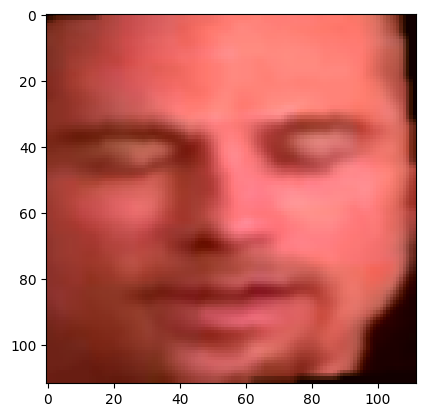

In [3]:
import pandas as pd
from sklearn.model_selection import train_test_split
from torchvision import transforms
from torch.utils.data import DataLoader, Dataset
import cv2
import torch

# Load the new labels file
labels = pd.read_csv('/content/labels2.csv')

# Split the data into train, validation, and test sets
video_files = labels["video_path"].tolist()
train_videos, temp_videos = train_test_split(video_files, test_size=0.3, random_state=42)
valid_videos, test_videos = train_test_split(temp_videos, test_size=0.5, random_state=42)

print(f"train: {len(train_videos)}")
print(f"valid: {len(valid_videos)}")
print(f"test: {len(test_videos)}")

# Function to count real and fake videos
def number_of_real_and_fake_videos(data_list, labels_df):
    fake = 0
    real = 0
    for video_path in data_list:
        label_row = labels_df.loc[labels_df["video_path"] == video_path]
        if label_row.empty:
            print(f"Warning: {video_path} not found in labels.")
            continue
        label = label_row["label"].values[0]
        if label == 1:  # FAKE
            fake += 1
        elif label == 0:  # REAL
            real += 1
    return real, fake

# Print statistics for each dataset
print("TRAIN: ", "Real:", number_of_real_and_fake_videos(train_videos, labels)[0],
      " Fake:", number_of_real_and_fake_videos(train_videos, labels)[1])
print("VALID: ", "Real:", number_of_real_and_fake_videos(valid_videos, labels)[0],
      " Fake:", number_of_real_and_fake_videos(valid_videos, labels)[1])
print("TEST: ", "Real:", number_of_real_and_fake_videos(test_videos, labels)[0],
      " Fake:", number_of_real_and_fake_videos(test_videos, labels)[1])

# Image transformation
im_size = 112
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]


# Data Augmentation for Training
train_transforms = transforms.Compose([
    transforms.ToPILImage(),
    transforms.RandomHorizontalFlip(p=0.5),
    transforms.RandomRotation(degrees=5),
    transforms.ColorJitter(brightness=0.2, contrast=0.2, saturation=0.2, hue=0.1),
    transforms.RandomResizedCrop((112, 112), scale=(0.9, 1.0)),
    transforms.GaussianBlur(kernel_size=(3, 3)),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])


# Transformations for Testing (No Augmentation)
test_transforms = transforms.Compose([
    transforms.ToPILImage(),
    transforms.Resize((112, 112)),  # Resize to a uniform size
    transforms.ToTensor(),          # Convert to tensor
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])  # Normalize using ImageNet statistics
])




# Dataset class
class video_dataset(Dataset):
    def __init__(self, video_list, labels_df, sequence_length=20, transform=None, min_frames=20):
        self.video_list = video_list
        self.labels_df = labels_df
        self.sequence_length = sequence_length
        self.transform = transform
        self.min_frames = min_frames

    def __len__(self):
        return len(self.video_list)

    def __getitem__(self, idx):
        video_path = self.video_list[idx]
        frames = []
        label = self.labels_df.loc[self.labels_df["video_path"] == video_path, "label"].values[0]

        frame_count = 0  # Initialize frame count
        for frame in self.frame_extract(video_path):
            if self.transform:
                frame = self.transform(frame)
            frames.append(frame)
            frame_count += 1
            if len(frames) == self.sequence_length:
                break

        if frame_count < self.min_frames:
            return None

        frames = torch.stack(frames)  # Convert list of frames to tensor
        return frames, label

    def frame_extract(self, path):
        cap = cv2.VideoCapture(path)
        while True:
            ret, frame = cap.read()
            if not ret:
                break
            yield frame
        cap.release()

def filter_videos_with_sufficient_frames(video_list, min_frames=20):
    valid_videos = []
    for video in video_list:
        cap = cv2.VideoCapture(video)
        frame_count = int(cap.get(cv2.CAP_PROP_FRAME_COUNT))
        cap.release()
        if frame_count >= min_frames:
            valid_videos.append(video)
        else:
            print(f"Video {video} skipped: {frame_count} frames found (less than {min_frames}).")
    return valid_videos

# Filter videos before creating datasets
train_videos = filter_videos_with_sufficient_frames(train_videos)
valid_videos = filter_videos_with_sufficient_frames(valid_videos)
test_videos = filter_videos_with_sufficient_frames(test_videos)

# Create datasets and dataloaders
train_data = video_dataset(train_videos, labels, sequence_length=20, transform=train_transforms)
val_data = video_dataset(valid_videos, labels, sequence_length=20, transform=test_transforms)
test_data = video_dataset(test_videos, labels, sequence_length=20, transform=test_transforms)

train_loader = DataLoader(train_data, batch_size=8, shuffle=True, num_workers=0)
valid_loader = DataLoader(val_data, batch_size=8, shuffle=True, num_workers=0)
test_loader = DataLoader(test_data, batch_size=8, shuffle=False, num_workers=0)

# Visualize a sample
def im_plot(tensor):
    import matplotlib.pyplot as plt
    image = tensor.cpu().numpy().transpose(1, 2, 0)
    b, g, r = cv2.split(image)
    image = cv2.merge((r, g, b))
    image = image * [0.229, 0.224, 0.225] + [0.485, 0.456, 0.406]
    image = image * 255.0
    plt.imshow(image.astype(int))
    plt.show()

# Display a sample
sample_frames, sample_label = train_data[0]
print(f"Sample label: {sample_label}")
im_plot(sample_frames[0])  # Display the first frame of the sample video


In [18]:
#THis code is to check if the video is corrupted or not..
#If the video is corrupted delete the video.
import glob
import torch
import torchvision
from torchvision import transforms
from torch.utils.data import DataLoader
from torch.utils.data.dataset import Dataset
import os
import numpy as np
import cv2
import matplotlib.pyplot as plt
import face_recognition
#Check if the file is corrupted or not
def validate_video(vid_path,train_transforms):
      transform = train_transforms
      count = 20
      video_path = vid_path
      frames = []
      a = int(100/count)
      first_frame = np.random.randint(0,a)
      temp_video = video_path.split('/')[-1]
      for i,frame in enumerate(frame_extract(video_path)):
        frames.append(transform(frame))
        if(len(frames) == count):
          break
      frames = torch.stack(frames)
      frames = frames[:count]
      return frames
#extract a from from video
def frame_extract(path):
  vidObj = cv2.VideoCapture(path)
  success = 1
  while success:
      success, image = vidObj.read()
      if success:
          yield image

im_size = 112
mean = [0.485, 0.456, 0.406]
std = [0.229, 0.224, 0.225]

train_transforms = transforms.Compose([
                                        transforms.ToPILImage(),
                                        transforms.Resize((im_size,im_size)),
                                        transforms.ToTensor(),
                                        transforms.Normalize(mean,std)])
video_fil =  glob.glob('/content/REAL_Face_only_data_3/*.mp4')
video_fil += glob.glob('/content/FAKE_Face_only_data_3/*.mp4')

print("Total no of videos :" , len(video_fil))
print(video_fil)
count = 0;
for i in video_fil:
  try:
    count+=1
    validate_video(i,train_transforms)
  except:
    print("Number of video processed: " , count ," Remaining : " , (len(video_fil) - count))
    print("Corrupted video is : " , i)
    continue
print((len(video_fil) - count))


Total no of videos : 11561
['/content/REAL_Face_only_data_3\\aug_0_id0_0000.mp4', '/content/REAL_Face_only_data_3\\aug_0_id0_0001.mp4', '/content/REAL_Face_only_data_3\\aug_0_id0_0002.mp4', '/content/REAL_Face_only_data_3\\aug_0_id0_0003.mp4', '/content/REAL_Face_only_data_3\\aug_0_id0_0004.mp4', '/content/REAL_Face_only_data_3\\aug_0_id0_0005.mp4', '/content/REAL_Face_only_data_3\\aug_0_id0_0006.mp4', '/content/REAL_Face_only_data_3\\aug_0_id0_0007.mp4', '/content/REAL_Face_only_data_3\\aug_0_id0_0008.mp4', '/content/REAL_Face_only_data_3\\aug_0_id0_0009.mp4', '/content/REAL_Face_only_data_3\\aug_0_id10_0000.mp4', '/content/REAL_Face_only_data_3\\aug_0_id10_0002.mp4', '/content/REAL_Face_only_data_3\\aug_0_id10_0003.mp4', '/content/REAL_Face_only_data_3\\aug_0_id10_0004.mp4', '/content/REAL_Face_only_data_3\\aug_0_id10_0005.mp4', '/content/REAL_Face_only_data_3\\aug_0_id10_0006.mp4', '/content/REAL_Face_only_data_3\\aug_0_id10_0007.mp4', '/content/REAL_Face_only_data_3\\aug_0_id10_000

Using device: cuda:0


Epoch 1 Validation: 100%|██████████| 206/206 [00:32<00:00,  6.35it/s]


Saved Best Model.
Epoch 1 - Train Loss: 0.3543, Val Loss: 0.0109, Train Accuracy: 0.9023, Val Accuracy: 0.9982


Epoch 2 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.45it/s]


Epoch 2 - Train Loss: 0.0393, Val Loss: 0.0481, Train Accuracy: 0.9922, Val Accuracy: 0.9891


Epoch 3 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.54it/s]


Epoch 3 - Train Loss: 0.0241, Val Loss: 0.0117, Train Accuracy: 0.9946, Val Accuracy: 0.9988


Epoch 4 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.57it/s]


Epoch 4 - Train Loss: 0.0296, Val Loss: 0.0180, Train Accuracy: 0.9952, Val Accuracy: 0.9951


Epoch 5 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.60it/s]


Saved Best Model.
Epoch 5 - Train Loss: 0.0162, Val Loss: 0.0087, Train Accuracy: 0.9981, Val Accuracy: 0.9988


Epoch 6 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.54it/s]


Epoch 6 - Train Loss: 0.0270, Val Loss: 0.0090, Train Accuracy: 0.9953, Val Accuracy: 0.9982


Epoch 7 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.54it/s]


Saved Best Model.
Epoch 7 - Train Loss: 0.0184, Val Loss: 0.0040, Train Accuracy: 0.9977, Val Accuracy: 0.9994


Epoch 8 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.54it/s]


Epoch 8 - Train Loss: 0.0272, Val Loss: 0.0082, Train Accuracy: 0.9947, Val Accuracy: 0.9988


Epoch 9 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.54it/s]


Epoch 9 - Train Loss: 0.0233, Val Loss: 0.0180, Train Accuracy: 0.9960, Val Accuracy: 0.9994


Epoch 10 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.59it/s]


Saved Best Model.
Epoch 10 - Train Loss: 0.0129, Val Loss: 0.0036, Train Accuracy: 0.9974, Val Accuracy: 1.0000


Epoch 11 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.56it/s]


Saved Best Model.
Epoch 11 - Train Loss: 0.0243, Val Loss: 0.0034, Train Accuracy: 0.9959, Val Accuracy: 1.0000


Epoch 12 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.57it/s]


Saved Best Model.
Epoch 12 - Train Loss: 0.0195, Val Loss: 0.0029, Train Accuracy: 0.9964, Val Accuracy: 1.0000


Epoch 13 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.56it/s]


Saved Best Model.
Epoch 13 - Train Loss: 0.0240, Val Loss: 0.0023, Train Accuracy: 0.9959, Val Accuracy: 1.0000


Epoch 14 Validation: 100%|██████████| 206/206 [00:32<00:00,  6.27it/s]


Epoch 14 - Train Loss: 0.0321, Val Loss: 0.0028, Train Accuracy: 0.9925, Val Accuracy: 0.9994


Epoch 15 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.52it/s]


Epoch 15 - Train Loss: 0.0250, Val Loss: 0.0025, Train Accuracy: 0.9955, Val Accuracy: 1.0000


Epoch 16 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.56it/s]


Saved Best Model.
Epoch 16 - Train Loss: 0.0140, Val Loss: 0.0009, Train Accuracy: 0.9965, Val Accuracy: 1.0000


Epoch 17 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.52it/s]


Epoch 17 - Train Loss: 0.0244, Val Loss: 0.0041, Train Accuracy: 0.9942, Val Accuracy: 0.9994


Epoch 18 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.55it/s]


Epoch 18 - Train Loss: 0.0052, Val Loss: 0.0067, Train Accuracy: 0.9991, Val Accuracy: 0.9982


Epoch 19 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.56it/s]


Epoch 19 - Train Loss: 0.0157, Val Loss: 0.0178, Train Accuracy: 0.9962, Val Accuracy: 0.9982


Epoch 20 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.54it/s]


Epoch 20 - Train Loss: 0.0203, Val Loss: 0.0091, Train Accuracy: 0.9955, Val Accuracy: 0.9994


Epoch 21 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.60it/s]


Saved Best Model.
Epoch 21 - Train Loss: 0.0175, Val Loss: 0.0005, Train Accuracy: 0.9960, Val Accuracy: 1.0000


Epoch 22 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.52it/s]


Epoch 22 - Train Loss: 0.0166, Val Loss: 0.0441, Train Accuracy: 0.9971, Val Accuracy: 0.9970


Epoch 23 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.58it/s]


Epoch 23 - Train Loss: 0.0181, Val Loss: 0.0059, Train Accuracy: 0.9969, Val Accuracy: 0.9982


Epoch 24 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.61it/s]


Epoch 24 - Train Loss: 0.0167, Val Loss: 0.2094, Train Accuracy: 0.9961, Val Accuracy: 0.9921


Epoch 25 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.50it/s]


Epoch 25 - Train Loss: 0.0110, Val Loss: 0.0658, Train Accuracy: 0.9971, Val Accuracy: 0.9945


Epoch 26 Validation: 100%|██████████| 206/206 [00:31<00:00,  6.54it/s]


Early stopping triggered.


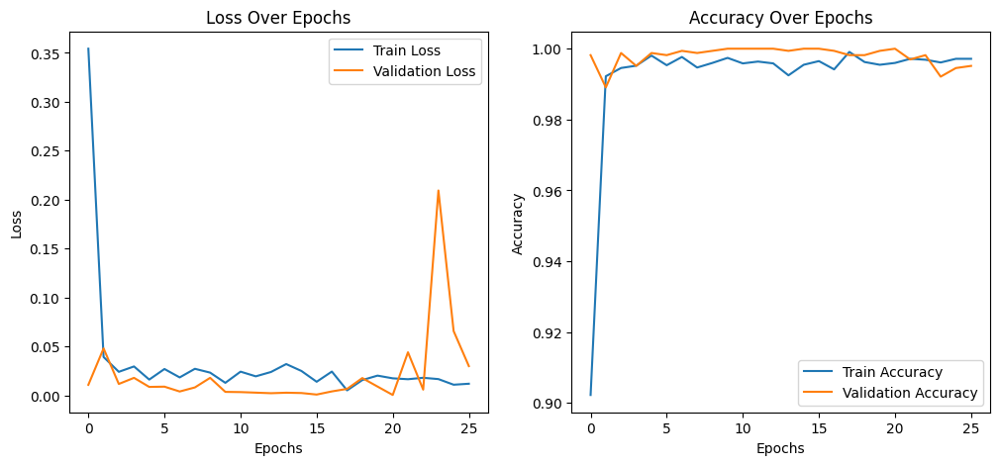

Extracting features for Cross-Validation...


Extracting Features: 100%|██████████| 965/965 [08:43<00:00,  1.84it/s]



========== Fold 1/7 ==========
Fold 1 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1 Score: 1.0000

========== Fold 2/7 ==========
Fold 2 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1 Score: 1.0000

========== Fold 3/7 ==========
Fold 3 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1 Score: 1.0000

========== Fold 4/7 ==========
Fold 4 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1 Score: 1.0000

========== Fold 5/7 ==========
Fold 5 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1 Score: 1.0000

========== Fold 6/7 ==========
Fold 6 - Accuracy: 1.0000, Precision: 1.0000, Recall: 1.0000, F1 Score: 1.0000

========== Fold 7/7 ==========
Fold 7 - Accuracy: 0.9991, Precision: 0.9991, Recall: 0.9991, F1 Score: 0.9991

Cross-Validation Results:
Average Accuracy: 0.9999
Average Precision: 0.9999
Average Recall: 0.9999
Average F1 Score: 0.9999


In [75]:
import torch
from torch import nn
from tqdm import tqdm
import numpy as np
import xgboost as xgb
from torchvision import models
from torchvision.models import ResNeXt50_32X4D_Weights
from sklearn.model_selection import StratifiedKFold
from sklearn.metrics import accuracy_score, precision_score, recall_score, f1_score
import joblib
import matplotlib.pyplot as plt

# Check for CUDA and set the device
device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")
print(f"Using device: {device}")

# Define ResNeXt Feature Extractor
class ResNeXtFeatureExtractor(nn.Module):
    def __init__(self):
        super(ResNeXtFeatureExtractor, self).__init__()
        model = models.resnext50_32x4d(weights=ResNeXt50_32X4D_Weights.DEFAULT)
        self.feature_extractor = nn.Sequential(*list(model.children())[:-2])
        self.avgpool = nn.AdaptiveAvgPool2d(1)

    def forward(self, x):
        features = self.feature_extractor(x)
        pooled_features = self.avgpool(features)
        flattened_features = pooled_features.view(pooled_features.size(0), -1)
        return flattened_features

# Define TCN Model
class TCNModel(nn.Module):
    def __init__(self, input_size, hidden_size):
        super(TCNModel, self).__init__()
        self.tcn = nn.Sequential(
            nn.Conv1d(input_size, hidden_size, kernel_size=3, padding=1),
            nn.BatchNorm1d(hidden_size),
            nn.ReLU(),
            nn.Dropout(0.7),
            nn.Conv1d(hidden_size, hidden_size, kernel_size=3, padding=1),
            nn.BatchNorm1d(hidden_size),
            nn.ReLU(),
            nn.Dropout(0.7),
            nn.Conv1d(hidden_size, hidden_size, kernel_size=3, padding=1),
            nn.ReLU(),
            nn.Conv1d(hidden_size, hidden_size, kernel_size=3, padding=1),
            nn.ReLU()
        )
        self.fc1 = nn.Linear(hidden_size, 256)
        self.fc2 = nn.Linear(256, 128)

    def forward(self, x):
        x = x.permute(0, 2, 1)
        features = self.tcn(x)
        features = features.mean(dim=-1)
        features = self.fc1(features)
        return self.fc2(features)

# Define Combined ResNeXt + TCN Model
class ResNeXtTCN(nn.Module):
    def __init__(self, resnext, tcn):
        super(ResNeXtTCN, self).__init__()
        self.resnext = resnext
        self.tcn = tcn

    def forward(self, x):
        batch_size, timesteps, C, H, W = x.size()
        x = x.view(batch_size * timesteps, C, H, W)
        features = self.resnext(x)
        features = features.view(batch_size, timesteps, -1)
        return self.tcn(features)

# Feature Extraction Function
def extract_video_features(model, dataloader, device):
    model.eval()
    features = []
    labels = []
    with torch.no_grad():
        for videos, video_labels in tqdm(dataloader, desc="Extracting Features"):
            videos = videos.to(device)
            video_features = model(videos)
            features.append(video_features.cpu())
            labels.append(video_labels.cpu())
    features = torch.cat(features, dim=0)
    labels = torch.cat(labels, dim=0)
    return features.numpy(), labels.numpy()

# Initialize Models
resnext = ResNeXtFeatureExtractor().to(device)
tcn = TCNModel(input_size=2048, hidden_size=128).to(device)
resnext_tcn_model = ResNeXtTCN(resnext, tcn).to(device)

# Optimizer, Scheduler, and Loss Function
optimizer = torch.optim.SGD(resnext_tcn_model.parameters(), lr=1e-3, momentum=0.9, weight_decay=1e-4)
scheduler = torch.optim.lr_scheduler.CosineAnnealingLR(optimizer, T_max=20, eta_min=1e-6)
criterion = nn.CrossEntropyLoss()

# Training and Validation Loops
train_losses, val_losses, train_accuracies, val_accuracies = [], [], [], []
num_epochs = 50
best_val_loss = float('inf')
early_stopping_patience = 5
patience_counter = 0

for epoch in range(num_epochs):
    resnext_tcn_model.train()
    train_loss, train_correct, train_total = 0, 0, 0

    # Training Loop
    for videos, labels in tqdm(train_loader, desc=f"Epoch {epoch+1} Training"):
        videos, labels = videos.to(device), labels.to(device)
        optimizer.zero_grad()
        outputs = resnext_tcn_model(videos)
        loss = criterion(outputs, labels)
        loss.backward()
        optimizer.step()
        train_loss += loss.item()
        _, predicted = outputs.max(1)
        train_correct += (predicted == labels).sum().item()
        train_total += labels.size(0)

    train_accuracy = train_correct / train_total
    train_losses.append(train_loss / len(train_loader))
    train_accuracies.append(train_accuracy)

    # Validation Loop
    resnext_tcn_model.eval()
    val_loss, val_correct, val_total = 0, 0, 0
    with torch.no_grad():
        for videos, labels in tqdm(valid_loader, desc=f"Epoch {epoch+1} Validation"):
            videos, labels = videos.to(device), labels.to(device)
            outputs = resnext_tcn_model(videos)
            loss = criterion(outputs, labels)
            val_loss += loss.item()
            _, predicted = outputs.max(1)
            val_correct += (predicted == labels).sum().item()
            val_total += labels.size(0)

    val_accuracy = val_correct / val_total
    val_losses.append(val_loss / len(valid_loader))
    val_accuracies.append(val_accuracy)

    # Early Stopping
    if val_losses[-1] < best_val_loss:
        best_val_loss = val_losses[-1]
        patience_counter = 0
        torch.save(resnext_tcn_model.state_dict(), "best_resnext_tcn_model.pth")
        print("Saved Best Model.")
    else:
        patience_counter += 1
        if patience_counter >= early_stopping_patience:
            print("Early stopping triggered.")
            break

    print(f"Epoch {epoch+1} - Train Loss: {train_losses[-1]:.4f}, Val Loss: {val_losses[-1]:.4f}, "
          f"Train Accuracy: {train_accuracies[-1]:.4f}, Val Accuracy: {val_accuracies[-1]:.4f}")

# Plot Training and Validation Metrics
def plot_metrics(train_loss_avg, val_loss_avg, train_accuracy, val_accuracy):
    plt.figure(figsize=(12, 5))
    plt.subplot(1, 2, 1)
    plt.plot(train_loss_avg, label='Train Loss')
    plt.plot(val_loss_avg, label='Validation Loss')
    plt.title('Loss Over Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Loss')
    plt.legend()

    plt.subplot(1, 2, 2)
    plt.plot(train_accuracy, label='Train Accuracy')
    plt.plot(val_accuracy, label='Validation Accuracy')
    plt.title('Accuracy Over Epochs')
    plt.xlabel('Epochs')
    plt.ylabel('Accuracy')
    plt.legend()
    plt.show()

plot_metrics(train_losses, val_losses, train_accuracies, val_accuracies)

# Cross-Validation with XGBoost
k = 7
kf = StratifiedKFold(n_splits=k, shuffle=True, random_state=42)
accuracies, precisions, recalls, f1_scores = [], [], [], []

print("Extracting features for Cross-Validation...")
train_features, train_labels = extract_video_features(resnext_tcn_model, train_loader, device)

for fold, (train_idx, val_idx) in enumerate(kf.split(train_features, train_labels), 1):
    print(f"\n{'='*10} Fold {fold}/{k} {'='*10}")
    X_train, X_val = train_features[train_idx], train_features[val_idx]
    y_train, y_val = train_labels[train_idx], train_labels[val_idx]

    xgb_model = xgb.XGBClassifier(
        n_estimators=50,
        learning_rate=0.05,
        max_depth=3,
        tree_method='hist',
        device='cuda' if torch.cuda.is_available() else 'cpu'
    )
    xgb_model.fit(X_train, y_train)

    y_pred = xgb_model.predict(X_val)
    accuracies.append(accuracy_score(y_val, y_pred))
    precisions.append(precision_score(y_val, y_pred, average='weighted'))
    recalls.append(recall_score(y_val, y_pred, average='weighted'))
    f1_scores.append(f1_score(y_val, y_pred, average='weighted'))
    # Save the XGBoost model
    joblib.dump(xgb_model, f"xgb_model_fold_{fold}.pkl")
    print(f"Fold {fold} - Accuracy: {accuracies[-1]:.4f}, Precision: {precisions[-1]:.4f}, Recall: {recalls[-1]:.4f}, F1 Score: {f1_scores[-1]:.4f}")

print("\nCross-Validation Results:")
print(f"Average Accuracy: {np.mean(accuracies):.4f}")
print(f"Average Precision: {np.mean(precisions):.4f}")
print(f"Average Recall: {np.mean(recalls):.4f}")
print(f"Average F1 Score: {np.mean(f1_scores):.4f}")



Evaluating on the Test Set...


Extracting Features: 100%|██████████| 208/208 [00:32<00:00,  6.35it/s]


Test Results:
Metric         Value     
-------------------------
Accuracy       0.995
Precision      0.996
Recall         0.994
F1 Score       0.995

Classification Report:
              precision    recall  f1-score   support

        Real     0.9941    0.9965    0.9953       846
        Fake     0.9963    0.9939    0.9951       815

    accuracy                         0.9952      1661
   macro avg     0.9952    0.9952    0.9952      1661
weighted avg     0.9952    0.9952    0.9952      1661


Confusion Matrix:
[[843   3]
 [  5 810]]


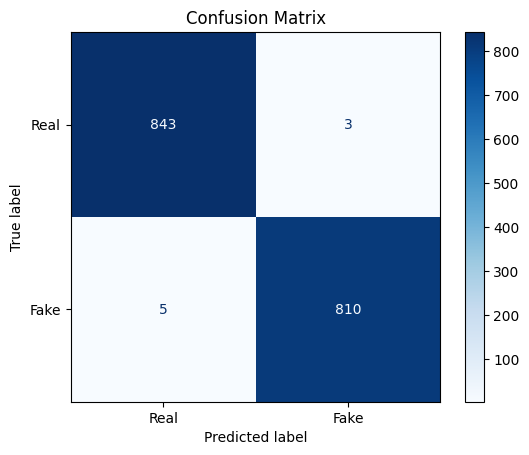

In [76]:
from sklearn.metrics import classification_report, confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt
import numpy as np

# Test the trained models on the Test Set
print("\nEvaluating on the Test Set...")
test_features, test_labels = extract_video_features(resnext_tcn_model, test_loader, device)
test_predictions = xgb_model.predict(test_features)

# Calculate metrics
test_accuracy = accuracy_score(test_labels, test_predictions)
test_precision = precision_score(test_labels, test_predictions, average='binary')
test_recall = recall_score(test_labels, test_predictions, average='binary')
test_f1 = f1_score(test_labels, test_predictions, average='binary')

# Print metrics
print("\nTest Results:")
print(f"{'Metric':<15}{'Value':<10}")
print(f"{'-'*25}")
print(f"{'Accuracy':<15}{test_accuracy:.3f}")
print(f"{'Precision':<15}{test_precision:.3f}")
print(f"{'Recall':<15}{test_recall:.3f}")
print(f"{'F1 Score':<15}{test_f1:.3f}")
print("="*70)

# Generate classification report
print("\nClassification Report:")
report = classification_report(test_labels, test_predictions, target_names=["Real", "Fake"], digits=4)
print(report)

# Generate confusion matrix
print("\nConfusion Matrix:")
cm = confusion_matrix(test_labels, test_predictions)
print(cm)

# Display confusion matrix as a heatmap
disp = ConfusionMatrixDisplay(confusion_matrix=cm, display_labels=["Real", "Fake"])
disp.plot(cmap=plt.cm.Blues, values_format="d")
plt.title("Confusion Matrix")
plt.show()

